In [1]:
import os

import numpy as np
import pandas as pd
import zipfile
import matplotlib.pyplot as plt
from tqdm import tqdm
import math

# 解壓縮資料

In [2]:
def unzip_data(path):
    for folder, _, files in os.walk(path):
        for file in files:
            if file.endswith('zip'):
                file_path = os.path.join(folder, file)
                print(file_path)

                sotre_path = os.path.join(folder, file.rsplit('.')[0])
                # 開啟 ZIP 壓縮檔 
                with zipfile.ZipFile(file_path, 'r') as zf:
                    # 解壓縮所有檔案至 /my/folder 目錄
                    zf.extractall(path=sotre_path)

In [3]:
# unzip_data('./swing')

In [4]:
def convert_csv(path):
    acc_df = pd.read_csv(os.path.join(path, 'Accelerometer.csv'), delimiter=',')
    gyo_df = pd.read_csv(os.path.join(path, 'Gyroscope.csv'), delimiter=',')
    linacc_df = pd.read_csv(os.path.join(path, 'Linear Accelerometer.csv'), delimiter=',')
    mag_df = pd.read_csv(os.path.join(path, 'Magnetometer.csv'), delimiter=',')
    device_df = pd.read_csv(os.path.join(path, 'meta', 'device.csv'), delimiter=',')
    time_df = pd.read_csv(os.path.join(path, 'meta', 'time.csv'), delimiter=',')
    
    acc_df.to_csv(os.path.join(path, 'Accelerometer.csv'), index=False, sep=';')
    gyo_df.to_csv(os.path.join(path, 'Gyroscope.csv'), index=False, sep=';')
    linacc_df.to_csv(os.path.join(path, 'Linear Accelerometer.csv'), index=False, sep=';')
    mag_df.to_csv(os.path.join(path, 'Magnetometer.csv'), index=False, sep=';')
    device_df.to_csv(os.path.join(path, 'meta', 'device.csv'), index=False, sep=';')
    time_df.to_csv(os.path.join(path, 'meta', 'time.csv'), index=False, sep=';')

In [5]:
# convert_csv('./pocket/202301101952/target')
# convert_csv('./pocket/202301101952/source')

# 讀檔

In [6]:
def rename_data(df):
    new_names = ['system_time', 'acc_times', 'acc_x', 'acc_y', 'acc_z', 'gyo_times', 'gyo_x', 'gyo_y', 'gyo_z', 'lin_acc_times', 'lin_acc_x', 'lin_acc_y', 'lin_acc_z', 'mag_times', 'mag_x', 'mag_y', 'mag_z']
    df.columns = new_names
    
    return df


def device_start_system_time(path):
    time_df = pd.read_csv(path, delimiter=';', index_col=0)
    time = time_df.T.loc['system time', 'START']
    
    return time


def load_original_data(path):
    acc_df = pd.read_csv(os.path.join(path, 'Accelerometer.csv'), delimiter=';')
    gyo_df = pd.read_csv(os.path.join(path, 'Gyroscope.csv'), delimiter=';')
    linacc_df = pd.read_csv(os.path.join(path, 'Linear Accelerometer.csv'), delimiter=';')
    mag_df = pd.read_csv(os.path.join(path, 'Magnetometer.csv'), delimiter=';')
    start_time = device_start_system_time(os.path.join(path, 'meta/time.csv'))
    time_df = acc_df.iloc[:, 0] + start_time
    
    total_df = pd.concat([time_df, acc_df, gyo_df, linacc_df, mag_df], axis=1)
    total_df = rename_data(total_df)
    
    return total_df

In [7]:
def align_data(source_df, target_df):
    source_start_time = source_df.loc[0, 'system_time']
    target_start_time = target_df.loc[0, 'system_time']
    
    # align start time
    if source_start_time > target_start_time:  # source start time > target start time
        target_start_idx = np.argmin(np.abs(target_df.system_time - source_start_time))
        target_df = target_df.iloc[target_start_idx:].reset_index(drop=True)
    else:  # source start time < target start time
        source_start_idx = np.argmin(np.abs(source_df.system_time - target_start_time))
        source_df = source_df.iloc[source_start_idx:].reset_index(drop=True)
        
    # align end idx
    end_idx = min(len(source_df), len(target_df))
    source_df = source_df.iloc[:end_idx]
    target_df = target_df.iloc[:end_idx]
    
    return source_df, target_df


def bound_range(df):
    start = datapoint_per_second * 35
    end = len(df) - datapoint_per_second * 20
    
    return df.iloc[start:end].reset_index(drop=True)


def split_segments(df, chunk_size=5, seq_len=25):
#     length = datapoint_per_second * duration
    length = chunk_size * seq_len
    num_of_segs = int(np.floor(len(df) / length))
    
    segments = []
    for i in range(num_of_segs):
        seg = df.iloc[int(i * length):int((i + 1) * length)].to_numpy()
        segments.append(np.array(np.split(seg, chunk_size)))
        
    return segments


def select_data(df):
    return df[['acc_x', 'acc_y', 'acc_z', 'gyo_x', 'gyo_y', 'gyo_z', 'lin_acc_x', 'lin_acc_y', 'lin_acc_z', 'mag_x', 'mag_y', 'mag_z', 'system_time']]


def preprocess_data(df, chunk_size=5, seq_len=25):
    pre_df = select_data(df)
    segs = split_segments(pre_df, chunk_size, seq_len)
    
    return segs

In [8]:
def device_version(path):
    device_df = pd.read_csv(path, delimiter=';', index_col=0)
    version = device_df.loc['deviceRelease'].value
    
    return version


def check_data_device(source_path, target_path):
    while True:
        source_version = device_version(os.path.join(source_path, 'meta/device.csv'))
        target_version = device_version(os.path.join(target_path, 'meta/device.csv'))

        print(source_path, target_path)

        if source_version[:2] == '15' and target_version[:2] == '16':
            return source_path, target_path
        elif source_version[:2] == '16' and target_version[:2] == '15':
            source_path = os.path.join(folder_path, 'target')
            target_path = os.path.join(folder_path, 'source')
            print('--- GG ---')
            continue
        else:
            raise


def load_pair_data(root_folder, class_num):
    pair_data = []

    for folder in os.listdir(root_folder):
        if folder.startswith('.'):
            continue

        folder_path = os.path.join(root_folder, folder)
        source_path = os.path.join(folder_path, 'source')
        target_path = os.path.join(folder_path, 'target')
        
        print(folder_path)
        
        #########################
        ##### check devices #####
        #########################
        source_path, target_path = check_data_device(source_path, target_path)
        
        ####################################
        ##### load and preprocess data #####
        ####################################
        source_df = load_original_data(source_path)
        target_df = load_original_data(target_path)
        
#         print(source_df.system_time[0], target_df.system_time[0])
        
        source_df, target_df = align_data(source_df, target_df)
        source_df, target_df = bound_range(source_df), bound_range(target_df)
        
#         print(source_df.system_time[0], target_df.system_time[0])
#         print(source_df.system_time[len(source_df) - 1], target_df.system_time[len(target_df) - 1])
#         print(len(source_df), len(target_df))
        
#         plt.figure(figsize=(30, 5))
#         plt.plot(np.arange(len(source_df)), source_df.acc_x)
#         plt.plot(np.arange(len(target_df)), target_df.acc_y)
#         plt.show()
        
        source_segs = preprocess_data(source_df, chunk_size, seq_len)
        target_segs = preprocess_data(target_df, chunk_size, seq_len)
        
        idx = min(len(source_segs), len(target_segs))
        source_tags = [class_num] * idx
        target_tags = [0] * idx
        
        pair_data.extend(zip(source_segs[:idx], source_tags, target_segs[:idx], target_tags))
        
    return pair_data

In [9]:
datapoint_per_second = 20
duration = 2
chunk_size = 10
seq_len = 25
classes = {'target': 0, 'front_pocket': 1, 'pocket': 2, 'swing': 3}

In [10]:
source_device_version = device_version('./front_pocket/202302071523/source/meta/device.csv')
target_device_version = device_version('./front_pocket/202302071523/target/meta/device.csv')
print(f"source device version: {source_device_version}")  # source version: 15.4
print(f"target device version: {target_device_version}")  # target version: 16.3

source device version: 15.4
target device version: 16.3


In [11]:
front_pocket_pair_data = load_pair_data('./front_pocket', class_num=1)
pocket_pair_data = load_pair_data('./pocket', class_num=2)
swing_pair_data = load_pair_data('./swing', class_num=3)

./front_pocket/202302071628
./front_pocket/202302071628/source ./front_pocket/202302071628/target
./front_pocket/202302071652
./front_pocket/202302071652/source ./front_pocket/202302071652/target
./front_pocket/202302071523
./front_pocket/202302071523/source ./front_pocket/202302071523/target
./front_pocket/202302071531
./front_pocket/202302071531/source ./front_pocket/202302071531/target
./front_pocket/202302071715
./front_pocket/202302071715/source ./front_pocket/202302071715/target
./front_pocket/202302071641
./front_pocket/202302071641/source ./front_pocket/202302071641/target
./front_pocket/202302071541
./front_pocket/202302071541/source ./front_pocket/202302071541/target
./front_pocket/202302071619
./front_pocket/202302071619/source ./front_pocket/202302071619/target
./front_pocket/202302071704
./front_pocket/202302071704/source ./front_pocket/202302071704/target
./front_pocket/202302071724
./front_pocket/202302071724/source ./front_pocket/202302071724/target
./pocket/20230213210

In [12]:
print(len(front_pocket_pair_data), len(pocket_pair_data), len(swing_pair_data))

226 215 210


In [13]:
front_pocket_pair_data[0][0][0, -1], front_pocket_pair_data[0][2][0, -1]

(array([-1.18164276e+00,  1.13118269e+01, -1.10844498e+00, -5.40463984e-01,
        -1.87591553e+00,  5.90145647e-01,  4.08018416e-01, -1.88228362e+00,
        -2.25128342e+00,  1.24117289e+01, -1.55095520e+01,  3.97043762e+01,
         1.67575812e+09]),
 array([ 1.08823700e-01,  9.23489594e+00,  6.51071091e+00,  2.38888234e-01,
        -1.13709919e-01,  3.30951400e-02,  3.23165961e-01,  9.69002332e-01,
         1.22304923e+00, -3.65958176e+01,  1.05057907e+00, -2.49110413e+01,
         1.67575811e+09]))

# 建立dataloader

In [14]:
import torch
import torch.nn as nn
import torch.nn.functional as F
from torch.utils.data import DataLoader, Dataset
from sklearn.metrics import accuracy_score

In [15]:
# class ClassDataset(Dataset):
#     def __init__(self, data, label):
#         self.data = data
#         self.label = label

#     def __len__(self):
#         return len(self.data)

#     def __getitem__(self, idx):
#         return self.data[idx], self.label[idx]

In [16]:
class PairDataset(Dataset):
    def __init__(self, source_data, source_label, target_data, target_label):
        self.source_data = source_data
        self.source_label = source_label
        self.target_data = target_data
        self.target_label = target_label

    def __len__(self):
        return len(self.source_data)

    def __getitem__(self, idx):
        return self.source_data[idx], self.source_label[idx], self.target_data[idx], self.target_label[idx]

In [17]:
def get_tgt_mask(size) -> torch.tensor:
    # Generates a squeare matrix where the each row allows one word more to be seen
    mask = torch.tril(torch.ones(size, size) == 1) # Lower triangular matrix
    mask = mask.float()
    mask = mask.masked_fill(mask == 0, float('-inf')) # Convert zeros to -inf
    mask = mask.masked_fill(mask == 1, float(0.0)) # Convert ones to 0

    # EX for size=5:
    # [[0., -inf, -inf, -inf, -inf],
    #  [0.,   0., -inf, -inf, -inf],
    #  [0.,   0.,   0., -inf, -inf],
    #  [0.,   0.,   0.,   0., -inf],
    #  [0.,   0.,   0.,   0.,   0.]]

    return mask

In [18]:
class Classifier(nn.Module):
    def __init__(self, chunk_size=5, seq_len=21, num_of_classes=2):
        super(Classifier, self).__init__()
        
        self.chunk_size = chunk_size
        self.seq_len = seq_len
        self.num_of_classes = num_of_classes
        
        self.cnn = nn.Sequential(
            nn.Conv1d(9, 16, kernel_size=5),
            nn.LeakyReLU(),
            nn.Conv1d(16, 16, kernel_size=5),
            nn.LeakyReLU(),
        )
        
        # 16 * (seq_len-8)
        self.rnn = nn.RNN(input_size=16 * (seq_len - 8), hidden_size=64, num_layers=2, batch_first=True)
        
        self.last = nn.Sequential(
            nn.Linear(64, 16),
            nn.Tanh(),
            nn.Linear(16, num_of_classes),
            nn.Softmax(dim=2),
        )
        
    def forward(self, x):  # input: (bs, chunk_size, seq_len, 9)
        h = torch.reshape(x, (len(x) * self.chunk_size, self.seq_len, -1))  # (bs, chunk_size, seq_len, 9) -> (bs * chunk_size, seq_len, 9)
        h = torch.permute(h, (0, 2, 1))  # (bs * chunk_size, seq_len, 9) -> (bs * chunk_size, 9, seq_len) [CNN要對最後一個維度做卷積]
        
        h = self.cnn(h)

        h = torch.permute(h, (0, 2, 1))
        h = torch.reshape(h, (len(x), self.chunk_size, -1))
        
        hz, _ = self.rnn(h)
        out = self.last(hz)

        out = torch.reshape(out, (len(x), self.chunk_size, self.num_of_classes))
        
        return out, hz
    

class PositionalEncoding(nn.Module):
    def __init__(self, d_model, dropout=0.1, max_len=5000):
        super(PositionalEncoding, self).__init__()
        self.dropout = nn.Dropout(p=dropout)

        pe = torch.zeros(max_len, d_model)
        position = torch.arange(0, max_len, dtype=torch.float).unsqueeze(1)
        div_term = torch.exp(torch.arange(0, d_model, 2).float() * (-math.log(10000.0) / d_model))
        pe[:, 0::2] = torch.sin(position * div_term)
        pe[:, 1::2] = torch.cos(position * div_term)
        pe = pe.unsqueeze(0).transpose(0, 1)
        self.register_buffer('pe', pe)

    def forward(self, x):
        x = x + self.pe[:x.size(0), :].to(x.device)
        return self.dropout(x)

    
class CNNEncoder(nn.Module):
    def __init__(self):
        super(CNNEncoder, self).__init__()
        
        self.cnn = nn.Sequential(
            nn.Conv1d(3, 16, kernel_size=5, padding=2),
#             nn.MaxPool1d(kernel_size=3, stride=2),
#             nn.BatchNorm1d(16),
            nn.LeakyReLU(),
            nn.Conv1d(16, 32, kernel_size=5, padding=2),
#             nn.MaxPool1d(kernel_size=3, stride=2),
#             nn.BatchNorm1d(32),
            nn.LeakyReLU(),
            nn.Conv1d(32, 64, kernel_size=5, padding=2),
#             nn.MaxPool1d(kernel_size=3, stride=2),
#             nn.BatchNorm1d(64),
            nn.LeakyReLU(),
        )
        
    def forward(self, x):  # input: (bs, chunk_size, seq_len, 3)
        bs, chunk_size, seq_len, channels = x.shape
        
        h = torch.reshape(x, (bs * chunk_size, seq_len, channels))  # (bs, chunk_size, seq_len, 3) -> (bs * chunk_size, seq_len, 3)
        h = torch.permute(h, (0, 2, 1))  # (bs * chunk_size, seq_len, 3) -> (bs * chunk_size, 3, seq_len) [CNN要對最後一個維度做卷積]
        
        h = self.cnn(h)

        h = torch.permute(h, (0, 2, 1))
        h = torch.reshape(h, (bs, chunk_size, seq_len, -1))
        
        return h


class CNNEncoderIMU(nn.Module):
    def __init__(self):
        super(CNNEncoderIMU, self).__init__()
        
        self.cnn = nn.Sequential(
            nn.Conv1d(9, 16, kernel_size=5, padding=2),
#             nn.BatchNorm1d(16),
            nn.LeakyReLU(),
            nn.Conv1d(16, 32, kernel_size=5, padding=2),
#             nn.BatchNorm1d(32),
            nn.LeakyReLU(),
            nn.Conv1d(32, 64, kernel_size=5, padding=2),
#             nn.BatchNorm1d(64),
            nn.LeakyReLU(),
        )
        
    def forward(self, x):  # input: (bs, chunk_size, seq_len, 9)
        bs, chunk_size, seq_len, channels = x.shape
        
        h = torch.reshape(x, (bs * chunk_size, seq_len, channels))  # (bs, chunk_size, seq_len, 9) -> (bs * chunk_size, seq_len, 9)
        h = torch.permute(h, (0, 2, 1))  # (bs * chunk_size, seq_len, 9) -> (bs * chunk_size, 9, seq_len) [CNN要對最後一個維度做卷積]
        
        h = self.cnn(h)

        h = torch.permute(h, (0, 2, 1))
        h = torch.reshape(h, (bs, chunk_size, seq_len, -1))
        
        return h

    
class CNNDecoder(nn.Module):
    def __init__(self):
        super(CNNDecoder, self).__init__()
        
        self.cnn = nn.Sequential(
            nn.ConvTranspose1d(64, 32, kernel_size=5, padding=2),
#             nn.BatchNorm1d(32),
            nn.LeakyReLU(),
            nn.ConvTranspose1d(32, 16, kernel_size=5, padding=2),
#             nn.BatchNorm1d(16),
            nn.LeakyReLU(),
            nn.ConvTranspose1d(16, 3, kernel_size=5, padding=2),
        )
        
    def forward(self, x):  # input: (bs, chunk_size, seq_len, ?)
        bs, chunk_size, seq_len, channels = x.shape
        
        h = torch.reshape(x, (bs * chunk_size, seq_len, channels))
        h = torch.permute(h, (0, 2, 1))
        
        h = self.cnn(h)

        h = torch.permute(h, (0, 2, 1))
        h = torch.reshape(h, (bs, chunk_size, seq_len, -1))
        
        return h

In [19]:
class NotSimpleTransformer(nn.Module):
    def __init__(self, chunk_size=5, seq_len=21, num_of_classes=2):
        super(NotSimpleTransformer, self).__init__()
        
        self.chunk_size = chunk_size
        self.seq_len = seq_len
        self.num_of_classes = num_of_classes
        
        self.cnn_encoder = CNNEncoder()
        self.cnn_encoder_imu = CNNEncoderIMU()
        self.cnn_decoder = CNNDecoder()
        self.pos_encoder = PositionalEncoding(64 * self.seq_len, 0.1)
        
        ################
        ### Imu Part ###
        ################
        #self.classifier = Classifier(chunk_size, seq_len, num_of_classes)
        
        ################
        ### Mag Part ###
        ################
        self.imu_embedding = nn.Sequential(
            nn.Linear(9, 32),
            nn.LeakyReLU(),
            nn.Linear(32, 64),
            nn.LeakyReLU()
        )
        
        self.mag_layer = nn.Sequential(
            nn.Linear(3, 16),
            nn.LeakyReLU(),
            nn.Linear(16, 64),
            nn.LeakyReLU(),
        )
        
        self.mag_transformer_encoder = nn.TransformerEncoder(nn.TransformerEncoderLayer(d_model=64 * self.seq_len, nhead=8, dropout=0.1, batch_first=True), num_layers=4)
        self.mag_transformer_decoder = nn.TransformerDecoder(nn.TransformerDecoderLayer(d_model=64 * self.seq_len, nhead=8, dropout=0.1, batch_first=True), num_layers=4)
        self.mag_last = nn.Sequential(
            nn.Linear(64 * self.seq_len, 16 * self.seq_len),
            nn.LeakyReLU(),
            nn.Linear(16 * self.seq_len, 3 * self.seq_len),
        )
        
    def forward(self, source_imu, source_mag, target_mag=None):

        if target_mag != None:
            ################
            ### imu part ###
            ################
#             source_h = self.imu_layer(source_imu)
#             source_hz, _ = self.imu_rnn(source_h)
#             source_predict_probability = self.imu_last(source_hz[:, -1])

            ################
            ### mag part ###
            ################
            source_mag_h = self.cnn_encoder(source_mag)
#             source_mag_h = self.mag_layer(source_mag)
            res_source_mag = source_mag_h
            source_mag_h = torch.reshape(source_mag_h, (len(source_mag), self.chunk_size, -1))  # (batch, chunk_size, seq_len, 64) -> (batch, chunk_size, seq_len * 64)
            source_mag_h = self.pos_encoder(source_mag_h)  # (batch, chunk_size, seq_len * 64)
            
            source_imu_h = self.cnn_encoder_imu(source_imu)
#             source_imu_h = self.imu_embedding(source_imu)
            source_imu_h = torch.reshape(source_imu_h, (len(source_imu), self.chunk_size, -1))
            source_mag_h = source_mag_h + source_imu_h
            
            target_mag = torch.concat([torch.zeros(len(target_mag), 1, self.seq_len, 3).to(source_mag.device), target_mag], dim=1)
            tgt = self.cnn_encoder(target_mag)  # (batch, chunk_size, seq_len, 3) -> (batch, chunk_size, seq_len, 64)
#             tgt = self.mag_layer(target_mag)
            tgt = torch.reshape(tgt, (len(source_mag), self.chunk_size, -1))  # (batch, chunk_size, seq_len, 64) -> (batch, chunk_size, seq_len * 64)
            tgt = self.pos_encoder(tgt)  # (batch, chunk_size, seq_len * 64)
            
            source_mag_hz = self.mag_transformer_encoder(source_mag_h)  # (batch, chunk_size, seq_len * 64) -> (batch, chunk_size, seq_len * 64)

#             source_latent = torch.add(source_hz, source_mag_hz)  # (batch, chunk_size, 48)
            tgt_mask = get_tgt_mask(self.chunk_size).to(source_mag.device)
            mem_mask = get_tgt_mask(self.chunk_size).to(source_mag.device)
            predict_mag_latent = self.mag_transformer_decoder(tgt, source_mag_hz, tgt_mask, mem_mask)  # (batch, chunk_size, seq_len * 64) -> (batch, chunk_size, seq_len * 64)
#             predict_mag = self.mag_last(predict_mag_latent)
#             predict_mag = torch.reshape(predict_mag, (len(source_mag), self.chunk_size, self.seq_len, -1))  # (batch * chunk_size, seq_len, 64) -> (batch, chunk_size, seq_len, 64)
            predict_mag = torch.reshape(predict_mag_latent, (len(source_mag), self.chunk_size, self.seq_len, -1))  # (batch * chunk_size, seq_len, 64) -> (batch, chunk_size, seq_len, 64)
            predict_mag = self.cnn_decoder(predict_mag)  # (batch, chunk_size, seq_len, 64) -> (batch, chunk_size, seq_le, 3)

            return predict_mag
        
        else:
            ################
            ### imu part ###
            ################
#             source_h = self.imu_layer(source_imu)
#             source_hz, _ = self.imu_rnn(source_h)
#             source_predict_probability = self.imu_last(source_hz[:, -1])

            ################
            ### mag part ###
            ################
            source_mag_h = self.cnn_encoder(source_mag)  # (batch, chunk_size, seq_len, 3) -> (batch, chunk_size, seq_len, 64)
            res_source_mag = source_mag_h
            source_mag_h = torch.reshape(source_mag_h, (len(source_mag), self.chunk_size, -1))  # (batch, chunk_size, seq_len, 64) -> (batch, chunk_size, seq_len * 64)
            source_mag_h = self.pos_encoder(source_mag_h)  # (batch, chunk_size, seq_len * 64)
            
            source_imu_h = self.cnn_encoder_imu(source_imu)
            source_imu_h = torch.reshape(source_imu_h, (len(source_imu), self.chunk_size, -1))
            source_mag_h = source_mag_h + source_imu_h
            source_mag_hz = self.mag_transformer_encoder(source_mag_h)  # (batch, chunk_size, seq_len * 64) -> (batch, chunk_size, seq_len * 64)

#             source_latent = torch.add(source_hz, source_mag_hz)  # (batch, chunk_size, 48)
            tgt = torch.zeros(len(source_mag), 1, self.seq_len, 3).to(source_mag.device)
            tgt = self.cnn_encoder(tgt)  # (batch, chunk_size, seq_len, 3) -> (batch, chunk_size, seq_len, 64)
            tgt = torch.reshape(tgt, (len(source_mag), 1, -1))
        
            for i in range(source_mag_hz.size(1)):
#                 tgt_pos = self.pos_encoder(torch.zeros(source_mag_hz.size(0), 1, source_mag_hz.size(-1)).to(source_mag_hz.device) + i)

#                 tgt = torch.reshape(tgt, (len(source_mag), i, seq_len, -1))
#                 tgt = self.cnn_encoder(tgt)  # (batch, chunk_size, seq_len, 3) -> (batch, chunk_size, seq_len, 64)
#                 tgt = torch.reshape(tgt, (len(source_mag), i, -1))
        
                tgt_pos = self.pos_encoder(tgt.clone())
                tgt_mask = get_tgt_mask(tgt.size(1)).to(source_mag.device)
                decode_position = self.mag_transformer_decoder(tgt_pos, source_mag_hz[:, :i+1, :], tgt_mask, tgt_mask, memory_key_padding_mask=None)
                tgt = torch.concat([tgt, decode_position[:, -1:]], dim=1)
            
#             predict_mag = self.mag_last(tgt)  # (batch, chunk_size, seq_len * 64) -> (batch, chunk_size, seq_len * 3)
#             predict_mag = torch.reshape(predict_mag, (len(source_mag), self.chunk_size + 1, self.seq_len, -1))  # (batch * chunk_size, seq_len, 3) -> (batch, chunk_size, seq_len, 3)
            predict_mag = torch.reshape(tgt, (len(source_mag), self.chunk_size + 1, self.seq_len, -1))  # (batch * chunk_size, seq_len, 64) -> (batch, chunk_size, seq_len, 64)
            predict_mag = self.cnn_decoder(predict_mag)  # (batch, chunk_size, seq_len, 64) -> (batch, chunk_size, seq_le, 3)
            
            return predict_mag[:, 1:]

In [20]:
class Discriminator(nn.Module):
    def __init__(self, chunk_size=5, seq_len=21):
        super(Discriminator, self).__init__()
        
        self.chunk_size = chunk_size
        self.seq_len = seq_len
        
        self.feature_extractor = nn.Sequential(
            nn.Linear(3, 16),
            nn.LeakyReLU(),
            nn.Linear(16, 32),
            nn.LeakyReLU(),
        )
        
        self.lstm = nn.LSTM(input_size=32 * self.seq_len, hidden_size=32 * self.seq_len, num_layers=2, batch_first=True, bidirectional=True)
        self.lstm = nn.LSTM(input_size=32 * self.seq_len, hidden_size=32 * self.seq_len, num_layers=2, batch_first=True, bidirectional=True)
        
        self.discriminant_layer = nn.Sequential(
            nn.Linear(64 * self.seq_len, 16),
            nn.LeakyReLU(),
            nn.Linear(16, 1),
            nn.Sigmoid(),
        )
        
    def forward(self, x):
        h = self.feature_extractor(x)  # (bs, chunk_size, seq_len, 3) -> (bs, chunk_size, seq_len, 16)
        
        h = h.reshape((len(x), self.chunk_size, -1))  # (bs, chunk_size, seq_len, 16) -> (bs, chunk_size, seq_len * 16)
        hz, _ = self.lstm(h)  # (bs, chunk_size, seq_len * 16) -> (bs, chunk_size, seq_len * 16 * 2)
        
        out = self.discriminant_layer(hz)
        
        return out

In [21]:
class FirstDerivativeLoss(nn.Module):
    def __init__(self, weight=None, size_average=None, reduce=None, reduction='mean', chunk_size=5):
        super(FirstDerivativeLoss, self).__init__()
        self.chunk_size = chunk_size

    def forward(self, source, target):
        # calculate the first derivative
        source_o = torch.reshape(source, (len(source), self.chunk_size, -1))
        target_o = torch.reshape(target, (len(target), self.chunk_size, -1))
        d_source = source_o[1:] - source_o[:-1]
        d_target = target_o[1:] - target_o[:-1]
        deriv = d_source - d_target

        # calculate the loss as the mean squared error of the derivative
        loss = torch.mean(torch.pow(deriv, 2))

        return loss

In [22]:
def generator_loss(gt_mag, pred_mag, d_res):
    pred_loss = mse_loss(pred_mag, gt_mag)
    d_loss = bce_loss(d_res, torch.ones_like(d_res))
    d1_loss = div_loss(pred_mag, gt_mag)

    return pred_loss + d_loss + d1_loss, pred_loss, d1_loss

def discriminator_loss(d_real, d_fake):
    real_loss = bce_loss(d_real, torch.ones_like(d_real))
    fake_loss = bce_loss(d_fake, torch.zeros_like(d_fake))

    return real_loss + fake_loss

In [23]:
front_pocket_half = int(len(front_pocket_pair_data) * 0.8)
pocket_half = int(len(pocket_pair_data) * 0.8)
swing_half = int(len(swing_pair_data) * 0.8)

train_data = front_pocket_pair_data[:front_pocket_half] + pocket_pair_data[:pocket_half] + swing_pair_data[:swing_half]
valid_data = front_pocket_pair_data[front_pocket_half:] + pocket_pair_data[pocket_half:] + swing_pair_data[swing_half:]

# train
train_source_data = np.array([d[0] for d in train_data])
train_source_label = np.array([d[1] for d in train_data])
train_target_data = np.array([d[2] for d in train_data])
train_target_label = np.array([d[3] for d in train_data])
train_dataset = PairDataset(
                    source_data = torch.tensor(train_source_data, dtype=torch.float),
                    source_label = train_source_label,
                    target_data = torch.tensor(train_target_data, dtype=torch.float),
                    target_label = train_target_label,
                )
train_loader = DataLoader(train_dataset, batch_size=32, shuffle=True)

# valid
valid_source_data = np.array([d[0] for d in valid_data])
valid_source_label = np.array([d[1] for d in valid_data])
valid_target_data = np.array([d[2] for d in valid_data])
valid_target_label = np.array([d[3] for d in valid_data])
valid_dataset = PairDataset(
                    source_data = torch.tensor(valid_source_data, dtype=torch.float),
                    source_label = valid_source_label,
                    target_data = torch.tensor(valid_target_data, dtype=torch.float),
                    target_label = valid_target_label,
                )
valid_loader = DataLoader(valid_dataset, batch_size=32)

In [24]:
batch = next(iter(train_loader))

In [25]:
# batch

In [26]:
EPOCH = 2000
num_of_classes = 4
device = torch.device("cuda" if (torch.cuda.is_available()) else "cpu")
ce_loss = torch.nn.CrossEntropyLoss()
mse_loss = torch.nn.MSELoss()
bce_loss = torch.nn.BCELoss()
div_loss = FirstDerivativeLoss(chunk_size=chunk_size)

In [27]:
model = NotSimpleTransformer(chunk_size=chunk_size, seq_len=seq_len, num_of_classes=num_of_classes).to(device)
discriminator = Discriminator(chunk_size=chunk_size, seq_len=seq_len).to(device)
optimizer = torch.optim.Adam(model.parameters(), lr=0.00005)
optimizer_D = torch.optim.Adam(discriminator.parameters(), lr=0.000025)

# optimizer = torch.optim.Adam(model.parameters(), lr=0.0005)
# optimizer_D = torch.optim.Adam(discriminator.parameters(), lr=0.00025)

In [28]:
def plot_result(result):
    pred_mag = result[0].reshape(-1, 3)
    targ_mag = result[1].reshape(-1, 3)
    x = np.arange(len(pred_mag))
    
    loss = mse_loss(torch.tensor(pred_mag), torch.tensor(targ_mag)).item()
    
    fig = plt.figure(figsize=(15, 5))
    
    for pm, tm, caxis, color in zip(pred_mag.T, targ_mag.T, ['x', 'y', 'z'], ['tab:blue', 'tab:orange', 'tab:green']):
        plt.plot(x, pm, label=f'pred_{caxis}', color=color, linewidth=2.5, zorder=2)
        plt.plot(x, tm, '--', label=f'targ_{caxis}', color=color, linewidth=1, alpha=0.8, zorder=1)
    
    for i in range(0, chunk_size+1):
        plt.axvline(x=int(i * seq_len - 0.5), linewidth=0.5, linestyle='-', color='k', alpha=0.5)
    
    plt.suptitle(f'Loss: {loss:.2f}')
    plt.legend()
    plt.show()

In [29]:
def train(dataloader, draw=False):
    model.train()

    pred_losses = []
    g_losses = []
    d_losses = []
    d1_losses = []

    for source_data, source_label, target_data, target_label in tqdm(dataloader):
        optimizer.zero_grad()

        source_data = source_data.to(device)
        target_data = target_data.to(device)

        one_hot = F.one_hot(source_label, num_classes=num_of_classes).to(device).float()

        # generate mag
        predict_mag = model(source_data[:, :, :, :9], source_data[:, :, :, 9:12], target_data[:, :-1, :, 9:12])
        
        # generator loss
        d_res = discriminator(predict_mag)
        gen_loss, pred_loss, d1_loss = generator_loss(target_data[:, :, :, 9:12], predict_mag, d_res)
        
        # backward
        gen_loss.backward()
        optimizer.step()
        
        # discriminator loss
        d_real = discriminator(target_data[:, :, :, 9:12])
        d_fake = discriminator(predict_mag.detach())
        dis_loss = discriminator_loss(d_real, d_fake)

        # backward
        dis_loss.backward()
        optimizer_D.step()
        
        # record loss
        pred_losses.append(pred_loss.item())
        g_losses.append(gen_loss.item())
        d1_losses.append(d1_loss.item())
        d_losses.append(dis_loss.item())
    
    if draw:
        rs = [predict_mag[0].detach().cpu().numpy(), target_data[0, :, :, 9:12].cpu().numpy()]
        plot_result(rs)
    
    return np.mean(pred_losses), np.mean(g_losses), np.mean(d1_losses), np.mean(d_losses)

In [30]:
def evalute(dataloader, draw=False):
    model.eval()

    pred_losses = []
    d1_losses = []
    g_losses = []
    d_losses = []
    
    with torch.no_grad():
        for source_data, source_label, target_data, target_label in dataloader:
            source_data = source_data.to(device)
            target_data = target_data.to(device)
            
            one_hot = F.one_hot(source_label, num_classes=num_of_classes).to(device).float()

            # generate mag
            predict_mag = model(source_data[:, :, :, :9], source_data[:, :, :, 9:12])

            # generator loss
            d_res = discriminator(predict_mag)
            gen_loss, pred_loss, d1_loss= generator_loss(target_data[:, :, :, 9:12], predict_mag, d_res)

            # discriminator loss
            d_real = discriminator(target_data[:, :, :, 9:12])
            d_fake = discriminator(predict_mag.detach())
            dis_loss = discriminator_loss(d_real, d_fake)

            # record loss
            pred_losses.append(pred_loss.item())
            g_losses.append(gen_loss.item())
            d1_losses.append(d1_loss.item())
            d_losses.append(dis_loss.item())
    
    if draw:
        rs = [predict_mag[0].detach().cpu().numpy(), target_data[0, :, :, 9:12].cpu().numpy()]
        plot_result(rs)
    
    return np.mean(pred_losses), np.mean(g_losses), np.mean(d1_losses), np.mean(d_losses)

In [31]:
batch = next(iter(valid_loader))

In [32]:
# with torch.no_grad():
#     model.eval()
#     source_data, source_label, target_data, target_label = batch
#     source_data = source_data.to(device)
#     target_data = target_data.to(device)
#     source_imu, source_mag, target_mag = source_data[:, :, :, :9], source_data[:, :, :, 9:12], target_data[:, :-1, :, 9:12]
    
# #     source_mag_h = model.cnn_encoder(source_mag)
#     source_mag_h = model.mag_layer(source_mag)
#     source_mag_h = torch.reshape(source_mag_h, (len(source_mag), chunk_size, -1))  # (batch, chunk_size, seq_len, 64) -> (batch, chunk_size, seq_len * 64)
#     source_mag_h = model.pos_encoder(source_mag_h)  # (batch, chunk_size, seq_len * 64)

# #     source_imu_h = model.cnn_encoder_imu(source_imu)
# #     source_imu_h = model.imu_embedding(source_imu)
# #     source_imu_h = torch.reshape(source_imu_h, (len(source_imu), chunk_size, -1))
# #     source_mag_h = source_mag_h + source_imu_h

#     target_mag = torch.concat([torch.zeros(len(target_mag), 1, seq_len, 3).to(source_mag.device), target_mag], dim=1)
# #     tgt = model.cnn_encoder(target_mag)  # (batch, chunk_size, seq_len, 3) -> (batch, chunk_size, seq_len, 64)
#     tgt = model.mag_layer(target_mag)
#     tgt = torch.reshape(tgt, (len(source_mag), chunk_size, -1))  # (batch, chunk_size, seq_len, 64) -> (batch, chunk_size, seq_len * 64)
#     tgt = model.pos_encoder(tgt)  # (batch, chunk_size, seq_len * 64)

#     source_mag_hz = model.mag_transformer_encoder(source_mag_h)  # (batch, chunk_size, seq_len * 64) -> (batch, chunk_size, seq_len * 64)

#     tgt_mask = get_tgt_mask(chunk_size).to(source_mag.device)
#     mem_mask = get_tgt_mask(chunk_size).to(source_mag.device)
#     predict_mag_latent = model.mag_transformer_decoder(tgt, source_mag_hz, tgt_mask, mem_mask)  # (batch, chunk_size, seq_len * 64) -> (batch, chunk_size, seq_len * 64)
#     _predict_mag = model.mag_last(predict_mag_latent)
#     predict_mag = torch.reshape(_predict_mag, (len(source_mag), chunk_size, seq_len, -1))

#     print(source_mag_h[:5, :, 0])
# #     print(source_imu_h[:5, :, 0])
#     print(tgt[:5, :, 0])
#     print(source_mag_hz[:5, :, 0])
#     print(predict_mag_latent[:5, :, 0])
#     print(_predict_mag[:5, :, 0])
    
#     results = []
#     results.extend(zip(predict_mag.detach().cpu().numpy(), target_data[:, :, :, 9:12].cpu().numpy()))
#     results = np.array(results)

100%|██████████| 17/17 [00:01<00:00, 13.84it/s]


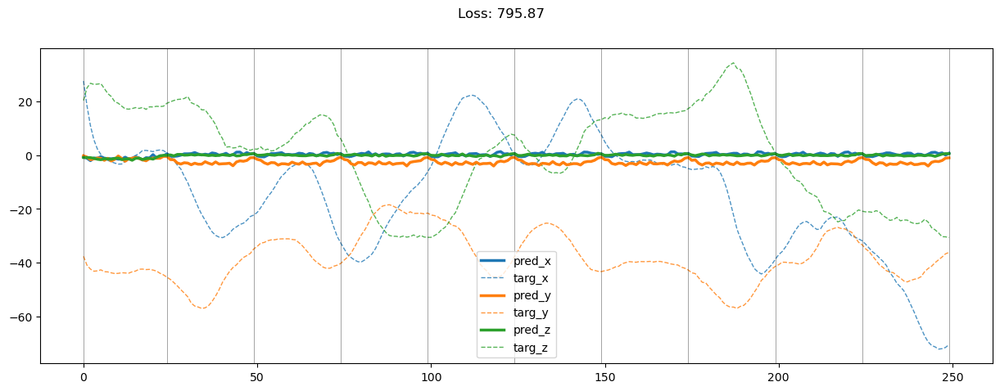

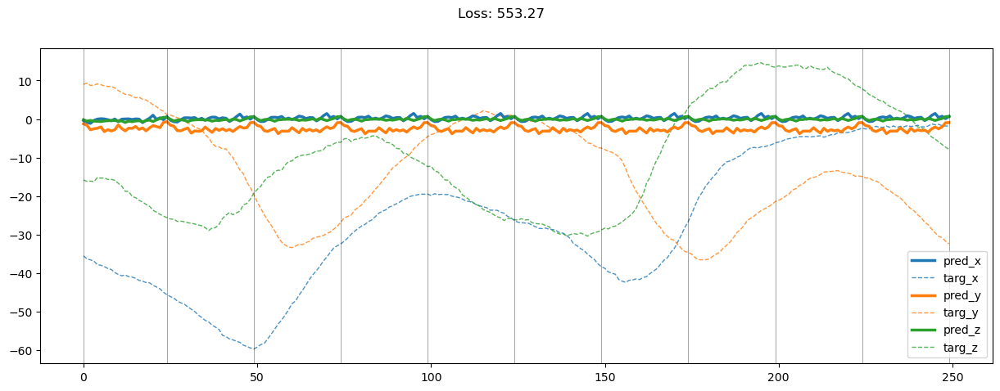

00000: train pred loss:  638.898, g loss:  1575.466, diff loss:  935.842, d loss:  1.264
       valid pred loss:  636.161, g loss:  1383.427, diff loss:  746.608, d loss:  1.127


100%|██████████| 17/17 [00:01<00:00, 15.52it/s]


00001: train pred loss:  601.833, g loss:  1481.984, diff loss:  879.633, d loss:  1.159
       valid pred loss:  625.220, g loss:  1369.365, diff loss:  743.788, d loss:  1.317


100%|██████████| 17/17 [00:01<00:00, 15.50it/s]


00002: train pred loss:  586.218, g loss:  1465.556, diff loss:  879.013, d loss:  1.354
       valid pred loss:  605.216, g loss:  1346.423, diff loss:  740.856, d loss:  1.254


100%|██████████| 17/17 [00:01<00:00, 15.51it/s]


00003: train pred loss:  569.530, g loss:  1397.738, diff loss:  827.609, d loss:  0.862
       valid pred loss:  607.173, g loss:  1360.502, diff loss:  752.550, d loss:  0.671


100%|██████████| 17/17 [00:01<00:00, 15.50it/s]


00004: train pred loss:  548.990, g loss:  1328.886, diff loss:  779.097, d loss:  0.799
       valid pred loss:  584.506, g loss:  1322.091, diff loss:  736.803, d loss:  0.797


100%|██████████| 17/17 [00:01<00:00, 15.27it/s]


00005: train pred loss:  529.301, g loss:  1319.407, diff loss:  789.330, d loss:  0.713
       valid pred loss:  572.196, g loss:  1307.776, diff loss:  734.806, d loss:  0.634


100%|██████████| 17/17 [00:01<00:00, 15.04it/s]


00006: train pred loss:  512.316, g loss:  1291.792, diff loss:  778.733, d loss:  0.662
       valid pred loss:  546.187, g loss:  1265.994, diff loss:  719.258, d loss:  0.892


100%|██████████| 17/17 [00:01<00:00, 15.49it/s]


00007: train pred loss:  482.677, g loss:  1192.013, diff loss:  708.893, d loss:  1.098
       valid pred loss:  540.391, g loss:  1266.131, diff loss:  725.149, d loss:  0.833


100%|██████████| 17/17 [00:01<00:00, 15.48it/s]


00008: train pred loss:  462.383, g loss:  1167.653, diff loss:  704.522, d loss:  0.708
       valid pred loss:  554.103, g loss:  1278.803, diff loss:  723.925, d loss:  0.861


100%|██████████| 17/17 [00:01<00:00, 15.44it/s]


00009: train pred loss:  440.555, g loss:  1133.690, diff loss:  692.361, d loss:  0.918
       valid pred loss:  500.779, g loss:  1213.045, diff loss:  711.493, d loss:  0.690


100%|██████████| 17/17 [00:01<00:00, 15.10it/s]


00010: train pred loss:  408.797, g loss:  1077.937, diff loss:  668.369, d loss:  0.660
       valid pred loss:  524.326, g loss:  1224.128, diff loss:  699.030, d loss:  0.626


100%|██████████| 17/17 [00:01<00:00, 14.78it/s]


00011: train pred loss:  385.991, g loss:  1011.255, diff loss:  624.503, d loss:  0.638
       valid pred loss:  474.606, g loss:  1180.193, diff loss:  704.847, d loss:  0.669


100%|██████████| 17/17 [00:01<00:00, 14.74it/s]


00012: train pred loss:  363.389, g loss:  964.257, diff loss:  600.209, d loss:  0.801
       valid pred loss:  534.790, g loss:  1238.340, diff loss:  702.892, d loss:  0.809


100%|██████████| 17/17 [00:01<00:00, 15.00it/s]


00013: train pred loss:  340.844, g loss:  921.619, diff loss:  580.018, d loss:  0.649
       valid pred loss:  422.632, g loss:  1076.915, diff loss:  653.513, d loss:  0.658


100%|██████████| 17/17 [00:01<00:00, 15.33it/s]


00014: train pred loss:  312.680, g loss:  823.671, diff loss:  510.223, d loss:  0.775
       valid pred loss:  412.454, g loss:  1087.326, diff loss:  674.104, d loss:  0.840


100%|██████████| 17/17 [00:01<00:00, 15.44it/s]


00015: train pred loss:  287.337, g loss:  787.462, diff loss:  499.358, d loss:  0.791
       valid pred loss:  402.326, g loss:  1020.262, diff loss:  617.168, d loss:  0.665


100%|██████████| 17/17 [00:01<00:00, 15.10it/s]


00016: train pred loss:  264.302, g loss:  729.747, diff loss:  464.689, d loss:  0.667
       valid pred loss:  389.882, g loss:  1019.835, diff loss:  629.444, d loss:  1.279


100%|██████████| 17/17 [00:01<00:00, 14.37it/s]


00017: train pred loss:  246.616, g loss:  693.062, diff loss:  445.973, d loss:  1.396
       valid pred loss:  350.452, g loss:  968.585, diff loss:  617.535, d loss:  0.959


100%|██████████| 17/17 [00:01<00:00, 14.10it/s]


00018: train pred loss:  227.051, g loss:  634.894, diff loss:  407.092, d loss:  0.721
       valid pred loss:  397.282, g loss:  1008.659, diff loss:  610.614, d loss:  0.862


100%|██████████| 17/17 [00:01<00:00, 15.39it/s]


00019: train pred loss:  214.285, g loss:  602.511, diff loss:  387.464, d loss:  1.196
       valid pred loss:  361.653, g loss:  1008.048, diff loss:  645.634, d loss:  1.307


100%|██████████| 17/17 [00:01<00:00, 15.39it/s]


00020: train pred loss:  195.678, g loss:  554.287, diff loss:  357.849, d loss:  1.375
       valid pred loss:  329.804, g loss:  942.812, diff loss:  612.248, d loss:  1.389


100%|██████████| 17/17 [00:01<00:00, 15.38it/s]


00021: train pred loss:  177.830, g loss:  496.830, diff loss:  318.241, d loss:  1.389
       valid pred loss:  362.088, g loss:  1019.941, diff loss:  657.095, d loss:  1.393


100%|██████████| 17/17 [00:01<00:00, 15.39it/s]


00022: train pred loss:  165.623, g loss:  460.496, diff loss:  294.116, d loss:  1.390
       valid pred loss:  361.896, g loss:  974.245, diff loss:  611.593, d loss:  1.393


100%|██████████| 17/17 [00:01<00:00, 15.12it/s]


00023: train pred loss:  162.465, g loss:  462.544, diff loss:  299.325, d loss:  1.390
       valid pred loss:  336.310, g loss:  903.541, diff loss:  566.477, d loss:  1.392


100%|██████████| 17/17 [00:01<00:00, 15.31it/s]


00024: train pred loss:  154.960, g loss:  440.219, diff loss:  284.507, d loss:  1.390
       valid pred loss:  324.071, g loss:  879.636, diff loss:  554.814, d loss:  1.391


100%|██████████| 17/17 [00:01<00:00, 15.33it/s]


00025: train pred loss:  143.386, g loss:  402.425, diff loss:  258.289, d loss:  1.390
       valid pred loss:  364.882, g loss:  951.114, diff loss:  585.484, d loss:  1.391


100%|██████████| 17/17 [00:01<00:00, 15.37it/s]


00026: train pred loss:  133.128, g loss:  377.624, diff loss:  243.750, d loss:  1.390
       valid pred loss:  328.177, g loss:  932.711, diff loss:  603.794, d loss:  1.394


100%|██████████| 17/17 [00:01<00:00, 14.93it/s]


00027: train pred loss:  126.166, g loss:  351.622, diff loss:  224.741, d loss:  1.397
       valid pred loss:  304.116, g loss:  850.692, diff loss:  545.907, d loss:  1.411


100%|██████████| 17/17 [00:01<00:00, 15.28it/s]


00028: train pred loss:  117.297, g loss:  335.497, diff loss:  217.586, d loss:  1.414
       valid pred loss:  298.881, g loss:  798.240, diff loss:  498.814, d loss:  1.442


100%|██████████| 17/17 [00:01<00:00, 14.43it/s]


00029: train pred loss:  111.233, g loss:  316.346, diff loss:  204.615, d loss:  1.453
       valid pred loss:  334.700, g loss:  888.181, diff loss:  553.039, d loss:  1.492


100%|██████████| 17/17 [00:01<00:00, 14.51it/s]


00030: train pred loss:  103.190, g loss:  291.496, diff loss:  187.902, d loss:  1.520
       valid pred loss:  346.748, g loss:  870.158, diff loss:  523.047, d loss:  1.568


100%|██████████| 17/17 [00:01<00:00, 15.02it/s]


00031: train pred loss:  98.641, g loss:  276.563, diff loss:  177.580, d loss:  1.591
       valid pred loss:  289.982, g loss:  771.695, diff loss:  481.389, d loss:  1.617


100%|██████████| 17/17 [00:01<00:00, 15.08it/s]


00032: train pred loss:  97.453, g loss:  271.723, diff loss:  173.952, d loss:  1.624
       valid pred loss:  317.583, g loss:  849.349, diff loss:  531.457, d loss:  1.638


100%|██████████| 17/17 [00:01<00:00, 15.28it/s]


00033: train pred loss:  90.111, g loss:  252.597, diff loss:  162.184, d loss:  1.649
       valid pred loss:  273.613, g loss:  734.596, diff loss:  460.685, d loss:  1.657


100%|██████████| 17/17 [00:01<00:00, 15.15it/s]


00034: train pred loss:  87.321, g loss:  245.934, diff loss:  158.316, d loss:  1.660
       valid pred loss:  274.402, g loss:  715.371, diff loss:  440.672, d loss:  1.658


100%|██████████| 17/17 [00:01<00:00, 15.24it/s]


00035: train pred loss:  81.574, g loss:  229.401, diff loss:  147.527, d loss:  1.653
       valid pred loss:  274.185, g loss:  736.456, diff loss:  461.967, d loss:  1.643


100%|██████████| 17/17 [00:01<00:00, 14.80it/s]


00036: train pred loss:  80.874, g loss:  225.306, diff loss:  144.121, d loss:  1.632
       valid pred loss:  295.973, g loss:  769.064, diff loss:  472.770, d loss:  1.614


100%|██████████| 17/17 [00:01<00:00, 14.85it/s]


00037: train pred loss:  77.250, g loss:  216.281, diff loss:  138.701, d loss:  1.600
       valid pred loss:  269.569, g loss:  726.312, diff loss:  456.401, d loss:  1.581


100%|██████████| 17/17 [00:01<00:00, 15.13it/s]


00038: train pred loss:  77.066, g loss:  219.525, diff loss:  142.105, d loss:  1.565
       valid pred loss:  275.624, g loss:  725.347, diff loss:  449.356, d loss:  1.547


100%|██████████| 17/17 [00:01<00:00, 15.25it/s]


00039: train pred loss:  72.620, g loss:  204.291, diff loss:  131.291, d loss:  1.531
       valid pred loss:  300.485, g loss:  763.194, diff loss:  462.313, d loss:  1.514


100%|██████████| 17/17 [00:01<00:00, 14.72it/s]


00040: train pred loss:  69.632, g loss:  195.322, diff loss:  125.280, d loss:  1.500
       valid pred loss:  272.596, g loss:  718.615, diff loss:  445.594, d loss:  1.485


100%|██████████| 17/17 [00:01<00:00, 15.11it/s]


00041: train pred loss:  70.260, g loss:  195.295, diff loss:  124.598, d loss:  1.475
       valid pred loss:  268.209, g loss:  726.210, diff loss:  457.548, d loss:  1.462


100%|██████████| 17/17 [00:01<00:00, 15.01it/s]


00042: train pred loss:  64.505, g loss:  181.346, diff loss:  116.379, d loss:  1.456
       valid pred loss:  239.587, g loss:  639.754, diff loss:  399.697, d loss:  1.450


100%|██████████| 17/17 [00:01<00:00, 15.03it/s]


00043: train pred loss:  61.780, g loss:  172.856, diff loss:  110.601, d loss:  1.447
       valid pred loss:  300.128, g loss:  772.765, diff loss:  472.156, d loss:  1.443


100%|██████████| 17/17 [00:01<00:00, 14.99it/s]


00044: train pred loss:  59.046, g loss:  167.100, diff loss:  107.569, d loss:  1.440
       valid pred loss:  270.133, g loss:  713.566, diff loss:  442.943, d loss:  1.438


100%|██████████| 17/17 [00:01<00:00, 14.99it/s]


00045: train pred loss:  57.200, g loss:  160.584, diff loss:  102.893, d loss:  1.437
       valid pred loss:  301.449, g loss:  761.232, diff loss:  459.291, d loss:  1.436


100%|██████████| 17/17 [00:01<00:00, 14.96it/s]


00046: train pred loss:  55.380, g loss:  154.621, diff loss:  98.749, d loss:  1.437
       valid pred loss:  271.956, g loss:  681.969, diff loss:  409.522, d loss:  1.437


100%|██████████| 17/17 [00:01<00:00, 14.79it/s]


00047: train pred loss:  53.903, g loss:  150.621, diff loss:  96.230, d loss:  1.439
       valid pred loss:  277.839, g loss:  683.940, diff loss:  405.616, d loss:  1.440


100%|██████████| 17/17 [00:01<00:00, 14.78it/s]


00048: train pred loss:  51.969, g loss:  147.195, diff loss:  94.745, d loss:  1.443
       valid pred loss:  289.935, g loss:  703.810, diff loss:  413.398, d loss:  1.446


100%|██████████| 17/17 [00:01<00:00, 14.71it/s]


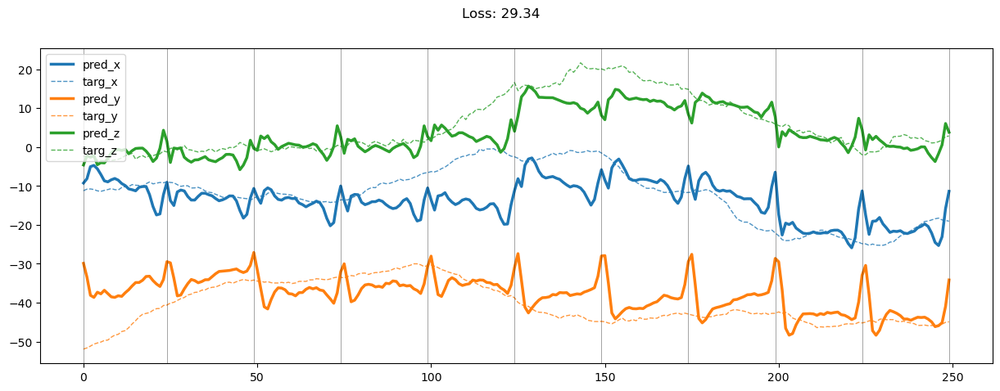

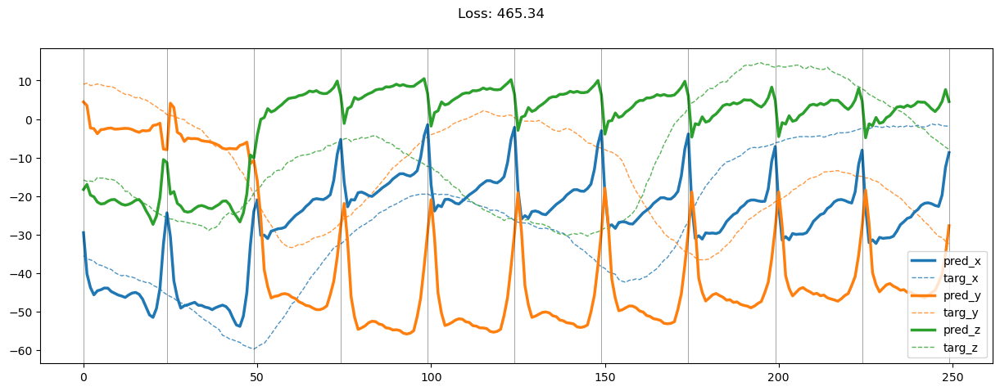

00049: train pred loss:  49.971, g loss:  143.046, diff loss:  92.605, d loss:  1.450
       valid pred loss:  270.762, g loss:  665.949, diff loss:  394.723, d loss:  1.454


100%|██████████| 17/17 [00:01<00:00, 14.63it/s]


00050: train pred loss:  50.553, g loss:  140.234, diff loss:  89.224, d loss:  1.460
       valid pred loss:  244.814, g loss:  642.381, diff loss:  397.118, d loss:  1.466


100%|██████████| 17/17 [00:01<00:00, 14.56it/s]


00051: train pred loss:  47.763, g loss:  134.902, diff loss:  86.699, d loss:  1.473
       valid pred loss:  260.496, g loss:  645.336, diff loss:  384.409, d loss:  1.480


100%|██████████| 17/17 [00:01<00:00, 14.84it/s]


00052: train pred loss:  47.138, g loss:  132.096, diff loss:  84.535, d loss:  1.488
       valid pred loss:  241.154, g loss:  615.665, diff loss:  374.097, d loss:  1.496


100%|██████████| 17/17 [00:01<00:00, 15.04it/s]


00053: train pred loss:  45.615, g loss:  130.534, diff loss:  84.514, d loss:  1.504
       valid pred loss:  248.476, g loss:  625.433, diff loss:  376.560, d loss:  1.512


100%|██████████| 17/17 [00:01<00:00, 14.61it/s]


00054: train pred loss:  45.405, g loss:  127.688, diff loss:  81.894, d loss:  1.521
       valid pred loss:  270.627, g loss:  663.837, diff loss:  392.829, d loss:  1.530


100%|██████████| 17/17 [00:01<00:00, 14.69it/s]


00055: train pred loss:  43.876, g loss:  124.059, diff loss:  79.808, d loss:  1.538
       valid pred loss:  281.846, g loss:  702.028, diff loss:  419.815, d loss:  1.546


100%|██████████| 17/17 [00:01<00:00, 14.72it/s]


00056: train pred loss:  41.752, g loss:  117.915, diff loss:  75.801, d loss:  1.554
       valid pred loss:  243.284, g loss:  636.407, diff loss:  392.766, d loss:  1.561


100%|██████████| 17/17 [00:01<00:00, 14.54it/s]


00057: train pred loss:  42.205, g loss:  119.658, diff loss:  77.101, d loss:  1.568
       valid pred loss:  253.365, g loss:  649.136, diff loss:  395.424, d loss:  1.573


100%|██████████| 17/17 [00:01<00:00, 14.69it/s]


00058: train pred loss:  43.007, g loss:  120.141, diff loss:  76.791, d loss:  1.579
       valid pred loss:  267.756, g loss:  660.046, diff loss:  391.951, d loss:  1.584


100%|██████████| 17/17 [00:01<00:00, 14.58it/s]


00059: train pred loss:  40.586, g loss:  115.029, diff loss:  74.105, d loss:  1.588
       valid pred loss:  251.547, g loss:  631.336, diff loss:  379.453, d loss:  1.590


100%|██████████| 17/17 [00:01<00:00, 14.86it/s]


00060: train pred loss:  39.091, g loss:  110.664, diff loss:  71.238, d loss:  1.592
       valid pred loss:  262.991, g loss:  645.095, diff loss:  381.769, d loss:  1.591


100%|██████████| 17/17 [00:01<00:00, 14.58it/s]


00061: train pred loss:  37.876, g loss:  107.652, diff loss:  69.441, d loss:  1.592
       valid pred loss:  250.458, g loss:  629.546, diff loss:  378.752, d loss:  1.590


100%|██████████| 17/17 [00:01<00:00, 15.04it/s]


00062: train pred loss:  36.968, g loss:  105.187, diff loss:  67.882, d loss:  1.588
       valid pred loss:  244.621, g loss:  605.983, diff loss:  361.023, d loss:  1.584


100%|██████████| 17/17 [00:01<00:00, 15.11it/s]


00063: train pred loss:  36.607, g loss:  104.029, diff loss:  67.080, d loss:  1.581
       valid pred loss:  259.176, g loss:  633.007, diff loss:  373.484, d loss:  1.575


100%|██████████| 17/17 [00:01<00:00, 15.05it/s]


00064: train pred loss:  35.611, g loss:  102.605, diff loss:  66.645, d loss:  1.571
       valid pred loss:  222.330, g loss:  561.946, diff loss:  339.262, d loss:  1.564


100%|██████████| 17/17 [00:01<00:00, 14.61it/s]


00065: train pred loss:  35.826, g loss:  101.789, diff loss:  65.604, d loss:  1.558
       valid pred loss:  242.133, g loss:  601.009, diff loss:  358.511, d loss:  1.550


100%|██████████| 17/17 [00:01<00:00, 14.35it/s]


00066: train pred loss:  34.467, g loss:  97.613, diff loss:  62.776, d loss:  1.544
       valid pred loss:  252.690, g loss:  640.530, diff loss:  387.463, d loss:  1.536


100%|██████████| 17/17 [00:01<00:00, 14.16it/s]


00067: train pred loss:  34.261, g loss:  97.604, diff loss:  62.961, d loss:  1.529
       valid pred loss:  228.687, g loss:  584.924, diff loss:  355.848, d loss:  1.521


100%|██████████| 17/17 [00:01<00:00, 15.15it/s]


00068: train pred loss:  33.453, g loss:  95.091, diff loss:  61.243, d loss:  1.514
       valid pred loss:  232.515, g loss:  588.867, diff loss:  355.950, d loss:  1.506


100%|██████████| 17/17 [00:01<00:00, 15.16it/s]


00069: train pred loss:  32.143, g loss:  91.601, diff loss:  59.049, d loss:  1.500
       valid pred loss:  263.472, g loss:  657.008, diff loss:  393.118, d loss:  1.492


100%|██████████| 17/17 [00:01<00:00, 14.79it/s]


00070: train pred loss:  31.340, g loss:  88.418, diff loss:  56.655, d loss:  1.487
       valid pred loss:  241.359, g loss:  609.076, diff loss:  367.285, d loss:  1.479


100%|██████████| 17/17 [00:01<00:00, 14.18it/s]


00071: train pred loss:  31.212, g loss:  90.054, diff loss:  58.405, d loss:  1.474
       valid pred loss:  250.512, g loss:  607.607, diff loss:  356.649, d loss:  1.468


100%|██████████| 17/17 [00:01<00:00, 14.52it/s]


00072: train pred loss:  31.138, g loss:  88.292, diff loss:  56.704, d loss:  1.464
       valid pred loss:  255.102, g loss:  655.614, diff loss:  400.055, d loss:  1.459


100%|██████████| 17/17 [00:01<00:00, 15.12it/s]


00073: train pred loss:  30.014, g loss:  86.949, diff loss:  56.474, d loss:  1.456
       valid pred loss:  226.738, g loss:  583.436, diff loss:  356.232, d loss:  1.452


100%|██████████| 17/17 [00:01<00:00, 15.17it/s]


00074: train pred loss:  29.345, g loss:  84.045, diff loss:  54.231, d loss:  1.451
       valid pred loss:  238.989, g loss:  593.823, diff loss:  354.361, d loss:  1.448


100%|██████████| 17/17 [00:01<00:00, 15.15it/s]


00075: train pred loss:  28.860, g loss:  83.075, diff loss:  53.739, d loss:  1.446
       valid pred loss:  233.944, g loss:  587.065, diff loss:  352.642, d loss:  1.444


100%|██████████| 17/17 [00:01<00:00, 15.05it/s]


00076: train pred loss:  28.439, g loss:  81.242, diff loss:  52.322, d loss:  1.443
       valid pred loss:  233.601, g loss:  592.812, diff loss:  358.729, d loss:  1.442


100%|██████████| 17/17 [00:01<00:00, 15.17it/s]


00077: train pred loss:  27.588, g loss:  79.280, diff loss:  51.209, d loss:  1.442
       valid pred loss:  219.786, g loss:  563.469, diff loss:  343.199, d loss:  1.441


100%|██████████| 17/17 [00:01<00:00, 15.16it/s]


00078: train pred loss:  27.682, g loss:  79.797, diff loss:  51.631, d loss:  1.442
       valid pred loss:  262.810, g loss:  639.077, diff loss:  375.784, d loss:  1.442


100%|██████████| 17/17 [00:01<00:00, 15.19it/s]


00079: train pred loss:  26.938, g loss:  77.264, diff loss:  49.846, d loss:  1.444
       valid pred loss:  238.428, g loss:  607.126, diff loss:  368.220, d loss:  1.445


100%|██████████| 17/17 [00:01<00:00, 14.67it/s]


00080: train pred loss:  26.396, g loss:  75.638, diff loss:  48.767, d loss:  1.447
       valid pred loss:  231.290, g loss:  588.423, diff loss:  356.662, d loss:  1.449


100%|██████████| 17/17 [00:01<00:00, 14.96it/s]


00081: train pred loss:  25.125, g loss:  72.876, diff loss:  47.286, d loss:  1.453
       valid pred loss:  239.103, g loss:  603.270, diff loss:  363.706, d loss:  1.456


100%|██████████| 17/17 [00:01<00:00, 14.44it/s]


00082: train pred loss:  25.474, g loss:  73.637, diff loss:  47.708, d loss:  1.461
       valid pred loss:  228.142, g loss:  583.994, diff loss:  355.402, d loss:  1.464


100%|██████████| 17/17 [00:01<00:00, 14.66it/s]


00083: train pred loss:  24.738, g loss:  71.639, diff loss:  46.458, d loss:  1.470
       valid pred loss:  230.642, g loss:  568.704, diff loss:  337.625, d loss:  1.474


100%|██████████| 17/17 [00:01<00:00, 13.92it/s]


00084: train pred loss:  24.349, g loss:  71.418, diff loss:  46.638, d loss:  1.480
       valid pred loss:  236.189, g loss:  602.848, diff loss:  366.235, d loss:  1.485


100%|██████████| 17/17 [00:01<00:00, 14.84it/s]


00085: train pred loss:  23.621, g loss:  68.031, diff loss:  43.993, d loss:  1.492
       valid pred loss:  235.516, g loss:  610.927, diff loss:  375.000, d loss:  1.498


100%|██████████| 17/17 [00:01<00:00, 15.02it/s]


00086: train pred loss:  23.666, g loss:  68.553, diff loss:  44.482, d loss:  1.505
       valid pred loss:  257.086, g loss:  615.264, diff loss:  357.780, d loss:  1.510


100%|██████████| 17/17 [00:01<00:00, 15.09it/s]


00087: train pred loss:  22.574, g loss:  65.142, diff loss:  42.177, d loss:  1.518
       valid pred loss:  240.218, g loss:  592.881, diff loss:  352.277, d loss:  1.524


100%|██████████| 17/17 [00:01<00:00, 15.21it/s]


00088: train pred loss:  22.097, g loss:  63.575, diff loss:  41.098, d loss:  1.532
       valid pred loss:  245.021, g loss:  608.109, diff loss:  362.713, d loss:  1.537


100%|██████████| 17/17 [00:01<00:00, 15.23it/s]


00089: train pred loss:  22.542, g loss:  64.830, diff loss:  41.920, d loss:  1.545
       valid pred loss:  217.644, g loss:  578.899, diff loss:  360.890, d loss:  1.549


100%|██████████| 17/17 [00:01<00:00, 15.17it/s]


00090: train pred loss:  21.668, g loss:  62.286, diff loss:  40.259, d loss:  1.557
       valid pred loss:  225.697, g loss:  556.873, diff loss:  330.820, d loss:  1.560


100%|██████████| 17/17 [00:01<00:00, 14.88it/s]


00091: train pred loss:  21.098, g loss:  61.017, diff loss:  39.567, d loss:  1.567
       valid pred loss:  234.833, g loss:  595.196, diff loss:  360.014, d loss:  1.569


100%|██████████| 17/17 [00:01<00:00, 15.04it/s]


00092: train pred loss:  21.294, g loss:  61.620, diff loss:  39.980, d loss:  1.576
       valid pred loss:  235.606, g loss:  586.830, diff loss:  350.880, d loss:  1.576


100%|██████████| 17/17 [00:01<00:00, 14.29it/s]


00093: train pred loss:  21.613, g loss:  62.461, diff loss:  40.507, d loss:  1.583
       valid pred loss:  197.873, g loss:  507.411, diff loss:  309.198, d loss:  1.581


100%|██████████| 17/17 [00:01<00:00, 15.24it/s]


00094: train pred loss:  21.149, g loss:  61.404, diff loss:  39.916, d loss:  1.585
       valid pred loss:  231.672, g loss:  569.925, diff loss:  337.914, d loss:  1.582


100%|██████████| 17/17 [00:01<00:00, 14.98it/s]


00095: train pred loss:  20.716, g loss:  59.874, diff loss:  38.819, d loss:  1.586
       valid pred loss:  232.521, g loss:  583.706, diff loss:  350.845, d loss:  1.582


100%|██████████| 17/17 [00:01<00:00, 15.10it/s]


00096: train pred loss:  21.009, g loss:  60.874, diff loss:  39.525, d loss:  1.584
       valid pred loss:  251.631, g loss:  607.574, diff loss:  355.600, d loss:  1.578


100%|██████████| 17/17 [00:01<00:00, 14.12it/s]


00097: train pred loss:  20.082, g loss:  58.625, diff loss:  38.201, d loss:  1.581
       valid pred loss:  227.338, g loss:  587.144, diff loss:  359.461, d loss:  1.573


100%|██████████| 17/17 [00:01<00:00, 13.74it/s]


00098: train pred loss:  20.106, g loss:  58.538, diff loss:  38.086, d loss:  1.574
       valid pred loss:  231.423, g loss:  585.890, diff loss:  354.117, d loss:  1.565


100%|██████████| 17/17 [00:01<00:00, 14.01it/s]


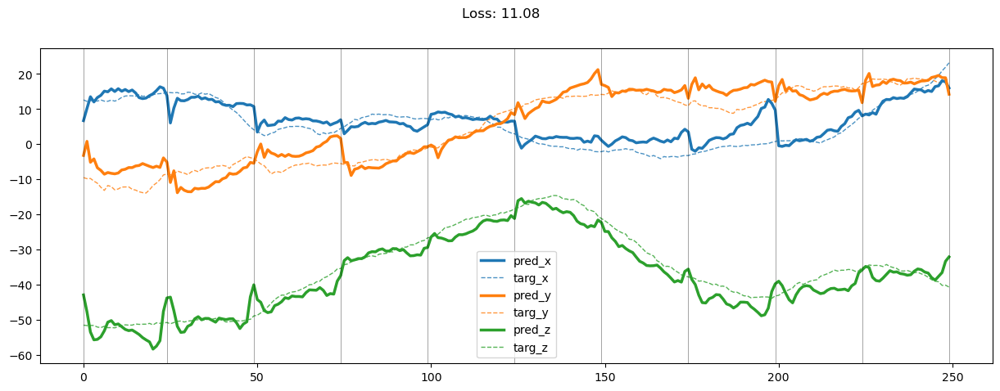

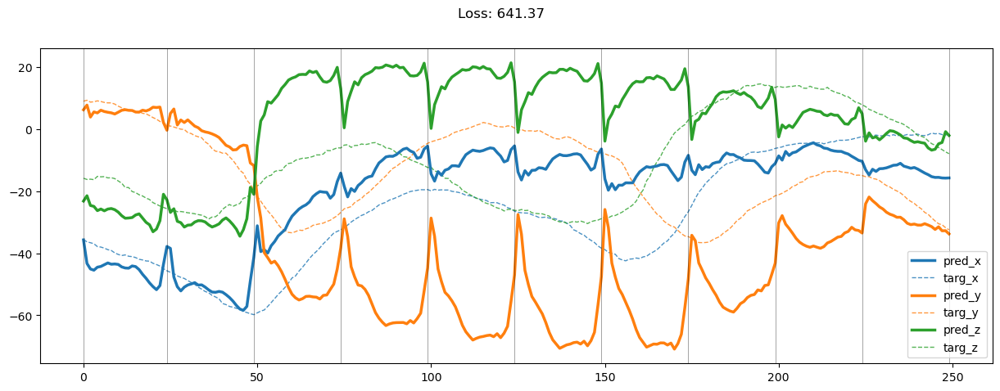

00099: train pred loss:  19.175, g loss:  55.382, diff loss:  35.855, d loss:  1.566
       valid pred loss:  243.383, g loss:  614.982, diff loss:  371.241, d loss:  1.554


100%|██████████| 17/17 [00:01<00:00, 15.24it/s]


00100: train pred loss:  18.179, g loss:  52.795, diff loss:  34.257, d loss:  1.557
       valid pred loss:  235.372, g loss:  577.146, diff loss:  341.408, d loss:  1.544


100%|██████████| 17/17 [00:01<00:00, 15.15it/s]


00101: train pred loss:  18.256, g loss:  53.039, diff loss:  34.415, d loss:  1.545
       valid pred loss:  220.446, g loss:  548.482, diff loss:  327.660, d loss:  1.531


100%|██████████| 17/17 [00:01<00:00, 15.05it/s]


00102: train pred loss:  18.597, g loss:  53.852, diff loss:  34.876, d loss:  1.533
       valid pred loss:  214.764, g loss:  546.609, diff loss:  331.458, d loss:  1.520


100%|██████████| 17/17 [00:01<00:00, 15.21it/s]


00103: train pred loss:  17.613, g loss:  51.498, diff loss:  33.495, d loss:  1.521
       valid pred loss:  227.049, g loss:  549.296, diff loss:  321.848, d loss:  1.506


100%|██████████| 17/17 [00:01<00:00, 15.21it/s]


00104: train pred loss:  17.308, g loss:  50.081, diff loss:  32.371, d loss:  1.508
       valid pred loss:  227.418, g loss:  573.855, diff loss:  346.026, d loss:  1.493


100%|██████████| 17/17 [00:01<00:00, 15.20it/s]


00105: train pred loss:  17.815, g loss:  51.560, diff loss:  33.331, d loss:  1.497
       valid pred loss:  225.038, g loss:  569.596, diff loss:  344.134, d loss:  1.481


100%|██████████| 17/17 [00:01<00:00, 15.16it/s]


00106: train pred loss:  16.995, g loss:  49.575, diff loss:  32.155, d loss:  1.487
       valid pred loss:  230.179, g loss:  578.098, diff loss:  347.483, d loss:  1.471


100%|██████████| 17/17 [00:01<00:00, 15.19it/s]


00107: train pred loss:  16.619, g loss:  48.547, diff loss:  31.492, d loss:  1.476
       valid pred loss:  241.152, g loss:  611.455, diff loss:  369.857, d loss:  1.460


100%|██████████| 17/17 [00:01<00:00, 15.19it/s]


00108: train pred loss:  16.697, g loss:  48.520, diff loss:  31.374, d loss:  1.466
       valid pred loss:  219.368, g loss:  562.006, diff loss:  342.180, d loss:  1.451


100%|██████████| 17/17 [00:01<00:00, 15.21it/s]


00109: train pred loss:  16.415, g loss:  48.057, diff loss:  31.184, d loss:  1.459
       valid pred loss:  225.083, g loss:  581.168, diff loss:  355.617, d loss:  1.445


100%|██████████| 17/17 [00:01<00:00, 15.21it/s]


00110: train pred loss:  16.883, g loss:  49.265, diff loss:  31.915, d loss:  1.453
       valid pred loss:  222.421, g loss:  569.327, diff loss:  346.429, d loss:  1.439


100%|██████████| 17/17 [00:01<00:00, 15.08it/s]


00111: train pred loss:  16.351, g loss:  47.581, diff loss:  30.754, d loss:  1.447
       valid pred loss:  239.311, g loss:  592.082, diff loss:  352.287, d loss:  1.434


100%|██████████| 17/17 [00:01<00:00, 15.15it/s]


00112: train pred loss:  15.920, g loss:  46.638, diff loss:  30.238, d loss:  1.444
       valid pred loss:  269.097, g loss:  650.049, diff loss:  380.463, d loss:  1.431


100%|██████████| 17/17 [00:01<00:00, 15.13it/s]


00113: train pred loss:  16.425, g loss:  47.613, diff loss:  30.703, d loss:  1.441
       valid pred loss:  227.872, g loss:  567.003, diff loss:  338.641, d loss:  1.430


100%|██████████| 17/17 [00:01<00:00, 15.14it/s]


00114: train pred loss:  15.997, g loss:  46.921, diff loss:  30.436, d loss:  1.439
       valid pred loss:  221.870, g loss:  565.987, diff loss:  343.627, d loss:  1.433


100%|██████████| 17/17 [00:01<00:00, 15.07it/s]


00115: train pred loss:  15.301, g loss:  44.471, diff loss:  28.683, d loss:  1.440
       valid pred loss:  201.630, g loss:  529.566, diff loss:  327.446, d loss:  1.429


100%|██████████| 17/17 [00:01<00:00, 15.10it/s]


00116: train pred loss:  15.308, g loss:  45.173, diff loss:  29.380, d loss:  1.441
       valid pred loss:  218.791, g loss:  552.365, diff loss:  333.086, d loss:  1.431


100%|██████████| 17/17 [00:01<00:00, 15.09it/s]


00117: train pred loss:  15.199, g loss:  44.344, diff loss:  28.665, d loss:  1.444
       valid pred loss:  210.460, g loss:  543.278, diff loss:  332.337, d loss:  1.434


100%|██████████| 17/17 [00:01<00:00, 15.15it/s]


00118: train pred loss:  14.970, g loss:  43.926, diff loss:  28.481, d loss:  1.448
       valid pred loss:  231.658, g loss:  578.169, diff loss:  346.037, d loss:  1.439


100%|██████████| 17/17 [00:01<00:00, 15.05it/s]


00119: train pred loss:  15.074, g loss:  44.168, diff loss:  28.629, d loss:  1.454
       valid pred loss:  227.082, g loss:  581.633, diff loss:  354.087, d loss:  1.449


100%|██████████| 17/17 [00:01<00:00, 15.10it/s]


00120: train pred loss:  14.734, g loss:  43.227, diff loss:  28.037, d loss:  1.460
       valid pred loss:  240.758, g loss:  597.874, diff loss:  356.662, d loss:  1.453


100%|██████████| 17/17 [00:01<00:00, 15.12it/s]


00121: train pred loss:  14.111, g loss:  41.192, diff loss:  26.636, d loss:  1.469
       valid pred loss:  231.957, g loss:  588.346, diff loss:  355.947, d loss:  1.464


100%|██████████| 17/17 [00:01<00:00, 15.03it/s]


00122: train pred loss:  14.589, g loss:  42.678, diff loss:  27.656, d loss:  1.477
       valid pred loss:  220.124, g loss:  562.325, diff loss:  341.769, d loss:  1.472


100%|██████████| 17/17 [00:01<00:00, 15.00it/s]


00123: train pred loss:  14.449, g loss:  41.729, diff loss:  26.859, d loss:  1.489
       valid pred loss:  230.899, g loss:  594.131, diff loss:  362.814, d loss:  1.484


100%|██████████| 17/17 [00:01<00:00, 14.98it/s]


00124: train pred loss:  14.212, g loss:  41.188, diff loss:  26.566, d loss:  1.499
       valid pred loss:  235.963, g loss:  594.244, diff loss:  357.875, d loss:  1.498


100%|██████████| 17/17 [00:01<00:00, 14.99it/s]


00125: train pred loss:  13.560, g loss:  39.809, diff loss:  25.851, d loss:  1.512
       valid pred loss:  246.706, g loss:  624.223, diff loss:  377.124, d loss:  1.511


100%|██████████| 17/17 [00:01<00:00, 15.11it/s]


00126: train pred loss:  13.360, g loss:  39.184, diff loss:  25.437, d loss:  1.523
       valid pred loss:  232.002, g loss:  581.464, diff loss:  349.077, d loss:  1.519


100%|██████████| 17/17 [00:01<00:00, 14.93it/s]


00127: train pred loss:  13.327, g loss:  38.882, diff loss:  25.176, d loss:  1.534
       valid pred loss:  239.511, g loss:  586.080, diff loss:  346.194, d loss:  1.531


100%|██████████| 17/17 [00:01<00:00, 15.05it/s]


00128: train pred loss:  13.052, g loss:  38.223, diff loss:  24.802, d loss:  1.546
       valid pred loss:  218.841, g loss:  558.637, diff loss:  339.429, d loss:  1.543


100%|██████████| 17/17 [00:01<00:00, 14.95it/s]


00129: train pred loss:  13.540, g loss:  39.952, diff loss:  26.051, d loss:  1.555
       valid pred loss:  225.418, g loss:  567.553, diff loss:  341.776, d loss:  1.554


100%|██████████| 17/17 [00:01<00:00, 14.98it/s]


00130: train pred loss:  13.830, g loss:  40.307, diff loss:  26.123, d loss:  1.565
       valid pred loss:  215.542, g loss:  556.119, diff loss:  340.225, d loss:  1.562


100%|██████████| 17/17 [00:01<00:00, 15.11it/s]


00131: train pred loss:  13.002, g loss:  38.225, diff loss:  24.876, d loss:  1.573
       valid pred loss:  204.408, g loss:  537.228, diff loss:  332.474, d loss:  1.570


100%|██████████| 17/17 [00:01<00:00, 14.86it/s]


00132: train pred loss:  13.260, g loss:  38.904, diff loss:  25.302, d loss:  1.581
       valid pred loss:  196.201, g loss:  513.210, diff loss:  316.667, d loss:  1.577


100%|██████████| 17/17 [00:01<00:00, 14.99it/s]


00133: train pred loss:  13.801, g loss:  39.992, diff loss:  25.852, d loss:  1.586
       valid pred loss:  252.788, g loss:  657.903, diff loss:  404.777, d loss:  1.581


100%|██████████| 17/17 [00:01<00:00, 15.02it/s]


00134: train pred loss:  13.990, g loss:  41.088, diff loss:  26.762, d loss:  1.589
       valid pred loss:  207.257, g loss:  522.864, diff loss:  315.269, d loss:  1.584


100%|██████████| 17/17 [00:01<00:00, 15.03it/s]


00135: train pred loss:  13.542, g loss:  39.707, diff loss:  25.830, d loss:  1.591
       valid pred loss:  226.618, g loss:  601.584, diff loss:  374.629, d loss:  1.585


100%|██████████| 17/17 [00:01<00:00, 15.01it/s]


00136: train pred loss:  12.860, g loss:  37.513, diff loss:  24.317, d loss:  1.590
       valid pred loss:  217.438, g loss:  565.662, diff loss:  347.886, d loss:  1.583


100%|██████████| 17/17 [00:01<00:00, 14.98it/s]


00137: train pred loss:  12.530, g loss:  36.951, diff loss:  24.084, d loss:  1.587
       valid pred loss:  195.114, g loss:  517.274, diff loss:  321.820, d loss:  1.581


100%|██████████| 17/17 [00:01<00:00, 14.96it/s]


00138: train pred loss:  12.002, g loss:  35.404, diff loss:  23.060, d loss:  1.583
       valid pred loss:  194.306, g loss:  502.524, diff loss:  307.874, d loss:  1.576


100%|██████████| 17/17 [00:01<00:00, 14.93it/s]


00139: train pred loss:  12.215, g loss:  36.290, diff loss:  23.730, d loss:  1.577
       valid pred loss:  217.627, g loss:  556.499, diff loss:  338.523, d loss:  1.568


100%|██████████| 17/17 [00:01<00:00, 15.08it/s]


00140: train pred loss:  11.731, g loss:  34.668, diff loss:  22.587, d loss:  1.570
       valid pred loss:  216.315, g loss:  553.663, diff loss:  336.994, d loss:  1.560


100%|██████████| 17/17 [00:01<00:00, 15.06it/s]


00141: train pred loss:  11.802, g loss:  34.898, diff loss:  22.738, d loss:  1.559
       valid pred loss:  211.730, g loss:  550.193, diff loss:  338.101, d loss:  1.552


100%|██████████| 17/17 [00:01<00:00, 15.10it/s]


00142: train pred loss:  11.169, g loss:  32.873, diff loss:  21.339, d loss:  1.549
       valid pred loss:  201.624, g loss:  522.597, diff loss:  320.603, d loss:  1.541


100%|██████████| 17/17 [00:01<00:00, 15.05it/s]


00143: train pred loss:  11.034, g loss:  32.796, diff loss:  21.387, d loss:  1.539
       valid pred loss:  211.768, g loss:  537.960, diff loss:  325.813, d loss:  1.531


100%|██████████| 17/17 [00:01<00:00, 15.14it/s]


00144: train pred loss:  10.993, g loss:  32.532, diff loss:  21.156, d loss:  1.528
       valid pred loss:  205.346, g loss:  528.527, diff loss:  322.792, d loss:  1.519


100%|██████████| 17/17 [00:01<00:00, 15.00it/s]


00145: train pred loss:  11.184, g loss:  32.891, diff loss:  21.314, d loss:  1.517
       valid pred loss:  214.493, g loss:  543.495, diff loss:  328.602, d loss:  1.508


100%|██████████| 17/17 [00:01<00:00, 14.98it/s]


00146: train pred loss:  11.066, g loss:  33.104, diff loss:  21.635, d loss:  1.506
       valid pred loss:  206.878, g loss:  518.435, diff loss:  311.147, d loss:  1.498


100%|██████████| 17/17 [00:01<00:00, 14.93it/s]


00147: train pred loss:  11.210, g loss:  33.370, diff loss:  21.746, d loss:  1.496
       valid pred loss:  196.532, g loss:  511.461, diff loss:  314.509, d loss:  1.488


100%|██████████| 17/17 [00:01<00:00, 15.03it/s]


00148: train pred loss:  11.606, g loss:  34.207, diff loss:  22.177, d loss:  1.486
       valid pred loss:  228.412, g loss:  574.702, diff loss:  345.859, d loss:  1.479


100%|██████████| 17/17 [00:01<00:00, 15.09it/s]


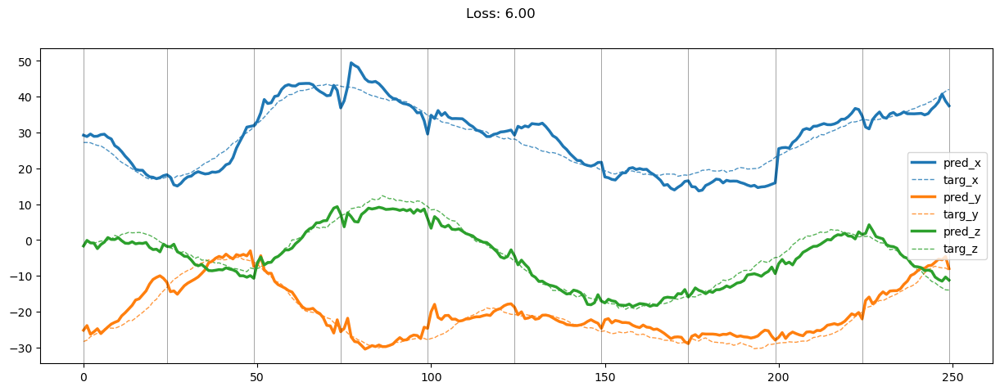

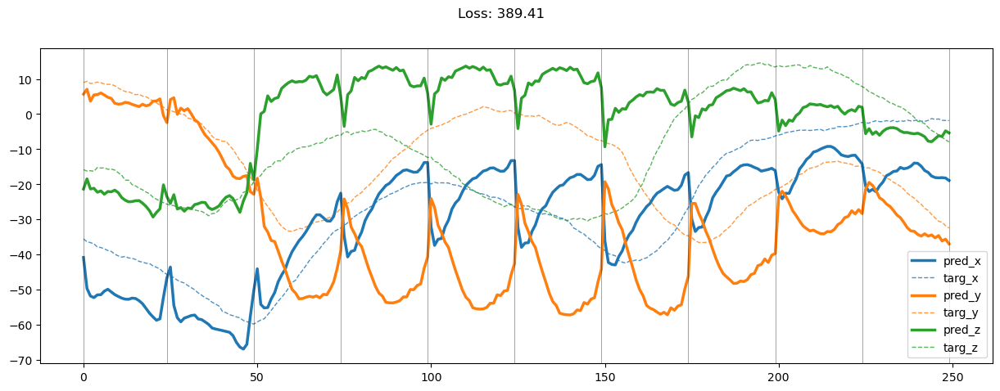

00149: train pred loss:  11.131, g loss:  33.177, diff loss:  21.611, d loss:  1.477
       valid pred loss:  206.542, g loss:  534.256, diff loss:  327.275, d loss:  1.471


100%|██████████| 17/17 [00:01<00:00, 15.15it/s]


00150: train pred loss:  11.149, g loss:  32.937, diff loss:  21.343, d loss:  1.469
       valid pred loss:  185.479, g loss:  486.943, diff loss:  301.014, d loss:  1.463


100%|██████████| 17/17 [00:01<00:00, 15.00it/s]


00151: train pred loss:  11.146, g loss:  33.008, diff loss:  21.409, d loss:  1.463
       valid pred loss:  202.462, g loss:  537.216, diff loss:  334.296, d loss:  1.457


100%|██████████| 17/17 [00:01<00:00, 15.03it/s]


00152: train pred loss:  10.774, g loss:  32.117, diff loss:  20.882, d loss:  1.456
       valid pred loss:  206.881, g loss:  545.908, diff loss:  338.561, d loss:  1.451


100%|██████████| 17/17 [00:01<00:00, 14.59it/s]


00153: train pred loss:  10.909, g loss:  32.274, diff loss:  20.896, d loss:  1.451
       valid pred loss:  194.359, g loss:  523.202, diff loss:  328.371, d loss:  1.447


100%|██████████| 17/17 [00:01<00:00, 15.06it/s]


00154: train pred loss:  10.698, g loss:  31.593, diff loss:  20.419, d loss:  1.447
       valid pred loss:  185.495, g loss:  506.147, diff loss:  320.174, d loss:  1.443


100%|██████████| 17/17 [00:01<00:00, 15.02it/s]


00155: train pred loss:  10.916, g loss:  32.051, diff loss:  20.654, d loss:  1.444
       valid pred loss:  211.472, g loss:  544.582, diff loss:  332.628, d loss:  1.441


100%|██████████| 17/17 [00:01<00:00, 15.11it/s]


00156: train pred loss:  10.734, g loss:  31.660, diff loss:  20.442, d loss:  1.442
       valid pred loss:  189.582, g loss:  492.376, diff loss:  302.309, d loss:  1.439


100%|██████████| 17/17 [00:01<00:00, 15.03it/s]


00157: train pred loss:  10.509, g loss:  31.127, diff loss:  20.131, d loss:  1.441
       valid pred loss:  205.982, g loss:  544.252, diff loss:  337.783, d loss:  1.438


100%|██████████| 17/17 [00:01<00:00, 14.97it/s]


00158: train pred loss:  10.342, g loss:  30.645, diff loss:  19.816, d loss:  1.440
       valid pred loss:  198.074, g loss:  530.584, diff loss:  332.024, d loss:  1.439


100%|██████████| 17/17 [00:01<00:00, 14.99it/s]


00159: train pred loss:  10.664, g loss:  31.583, diff loss:  20.433, d loss:  1.441
       valid pred loss:  197.648, g loss:  519.428, diff loss:  321.296, d loss:  1.440


100%|██████████| 17/17 [00:01<00:00, 15.08it/s]


00160: train pred loss:  10.465, g loss:  31.111, diff loss:  20.163, d loss:  1.442
       valid pred loss:  185.213, g loss:  504.242, diff loss:  318.548, d loss:  1.441


100%|██████████| 17/17 [00:01<00:00, 14.70it/s]


00161: train pred loss:  10.695, g loss:  31.535, diff loss:  20.361, d loss:  1.445
       valid pred loss:  196.938, g loss:  512.117, diff loss:  314.703, d loss:  1.445


100%|██████████| 17/17 [00:01<00:00, 15.06it/s]


00162: train pred loss:  10.402, g loss:  30.666, diff loss:  19.791, d loss:  1.448
       valid pred loss:  194.898, g loss:  538.768, diff loss:  343.400, d loss:  1.449


100%|██████████| 17/17 [00:01<00:00, 15.06it/s]


00163: train pred loss:  9.880, g loss:  29.274, diff loss:  18.927, d loss:  1.453
       valid pred loss:  197.127, g loss:  520.868, diff loss:  323.278, d loss:  1.454


100%|██████████| 17/17 [00:01<00:00, 14.74it/s]


00164: train pred loss:  9.831, g loss:  29.202, diff loss:  18.912, d loss:  1.458
       valid pred loss:  197.729, g loss:  510.738, diff loss:  312.554, d loss:  1.460


100%|██████████| 17/17 [00:01<00:00, 15.10it/s]


00165: train pred loss:  9.798, g loss:  29.200, diff loss:  18.952, d loss:  1.465
       valid pred loss:  214.524, g loss:  548.418, diff loss:  333.448, d loss:  1.466


100%|██████████| 17/17 [00:01<00:00, 15.09it/s]


00166: train pred loss:  9.700, g loss:  28.789, diff loss:  18.647, d loss:  1.472
       valid pred loss:  184.296, g loss:  490.460, diff loss:  305.727, d loss:  1.474


100%|██████████| 17/17 [00:01<00:00, 14.28it/s]


00167: train pred loss:  9.681, g loss:  28.859, diff loss:  18.746, d loss:  1.480
       valid pred loss:  191.142, g loss:  515.405, diff loss:  323.837, d loss:  1.482


100%|██████████| 17/17 [00:01<00:00, 15.06it/s]


00168: train pred loss:  9.367, g loss:  28.041, diff loss:  18.252, d loss:  1.488
       valid pred loss:  201.805, g loss:  520.711, diff loss:  318.489, d loss:  1.491


100%|██████████| 17/17 [00:01<00:00, 14.99it/s]


00169: train pred loss:  9.158, g loss:  27.125, diff loss:  17.555, d loss:  1.498
       valid pred loss:  203.938, g loss:  524.409, diff loss:  320.064, d loss:  1.500


100%|██████████| 17/17 [00:01<00:00, 15.14it/s]


00170: train pred loss:  8.855, g loss:  26.613, diff loss:  17.355, d loss:  1.507
       valid pred loss:  211.238, g loss:  557.654, diff loss:  346.018, d loss:  1.510


100%|██████████| 17/17 [00:01<00:00, 14.82it/s]


00171: train pred loss:  9.070, g loss:  26.989, diff loss:  17.525, d loss:  1.516
       valid pred loss:  203.182, g loss:  529.557, diff loss:  325.986, d loss:  1.520


100%|██████████| 17/17 [00:01<00:00, 14.92it/s]


00172: train pred loss:  8.782, g loss:  26.100, diff loss:  16.933, d loss:  1.526
       valid pred loss:  200.685, g loss:  535.603, diff loss:  334.537, d loss:  1.529


100%|██████████| 17/17 [00:01<00:00, 15.14it/s]


00173: train pred loss:  8.827, g loss:  26.345, diff loss:  17.141, d loss:  1.535
       valid pred loss:  193.712, g loss:  512.839, diff loss:  318.755, d loss:  1.539


100%|██████████| 17/17 [00:01<00:00, 15.17it/s]


00174: train pred loss:  8.974, g loss:  26.768, diff loss:  17.424, d loss:  1.545
       valid pred loss:  206.987, g loss:  541.226, diff loss:  333.874, d loss:  1.547


100%|██████████| 17/17 [00:01<00:00, 13.81it/s]


00175: train pred loss:  9.098, g loss:  27.016, diff loss:  17.555, d loss:  1.554
       valid pred loss:  210.222, g loss:  549.297, diff loss:  338.716, d loss:  1.556


100%|██████████| 17/17 [00:01<00:00, 14.72it/s]


00176: train pred loss:  9.079, g loss:  26.928, diff loss:  17.493, d loss:  1.562
       valid pred loss:  185.495, g loss:  495.167, diff loss:  309.319, d loss:  1.564


100%|██████████| 17/17 [00:01<00:00, 15.16it/s]


00177: train pred loss:  8.768, g loss:  26.188, diff loss:  17.070, d loss:  1.569
       valid pred loss:  194.836, g loss:  513.351, diff loss:  318.167, d loss:  1.570


100%|██████████| 17/17 [00:01<00:00, 15.11it/s]


00178: train pred loss:  8.742, g loss:  25.796, diff loss:  16.708, d loss:  1.575
       valid pred loss:  217.727, g loss:  558.805, diff loss:  340.734, d loss:  1.576


100%|██████████| 17/17 [00:01<00:00, 15.07it/s]


00179: train pred loss:  8.721, g loss:  25.832, diff loss:  16.769, d loss:  1.581
       valid pred loss:  202.187, g loss:  542.002, diff loss:  339.474, d loss:  1.581


100%|██████████| 17/17 [00:01<00:00, 15.02it/s]


00180: train pred loss:  8.686, g loss:  26.031, diff loss:  17.006, d loss:  1.585
       valid pred loss:  201.035, g loss:  522.917, diff loss:  321.544, d loss:  1.585


100%|██████████| 17/17 [00:01<00:00, 15.03it/s]


00181: train pred loss:  8.905, g loss:  26.246, diff loss:  17.003, d loss:  1.588
       valid pred loss:  189.770, g loss:  502.708, diff loss:  312.600, d loss:  1.587


100%|██████████| 17/17 [00:01<00:00, 15.02it/s]


00182: train pred loss:  9.816, g loss:  29.504, diff loss:  19.351, d loss:  1.589
       valid pred loss:  173.984, g loss:  483.645, diff loss:  309.324, d loss:  1.588


100%|██████████| 17/17 [00:01<00:00, 14.75it/s]


00183: train pred loss:  9.322, g loss:  27.884, diff loss:  18.225, d loss:  1.589
       valid pred loss:  184.876, g loss:  492.147, diff loss:  306.934, d loss:  1.587


100%|██████████| 17/17 [00:01<00:00, 14.46it/s]


00184: train pred loss:  9.339, g loss:  27.492, diff loss:  17.814, d loss:  1.587
       valid pred loss:  171.752, g loss:  464.456, diff loss:  292.366, d loss:  1.585


100%|██████████| 17/17 [00:01<00:00, 15.22it/s]


00185: train pred loss:  9.436, g loss:  27.853, diff loss:  18.077, d loss:  1.585
       valid pred loss:  188.686, g loss:  495.412, diff loss:  306.385, d loss:  1.582


100%|██████████| 17/17 [00:01<00:00, 15.17it/s]


00186: train pred loss:  8.686, g loss:  26.010, diff loss:  16.982, d loss:  1.581
       valid pred loss:  187.869, g loss:  510.639, diff loss:  322.426, d loss:  1.577


100%|██████████| 17/17 [00:01<00:00, 15.23it/s]


00187: train pred loss:  8.297, g loss:  24.850, diff loss:  16.207, d loss:  1.576
       valid pred loss:  181.299, g loss:  497.839, diff loss:  316.192, d loss:  1.571


100%|██████████| 17/17 [00:01<00:00, 15.17it/s]


00188: train pred loss:  7.909, g loss:  23.790, diff loss:  15.530, d loss:  1.570
       valid pred loss:  172.644, g loss:  479.437, diff loss:  306.440, d loss:  1.564


100%|██████████| 17/17 [00:01<00:00, 14.97it/s]


00189: train pred loss:  8.236, g loss:  24.570, diff loss:  15.978, d loss:  1.562
       valid pred loss:  176.466, g loss:  477.394, diff loss:  300.569, d loss:  1.556


100%|██████████| 17/17 [00:01<00:00, 15.16it/s]


00190: train pred loss:  8.550, g loss:  25.225, diff loss:  16.313, d loss:  1.554
       valid pred loss:  196.971, g loss:  520.449, diff loss:  323.112, d loss:  1.548


100%|██████████| 17/17 [00:01<00:00, 15.08it/s]


00191: train pred loss:  8.388, g loss:  24.922, diff loss:  16.166, d loss:  1.546
       valid pred loss:  185.615, g loss:  484.745, diff loss:  298.757, d loss:  1.539


100%|██████████| 17/17 [00:01<00:00, 15.12it/s]


00192: train pred loss:  8.214, g loss:  23.976, diff loss:  15.387, d loss:  1.537
       valid pred loss:  177.003, g loss:  480.786, diff loss:  303.403, d loss:  1.530


100%|██████████| 17/17 [00:01<00:00, 15.08it/s]


00193: train pred loss:  8.134, g loss:  24.128, diff loss:  15.611, d loss:  1.528
       valid pred loss:  179.843, g loss:  482.252, diff loss:  302.021, d loss:  1.521


100%|██████████| 17/17 [00:01<00:00, 15.10it/s]


00194: train pred loss:  8.305, g loss:  24.736, diff loss:  16.039, d loss:  1.519
       valid pred loss:  201.161, g loss:  520.926, diff loss:  319.369, d loss:  1.512


100%|██████████| 17/17 [00:01<00:00, 15.07it/s]


00195: train pred loss:  7.867, g loss:  23.526, diff loss:  15.259, d loss:  1.509
       valid pred loss:  174.338, g loss:  475.174, diff loss:  300.431, d loss:  1.502


100%|██████████| 17/17 [00:01<00:00, 15.03it/s]


00196: train pred loss:  7.783, g loss:  23.321, diff loss:  15.128, d loss:  1.500
       valid pred loss:  171.599, g loss:  466.535, diff loss:  294.523, d loss:  1.496


100%|██████████| 17/17 [00:01<00:00, 15.06it/s]


00197: train pred loss:  7.934, g loss:  23.658, diff loss:  15.305, d loss:  1.492
       valid pred loss:  184.904, g loss:  486.152, diff loss:  300.825, d loss:  1.486


100%|██████████| 17/17 [00:01<00:00, 15.11it/s]


00198: train pred loss:  7.789, g loss:  23.446, diff loss:  15.231, d loss:  1.484
       valid pred loss:  196.768, g loss:  523.130, diff loss:  325.930, d loss:  1.478


100%|██████████| 17/17 [00:01<00:00, 14.40it/s]


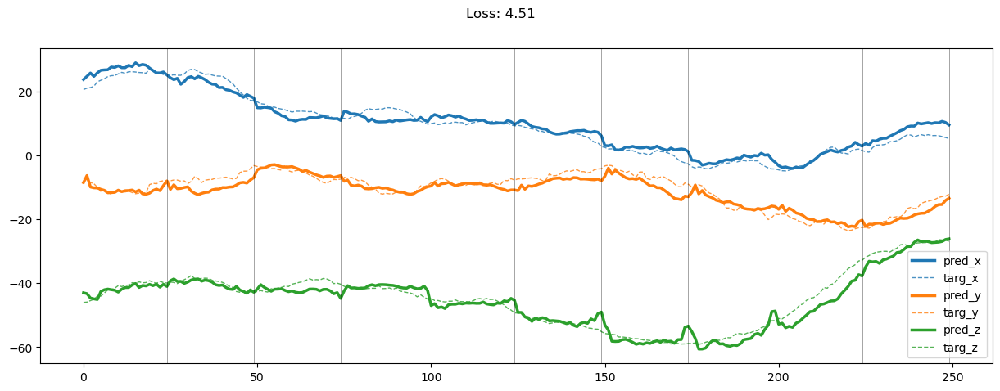

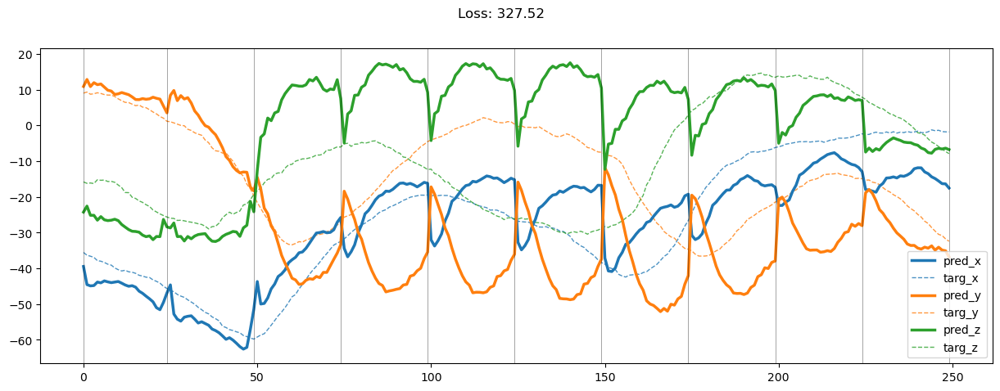

00199: train pred loss:  7.725, g loss:  23.330, diff loss:  15.169, d loss:  1.477
       valid pred loss:  184.084, g loss:  489.431, diff loss:  304.907, d loss:  1.472


100%|██████████| 17/17 [00:01<00:00, 15.04it/s]


00200: train pred loss:  7.835, g loss:  23.530, diff loss:  15.252, d loss:  1.471
       valid pred loss:  169.977, g loss:  469.422, diff loss:  298.999, d loss:  1.466


100%|██████████| 17/17 [00:01<00:00, 15.14it/s]


00201: train pred loss:  7.676, g loss:  23.045, diff loss:  14.920, d loss:  1.465
       valid pred loss:  176.906, g loss:  474.968, diff loss:  297.608, d loss:  1.460


100%|██████████| 17/17 [00:01<00:00, 14.77it/s]


00202: train pred loss:  7.562, g loss:  22.821, diff loss:  14.801, d loss:  1.460
       valid pred loss:  170.392, g loss:  459.809, diff loss:  288.956, d loss:  1.455


100%|██████████| 17/17 [00:01<00:00, 15.14it/s]


00203: train pred loss:  8.046, g loss:  23.884, diff loss:  15.376, d loss:  1.455
       valid pred loss:  173.563, g loss:  475.523, diff loss:  301.493, d loss:  1.452


100%|██████████| 17/17 [00:01<00:00, 14.75it/s]


00204: train pred loss:  7.472, g loss:  22.486, diff loss:  14.545, d loss:  1.451
       valid pred loss:  179.212, g loss:  492.477, diff loss:  312.793, d loss:  1.448


100%|██████████| 17/17 [00:01<00:00, 14.81it/s]


00205: train pred loss:  7.788, g loss:  23.538, diff loss:  15.277, d loss:  1.449
       valid pred loss:  189.186, g loss:  493.766, diff loss:  304.104, d loss:  1.445


100%|██████████| 17/17 [00:01<00:00, 14.96it/s]


00206: train pred loss:  7.597, g loss:  22.871, diff loss:  14.796, d loss:  1.446
       valid pred loss:  176.624, g loss:  489.370, diff loss:  312.266, d loss:  1.442


100%|██████████| 17/17 [00:01<00:00, 15.13it/s]


00207: train pred loss:  7.255, g loss:  22.013, diff loss:  14.278, d loss:  1.444
       valid pred loss:  172.918, g loss:  479.149, diff loss:  305.750, d loss:  1.441


100%|██████████| 17/17 [00:01<00:00, 14.56it/s]


00208: train pred loss:  7.224, g loss:  21.677, diff loss:  13.971, d loss:  1.443
       valid pred loss:  189.223, g loss:  493.391, diff loss:  303.685, d loss:  1.440


100%|██████████| 17/17 [00:01<00:00, 15.14it/s]


00209: train pred loss:  7.258, g loss:  21.759, diff loss:  14.019, d loss:  1.443
       valid pred loss:  183.906, g loss:  490.882, diff loss:  306.493, d loss:  1.440


100%|██████████| 17/17 [00:01<00:00, 15.21it/s]


00210: train pred loss:  7.475, g loss:  22.392, diff loss:  14.434, d loss:  1.443
       valid pred loss:  172.303, g loss:  471.798, diff loss:  299.012, d loss:  1.440


100%|██████████| 17/17 [00:01<00:00, 15.13it/s]


00211: train pred loss:  7.301, g loss:  22.056, diff loss:  14.274, d loss:  1.444
       valid pred loss:  184.088, g loss:  499.989, diff loss:  315.420, d loss:  1.442


100%|██████████| 17/17 [00:01<00:00, 15.15it/s]


00212: train pred loss:  7.356, g loss:  21.978, diff loss:  14.143, d loss:  1.445
       valid pred loss:  183.291, g loss:  486.479, diff loss:  302.711, d loss:  1.444


100%|██████████| 17/17 [00:01<00:00, 15.06it/s]


00213: train pred loss:  7.085, g loss:  21.501, diff loss:  13.941, d loss:  1.447
       valid pred loss:  191.947, g loss:  505.563, diff loss:  313.143, d loss:  1.447


100%|██████████| 17/17 [00:01<00:00, 14.59it/s]


00214: train pred loss:  7.228, g loss:  21.740, diff loss:  14.040, d loss:  1.449
       valid pred loss:  197.426, g loss:  520.274, diff loss:  322.378, d loss:  1.448


100%|██████████| 17/17 [00:01<00:00, 15.14it/s]


00215: train pred loss:  7.317, g loss:  21.959, diff loss:  14.175, d loss:  1.453
       valid pred loss:  175.863, g loss:  504.959, diff loss:  328.631, d loss:  1.452


100%|██████████| 17/17 [00:01<00:00, 15.14it/s]


00216: train pred loss:  7.345, g loss:  21.921, diff loss:  14.114, d loss:  1.456
       valid pred loss:  170.263, g loss:  473.099, diff loss:  302.376, d loss:  1.456


100%|██████████| 17/17 [00:01<00:00, 15.14it/s]


00217: train pred loss:  7.386, g loss:  22.199, diff loss:  14.358, d loss:  1.461
       valid pred loss:  182.712, g loss:  488.338, diff loss:  305.173, d loss:  1.460


100%|██████████| 17/17 [00:01<00:00, 15.16it/s]


00218: train pred loss:  7.443, g loss:  22.252, diff loss:  14.360, d loss:  1.465
       valid pred loss:  173.033, g loss:  486.979, diff loss:  313.499, d loss:  1.465


100%|██████████| 17/17 [00:01<00:00, 15.21it/s]


00219: train pred loss:  6.970, g loss:  20.961, diff loss:  13.548, d loss:  1.470
       valid pred loss:  184.754, g loss:  501.704, diff loss:  316.511, d loss:  1.473


100%|██████████| 17/17 [00:01<00:00, 15.14it/s]


00220: train pred loss:  6.991, g loss:  21.181, diff loss:  13.754, d loss:  1.477
       valid pred loss:  182.707, g loss:  520.450, diff loss:  337.310, d loss:  1.477


100%|██████████| 17/17 [00:01<00:00, 15.17it/s]


00221: train pred loss:  6.928, g loss:  20.718, diff loss:  13.362, d loss:  1.483
       valid pred loss:  173.020, g loss:  485.104, diff loss:  311.659, d loss:  1.484


100%|██████████| 17/17 [00:01<00:00, 15.19it/s]


00222: train pred loss:  6.694, g loss:  20.144, diff loss:  13.028, d loss:  1.489
       valid pred loss:  190.760, g loss:  504.644, diff loss:  313.466, d loss:  1.490


100%|██████████| 17/17 [00:01<00:00, 15.02it/s]


00223: train pred loss:  6.753, g loss:  20.218, diff loss:  13.051, d loss:  1.496
       valid pred loss:  183.171, g loss:  498.483, diff loss:  314.901, d loss:  1.497


100%|██████████| 17/17 [00:01<00:00, 15.21it/s]


00224: train pred loss:  6.625, g loss:  19.874, diff loss:  12.842, d loss:  1.503
       valid pred loss:  187.342, g loss:  497.894, diff loss:  310.149, d loss:  1.504


100%|██████████| 17/17 [00:01<00:00, 15.17it/s]


00225: train pred loss:  6.553, g loss:  19.760, diff loss:  12.807, d loss:  1.510
       valid pred loss:  187.565, g loss:  503.622, diff loss:  315.661, d loss:  1.512


100%|██████████| 17/17 [00:01<00:00, 15.19it/s]


00226: train pred loss:  6.749, g loss:  20.505, diff loss:  13.363, d loss:  1.518
       valid pred loss:  170.382, g loss:  475.453, diff loss:  304.681, d loss:  1.519


100%|██████████| 17/17 [00:01<00:00, 15.21it/s]


00227: train pred loss:  6.958, g loss:  20.464, diff loss:  13.120, d loss:  1.525
       valid pred loss:  195.456, g loss:  528.972, diff loss:  333.133, d loss:  1.527


100%|██████████| 17/17 [00:01<00:00, 14.09it/s]


00228: train pred loss:  6.636, g loss:  19.867, diff loss:  12.850, d loss:  1.531
       valid pred loss:  178.807, g loss:  472.423, diff loss:  293.238, d loss:  1.533


100%|██████████| 17/17 [00:01<00:00, 15.21it/s]


00229: train pred loss:  6.632, g loss:  19.760, diff loss:  12.754, d loss:  1.539
       valid pred loss:  195.313, g loss:  516.987, diff loss:  321.302, d loss:  1.540


100%|██████████| 17/17 [00:01<00:00, 15.19it/s]


00230: train pred loss:  6.602, g loss:  19.635, diff loss:  12.664, d loss:  1.545
       valid pred loss:  185.050, g loss:  492.975, diff loss:  307.559, d loss:  1.547


100%|██████████| 17/17 [00:01<00:00, 15.14it/s]


00231: train pred loss:  6.565, g loss:  19.754, diff loss:  12.825, d loss:  1.551
       valid pred loss:  190.308, g loss:  506.786, diff loss:  316.116, d loss:  1.553


100%|██████████| 17/17 [00:01<00:00, 15.20it/s]


00232: train pred loss:  6.428, g loss:  19.414, diff loss:  12.626, d loss:  1.557
       valid pred loss:  181.506, g loss:  491.984, diff loss:  310.121, d loss:  1.558


100%|██████████| 17/17 [00:01<00:00, 14.15it/s]


00233: train pred loss:  6.424, g loss:  19.398, diff loss:  12.618, d loss:  1.562
       valid pred loss:  170.454, g loss:  469.908, diff loss:  299.099, d loss:  1.563


100%|██████████| 17/17 [00:01<00:00, 15.12it/s]


00234: train pred loss:  6.709, g loss:  20.130, diff loss:  13.068, d loss:  1.567
       valid pred loss:  174.533, g loss:  479.054, diff loss:  304.170, d loss:  1.567


100%|██████████| 17/17 [00:01<00:00, 14.82it/s]


00235: train pred loss:  6.531, g loss:  19.305, diff loss:  12.425, d loss:  1.570
       valid pred loss:  157.828, g loss:  453.658, diff loss:  295.481, d loss:  1.571


100%|██████████| 17/17 [00:01<00:00, 14.68it/s]


00236: train pred loss:  6.668, g loss:  20.027, diff loss:  13.012, d loss:  1.574
       valid pred loss:  183.196, g loss:  489.923, diff loss:  306.380, d loss:  1.574


100%|██████████| 17/17 [00:01<00:00, 15.07it/s]


00237: train pred loss:  6.389, g loss:  19.172, diff loss:  12.437, d loss:  1.576
       valid pred loss:  181.024, g loss:  475.916, diff loss:  294.546, d loss:  1.576


100%|██████████| 17/17 [00:01<00:00, 15.11it/s]


00238: train pred loss:  6.556, g loss:  19.415, diff loss:  12.515, d loss:  1.578
       valid pred loss:  168.674, g loss:  460.021, diff loss:  291.003, d loss:  1.577


100%|██████████| 17/17 [00:01<00:00, 15.15it/s]


00239: train pred loss:  6.367, g loss:  19.106, diff loss:  12.395, d loss:  1.579
       valid pred loss:  183.238, g loss:  494.914, diff loss:  311.333, d loss:  1.578


100%|██████████| 17/17 [00:01<00:00, 15.17it/s]


00240: train pred loss:  6.191, g loss:  18.526, diff loss:  11.991, d loss:  1.579
       valid pred loss:  182.649, g loss:  506.251, diff loss:  323.259, d loss:  1.578


100%|██████████| 17/17 [00:01<00:00, 15.16it/s]


00241: train pred loss:  6.384, g loss:  18.864, diff loss:  12.135, d loss:  1.578
       valid pred loss:  173.499, g loss:  466.455, diff loss:  292.611, d loss:  1.577


100%|██████████| 17/17 [00:01<00:00, 15.14it/s]


00242: train pred loss:  6.123, g loss:  18.290, diff loss:  11.822, d loss:  1.577
       valid pred loss:  187.427, g loss:  496.798, diff loss:  309.024, d loss:  1.574


100%|██████████| 17/17 [00:01<00:00, 15.15it/s]


00243: train pred loss:  6.403, g loss:  19.017, diff loss:  12.267, d loss:  1.574
       valid pred loss:  170.247, g loss:  460.048, diff loss:  289.453, d loss:  1.572


100%|██████████| 17/17 [00:01<00:00, 15.13it/s]


00244: train pred loss:  6.425, g loss:  19.163, diff loss:  12.389, d loss:  1.571
       valid pred loss:  164.162, g loss:  470.481, diff loss:  305.969, d loss:  1.569


100%|██████████| 17/17 [00:01<00:00, 14.24it/s]


00245: train pred loss:  6.443, g loss:  19.181, diff loss:  12.387, d loss:  1.567
       valid pred loss:  163.348, g loss:  456.789, diff loss:  293.088, d loss:  1.565


100%|██████████| 17/17 [00:01<00:00, 15.26it/s]


00246: train pred loss:  6.372, g loss:  18.941, diff loss:  12.214, d loss:  1.563
       valid pred loss:  176.906, g loss:  469.401, diff loss:  292.139, d loss:  1.560


100%|██████████| 17/17 [00:01<00:00, 15.24it/s]


00247: train pred loss:  6.254, g loss:  18.749, diff loss:  12.136, d loss:  1.558
       valid pred loss:  171.444, g loss:  473.130, diff loss:  301.325, d loss:  1.555


100%|██████████| 17/17 [00:01<00:00, 15.26it/s]


00248: train pred loss:  6.359, g loss:  19.034, diff loss:  12.312, d loss:  1.553
       valid pred loss:  166.583, g loss:  469.259, diff loss:  302.311, d loss:  1.549


100%|██████████| 17/17 [00:01<00:00, 15.27it/s]


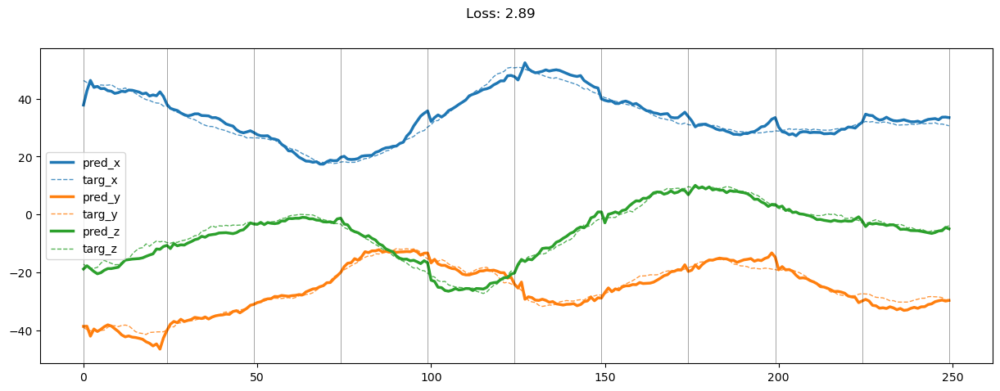

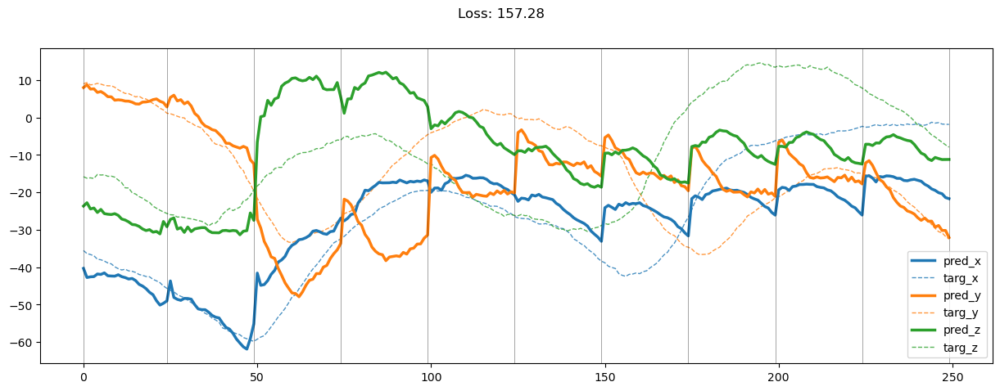

00249: train pred loss:  6.354, g loss:  19.212, diff loss:  12.491, d loss:  1.547
       valid pred loss:  170.941, g loss:  474.300, diff loss:  302.989, d loss:  1.543


100%|██████████| 17/17 [00:01<00:00, 14.90it/s]


00250: train pred loss:  6.549, g loss:  19.575, diff loss:  12.654, d loss:  1.541
       valid pred loss:  175.325, g loss:  499.237, diff loss:  323.537, d loss:  1.536


100%|██████████| 17/17 [00:01<00:00, 15.17it/s]


00251: train pred loss:  6.516, g loss:  19.414, diff loss:  12.521, d loss:  1.535
       valid pred loss:  161.202, g loss:  457.094, diff loss:  295.512, d loss:  1.530


100%|██████████| 17/17 [00:01<00:00, 15.12it/s]


00252: train pred loss:  6.188, g loss:  18.662, diff loss:  12.091, d loss:  1.529
       valid pred loss:  172.448, g loss:  487.317, diff loss:  314.483, d loss:  1.524


100%|██████████| 17/17 [00:01<00:00, 15.14it/s]


00253: train pred loss:  6.524, g loss:  19.242, diff loss:  12.330, d loss:  1.522
       valid pred loss:  164.502, g loss:  469.670, diff loss:  304.776, d loss:  1.517


100%|██████████| 17/17 [00:01<00:00, 14.67it/s]


00254: train pred loss:  6.420, g loss:  19.301, diff loss:  12.487, d loss:  1.516
       valid pred loss:  180.788, g loss:  504.436, diff loss:  323.250, d loss:  1.511


100%|██████████| 17/17 [00:01<00:00, 15.26it/s]


00255: train pred loss:  6.250, g loss:  18.607, diff loss:  11.957, d loss:  1.509
       valid pred loss:  175.965, g loss:  483.718, diff loss:  307.349, d loss:  1.505


100%|██████████| 17/17 [00:01<00:00, 15.14it/s]


00256: train pred loss:  5.941, g loss:  17.834, diff loss:  11.487, d loss:  1.503
       valid pred loss:  171.174, g loss:  491.333, diff loss:  319.750, d loss:  1.499


100%|██████████| 17/17 [00:01<00:00, 15.23it/s]


00257: train pred loss:  5.883, g loss:  17.674, diff loss:  11.379, d loss:  1.497
       valid pred loss:  160.408, g loss:  460.153, diff loss:  299.329, d loss:  1.493


100%|██████████| 17/17 [00:01<00:00, 15.25it/s]


00258: train pred loss:  5.941, g loss:  17.905, diff loss:  11.546, d loss:  1.492
       valid pred loss:  167.010, g loss:  467.166, diff loss:  299.735, d loss:  1.487


100%|██████████| 17/17 [00:01<00:00, 15.03it/s]


00259: train pred loss:  5.804, g loss:  17.472, diff loss:  11.245, d loss:  1.486
       valid pred loss:  168.711, g loss:  470.243, diff loss:  301.105, d loss:  1.482


100%|██████████| 17/17 [00:01<00:00, 14.34it/s]


00260: train pred loss:  5.683, g loss:  17.133, diff loss:  11.020, d loss:  1.482
       valid pred loss:  165.908, g loss:  467.405, diff loss:  301.064, d loss:  1.477


100%|██████████| 17/17 [00:01<00:00, 15.24it/s]


00261: train pred loss:  5.622, g loss:  17.155, diff loss:  11.098, d loss:  1.477
       valid pred loss:  168.991, g loss:  471.131, diff loss:  301.702, d loss:  1.473


100%|██████████| 17/17 [00:01<00:00, 15.18it/s]


00262: train pred loss:  5.952, g loss:  17.822, diff loss:  11.429, d loss:  1.472
       valid pred loss:  164.619, g loss:  472.444, diff loss:  307.382, d loss:  1.469


100%|██████████| 17/17 [00:01<00:00, 15.17it/s]


00263: train pred loss:  5.899, g loss:  17.779, diff loss:  11.435, d loss:  1.468
       valid pred loss:  167.426, g loss:  479.255, diff loss:  311.381, d loss:  1.465


100%|██████████| 17/17 [00:01<00:00, 15.18it/s]


00264: train pred loss:  5.849, g loss:  17.431, diff loss:  11.132, d loss:  1.465
       valid pred loss:  162.612, g loss:  459.881, diff loss:  296.817, d loss:  1.461


100%|██████████| 17/17 [00:01<00:00, 15.16it/s]


00265: train pred loss:  5.999, g loss:  17.959, diff loss:  11.507, d loss:  1.462
       valid pred loss:  159.684, g loss:  438.606, diff loss:  278.465, d loss:  1.458


100%|██████████| 17/17 [00:01<00:00, 15.16it/s]


00266: train pred loss:  6.082, g loss:  18.298, diff loss:  11.758, d loss:  1.458
       valid pred loss:  170.744, g loss:  466.671, diff loss:  295.466, d loss:  1.455


100%|██████████| 17/17 [00:01<00:00, 15.16it/s]


00267: train pred loss:  6.132, g loss:  18.195, diff loss:  11.602, d loss:  1.456
       valid pred loss:  162.719, g loss:  450.767, diff loss:  287.584, d loss:  1.453


100%|██████████| 17/17 [00:01<00:00, 15.16it/s]


00268: train pred loss:  5.812, g loss:  17.486, diff loss:  11.209, d loss:  1.454
       valid pred loss:  163.079, g loss:  464.783, diff loss:  301.238, d loss:  1.451


100%|██████████| 17/17 [00:01<00:00, 15.17it/s]


00269: train pred loss:  6.163, g loss:  18.515, diff loss:  11.885, d loss:  1.452
       valid pred loss:  162.517, g loss:  459.378, diff loss:  296.393, d loss:  1.449


100%|██████████| 17/17 [00:01<00:00, 15.17it/s]


00270: train pred loss:  8.302, g loss:  24.384, diff loss:  15.613, d loss:  1.451
       valid pred loss:  182.047, g loss:  493.980, diff loss:  311.462, d loss:  1.448


100%|██████████| 17/17 [00:01<00:00, 15.15it/s]


00271: train pred loss:  9.528, g loss:  28.049, diff loss:  18.050, d loss:  1.450
       valid pred loss:  188.300, g loss:  545.904, diff loss:  357.132, d loss:  1.447


100%|██████████| 17/17 [00:01<00:00, 14.21it/s]


00272: train pred loss:  8.048, g loss:  23.766, diff loss:  15.245, d loss:  1.448
       valid pred loss:  180.549, g loss:  514.095, diff loss:  333.073, d loss:  1.447


100%|██████████| 17/17 [00:01<00:00, 15.23it/s]


00273: train pred loss:  7.446, g loss:  22.567, diff loss:  14.648, d loss:  1.449
       valid pred loss:  188.125, g loss:  535.662, diff loss:  347.064, d loss:  1.447


100%|██████████| 17/17 [00:01<00:00, 15.08it/s]


00274: train pred loss:  6.810, g loss:  20.463, diff loss:  13.180, d loss:  1.448
       valid pred loss:  193.149, g loss:  529.501, diff loss:  335.878, d loss:  1.447


100%|██████████| 17/17 [00:01<00:00, 14.91it/s]


00275: train pred loss:  6.459, g loss:  19.305, diff loss:  12.373, d loss:  1.449
       valid pred loss:  176.439, g loss:  514.800, diff loss:  337.889, d loss:  1.448


100%|██████████| 17/17 [00:01<00:00, 14.97it/s]


00276: train pred loss:  6.368, g loss:  19.059, diff loss:  12.220, d loss:  1.450
       valid pred loss:  189.034, g loss:  534.370, diff loss:  344.865, d loss:  1.449


100%|██████████| 17/17 [00:01<00:00, 14.73it/s]


00277: train pred loss:  5.904, g loss:  17.632, diff loss:  11.258, d loss:  1.451
       valid pred loss:  184.837, g loss:  515.365, diff loss:  330.058, d loss:  1.450


100%|██████████| 17/17 [00:01<00:00, 15.28it/s]


00278: train pred loss:  5.639, g loss:  16.941, diff loss:  10.835, d loss:  1.452
       valid pred loss:  188.164, g loss:  542.877, diff loss:  354.247, d loss:  1.452


100%|██████████| 17/17 [00:01<00:00, 15.26it/s]


00279: train pred loss:  5.715, g loss:  17.163, diff loss:  10.983, d loss:  1.454
       valid pred loss:  176.404, g loss:  509.812, diff loss:  332.944, d loss:  1.454


100%|██████████| 17/17 [00:01<00:00, 15.26it/s]


00280: train pred loss:  5.484, g loss:  16.614, diff loss:  10.669, d loss:  1.456
       valid pred loss:  183.381, g loss:  531.132, diff loss:  347.290, d loss:  1.457


100%|██████████| 17/17 [00:01<00:00, 15.13it/s]


00281: train pred loss:  5.363, g loss:  16.243, diff loss:  10.423, d loss:  1.459
       valid pred loss:  183.015, g loss:  522.365, diff loss:  338.894, d loss:  1.459


100%|██████████| 17/17 [00:01<00:00, 14.96it/s]


00282: train pred loss:  5.168, g loss:  15.681, diff loss:  10.059, d loss:  1.462
       valid pred loss:  182.571, g loss:  520.772, diff loss:  337.749, d loss:  1.462


100%|██████████| 17/17 [00:01<00:00, 14.68it/s]


00283: train pred loss:  5.383, g loss:  16.174, diff loss:  10.342, d loss:  1.465
       valid pred loss:  182.405, g loss:  500.801, diff loss:  317.947, d loss:  1.466


100%|██████████| 17/17 [00:01<00:00, 15.20it/s]


00284: train pred loss:  5.400, g loss:  16.331, diff loss:  10.485, d loss:  1.468
       valid pred loss:  191.721, g loss:  546.605, diff loss:  354.440, d loss:  1.469


100%|██████████| 17/17 [00:01<00:00, 15.22it/s]


00285: train pred loss:  5.286, g loss:  15.764, diff loss:  10.037, d loss:  1.472
       valid pred loss:  186.323, g loss:  522.347, diff loss:  335.585, d loss:  1.473


100%|██████████| 17/17 [00:01<00:00, 14.53it/s]


00286: train pred loss:  5.221, g loss:  15.769, diff loss:  10.113, d loss:  1.476
       valid pred loss:  179.774, g loss:  525.634, diff loss:  345.426, d loss:  1.477


100%|██████████| 17/17 [00:01<00:00, 15.22it/s]


00287: train pred loss:  5.205, g loss:  15.715, diff loss:  10.079, d loss:  1.480
       valid pred loss:  185.017, g loss:  525.662, diff loss:  340.216, d loss:  1.481


100%|██████████| 17/17 [00:01<00:00, 14.55it/s]


00288: train pred loss:  5.007, g loss:  15.218, diff loss:  9.784, d loss:  1.485
       valid pred loss:  178.037, g loss:  516.421, diff loss:  337.960, d loss:  1.486


100%|██████████| 17/17 [00:01<00:00, 15.25it/s]


00289: train pred loss:  5.018, g loss:  15.308, diff loss:  9.869, d loss:  1.490
       valid pred loss:  169.613, g loss:  476.060, diff loss:  306.028, d loss:  1.490


100%|██████████| 17/17 [00:01<00:00, 15.23it/s]


00290: train pred loss:  5.084, g loss:  15.234, diff loss:  9.734, d loss:  1.494
       valid pred loss:  173.235, g loss:  493.603, diff loss:  319.955, d loss:  1.495


100%|██████████| 17/17 [00:01<00:00, 13.71it/s]


00291: train pred loss:  4.937, g loss:  15.029, diff loss:  9.682, d loss:  1.499
       valid pred loss:  177.001, g loss:  497.642, diff loss:  320.232, d loss:  1.500


100%|██████████| 17/17 [00:01<00:00, 14.01it/s]


00292: train pred loss:  4.836, g loss:  14.729, diff loss:  9.487, d loss:  1.503
       valid pred loss:  181.619, g loss:  527.077, diff loss:  345.054, d loss:  1.504


100%|██████████| 17/17 [00:01<00:00, 15.13it/s]


00293: train pred loss:  4.734, g loss:  14.393, diff loss:  9.258, d loss:  1.509
       valid pred loss:  171.851, g loss:  493.325, diff loss:  321.075, d loss:  1.509


100%|██████████| 17/17 [00:01<00:00, 15.21it/s]


00294: train pred loss:  4.757, g loss:  14.506, diff loss:  9.353, d loss:  1.514
       valid pred loss:  164.552, g loss:  474.066, diff loss:  309.119, d loss:  1.514


100%|██████████| 17/17 [00:01<00:00, 15.23it/s]


00295: train pred loss:  4.975, g loss:  15.026, diff loss:  9.660, d loss:  1.518
       valid pred loss:  173.040, g loss:  496.716, diff loss:  323.286, d loss:  1.519


100%|██████████| 17/17 [00:01<00:00, 15.24it/s]


00296: train pred loss:  5.063, g loss:  15.325, diff loss:  9.875, d loss:  1.523
       valid pred loss:  180.353, g loss:  498.642, diff loss:  317.904, d loss:  1.524


100%|██████████| 17/17 [00:01<00:00, 15.23it/s]


00297: train pred loss:  5.666, g loss:  16.950, diff loss:  10.900, d loss:  1.527
       valid pred loss:  175.109, g loss:  501.301, diff loss:  325.810, d loss:  1.529


100%|██████████| 17/17 [00:01<00:00, 14.52it/s]


00298: train pred loss:  5.572, g loss:  16.832, diff loss:  10.880, d loss:  1.532
       valid pred loss:  182.979, g loss:  512.901, diff loss:  329.544, d loss:  1.533


100%|██████████| 17/17 [00:01<00:00, 15.17it/s]


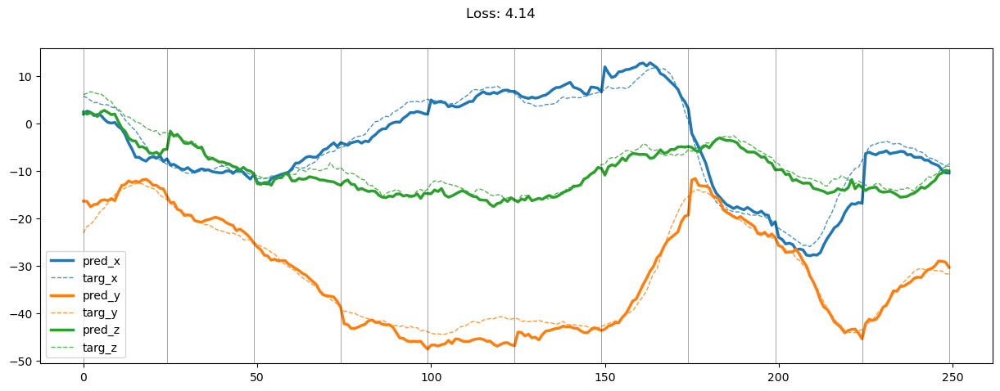

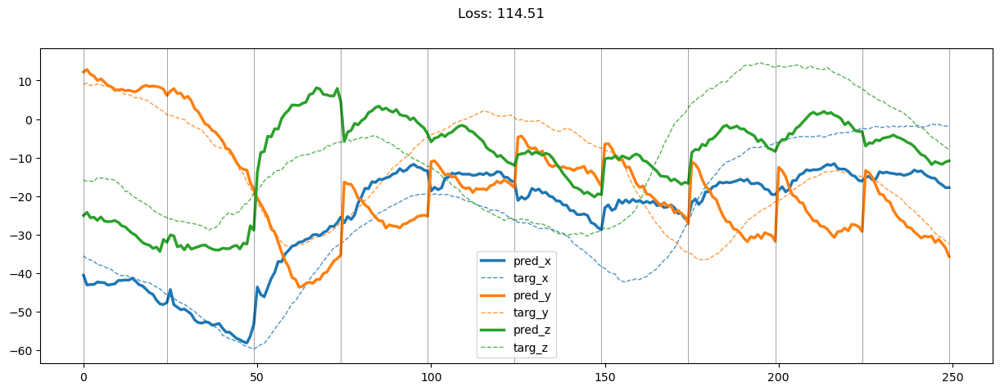

00299: train pred loss:  5.442, g loss:  16.541, diff loss:  10.723, d loss:  1.536
       valid pred loss:  171.990, g loss:  495.773, diff loss:  323.409, d loss:  1.537


100%|██████████| 17/17 [00:01<00:00, 14.79it/s]


00300: train pred loss:  5.390, g loss:  16.346, diff loss:  10.584, d loss:  1.540
       valid pred loss:  183.169, g loss:  526.832, diff loss:  343.291, d loss:  1.541


100%|██████████| 17/17 [00:01<00:00, 15.19it/s]


00301: train pred loss:  5.324, g loss:  15.930, diff loss:  10.236, d loss:  1.544
       valid pred loss:  174.022, g loss:  520.597, diff loss:  346.206, d loss:  1.545


100%|██████████| 17/17 [00:01<00:00, 15.01it/s]


00302: train pred loss:  5.036, g loss:  15.249, diff loss:  9.846, d loss:  1.548
       valid pred loss:  176.074, g loss:  515.062, diff loss:  338.622, d loss:  1.548


100%|██████████| 17/17 [00:01<00:00, 15.20it/s]


00303: train pred loss:  4.825, g loss:  14.658, diff loss:  9.469, d loss:  1.551
       valid pred loss:  169.306, g loss:  493.055, diff loss:  323.386, d loss:  1.552


100%|██████████| 17/17 [00:01<00:00, 15.22it/s]


00304: train pred loss:  4.854, g loss:  14.626, diff loss:  9.411, d loss:  1.554
       valid pred loss:  169.461, g loss:  490.293, diff loss:  320.470, d loss:  1.554


100%|██████████| 17/17 [00:01<00:00, 15.21it/s]


00305: train pred loss:  4.802, g loss:  14.557, diff loss:  9.396, d loss:  1.556
       valid pred loss:  171.607, g loss:  489.095, diff loss:  317.128, d loss:  1.557


100%|██████████| 17/17 [00:01<00:00, 15.18it/s]


00306: train pred loss:  4.865, g loss:  14.603, diff loss:  9.380, d loss:  1.559
       valid pred loss:  176.536, g loss:  501.461, diff loss:  324.568, d loss:  1.559


100%|██████████| 17/17 [00:01<00:00, 15.20it/s]


00307: train pred loss:  4.716, g loss:  14.220, diff loss:  9.147, d loss:  1.560
       valid pred loss:  172.277, g loss:  497.615, diff loss:  324.982, d loss:  1.561


100%|██████████| 17/17 [00:01<00:00, 15.22it/s]


00308: train pred loss:  4.691, g loss:  14.233, diff loss:  9.187, d loss:  1.562
       valid pred loss:  174.973, g loss:  499.987, diff loss:  324.659, d loss:  1.562


100%|██████████| 17/17 [00:01<00:00, 15.22it/s]


00309: train pred loss:  4.811, g loss:  14.513, diff loss:  9.347, d loss:  1.563
       valid pred loss:  174.332, g loss:  501.808, diff loss:  327.121, d loss:  1.563


100%|██████████| 17/17 [00:01<00:00, 15.22it/s]


00310: train pred loss:  4.681, g loss:  14.044, diff loss:  9.009, d loss:  1.564
       valid pred loss:  169.950, g loss:  494.706, diff loss:  324.401, d loss:  1.563


100%|██████████| 17/17 [00:01<00:00, 15.22it/s]


00311: train pred loss:  4.805, g loss:  14.618, diff loss:  9.459, d loss:  1.564
       valid pred loss:  175.496, g loss:  492.800, diff loss:  316.950, d loss:  1.564


100%|██████████| 17/17 [00:01<00:00, 15.22it/s]


00312: train pred loss:  5.179, g loss:  15.812, diff loss:  10.278, d loss:  1.564
       valid pred loss:  169.724, g loss:  475.288, diff loss:  305.210, d loss:  1.563


100%|██████████| 17/17 [00:01<00:00, 14.94it/s]


00313: train pred loss:  5.332, g loss:  15.975, diff loss:  10.289, d loss:  1.563
       valid pred loss:  176.373, g loss:  499.305, diff loss:  322.577, d loss:  1.562


100%|██████████| 17/17 [00:01<00:00, 15.18it/s]


00314: train pred loss:  5.011, g loss:  15.147, diff loss:  9.781, d loss:  1.562
       valid pred loss:  173.633, g loss:  495.426, diff loss:  321.437, d loss:  1.561


100%|██████████| 17/17 [00:01<00:00, 15.20it/s]


00315: train pred loss:  4.973, g loss:  14.848, diff loss:  9.519, d loss:  1.561
       valid pred loss:  178.116, g loss:  512.952, diff loss:  334.478, d loss:  1.560


100%|██████████| 17/17 [00:01<00:00, 15.16it/s]


00316: train pred loss:  4.834, g loss:  14.490, diff loss:  9.298, d loss:  1.559
       valid pred loss:  176.911, g loss:  494.278, diff loss:  317.008, d loss:  1.558


100%|██████████| 17/17 [00:01<00:00, 14.91it/s]


00317: train pred loss:  4.621, g loss:  13.977, diff loss:  8.996, d loss:  1.557
       valid pred loss:  176.665, g loss:  500.325, diff loss:  323.300, d loss:  1.555


100%|██████████| 17/17 [00:01<00:00, 15.25it/s]


00318: train pred loss:  4.834, g loss:  14.514, diff loss:  9.319, d loss:  1.555
       valid pred loss:  169.009, g loss:  488.381, diff loss:  319.010, d loss:  1.553


100%|██████████| 17/17 [00:01<00:00, 15.23it/s]


00319: train pred loss:  4.798, g loss:  14.252, diff loss:  9.090, d loss:  1.552
       valid pred loss:  162.659, g loss:  472.913, diff loss:  309.890, d loss:  1.550


100%|██████████| 17/17 [00:01<00:00, 15.24it/s]


00320: train pred loss:  4.910, g loss:  14.624, diff loss:  9.348, d loss:  1.548
       valid pred loss:  174.652, g loss:  502.807, diff loss:  327.788, d loss:  1.547


100%|██████████| 17/17 [00:01<00:00, 15.10it/s]


00321: train pred loss:  4.757, g loss:  14.317, diff loss:  9.191, d loss:  1.545
       valid pred loss:  173.446, g loss:  499.137, diff loss:  325.320, d loss:  1.542


100%|██████████| 17/17 [00:01<00:00, 15.21it/s]


00322: train pred loss:  4.620, g loss:  14.052, diff loss:  9.059, d loss:  1.540
       valid pred loss:  170.587, g loss:  489.217, diff loss:  318.253, d loss:  1.536


100%|██████████| 17/17 [00:01<00:00, 15.24it/s]


00323: train pred loss:  4.714, g loss:  14.163, diff loss:  9.070, d loss:  1.533
       valid pred loss:  168.837, g loss:  483.240, diff loss:  314.020, d loss:  1.528


100%|██████████| 17/17 [00:01<00:00, 15.25it/s]


00324: train pred loss:  5.028, g loss:  15.098, diff loss:  9.684, d loss:  1.525
       valid pred loss:  166.321, g loss:  478.972, diff loss:  312.261, d loss:  1.519


100%|██████████| 17/17 [00:01<00:00, 15.21it/s]


00325: train pred loss:  4.859, g loss:  14.533, diff loss:  9.280, d loss:  1.517
       valid pred loss:  171.917, g loss:  511.139, diff loss:  338.824, d loss:  1.511


100%|██████████| 17/17 [00:01<00:00, 15.21it/s]


00326: train pred loss:  4.675, g loss:  14.264, diff loss:  9.187, d loss:  1.508
       valid pred loss:  172.646, g loss:  508.487, diff loss:  335.434, d loss:  1.502


100%|██████████| 17/17 [00:01<00:00, 15.21it/s]


00327: train pred loss:  4.508, g loss:  13.669, diff loss:  8.751, d loss:  1.499
       valid pred loss:  170.730, g loss:  514.085, diff loss:  342.940, d loss:  1.493


100%|██████████| 17/17 [00:01<00:00, 15.23it/s]


00328: train pred loss:  4.492, g loss:  13.705, diff loss:  8.795, d loss:  1.491
       valid pred loss:  165.534, g loss:  484.371, diff loss:  318.414, d loss:  1.486


100%|██████████| 17/17 [00:01<00:00, 15.18it/s]


00329: train pred loss:  4.601, g loss:  13.907, diff loss:  8.880, d loss:  1.484
       valid pred loss:  172.077, g loss:  504.571, diff loss:  332.063, d loss:  1.479


100%|██████████| 17/17 [00:01<00:00, 15.23it/s]


00330: train pred loss:  4.484, g loss:  13.647, diff loss:  8.730, d loss:  1.478
       valid pred loss:  167.939, g loss:  494.060, diff loss:  325.685, d loss:  1.475


100%|██████████| 17/17 [00:01<00:00, 15.20it/s]


00331: train pred loss:  4.814, g loss:  14.512, diff loss:  9.261, d loss:  1.475
       valid pred loss:  169.345, g loss:  486.489, diff loss:  316.705, d loss:  1.473


100%|██████████| 17/17 [00:01<00:00, 15.20it/s]


00332: train pred loss:  4.783, g loss:  14.570, diff loss:  9.349, d loss:  1.473
       valid pred loss:  170.179, g loss:  494.813, diff loss:  324.195, d loss:  1.472


100%|██████████| 17/17 [00:01<00:00, 15.14it/s]


00333: train pred loss:  4.660, g loss:  14.121, diff loss:  9.023, d loss:  1.474
       valid pred loss:  166.973, g loss:  478.474, diff loss:  311.063, d loss:  1.474


100%|██████████| 17/17 [00:01<00:00, 15.18it/s]


00334: train pred loss:  4.588, g loss:  14.031, diff loss:  9.006, d loss:  1.475
       valid pred loss:  172.590, g loss:  490.768, diff loss:  317.742, d loss:  1.475


100%|██████████| 17/17 [00:01<00:00, 14.89it/s]


00335: train pred loss:  4.598, g loss:  13.926, diff loss:  8.893, d loss:  1.477
       valid pred loss:  166.855, g loss:  484.711, diff loss:  317.422, d loss:  1.477


100%|██████████| 17/17 [00:01<00:00, 15.12it/s]


00336: train pred loss:  4.632, g loss:  13.999, diff loss:  8.934, d loss:  1.479
       valid pred loss:  174.333, g loss:  500.533, diff loss:  325.768, d loss:  1.480


100%|██████████| 17/17 [00:01<00:00, 15.08it/s]


00337: train pred loss:  4.728, g loss:  14.494, diff loss:  9.336, d loss:  1.481
       valid pred loss:  161.852, g loss:  466.600, diff loss:  304.317, d loss:  1.481


100%|██████████| 17/17 [00:01<00:00, 15.09it/s]


00338: train pred loss:  5.047, g loss:  15.404, diff loss:  9.928, d loss:  1.482
       valid pred loss:  171.283, g loss:  491.379, diff loss:  319.668, d loss:  1.483


100%|██████████| 17/17 [00:01<00:00, 15.03it/s]


00339: train pred loss:  5.116, g loss:  15.382, diff loss:  9.838, d loss:  1.483
       valid pred loss:  180.593, g loss:  505.480, diff loss:  324.459, d loss:  1.484


100%|██████████| 17/17 [00:01<00:00, 15.12it/s]


00340: train pred loss:  4.731, g loss:  14.329, diff loss:  9.171, d loss:  1.484
       valid pred loss:  170.767, g loss:  484.561, diff loss:  313.368, d loss:  1.485


100%|██████████| 17/17 [00:01<00:00, 15.13it/s]


00341: train pred loss:  4.750, g loss:  14.161, diff loss:  8.985, d loss:  1.484
       valid pred loss:  174.409, g loss:  499.253, diff loss:  324.418, d loss:  1.485


100%|██████████| 17/17 [00:01<00:00, 15.15it/s]


00342: train pred loss:  4.662, g loss:  14.076, diff loss:  8.989, d loss:  1.485
       valid pred loss:  171.826, g loss:  489.315, diff loss:  317.063, d loss:  1.485


100%|██████████| 17/17 [00:01<00:00, 15.09it/s]


00343: train pred loss:  4.665, g loss:  13.932, diff loss:  8.842, d loss:  1.484
       valid pred loss:  179.417, g loss:  500.512, diff loss:  320.669, d loss:  1.485


100%|██████████| 17/17 [00:01<00:00, 14.78it/s]


00344: train pred loss:  4.979, g loss:  14.871, diff loss:  9.467, d loss:  1.485
       valid pred loss:  164.452, g loss:  471.359, diff loss:  306.480, d loss:  1.484


100%|██████████| 17/17 [00:01<00:00, 15.22it/s]


00345: train pred loss:  4.691, g loss:  14.130, diff loss:  9.013, d loss:  1.484
       valid pred loss:  175.233, g loss:  492.510, diff loss:  316.851, d loss:  1.484


100%|██████████| 17/17 [00:01<00:00, 15.18it/s]


00346: train pred loss:  4.534, g loss:  13.670, diff loss:  8.710, d loss:  1.484
       valid pred loss:  167.113, g loss:  474.807, diff loss:  307.267, d loss:  1.483


100%|██████████| 17/17 [00:01<00:00, 15.17it/s]


00347: train pred loss:  4.346, g loss:  13.242, diff loss:  8.468, d loss:  1.483
       valid pred loss:  169.547, g loss:  490.012, diff loss:  320.037, d loss:  1.482


100%|██████████| 17/17 [00:01<00:00, 14.84it/s]


00348: train pred loss:  4.430, g loss:  13.565, diff loss:  8.707, d loss:  1.482
       valid pred loss:  171.252, g loss:  489.760, diff loss:  318.079, d loss:  1.482


100%|██████████| 17/17 [00:01<00:00, 15.15it/s]


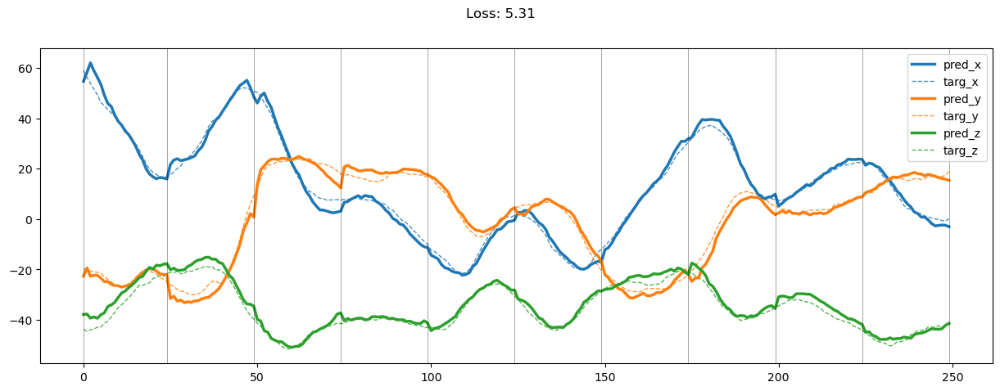

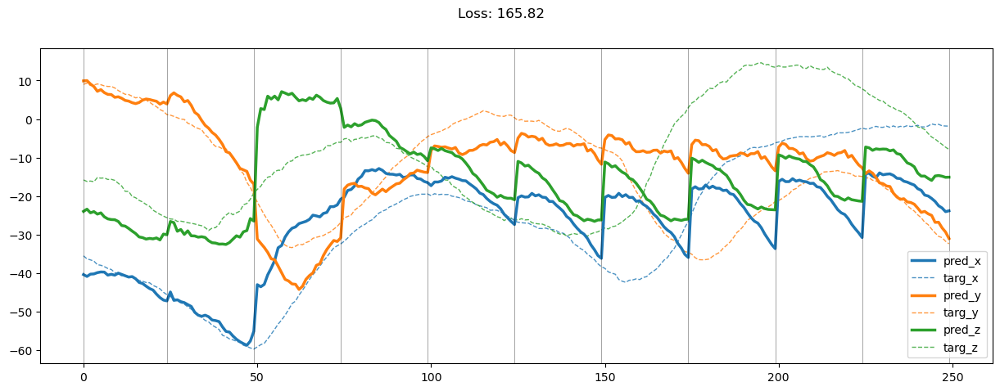

00349: train pred loss:  4.561, g loss:  13.746, diff loss:  8.757, d loss:  1.482
       valid pred loss:  170.037, g loss:  482.785, diff loss:  312.319, d loss:  1.481


100%|██████████| 17/17 [00:01<00:00, 15.15it/s]


00350: train pred loss:  4.377, g loss:  13.240, diff loss:  8.434, d loss:  1.481
       valid pred loss:  177.562, g loss:  501.614, diff loss:  323.623, d loss:  1.481


100%|██████████| 17/17 [00:01<00:00, 14.46it/s]


00351: train pred loss:  4.402, g loss:  13.240, diff loss:  8.408, d loss:  1.481
       valid pred loss:  162.049, g loss:  469.192, diff loss:  306.713, d loss:  1.481


100%|██████████| 17/17 [00:01<00:00, 15.17it/s]


00352: train pred loss:  4.239, g loss:  12.979, diff loss:  8.310, d loss:  1.481
       valid pred loss:  167.939, g loss:  480.515, diff loss:  312.146, d loss:  1.481


100%|██████████| 17/17 [00:01<00:00, 14.83it/s]


00353: train pred loss:  4.141, g loss:  12.618, diff loss:  8.047, d loss:  1.481
       valid pred loss:  169.467, g loss:  479.247, diff loss:  309.350, d loss:  1.481


100%|██████████| 17/17 [00:01<00:00, 14.70it/s]


00354: train pred loss:  4.228, g loss:  12.961, diff loss:  8.302, d loss:  1.480
       valid pred loss:  168.782, g loss:  478.413, diff loss:  309.201, d loss:  1.481


100%|██████████| 17/17 [00:01<00:00, 15.17it/s]


00355: train pred loss:  4.174, g loss:  12.627, diff loss:  8.023, d loss:  1.481
       valid pred loss:  170.929, g loss:  495.673, diff loss:  324.314, d loss:  1.481


100%|██████████| 17/17 [00:01<00:00, 15.05it/s]


00356: train pred loss:  4.086, g loss:  12.547, diff loss:  8.030, d loss:  1.481
       valid pred loss:  170.207, g loss:  483.899, diff loss:  313.262, d loss:  1.481


100%|██████████| 17/17 [00:01<00:00, 14.73it/s]


00357: train pred loss:  4.142, g loss:  12.587, diff loss:  8.015, d loss:  1.481
       valid pred loss:  177.862, g loss:  497.593, diff loss:  319.302, d loss:  1.482


100%|██████████| 17/17 [00:01<00:00, 14.99it/s]


00358: train pred loss:  4.233, g loss:  12.664, diff loss:  8.001, d loss:  1.481
       valid pred loss:  172.582, g loss:  495.744, diff loss:  322.732, d loss:  1.482


100%|██████████| 17/17 [00:01<00:00, 14.91it/s]


00359: train pred loss:  4.295, g loss:  12.885, diff loss:  8.161, d loss:  1.482
       valid pred loss:  165.599, g loss:  477.822, diff loss:  311.795, d loss:  1.483


100%|██████████| 17/17 [00:01<00:00, 15.12it/s]


00360: train pred loss:  4.149, g loss:  12.690, diff loss:  8.114, d loss:  1.482
       valid pred loss:  175.429, g loss:  516.442, diff loss:  340.585, d loss:  1.483


100%|██████████| 17/17 [00:01<00:00, 15.09it/s]


00361: train pred loss:  4.134, g loss:  12.527, diff loss:  7.965, d loss:  1.483
       valid pred loss:  162.381, g loss:  464.165, diff loss:  301.356, d loss:  1.484


100%|██████████| 17/17 [00:01<00:00, 14.08it/s]


00362: train pred loss:  4.150, g loss:  12.435, diff loss:  7.859, d loss:  1.484
       valid pred loss:  163.517, g loss:  468.876, diff loss:  304.933, d loss:  1.485


100%|██████████| 17/17 [00:01<00:00, 13.98it/s]


00363: train pred loss:  4.104, g loss:  12.496, diff loss:  7.967, d loss:  1.485
       valid pred loss:  169.256, g loss:  489.291, diff loss:  319.610, d loss:  1.486


100%|██████████| 17/17 [00:01<00:00, 14.63it/s]


00364: train pred loss:  4.168, g loss:  12.815, diff loss:  8.222, d loss:  1.485
       valid pred loss:  166.006, g loss:  486.918, diff loss:  320.488, d loss:  1.486


100%|██████████| 17/17 [00:01<00:00, 15.20it/s]


00365: train pred loss:  4.166, g loss:  12.721, diff loss:  8.131, d loss:  1.487
       valid pred loss:  168.423, g loss:  488.517, diff loss:  319.671, d loss:  1.487


100%|██████████| 17/17 [00:01<00:00, 15.19it/s]


00366: train pred loss:  4.146, g loss:  12.625, diff loss:  8.056, d loss:  1.487
       valid pred loss:  159.366, g loss:  454.261, diff loss:  294.473, d loss:  1.488


100%|██████████| 17/17 [00:01<00:00, 15.18it/s]


00367: train pred loss:  4.061, g loss:  12.375, diff loss:  7.893, d loss:  1.488
       valid pred loss:  168.903, g loss:  486.759, diff loss:  317.435, d loss:  1.489


100%|██████████| 17/17 [00:01<00:00, 15.17it/s]


00368: train pred loss:  4.035, g loss:  12.171, diff loss:  7.716, d loss:  1.490
       valid pred loss:  174.614, g loss:  495.058, diff loss:  320.024, d loss:  1.490


100%|██████████| 17/17 [00:01<00:00, 15.15it/s]


00369: train pred loss:  4.020, g loss:  12.118, diff loss:  7.679, d loss:  1.491
       valid pred loss:  167.334, g loss:  495.828, diff loss:  328.076, d loss:  1.491


100%|██████████| 17/17 [00:01<00:00, 15.17it/s]


00370: train pred loss:  3.991, g loss:  12.081, diff loss:  7.673, d loss:  1.492
       valid pred loss:  173.898, g loss:  501.960, diff loss:  327.645, d loss:  1.493


100%|██████████| 17/17 [00:01<00:00, 15.17it/s]


00371: train pred loss:  3.923, g loss:  12.012, diff loss:  7.673, d loss:  1.494
       valid pred loss:  178.919, g loss:  514.011, diff loss:  334.677, d loss:  1.494


100%|██████████| 17/17 [00:01<00:00, 13.95it/s]


00372: train pred loss:  3.752, g loss:  11.558, diff loss:  7.392, d loss:  1.495
       valid pred loss:  174.739, g loss:  509.019, diff loss:  333.866, d loss:  1.495


100%|██████████| 17/17 [00:01<00:00, 15.14it/s]


00373: train pred loss:  3.788, g loss:  11.656, diff loss:  7.455, d loss:  1.496
       valid pred loss:  168.305, g loss:  486.419, diff loss:  317.702, d loss:  1.497


100%|██████████| 17/17 [00:01<00:00, 14.85it/s]


00374: train pred loss:  3.829, g loss:  11.687, diff loss:  7.447, d loss:  1.498
       valid pred loss:  174.803, g loss:  505.573, diff loss:  330.358, d loss:  1.498


100%|██████████| 17/17 [00:01<00:00, 15.17it/s]


00375: train pred loss:  3.822, g loss:  11.685, diff loss:  7.454, d loss:  1.499
       valid pred loss:  176.453, g loss:  504.589, diff loss:  327.726, d loss:  1.499


100%|██████████| 17/17 [00:01<00:00, 15.19it/s]


00376: train pred loss:  3.995, g loss:  12.158, diff loss:  7.755, d loss:  1.501
       valid pred loss:  177.839, g loss:  506.453, diff loss:  328.206, d loss:  1.501


100%|██████████| 17/17 [00:01<00:00, 15.21it/s]


00377: train pred loss:  4.178, g loss:  12.778, diff loss:  8.192, d loss:  1.502
       valid pred loss:  184.569, g loss:  524.902, diff loss:  339.927, d loss:  1.503


100%|██████████| 17/17 [00:01<00:00, 14.56it/s]


00378: train pred loss:  4.098, g loss:  12.315, diff loss:  7.811, d loss:  1.503
       valid pred loss:  177.722, g loss:  515.286, diff loss:  337.158, d loss:  1.504


100%|██████████| 17/17 [00:01<00:00, 14.92it/s]


00379: train pred loss:  3.969, g loss:  12.008, diff loss:  7.634, d loss:  1.505
       valid pred loss:  176.559, g loss:  513.183, diff loss:  336.220, d loss:  1.506


100%|██████████| 17/17 [00:01<00:00, 15.19it/s]


00380: train pred loss:  3.917, g loss:  11.929, diff loss:  7.608, d loss:  1.506
       valid pred loss:  181.404, g loss:  520.376, diff loss:  338.569, d loss:  1.507


100%|██████████| 17/17 [00:01<00:00, 15.16it/s]


00381: train pred loss:  3.871, g loss:  11.770, diff loss:  7.498, d loss:  1.507
       valid pred loss:  171.039, g loss:  497.516, diff loss:  326.076, d loss:  1.509


100%|██████████| 17/17 [00:01<00:00, 15.18it/s]


00382: train pred loss:  3.889, g loss:  11.942, diff loss:  7.651, d loss:  1.508
       valid pred loss:  176.328, g loss:  508.198, diff loss:  331.470, d loss:  1.510


100%|██████████| 17/17 [00:01<00:00, 15.15it/s]


00383: train pred loss:  3.887, g loss:  11.885, diff loss:  7.598, d loss:  1.510
       valid pred loss:  186.644, g loss:  523.823, diff loss:  336.780, d loss:  1.511


100%|██████████| 17/17 [00:01<00:00, 15.16it/s]


00384: train pred loss:  3.936, g loss:  12.003, diff loss:  7.669, d loss:  1.511
       valid pred loss:  182.353, g loss:  523.887, diff loss:  341.137, d loss:  1.513


100%|██████████| 17/17 [00:01<00:00, 15.16it/s]


00385: train pred loss:  4.047, g loss:  12.308, diff loss:  7.863, d loss:  1.512
       valid pred loss:  169.471, g loss:  492.446, diff loss:  322.577, d loss:  1.514


100%|██████████| 17/17 [00:01<00:00, 14.65it/s]


00386: train pred loss:  3.981, g loss:  12.021, diff loss:  7.644, d loss:  1.513
       valid pred loss:  186.996, g loss:  537.384, diff loss:  349.993, d loss:  1.515


100%|██████████| 17/17 [00:01<00:00, 14.51it/s]


00387: train pred loss:  3.960, g loss:  12.185, diff loss:  7.829, d loss:  1.514
       valid pred loss:  179.770, g loss:  512.778, diff loss:  332.613, d loss:  1.515


100%|██████████| 17/17 [00:01<00:00, 15.16it/s]


00388: train pred loss:  4.158, g loss:  12.491, diff loss:  7.939, d loss:  1.515
       valid pred loss:  176.102, g loss:  516.139, diff loss:  339.643, d loss:  1.516


100%|██████████| 17/17 [00:01<00:00, 15.19it/s]


00389: train pred loss:  3.946, g loss:  12.000, diff loss:  7.660, d loss:  1.516
       valid pred loss:  172.497, g loss:  509.309, diff loss:  336.419, d loss:  1.517


100%|██████████| 17/17 [00:01<00:00, 15.05it/s]


00390: train pred loss:  3.815, g loss:  11.637, diff loss:  7.429, d loss:  1.517
       valid pred loss:  177.601, g loss:  514.489, diff loss:  336.496, d loss:  1.518


100%|██████████| 17/17 [00:01<00:00, 15.26it/s]


00391: train pred loss:  3.739, g loss:  11.449, diff loss:  7.318, d loss:  1.518
       valid pred loss:  174.263, g loss:  505.557, diff loss:  330.902, d loss:  1.518


100%|██████████| 17/17 [00:01<00:00, 15.27it/s]


00392: train pred loss:  3.754, g loss:  11.493, diff loss:  7.348, d loss:  1.518
       valid pred loss:  170.309, g loss:  501.420, diff loss:  330.720, d loss:  1.519


100%|██████████| 17/17 [00:01<00:00, 15.27it/s]


00393: train pred loss:  3.659, g loss:  11.205, diff loss:  7.155, d loss:  1.519
       valid pred loss:  171.433, g loss:  505.458, diff loss:  333.635, d loss:  1.520


100%|██████████| 17/17 [00:01<00:00, 15.27it/s]


00394: train pred loss:  3.648, g loss:  11.230, diff loss:  7.192, d loss:  1.519
       valid pred loss:  170.647, g loss:  499.133, diff loss:  328.096, d loss:  1.520


100%|██████████| 17/17 [00:01<00:00, 15.28it/s]


00395: train pred loss:  3.800, g loss:  11.642, diff loss:  7.452, d loss:  1.520
       valid pred loss:  167.710, g loss:  489.496, diff loss:  321.396, d loss:  1.520


100%|██████████| 17/17 [00:01<00:00, 15.24it/s]


00396: train pred loss:  3.746, g loss:  11.368, diff loss:  7.232, d loss:  1.520
       valid pred loss:  171.059, g loss:  497.497, diff loss:  326.048, d loss:  1.520


100%|██████████| 17/17 [00:01<00:00, 15.27it/s]


00397: train pred loss:  3.829, g loss:  11.545, diff loss:  7.327, d loss:  1.521
       valid pred loss:  168.551, g loss:  477.643, diff loss:  308.703, d loss:  1.520


100%|██████████| 17/17 [00:01<00:00, 15.25it/s]


00398: train pred loss:  3.789, g loss:  11.646, diff loss:  7.468, d loss:  1.521
       valid pred loss:  172.974, g loss:  490.723, diff loss:  317.360, d loss:  1.520


100%|██████████| 17/17 [00:01<00:00, 15.27it/s]


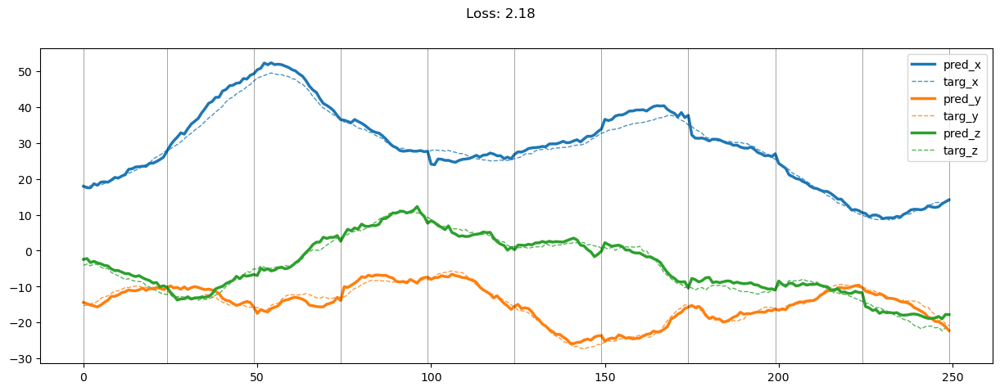

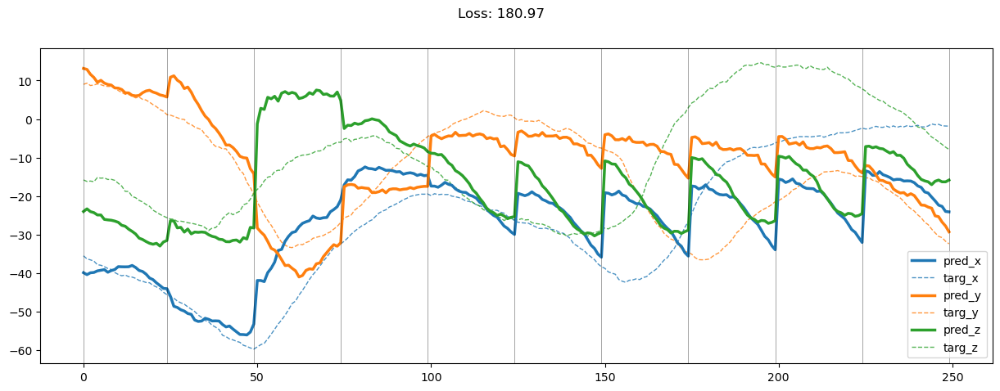

00399: train pred loss:  3.807, g loss:  11.696, diff loss:  7.500, d loss:  1.521
       valid pred loss:  167.687, g loss:  496.179, diff loss:  328.102, d loss:  1.521


100%|██████████| 17/17 [00:01<00:00, 15.23it/s]


00400: train pred loss:  3.626, g loss:  11.198, diff loss:  7.182, d loss:  1.520
       valid pred loss:  168.670, g loss:  495.290, diff loss:  326.230, d loss:  1.520


100%|██████████| 17/17 [00:01<00:00, 15.26it/s]


00401: train pred loss:  3.730, g loss:  11.350, diff loss:  7.230, d loss:  1.520
       valid pred loss:  166.399, g loss:  490.096, diff loss:  323.308, d loss:  1.520


100%|██████████| 17/17 [00:01<00:00, 15.25it/s]


00402: train pred loss:  3.710, g loss:  11.287, diff loss:  7.187, d loss:  1.520
       valid pred loss:  174.648, g loss:  508.822, diff loss:  333.784, d loss:  1.520


100%|██████████| 17/17 [00:01<00:00, 15.22it/s]


00403: train pred loss:  3.660, g loss:  11.100, diff loss:  7.049, d loss:  1.520
       valid pred loss:  165.706, g loss:  492.731, diff loss:  326.635, d loss:  1.520


100%|██████████| 17/17 [00:01<00:00, 15.22it/s]


00404: train pred loss:  3.870, g loss:  11.702, diff loss:  7.440, d loss:  1.519
       valid pred loss:  166.620, g loss:  489.084, diff loss:  322.073, d loss:  1.519


100%|██████████| 17/17 [00:01<00:00, 14.99it/s]


00405: train pred loss:  4.144, g loss:  12.560, diff loss:  8.025, d loss:  1.519
       valid pred loss:  167.771, g loss:  504.811, diff loss:  336.648, d loss:  1.519


100%|██████████| 17/17 [00:01<00:00, 15.18it/s]


00406: train pred loss:  4.045, g loss:  12.183, diff loss:  7.745, d loss:  1.518
       valid pred loss:  164.042, g loss:  486.708, diff loss:  322.273, d loss:  1.518


100%|██████████| 17/17 [00:01<00:00, 15.23it/s]


00407: train pred loss:  3.933, g loss:  12.000, diff loss:  7.675, d loss:  1.517
       valid pred loss:  164.697, g loss:  485.483, diff loss:  320.393, d loss:  1.518


100%|██████████| 17/17 [00:01<00:00, 14.40it/s]


00408: train pred loss:  3.749, g loss:  11.502, diff loss:  7.359, d loss:  1.516
       valid pred loss:  162.389, g loss:  477.654, diff loss:  314.871, d loss:  1.517


100%|██████████| 17/17 [00:01<00:00, 15.28it/s]


00409: train pred loss:  3.712, g loss:  11.460, diff loss:  7.353, d loss:  1.515
       valid pred loss:  171.104, g loss:  505.040, diff loss:  333.541, d loss:  1.516


100%|██████████| 17/17 [00:01<00:00, 15.25it/s]


00410: train pred loss:  3.724, g loss:  11.351, diff loss:  7.232, d loss:  1.515
       valid pred loss:  163.608, g loss:  476.426, diff loss:  312.422, d loss:  1.515


100%|██████████| 17/17 [00:01<00:00, 15.25it/s]


00411: train pred loss:  3.896, g loss:  11.663, diff loss:  7.371, d loss:  1.514
       valid pred loss:  168.792, g loss:  480.966, diff loss:  311.778, d loss:  1.514


100%|██████████| 17/17 [00:01<00:00, 15.20it/s]


00412: train pred loss:  3.900, g loss:  11.707, diff loss:  7.409, d loss:  1.512
       valid pred loss:  168.627, g loss:  496.385, diff loss:  327.361, d loss:  1.513


100%|██████████| 17/17 [00:01<00:00, 15.26it/s]


00413: train pred loss:  4.161, g loss:  12.482, diff loss:  7.922, d loss:  1.511
       valid pred loss:  171.792, g loss:  491.659, diff loss:  319.469, d loss:  1.511


100%|██████████| 17/17 [00:01<00:00, 15.27it/s]


00414: train pred loss:  4.080, g loss:  12.276, diff loss:  7.797, d loss:  1.510
       valid pred loss:  162.745, g loss:  486.574, diff loss:  323.429, d loss:  1.510


100%|██████████| 17/17 [00:01<00:00, 15.25it/s]


00415: train pred loss:  3.873, g loss:  11.808, diff loss:  7.535, d loss:  1.509
       valid pred loss:  163.270, g loss:  477.167, diff loss:  313.495, d loss:  1.509


100%|██████████| 17/17 [00:01<00:00, 15.25it/s]


00416: train pred loss:  3.710, g loss:  11.246, diff loss:  7.134, d loss:  1.508
       valid pred loss:  165.459, g loss:  488.611, diff loss:  322.750, d loss:  1.508


100%|██████████| 17/17 [00:01<00:00, 15.24it/s]


00417: train pred loss:  3.581, g loss:  11.031, diff loss:  7.048, d loss:  1.506
       valid pred loss:  159.872, g loss:  474.724, diff loss:  314.449, d loss:  1.507


100%|██████████| 17/17 [00:01<00:00, 15.25it/s]


00418: train pred loss:  3.636, g loss:  11.050, diff loss:  7.009, d loss:  1.505
       valid pred loss:  166.532, g loss:  488.697, diff loss:  321.761, d loss:  1.506


100%|██████████| 17/17 [00:01<00:00, 15.27it/s]


00419: train pred loss:  3.789, g loss:  11.590, diff loss:  7.396, d loss:  1.504
       valid pred loss:  163.873, g loss:  481.178, diff loss:  316.899, d loss:  1.504


100%|██████████| 17/17 [00:01<00:00, 15.24it/s]


00420: train pred loss:  4.013, g loss:  12.250, diff loss:  7.830, d loss:  1.503
       valid pred loss:  163.907, g loss:  471.578, diff loss:  307.264, d loss:  1.503


100%|██████████| 17/17 [00:01<00:00, 14.05it/s]


00421: train pred loss:  3.980, g loss:  12.183, diff loss:  7.795, d loss:  1.501
       valid pred loss:  172.696, g loss:  502.483, diff loss:  329.378, d loss:  1.502


100%|██████████| 17/17 [00:01<00:00, 14.11it/s]


00422: train pred loss:  3.730, g loss:  11.398, diff loss:  7.259, d loss:  1.500
       valid pred loss:  171.515, g loss:  493.330, diff loss:  321.406, d loss:  1.500


100%|██████████| 17/17 [00:01<00:00, 14.25it/s]


00423: train pred loss:  3.591, g loss:  11.077, diff loss:  7.075, d loss:  1.499
       valid pred loss:  163.913, g loss:  478.358, diff loss:  314.034, d loss:  1.500


100%|██████████| 17/17 [00:01<00:00, 14.35it/s]


00424: train pred loss:  3.366, g loss:  10.463, diff loss:  6.685, d loss:  1.498
       valid pred loss:  168.916, g loss:  485.821, diff loss:  316.493, d loss:  1.498


100%|██████████| 17/17 [00:01<00:00, 15.22it/s]


00425: train pred loss:  3.451, g loss:  10.617, diff loss:  6.754, d loss:  1.497
       valid pred loss:  163.240, g loss:  474.059, diff loss:  310.406, d loss:  1.497


100%|██████████| 17/17 [00:01<00:00, 15.27it/s]


00426: train pred loss:  3.536, g loss:  10.878, diff loss:  6.927, d loss:  1.495
       valid pred loss:  160.332, g loss:  462.897, diff loss:  302.151, d loss:  1.495


100%|██████████| 17/17 [00:01<00:00, 15.18it/s]


00427: train pred loss:  3.485, g loss:  10.651, diff loss:  6.751, d loss:  1.494
       valid pred loss:  164.379, g loss:  475.021, diff loss:  310.226, d loss:  1.494


100%|██████████| 17/17 [00:01<00:00, 14.88it/s]


00428: train pred loss:  3.502, g loss:  10.710, diff loss:  6.792, d loss:  1.493
       valid pred loss:  163.661, g loss:  471.634, diff loss:  307.556, d loss:  1.493


100%|██████████| 17/17 [00:01<00:00, 14.91it/s]


00429: train pred loss:  3.416, g loss:  10.618, diff loss:  6.785, d loss:  1.492
       valid pred loss:  164.685, g loss:  474.365, diff loss:  309.262, d loss:  1.492


100%|██████████| 17/17 [00:01<00:00, 15.23it/s]


00430: train pred loss:  3.471, g loss:  10.611, diff loss:  6.722, d loss:  1.491
       valid pred loss:  166.756, g loss:  485.520, diff loss:  318.345, d loss:  1.491


100%|██████████| 17/17 [00:01<00:00, 15.20it/s]


00431: train pred loss:  3.534, g loss:  10.787, diff loss:  6.832, d loss:  1.490
       valid pred loss:  166.182, g loss:  486.060, diff loss:  319.457, d loss:  1.490


100%|██████████| 17/17 [00:01<00:00, 14.91it/s]


00432: train pred loss:  3.534, g loss:  10.860, diff loss:  6.905, d loss:  1.489
       valid pred loss:  167.553, g loss:  480.313, diff loss:  312.339, d loss:  1.489


100%|██████████| 17/17 [00:01<00:00, 15.13it/s]


00433: train pred loss:  3.592, g loss:  11.001, diff loss:  6.987, d loss:  1.488
       valid pred loss:  166.907, g loss:  479.073, diff loss:  311.744, d loss:  1.488


100%|██████████| 17/17 [00:01<00:00, 14.18it/s]


00434: train pred loss:  3.793, g loss:  11.613, diff loss:  7.398, d loss:  1.488
       valid pred loss:  164.760, g loss:  482.371, diff loss:  317.188, d loss:  1.488


100%|██████████| 17/17 [00:01<00:00, 15.19it/s]


00435: train pred loss:  3.887, g loss:  11.870, diff loss:  7.559, d loss:  1.487
       valid pred loss:  169.549, g loss:  490.932, diff loss:  320.959, d loss:  1.487


100%|██████████| 17/17 [00:01<00:00, 15.18it/s]


00436: train pred loss:  3.840, g loss:  11.696, diff loss:  7.431, d loss:  1.486
       valid pred loss:  170.545, g loss:  501.392, diff loss:  330.423, d loss:  1.487


100%|██████████| 17/17 [00:01<00:00, 15.18it/s]


00437: train pred loss:  3.706, g loss:  11.269, diff loss:  7.139, d loss:  1.486
       valid pred loss:  162.240, g loss:  466.139, diff loss:  303.474, d loss:  1.486


100%|██████████| 17/17 [00:01<00:00, 15.17it/s]


00438: train pred loss:  3.609, g loss:  10.978, diff loss:  6.944, d loss:  1.485
       valid pred loss:  170.094, g loss:  496.493, diff loss:  325.973, d loss:  1.486


100%|██████████| 17/17 [00:01<00:00, 15.18it/s]


00439: train pred loss:  3.532, g loss:  10.930, diff loss:  6.971, d loss:  1.485
       valid pred loss:  161.047, g loss:  467.941, diff loss:  306.468, d loss:  1.485


100%|██████████| 17/17 [00:01<00:00, 15.14it/s]


00440: train pred loss:  3.737, g loss:  11.347, diff loss:  7.184, d loss:  1.485
       valid pred loss:  158.185, g loss:  454.921, diff loss:  296.310, d loss:  1.485


100%|██████████| 17/17 [00:01<00:00, 14.76it/s]


00441: train pred loss:  3.661, g loss:  11.245, diff loss:  7.158, d loss:  1.484
       valid pred loss:  164.145, g loss:  472.803, diff loss:  308.231, d loss:  1.485


100%|██████████| 17/17 [00:01<00:00, 15.22it/s]


00442: train pred loss:  3.541, g loss:  10.802, diff loss:  6.834, d loss:  1.484
       valid pred loss:  166.876, g loss:  474.424, diff loss:  307.122, d loss:  1.485


100%|██████████| 17/17 [00:01<00:00, 15.24it/s]


00443: train pred loss:  3.426, g loss:  10.600, diff loss:  6.747, d loss:  1.484
       valid pred loss:  159.403, g loss:  468.606, diff loss:  308.776, d loss:  1.485


100%|██████████| 17/17 [00:01<00:00, 15.22it/s]


00444: train pred loss:  3.404, g loss:  10.472, diff loss:  6.642, d loss:  1.484
       valid pred loss:  164.200, g loss:  473.285, diff loss:  308.659, d loss:  1.485


100%|██████████| 17/17 [00:01<00:00, 15.22it/s]


00445: train pred loss:  3.164, g loss:  9.836, diff loss:  6.245, d loss:  1.484
       valid pred loss:  164.233, g loss:  483.389, diff loss:  318.730, d loss:  1.485


100%|██████████| 17/17 [00:01<00:00, 15.23it/s]


00446: train pred loss:  3.277, g loss:  10.095, diff loss:  6.392, d loss:  1.484
       valid pred loss:  161.291, g loss:  460.498, diff loss:  298.781, d loss:  1.485


100%|██████████| 17/17 [00:01<00:00, 15.16it/s]


00447: train pred loss:  3.193, g loss:  9.837, diff loss:  6.219, d loss:  1.485
       valid pred loss:  162.353, g loss:  469.659, diff loss:  306.880, d loss:  1.486


100%|██████████| 17/17 [00:01<00:00, 15.19it/s]


00448: train pred loss:  3.253, g loss:  10.044, diff loss:  6.366, d loss:  1.485
       valid pred loss:  164.477, g loss:  479.012, diff loss:  314.110, d loss:  1.486


100%|██████████| 17/17 [00:01<00:00, 15.19it/s]


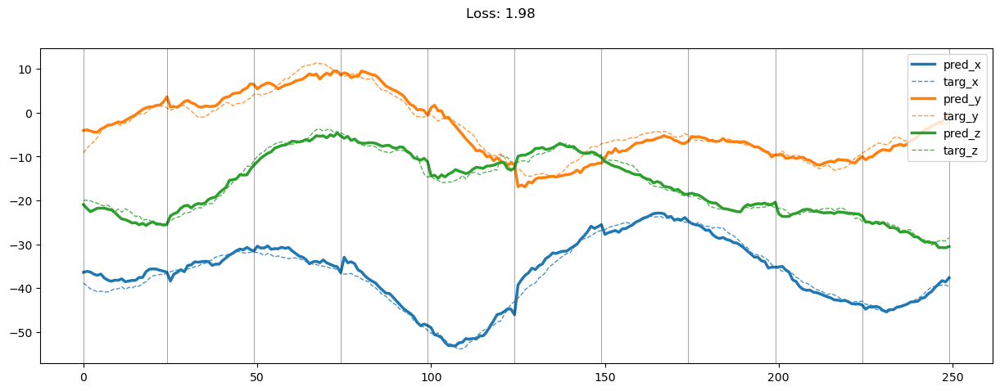

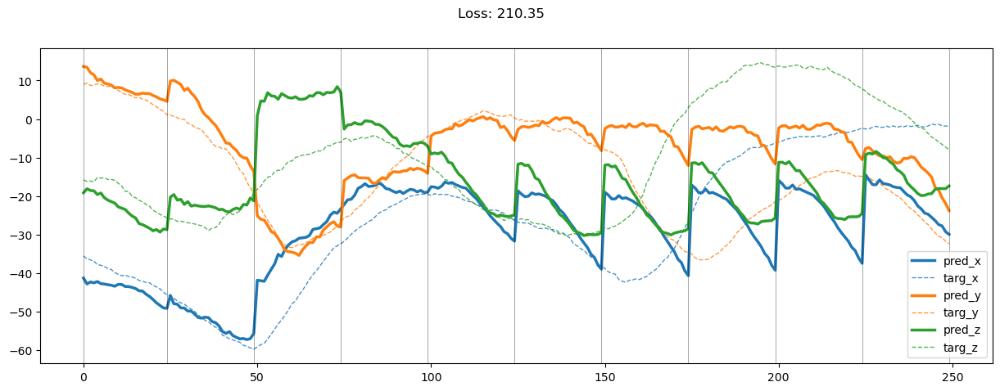

00449: train pred loss:  3.280, g loss:  10.130, diff loss:  6.424, d loss:  1.485
       valid pred loss:  158.659, g loss:  467.500, diff loss:  308.416, d loss:  1.486


100%|██████████| 17/17 [00:01<00:00, 15.18it/s]


00450: train pred loss:  3.388, g loss:  10.507, diff loss:  6.694, d loss:  1.486
       valid pred loss:  176.438, g loss:  501.568, diff loss:  324.707, d loss:  1.487


100%|██████████| 17/17 [00:01<00:00, 15.20it/s]


00451: train pred loss:  3.356, g loss:  10.357, diff loss:  6.577, d loss:  1.486
       valid pred loss:  160.819, g loss:  470.092, diff loss:  308.849, d loss:  1.487


100%|██████████| 17/17 [00:01<00:00, 15.20it/s]


00452: train pred loss:  3.682, g loss:  11.016, diff loss:  6.910, d loss:  1.487
       valid pred loss:  164.749, g loss:  470.336, diff loss:  305.164, d loss:  1.488


100%|██████████| 17/17 [00:01<00:00, 15.19it/s]


00453: train pred loss:  3.486, g loss:  10.528, diff loss:  6.619, d loss:  1.488
       valid pred loss:  163.896, g loss:  473.059, diff loss:  308.741, d loss:  1.489


100%|██████████| 17/17 [00:01<00:00, 15.20it/s]


00454: train pred loss:  3.500, g loss:  10.598, diff loss:  6.676, d loss:  1.488
       valid pred loss:  165.519, g loss:  470.951, diff loss:  305.011, d loss:  1.490


100%|██████████| 17/17 [00:01<00:00, 15.21it/s]


00455: train pred loss:  3.402, g loss:  10.453, diff loss:  6.630, d loss:  1.489
       valid pred loss:  167.733, g loss:  474.293, diff loss:  306.140, d loss:  1.490


100%|██████████| 17/17 [00:01<00:00, 15.21it/s]


00456: train pred loss:  3.362, g loss:  10.302, diff loss:  6.520, d loss:  1.490
       valid pred loss:  160.781, g loss:  464.254, diff loss:  303.053, d loss:  1.491


100%|██████████| 17/17 [00:01<00:00, 14.02it/s]


00457: train pred loss:  3.618, g loss:  10.978, diff loss:  6.942, d loss:  1.491
       valid pred loss:  167.251, g loss:  500.485, diff loss:  332.816, d loss:  1.492


100%|██████████| 17/17 [00:01<00:00, 14.70it/s]


00458: train pred loss:  3.453, g loss:  10.629, diff loss:  6.758, d loss:  1.492
       valid pred loss:  167.993, g loss:  493.470, diff loss:  325.059, d loss:  1.493


100%|██████████| 17/17 [00:01<00:00, 15.14it/s]


00459: train pred loss:  3.320, g loss:  10.160, diff loss:  6.422, d loss:  1.493
       valid pred loss:  169.254, g loss:  490.744, diff loss:  321.073, d loss:  1.494


100%|██████████| 17/17 [00:01<00:00, 15.15it/s]


00460: train pred loss:  3.316, g loss:  10.106, diff loss:  6.374, d loss:  1.494
       valid pred loss:  175.195, g loss:  500.919, diff loss:  325.308, d loss:  1.495


100%|██████████| 17/17 [00:01<00:00, 15.24it/s]


00461: train pred loss:  3.274, g loss:  9.967, diff loss:  6.278, d loss:  1.495
       valid pred loss:  175.188, g loss:  508.101, diff loss:  332.499, d loss:  1.496


100%|██████████| 17/17 [00:01<00:00, 15.14it/s]


00462: train pred loss:  3.301, g loss:  10.060, diff loss:  6.345, d loss:  1.496
       valid pred loss:  167.081, g loss:  486.128, diff loss:  318.634, d loss:  1.497


100%|██████████| 17/17 [00:01<00:00, 15.15it/s]


00463: train pred loss:  3.328, g loss:  10.294, diff loss:  6.553, d loss:  1.497
       valid pred loss:  161.222, g loss:  476.387, diff loss:  314.753, d loss:  1.498


100%|██████████| 17/17 [00:01<00:00, 13.99it/s]


00464: train pred loss:  3.356, g loss:  10.276, diff loss:  6.508, d loss:  1.498
       valid pred loss:  167.125, g loss:  487.909, diff loss:  320.373, d loss:  1.499


100%|██████████| 17/17 [00:01<00:00, 15.08it/s]


00465: train pred loss:  3.392, g loss:  10.429, diff loss:  6.625, d loss:  1.499
       valid pred loss:  168.659, g loss:  487.137, diff loss:  318.067, d loss:  1.500


100%|██████████| 17/17 [00:01<00:00, 14.46it/s]


00466: train pred loss:  3.503, g loss:  10.713, diff loss:  6.800, d loss:  1.499
       valid pred loss:  162.409, g loss:  482.802, diff loss:  319.984, d loss:  1.501


100%|██████████| 17/17 [00:01<00:00, 13.67it/s]


00467: train pred loss:  3.276, g loss:  10.025, diff loss:  6.340, d loss:  1.501
       valid pred loss:  161.816, g loss:  475.819, diff loss:  313.595, d loss:  1.502


100%|██████████| 17/17 [00:01<00:00, 14.27it/s]


00468: train pred loss:  3.251, g loss:  9.993, diff loss:  6.334, d loss:  1.502
       valid pred loss:  160.367, g loss:  469.967, diff loss:  309.193, d loss:  1.503


100%|██████████| 17/17 [00:01<00:00, 14.70it/s]


00469: train pred loss:  3.218, g loss:  9.938, diff loss:  6.313, d loss:  1.503
       valid pred loss:  161.566, g loss:  469.967, diff loss:  307.994, d loss:  1.504


100%|██████████| 17/17 [00:01<00:00, 13.70it/s]


00470: train pred loss:  3.079, g loss:  9.553, diff loss:  6.068, d loss:  1.504
       valid pred loss:  164.853, g loss:  483.259, diff loss:  318.001, d loss:  1.505


100%|██████████| 17/17 [00:01<00:00, 15.01it/s]


00471: train pred loss:  3.184, g loss:  9.829, diff loss:  6.239, d loss:  1.504
       valid pred loss:  157.622, g loss:  461.507, diff loss:  303.480, d loss:  1.506


100%|██████████| 17/17 [00:01<00:00, 15.05it/s]


00472: train pred loss:  3.219, g loss:  9.853, diff loss:  6.230, d loss:  1.505
       valid pred loss:  161.589, g loss:  482.192, diff loss:  320.199, d loss:  1.507


100%|██████████| 17/17 [00:01<00:00, 15.11it/s]


00473: train pred loss:  3.088, g loss:  9.478, diff loss:  5.987, d loss:  1.506
       valid pred loss:  167.439, g loss:  493.910, diff loss:  326.068, d loss:  1.507


100%|██████████| 17/17 [00:01<00:00, 15.13it/s]


00474: train pred loss:  3.078, g loss:  9.455, diff loss:  5.974, d loss:  1.507
       valid pred loss:  160.700, g loss:  467.925, diff loss:  306.823, d loss:  1.508


100%|██████████| 17/17 [00:01<00:00, 15.12it/s]


00475: train pred loss:  3.095, g loss:  9.525, diff loss:  6.028, d loss:  1.508
       valid pred loss:  172.917, g loss:  500.929, diff loss:  327.611, d loss:  1.509


100%|██████████| 17/17 [00:01<00:00, 15.14it/s]


00476: train pred loss:  3.039, g loss:  9.302, diff loss:  5.862, d loss:  1.508
       valid pred loss:  170.077, g loss:  504.416, diff loss:  333.938, d loss:  1.510


100%|██████████| 17/17 [00:01<00:00, 15.12it/s]


00477: train pred loss:  3.110, g loss:  9.546, diff loss:  6.035, d loss:  1.509
       valid pred loss:  163.964, g loss:  475.843, diff loss:  311.480, d loss:  1.510


100%|██████████| 17/17 [00:01<00:00, 15.16it/s]


00478: train pred loss:  3.259, g loss:  10.101, diff loss:  6.443, d loss:  1.510
       valid pred loss:  174.918, g loss:  509.397, diff loss:  334.080, d loss:  1.511


100%|██████████| 17/17 [00:01<00:00, 15.21it/s]


00479: train pred loss:  3.166, g loss:  9.797, diff loss:  6.231, d loss:  1.510
       valid pred loss:  172.692, g loss:  505.551, diff loss:  332.460, d loss:  1.511


100%|██████████| 17/17 [00:01<00:00, 15.12it/s]


00480: train pred loss:  3.267, g loss:  10.063, diff loss:  6.398, d loss:  1.511
       valid pred loss:  162.633, g loss:  479.890, diff loss:  316.859, d loss:  1.512


100%|██████████| 17/17 [00:01<00:00, 14.85it/s]


00481: train pred loss:  3.329, g loss:  10.117, diff loss:  6.389, d loss:  1.511
       valid pred loss:  164.140, g loss:  474.717, diff loss:  310.178, d loss:  1.512


100%|██████████| 17/17 [00:01<00:00, 14.56it/s]


00482: train pred loss:  3.566, g loss:  10.858, diff loss:  6.893, d loss:  1.512
       valid pred loss:  187.440, g loss:  549.196, diff loss:  361.358, d loss:  1.513


100%|██████████| 17/17 [00:01<00:00, 15.14it/s]


00483: train pred loss:  3.927, g loss:  12.101, diff loss:  7.776, d loss:  1.512
       valid pred loss:  171.092, g loss:  493.032, diff loss:  321.543, d loss:  1.513


100%|██████████| 17/17 [00:01<00:00, 14.63it/s]


00484: train pred loss:  4.012, g loss:  12.312, diff loss:  7.902, d loss:  1.512
       valid pred loss:  180.171, g loss:  532.594, diff loss:  352.026, d loss:  1.513


100%|██████████| 17/17 [00:01<00:00, 15.20it/s]


00485: train pred loss:  3.742, g loss:  11.451, diff loss:  7.311, d loss:  1.512
       valid pred loss:  180.573, g loss:  521.711, diff loss:  340.741, d loss:  1.513


100%|██████████| 17/17 [00:01<00:00, 15.13it/s]


00486: train pred loss:  3.449, g loss:  10.650, diff loss:  6.803, d loss:  1.512
       valid pred loss:  175.537, g loss:  509.424, diff loss:  333.490, d loss:  1.513


100%|██████████| 17/17 [00:01<00:00, 15.13it/s]


00487: train pred loss:  3.510, g loss:  10.696, diff loss:  6.788, d loss:  1.512
       valid pred loss:  178.653, g loss:  518.604, diff loss:  339.554, d loss:  1.513


100%|██████████| 17/17 [00:01<00:00, 15.17it/s]


00488: train pred loss:  3.630, g loss:  10.846, diff loss:  6.818, d loss:  1.512
       valid pred loss:  182.195, g loss:  532.253, diff loss:  349.661, d loss:  1.513


100%|██████████| 17/17 [00:01<00:00, 15.12it/s]


00489: train pred loss:  3.414, g loss:  10.570, diff loss:  6.759, d loss:  1.512
       valid pred loss:  194.494, g loss:  568.395, diff loss:  373.503, d loss:  1.513


100%|██████████| 17/17 [00:01<00:00, 15.25it/s]


00490: train pred loss:  4.369, g loss:  13.208, diff loss:  8.441, d loss:  1.512
       valid pred loss:  179.929, g loss:  525.838, diff loss:  345.511, d loss:  1.513


100%|██████████| 17/17 [00:01<00:00, 15.15it/s]


00491: train pred loss:  4.080, g loss:  12.355, diff loss:  7.877, d loss:  1.512
       valid pred loss:  174.164, g loss:  506.727, diff loss:  332.165, d loss:  1.512


100%|██████████| 17/17 [00:01<00:00, 15.14it/s]


00492: train pred loss:  3.859, g loss:  11.620, diff loss:  7.363, d loss:  1.511
       valid pred loss:  168.356, g loss:  493.347, diff loss:  324.593, d loss:  1.512


100%|██████████| 17/17 [00:01<00:00, 15.17it/s]


00493: train pred loss:  3.661, g loss:  11.239, diff loss:  7.179, d loss:  1.511
       valid pred loss:  161.824, g loss:  487.171, diff loss:  324.948, d loss:  1.512


100%|██████████| 17/17 [00:01<00:00, 15.13it/s]


00494: train pred loss:  3.403, g loss:  10.391, diff loss:  6.588, d loss:  1.510
       valid pred loss:  176.109, g loss:  510.042, diff loss:  333.534, d loss:  1.511


100%|██████████| 17/17 [00:01<00:00, 15.23it/s]


00495: train pred loss:  3.352, g loss:  10.184, diff loss:  6.431, d loss:  1.510
       valid pred loss:  174.121, g loss:  515.873, diff loss:  341.352, d loss:  1.511


100%|██████████| 17/17 [00:01<00:00, 15.15it/s]


00496: train pred loss:  3.190, g loss:  9.774, diff loss:  6.183, d loss:  1.509
       valid pred loss:  175.843, g loss:  521.483, diff loss:  345.240, d loss:  1.510


100%|██████████| 17/17 [00:01<00:00, 14.91it/s]


00497: train pred loss:  3.283, g loss:  9.999, diff loss:  6.314, d loss:  1.509
       valid pred loss:  171.124, g loss:  510.645, diff loss:  339.120, d loss:  1.509


100%|██████████| 17/17 [00:01<00:00, 15.18it/s]


00498: train pred loss:  3.155, g loss:  9.613, diff loss:  6.056, d loss:  1.508
       valid pred loss:  173.541, g loss:  514.900, diff loss:  340.957, d loss:  1.509


100%|██████████| 17/17 [00:01<00:00, 14.88it/s]


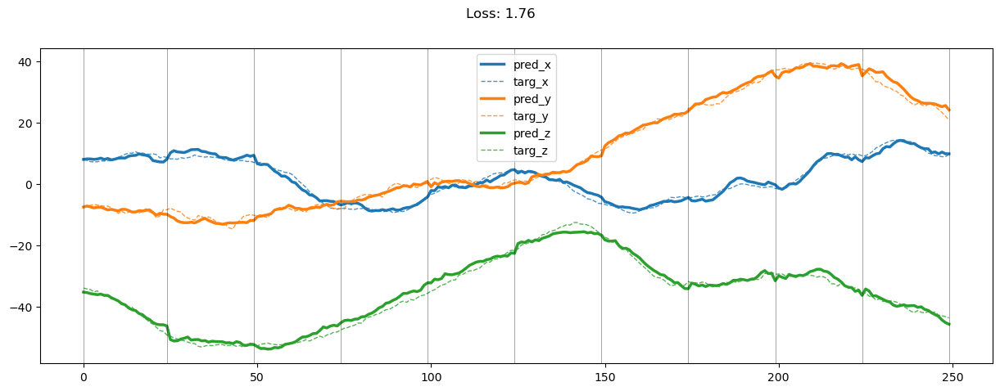

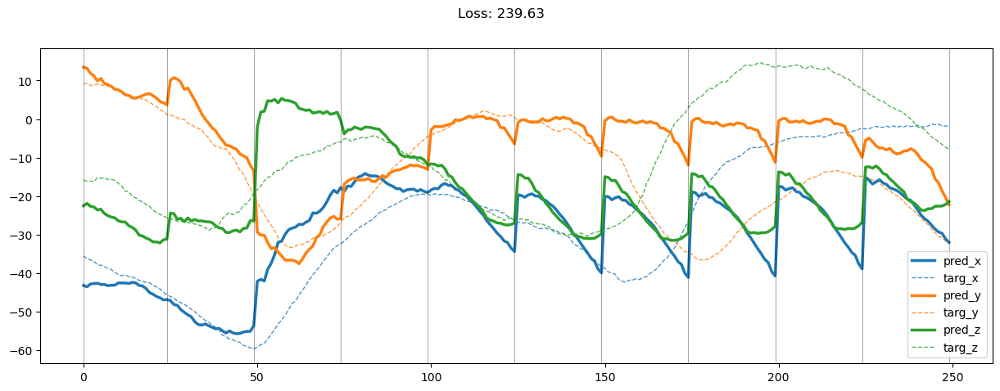

00499: train pred loss:  3.057, g loss:  9.421, diff loss:  5.961, d loss:  1.507
       valid pred loss:  170.031, g loss:  500.022, diff loss:  329.588, d loss:  1.508


100%|██████████| 17/17 [00:01<00:00, 14.84it/s]


00500: train pred loss:  3.059, g loss:  9.465, diff loss:  6.003, d loss:  1.506
       valid pred loss:  164.864, g loss:  489.727, diff loss:  324.459, d loss:  1.507


100%|██████████| 17/17 [00:01<00:00, 15.23it/s]


00501: train pred loss:  3.091, g loss:  9.605, diff loss:  6.110, d loss:  1.506
       valid pred loss:  175.504, g loss:  517.496, diff loss:  341.588, d loss:  1.506


100%|██████████| 17/17 [00:01<00:00, 15.21it/s]


00502: train pred loss:  2.996, g loss:  9.181, diff loss:  5.780, d loss:  1.505
       valid pred loss:  174.125, g loss:  517.216, diff loss:  342.686, d loss:  1.505


100%|██████████| 17/17 [00:01<00:00, 15.20it/s]


00503: train pred loss:  3.117, g loss:  9.503, diff loss:  5.980, d loss:  1.504
       valid pred loss:  170.941, g loss:  510.075, diff loss:  338.728, d loss:  1.504


100%|██████████| 17/17 [00:01<00:00, 15.23it/s]


00504: train pred loss:  2.984, g loss:  9.219, diff loss:  5.828, d loss:  1.503
       valid pred loss:  168.056, g loss:  503.655, diff loss:  335.192, d loss:  1.503


100%|██████████| 17/17 [00:01<00:00, 15.02it/s]


00505: train pred loss:  2.927, g loss:  9.058, diff loss:  5.723, d loss:  1.502
       valid pred loss:  165.144, g loss:  498.497, diff loss:  332.945, d loss:  1.502


100%|██████████| 17/17 [00:01<00:00, 14.91it/s]


00506: train pred loss:  2.936, g loss:  9.082, diff loss:  5.738, d loss:  1.501
       valid pred loss:  172.023, g loss:  515.571, diff loss:  343.139, d loss:  1.502


100%|██████████| 17/17 [00:01<00:00, 14.84it/s]


00507: train pred loss:  2.862, g loss:  8.969, diff loss:  5.697, d loss:  1.500
       valid pred loss:  172.754, g loss:  511.798, diff loss:  338.633, d loss:  1.500


100%|██████████| 17/17 [00:01<00:00, 14.54it/s]


00508: train pred loss:  2.846, g loss:  8.781, diff loss:  5.524, d loss:  1.499
       valid pred loss:  168.367, g loss:  513.704, diff loss:  344.927, d loss:  1.500


100%|██████████| 17/17 [00:01<00:00, 14.38it/s]


00509: train pred loss:  2.918, g loss:  9.037, diff loss:  5.707, d loss:  1.498
       valid pred loss:  169.634, g loss:  503.243, diff loss:  333.197, d loss:  1.499


100%|██████████| 17/17 [00:01<00:00, 15.02it/s]


00510: train pred loss:  2.873, g loss:  8.828, diff loss:  5.542, d loss:  1.497
       valid pred loss:  169.077, g loss:  505.895, diff loss:  336.405, d loss:  1.498


100%|██████████| 17/17 [00:01<00:00, 15.22it/s]


00511: train pred loss:  2.788, g loss:  8.531, diff loss:  5.329, d loss:  1.496
       valid pred loss:  170.069, g loss:  512.242, diff loss:  341.759, d loss:  1.497


100%|██████████| 17/17 [00:01<00:00, 15.20it/s]


00512: train pred loss:  2.758, g loss:  8.616, diff loss:  5.443, d loss:  1.496
       valid pred loss:  170.436, g loss:  511.358, diff loss:  340.507, d loss:  1.496


100%|██████████| 17/17 [00:01<00:00, 15.26it/s]


00513: train pred loss:  2.773, g loss:  8.633, diff loss:  5.444, d loss:  1.495
       valid pred loss:  168.347, g loss:  501.125, diff loss:  332.363, d loss:  1.496


100%|██████████| 17/17 [00:01<00:00, 15.26it/s]


00514: train pred loss:  2.845, g loss:  8.781, diff loss:  5.521, d loss:  1.494
       valid pred loss:  168.860, g loss:  509.140, diff loss:  339.864, d loss:  1.495


100%|██████████| 17/17 [00:01<00:00, 15.23it/s]


00515: train pred loss:  2.806, g loss:  8.753, diff loss:  5.530, d loss:  1.493
       valid pred loss:  167.505, g loss:  499.777, diff loss:  331.855, d loss:  1.494


100%|██████████| 17/17 [00:01<00:00, 15.22it/s]


00516: train pred loss:  2.851, g loss:  8.796, diff loss:  5.529, d loss:  1.493
       valid pred loss:  169.577, g loss:  507.310, diff loss:  337.316, d loss:  1.494


100%|██████████| 17/17 [00:01<00:00, 15.16it/s]


00517: train pred loss:  2.888, g loss:  8.982, diff loss:  5.676, d loss:  1.492
       valid pred loss:  162.625, g loss:  484.093, diff loss:  321.050, d loss:  1.493


100%|██████████| 17/17 [00:01<00:00, 14.54it/s]


00518: train pred loss:  2.917, g loss:  9.033, diff loss:  5.698, d loss:  1.492
       valid pred loss:  174.063, g loss:  522.808, diff loss:  348.327, d loss:  1.493


100%|██████████| 17/17 [00:01<00:00, 15.22it/s]


00519: train pred loss:  2.892, g loss:  8.865, diff loss:  5.555, d loss:  1.492
       valid pred loss:  173.906, g loss:  515.308, diff loss:  340.983, d loss:  1.492


100%|██████████| 17/17 [00:01<00:00, 15.24it/s]


00520: train pred loss:  2.817, g loss:  8.716, diff loss:  5.479, d loss:  1.491
       valid pred loss:  171.524, g loss:  517.796, diff loss:  345.854, d loss:  1.492


100%|██████████| 17/17 [00:01<00:00, 14.73it/s]


00521: train pred loss:  3.002, g loss:  9.211, diff loss:  5.790, d loss:  1.491
       valid pred loss:  165.139, g loss:  493.670, diff loss:  328.113, d loss:  1.492


100%|██████████| 17/17 [00:01<00:00, 15.00it/s]


00522: train pred loss:  3.064, g loss:  9.400, diff loss:  5.916, d loss:  1.491
       valid pred loss:  171.571, g loss:  510.292, diff loss:  338.302, d loss:  1.492


100%|██████████| 17/17 [00:01<00:00, 15.14it/s]


00523: train pred loss:  2.886, g loss:  8.860, diff loss:  5.554, d loss:  1.491
       valid pred loss:  166.014, g loss:  504.899, diff loss:  338.466, d loss:  1.492


100%|██████████| 17/17 [00:01<00:00, 15.15it/s]


00524: train pred loss:  2.692, g loss:  8.335, diff loss:  5.224, d loss:  1.491
       valid pred loss:  174.183, g loss:  531.289, diff loss:  356.688, d loss:  1.492


100%|██████████| 17/17 [00:01<00:00, 15.16it/s]


00525: train pred loss:  2.750, g loss:  8.598, diff loss:  5.429, d loss:  1.491
       valid pred loss:  167.430, g loss:  500.182, diff loss:  332.333, d loss:  1.492


100%|██████████| 17/17 [00:01<00:00, 15.18it/s]


00526: train pred loss:  2.718, g loss:  8.491, diff loss:  5.354, d loss:  1.491
       valid pred loss:  164.427, g loss:  488.653, diff loss:  323.808, d loss:  1.493


100%|██████████| 17/17 [00:01<00:00, 15.13it/s]


00527: train pred loss:  2.811, g loss:  8.687, diff loss:  5.458, d loss:  1.492
       valid pred loss:  170.006, g loss:  501.063, diff loss:  330.638, d loss:  1.493


100%|██████████| 17/17 [00:01<00:00, 15.15it/s]


00528: train pred loss:  2.769, g loss:  8.477, diff loss:  5.290, d loss:  1.492
       valid pred loss:  167.735, g loss:  499.962, diff loss:  331.810, d loss:  1.493


100%|██████████| 17/17 [00:01<00:00, 15.16it/s]


00529: train pred loss:  2.709, g loss:  8.470, diff loss:  5.343, d loss:  1.492
       valid pred loss:  166.923, g loss:  500.776, diff loss:  333.437, d loss:  1.494


100%|██████████| 17/17 [00:01<00:00, 15.11it/s]


00530: train pred loss:  2.802, g loss:  8.669, diff loss:  5.450, d loss:  1.493
       valid pred loss:  164.198, g loss:  492.765, diff loss:  328.151, d loss:  1.494


100%|██████████| 17/17 [00:01<00:00, 14.94it/s]


00531: train pred loss:  2.891, g loss:  8.939, diff loss:  5.631, d loss:  1.494
       valid pred loss:  171.147, g loss:  507.773, diff loss:  336.210, d loss:  1.495


100%|██████████| 17/17 [00:01<00:00, 15.27it/s]


00532: train pred loss:  2.786, g loss:  8.571, diff loss:  5.369, d loss:  1.494
       valid pred loss:  162.264, g loss:  484.861, diff loss:  322.182, d loss:  1.496


100%|██████████| 17/17 [00:01<00:00, 15.27it/s]


00533: train pred loss:  2.642, g loss:  8.219, diff loss:  5.161, d loss:  1.495
       valid pred loss:  174.806, g loss:  515.229, diff loss:  340.009, d loss:  1.497


100%|██████████| 17/17 [00:01<00:00, 15.28it/s]


00534: train pred loss:  2.730, g loss:  8.467, diff loss:  5.323, d loss:  1.496
       valid pred loss:  164.344, g loss:  489.945, diff loss:  325.188, d loss:  1.497


100%|██████████| 17/17 [00:01<00:00, 15.27it/s]


00535: train pred loss:  2.719, g loss:  8.433, diff loss:  5.301, d loss:  1.497
       valid pred loss:  168.361, g loss:  493.626, diff loss:  324.853, d loss:  1.498


100%|██████████| 17/17 [00:01<00:00, 15.27it/s]


00536: train pred loss:  2.762, g loss:  8.599, diff loss:  5.424, d loss:  1.498
       valid pred loss:  171.081, g loss:  508.660, diff loss:  337.167, d loss:  1.499


100%|██████████| 17/17 [00:01<00:00, 15.28it/s]


00537: train pred loss:  2.820, g loss:  8.681, diff loss:  5.450, d loss:  1.499
       valid pred loss:  168.630, g loss:  499.184, diff loss:  330.144, d loss:  1.500


100%|██████████| 17/17 [00:01<00:00, 13.77it/s]


00538: train pred loss:  2.832, g loss:  8.756, diff loss:  5.514, d loss:  1.500
       valid pred loss:  163.177, g loss:  491.409, diff loss:  327.823, d loss:  1.501


100%|██████████| 17/17 [00:01<00:00, 15.24it/s]


00539: train pred loss:  2.837, g loss:  8.777, diff loss:  5.530, d loss:  1.501
       valid pred loss:  165.628, g loss:  499.724, diff loss:  333.688, d loss:  1.503


100%|██████████| 17/17 [00:01<00:00, 15.06it/s]


00540: train pred loss:  2.753, g loss:  8.623, diff loss:  5.462, d loss:  1.502
       valid pred loss:  165.581, g loss:  492.521, diff loss:  326.534, d loss:  1.504


100%|██████████| 17/17 [00:01<00:00, 15.26it/s]


00541: train pred loss:  2.710, g loss:  8.461, diff loss:  5.344, d loss:  1.503
       valid pred loss:  165.881, g loss:  492.251, diff loss:  325.964, d loss:  1.505


100%|██████████| 17/17 [00:01<00:00, 15.26it/s]


00542: train pred loss:  2.909, g loss:  8.981, diff loss:  5.667, d loss:  1.504
       valid pred loss:  165.668, g loss:  486.613, diff loss:  320.540, d loss:  1.506


100%|██████████| 17/17 [00:01<00:00, 15.09it/s]


00543: train pred loss:  3.176, g loss:  9.579, diff loss:  5.999, d loss:  1.505
       valid pred loss:  171.888, g loss:  516.362, diff loss:  344.071, d loss:  1.507


100%|██████████| 17/17 [00:01<00:00, 15.25it/s]


00544: train pred loss:  2.986, g loss:  9.114, diff loss:  5.725, d loss:  1.506
       valid pred loss:  172.896, g loss:  513.588, diff loss:  340.290, d loss:  1.508


100%|██████████| 17/17 [00:01<00:00, 14.50it/s]


00545: train pred loss:  2.789, g loss:  8.590, diff loss:  5.398, d loss:  1.507
       valid pred loss:  167.191, g loss:  499.023, diff loss:  331.430, d loss:  1.509


100%|██████████| 17/17 [00:01<00:00, 15.18it/s]


00546: train pred loss:  2.735, g loss:  8.432, diff loss:  5.295, d loss:  1.508
       valid pred loss:  169.075, g loss:  507.290, diff loss:  337.814, d loss:  1.510


100%|██████████| 17/17 [00:01<00:00, 15.22it/s]


00547: train pred loss:  2.732, g loss:  8.505, diff loss:  5.371, d loss:  1.509
       valid pred loss:  170.190, g loss:  512.003, diff loss:  341.413, d loss:  1.510


100%|██████████| 17/17 [00:01<00:00, 15.08it/s]


00548: train pred loss:  2.753, g loss:  8.567, diff loss:  5.414, d loss:  1.510
       valid pred loss:  164.460, g loss:  487.779, diff loss:  322.919, d loss:  1.511


100%|██████████| 17/17 [00:01<00:00, 15.23it/s]


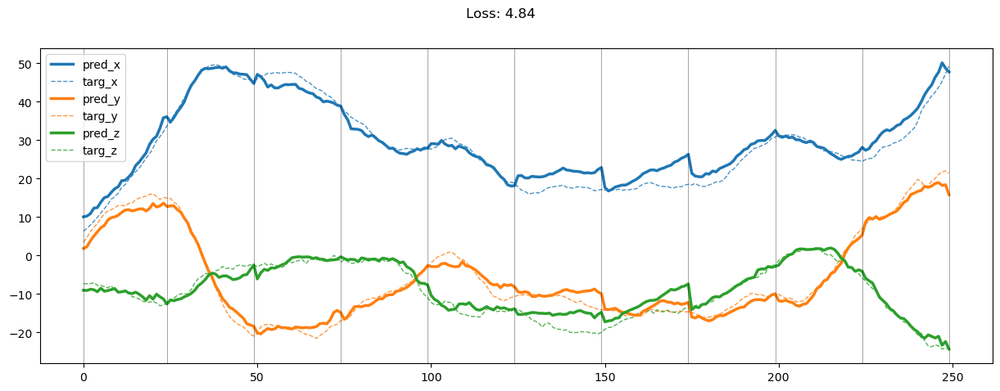

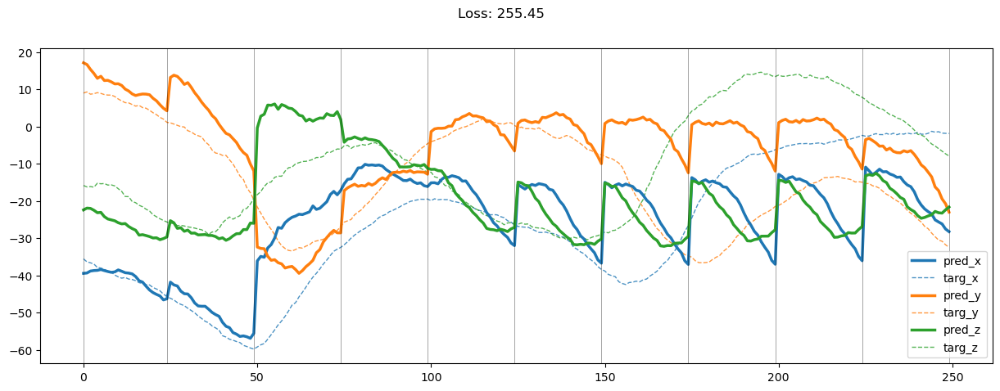

00549: train pred loss:  2.675, g loss:  8.280, diff loss:  5.205, d loss:  1.510
       valid pred loss:  166.417, g loss:  492.506, diff loss:  325.690, d loss:  1.512


100%|██████████| 17/17 [00:01<00:00, 15.20it/s]


00550: train pred loss:  2.696, g loss:  8.333, diff loss:  5.238, d loss:  1.511
       valid pred loss:  177.402, g loss:  521.843, diff loss:  344.043, d loss:  1.512


100%|██████████| 17/17 [00:01<00:00, 15.24it/s]


00551: train pred loss:  2.714, g loss:  8.392, diff loss:  5.280, d loss:  1.512
       valid pred loss:  170.211, g loss:  510.911, diff loss:  340.303, d loss:  1.513


100%|██████████| 17/17 [00:01<00:00, 15.18it/s]


00552: train pred loss:  2.725, g loss:  8.383, diff loss:  5.260, d loss:  1.512
       valid pred loss:  171.500, g loss:  509.107, diff loss:  337.210, d loss:  1.513


100%|██████████| 17/17 [00:01<00:00, 15.18it/s]


00553: train pred loss:  2.736, g loss:  8.415, diff loss:  5.282, d loss:  1.512
       valid pred loss:  175.131, g loss:  521.163, diff loss:  345.635, d loss:  1.514


100%|██████████| 17/17 [00:01<00:00, 14.99it/s]


00554: train pred loss:  2.784, g loss:  8.564, diff loss:  5.383, d loss:  1.512
       valid pred loss:  171.709, g loss:  504.774, diff loss:  332.668, d loss:  1.514


100%|██████████| 17/17 [00:01<00:00, 15.18it/s]


00555: train pred loss:  2.769, g loss:  8.568, diff loss:  5.402, d loss:  1.513
       valid pred loss:  168.340, g loss:  500.260, diff loss:  331.523, d loss:  1.514


100%|██████████| 17/17 [00:01<00:00, 15.17it/s]


00556: train pred loss:  2.674, g loss:  8.277, diff loss:  5.205, d loss:  1.513
       valid pred loss:  168.333, g loss:  500.837, diff loss:  332.107, d loss:  1.514


100%|██████████| 17/17 [00:01<00:00, 15.14it/s]


00557: train pred loss:  2.621, g loss:  8.086, diff loss:  5.067, d loss:  1.512
       valid pred loss:  162.707, g loss:  483.819, diff loss:  320.714, d loss:  1.513


100%|██████████| 17/17 [00:01<00:00, 15.25it/s]


00558: train pred loss:  2.620, g loss:  8.209, diff loss:  5.191, d loss:  1.512
       valid pred loss:  167.516, g loss:  496.541, diff loss:  328.627, d loss:  1.513


100%|██████████| 17/17 [00:01<00:00, 15.25it/s]


00559: train pred loss:  2.629, g loss:  8.154, diff loss:  5.127, d loss:  1.512
       valid pred loss:  173.774, g loss:  526.007, diff loss:  351.835, d loss:  1.513


100%|██████████| 17/17 [00:01<00:00, 15.23it/s]


00560: train pred loss:  2.597, g loss:  8.008, diff loss:  5.012, d loss:  1.511
       valid pred loss:  167.833, g loss:  496.882, diff loss:  328.650, d loss:  1.512


100%|██████████| 17/17 [00:01<00:00, 15.25it/s]


00561: train pred loss:  2.588, g loss:  8.064, diff loss:  5.077, d loss:  1.511
       valid pred loss:  168.126, g loss:  500.882, diff loss:  332.357, d loss:  1.511


100%|██████████| 17/17 [00:01<00:00, 14.76it/s]


00562: train pred loss:  2.580, g loss:  8.053, diff loss:  5.073, d loss:  1.510
       valid pred loss:  167.550, g loss:  502.686, diff loss:  334.735, d loss:  1.511


100%|██████████| 17/17 [00:01<00:00, 15.12it/s]


00563: train pred loss:  2.691, g loss:  8.365, diff loss:  5.272, d loss:  1.509
       valid pred loss:  173.629, g loss:  522.532, diff loss:  348.502, d loss:  1.510


100%|██████████| 17/17 [00:01<00:00, 15.21it/s]


00564: train pred loss:  2.746, g loss:  8.492, diff loss:  5.344, d loss:  1.508
       valid pred loss:  164.462, g loss:  505.382, diff loss:  340.518, d loss:  1.509


100%|██████████| 17/17 [00:01<00:00, 15.19it/s]


00565: train pred loss:  2.828, g loss:  8.758, diff loss:  5.527, d loss:  1.507
       valid pred loss:  166.378, g loss:  497.583, diff loss:  330.802, d loss:  1.508


100%|██████████| 17/17 [00:01<00:00, 15.18it/s]


00566: train pred loss:  2.908, g loss:  8.919, diff loss:  5.607, d loss:  1.506
       valid pred loss:  164.637, g loss:  491.919, diff loss:  326.879, d loss:  1.506


100%|██████████| 17/17 [00:01<00:00, 14.02it/s]


00567: train pred loss:  2.763, g loss:  8.525, diff loss:  5.356, d loss:  1.505
       valid pred loss:  173.088, g loss:  508.976, diff loss:  335.483, d loss:  1.505


100%|██████████| 17/17 [00:01<00:00, 14.41it/s]


00568: train pred loss:  2.617, g loss:  8.105, diff loss:  5.082, d loss:  1.504
       valid pred loss:  162.404, g loss:  489.159, diff loss:  326.349, d loss:  1.504


100%|██████████| 17/17 [00:01<00:00, 15.22it/s]


00569: train pred loss:  2.700, g loss:  8.474, diff loss:  5.367, d loss:  1.502
       valid pred loss:  171.282, g loss:  515.460, diff loss:  343.771, d loss:  1.503


100%|██████████| 17/17 [00:01<00:00, 15.20it/s]


00570: train pred loss:  2.833, g loss:  8.710, diff loss:  5.468, d loss:  1.501
       valid pred loss:  170.086, g loss:  501.738, diff loss:  331.243, d loss:  1.502


100%|██████████| 17/17 [00:01<00:00, 15.21it/s]


00571: train pred loss:  2.752, g loss:  8.589, diff loss:  5.428, d loss:  1.500
       valid pred loss:  171.330, g loss:  505.814, diff loss:  334.075, d loss:  1.501


100%|██████████| 17/17 [00:01<00:00, 15.22it/s]


00572: train pred loss:  2.843, g loss:  8.795, diff loss:  5.541, d loss:  1.499
       valid pred loss:  170.631, g loss:  502.926, diff loss:  331.884, d loss:  1.499


100%|██████████| 17/17 [00:01<00:00, 15.23it/s]


00573: train pred loss:  2.819, g loss:  8.708, diff loss:  5.478, d loss:  1.498
       valid pred loss:  167.980, g loss:  501.658, diff loss:  333.266, d loss:  1.498


100%|██████████| 17/17 [00:01<00:00, 14.56it/s]


00574: train pred loss:  2.795, g loss:  8.562, diff loss:  5.353, d loss:  1.497
       valid pred loss:  168.734, g loss:  501.051, diff loss:  331.903, d loss:  1.497


100%|██████████| 17/17 [00:01<00:00, 15.25it/s]


00575: train pred loss:  2.716, g loss:  8.383, diff loss:  5.253, d loss:  1.496
       valid pred loss:  170.696, g loss:  511.174, diff loss:  340.065, d loss:  1.496


100%|██████████| 17/17 [00:01<00:00, 14.69it/s]


00576: train pred loss:  2.712, g loss:  8.410, diff loss:  5.282, d loss:  1.495
       valid pred loss:  170.775, g loss:  504.837, diff loss:  333.647, d loss:  1.496


100%|██████████| 17/17 [00:01<00:00, 15.22it/s]


00577: train pred loss:  2.611, g loss:  8.093, diff loss:  5.066, d loss:  1.494
       valid pred loss:  170.189, g loss:  509.064, diff loss:  338.459, d loss:  1.495


100%|██████████| 17/17 [00:01<00:00, 15.20it/s]


00578: train pred loss:  2.641, g loss:  8.150, diff loss:  5.092, d loss:  1.493
       valid pred loss:  171.972, g loss:  521.036, diff loss:  348.648, d loss:  1.494


100%|██████████| 17/17 [00:01<00:00, 15.19it/s]


00579: train pred loss:  6.785, g loss:  19.176, diff loss:  11.974, d loss:  1.493
       valid pred loss:  182.022, g loss:  506.364, diff loss:  323.925, d loss:  1.493


100%|██████████| 17/17 [00:01<00:00, 15.18it/s]


00580: train pred loss:  8.357, g loss:  23.867, diff loss:  15.093, d loss:  1.492
       valid pred loss:  181.755, g loss:  543.781, diff loss:  361.608, d loss:  1.493


100%|██████████| 17/17 [00:01<00:00, 15.20it/s]


00581: train pred loss:  7.967, g loss:  23.260, diff loss:  14.875, d loss:  1.492
       valid pred loss:  177.949, g loss:  518.694, diff loss:  340.327, d loss:  1.493


100%|██████████| 17/17 [00:01<00:00, 15.23it/s]


00582: train pred loss:  8.960, g loss:  26.315, diff loss:  16.937, d loss:  1.492
       valid pred loss:  178.430, g loss:  528.498, diff loss:  349.650, d loss:  1.493


100%|██████████| 17/17 [00:01<00:00, 15.07it/s]


00583: train pred loss:  8.476, g loss:  25.190, diff loss:  16.296, d loss:  1.492
       valid pred loss:  179.206, g loss:  507.103, diff loss:  327.480, d loss:  1.493


100%|██████████| 17/17 [00:01<00:00, 15.18it/s]


00584: train pred loss:  7.165, g loss:  21.537, diff loss:  13.954, d loss:  1.492
       valid pred loss:  192.405, g loss:  538.494, diff loss:  345.671, d loss:  1.494


100%|██████████| 17/17 [00:01<00:00, 15.18it/s]


00585: train pred loss:  7.179, g loss:  21.314, diff loss:  13.718, d loss:  1.493
       valid pred loss:  188.712, g loss:  519.476, diff loss:  330.347, d loss:  1.494


100%|██████████| 17/17 [00:01<00:00, 15.18it/s]


00586: train pred loss:  5.892, g loss:  17.577, diff loss:  11.268, d loss:  1.493
       valid pred loss:  169.761, g loss:  508.175, diff loss:  337.998, d loss:  1.495


100%|██████████| 17/17 [00:01<00:00, 15.12it/s]


00587: train pred loss:  4.850, g loss:  14.363, diff loss:  9.097, d loss:  1.494
       valid pred loss:  180.155, g loss:  515.002, diff loss:  334.432, d loss:  1.495


100%|██████████| 17/17 [00:01<00:00, 15.27it/s]


00588: train pred loss:  3.908, g loss:  11.886, diff loss:  7.562, d loss:  1.495
       valid pred loss:  176.730, g loss:  510.193, diff loss:  333.049, d loss:  1.496


100%|██████████| 17/17 [00:01<00:00, 15.25it/s]


00589: train pred loss:  3.539, g loss:  10.942, diff loss:  6.989, d loss:  1.496
       valid pred loss:  167.166, g loss:  486.747, diff loss:  319.168, d loss:  1.497


100%|██████████| 17/17 [00:01<00:00, 15.22it/s]


00590: train pred loss:  3.324, g loss:  10.185, diff loss:  6.447, d loss:  1.496
       valid pred loss:  178.263, g loss:  527.018, diff loss:  348.342, d loss:  1.498


100%|██████████| 17/17 [00:01<00:00, 14.49it/s]


00591: train pred loss:  3.178, g loss:  9.768, diff loss:  6.179, d loss:  1.498
       valid pred loss:  168.110, g loss:  487.490, diff loss:  318.969, d loss:  1.500


100%|██████████| 17/17 [00:01<00:00, 14.20it/s]


00592: train pred loss:  2.997, g loss:  9.280, diff loss:  5.872, d loss:  1.499
       valid pred loss:  173.544, g loss:  508.097, diff loss:  334.144, d loss:  1.501


100%|██████████| 17/17 [00:01<00:00, 15.21it/s]


00593: train pred loss:  2.862, g loss:  8.947, diff loss:  5.676, d loss:  1.500
       valid pred loss:  168.168, g loss:  495.508, diff loss:  326.932, d loss:  1.502


100%|██████████| 17/17 [00:01<00:00, 15.20it/s]


00594: train pred loss:  2.804, g loss:  8.767, diff loss:  5.554, d loss:  1.502
       valid pred loss:  172.814, g loss:  523.688, diff loss:  350.467, d loss:  1.504


100%|██████████| 17/17 [00:01<00:00, 15.24it/s]


00595: train pred loss:  2.710, g loss:  8.529, diff loss:  5.412, d loss:  1.503
       valid pred loss:  176.953, g loss:  526.827, diff loss:  349.469, d loss:  1.505


100%|██████████| 17/17 [00:01<00:00, 15.21it/s]


00596: train pred loss:  2.642, g loss:  8.242, diff loss:  5.195, d loss:  1.505
       valid pred loss:  175.030, g loss:  517.413, diff loss:  341.979, d loss:  1.507


100%|██████████| 17/17 [00:01<00:00, 15.20it/s]


00597: train pred loss:  2.551, g loss:  7.976, diff loss:  5.021, d loss:  1.506
       valid pred loss:  170.495, g loss:  506.401, diff loss:  335.504, d loss:  1.508


100%|██████████| 17/17 [00:01<00:00, 15.17it/s]


00598: train pred loss:  2.609, g loss:  8.097, diff loss:  5.086, d loss:  1.507
       valid pred loss:  175.424, g loss:  524.142, diff loss:  348.317, d loss:  1.509


100%|██████████| 17/17 [00:01<00:00, 15.19it/s]


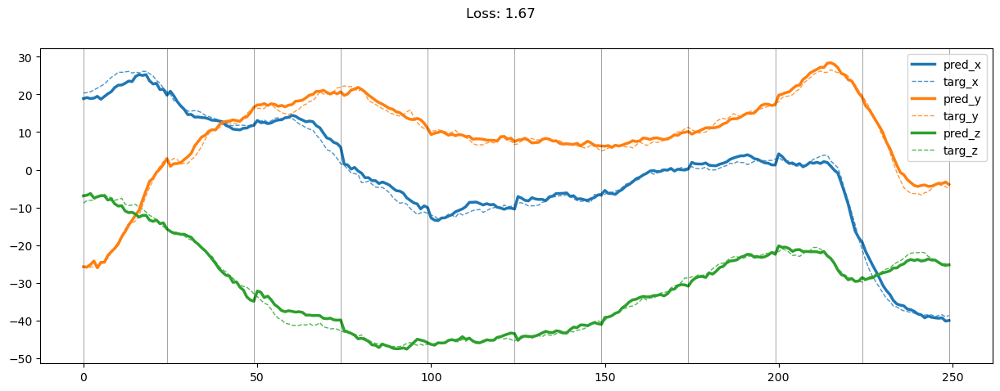

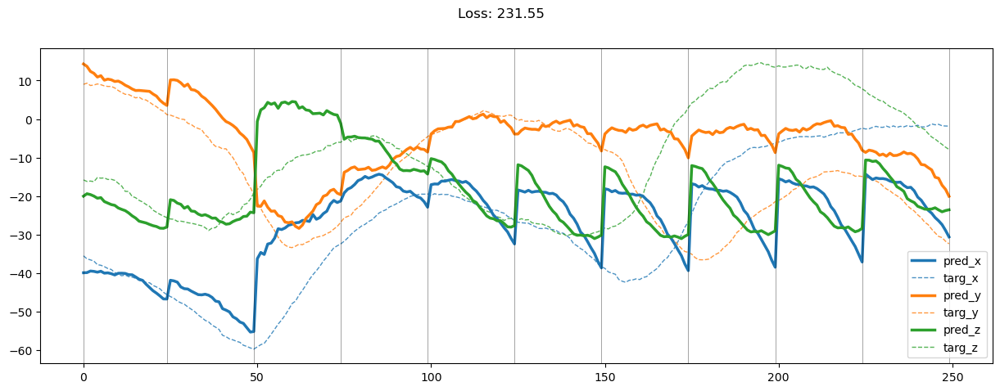

00599: train pred loss:  2.509, g loss:  7.868, diff loss:  4.958, d loss:  1.509
       valid pred loss:  169.525, g loss:  506.337, diff loss:  336.412, d loss:  1.510


100%|██████████| 17/17 [00:01<00:00, 15.20it/s]


00600: train pred loss:  2.499, g loss:  7.774, diff loss:  4.875, d loss:  1.510
       valid pred loss:  170.973, g loss:  503.906, diff loss:  332.534, d loss:  1.512


100%|██████████| 17/17 [00:01<00:00, 15.15it/s]


00601: train pred loss:  2.459, g loss:  7.615, diff loss:  4.757, d loss:  1.511
       valid pred loss:  169.955, g loss:  500.902, diff loss:  330.549, d loss:  1.513


100%|██████████| 17/17 [00:01<00:00, 15.23it/s]


00602: train pred loss:  2.459, g loss:  7.727, diff loss:  4.870, d loss:  1.512
       valid pred loss:  171.326, g loss:  513.279, diff loss:  341.556, d loss:  1.514


100%|██████████| 17/17 [00:01<00:00, 15.19it/s]


00603: train pred loss:  2.412, g loss:  7.493, diff loss:  4.684, d loss:  1.513
       valid pred loss:  168.251, g loss:  503.235, diff loss:  334.588, d loss:  1.514


100%|██████████| 17/17 [00:01<00:00, 15.19it/s]


00604: train pred loss:  2.302, g loss:  7.269, diff loss:  4.571, d loss:  1.514
       valid pred loss:  166.179, g loss:  501.889, diff loss:  335.314, d loss:  1.515


100%|██████████| 17/17 [00:01<00:00, 15.18it/s]


00605: train pred loss:  2.313, g loss:  7.275, diff loss:  4.566, d loss:  1.514
       valid pred loss:  171.279, g loss:  520.549, diff loss:  348.875, d loss:  1.515


100%|██████████| 17/17 [00:01<00:00, 15.16it/s]


00606: train pred loss:  2.322, g loss:  7.291, diff loss:  4.573, d loss:  1.514
       valid pred loss:  170.891, g loss:  518.327, diff loss:  347.041, d loss:  1.515


100%|██████████| 17/17 [00:01<00:00, 14.40it/s]


00607: train pred loss:  2.297, g loss:  7.219, diff loss:  4.526, d loss:  1.514
       valid pred loss:  172.528, g loss:  521.423, diff loss:  348.500, d loss:  1.515


100%|██████████| 17/17 [00:01<00:00, 15.25it/s]


00608: train pred loss:  2.336, g loss:  7.298, diff loss:  4.566, d loss:  1.514
       valid pred loss:  174.234, g loss:  528.667, diff loss:  354.038, d loss:  1.515


100%|██████████| 17/17 [00:01<00:00, 15.13it/s]


00609: train pred loss:  2.288, g loss:  7.196, diff loss:  4.512, d loss:  1.513
       valid pred loss:  172.406, g loss:  521.492, diff loss:  348.690, d loss:  1.514


100%|██████████| 17/17 [00:01<00:00, 15.14it/s]


00610: train pred loss:  2.337, g loss:  7.346, diff loss:  4.612, d loss:  1.513
       valid pred loss:  172.250, g loss:  526.292, diff loss:  353.645, d loss:  1.514


100%|██████████| 17/17 [00:01<00:00, 15.13it/s]


00611: train pred loss:  2.317, g loss:  7.280, diff loss:  4.565, d loss:  1.512
       valid pred loss:  169.790, g loss:  513.508, diff loss:  343.320, d loss:  1.512


100%|██████████| 17/17 [00:01<00:00, 15.10it/s]


00612: train pred loss:  2.373, g loss:  7.405, diff loss:  4.633, d loss:  1.511
       valid pred loss:  171.123, g loss:  514.388, diff loss:  342.866, d loss:  1.511


100%|██████████| 17/17 [00:01<00:00, 15.14it/s]


00613: train pred loss:  2.311, g loss:  7.223, diff loss:  4.512, d loss:  1.510
       valid pred loss:  169.400, g loss:  514.572, diff loss:  344.772, d loss:  1.510


100%|██████████| 17/17 [00:01<00:00, 15.13it/s]


00614: train pred loss:  2.324, g loss:  7.269, diff loss:  4.544, d loss:  1.508
       valid pred loss:  170.539, g loss:  518.734, diff loss:  347.793, d loss:  1.509


100%|██████████| 17/17 [00:01<00:00, 15.09it/s]


00615: train pred loss:  2.350, g loss:  7.364, diff loss:  4.611, d loss:  1.507
       valid pred loss:  165.652, g loss:  500.622, diff loss:  334.566, d loss:  1.507


100%|██████████| 17/17 [00:01<00:00, 15.15it/s]


00616: train pred loss:  2.326, g loss:  7.301, diff loss:  4.570, d loss:  1.505
       valid pred loss:  164.618, g loss:  496.332, diff loss:  331.309, d loss:  1.505


100%|██████████| 17/17 [00:01<00:00, 14.94it/s]


00617: train pred loss:  2.233, g loss:  7.050, diff loss:  4.411, d loss:  1.503
       valid pred loss:  166.334, g loss:  492.689, diff loss:  325.948, d loss:  1.504


100%|██████████| 17/17 [00:01<00:00, 14.50it/s]


00618: train pred loss:  2.220, g loss:  6.981, diff loss:  4.353, d loss:  1.502
       valid pred loss:  166.023, g loss:  499.554, diff loss:  333.123, d loss:  1.502


100%|██████████| 17/17 [00:01<00:00, 14.70it/s]


00619: train pred loss:  2.251, g loss:  7.003, diff loss:  4.342, d loss:  1.500
       valid pred loss:  171.000, g loss:  519.319, diff loss:  347.909, d loss:  1.500


100%|██████████| 17/17 [00:01<00:00, 14.60it/s]


00620: train pred loss:  2.200, g loss:  6.882, diff loss:  4.271, d loss:  1.498
       valid pred loss:  165.655, g loss:  497.101, diff loss:  331.034, d loss:  1.499


100%|██████████| 17/17 [00:01<00:00, 14.50it/s]


00621: train pred loss:  2.161, g loss:  6.846, diff loss:  4.272, d loss:  1.497
       valid pred loss:  169.381, g loss:  511.319, diff loss:  341.525, d loss:  1.497


100%|██████████| 17/17 [00:01<00:00, 14.90it/s]


00622: train pred loss:  2.170, g loss:  6.866, diff loss:  4.282, d loss:  1.495
       valid pred loss:  165.386, g loss:  499.350, diff loss:  333.549, d loss:  1.496


100%|██████████| 17/17 [00:01<00:00, 14.57it/s]


00623: train pred loss:  2.195, g loss:  6.901, diff loss:  4.290, d loss:  1.494
       valid pred loss:  168.251, g loss:  507.244, diff loss:  338.577, d loss:  1.495


100%|██████████| 17/17 [00:01<00:00, 15.18it/s]


00624: train pred loss:  2.181, g loss:  6.907, diff loss:  4.309, d loss:  1.493
       valid pred loss:  164.688, g loss:  492.307, diff loss:  327.201, d loss:  1.493


100%|██████████| 17/17 [00:01<00:00, 14.25it/s]


00625: train pred loss:  2.272, g loss:  7.168, diff loss:  4.478, d loss:  1.492
       valid pred loss:  171.771, g loss:  520.547, diff loss:  348.358, d loss:  1.493


100%|██████████| 17/17 [00:01<00:00, 15.14it/s]


00626: train pred loss:  2.237, g loss:  7.053, diff loss:  4.398, d loss:  1.491
       valid pred loss:  168.199, g loss:  505.920, diff loss:  337.302, d loss:  1.492


100%|██████████| 17/17 [00:01<00:00, 15.08it/s]


00627: train pred loss:  2.218, g loss:  6.964, diff loss:  4.327, d loss:  1.491
       valid pred loss:  167.058, g loss:  510.955, diff loss:  343.478, d loss:  1.492


100%|██████████| 17/17 [00:01<00:00, 15.15it/s]


00628: train pred loss:  2.210, g loss:  6.949, diff loss:  4.319, d loss:  1.491
       valid pred loss:  170.122, g loss:  521.028, diff loss:  350.487, d loss:  1.492


100%|██████████| 17/17 [00:01<00:00, 15.14it/s]


00629: train pred loss:  2.243, g loss:  7.028, diff loss:  4.366, d loss:  1.491
       valid pred loss:  166.928, g loss:  499.076, diff loss:  331.730, d loss:  1.492


100%|██████████| 17/17 [00:01<00:00, 14.83it/s]


00630: train pred loss:  2.265, g loss:  7.135, diff loss:  4.451, d loss:  1.491
       valid pred loss:  166.290, g loss:  504.041, diff loss:  337.333, d loss:  1.493


100%|██████████| 17/17 [00:01<00:00, 15.17it/s]


00631: train pred loss:  2.229, g loss:  7.029, diff loss:  4.382, d loss:  1.492
       valid pred loss:  165.674, g loss:  504.652, diff loss:  338.560, d loss:  1.494


100%|██████████| 17/17 [00:01<00:00, 15.15it/s]


00632: train pred loss:  2.297, g loss:  7.193, diff loss:  4.480, d loss:  1.493
       valid pred loss:  168.792, g loss:  511.762, diff loss:  342.554, d loss:  1.495


100%|██████████| 17/17 [00:01<00:00, 14.99it/s]


00633: train pred loss:  2.205, g loss:  7.006, diff loss:  4.385, d loss:  1.494
       valid pred loss:  164.031, g loss:  496.679, diff loss:  332.233, d loss:  1.496


100%|██████████| 17/17 [00:01<00:00, 15.18it/s]


00634: train pred loss:  2.172, g loss:  6.864, diff loss:  4.278, d loss:  1.496
       valid pred loss:  169.148, g loss:  507.222, diff loss:  337.662, d loss:  1.498


100%|██████████| 17/17 [00:01<00:00, 15.17it/s]


00635: train pred loss:  2.187, g loss:  6.948, diff loss:  4.349, d loss:  1.497
       valid pred loss:  167.527, g loss:  506.534, diff loss:  338.596, d loss:  1.499


100%|██████████| 17/17 [00:01<00:00, 15.10it/s]


00636: train pred loss:  2.175, g loss:  6.888, diff loss:  4.302, d loss:  1.499
       valid pred loss:  166.014, g loss:  506.036, diff loss:  339.613, d loss:  1.501


100%|██████████| 17/17 [00:01<00:00, 15.10it/s]


00637: train pred loss:  2.175, g loss:  6.751, diff loss:  4.167, d loss:  1.501
       valid pred loss:  166.315, g loss:  502.330, diff loss:  335.608, d loss:  1.503


100%|██████████| 17/17 [00:01<00:00, 15.16it/s]


00638: train pred loss:  2.098, g loss:  6.618, diff loss:  4.114, d loss:  1.503
       valid pred loss:  168.711, g loss:  515.230, diff loss:  346.113, d loss:  1.505


100%|██████████| 17/17 [00:01<00:00, 15.16it/s]


00639: train pred loss:  2.254, g loss:  7.112, diff loss:  4.454, d loss:  1.505
       valid pred loss:  171.329, g loss:  515.866, diff loss:  344.134, d loss:  1.508


100%|██████████| 17/17 [00:01<00:00, 15.02it/s]


00640: train pred loss:  2.297, g loss:  7.139, diff loss:  4.439, d loss:  1.507
       valid pred loss:  167.291, g loss:  505.185, diff loss:  337.493, d loss:  1.510


100%|██████████| 17/17 [00:01<00:00, 14.96it/s]


00641: train pred loss:  2.232, g loss:  6.978, diff loss:  4.345, d loss:  1.509
       valid pred loss:  168.732, g loss:  512.893, diff loss:  343.762, d loss:  1.512


100%|██████████| 17/17 [00:01<00:00, 15.22it/s]


00642: train pred loss:  2.189, g loss:  6.902, diff loss:  4.315, d loss:  1.511
       valid pred loss:  169.398, g loss:  520.674, diff loss:  350.879, d loss:  1.513


100%|██████████| 17/17 [00:01<00:00, 14.27it/s]


00643: train pred loss:  2.151, g loss:  6.801, diff loss:  4.253, d loss:  1.513
       valid pred loss:  167.672, g loss:  511.191, diff loss:  343.123, d loss:  1.515


100%|██████████| 17/17 [00:01<00:00, 14.33it/s]


00644: train pred loss:  2.139, g loss:  6.696, diff loss:  4.162, d loss:  1.514
       valid pred loss:  166.596, g loss:  511.283, diff loss:  344.293, d loss:  1.516


100%|██████████| 17/17 [00:01<00:00, 15.16it/s]


00645: train pred loss:  2.061, g loss:  6.500, diff loss:  4.044, d loss:  1.516
       valid pred loss:  171.210, g loss:  523.232, diff loss:  351.629, d loss:  1.517


100%|██████████| 17/17 [00:01<00:00, 14.85it/s]


00646: train pred loss:  2.195, g loss:  6.905, diff loss:  4.317, d loss:  1.516
       valid pred loss:  168.318, g loss:  510.887, diff loss:  342.176, d loss:  1.518


100%|██████████| 17/17 [00:01<00:00, 14.98it/s]


00647: train pred loss:  2.215, g loss:  6.972, diff loss:  4.364, d loss:  1.517
       valid pred loss:  169.421, g loss:  509.270, diff loss:  339.456, d loss:  1.518


100%|██████████| 17/17 [00:01<00:00, 15.18it/s]


00648: train pred loss:  2.183, g loss:  6.812, diff loss:  4.236, d loss:  1.517
       valid pred loss:  166.730, g loss:  500.112, diff loss:  332.988, d loss:  1.518


100%|██████████| 17/17 [00:01<00:00, 15.15it/s]


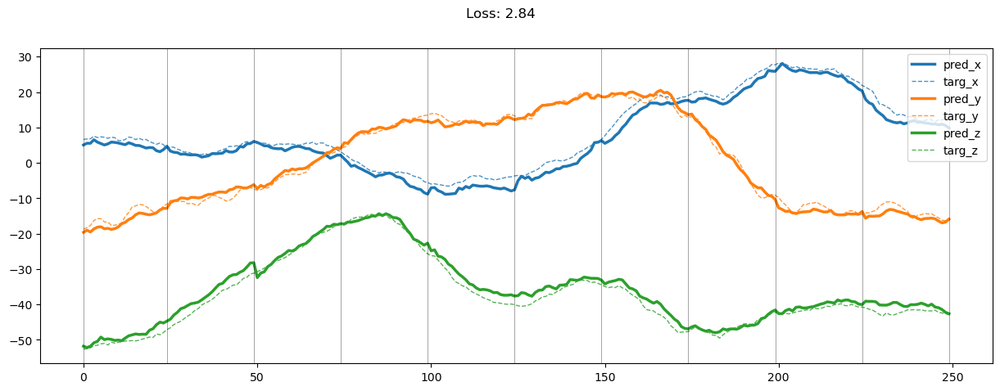

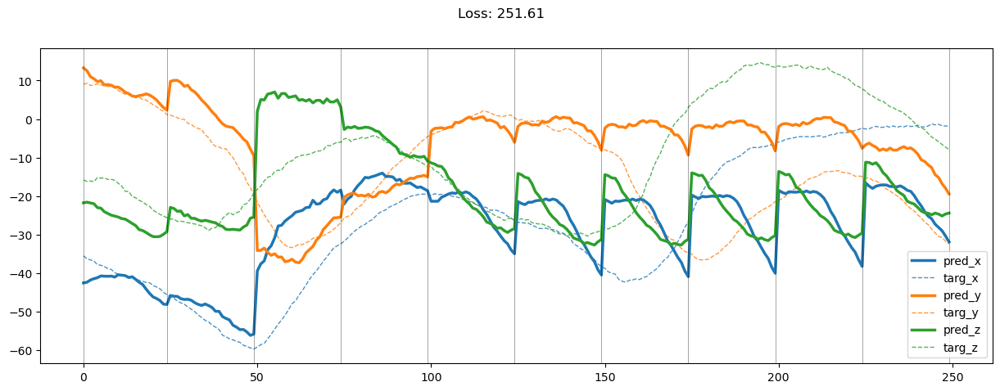

00649: train pred loss:  2.280, g loss:  6.931, diff loss:  4.257, d loss:  1.516
       valid pred loss:  170.913, g loss:  516.594, diff loss:  345.287, d loss:  1.517


100%|██████████| 17/17 [00:01<00:00, 15.16it/s]


00650: train pred loss:  2.213, g loss:  6.858, diff loss:  4.251, d loss:  1.516
       valid pred loss:  170.922, g loss:  513.369, diff loss:  342.053, d loss:  1.517


100%|██████████| 17/17 [00:01<00:00, 15.22it/s]


00651: train pred loss:  2.153, g loss:  6.753, diff loss:  4.206, d loss:  1.515
       valid pred loss:  169.815, g loss:  508.157, diff loss:  337.946, d loss:  1.515


100%|██████████| 17/17 [00:01<00:00, 15.22it/s]


00652: train pred loss:  2.151, g loss:  6.815, diff loss:  4.267, d loss:  1.513
       valid pred loss:  164.088, g loss:  501.285, diff loss:  336.800, d loss:  1.513


100%|██████████| 17/17 [00:01<00:00, 15.22it/s]


00653: train pred loss:  2.113, g loss:  6.642, diff loss:  4.131, d loss:  1.511
       valid pred loss:  166.514, g loss:  504.653, diff loss:  337.740, d loss:  1.512


100%|██████████| 17/17 [00:01<00:00, 15.08it/s]


00654: train pred loss:  2.171, g loss:  6.786, diff loss:  4.215, d loss:  1.509
       valid pred loss:  166.621, g loss:  498.411, diff loss:  331.389, d loss:  1.509


100%|██████████| 17/17 [00:01<00:00, 15.22it/s]


00655: train pred loss:  2.190, g loss:  6.912, diff loss:  4.319, d loss:  1.507
       valid pred loss:  164.281, g loss:  495.270, diff loss:  330.585, d loss:  1.507


100%|██████████| 17/17 [00:01<00:00, 15.13it/s]


00656: train pred loss:  2.211, g loss:  6.964, diff loss:  4.347, d loss:  1.505
       valid pred loss:  165.173, g loss:  501.618, diff loss:  336.039, d loss:  1.504


100%|██████████| 17/17 [00:01<00:00, 15.20it/s]


00657: train pred loss:  2.227, g loss:  7.003, diff loss:  4.369, d loss:  1.502
       valid pred loss:  166.587, g loss:  503.382, diff loss:  336.386, d loss:  1.502


100%|██████████| 17/17 [00:01<00:00, 15.19it/s]


00658: train pred loss:  2.224, g loss:  7.029, diff loss:  4.395, d loss:  1.500
       valid pred loss:  166.182, g loss:  500.764, diff loss:  334.171, d loss:  1.500


100%|██████████| 17/17 [00:01<00:00, 15.20it/s]


00659: train pred loss:  2.353, g loss:  7.420, diff loss:  4.654, d loss:  1.497
       valid pred loss:  163.639, g loss:  501.145, diff loss:  337.093, d loss:  1.497


100%|██████████| 17/17 [00:01<00:00, 15.20it/s]


00660: train pred loss:  2.334, g loss:  7.311, diff loss:  4.562, d loss:  1.495
       valid pred loss:  164.111, g loss:  500.983, diff loss:  336.458, d loss:  1.495


100%|██████████| 17/17 [00:01<00:00, 14.45it/s]


00661: train pred loss:  2.355, g loss:  7.379, diff loss:  4.607, d loss:  1.493
       valid pred loss:  167.126, g loss:  514.349, diff loss:  346.806, d loss:  1.493


100%|██████████| 17/17 [00:01<00:00, 14.61it/s]


00662: train pred loss:  2.285, g loss:  7.147, diff loss:  4.443, d loss:  1.491
       valid pred loss:  169.970, g loss:  517.113, diff loss:  346.724, d loss:  1.492


100%|██████████| 17/17 [00:01<00:00, 15.22it/s]


00663: train pred loss:  2.276, g loss:  7.127, diff loss:  4.430, d loss:  1.490
       valid pred loss:  165.674, g loss:  505.370, diff loss:  339.276, d loss:  1.491


100%|██████████| 17/17 [00:01<00:00, 15.19it/s]


00664: train pred loss:  2.165, g loss:  6.798, diff loss:  4.212, d loss:  1.489
       valid pred loss:  164.754, g loss:  495.913, diff loss:  330.738, d loss:  1.490


100%|██████████| 17/17 [00:01<00:00, 15.18it/s]


00665: train pred loss:  2.115, g loss:  6.708, diff loss:  4.171, d loss:  1.488
       valid pred loss:  162.820, g loss:  499.870, diff loss:  336.628, d loss:  1.490


100%|██████████| 17/17 [00:01<00:00, 15.16it/s]


00666: train pred loss:  2.112, g loss:  6.639, diff loss:  4.105, d loss:  1.489
       valid pred loss:  167.808, g loss:  510.772, diff loss:  342.543, d loss:  1.490


100%|██████████| 17/17 [00:01<00:00, 15.25it/s]


00667: train pred loss:  2.064, g loss:  6.524, diff loss:  4.038, d loss:  1.489
       valid pred loss:  162.883, g loss:  492.610, diff loss:  329.306, d loss:  1.490


100%|██████████| 17/17 [00:01<00:00, 15.23it/s]


00668: train pred loss:  2.088, g loss:  6.664, diff loss:  4.155, d loss:  1.490
       valid pred loss:  165.168, g loss:  505.853, diff loss:  340.266, d loss:  1.492


100%|██████████| 17/17 [00:01<00:00, 14.03it/s]


00669: train pred loss:  2.069, g loss:  6.551, diff loss:  4.062, d loss:  1.491
       valid pred loss:  168.392, g loss:  512.599, diff loss:  343.789, d loss:  1.493


100%|██████████| 17/17 [00:01<00:00, 13.65it/s]


00670: train pred loss:  2.190, g loss:  6.836, diff loss:  4.229, d loss:  1.493
       valid pred loss:  171.267, g loss:  523.788, diff loss:  352.106, d loss:  1.495


100%|██████████| 17/17 [00:01<00:00, 13.89it/s]


00671: train pred loss:  2.220, g loss:  7.020, diff loss:  4.385, d loss:  1.495
       valid pred loss:  168.421, g loss:  508.901, diff loss:  340.066, d loss:  1.497


100%|██████████| 17/17 [00:01<00:00, 13.81it/s]


00672: train pred loss:  2.255, g loss:  7.090, diff loss:  4.423, d loss:  1.497
       valid pred loss:  165.766, g loss:  502.643, diff loss:  336.466, d loss:  1.500


100%|██████████| 17/17 [00:01<00:00, 15.25it/s]


00673: train pred loss:  2.171, g loss:  6.787, diff loss:  4.206, d loss:  1.500
       valid pred loss:  170.775, g loss:  519.255, diff loss:  348.072, d loss:  1.503


100%|██████████| 17/17 [00:01<00:00, 13.69it/s]


00674: train pred loss:  2.169, g loss:  6.695, diff loss:  4.120, d loss:  1.503
       valid pred loss:  167.663, g loss:  510.563, diff loss:  342.495, d loss:  1.506


100%|██████████| 17/17 [00:01<00:00, 15.26it/s]


00675: train pred loss:  2.146, g loss:  6.814, diff loss:  4.264, d loss:  1.506
       valid pred loss:  164.517, g loss:  502.084, diff loss:  337.165, d loss:  1.509


100%|██████████| 17/17 [00:01<00:00, 14.52it/s]


00676: train pred loss:  2.129, g loss:  6.717, diff loss:  4.188, d loss:  1.509
       valid pred loss:  164.944, g loss:  497.053, diff loss:  331.711, d loss:  1.512


100%|██████████| 17/17 [00:01<00:00, 15.23it/s]


00677: train pred loss:  2.166, g loss:  6.804, diff loss:  4.240, d loss:  1.512
       valid pred loss:  173.433, g loss:  525.936, diff loss:  352.107, d loss:  1.515


100%|██████████| 17/17 [00:01<00:00, 15.23it/s]


00678: train pred loss:  2.184, g loss:  6.880, diff loss:  4.300, d loss:  1.515
       valid pred loss:  166.194, g loss:  498.705, diff loss:  332.118, d loss:  1.517


100%|██████████| 17/17 [00:01<00:00, 15.24it/s]


00679: train pred loss:  2.190, g loss:  6.815, diff loss:  4.232, d loss:  1.517
       valid pred loss:  166.093, g loss:  505.973, diff loss:  339.488, d loss:  1.520


100%|██████████| 17/17 [00:01<00:00, 14.95it/s]


00680: train pred loss:  2.249, g loss:  6.998, diff loss:  4.357, d loss:  1.519
       valid pred loss:  169.771, g loss:  510.119, diff loss:  339.958, d loss:  1.521


100%|██████████| 17/17 [00:01<00:00, 15.12it/s]


00681: train pred loss:  2.258, g loss:  7.063, diff loss:  4.414, d loss:  1.520
       valid pred loss:  164.694, g loss:  500.103, diff loss:  335.020, d loss:  1.522


100%|██████████| 17/17 [00:01<00:00, 15.19it/s]


00682: train pred loss:  2.306, g loss:  7.237, diff loss:  4.541, d loss:  1.521
       valid pred loss:  165.892, g loss:  504.851, diff loss:  338.570, d loss:  1.523


100%|██████████| 17/17 [00:01<00:00, 15.16it/s]


00683: train pred loss:  2.283, g loss:  7.104, diff loss:  4.432, d loss:  1.521
       valid pred loss:  160.947, g loss:  487.173, diff loss:  325.836, d loss:  1.522


100%|██████████| 17/17 [00:01<00:00, 13.86it/s]


00684: train pred loss:  2.226, g loss:  6.931, diff loss:  4.314, d loss:  1.520
       valid pred loss:  164.544, g loss:  493.535, diff loss:  328.600, d loss:  1.521


100%|██████████| 17/17 [00:01<00:00, 15.13it/s]


00685: train pred loss:  2.199, g loss:  6.869, diff loss:  4.279, d loss:  1.519
       valid pred loss:  159.861, g loss:  485.139, diff loss:  324.887, d loss:  1.520


100%|██████████| 17/17 [00:01<00:00, 15.14it/s]


00686: train pred loss:  2.181, g loss:  6.815, diff loss:  4.241, d loss:  1.517
       valid pred loss:  163.591, g loss:  493.421, diff loss:  329.437, d loss:  1.517


100%|██████████| 17/17 [00:01<00:00, 15.07it/s]


00687: train pred loss:  2.110, g loss:  6.687, diff loss:  4.181, d loss:  1.514
       valid pred loss:  167.954, g loss:  504.305, diff loss:  335.955, d loss:  1.514


100%|██████████| 17/17 [00:01<00:00, 15.19it/s]


00688: train pred loss:  2.153, g loss:  6.646, diff loss:  4.095, d loss:  1.511
       valid pred loss:  163.551, g loss:  495.219, diff loss:  331.269, d loss:  1.511


100%|██████████| 17/17 [00:01<00:00, 15.21it/s]


00689: train pred loss:  2.101, g loss:  6.665, diff loss:  4.163, d loss:  1.508
       valid pred loss:  165.214, g loss:  495.045, diff loss:  329.428, d loss:  1.507


100%|██████████| 17/17 [00:01<00:00, 15.26it/s]


00690: train pred loss:  2.120, g loss:  6.652, diff loss:  4.126, d loss:  1.504
       valid pred loss:  160.757, g loss:  486.850, diff loss:  325.686, d loss:  1.504


100%|██████████| 17/17 [00:01<00:00, 14.11it/s]


00691: train pred loss:  2.139, g loss:  6.678, diff loss:  4.130, d loss:  1.501
       valid pred loss:  169.172, g loss:  514.115, diff loss:  344.533, d loss:  1.500


100%|██████████| 17/17 [00:01<00:00, 15.00it/s]


00692: train pred loss:  2.074, g loss:  6.534, diff loss:  4.047, d loss:  1.497
       valid pred loss:  164.327, g loss:  499.277, diff loss:  334.536, d loss:  1.496


100%|██████████| 17/17 [00:01<00:00, 15.25it/s]


00693: train pred loss:  2.051, g loss:  6.466, diff loss:  3.998, d loss:  1.494
       valid pred loss:  161.031, g loss:  486.751, diff loss:  325.303, d loss:  1.493


100%|██████████| 17/17 [00:01<00:00, 15.25it/s]


00694: train pred loss:  2.101, g loss:  6.630, diff loss:  4.109, d loss:  1.491
       valid pred loss:  159.364, g loss:  483.709, diff loss:  323.925, d loss:  1.491


100%|██████████| 17/17 [00:01<00:00, 15.01it/s]


00695: train pred loss:  2.151, g loss:  6.693, diff loss:  4.120, d loss:  1.488
       valid pred loss:  163.806, g loss:  497.893, diff loss:  333.664, d loss:  1.488


100%|██████████| 17/17 [00:01<00:00, 14.60it/s]


00696: train pred loss:  2.044, g loss:  6.444, diff loss:  3.975, d loss:  1.486
       valid pred loss:  160.767, g loss:  479.177, diff loss:  317.986, d loss:  1.487


100%|██████████| 17/17 [00:01<00:00, 15.20it/s]


00697: train pred loss:  2.020, g loss:  6.343, diff loss:  3.897, d loss:  1.485
       valid pred loss:  164.019, g loss:  485.030, diff loss:  320.585, d loss:  1.486


100%|██████████| 17/17 [00:01<00:00, 14.62it/s]


00698: train pred loss:  2.076, g loss:  6.448, diff loss:  3.946, d loss:  1.484
       valid pred loss:  164.235, g loss:  497.338, diff loss:  332.677, d loss:  1.486


100%|██████████| 17/17 [00:01<00:00, 14.63it/s]


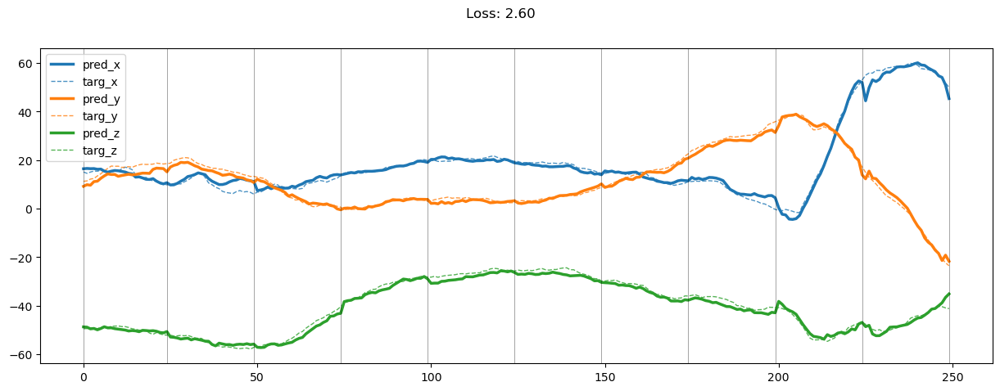

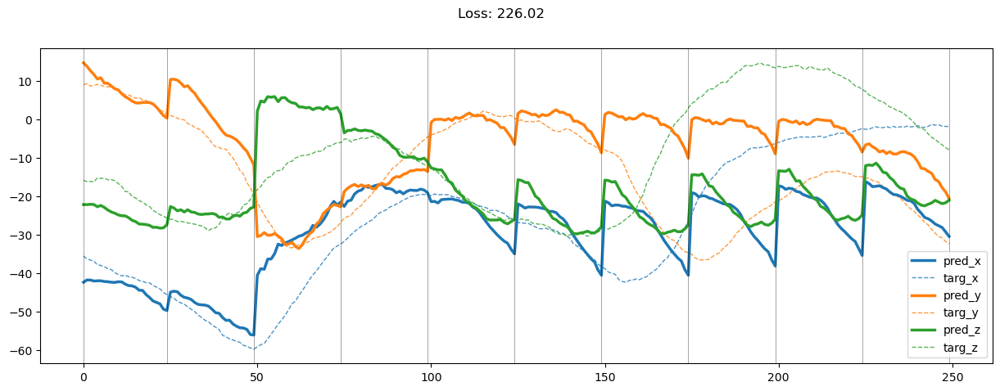

00699: train pred loss:  2.045, g loss:  6.432, diff loss:  3.961, d loss:  1.484
       valid pred loss:  161.749, g loss:  489.209, diff loss:  327.035, d loss:  1.486


100%|██████████| 17/17 [00:01<00:00, 15.22it/s]


00700: train pred loss:  2.018, g loss:  6.432, diff loss:  3.989, d loss:  1.485
       valid pred loss:  166.576, g loss:  503.261, diff loss:  336.261, d loss:  1.488


100%|██████████| 17/17 [00:01<00:00, 15.23it/s]


00701: train pred loss:  2.113, g loss:  6.645, diff loss:  4.109, d loss:  1.487
       valid pred loss:  169.912, g loss:  516.401, diff loss:  346.068, d loss:  1.490


100%|██████████| 17/17 [00:01<00:00, 15.26it/s]


00702: train pred loss:  2.080, g loss:  6.592, diff loss:  4.092, d loss:  1.490
       valid pred loss:  169.079, g loss:  506.159, diff loss:  336.662, d loss:  1.493


100%|██████████| 17/17 [00:01<00:00, 15.25it/s]


00703: train pred loss:  2.150, g loss:  6.644, diff loss:  4.078, d loss:  1.493
       valid pred loss:  165.295, g loss:  504.751, diff loss:  339.041, d loss:  1.496


100%|██████████| 17/17 [00:01<00:00, 14.89it/s]


00704: train pred loss:  2.183, g loss:  6.749, diff loss:  4.153, d loss:  1.497
       valid pred loss:  165.249, g loss:  504.052, diff loss:  338.393, d loss:  1.500


100%|██████████| 17/17 [00:01<00:00, 14.83it/s]


00705: train pred loss:  2.199, g loss:  6.807, diff loss:  4.199, d loss:  1.501
       valid pred loss:  163.008, g loss:  493.262, diff loss:  329.849, d loss:  1.505


100%|██████████| 17/17 [00:01<00:00, 15.24it/s]


00706: train pred loss:  2.135, g loss:  6.667, diff loss:  4.128, d loss:  1.505
       valid pred loss:  162.598, g loss:  494.433, diff loss:  331.434, d loss:  1.509


100%|██████████| 17/17 [00:01<00:00, 15.26it/s]


00707: train pred loss:  2.001, g loss:  6.324, diff loss:  3.924, d loss:  1.510
       valid pred loss:  166.026, g loss:  500.774, diff loss:  334.352, d loss:  1.514


100%|██████████| 17/17 [00:01<00:00, 15.27it/s]


00708: train pred loss:  2.032, g loss:  6.369, diff loss:  3.941, d loss:  1.515
       valid pred loss:  165.748, g loss:  503.318, diff loss:  337.177, d loss:  1.518


100%|██████████| 17/17 [00:01<00:00, 15.24it/s]


00709: train pred loss:  2.071, g loss:  6.593, diff loss:  4.131, d loss:  1.519
       valid pred loss:  163.677, g loss:  501.446, diff loss:  337.379, d loss:  1.522


100%|██████████| 17/17 [00:01<00:00, 15.24it/s]


00710: train pred loss:  2.106, g loss:  6.609, diff loss:  4.115, d loss:  1.522
       valid pred loss:  162.194, g loss:  495.805, diff loss:  333.225, d loss:  1.525


100%|██████████| 17/17 [00:01<00:00, 15.17it/s]


00711: train pred loss:  2.173, g loss:  6.788, diff loss:  4.229, d loss:  1.525
       valid pred loss:  165.607, g loss:  503.420, diff loss:  337.429, d loss:  1.528


100%|██████████| 17/17 [00:01<00:00, 15.14it/s]


00712: train pred loss:  2.088, g loss:  6.491, diff loss:  4.019, d loss:  1.527
       valid pred loss:  167.599, g loss:  508.200, diff loss:  340.218, d loss:  1.529


100%|██████████| 17/17 [00:01<00:00, 14.74it/s]


00713: train pred loss:  2.065, g loss:  6.454, diff loss:  4.006, d loss:  1.528
       valid pred loss:  166.483, g loss:  509.104, diff loss:  342.239, d loss:  1.529


100%|██████████| 17/17 [00:01<00:00, 14.84it/s]


00714: train pred loss:  2.064, g loss:  6.482, diff loss:  4.034, d loss:  1.527
       valid pred loss:  167.085, g loss:  505.280, diff loss:  337.811, d loss:  1.528


100%|██████████| 17/17 [00:01<00:00, 15.18it/s]


00715: train pred loss:  2.025, g loss:  6.333, diff loss:  3.922, d loss:  1.526
       valid pred loss:  169.286, g loss:  508.589, diff loss:  338.917, d loss:  1.525


100%|██████████| 17/17 [00:01<00:00, 15.21it/s]


00716: train pred loss:  2.046, g loss:  6.455, diff loss:  4.021, d loss:  1.523
       valid pred loss:  165.229, g loss:  506.926, diff loss:  341.308, d loss:  1.522


100%|██████████| 17/17 [00:01<00:00, 15.21it/s]


00717: train pred loss:  1.967, g loss:  6.206, diff loss:  3.848, d loss:  1.519
       valid pred loss:  166.274, g loss:  503.481, diff loss:  336.814, d loss:  1.518


100%|██████████| 17/17 [00:01<00:00, 15.19it/s]


00718: train pred loss:  2.014, g loss:  6.368, diff loss:  3.959, d loss:  1.514
       valid pred loss:  166.315, g loss:  496.222, diff loss:  329.509, d loss:  1.513


100%|██████████| 17/17 [00:01<00:00, 15.18it/s]


00719: train pred loss:  2.119, g loss:  6.699, diff loss:  4.180, d loss:  1.509
       valid pred loss:  163.416, g loss:  493.953, diff loss:  330.134, d loss:  1.507


100%|██████████| 17/17 [00:01<00:00, 15.19it/s]


00720: train pred loss:  2.222, g loss:  6.898, diff loss:  4.270, d loss:  1.504
       valid pred loss:  165.873, g loss:  502.185, diff loss:  335.904, d loss:  1.502


100%|██████████| 17/17 [00:01<00:00, 15.20it/s]


00721: train pred loss:  2.086, g loss:  6.560, diff loss:  4.063, d loss:  1.498
       valid pred loss:  162.871, g loss:  497.313, diff loss:  334.028, d loss:  1.497


100%|██████████| 17/17 [00:01<00:00, 15.14it/s]


00722: train pred loss:  2.183, g loss:  6.815, diff loss:  4.216, d loss:  1.493
       valid pred loss:  169.106, g loss:  510.089, diff loss:  340.563, d loss:  1.491


100%|██████████| 17/17 [00:01<00:00, 14.34it/s]


00723: train pred loss:  2.225, g loss:  6.952, diff loss:  4.306, d loss:  1.488
       valid pred loss:  164.493, g loss:  494.216, diff loss:  329.299, d loss:  1.487


100%|██████████| 17/17 [00:01<00:00, 14.70it/s]


00724: train pred loss:  2.247, g loss:  7.061, diff loss:  4.388, d loss:  1.484
       valid pred loss:  169.036, g loss:  516.935, diff loss:  347.471, d loss:  1.484


100%|██████████| 17/17 [00:01<00:00, 14.94it/s]


00725: train pred loss:  2.202, g loss:  6.943, diff loss:  4.311, d loss:  1.481
       valid pred loss:  161.571, g loss:  489.537, diff loss:  327.535, d loss:  1.481


100%|██████████| 17/17 [00:01<00:00, 15.09it/s]


00726: train pred loss:  2.183, g loss:  6.926, diff loss:  4.311, d loss:  1.479
       valid pred loss:  163.078, g loss:  493.019, diff loss:  329.508, d loss:  1.480


100%|██████████| 17/17 [00:01<00:00, 15.09it/s]


00727: train pred loss:  2.219, g loss:  6.937, diff loss:  4.284, d loss:  1.478
       valid pred loss:  160.312, g loss:  485.778, diff loss:  325.033, d loss:  1.480


100%|██████████| 17/17 [00:01<00:00, 14.59it/s]


00728: train pred loss:  2.206, g loss:  6.928, diff loss:  4.289, d loss:  1.478
       valid pred loss:  163.037, g loss:  494.597, diff loss:  331.128, d loss:  1.480


100%|██████████| 17/17 [00:01<00:00, 14.33it/s]


00729: train pred loss:  2.299, g loss:  7.067, diff loss:  4.336, d loss:  1.479
       valid pred loss:  168.841, g loss:  513.390, diff loss:  344.119, d loss:  1.482


100%|██████████| 17/17 [00:01<00:00, 14.05it/s]


00730: train pred loss:  2.141, g loss:  6.686, diff loss:  4.116, d loss:  1.482
       valid pred loss:  167.867, g loss:  508.190, diff loss:  339.897, d loss:  1.486


100%|██████████| 17/17 [00:01<00:00, 15.15it/s]


00731: train pred loss:  2.048, g loss:  6.527, diff loss:  4.056, d loss:  1.487
       valid pred loss:  164.085, g loss:  499.351, diff loss:  334.845, d loss:  1.491


100%|██████████| 17/17 [00:01<00:00, 14.88it/s]


00732: train pred loss:  2.110, g loss:  6.569, diff loss:  4.040, d loss:  1.491
       valid pred loss:  161.726, g loss:  490.322, diff loss:  328.181, d loss:  1.496


100%|██████████| 17/17 [00:01<00:00, 14.63it/s]


00733: train pred loss:  2.083, g loss:  6.594, diff loss:  4.098, d loss:  1.497
       valid pred loss:  172.195, g loss:  516.510, diff loss:  343.906, d loss:  1.502


100%|██████████| 17/17 [00:01<00:00, 14.26it/s]


00734: train pred loss:  2.064, g loss:  6.481, diff loss:  4.011, d loss:  1.504
       valid pred loss:  162.324, g loss:  494.356, diff loss:  331.630, d loss:  1.509


100%|██████████| 17/17 [00:01<00:00, 15.21it/s]


00735: train pred loss:  2.038, g loss:  6.452, diff loss:  4.015, d loss:  1.511
       valid pred loss:  160.654, g loss:  486.850, diff loss:  325.801, d loss:  1.516


100%|██████████| 17/17 [00:01<00:00, 14.91it/s]


00736: train pred loss:  2.091, g loss:  6.672, diff loss:  4.189, d loss:  1.517
       valid pred loss:  167.002, g loss:  501.403, diff loss:  334.012, d loss:  1.523


100%|██████████| 17/17 [00:01<00:00, 13.88it/s]


00737: train pred loss:  2.063, g loss:  6.518, diff loss:  4.069, d loss:  1.524
       valid pred loss:  167.773, g loss:  507.817, diff loss:  339.660, d loss:  1.528


100%|██████████| 17/17 [00:01<00:00, 15.21it/s]


00738: train pred loss:  2.110, g loss:  6.632, diff loss:  4.140, d loss:  1.529
       valid pred loss:  165.339, g loss:  502.640, diff loss:  336.922, d loss:  1.533


100%|██████████| 17/17 [00:01<00:00, 15.21it/s]


00739: train pred loss:  2.191, g loss:  6.775, diff loss:  4.206, d loss:  1.534
       valid pred loss:  161.922, g loss:  491.938, diff loss:  329.640, d loss:  1.537


100%|██████████| 17/17 [00:01<00:00, 15.23it/s]


00740: train pred loss:  2.057, g loss:  6.432, diff loss:  3.999, d loss:  1.536
       valid pred loss:  164.377, g loss:  505.455, diff loss:  340.703, d loss:  1.539


100%|██████████| 17/17 [00:01<00:00, 15.19it/s]


00741: train pred loss:  2.147, g loss:  6.640, diff loss:  4.118, d loss:  1.537
       valid pred loss:  162.183, g loss:  493.428, diff loss:  330.869, d loss:  1.538


100%|██████████| 17/17 [00:01<00:00, 14.90it/s]


00742: train pred loss:  2.092, g loss:  6.459, diff loss:  3.991, d loss:  1.536
       valid pred loss:  165.033, g loss:  495.676, diff loss:  330.267, d loss:  1.537


100%|██████████| 17/17 [00:01<00:00, 15.22it/s]


00743: train pred loss:  2.070, g loss:  6.474, diff loss:  4.026, d loss:  1.533
       valid pred loss:  163.481, g loss:  498.053, diff loss:  334.192, d loss:  1.533


100%|██████████| 17/17 [00:01<00:00, 13.71it/s]


00744: train pred loss:  2.082, g loss:  6.551, diff loss:  4.087, d loss:  1.529
       valid pred loss:  160.945, g loss:  490.999, diff loss:  329.670, d loss:  1.527


100%|██████████| 17/17 [00:01<00:00, 14.80it/s]


00745: train pred loss:  2.008, g loss:  6.320, diff loss:  3.924, d loss:  1.523
       valid pred loss:  162.320, g loss:  494.251, diff loss:  331.540, d loss:  1.521


100%|██████████| 17/17 [00:01<00:00, 14.44it/s]


00746: train pred loss:  1.966, g loss:  6.181, diff loss:  3.820, d loss:  1.516
       valid pred loss:  163.609, g loss:  494.712, diff loss:  330.706, d loss:  1.513


100%|██████████| 17/17 [00:01<00:00, 13.94it/s]


00747: train pred loss:  1.945, g loss:  6.202, diff loss:  3.855, d loss:  1.508
       valid pred loss:  164.671, g loss:  497.685, diff loss:  332.608, d loss:  1.505


100%|██████████| 17/17 [00:01<00:00, 15.20it/s]


00748: train pred loss:  1.961, g loss:  6.188, diff loss:  3.817, d loss:  1.500
       valid pred loss:  160.674, g loss:  487.412, diff loss:  326.325, d loss:  1.497


100%|██████████| 17/17 [00:01<00:00, 15.22it/s]


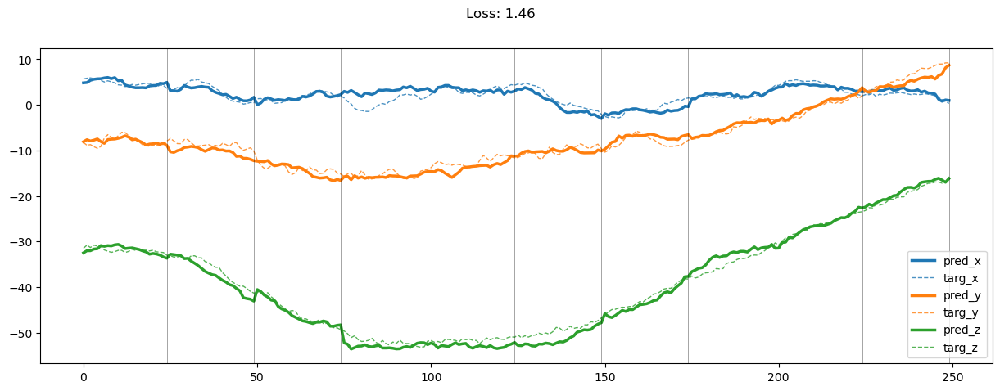

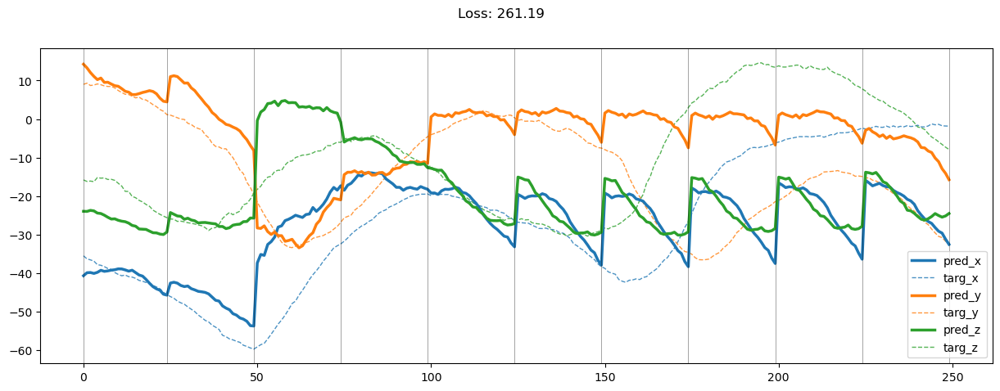

00749: train pred loss:  1.921, g loss:  6.130, diff loss:  3.791, d loss:  1.492
       valid pred loss:  159.213, g loss:  480.920, diff loss:  321.285, d loss:  1.490


100%|██████████| 17/17 [00:01<00:00, 13.78it/s]


00750: train pred loss:  1.986, g loss:  6.328, diff loss:  3.916, d loss:  1.485
       valid pred loss:  160.612, g loss:  484.925, diff loss:  323.885, d loss:  1.484


100%|██████████| 17/17 [00:01<00:00, 14.00it/s]


00751: train pred loss:  1.927, g loss:  6.098, diff loss:  3.739, d loss:  1.479
       valid pred loss:  161.099, g loss:  483.595, diff loss:  322.061, d loss:  1.478


100%|██████████| 17/17 [00:01<00:00, 15.21it/s]


00752: train pred loss:  1.970, g loss:  6.258, diff loss:  3.851, d loss:  1.475
       valid pred loss:  161.986, g loss:  488.425, diff loss:  326.000, d loss:  1.475


100%|██████████| 17/17 [00:01<00:00, 14.62it/s]


00753: train pred loss:  2.021, g loss:  6.372, diff loss:  3.910, d loss:  1.472
       valid pred loss:  160.278, g loss:  481.870, diff loss:  321.150, d loss:  1.472


100%|██████████| 17/17 [00:01<00:00, 15.21it/s]


00754: train pred loss:  1.940, g loss:  6.164, diff loss:  3.780, d loss:  1.470
       valid pred loss:  162.996, g loss:  485.524, diff loss:  322.085, d loss:  1.471


100%|██████████| 17/17 [00:01<00:00, 15.21it/s]


00755: train pred loss:  1.961, g loss:  6.204, diff loss:  3.800, d loss:  1.470
       valid pred loss:  159.241, g loss:  479.332, diff loss:  319.649, d loss:  1.473


100%|██████████| 17/17 [00:01<00:00, 14.72it/s]


00756: train pred loss:  1.954, g loss:  6.185, diff loss:  3.790, d loss:  1.472
       valid pred loss:  162.029, g loss:  487.884, diff loss:  325.417, d loss:  1.475


100%|██████████| 17/17 [00:01<00:00, 15.24it/s]


00757: train pred loss:  1.957, g loss:  6.187, diff loss:  3.794, d loss:  1.476
       valid pred loss:  159.329, g loss:  475.399, diff loss:  315.637, d loss:  1.480


100%|██████████| 17/17 [00:01<00:00, 15.26it/s]


00758: train pred loss:  1.945, g loss:  6.238, diff loss:  3.864, d loss:  1.481
       valid pred loss:  163.948, g loss:  495.610, diff loss:  331.237, d loss:  1.487


100%|██████████| 17/17 [00:01<00:00, 15.24it/s]


00759: train pred loss:  2.101, g loss:  6.674, diff loss:  4.152, d loss:  1.488
       valid pred loss:  169.287, g loss:  499.440, diff loss:  329.736, d loss:  1.495


100%|██████████| 17/17 [00:01<00:00, 15.25it/s]


00760: train pred loss:  2.178, g loss:  6.779, diff loss:  4.188, d loss:  1.497
       valid pred loss:  158.925, g loss:  483.256, diff loss:  323.922, d loss:  1.503


100%|██████████| 17/17 [00:01<00:00, 14.90it/s]


00761: train pred loss:  2.048, g loss:  6.425, diff loss:  3.973, d loss:  1.505
       valid pred loss:  164.203, g loss:  497.236, diff loss:  332.634, d loss:  1.513


100%|██████████| 17/17 [00:01<00:00, 15.21it/s]


00762: train pred loss:  2.018, g loss:  6.358, diff loss:  3.945, d loss:  1.515
       valid pred loss:  164.841, g loss:  496.966, diff loss:  331.735, d loss:  1.522


100%|██████████| 17/17 [00:01<00:00, 15.15it/s]


00763: train pred loss:  1.912, g loss:  6.088, diff loss:  3.789, d loss:  1.524
       valid pred loss:  164.795, g loss:  497.023, diff loss:  331.846, d loss:  1.532


100%|██████████| 17/17 [00:01<00:00, 15.21it/s]


00764: train pred loss:  1.938, g loss:  6.088, diff loss:  3.772, d loss:  1.533
       valid pred loss:  164.239, g loss:  499.686, diff loss:  335.073, d loss:  1.539


100%|██████████| 17/17 [00:01<00:00, 15.21it/s]


00765: train pred loss:  1.946, g loss:  6.133, diff loss:  3.815, d loss:  1.541
       valid pred loss:  159.737, g loss:  480.211, diff loss:  320.105, d loss:  1.546


100%|██████████| 17/17 [00:01<00:00, 15.23it/s]


00766: train pred loss:  1.946, g loss:  6.082, diff loss:  3.768, d loss:  1.546
       valid pred loss:  160.848, g loss:  486.380, diff loss:  325.167, d loss:  1.551


100%|██████████| 17/17 [00:01<00:00, 15.22it/s]


00767: train pred loss:  1.995, g loss:  6.274, diff loss:  3.914, d loss:  1.550
       valid pred loss:  164.401, g loss:  492.604, diff loss:  327.839, d loss:  1.552


100%|██████████| 17/17 [00:01<00:00, 15.21it/s]


00768: train pred loss:  2.018, g loss:  6.336, diff loss:  3.954, d loss:  1.550
       valid pred loss:  160.999, g loss:  488.037, diff loss:  326.673, d loss:  1.551


100%|██████████| 17/17 [00:01<00:00, 15.20it/s]


00769: train pred loss:  2.115, g loss:  6.550, diff loss:  4.068, d loss:  1.548
       valid pred loss:  163.561, g loss:  492.859, diff loss:  328.930, d loss:  1.548


100%|██████████| 17/17 [00:01<00:00, 15.26it/s]


00770: train pred loss:  2.125, g loss:  6.555, diff loss:  4.059, d loss:  1.543
       valid pred loss:  169.373, g loss:  508.608, diff loss:  338.862, d loss:  1.542


100%|██████████| 17/17 [00:01<00:00, 14.66it/s]


00771: train pred loss:  2.117, g loss:  6.538, diff loss:  4.044, d loss:  1.535
       valid pred loss:  162.690, g loss:  492.741, diff loss:  329.671, d loss:  1.533


100%|██████████| 17/17 [00:01<00:00, 15.14it/s]


00772: train pred loss:  2.028, g loss:  6.380, diff loss:  3.968, d loss:  1.526
       valid pred loss:  156.843, g loss:  476.188, diff loss:  318.956, d loss:  1.523


100%|██████████| 17/17 [00:01<00:00, 14.78it/s]


00773: train pred loss:  1.989, g loss:  6.248, diff loss:  3.865, d loss:  1.516
       valid pred loss:  159.717, g loss:  471.577, diff loss:  311.461, d loss:  1.513


100%|██████████| 17/17 [00:01<00:00, 15.19it/s]


00774: train pred loss:  2.103, g loss:  6.613, diff loss:  4.105, d loss:  1.505
       valid pred loss:  161.502, g loss:  488.584, diff loss:  326.672, d loss:  1.502


100%|██████████| 17/17 [00:01<00:00, 15.19it/s]


00775: train pred loss:  2.183, g loss:  6.783, diff loss:  4.185, d loss:  1.495
       valid pred loss:  161.534, g loss:  490.572, diff loss:  328.619, d loss:  1.492


100%|██████████| 17/17 [00:01<00:00, 15.05it/s]


00776: train pred loss:  2.105, g loss:  6.645, diff loss:  4.115, d loss:  1.485
       valid pred loss:  161.182, g loss:  487.217, diff loss:  325.605, d loss:  1.483


100%|██████████| 17/17 [00:01<00:00, 15.21it/s]


00777: train pred loss:  2.038, g loss:  6.493, diff loss:  4.020, d loss:  1.477
       valid pred loss:  160.802, g loss:  495.531, diff loss:  334.290, d loss:  1.475


100%|██████████| 17/17 [00:01<00:00, 15.07it/s]


00778: train pred loss:  1.955, g loss:  6.256, diff loss:  3.858, d loss:  1.471
       valid pred loss:  161.169, g loss:  493.402, diff loss:  331.787, d loss:  1.470


100%|██████████| 17/17 [00:01<00:00, 15.12it/s]


00779: train pred loss:  1.992, g loss:  6.347, diff loss:  3.906, d loss:  1.465
       valid pred loss:  161.410, g loss:  490.998, diff loss:  329.136, d loss:  1.465


100%|██████████| 17/17 [00:01<00:00, 15.01it/s]


00780: train pred loss:  1.914, g loss:  6.063, diff loss:  3.695, d loss:  1.462
       valid pred loss:  162.671, g loss:  498.320, diff loss:  335.194, d loss:  1.463


100%|██████████| 17/17 [00:01<00:00, 14.57it/s]


00781: train pred loss:  1.855, g loss:  5.968, diff loss:  3.658, d loss:  1.460
       valid pred loss:  162.949, g loss:  493.761, diff loss:  330.358, d loss:  1.464


100%|██████████| 17/17 [00:01<00:00, 15.18it/s]


00782: train pred loss:  1.797, g loss:  5.816, diff loss:  3.565, d loss:  1.462
       valid pred loss:  166.269, g loss:  507.666, diff loss:  340.946, d loss:  1.466


100%|██████████| 17/17 [00:01<00:00, 15.00it/s]


00783: train pred loss:  1.908, g loss:  6.069, diff loss:  3.711, d loss:  1.465
       valid pred loss:  160.466, g loss:  481.861, diff loss:  320.949, d loss:  1.470


100%|██████████| 17/17 [00:01<00:00, 15.23it/s]


00784: train pred loss:  1.962, g loss:  6.197, diff loss:  3.792, d loss:  1.470
       valid pred loss:  161.924, g loss:  489.052, diff loss:  326.691, d loss:  1.477


100%|██████████| 17/17 [00:01<00:00, 15.14it/s]


00785: train pred loss:  1.884, g loss:  6.023, diff loss:  3.706, d loss:  1.478
       valid pred loss:  162.335, g loss:  490.937, diff loss:  328.176, d loss:  1.486


100%|██████████| 17/17 [00:01<00:00, 15.17it/s]


00786: train pred loss:  1.867, g loss:  5.965, diff loss:  3.676, d loss:  1.488
       valid pred loss:  163.115, g loss:  494.142, diff loss:  330.612, d loss:  1.497


100%|██████████| 17/17 [00:01<00:00, 14.59it/s]


00787: train pred loss:  1.902, g loss:  5.989, diff loss:  3.677, d loss:  1.499
       valid pred loss:  166.116, g loss:  504.970, diff loss:  338.451, d loss:  1.509


100%|██████████| 17/17 [00:01<00:00, 15.28it/s]


00788: train pred loss:  1.973, g loss:  6.148, diff loss:  3.777, d loss:  1.511
       valid pred loss:  164.279, g loss:  492.504, diff loss:  327.834, d loss:  1.521


100%|██████████| 17/17 [00:01<00:00, 15.28it/s]


00789: train pred loss:  1.950, g loss:  6.085, diff loss:  3.748, d loss:  1.524
       valid pred loss:  162.448, g loss:  492.148, diff loss:  329.320, d loss:  1.534


100%|██████████| 17/17 [00:01<00:00, 15.29it/s]


00790: train pred loss:  1.879, g loss:  5.925, diff loss:  3.670, d loss:  1.536
       valid pred loss:  159.864, g loss:  482.747, diff loss:  322.513, d loss:  1.545


100%|██████████| 17/17 [00:01<00:00, 15.00it/s]


00791: train pred loss:  1.939, g loss:  6.120, diff loss:  3.814, d loss:  1.547
       valid pred loss:  164.255, g loss:  501.497, diff loss:  336.878, d loss:  1.555


100%|██████████| 17/17 [00:01<00:00, 15.28it/s]


00792: train pred loss:  1.917, g loss:  6.009, diff loss:  3.732, d loss:  1.556
       valid pred loss:  164.213, g loss:  490.279, diff loss:  325.709, d loss:  1.562


100%|██████████| 17/17 [00:01<00:00, 15.27it/s]


00793: train pred loss:  1.879, g loss:  5.928, diff loss:  3.694, d loss:  1.562
       valid pred loss:  157.564, g loss:  470.087, diff loss:  312.171, d loss:  1.568


100%|██████████| 17/17 [00:01<00:00, 15.29it/s]


00794: train pred loss:  1.895, g loss:  5.815, diff loss:  3.567, d loss:  1.566
       valid pred loss:  161.989, g loss:  482.391, diff loss:  320.050, d loss:  1.568


100%|██████████| 17/17 [00:01<00:00, 14.94it/s]


00795: train pred loss:  1.816, g loss:  5.723, diff loss:  3.554, d loss:  1.565
       valid pred loss:  161.198, g loss:  491.120, diff loss:  329.569, d loss:  1.567


100%|██████████| 17/17 [00:01<00:00, 15.25it/s]


00796: train pred loss:  1.926, g loss:  6.043, diff loss:  3.762, d loss:  1.562
       valid pred loss:  162.562, g loss:  492.137, diff loss:  329.217, d loss:  1.561


100%|██████████| 17/17 [00:01<00:00, 13.73it/s]


00797: train pred loss:  1.870, g loss:  5.906, diff loss:  3.675, d loss:  1.554
       valid pred loss:  162.767, g loss:  491.367, diff loss:  328.235, d loss:  1.552


100%|██████████| 17/17 [00:01<00:00, 15.27it/s]


00798: train pred loss:  1.860, g loss:  5.814, diff loss:  3.584, d loss:  1.544
       valid pred loss:  166.204, g loss:  498.703, diff loss:  332.125, d loss:  1.540


100%|██████████| 17/17 [00:01<00:00, 14.13it/s]


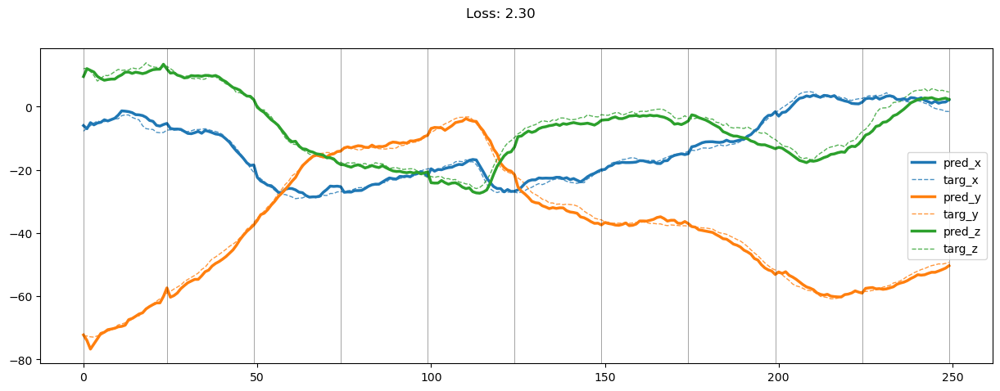

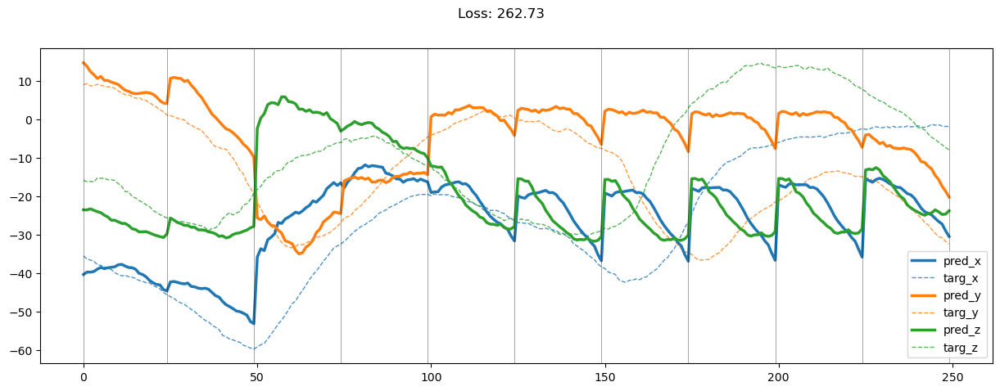

00799: train pred loss:  1.835, g loss:  5.745, diff loss:  3.531, d loss:  1.532
       valid pred loss:  165.448, g loss:  500.399, diff loss:  334.567, d loss:  1.528


100%|██████████| 17/17 [00:01<00:00, 15.22it/s]


00800: train pred loss:  1.967, g loss:  6.130, diff loss:  3.772, d loss:  1.519
       valid pred loss:  164.734, g loss:  502.584, diff loss:  337.453, d loss:  1.514


100%|██████████| 17/17 [00:01<00:00, 15.25it/s]


00801: train pred loss:  1.906, g loss:  6.075, diff loss:  3.766, d loss:  1.506
       valid pred loss:  167.619, g loss:  511.856, diff loss:  343.827, d loss:  1.500


100%|██████████| 17/17 [00:01<00:00, 15.24it/s]


00802: train pred loss:  1.903, g loss:  6.040, diff loss:  3.720, d loss:  1.493
       valid pred loss:  164.204, g loss:  497.984, diff loss:  333.357, d loss:  1.488


100%|██████████| 17/17 [00:01<00:00, 14.23it/s]


00803: train pred loss:  1.928, g loss:  6.056, diff loss:  3.698, d loss:  1.481
       valid pred loss:  165.575, g loss:  507.652, diff loss:  341.642, d loss:  1.478


100%|██████████| 17/17 [00:01<00:00, 14.65it/s]


00804: train pred loss:  1.916, g loss:  6.117, diff loss:  3.759, d loss:  1.471
       valid pred loss:  167.172, g loss:  511.684, diff loss:  344.065, d loss:  1.469


100%|██████████| 17/17 [00:01<00:00, 15.08it/s]


00805: train pred loss:  1.988, g loss:  6.330, diff loss:  3.890, d loss:  1.464
       valid pred loss:  162.728, g loss:  495.268, diff loss:  332.083, d loss:  1.462


100%|██████████| 17/17 [00:01<00:00, 15.17it/s]


00806: train pred loss:  1.904, g loss:  6.088, diff loss:  3.722, d loss:  1.457
       valid pred loss:  164.327, g loss:  493.729, diff loss:  328.939, d loss:  1.457


100%|██████████| 17/17 [00:01<00:00, 15.02it/s]


00807: train pred loss:  1.977, g loss:  6.316, diff loss:  3.873, d loss:  1.452
       valid pred loss:  163.408, g loss:  496.798, diff loss:  332.922, d loss:  1.454


100%|██████████| 17/17 [00:01<00:00, 14.78it/s]


00808: train pred loss:  1.926, g loss:  6.124, diff loss:  3.728, d loss:  1.451
       valid pred loss:  159.681, g loss:  480.298, diff loss:  320.149, d loss:  1.454


100%|██████████| 17/17 [00:01<00:00, 15.28it/s]


00809: train pred loss:  1.931, g loss:  6.219, diff loss:  3.820, d loss:  1.451
       valid pred loss:  162.860, g loss:  491.493, diff loss:  328.167, d loss:  1.456


100%|██████████| 17/17 [00:01<00:00, 15.28it/s]


00810: train pred loss:  1.925, g loss:  6.181, diff loss:  3.791, d loss:  1.454
       valid pred loss:  163.883, g loss:  495.425, diff loss:  331.081, d loss:  1.460


100%|██████████| 17/17 [00:01<00:00, 15.29it/s]


00811: train pred loss:  1.846, g loss:  5.897, diff loss:  3.595, d loss:  1.460
       valid pred loss:  162.415, g loss:  497.123, diff loss:  334.257, d loss:  1.467


100%|██████████| 17/17 [00:01<00:00, 15.28it/s]


00812: train pred loss:  1.845, g loss:  5.874, diff loss:  3.583, d loss:  1.468
       valid pred loss:  165.841, g loss:  506.760, diff loss:  340.481, d loss:  1.477


100%|██████████| 17/17 [00:01<00:00, 15.28it/s]


00813: train pred loss:  1.858, g loss:  5.947, diff loss:  3.655, d loss:  1.479
       valid pred loss:  159.611, g loss:  485.936, diff loss:  325.900, d loss:  1.488


100%|██████████| 17/17 [00:01<00:00, 15.27it/s]


00814: train pred loss:  1.882, g loss:  6.010, diff loss:  3.709, d loss:  1.490
       valid pred loss:  162.874, g loss:  490.995, diff loss:  327.709, d loss:  1.501


100%|██████████| 17/17 [00:01<00:00, 15.28it/s]


00815: train pred loss:  1.917, g loss:  6.024, diff loss:  3.702, d loss:  1.505
       valid pred loss:  159.136, g loss:  485.729, diff loss:  326.197, d loss:  1.516


100%|██████████| 17/17 [00:01<00:00, 14.67it/s]


00816: train pred loss:  1.924, g loss:  6.036, diff loss:  3.721, d loss:  1.520
       valid pred loss:  171.426, g loss:  515.681, diff loss:  343.872, d loss:  1.531


100%|██████████| 17/17 [00:01<00:00, 14.91it/s]


00817: train pred loss:  1.934, g loss:  6.082, diff loss:  3.771, d loss:  1.535
       valid pred loss:  169.091, g loss:  509.663, diff loss:  340.203, d loss:  1.546


100%|██████████| 17/17 [00:01<00:00, 14.00it/s]


00818: train pred loss:  2.107, g loss:  6.522, diff loss:  4.049, d loss:  1.549
       valid pred loss:  162.864, g loss:  489.761, diff loss:  326.538, d loss:  1.560


100%|██████████| 17/17 [00:01<00:00, 14.79it/s]


00819: train pred loss:  2.214, g loss:  6.814, diff loss:  4.243, d loss:  1.562
       valid pred loss:  167.186, g loss:  506.847, diff loss:  339.311, d loss:  1.572


100%|██████████| 17/17 [00:01<00:00, 14.99it/s]


00820: train pred loss:  2.113, g loss:  6.507, diff loss:  4.046, d loss:  1.572
       valid pred loss:  165.603, g loss:  509.106, diff loss:  343.159, d loss:  1.581


100%|██████████| 17/17 [00:01<00:00, 14.95it/s]


00821: train pred loss:  2.106, g loss:  6.523, diff loss:  4.074, d loss:  1.579
       valid pred loss:  170.515, g loss:  511.691, diff loss:  340.835, d loss:  1.586


100%|██████████| 17/17 [00:01<00:00, 14.59it/s]


00822: train pred loss:  1.984, g loss:  6.138, diff loss:  3.814, d loss:  1.583
       valid pred loss:  166.537, g loss:  502.382, diff loss:  335.506, d loss:  1.587


100%|██████████| 17/17 [00:01<00:00, 15.14it/s]


00823: train pred loss:  1.868, g loss:  5.811, diff loss:  3.603, d loss:  1.583
       valid pred loss:  163.299, g loss:  493.837, diff loss:  330.197, d loss:  1.585


100%|██████████| 17/17 [00:01<00:00, 15.14it/s]


00824: train pred loss:  1.825, g loss:  5.735, diff loss:  3.566, d loss:  1.578
       valid pred loss:  164.928, g loss:  501.447, diff loss:  336.173, d loss:  1.579


100%|██████████| 17/17 [00:01<00:00, 15.17it/s]


00825: train pred loss:  1.831, g loss:  5.784, diff loss:  3.604, d loss:  1.571
       valid pred loss:  165.484, g loss:  500.098, diff loss:  334.261, d loss:  1.568


100%|██████████| 17/17 [00:01<00:00, 15.12it/s]


00826: train pred loss:  1.864, g loss:  5.845, diff loss:  3.623, d loss:  1.559
       valid pred loss:  165.792, g loss:  503.885, diff loss:  337.730, d loss:  1.555


100%|██████████| 17/17 [00:01<00:00, 14.58it/s]


00827: train pred loss:  1.869, g loss:  5.834, diff loss:  3.597, d loss:  1.545
       valid pred loss:  166.030, g loss:  502.065, diff loss:  335.661, d loss:  1.540


100%|██████████| 17/17 [00:01<00:00, 15.03it/s]


00828: train pred loss:  1.875, g loss:  5.925, diff loss:  3.669, d loss:  1.530
       valid pred loss:  162.860, g loss:  493.085, diff loss:  329.838, d loss:  1.524


100%|██████████| 17/17 [00:01<00:00, 15.16it/s]


00829: train pred loss:  1.829, g loss:  5.757, diff loss:  3.533, d loss:  1.514
       valid pred loss:  165.193, g loss:  500.826, diff loss:  335.231, d loss:  1.508


100%|██████████| 17/17 [00:01<00:00, 15.15it/s]


00830: train pred loss:  1.834, g loss:  5.852, diff loss:  3.608, d loss:  1.499
       valid pred loss:  166.371, g loss:  506.653, diff loss:  339.864, d loss:  1.494


100%|██████████| 17/17 [00:01<00:00, 15.13it/s]


00831: train pred loss:  1.860, g loss:  5.904, diff loss:  3.619, d loss:  1.485
       valid pred loss:  165.519, g loss:  506.991, diff loss:  341.039, d loss:  1.480


100%|██████████| 17/17 [00:01<00:00, 15.11it/s]


00832: train pred loss:  1.789, g loss:  5.751, diff loss:  3.521, d loss:  1.472
       valid pred loss:  165.840, g loss:  502.795, diff loss:  336.508, d loss:  1.468


100%|██████████| 17/17 [00:01<00:00, 15.16it/s]


00833: train pred loss:  1.872, g loss:  5.909, diff loss:  3.583, d loss:  1.461
       valid pred loss:  162.896, g loss:  494.098, diff loss:  330.741, d loss:  1.458


100%|██████████| 17/17 [00:01<00:00, 15.00it/s]


00834: train pred loss:  2.057, g loss:  6.470, diff loss:  3.948, d loss:  1.453
       valid pred loss:  163.661, g loss:  502.690, diff loss:  338.559, d loss:  1.451


100%|██████████| 17/17 [00:01<00:00, 15.15it/s]


00835: train pred loss:  1.946, g loss:  6.134, diff loss:  3.712, d loss:  1.446
       valid pred loss:  165.894, g loss:  504.548, diff loss:  338.176, d loss:  1.446


100%|██████████| 17/17 [00:01<00:00, 15.18it/s]


00836: train pred loss:  1.862, g loss:  5.982, diff loss:  3.639, d loss:  1.443
       valid pred loss:  164.985, g loss:  499.608, diff loss:  334.139, d loss:  1.443


100%|██████████| 17/17 [00:01<00:00, 14.95it/s]


00837: train pred loss:  1.877, g loss:  6.026, diff loss:  3.664, d loss:  1.440
       valid pred loss:  166.376, g loss:  504.757, diff loss:  337.897, d loss:  1.443


100%|██████████| 17/17 [00:01<00:00, 15.08it/s]


00838: train pred loss:  1.902, g loss:  6.072, diff loss:  3.687, d loss:  1.442
       valid pred loss:  165.223, g loss:  496.946, diff loss:  331.242, d loss:  1.445


100%|██████████| 17/17 [00:01<00:00, 14.24it/s]


00839: train pred loss:  1.822, g loss:  5.879, diff loss:  3.578, d loss:  1.444
       valid pred loss:  165.464, g loss:  496.580, diff loss:  330.642, d loss:  1.450


100%|██████████| 17/17 [00:01<00:00, 15.19it/s]


00840: train pred loss:  1.825, g loss:  5.833, diff loss:  3.537, d loss:  1.450
       valid pred loss:  165.198, g loss:  494.913, diff loss:  329.252, d loss:  1.457


100%|██████████| 17/17 [00:01<00:00, 14.83it/s]


00841: train pred loss:  1.767, g loss:  5.676, diff loss:  3.451, d loss:  1.459
       valid pred loss:  159.366, g loss:  481.267, diff loss:  321.451, d loss:  1.466


100%|██████████| 17/17 [00:01<00:00, 15.11it/s]


00842: train pred loss:  1.750, g loss:  5.605, diff loss:  3.411, d loss:  1.469
       valid pred loss:  163.654, g loss:  498.717, diff loss:  334.628, d loss:  1.478


100%|██████████| 17/17 [00:01<00:00, 14.97it/s]


00843: train pred loss:  1.837, g loss:  5.904, diff loss:  3.639, d loss:  1.482
       valid pred loss:  162.621, g loss:  481.661, diff loss:  318.621, d loss:  1.493


100%|██████████| 17/17 [00:01<00:00, 13.83it/s]


00844: train pred loss:  1.834, g loss:  5.813, diff loss:  3.567, d loss:  1.497
       valid pred loss:  164.215, g loss:  489.577, diff loss:  324.960, d loss:  1.509


100%|██████████| 17/17 [00:01<00:00, 15.21it/s]


00845: train pred loss:  1.858, g loss:  5.889, diff loss:  3.636, d loss:  1.514
       valid pred loss:  162.313, g loss:  494.546, diff loss:  331.846, d loss:  1.526


100%|██████████| 17/17 [00:01<00:00, 15.19it/s]


00846: train pred loss:  1.824, g loss:  5.741, diff loss:  3.537, d loss:  1.531
       valid pred loss:  165.281, g loss:  495.728, diff loss:  330.075, d loss:  1.542


100%|██████████| 17/17 [00:01<00:00, 15.19it/s]


00847: train pred loss:  1.848, g loss:  5.737, diff loss:  3.523, d loss:  1.548
       valid pred loss:  166.252, g loss:  501.057, diff loss:  334.446, d loss:  1.559


100%|██████████| 17/17 [00:01<00:00, 14.60it/s]


00848: train pred loss:  1.786, g loss:  5.664, diff loss:  3.524, d loss:  1.564
       valid pred loss:  163.298, g loss:  496.920, diff loss:  333.275, d loss:  1.574


100%|██████████| 17/17 [00:01<00:00, 14.96it/s]


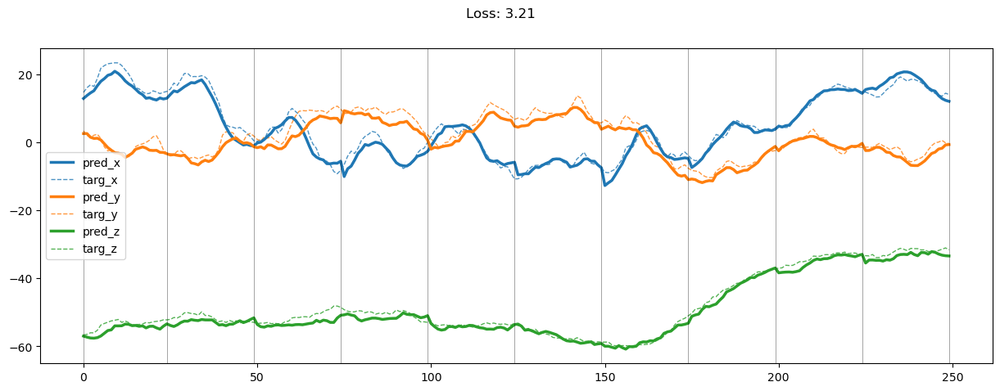

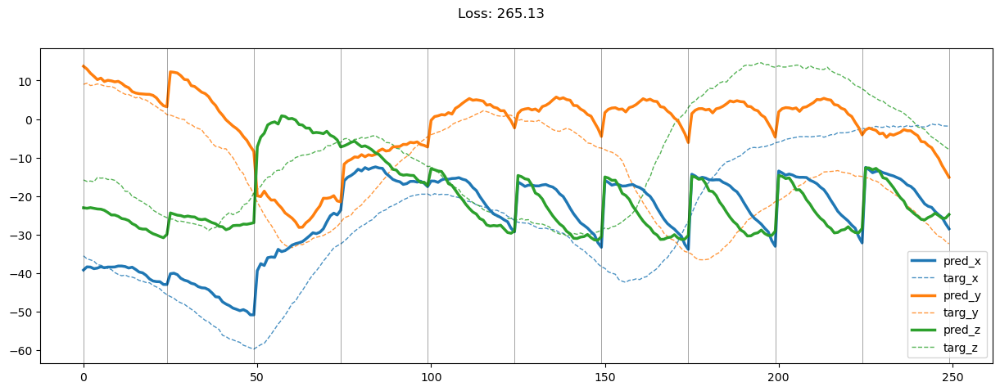

00849: train pred loss:  1.809, g loss:  5.690, diff loss:  3.537, d loss:  1.579
       valid pred loss:  164.273, g loss:  495.700, diff loss:  331.088, d loss:  1.588


100%|██████████| 17/17 [00:01<00:00, 15.13it/s]


00850: train pred loss:  1.780, g loss:  5.527, diff loss:  3.412, d loss:  1.590
       valid pred loss:  170.100, g loss:  511.189, diff loss:  340.757, d loss:  1.597


100%|██████████| 17/17 [00:01<00:00, 15.14it/s]


00851: train pred loss:  1.798, g loss:  5.607, diff loss:  3.478, d loss:  1.598
       valid pred loss:  168.158, g loss:  509.285, diff loss:  340.799, d loss:  1.604


100%|██████████| 17/17 [00:01<00:00, 14.72it/s]


00852: train pred loss:  1.880, g loss:  5.807, diff loss:  3.600, d loss:  1.603
       valid pred loss:  162.684, g loss:  492.862, diff loss:  329.851, d loss:  1.607


100%|██████████| 17/17 [00:01<00:00, 13.82it/s]


00853: train pred loss:  1.796, g loss:  5.595, diff loss:  3.471, d loss:  1.603
       valid pred loss:  165.710, g loss:  505.343, diff loss:  339.305, d loss:  1.604


100%|██████████| 17/17 [00:01<00:00, 14.22it/s]


00854: train pred loss:  1.833, g loss:  5.719, diff loss:  3.555, d loss:  1.598
       valid pred loss:  167.104, g loss:  501.161, diff loss:  333.724, d loss:  1.598


100%|██████████| 17/17 [00:01<00:00, 14.87it/s]


00855: train pred loss:  1.792, g loss:  5.618, diff loss:  3.490, d loss:  1.590
       valid pred loss:  164.758, g loss:  497.134, diff loss:  332.037, d loss:  1.588


100%|██████████| 17/17 [00:01<00:00, 15.10it/s]


00856: train pred loss:  1.823, g loss:  5.699, diff loss:  3.532, d loss:  1.578
       valid pred loss:  165.131, g loss:  501.171, diff loss:  335.691, d loss:  1.574


100%|██████████| 17/17 [00:01<00:00, 15.06it/s]


00857: train pred loss:  1.785, g loss:  5.661, diff loss:  3.521, d loss:  1.563
       valid pred loss:  169.094, g loss:  518.454, diff loss:  348.999, d loss:  1.558


100%|██████████| 17/17 [00:01<00:00, 15.17it/s]


00858: train pred loss:  1.778, g loss:  5.550, diff loss:  3.404, d loss:  1.545
       valid pred loss:  165.582, g loss:  500.214, diff loss:  334.258, d loss:  1.540


100%|██████████| 17/17 [00:01<00:00, 15.09it/s]


00859: train pred loss:  1.741, g loss:  5.488, diff loss:  3.364, d loss:  1.528
       valid pred loss:  167.908, g loss:  509.452, diff loss:  341.154, d loss:  1.522


100%|██████████| 17/17 [00:01<00:00, 15.07it/s]


00860: train pred loss:  1.684, g loss:  5.401, diff loss:  3.318, d loss:  1.510
       valid pred loss:  163.426, g loss:  501.755, diff loss:  337.922, d loss:  1.505


100%|██████████| 17/17 [00:01<00:00, 15.03it/s]


00861: train pred loss:  1.648, g loss:  5.322, diff loss:  3.258, d loss:  1.494
       valid pred loss:  163.634, g loss:  501.119, diff loss:  337.062, d loss:  1.489


100%|██████████| 17/17 [00:01<00:00, 15.12it/s]


00862: train pred loss:  1.650, g loss:  5.335, diff loss:  3.252, d loss:  1.479
       valid pred loss:  166.749, g loss:  512.884, diff loss:  345.695, d loss:  1.475


100%|██████████| 17/17 [00:01<00:00, 15.06it/s]


00863: train pred loss:  1.705, g loss:  5.469, diff loss:  3.315, d loss:  1.465
       valid pred loss:  165.570, g loss:  507.750, diff loss:  341.724, d loss:  1.463


100%|██████████| 17/17 [00:01<00:00, 14.95it/s]


00864: train pred loss:  1.702, g loss:  5.528, diff loss:  3.360, d loss:  1.454
       valid pred loss:  161.688, g loss:  499.464, diff loss:  337.305, d loss:  1.453


100%|██████████| 17/17 [00:01<00:00, 14.24it/s]


00865: train pred loss:  1.712, g loss:  5.578, diff loss:  3.389, d loss:  1.445
       valid pred loss:  162.214, g loss:  492.082, diff loss:  329.385, d loss:  1.446


100%|██████████| 17/17 [00:01<00:00, 15.04it/s]


00866: train pred loss:  1.796, g loss:  5.760, diff loss:  3.476, d loss:  1.439
       valid pred loss:  164.651, g loss:  501.419, diff loss:  336.276, d loss:  1.440


100%|██████████| 17/17 [00:01<00:00, 14.62it/s]


00867: train pred loss:  1.685, g loss:  5.475, diff loss:  3.293, d loss:  1.434
       valid pred loss:  164.122, g loss:  502.748, diff loss:  338.128, d loss:  1.437


100%|██████████| 17/17 [00:01<00:00, 14.94it/s]


00868: train pred loss:  1.691, g loss:  5.473, diff loss:  3.281, d loss:  1.431
       valid pred loss:  161.925, g loss:  487.465, diff loss:  325.041, d loss:  1.436


100%|██████████| 17/17 [00:01<00:00, 14.99it/s]


00869: train pred loss:  1.767, g loss:  5.738, diff loss:  3.471, d loss:  1.431
       valid pred loss:  166.619, g loss:  505.296, diff loss:  338.181, d loss:  1.438


100%|██████████| 17/17 [00:01<00:00, 14.29it/s]


00870: train pred loss:  1.750, g loss:  5.639, diff loss:  3.393, d loss:  1.434
       valid pred loss:  162.975, g loss:  499.777, diff loss:  336.311, d loss:  1.441


100%|██████████| 17/17 [00:01<00:00, 15.17it/s]


00871: train pred loss:  1.787, g loss:  5.774, diff loss:  3.499, d loss:  1.439
       valid pred loss:  161.484, g loss:  481.025, diff loss:  319.060, d loss:  1.447


100%|██████████| 17/17 [00:01<00:00, 15.10it/s]


00872: train pred loss:  1.863, g loss:  5.901, diff loss:  3.562, d loss:  1.446
       valid pred loss:  163.687, g loss:  504.225, diff loss:  340.070, d loss:  1.455


100%|██████████| 17/17 [00:01<00:00, 15.20it/s]


00873: train pred loss:  1.864, g loss:  5.965, diff loss:  3.640, d loss:  1.456
       valid pred loss:  163.371, g loss:  499.728, diff loss:  335.905, d loss:  1.466


100%|██████████| 17/17 [00:01<00:00, 14.73it/s]


00874: train pred loss:  1.885, g loss:  5.980, diff loss:  3.651, d loss:  1.469
       valid pred loss:  164.815, g loss:  508.633, diff loss:  343.384, d loss:  1.480


100%|██████████| 17/17 [00:01<00:00, 14.94it/s]


00875: train pred loss:  1.861, g loss:  5.915, diff loss:  3.627, d loss:  1.483
       valid pred loss:  168.819, g loss:  514.624, diff loss:  345.389, d loss:  1.496


100%|██████████| 17/17 [00:01<00:00, 15.07it/s]


00876: train pred loss:  1.868, g loss:  5.928, diff loss:  3.651, d loss:  1.500
       valid pred loss:  169.224, g loss:  515.774, diff loss:  346.152, d loss:  1.515


100%|██████████| 17/17 [00:01<00:00, 15.13it/s]


00877: train pred loss:  1.828, g loss:  5.827, diff loss:  3.608, d loss:  1.518
       valid pred loss:  166.038, g loss:  508.611, diff loss:  342.191, d loss:  1.532


100%|██████████| 17/17 [00:01<00:00, 15.19it/s]


00878: train pred loss:  1.792, g loss:  5.709, diff loss:  3.542, d loss:  1.538
       valid pred loss:  166.709, g loss:  506.911, diff loss:  339.837, d loss:  1.552


100%|██████████| 17/17 [00:01<00:00, 15.08it/s]


00879: train pred loss:  1.720, g loss:  5.490, diff loss:  3.410, d loss:  1.557
       valid pred loss:  166.261, g loss:  511.990, diff loss:  345.377, d loss:  1.569


100%|██████████| 17/17 [00:01<00:00, 15.21it/s]


00880: train pred loss:  1.688, g loss:  5.337, diff loss:  3.302, d loss:  1.574
       valid pred loss:  165.373, g loss:  508.966, diff loss:  343.253, d loss:  1.586


100%|██████████| 17/17 [00:01<00:00, 15.14it/s]


00881: train pred loss:  1.670, g loss:  5.276, diff loss:  3.270, d loss:  1.591
       valid pred loss:  163.639, g loss:  496.565, diff loss:  332.596, d loss:  1.601


100%|██████████| 17/17 [00:01<00:00, 15.16it/s]


00882: train pred loss:  1.682, g loss:  5.283, diff loss:  3.274, d loss:  1.604
       valid pred loss:  162.311, g loss:  491.230, diff loss:  328.598, d loss:  1.614


100%|██████████| 17/17 [00:01<00:00, 14.98it/s]


00883: train pred loss:  1.683, g loss:  5.264, diff loss:  3.260, d loss:  1.615
       valid pred loss:  160.316, g loss:  488.706, diff loss:  328.074, d loss:  1.621


100%|██████████| 17/17 [00:01<00:00, 15.12it/s]


00884: train pred loss:  1.770, g loss:  5.530, diff loss:  3.444, d loss:  1.621
       valid pred loss:  161.097, g loss:  495.893, diff loss:  334.482, d loss:  1.626


100%|██████████| 17/17 [00:01<00:00, 15.12it/s]


00885: train pred loss:  1.704, g loss:  5.370, diff loss:  3.350, d loss:  1.623
       valid pred loss:  163.176, g loss:  501.891, diff loss:  338.400, d loss:  1.626


100%|██████████| 17/17 [00:01<00:00, 15.21it/s]


00886: train pred loss:  1.671, g loss:  5.191, diff loss:  3.204, d loss:  1.621
       valid pred loss:  161.406, g loss:  498.321, diff loss:  336.598, d loss:  1.622


100%|██████████| 17/17 [00:01<00:00, 15.06it/s]


00887: train pred loss:  1.659, g loss:  5.234, diff loss:  3.254, d loss:  1.614
       valid pred loss:  159.282, g loss:  484.372, diff loss:  324.767, d loss:  1.613


100%|██████████| 17/17 [00:01<00:00, 15.12it/s]


00888: train pred loss:  1.675, g loss:  5.250, diff loss:  3.248, d loss:  1.604
       valid pred loss:  159.270, g loss:  495.055, diff loss:  335.454, d loss:  1.599


100%|██████████| 17/17 [00:01<00:00, 15.15it/s]


00889: train pred loss:  1.634, g loss:  5.120, diff loss:  3.149, d loss:  1.590
       valid pred loss:  163.211, g loss:  498.282, diff loss:  334.730, d loss:  1.583


100%|██████████| 17/17 [00:01<00:00, 15.13it/s]


00890: train pred loss:  1.630, g loss:  5.133, diff loss:  3.154, d loss:  1.572
       valid pred loss:  161.263, g loss:  496.966, diff loss:  335.349, d loss:  1.565


100%|██████████| 17/17 [00:01<00:00, 15.07it/s]


00891: train pred loss:  1.690, g loss:  5.313, diff loss:  3.261, d loss:  1.553
       valid pred loss:  163.462, g loss:  497.082, diff loss:  333.251, d loss:  1.546


100%|██████████| 17/17 [00:01<00:00, 15.09it/s]


00892: train pred loss:  1.668, g loss:  5.321, diff loss:  3.275, d loss:  1.534
       valid pred loss:  162.755, g loss:  500.966, diff loss:  337.826, d loss:  1.526


100%|██████████| 17/17 [00:01<00:00, 15.04it/s]


00893: train pred loss:  1.680, g loss:  5.377, diff loss:  3.302, d loss:  1.514
       valid pred loss:  162.502, g loss:  498.652, diff loss:  335.747, d loss:  1.506


100%|██████████| 17/17 [00:01<00:00, 15.14it/s]


00894: train pred loss:  1.722, g loss:  5.463, diff loss:  3.328, d loss:  1.496
       valid pred loss:  162.609, g loss:  500.085, diff loss:  337.054, d loss:  1.489


100%|██████████| 17/17 [00:01<00:00, 14.70it/s]


00895: train pred loss:  1.714, g loss:  5.531, diff loss:  3.386, d loss:  1.479
       valid pred loss:  156.680, g loss:  482.159, diff loss:  325.039, d loss:  1.474


100%|██████████| 17/17 [00:01<00:00, 15.20it/s]


00896: train pred loss:  1.665, g loss:  5.409, diff loss:  3.294, d loss:  1.464
       valid pred loss:  162.169, g loss:  498.974, diff loss:  336.347, d loss:  1.460


100%|██████████| 17/17 [00:01<00:00, 15.16it/s]


00897: train pred loss:  1.648, g loss:  5.371, diff loss:  3.256, d loss:  1.452
       valid pred loss:  161.629, g loss:  499.178, diff loss:  337.075, d loss:  1.449


100%|██████████| 17/17 [00:01<00:00, 15.17it/s]


00898: train pred loss:  1.644, g loss:  5.347, diff loss:  3.221, d loss:  1.442
       valid pred loss:  161.245, g loss:  494.033, diff loss:  332.298, d loss:  1.440


100%|██████████| 17/17 [00:01<00:00, 15.17it/s]


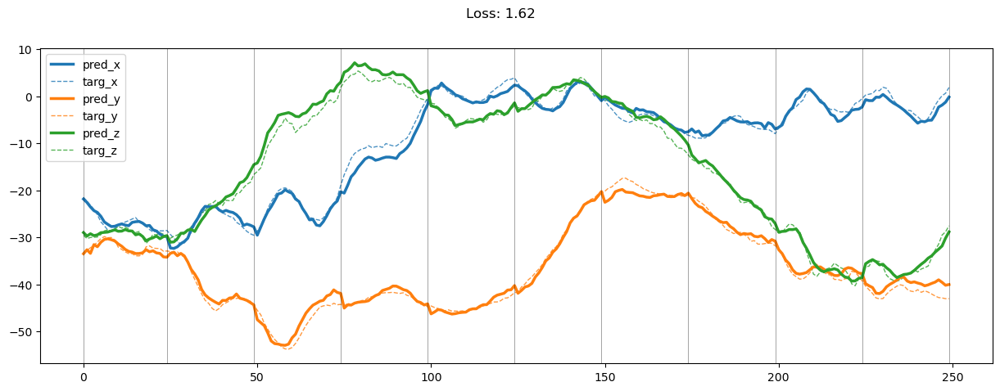

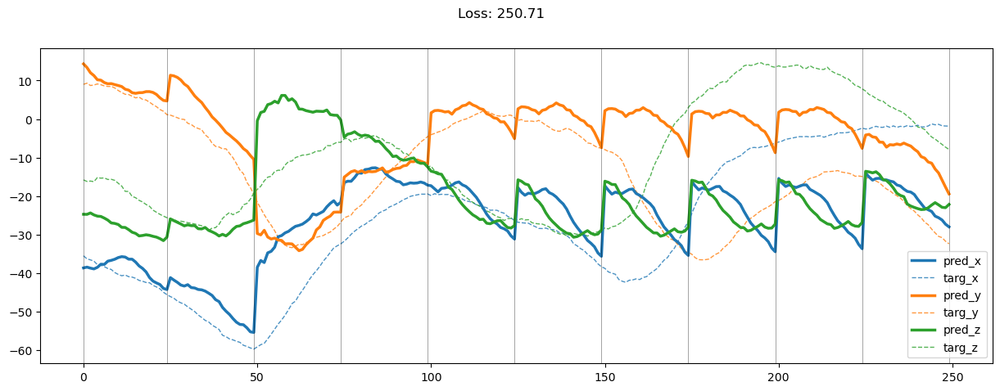

00899: train pred loss:  1.704, g loss:  5.491, diff loss:  3.291, d loss:  1.434
       valid pred loss:  165.561, g loss:  507.686, diff loss:  341.624, d loss:  1.434


100%|██████████| 17/17 [00:01<00:00, 14.33it/s]


00900: train pred loss:  1.633, g loss:  5.303, diff loss:  3.164, d loss:  1.428
       valid pred loss:  163.106, g loss:  495.752, diff loss:  332.135, d loss:  1.428


100%|██████████| 17/17 [00:01<00:00, 15.20it/s]


00901: train pred loss:  1.726, g loss:  5.589, diff loss:  3.348, d loss:  1.425
       valid pred loss:  165.524, g loss:  507.973, diff loss:  341.934, d loss:  1.426


100%|██████████| 17/17 [00:01<00:00, 15.12it/s]


00902: train pred loss:  1.750, g loss:  5.692, diff loss:  3.425, d loss:  1.423
       valid pred loss:  162.628, g loss:  497.126, diff loss:  333.981, d loss:  1.426


100%|██████████| 17/17 [00:01<00:00, 15.10it/s]


00903: train pred loss:  1.713, g loss:  5.599, diff loss:  3.369, d loss:  1.424
       valid pred loss:  161.817, g loss:  498.950, diff loss:  336.619, d loss:  1.427


100%|██████████| 17/17 [00:01<00:00, 15.20it/s]


00904: train pred loss:  1.728, g loss:  5.613, diff loss:  3.372, d loss:  1.425
       valid pred loss:  162.248, g loss:  500.563, diff loss:  337.808, d loss:  1.431


100%|██████████| 17/17 [00:01<00:00, 14.24it/s]


00905: train pred loss:  1.691, g loss:  5.523, diff loss:  3.330, d loss:  1.431
       valid pred loss:  166.667, g loss:  519.913, diff loss:  352.750, d loss:  1.437


100%|██████████| 17/17 [00:01<00:00, 15.22it/s]


00906: train pred loss:  1.663, g loss:  5.441, diff loss:  3.288, d loss:  1.438
       valid pred loss:  165.105, g loss:  502.236, diff loss:  336.650, d loss:  1.445


100%|██████████| 17/17 [00:01<00:00, 15.12it/s]


00907: train pred loss:  1.621, g loss:  5.270, diff loss:  3.175, d loss:  1.448
       valid pred loss:  165.513, g loss:  506.962, diff loss:  340.986, d loss:  1.456


100%|██████████| 17/17 [00:01<00:00, 15.17it/s]


00908: train pred loss:  1.662, g loss:  5.380, diff loss:  3.262, d loss:  1.461
       valid pred loss:  163.222, g loss:  505.981, diff loss:  342.314, d loss:  1.470


100%|██████████| 17/17 [00:01<00:00, 14.94it/s]


00909: train pred loss:  1.599, g loss:  5.200, diff loss:  3.165, d loss:  1.476
       valid pred loss:  161.609, g loss:  498.277, diff loss:  336.243, d loss:  1.487


100%|██████████| 17/17 [00:01<00:00, 15.24it/s]


00910: train pred loss:  1.583, g loss:  5.106, diff loss:  3.105, d loss:  1.493
       valid pred loss:  160.943, g loss:  494.147, diff loss:  332.797, d loss:  1.504


100%|██████████| 17/17 [00:01<00:00, 15.22it/s]


00911: train pred loss:  1.602, g loss:  5.175, diff loss:  3.175, d loss:  1.512
       valid pred loss:  161.271, g loss:  491.724, diff loss:  330.066, d loss:  1.524


100%|██████████| 17/17 [00:01<00:00, 14.89it/s]


00912: train pred loss:  1.673, g loss:  5.291, diff loss:  3.239, d loss:  1.532
       valid pred loss:  159.778, g loss:  485.384, diff loss:  325.236, d loss:  1.544


100%|██████████| 17/17 [00:01<00:00, 13.79it/s]


00913: train pred loss:  1.601, g loss:  5.105, diff loss:  3.141, d loss:  1.552
       valid pred loss:  159.790, g loss:  483.379, diff loss:  323.235, d loss:  1.565


100%|██████████| 17/17 [00:01<00:00, 15.05it/s]


00914: train pred loss:  1.620, g loss:  5.115, diff loss:  3.148, d loss:  1.573
       valid pred loss:  161.944, g loss:  491.244, diff loss:  328.959, d loss:  1.585


100%|██████████| 17/17 [00:01<00:00, 15.03it/s]


00915: train pred loss:  1.624, g loss:  5.076, diff loss:  3.118, d loss:  1.591
       valid pred loss:  165.135, g loss:  511.049, diff loss:  345.585, d loss:  1.603


100%|██████████| 17/17 [00:01<00:00, 15.26it/s]


00916: train pred loss:  1.697, g loss:  5.368, diff loss:  3.348, d loss:  1.609
       valid pred loss:  166.041, g loss:  514.618, diff loss:  348.259, d loss:  1.619


100%|██████████| 17/17 [00:01<00:00, 14.64it/s]


00917: train pred loss:  1.695, g loss:  5.344, diff loss:  3.334, d loss:  1.623
       valid pred loss:  167.822, g loss:  519.501, diff loss:  351.368, d loss:  1.632


100%|██████████| 17/17 [00:01<00:00, 14.82it/s]


00918: train pred loss:  1.649, g loss:  5.149, diff loss:  3.191, d loss:  1.634
       valid pred loss:  170.476, g loss:  522.911, diff loss:  352.130, d loss:  1.641


100%|██████████| 17/17 [00:01<00:00, 15.26it/s]


00919: train pred loss:  1.598, g loss:  5.046, diff loss:  3.143, d loss:  1.642
       valid pred loss:  167.575, g loss:  515.201, diff loss:  347.323, d loss:  1.647


100%|██████████| 17/17 [00:01<00:00, 15.26it/s]


00920: train pred loss:  1.649, g loss:  5.153, diff loss:  3.201, d loss:  1.646
       valid pred loss:  164.404, g loss:  506.037, diff loss:  341.331, d loss:  1.648


100%|██████████| 17/17 [00:01<00:00, 15.23it/s]


00921: train pred loss:  1.678, g loss:  5.251, diff loss:  3.269, d loss:  1.644
       valid pred loss:  170.434, g loss:  524.437, diff loss:  353.699, d loss:  1.644


100%|██████████| 17/17 [00:01<00:00, 15.04it/s]


00922: train pred loss:  1.649, g loss:  5.191, diff loss:  3.235, d loss:  1.638
       valid pred loss:  169.803, g loss:  523.865, diff loss:  353.753, d loss:  1.636


100%|██████████| 17/17 [00:01<00:00, 15.04it/s]


00923: train pred loss:  1.652, g loss:  5.130, diff loss:  3.165, d loss:  1.628
       valid pred loss:  170.002, g loss:  525.523, diff loss:  355.206, d loss:  1.625


100%|██████████| 17/17 [00:01<00:00, 15.04it/s]


00924: train pred loss:  1.658, g loss:  5.203, diff loss:  3.223, d loss:  1.614
       valid pred loss:  166.458, g loss:  510.700, diff loss:  343.917, d loss:  1.609


100%|██████████| 17/17 [00:01<00:00, 15.01it/s]


00925: train pred loss:  1.706, g loss:  5.387, diff loss:  3.350, d loss:  1.597
       valid pred loss:  166.511, g loss:  512.310, diff loss:  345.463, d loss:  1.590


100%|██████████| 17/17 [00:01<00:00, 15.20it/s]


00926: train pred loss:  1.611, g loss:  5.128, diff loss:  3.171, d loss:  1.577
       valid pred loss:  166.720, g loss:  517.581, diff loss:  350.510, d loss:  1.570


100%|██████████| 17/17 [00:01<00:00, 15.23it/s]


00927: train pred loss:  1.552, g loss:  4.894, diff loss:  2.983, d loss:  1.558
       valid pred loss:  165.488, g loss:  511.826, diff loss:  345.970, d loss:  1.549


100%|██████████| 17/17 [00:01<00:00, 15.27it/s]


00928: train pred loss:  1.589, g loss:  5.075, diff loss:  3.110, d loss:  1.537
       valid pred loss:  160.015, g loss:  492.744, diff loss:  332.345, d loss:  1.528


100%|██████████| 17/17 [00:01<00:00, 15.27it/s]


00929: train pred loss:  1.600, g loss:  5.109, diff loss:  3.114, d loss:  1.516
       valid pred loss:  166.730, g loss:  512.018, diff loss:  344.884, d loss:  1.508


100%|██████████| 17/17 [00:01<00:00, 15.25it/s]


00930: train pred loss:  1.556, g loss:  5.000, diff loss:  3.030, d loss:  1.497
       valid pred loss:  161.018, g loss:  491.991, diff loss:  330.551, d loss:  1.490


100%|██████████| 17/17 [00:01<00:00, 15.11it/s]


00931: train pred loss:  1.574, g loss:  5.050, diff loss:  3.042, d loss:  1.479
       valid pred loss:  165.911, g loss:  513.262, diff loss:  346.909, d loss:  1.473


100%|██████████| 17/17 [00:01<00:00, 14.79it/s]


00932: train pred loss:  1.650, g loss:  5.297, diff loss:  3.195, d loss:  1.464
       valid pred loss:  165.117, g loss:  507.758, diff loss:  342.179, d loss:  1.458


100%|██████████| 17/17 [00:01<00:00, 14.31it/s]


00933: train pred loss:  1.560, g loss:  5.074, diff loss:  3.043, d loss:  1.449
       valid pred loss:  163.822, g loss:  508.971, diff loss:  344.669, d loss:  1.447


100%|██████████| 17/17 [00:01<00:00, 15.23it/s]


00934: train pred loss:  1.624, g loss:  5.278, diff loss:  3.165, d loss:  1.440
       valid pred loss:  163.726, g loss:  499.946, diff loss:  335.725, d loss:  1.438


100%|██████████| 17/17 [00:01<00:00, 15.21it/s]


00935: train pred loss:  1.590, g loss:  5.233, diff loss:  3.138, d loss:  1.430
       valid pred loss:  167.227, g loss:  515.635, diff loss:  347.898, d loss:  1.430


100%|██████████| 17/17 [00:01<00:00, 15.21it/s]


00936: train pred loss:  1.569, g loss:  5.165, diff loss:  3.078, d loss:  1.424
       valid pred loss:  163.810, g loss:  500.171, diff loss:  335.840, d loss:  1.424


100%|██████████| 17/17 [00:01<00:00, 15.21it/s]


00937: train pred loss:  1.579, g loss:  5.224, diff loss:  3.118, d loss:  1.420
       valid pred loss:  162.933, g loss:  499.972, diff loss:  336.511, d loss:  1.421


100%|██████████| 17/17 [00:01<00:00, 15.00it/s]


00938: train pred loss:  1.590, g loss:  5.241, diff loss:  3.118, d loss:  1.417
       valid pred loss:  162.550, g loss:  498.898, diff loss:  335.815, d loss:  1.419


100%|██████████| 17/17 [00:01<00:00, 15.02it/s]


00939: train pred loss:  1.582, g loss:  5.275, diff loss:  3.158, d loss:  1.416
       valid pred loss:  163.359, g loss:  501.255, diff loss:  337.364, d loss:  1.419


100%|██████████| 17/17 [00:01<00:00, 15.21it/s]


00940: train pred loss:  1.704, g loss:  5.480, diff loss:  3.244, d loss:  1.417
       valid pred loss:  159.625, g loss:  492.226, diff loss:  332.072, d loss:  1.421


100%|██████████| 17/17 [00:01<00:00, 15.17it/s]


00941: train pred loss:  1.762, g loss:  5.531, diff loss:  3.244, d loss:  1.419
       valid pred loss:  163.703, g loss:  499.642, diff loss:  335.420, d loss:  1.425


100%|██████████| 17/17 [00:01<00:00, 15.11it/s]


00942: train pred loss:  1.743, g loss:  5.546, diff loss:  3.288, d loss:  1.424
       valid pred loss:  168.574, g loss:  519.996, diff loss:  350.915, d loss:  1.431


100%|██████████| 17/17 [00:01<00:00, 15.17it/s]


00943: train pred loss:  1.648, g loss:  5.366, diff loss:  3.217, d loss:  1.432
       valid pred loss:  165.151, g loss:  511.279, diff loss:  345.638, d loss:  1.440


100%|██████████| 17/17 [00:01<00:00, 15.19it/s]


00944: train pred loss:  1.759, g loss:  5.672, diff loss:  3.428, d loss:  1.441
       valid pred loss:  168.717, g loss:  514.403, diff loss:  345.213, d loss:  1.451


100%|██████████| 17/17 [00:01<00:00, 15.21it/s]


00945: train pred loss:  1.748, g loss:  5.567, diff loss:  3.355, d loss:  1.455
       valid pred loss:  168.909, g loss:  517.206, diff loss:  347.844, d loss:  1.465


100%|██████████| 17/17 [00:01<00:00, 15.21it/s]


00946: train pred loss:  1.785, g loss:  5.619, diff loss:  3.390, d loss:  1.469
       valid pred loss:  158.839, g loss:  487.491, diff loss:  328.220, d loss:  1.481


100%|██████████| 17/17 [00:01<00:00, 15.20it/s]


00947: train pred loss:  1.735, g loss:  5.572, diff loss:  3.412, d loss:  1.486
       valid pred loss:  164.052, g loss:  505.808, diff loss:  341.344, d loss:  1.499


100%|██████████| 17/17 [00:01<00:00, 15.23it/s]


00948: train pred loss:  1.785, g loss:  5.683, diff loss:  3.494, d loss:  1.506
       valid pred loss:  164.401, g loss:  507.002, diff loss:  342.209, d loss:  1.520


100%|██████████| 17/17 [00:01<00:00, 14.70it/s]


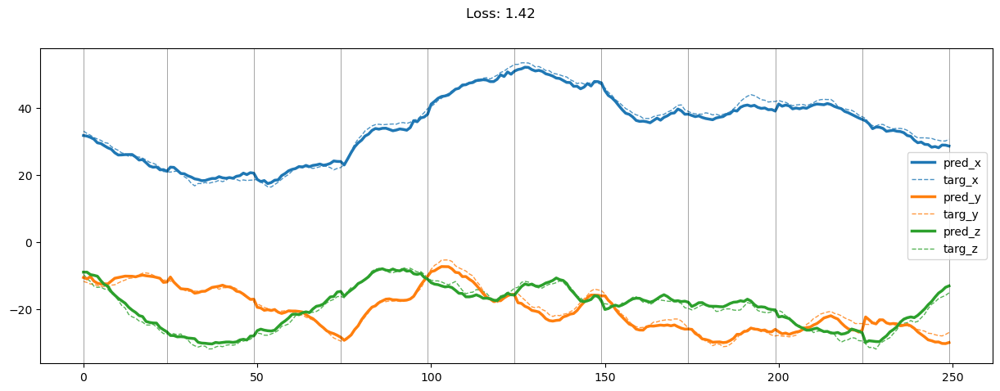

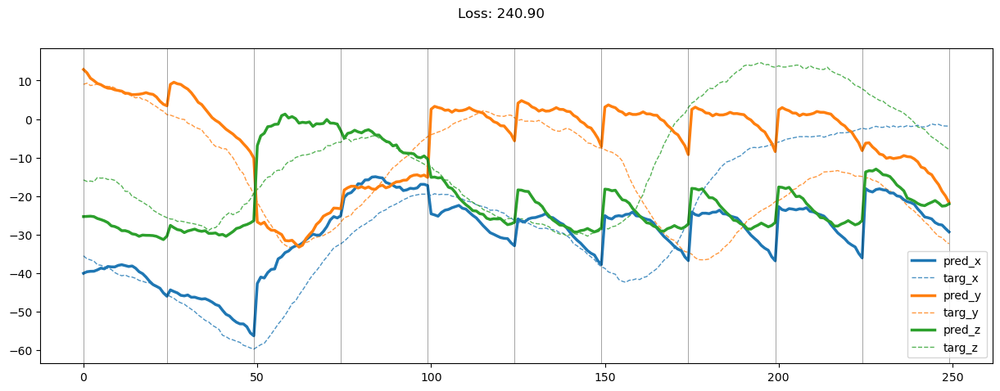

00949: train pred loss:  1.797, g loss:  5.688, diff loss:  3.506, d loss:  1.527
       valid pred loss:  159.451, g loss:  486.410, diff loss:  326.584, d loss:  1.540


100%|██████████| 17/17 [00:01<00:00, 15.26it/s]


00950: train pred loss:  1.810, g loss:  5.673, diff loss:  3.497, d loss:  1.548
       valid pred loss:  162.557, g loss:  492.539, diff loss:  329.625, d loss:  1.562


100%|██████████| 17/17 [00:01<00:00, 15.27it/s]


00951: train pred loss:  1.648, g loss:  5.197, diff loss:  3.199, d loss:  1.569
       valid pred loss:  162.051, g loss:  489.748, diff loss:  327.355, d loss:  1.583


100%|██████████| 17/17 [00:01<00:00, 15.19it/s]


00952: train pred loss:  1.593, g loss:  5.067, diff loss:  3.138, d loss:  1.590
       valid pred loss:  163.713, g loss:  493.290, diff loss:  329.249, d loss:  1.604


100%|██████████| 17/17 [00:01<00:00, 14.64it/s]


00953: train pred loss:  1.576, g loss:  4.980, diff loss:  3.080, d loss:  1.610
       valid pred loss:  163.400, g loss:  491.174, diff loss:  327.457, d loss:  1.622


100%|██████████| 17/17 [00:01<00:00, 15.23it/s]


00954: train pred loss:  1.536, g loss:  4.891, diff loss:  3.041, d loss:  1.627
       valid pred loss:  162.559, g loss:  495.132, diff loss:  332.265, d loss:  1.639


100%|██████████| 17/17 [00:01<00:00, 15.25it/s]


00955: train pred loss:  1.533, g loss:  4.860, diff loss:  3.023, d loss:  1.642
       valid pred loss:  167.619, g loss:  511.431, diff loss:  343.512, d loss:  1.652


100%|██████████| 17/17 [00:01<00:00, 14.12it/s]


00956: train pred loss:  1.582, g loss:  4.945, diff loss:  3.065, d loss:  1.653
       valid pred loss:  164.812, g loss:  499.357, diff loss:  334.251, d loss:  1.662


100%|██████████| 17/17 [00:01<00:00, 14.49it/s]


00957: train pred loss:  1.543, g loss:  4.870, diff loss:  3.033, d loss:  1.662
       valid pred loss:  163.891, g loss:  498.512, diff loss:  334.330, d loss:  1.668


100%|██████████| 17/17 [00:01<00:00, 15.13it/s]


00958: train pred loss:  1.549, g loss:  4.858, diff loss:  3.017, d loss:  1.666
       valid pred loss:  159.486, g loss:  485.722, diff loss:  325.946, d loss:  1.670


100%|██████████| 17/17 [00:01<00:00, 13.91it/s]


00959: train pred loss:  1.623, g loss:  5.082, diff loss:  3.166, d loss:  1.666
       valid pred loss:  163.603, g loss:  500.128, diff loss:  336.233, d loss:  1.667


100%|██████████| 17/17 [00:01<00:00, 14.77it/s]


00960: train pred loss:  1.673, g loss:  5.227, diff loss:  3.259, d loss:  1.661
       valid pred loss:  167.378, g loss:  512.970, diff loss:  345.296, d loss:  1.660


100%|██████████| 17/17 [00:01<00:00, 15.23it/s]


00961: train pred loss:  1.640, g loss:  5.112, diff loss:  3.173, d loss:  1.652
       valid pred loss:  166.140, g loss:  506.294, diff loss:  339.852, d loss:  1.648


100%|██████████| 17/17 [00:01<00:00, 15.24it/s]


00962: train pred loss:  1.568, g loss:  4.955, diff loss:  3.080, d loss:  1.639
       valid pred loss:  166.158, g loss:  504.837, diff loss:  338.369, d loss:  1.634


100%|██████████| 17/17 [00:01<00:00, 15.19it/s]


00963: train pred loss:  1.673, g loss:  5.300, diff loss:  3.311, d loss:  1.622
       valid pred loss:  160.949, g loss:  492.815, diff loss:  331.545, d loss:  1.615


100%|██████████| 17/17 [00:01<00:00, 15.19it/s]


00964: train pred loss:  1.634, g loss:  5.140, diff loss:  3.178, d loss:  1.603
       valid pred loss:  163.320, g loss:  495.603, diff loss:  331.950, d loss:  1.596


100%|██████████| 17/17 [00:01<00:00, 15.21it/s]


00965: train pred loss:  1.579, g loss:  4.976, diff loss:  3.057, d loss:  1.583
       valid pred loss:  164.184, g loss:  499.330, diff loss:  334.797, d loss:  1.573


100%|██████████| 17/17 [00:01<00:00, 15.27it/s]


00966: train pred loss:  1.609, g loss:  5.068, diff loss:  3.102, d loss:  1.561
       valid pred loss:  165.340, g loss:  510.327, diff loss:  344.623, d loss:  1.552


100%|██████████| 17/17 [00:01<00:00, 15.24it/s]


00967: train pred loss:  1.621, g loss:  5.127, diff loss:  3.132, d loss:  1.538
       valid pred loss:  164.924, g loss:  504.887, diff loss:  339.579, d loss:  1.529


100%|██████████| 17/17 [00:01<00:00, 15.26it/s]


00968: train pred loss:  1.683, g loss:  5.370, diff loss:  3.293, d loss:  1.517
       valid pred loss:  162.354, g loss:  500.665, diff loss:  337.908, d loss:  1.509


100%|██████████| 17/17 [00:01<00:00, 15.22it/s]


00969: train pred loss:  1.698, g loss:  5.401, diff loss:  3.290, d loss:  1.497
       valid pred loss:  163.593, g loss:  497.519, diff loss:  333.504, d loss:  1.490


100%|██████████| 17/17 [00:01<00:00, 15.22it/s]


00970: train pred loss:  1.677, g loss:  5.370, diff loss:  3.259, d loss:  1.479
       valid pred loss:  166.054, g loss:  509.236, diff loss:  342.740, d loss:  1.472


100%|██████████| 17/17 [00:01<00:00, 15.23it/s]


00971: train pred loss:  1.604, g loss:  5.225, diff loss:  3.168, d loss:  1.463
       valid pred loss:  161.818, g loss:  490.475, diff loss:  328.194, d loss:  1.457


100%|██████████| 17/17 [00:01<00:00, 15.12it/s]


00972: train pred loss:  1.520, g loss:  4.991, diff loss:  2.997, d loss:  1.449
       valid pred loss:  162.416, g loss:  491.282, diff loss:  328.384, d loss:  1.445


100%|██████████| 17/17 [00:01<00:00, 15.18it/s]


00973: train pred loss:  1.579, g loss:  5.121, diff loss:  3.049, d loss:  1.437
       valid pred loss:  164.568, g loss:  502.398, diff loss:  337.330, d loss:  1.434


100%|██████████| 17/17 [00:01<00:00, 14.51it/s]


00974: train pred loss:  1.581, g loss:  5.198, diff loss:  3.107, d loss:  1.427
       valid pred loss:  160.353, g loss:  487.750, diff loss:  326.880, d loss:  1.426


100%|██████████| 17/17 [00:01<00:00, 15.26it/s]


00975: train pred loss:  1.595, g loss:  5.262, diff loss:  3.142, d loss:  1.420
       valid pred loss:  164.450, g loss:  500.581, diff loss:  335.601, d loss:  1.420


100%|██████████| 17/17 [00:01<00:00, 15.13it/s]


00976: train pred loss:  1.549, g loss:  5.173, diff loss:  3.087, d loss:  1.415
       valid pred loss:  163.094, g loss:  499.054, diff loss:  335.419, d loss:  1.415


100%|██████████| 17/17 [00:01<00:00, 15.22it/s]


00977: train pred loss:  1.566, g loss:  5.162, diff loss:  3.051, d loss:  1.412
       valid pred loss:  161.057, g loss:  488.123, diff loss:  326.518, d loss:  1.413


100%|██████████| 17/17 [00:01<00:00, 15.24it/s]


00978: train pred loss:  1.567, g loss:  5.223, diff loss:  3.104, d loss:  1.410
       valid pred loss:  169.457, g loss:  515.273, diff loss:  345.264, d loss:  1.411


100%|██████████| 17/17 [00:01<00:00, 15.17it/s]


00979: train pred loss:  1.646, g loss:  5.363, diff loss:  3.164, d loss:  1.408
       valid pred loss:  167.793, g loss:  516.655, diff loss:  348.312, d loss:  1.412


100%|██████████| 17/17 [00:01<00:00, 15.26it/s]


00980: train pred loss:  1.548, g loss:  5.156, diff loss:  3.059, d loss:  1.410
       valid pred loss:  166.182, g loss:  505.568, diff loss:  338.841, d loss:  1.414


100%|██████████| 17/17 [00:01<00:00, 15.19it/s]


00981: train pred loss:  1.539, g loss:  5.100, diff loss:  3.019, d loss:  1.413
       valid pred loss:  166.051, g loss:  509.093, diff loss:  342.507, d loss:  1.418


100%|██████████| 17/17 [00:01<00:00, 15.17it/s]


00982: train pred loss:  1.519, g loss:  5.027, diff loss:  2.977, d loss:  1.417
       valid pred loss:  163.890, g loss:  493.713, diff loss:  329.300, d loss:  1.423


100%|██████████| 17/17 [00:01<00:00, 15.16it/s]


00983: train pred loss:  1.457, g loss:  4.793, diff loss:  2.820, d loss:  1.424
       valid pred loss:  163.936, g loss:  502.828, diff loss:  338.386, d loss:  1.432


100%|██████████| 17/17 [00:01<00:00, 15.18it/s]


00984: train pred loss:  1.499, g loss:  4.902, diff loss:  2.906, d loss:  1.434
       valid pred loss:  164.290, g loss:  508.465, diff loss:  343.688, d loss:  1.442


100%|██████████| 17/17 [00:01<00:00, 15.00it/s]


00985: train pred loss:  1.482, g loss:  4.826, diff loss:  2.865, d loss:  1.444
       valid pred loss:  165.631, g loss:  505.163, diff loss:  339.066, d loss:  1.455


100%|██████████| 17/17 [00:01<00:00, 14.75it/s]


00986: train pred loss:  1.493, g loss:  4.818, diff loss:  2.866, d loss:  1.458
       valid pred loss:  164.002, g loss:  503.292, diff loss:  338.845, d loss:  1.471


100%|██████████| 17/17 [00:01<00:00, 15.18it/s]


00987: train pred loss:  1.488, g loss:  4.817, diff loss:  2.893, d loss:  1.475
       valid pred loss:  163.759, g loss:  498.311, diff loss:  334.128, d loss:  1.488


100%|██████████| 17/17 [00:01<00:00, 15.18it/s]


00988: train pred loss:  1.565, g loss:  4.941, diff loss:  2.961, d loss:  1.495
       valid pred loss:  163.208, g loss:  501.513, diff loss:  337.901, d loss:  1.508


100%|██████████| 17/17 [00:01<00:00, 15.16it/s]


00989: train pred loss:  1.481, g loss:  4.757, diff loss:  2.881, d loss:  1.515
       valid pred loss:  166.170, g loss:  502.885, diff loss:  336.331, d loss:  1.529


100%|██████████| 17/17 [00:01<00:00, 15.15it/s]


00990: train pred loss:  1.433, g loss:  4.597, diff loss:  2.788, d loss:  1.536
       valid pred loss:  163.477, g loss:  500.639, diff loss:  336.797, d loss:  1.552


100%|██████████| 17/17 [00:01<00:00, 14.87it/s]


00991: train pred loss:  1.446, g loss:  4.645, diff loss:  2.841, d loss:  1.559
       valid pred loss:  165.462, g loss:  508.816, diff loss:  343.006, d loss:  1.574


100%|██████████| 17/17 [00:01<00:00, 13.90it/s]


00992: train pred loss:  1.505, g loss:  4.817, diff loss:  2.969, d loss:  1.580
       valid pred loss:  162.494, g loss:  498.714, diff loss:  335.887, d loss:  1.596


100%|██████████| 17/17 [00:01<00:00, 15.05it/s]


00993: train pred loss:  1.635, g loss:  5.136, diff loss:  3.173, d loss:  1.603
       valid pred loss:  165.579, g loss:  505.111, diff loss:  339.212, d loss:  1.616


100%|██████████| 17/17 [00:01<00:00, 15.06it/s]


00994: train pred loss:  1.578, g loss:  4.976, diff loss:  3.083, d loss:  1.623
       valid pred loss:  163.133, g loss:  498.076, diff loss:  334.634, d loss:  1.636


100%|██████████| 17/17 [00:01<00:00, 14.51it/s]


00995: train pred loss:  1.537, g loss:  4.857, diff loss:  3.015, d loss:  1.641
       valid pred loss:  163.513, g loss:  500.413, diff loss:  336.601, d loss:  1.654


100%|██████████| 17/17 [00:01<00:00, 14.48it/s]


00996: train pred loss:  1.634, g loss:  5.153, diff loss:  3.222, d loss:  1.657
       valid pred loss:  165.543, g loss:  505.404, diff loss:  339.571, d loss:  1.669


100%|██████████| 17/17 [00:01<00:00, 14.72it/s]


00997: train pred loss:  1.813, g loss:  5.528, diff loss:  3.425, d loss:  1.671
       valid pred loss:  166.005, g loss:  502.461, diff loss:  336.170, d loss:  1.680


100%|██████████| 17/17 [00:01<00:00, 15.12it/s]


00998: train pred loss:  1.650, g loss:  5.143, diff loss:  3.208, d loss:  1.680
       valid pred loss:  169.464, g loss:  520.726, diff loss:  350.980, d loss:  1.688


100%|██████████| 17/17 [00:01<00:00, 15.14it/s]


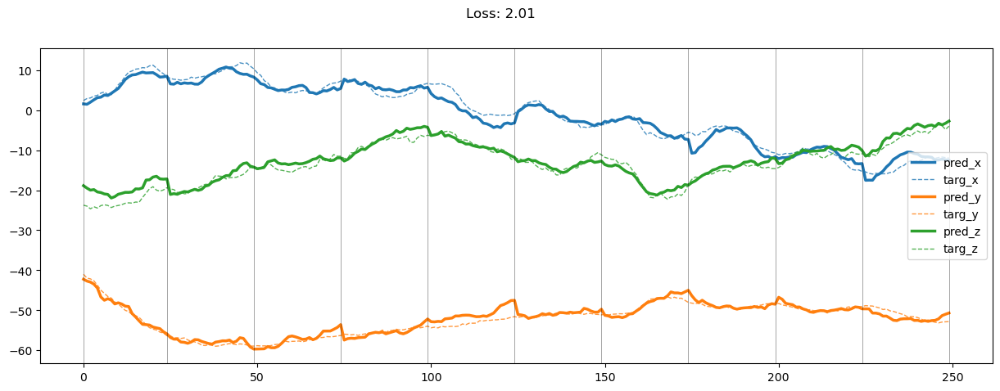

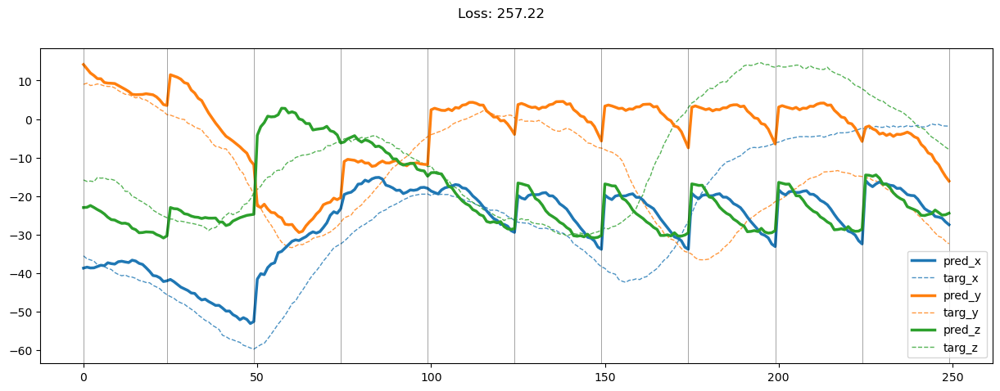

00999: train pred loss:  1.596, g loss:  4.974, diff loss:  3.095, d loss:  1.686
       valid pred loss:  166.321, g loss:  498.315, diff loss:  331.713, d loss:  1.691


100%|██████████| 17/17 [00:01<00:00, 14.01it/s]


01000: train pred loss:  1.571, g loss:  4.943, diff loss:  3.090, d loss:  1.687
       valid pred loss:  162.291, g loss:  495.189, diff loss:  332.618, d loss:  1.691


100%|██████████| 17/17 [00:01<00:00, 15.21it/s]


01001: train pred loss:  1.560, g loss:  4.864, diff loss:  3.023, d loss:  1.686
       valid pred loss:  168.372, g loss:  516.421, diff loss:  347.767, d loss:  1.687


100%|██████████| 17/17 [00:01<00:00, 15.21it/s]


01002: train pred loss:  1.496, g loss:  4.690, diff loss:  2.908, d loss:  1.678
       valid pred loss:  164.388, g loss:  496.795, diff loss:  332.121, d loss:  1.679


100%|██████████| 17/17 [00:01<00:00, 14.88it/s]


01003: train pred loss:  1.515, g loss:  4.805, diff loss:  3.000, d loss:  1.668
       valid pred loss:  164.659, g loss:  505.121, diff loss:  340.169, d loss:  1.666


100%|██████████| 17/17 [00:01<00:00, 14.30it/s]


01004: train pred loss:  1.536, g loss:  4.835, diff loss:  3.001, d loss:  1.655
       valid pred loss:  161.878, g loss:  497.343, diff loss:  335.165, d loss:  1.650


100%|██████████| 17/17 [00:01<00:00, 14.58it/s]


01005: train pred loss:  1.512, g loss:  4.791, diff loss:  2.972, d loss:  1.638
       valid pred loss:  166.958, g loss:  513.377, diff loss:  346.107, d loss:  1.632


100%|██████████| 17/17 [00:01<00:00, 14.71it/s]


01006: train pred loss:  1.541, g loss:  4.883, diff loss:  3.022, d loss:  1.617
       valid pred loss:  164.044, g loss:  502.248, diff loss:  337.880, d loss:  1.611


100%|██████████| 17/17 [00:01<00:00, 15.09it/s]


01007: train pred loss:  1.507, g loss:  4.792, diff loss:  2.952, d loss:  1.596
       valid pred loss:  166.150, g loss:  515.079, diff loss:  348.590, d loss:  1.588


100%|██████████| 17/17 [00:01<00:00, 15.07it/s]


01008: train pred loss:  1.488, g loss:  4.787, diff loss:  2.952, d loss:  1.574
       valid pred loss:  164.801, g loss:  500.220, diff loss:  335.064, d loss:  1.565


100%|██████████| 17/17 [00:01<00:00, 15.09it/s]


01009: train pred loss:  1.548, g loss:  4.928, diff loss:  3.015, d loss:  1.551
       valid pred loss:  168.337, g loss:  522.381, diff loss:  353.671, d loss:  1.542


100%|██████████| 17/17 [00:01<00:00, 15.15it/s]


01010: train pred loss:  1.544, g loss:  4.933, diff loss:  3.006, d loss:  1.528
       valid pred loss:  165.991, g loss:  503.562, diff loss:  337.180, d loss:  1.521


100%|██████████| 17/17 [00:01<00:00, 15.18it/s]


01011: train pred loss:  1.592, g loss:  5.060, diff loss:  3.066, d loss:  1.507
       valid pred loss:  161.989, g loss:  493.810, diff loss:  331.410, d loss:  1.501


100%|██████████| 17/17 [00:01<00:00, 15.14it/s]


01012: train pred loss:  1.513, g loss:  4.910, diff loss:  2.974, d loss:  1.488
       valid pred loss:  164.654, g loss:  507.555, diff loss:  342.470, d loss:  1.482


100%|██████████| 17/17 [00:01<00:00, 14.82it/s]


01013: train pred loss:  1.544, g loss:  4.971, diff loss:  2.984, d loss:  1.470
       valid pred loss:  167.075, g loss:  514.232, diff loss:  346.704, d loss:  1.465


100%|██████████| 17/17 [00:01<00:00, 15.21it/s]


01014: train pred loss:  1.576, g loss:  5.098, diff loss:  3.057, d loss:  1.455
       valid pred loss:  167.785, g loss:  521.748, diff loss:  353.490, d loss:  1.451


100%|██████████| 17/17 [00:01<00:00, 15.09it/s]


01015: train pred loss:  1.554, g loss:  5.081, diff loss:  3.043, d loss:  1.441
       valid pred loss:  165.144, g loss:  506.799, diff loss:  341.162, d loss:  1.439


100%|██████████| 17/17 [00:01<00:00, 15.22it/s]


01016: train pred loss:  1.467, g loss:  4.877, diff loss:  2.906, d loss:  1.430
       valid pred loss:  163.336, g loss:  503.446, diff loss:  339.599, d loss:  1.429


100%|██████████| 17/17 [00:01<00:00, 15.12it/s]


01017: train pred loss:  1.490, g loss:  4.944, diff loss:  2.934, d loss:  1.422
       valid pred loss:  168.652, g loss:  520.288, diff loss:  351.108, d loss:  1.421


100%|██████████| 17/17 [00:01<00:00, 15.13it/s]


01018: train pred loss:  1.539, g loss:  5.113, diff loss:  3.037, d loss:  1.415
       valid pred loss:  164.688, g loss:  509.912, diff loss:  344.682, d loss:  1.416


100%|██████████| 17/17 [00:01<00:00, 14.47it/s]


01019: train pred loss:  1.534, g loss:  5.083, diff loss:  3.000, d loss:  1.410
       valid pred loss:  165.189, g loss:  512.398, diff loss:  346.656, d loss:  1.412


100%|██████████| 17/17 [00:01<00:00, 15.08it/s]


01020: train pred loss:  1.639, g loss:  5.331, diff loss:  3.132, d loss:  1.406
       valid pred loss:  166.454, g loss:  518.832, diff loss:  351.817, d loss:  1.409


100%|██████████| 17/17 [00:01<00:00, 15.15it/s]


01021: train pred loss:  1.560, g loss:  5.157, diff loss:  3.030, d loss:  1.404
       valid pred loss:  166.003, g loss:  517.508, diff loss:  350.939, d loss:  1.407


100%|██████████| 17/17 [00:01<00:00, 15.12it/s]


01022: train pred loss:  1.439, g loss:  4.795, diff loss:  2.788, d loss:  1.403
       valid pred loss:  164.215, g loss:  507.907, diff loss:  343.125, d loss:  1.406


100%|██████████| 17/17 [00:01<00:00, 15.14it/s]


01023: train pred loss:  1.425, g loss:  4.768, diff loss:  2.775, d loss:  1.404
       valid pred loss:  166.402, g loss:  514.394, diff loss:  347.429, d loss:  1.408


100%|██████████| 17/17 [00:01<00:00, 15.12it/s]


01024: train pred loss:  1.462, g loss:  4.924, diff loss:  2.900, d loss:  1.406
       valid pred loss:  164.535, g loss:  502.079, diff loss:  336.988, d loss:  1.410


100%|██████████| 17/17 [00:01<00:00, 15.09it/s]


01025: train pred loss:  1.411, g loss:  4.721, diff loss:  2.758, d loss:  1.408
       valid pred loss:  164.984, g loss:  506.246, diff loss:  340.718, d loss:  1.414


100%|██████████| 17/17 [00:01<00:00, 15.10it/s]


01026: train pred loss:  1.395, g loss:  4.634, diff loss:  2.699, d loss:  1.413
       valid pred loss:  165.977, g loss:  509.056, diff loss:  342.548, d loss:  1.420


100%|██████████| 17/17 [00:01<00:00, 14.96it/s]


01027: train pred loss:  1.376, g loss:  4.610, diff loss:  2.710, d loss:  1.420
       valid pred loss:  166.253, g loss:  513.662, diff loss:  346.897, d loss:  1.428


100%|██████████| 17/17 [00:01<00:00, 15.16it/s]


01028: train pred loss:  1.358, g loss:  4.589, diff loss:  2.726, d loss:  1.429
       valid pred loss:  167.399, g loss:  519.185, diff loss:  351.292, d loss:  1.438


100%|██████████| 17/17 [00:01<00:00, 15.18it/s]


01029: train pred loss:  1.440, g loss:  4.746, diff loss:  2.821, d loss:  1.441
       valid pred loss:  162.486, g loss:  504.017, diff loss:  341.058, d loss:  1.451


100%|██████████| 17/17 [00:01<00:00, 14.18it/s]


01030: train pred loss:  1.487, g loss:  4.840, diff loss:  2.889, d loss:  1.454
       valid pred loss:  166.450, g loss:  513.596, diff loss:  346.694, d loss:  1.467


100%|██████████| 17/17 [00:01<00:00, 15.19it/s]


01031: train pred loss:  1.449, g loss:  4.654, diff loss:  2.763, d loss:  1.471
       valid pred loss:  167.420, g loss:  516.813, diff loss:  348.964, d loss:  1.484


100%|██████████| 17/17 [00:01<00:00, 15.24it/s]


01032: train pred loss:  1.394, g loss:  4.563, diff loss:  2.748, d loss:  1.488
       valid pred loss:  164.923, g loss:  505.774, diff loss:  340.442, d loss:  1.503


100%|██████████| 17/17 [00:01<00:00, 15.23it/s]


01033: train pred loss:  1.390, g loss:  4.498, diff loss:  2.707, d loss:  1.508
       valid pred loss:  166.508, g loss:  512.834, diff loss:  345.938, d loss:  1.524


100%|██████████| 17/17 [00:01<00:00, 15.24it/s]


01034: train pred loss:  1.388, g loss:  4.526, diff loss:  2.757, d loss:  1.529
       valid pred loss:  165.598, g loss:  510.326, diff loss:  344.358, d loss:  1.545


100%|██████████| 17/17 [00:01<00:00, 15.24it/s]


01035: train pred loss:  1.432, g loss:  4.626, diff loss:  2.830, d loss:  1.552
       valid pred loss:  164.981, g loss:  513.112, diff loss:  347.778, d loss:  1.568


100%|██████████| 17/17 [00:01<00:00, 15.12it/s]


01036: train pred loss:  1.502, g loss:  4.738, diff loss:  2.889, d loss:  1.575
       valid pred loss:  166.803, g loss:  517.555, diff loss:  350.415, d loss:  1.590


100%|██████████| 17/17 [00:01<00:00, 13.71it/s]


01037: train pred loss:  1.476, g loss:  4.699, diff loss:  2.891, d loss:  1.596
       valid pred loss:  166.024, g loss:  514.474, diff loss:  348.126, d loss:  1.612


100%|██████████| 17/17 [00:01<00:00, 15.14it/s]


01038: train pred loss:  1.451, g loss:  4.579, diff loss:  2.809, d loss:  1.617
       valid pred loss:  169.358, g loss:  515.374, diff loss:  345.706, d loss:  1.633


100%|██████████| 17/17 [00:01<00:00, 15.18it/s]


01039: train pred loss:  1.380, g loss:  4.372, diff loss:  2.686, d loss:  1.638
       valid pred loss:  166.936, g loss:  515.833, diff loss:  348.597, d loss:  1.653


100%|██████████| 17/17 [00:01<00:00, 14.79it/s]


01040: train pred loss:  1.348, g loss:  4.252, diff loss:  2.607, d loss:  1.656
       valid pred loss:  171.076, g loss:  524.913, diff loss:  353.546, d loss:  1.670


100%|██████████| 17/17 [00:01<00:00, 15.09it/s]


01041: train pred loss:  1.355, g loss:  4.291, diff loss:  2.646, d loss:  1.672
       valid pred loss:  170.791, g loss:  528.706, diff loss:  357.632, d loss:  1.685


100%|██████████| 17/17 [00:01<00:00, 15.03it/s]


01042: train pred loss:  1.364, g loss:  4.301, diff loss:  2.654, d loss:  1.685
       valid pred loss:  168.269, g loss:  520.538, diff loss:  351.991, d loss:  1.698


100%|██████████| 17/17 [00:01<00:00, 15.22it/s]


01043: train pred loss:  1.405, g loss:  4.470, diff loss:  2.787, d loss:  1.695
       valid pred loss:  167.544, g loss:  519.025, diff loss:  351.206, d loss:  1.705


100%|██████████| 17/17 [00:01<00:00, 14.54it/s]


01044: train pred loss:  1.369, g loss:  4.332, diff loss:  2.688, d loss:  1.703
       valid pred loss:  167.134, g loss:  514.717, diff loss:  347.312, d loss:  1.711


100%|██████████| 17/17 [00:01<00:00, 14.96it/s]


01045: train pred loss:  1.403, g loss:  4.385, diff loss:  2.709, d loss:  1.707
       valid pred loss:  164.743, g loss:  509.672, diff loss:  344.658, d loss:  1.711


100%|██████████| 17/17 [00:01<00:00, 15.19it/s]


01046: train pred loss:  1.370, g loss:  4.309, diff loss:  2.665, d loss:  1.705
       valid pred loss:  165.246, g loss:  511.800, diff loss:  346.282, d loss:  1.709


100%|██████████| 17/17 [00:01<00:00, 15.17it/s]


01047: train pred loss:  1.375, g loss:  4.345, diff loss:  2.696, d loss:  1.701
       valid pred loss:  166.056, g loss:  510.650, diff loss:  344.319, d loss:  1.703


100%|██████████| 17/17 [00:01<00:00, 15.17it/s]


01048: train pred loss:  1.376, g loss:  4.358, diff loss:  2.703, d loss:  1.692
       valid pred loss:  166.492, g loss:  509.477, diff loss:  342.705, d loss:  1.693


100%|██████████| 17/17 [00:01<00:00, 14.61it/s]


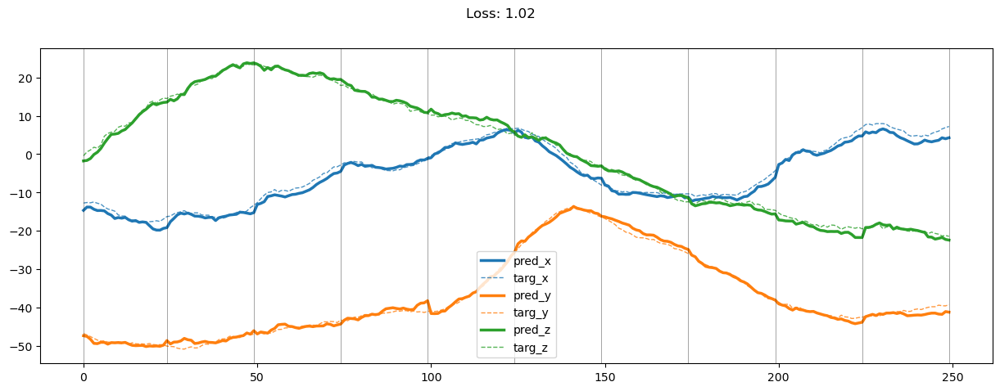

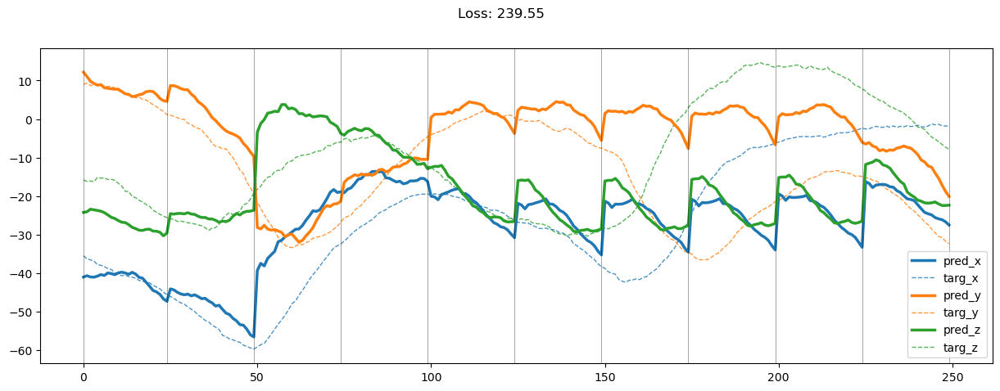

01049: train pred loss:  1.397, g loss:  4.416, diff loss:  2.734, d loss:  1.681
       valid pred loss:  163.270, g loss:  499.898, diff loss:  336.341, d loss:  1.679


100%|██████████| 17/17 [00:01<00:00, 15.13it/s]


01050: train pred loss:  1.447, g loss:  4.494, diff loss:  2.755, d loss:  1.665
       valid pred loss:  161.589, g loss:  492.123, diff loss:  330.240, d loss:  1.663


100%|██████████| 17/17 [00:01<00:00, 15.18it/s]


01051: train pred loss:  1.439, g loss:  4.552, diff loss:  2.811, d loss:  1.647
       valid pred loss:  165.469, g loss:  510.141, diff loss:  344.367, d loss:  1.643


100%|██████████| 17/17 [00:01<00:00, 15.17it/s]


01052: train pred loss:  1.504, g loss:  4.708, diff loss:  2.891, d loss:  1.628
       valid pred loss:  163.850, g loss:  510.480, diff loss:  346.312, d loss:  1.622


100%|██████████| 17/17 [00:01<00:00, 14.33it/s]


01053: train pred loss:  1.440, g loss:  4.614, diff loss:  2.848, d loss:  1.606
       valid pred loss:  164.310, g loss:  508.595, diff loss:  343.954, d loss:  1.600


100%|██████████| 17/17 [00:01<00:00, 14.51it/s]


01054: train pred loss:  1.468, g loss:  4.661, diff loss:  2.852, d loss:  1.582
       valid pred loss:  165.237, g loss:  510.092, diff loss:  344.509, d loss:  1.578


100%|██████████| 17/17 [00:01<00:00, 14.50it/s]


01055: train pred loss:  1.428, g loss:  4.584, diff loss:  2.799, d loss:  1.561
       valid pred loss:  163.728, g loss:  509.057, diff loss:  344.965, d loss:  1.555


100%|██████████| 17/17 [00:01<00:00, 15.22it/s]


01056: train pred loss:  1.424, g loss:  4.555, diff loss:  2.756, d loss:  1.538
       valid pred loss:  163.472, g loss:  507.982, diff loss:  344.127, d loss:  1.533


100%|██████████| 17/17 [00:01<00:00, 15.21it/s]


01057: train pred loss:  1.430, g loss:  4.608, diff loss:  2.785, d loss:  1.517
       valid pred loss:  163.584, g loss:  508.439, diff loss:  344.455, d loss:  1.512


100%|██████████| 17/17 [00:01<00:00, 15.20it/s]


01058: train pred loss:  1.458, g loss:  4.656, diff loss:  2.786, d loss:  1.498
       valid pred loss:  164.160, g loss:  505.056, diff loss:  340.475, d loss:  1.493


100%|██████████| 17/17 [00:01<00:00, 15.25it/s]


01059: train pred loss:  1.490, g loss:  4.734, diff loss:  2.811, d loss:  1.478
       valid pred loss:  164.893, g loss:  505.104, diff loss:  339.770, d loss:  1.475


100%|██████████| 17/17 [00:01<00:00, 15.28it/s]


01060: train pred loss:  1.456, g loss:  4.697, diff loss:  2.789, d loss:  1.463
       valid pred loss:  162.124, g loss:  497.422, diff loss:  334.837, d loss:  1.460


100%|██████████| 17/17 [00:01<00:00, 15.28it/s]


01061: train pred loss:  1.433, g loss:  4.700, diff loss:  2.793, d loss:  1.449
       valid pred loss:  162.128, g loss:  494.361, diff loss:  331.752, d loss:  1.446


100%|██████████| 17/17 [00:01<00:00, 15.26it/s]


01062: train pred loss:  1.368, g loss:  4.521, diff loss:  2.659, d loss:  1.436
       valid pred loss:  166.133, g loss:  512.578, diff loss:  345.944, d loss:  1.436


100%|██████████| 17/17 [00:01<00:00, 15.26it/s]


01063: train pred loss:  1.340, g loss:  4.487, diff loss:  2.635, d loss:  1.426
       valid pred loss:  165.774, g loss:  508.915, diff loss:  342.623, d loss:  1.427


100%|██████████| 17/17 [00:01<00:00, 15.26it/s]


01064: train pred loss:  1.352, g loss:  4.541, diff loss:  2.660, d loss:  1.419
       valid pred loss:  165.231, g loss:  497.555, diff loss:  331.789, d loss:  1.419


100%|██████████| 17/17 [00:01<00:00, 15.27it/s]


01065: train pred loss:  1.386, g loss:  4.627, diff loss:  2.697, d loss:  1.412
       valid pred loss:  165.100, g loss:  498.599, diff loss:  332.950, d loss:  1.413


100%|██████████| 17/17 [00:01<00:00, 15.27it/s]


01066: train pred loss:  1.321, g loss:  4.449, diff loss:  2.570, d loss:  1.408
       valid pred loss:  166.698, g loss:  513.636, diff loss:  346.376, d loss:  1.408


100%|██████████| 17/17 [00:01<00:00, 15.26it/s]


01067: train pred loss:  1.358, g loss:  4.574, diff loss:  2.648, d loss:  1.404
       valid pred loss:  169.079, g loss:  518.543, diff loss:  348.894, d loss:  1.407


100%|██████████| 17/17 [00:01<00:00, 15.11it/s]


01068: train pred loss:  1.372, g loss:  4.640, diff loss:  2.692, d loss:  1.403
       valid pred loss:  165.626, g loss:  506.819, diff loss:  340.617, d loss:  1.405


100%|██████████| 17/17 [00:01<00:00, 15.26it/s]


01069: train pred loss:  1.423, g loss:  4.774, diff loss:  2.771, d loss:  1.401
       valid pred loss:  162.022, g loss:  496.362, diff loss:  333.762, d loss:  1.404


100%|██████████| 17/17 [00:01<00:00, 15.22it/s]


01070: train pred loss:  1.506, g loss:  5.028, diff loss:  2.942, d loss:  1.401
       valid pred loss:  163.302, g loss:  507.214, diff loss:  343.335, d loss:  1.404


100%|██████████| 17/17 [00:01<00:00, 15.07it/s]


01071: train pred loss:  1.467, g loss:  4.905, diff loss:  2.861, d loss:  1.402
       valid pred loss:  163.693, g loss:  493.677, diff loss:  329.413, d loss:  1.406


100%|██████████| 17/17 [00:01<00:00, 15.18it/s]


01072: train pred loss:  1.462, g loss:  4.826, diff loss:  2.795, d loss:  1.404
       valid pred loss:  164.658, g loss:  504.003, diff loss:  338.783, d loss:  1.409


100%|██████████| 17/17 [00:01<00:00, 15.20it/s]


01073: train pred loss:  1.422, g loss:  4.808, diff loss:  2.827, d loss:  1.407
       valid pred loss:  166.526, g loss:  509.184, diff loss:  342.107, d loss:  1.412


100%|██████████| 17/17 [00:01<00:00, 15.23it/s]


01074: train pred loss:  1.357, g loss:  4.552, diff loss:  2.650, d loss:  1.412
       valid pred loss:  167.882, g loss:  519.513, diff loss:  351.096, d loss:  1.419


100%|██████████| 17/17 [00:01<00:00, 15.25it/s]


01075: train pred loss:  1.429, g loss:  4.763, diff loss:  2.806, d loss:  1.419
       valid pred loss:  169.243, g loss:  526.400, diff loss:  356.640, d loss:  1.426


100%|██████████| 17/17 [00:01<00:00, 15.29it/s]


01076: train pred loss:  1.574, g loss:  5.159, diff loss:  3.074, d loss:  1.427
       valid pred loss:  169.420, g loss:  516.181, diff loss:  346.264, d loss:  1.436


100%|██████████| 17/17 [00:01<00:00, 15.24it/s]


01077: train pred loss:  1.510, g loss:  4.933, diff loss:  2.932, d loss:  1.438
       valid pred loss:  166.650, g loss:  513.273, diff loss:  346.145, d loss:  1.449


100%|██████████| 17/17 [00:01<00:00, 14.45it/s]


01078: train pred loss:  1.571, g loss:  5.140, diff loss:  3.099, d loss:  1.451
       valid pred loss:  167.764, g loss:  513.879, diff loss:  345.659, d loss:  1.463


100%|██████████| 17/17 [00:01<00:00, 15.23it/s]


01079: train pred loss:  2.280, g loss:  7.071, diff loss:  4.343, d loss:  1.466
       valid pred loss:  194.038, g loss:  570.993, diff loss:  376.519, d loss:  1.479


100%|██████████| 17/17 [00:01<00:00, 15.23it/s]


01080: train pred loss:  5.102, g loss:  15.093, diff loss:  9.562, d loss:  1.483
       valid pred loss:  259.082, g loss:  707.895, diff loss:  448.398, d loss:  1.497


100%|██████████| 17/17 [00:01<00:00, 14.74it/s]


01081: train pred loss:  7.996, g loss:  22.903, diff loss:  14.498, d loss:  1.501
       valid pred loss:  214.671, g loss:  618.746, diff loss:  403.680, d loss:  1.517


100%|██████████| 17/17 [00:01<00:00, 15.19it/s]


01082: train pred loss:  10.514, g loss:  30.690, diff loss:  19.786, d loss:  1.521
       valid pred loss:  265.473, g loss:  729.163, diff loss:  463.313, d loss:  1.538


100%|██████████| 17/17 [00:01<00:00, 14.86it/s]


01083: train pred loss:  10.594, g loss:  31.015, diff loss:  20.050, d loss:  1.543
       valid pred loss:  214.472, g loss:  596.451, diff loss:  381.620, d loss:  1.559


100%|██████████| 17/17 [00:01<00:00, 15.21it/s]


01084: train pred loss:  7.959, g loss:  23.699, diff loss:  15.386, d loss:  1.564
       valid pred loss:  188.464, g loss:  530.666, diff loss:  341.858, d loss:  1.579


100%|██████████| 17/17 [00:01<00:00, 15.22it/s]


01085: train pred loss:  5.935, g loss:  17.436, diff loss:  11.162, d loss:  1.587
       valid pred loss:  172.003, g loss:  499.080, diff loss:  326.749, d loss:  1.604


100%|██████████| 17/17 [00:01<00:00, 15.14it/s]


01086: train pred loss:  4.091, g loss:  12.261, diff loss:  7.845, d loss:  1.608
       valid pred loss:  177.062, g loss:  507.682, diff loss:  330.303, d loss:  1.624


100%|██████████| 17/17 [00:01<00:00, 15.20it/s]


01087: train pred loss:  3.054, g loss:  9.281, diff loss:  5.915, d loss:  1.628
       valid pred loss:  174.911, g loss:  504.326, diff loss:  329.110, d loss:  1.646


100%|██████████| 17/17 [00:01<00:00, 15.20it/s]


01088: train pred loss:  2.533, g loss:  7.798, diff loss:  4.963, d loss:  1.648
       valid pred loss:  175.011, g loss:  504.324, diff loss:  329.018, d loss:  1.663


100%|██████████| 17/17 [00:01<00:00, 15.12it/s]


01089: train pred loss:  2.199, g loss:  6.843, diff loss:  4.353, d loss:  1.667
       valid pred loss:  170.436, g loss:  490.750, diff loss:  320.027, d loss:  1.680


100%|██████████| 17/17 [00:01<00:00, 14.63it/s]


01090: train pred loss:  2.065, g loss:  6.377, diff loss:  4.027, d loss:  1.682
       valid pred loss:  175.659, g loss:  508.267, diff loss:  332.330, d loss:  1.696


100%|██████████| 17/17 [00:01<00:00, 14.81it/s]


01091: train pred loss:  1.936, g loss:  6.065, diff loss:  3.852, d loss:  1.696
       valid pred loss:  173.403, g loss:  506.393, diff loss:  332.716, d loss:  1.707


100%|██████████| 17/17 [00:01<00:00, 14.84it/s]


01092: train pred loss:  1.912, g loss:  5.908, diff loss:  3.724, d loss:  1.706
       valid pred loss:  173.316, g loss:  509.053, diff loss:  335.468, d loss:  1.717


100%|██████████| 17/17 [00:01<00:00, 15.09it/s]


01093: train pred loss:  1.784, g loss:  5.596, diff loss:  3.543, d loss:  1.713
       valid pred loss:  175.304, g loss:  510.536, diff loss:  334.966, d loss:  1.722


100%|██████████| 17/17 [00:01<00:00, 15.16it/s]


01094: train pred loss:  1.667, g loss:  5.193, diff loss:  3.258, d loss:  1.719
       valid pred loss:  171.880, g loss:  504.668, diff loss:  332.523, d loss:  1.725


100%|██████████| 17/17 [00:01<00:00, 15.02it/s]


01095: train pred loss:  1.584, g loss:  5.005, diff loss:  3.155, d loss:  1.720
       valid pred loss:  172.512, g loss:  507.580, diff loss:  334.802, d loss:  1.725


100%|██████████| 17/17 [00:01<00:00, 15.16it/s]


01096: train pred loss:  1.610, g loss:  5.115, diff loss:  3.238, d loss:  1.717
       valid pred loss:  168.732, g loss:  493.083, diff loss:  324.084, d loss:  1.721


100%|██████████| 17/17 [00:01<00:00, 15.16it/s]


01097: train pred loss:  1.567, g loss:  4.896, diff loss:  3.059, d loss:  1.712
       valid pred loss:  170.634, g loss:  502.938, diff loss:  332.034, d loss:  1.712


100%|██████████| 17/17 [00:01<00:00, 15.16it/s]


01098: train pred loss:  1.506, g loss:  4.779, diff loss:  2.999, d loss:  1.702
       valid pred loss:  168.754, g loss:  497.703, diff loss:  328.674, d loss:  1.703


100%|██████████| 17/17 [00:01<00:00, 15.18it/s]


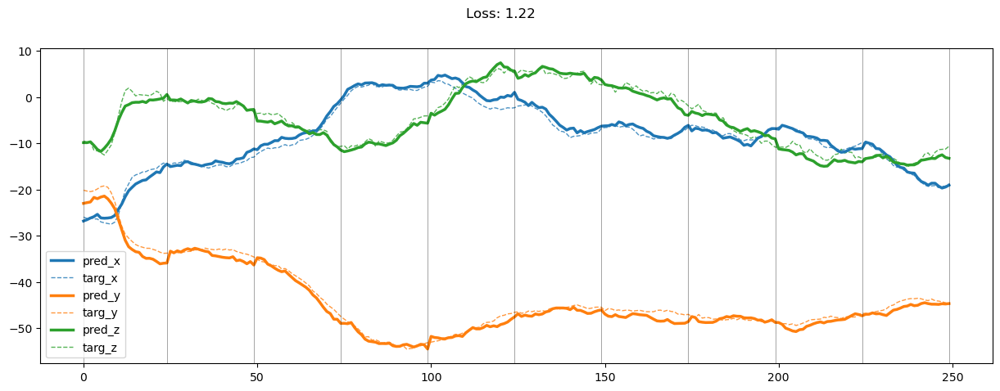

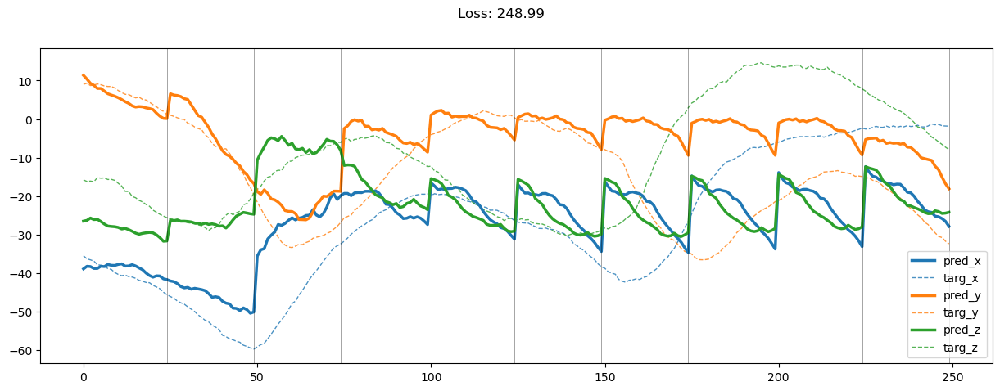

01099: train pred loss:  1.449, g loss:  4.606, diff loss:  2.877, d loss:  1.690
       valid pred loss:  169.370, g loss:  496.538, diff loss:  326.887, d loss:  1.688


100%|██████████| 17/17 [00:01<00:00, 15.20it/s]


01100: train pred loss:  1.445, g loss:  4.581, diff loss:  2.849, d loss:  1.676
       valid pred loss:  167.385, g loss:  492.383, diff loss:  324.709, d loss:  1.672


100%|██████████| 17/17 [00:01<00:00, 14.53it/s]


01101: train pred loss:  1.429, g loss:  4.553, diff loss:  2.828, d loss:  1.659
       valid pred loss:  169.093, g loss:  496.332, diff loss:  326.941, d loss:  1.654


100%|██████████| 17/17 [00:01<00:00, 14.93it/s]


01102: train pred loss:  1.399, g loss:  4.501, diff loss:  2.796, d loss:  1.639
       valid pred loss:  169.138, g loss:  496.993, diff loss:  327.545, d loss:  1.633


100%|██████████| 17/17 [00:01<00:00, 15.28it/s]


01103: train pred loss:  1.372, g loss:  4.414, diff loss:  2.723, d loss:  1.618
       valid pred loss:  169.318, g loss:  496.252, diff loss:  326.611, d loss:  1.612


100%|██████████| 17/17 [00:01<00:00, 15.28it/s]


01104: train pred loss:  1.382, g loss:  4.429, diff loss:  2.715, d loss:  1.597
       valid pred loss:  169.907, g loss:  499.295, diff loss:  329.051, d loss:  1.591


100%|██████████| 17/17 [00:01<00:00, 15.28it/s]


01105: train pred loss:  1.345, g loss:  4.360, diff loss:  2.668, d loss:  1.574
       valid pred loss:  167.143, g loss:  491.285, diff loss:  323.789, d loss:  1.567


100%|██████████| 17/17 [00:01<00:00, 15.27it/s]


01106: train pred loss:  1.342, g loss:  4.392, diff loss:  2.686, d loss:  1.552
       valid pred loss:  166.641, g loss:  488.648, diff loss:  321.637, d loss:  1.546


100%|██████████| 17/17 [00:01<00:00, 15.23it/s]


01107: train pred loss:  1.354, g loss:  4.417, diff loss:  2.683, d loss:  1.531
       valid pred loss:  168.697, g loss:  494.968, diff loss:  325.883, d loss:  1.525


100%|██████████| 17/17 [00:01<00:00, 15.23it/s]


01108: train pred loss:  1.331, g loss:  4.375, diff loss:  2.645, d loss:  1.511
       valid pred loss:  168.253, g loss:  496.099, diff loss:  327.439, d loss:  1.505


100%|██████████| 17/17 [00:01<00:00, 15.26it/s]


01109: train pred loss:  1.300, g loss:  4.288, diff loss:  2.571, d loss:  1.493
       valid pred loss:  169.646, g loss:  498.987, diff loss:  328.916, d loss:  1.487


100%|██████████| 17/17 [00:01<00:00, 15.24it/s]


01110: train pred loss:  1.324, g loss:  4.364, diff loss:  2.603, d loss:  1.475
       valid pred loss:  169.380, g loss:  500.575, diff loss:  330.749, d loss:  1.471


100%|██████████| 17/17 [00:01<00:00, 15.25it/s]


01111: train pred loss:  1.325, g loss:  4.401, diff loss:  2.619, d loss:  1.460
       valid pred loss:  167.784, g loss:  494.841, diff loss:  326.591, d loss:  1.456


100%|██████████| 17/17 [00:01<00:00, 15.24it/s]


01112: train pred loss:  1.289, g loss:  4.333, diff loss:  2.567, d loss:  1.446
       valid pred loss:  166.826, g loss:  493.043, diff loss:  325.732, d loss:  1.444


100%|██████████| 17/17 [00:01<00:00, 15.24it/s]


01113: train pred loss:  1.315, g loss:  4.431, diff loss:  2.620, d loss:  1.435
       valid pred loss:  170.285, g loss:  503.098, diff loss:  332.309, d loss:  1.433


100%|██████████| 17/17 [00:01<00:00, 15.24it/s]


01114: train pred loss:  1.291, g loss:  4.377, diff loss:  2.572, d loss:  1.426
       valid pred loss:  169.028, g loss:  499.336, diff loss:  329.788, d loss:  1.425


100%|██████████| 17/17 [00:01<00:00, 15.23it/s]


01115: train pred loss:  1.262, g loss:  4.309, diff loss:  2.516, d loss:  1.418
       valid pred loss:  169.534, g loss:  497.541, diff loss:  327.470, d loss:  1.418


100%|██████████| 17/17 [00:01<00:00, 15.02it/s]


01116: train pred loss:  1.271, g loss:  4.337, diff loss:  2.519, d loss:  1.411
       valid pred loss:  166.525, g loss:  492.887, diff loss:  325.809, d loss:  1.412


100%|██████████| 17/17 [00:01<00:00, 15.25it/s]


01117: train pred loss:  1.287, g loss:  4.407, diff loss:  2.560, d loss:  1.407
       valid pred loss:  166.839, g loss:  488.396, diff loss:  320.991, d loss:  1.408


100%|██████████| 17/17 [00:01<00:00, 15.19it/s]


01118: train pred loss:  1.268, g loss:  4.322, diff loss:  2.482, d loss:  1.403
       valid pred loss:  168.536, g loss:  492.310, diff loss:  323.199, d loss:  1.404


100%|██████████| 17/17 [00:01<00:00, 15.19it/s]


01119: train pred loss:  1.237, g loss:  4.260, diff loss:  2.442, d loss:  1.400
       valid pred loss:  168.541, g loss:  495.899, diff loss:  326.777, d loss:  1.403


100%|██████████| 17/17 [00:01<00:00, 15.23it/s]


01120: train pred loss:  1.245, g loss:  4.286, diff loss:  2.455, d loss:  1.399
       valid pred loss:  169.786, g loss:  496.965, diff loss:  326.594, d loss:  1.402


100%|██████████| 17/17 [00:01<00:00, 14.60it/s]


01121: train pred loss:  1.234, g loss:  4.268, diff loss:  2.445, d loss:  1.398
       valid pred loss:  167.797, g loss:  498.371, diff loss:  329.987, d loss:  1.401


100%|██████████| 17/17 [00:01<00:00, 15.06it/s]


01122: train pred loss:  1.245, g loss:  4.304, diff loss:  2.470, d loss:  1.398
       valid pred loss:  166.816, g loss:  490.747, diff loss:  323.346, d loss:  1.402


100%|██████████| 17/17 [00:01<00:00, 15.21it/s]


01123: train pred loss:  1.287, g loss:  4.423, diff loss:  2.552, d loss:  1.399
       valid pred loss:  167.888, g loss:  498.209, diff loss:  329.742, d loss:  1.403


100%|██████████| 17/17 [00:01<00:00, 15.27it/s]


01124: train pred loss:  1.253, g loss:  4.266, diff loss:  2.436, d loss:  1.401
       valid pred loss:  169.048, g loss:  500.266, diff loss:  330.649, d loss:  1.406


100%|██████████| 17/17 [00:01<00:00, 15.20it/s]


01125: train pred loss:  1.253, g loss:  4.279, diff loss:  2.460, d loss:  1.405
       valid pred loss:  167.447, g loss:  494.470, diff loss:  326.465, d loss:  1.410


100%|██████████| 17/17 [00:01<00:00, 15.23it/s]


01126: train pred loss:  1.275, g loss:  4.288, diff loss:  2.460, d loss:  1.409
       valid pred loss:  169.258, g loss:  503.315, diff loss:  333.514, d loss:  1.415


100%|██████████| 17/17 [00:01<00:00, 15.21it/s]


01127: train pred loss:  1.241, g loss:  4.227, diff loss:  2.448, d loss:  1.414
       valid pred loss:  168.044, g loss:  498.393, diff loss:  329.823, d loss:  1.422


100%|██████████| 17/17 [00:01<00:00, 14.68it/s]


01128: train pred loss:  1.215, g loss:  4.142, diff loss:  2.407, d loss:  1.422
       valid pred loss:  166.934, g loss:  491.567, diff loss:  324.125, d loss:  1.431


100%|██████████| 17/17 [00:01<00:00, 14.24it/s]


01129: train pred loss:  1.223, g loss:  4.131, diff loss:  2.408, d loss:  1.432
       valid pred loss:  168.273, g loss:  500.700, diff loss:  331.938, d loss:  1.441


100%|██████████| 17/17 [00:01<00:00, 14.65it/s]


01130: train pred loss:  1.208, g loss:  4.085, diff loss:  2.397, d loss:  1.444
       valid pred loss:  167.200, g loss:  494.315, diff loss:  326.647, d loss:  1.453


100%|██████████| 17/17 [00:01<00:00, 15.25it/s]


01131: train pred loss:  1.186, g loss:  3.978, diff loss:  2.331, d loss:  1.457
       valid pred loss:  169.744, g loss:  503.660, diff loss:  333.467, d loss:  1.468


100%|██████████| 17/17 [00:01<00:00, 15.25it/s]


01132: train pred loss:  1.207, g loss:  4.008, diff loss:  2.360, d loss:  1.472
       valid pred loss:  170.855, g loss:  504.363, diff loss:  333.079, d loss:  1.484


100%|██████████| 17/17 [00:01<00:00, 15.25it/s]


01133: train pred loss:  1.219, g loss:  4.059, diff loss:  2.420, d loss:  1.490
       valid pred loss:  169.748, g loss:  497.418, diff loss:  327.260, d loss:  1.502


100%|██████████| 17/17 [00:01<00:00, 15.25it/s]


01134: train pred loss:  1.247, g loss:  4.066, diff loss:  2.417, d loss:  1.507
       valid pred loss:  170.992, g loss:  500.696, diff loss:  329.313, d loss:  1.521


100%|██████████| 17/17 [00:01<00:00, 15.23it/s]


01135: train pred loss:  1.216, g loss:  3.992, diff loss:  2.391, d loss:  1.527
       valid pred loss:  169.601, g loss:  499.424, diff loss:  329.450, d loss:  1.541


100%|██████████| 17/17 [00:01<00:00, 14.85it/s]


01136: train pred loss:  1.203, g loss:  3.946, diff loss:  2.376, d loss:  1.547
       valid pred loss:  168.441, g loss:  494.066, diff loss:  325.268, d loss:  1.562


100%|██████████| 17/17 [00:01<00:00, 15.18it/s]


01137: train pred loss:  1.233, g loss:  4.032, diff loss:  2.447, d loss:  1.568
       valid pred loss:  167.566, g loss:  493.639, diff loss:  325.731, d loss:  1.583


100%|██████████| 17/17 [00:01<00:00, 15.20it/s]


01138: train pred loss:  1.207, g loss:  3.902, diff loss:  2.359, d loss:  1.589
       valid pred loss:  167.677, g loss:  496.569, diff loss:  328.563, d loss:  1.603


100%|██████████| 17/17 [00:01<00:00, 15.21it/s]


01139: train pred loss:  1.170, g loss:  3.808, diff loss:  2.315, d loss:  1.609
       valid pred loss:  168.701, g loss:  497.312, diff loss:  328.295, d loss:  1.624


100%|██████████| 17/17 [00:01<00:00, 13.79it/s]


01140: train pred loss:  1.204, g loss:  3.866, diff loss:  2.350, d loss:  1.629
       valid pred loss:  167.276, g loss:  494.069, diff loss:  326.488, d loss:  1.643


100%|██████████| 17/17 [00:01<00:00, 14.91it/s]


01141: train pred loss:  1.193, g loss:  3.844, diff loss:  2.349, d loss:  1.648
       valid pred loss:  167.575, g loss:  492.374, diff loss:  324.503, d loss:  1.661


100%|██████████| 17/17 [00:01<00:00, 15.22it/s]


01142: train pred loss:  1.178, g loss:  3.810, diff loss:  2.340, d loss:  1.666
       valid pred loss:  168.171, g loss:  494.964, diff loss:  326.507, d loss:  1.678


100%|██████████| 17/17 [00:01<00:00, 14.57it/s]


01143: train pred loss:  1.220, g loss:  3.913, diff loss:  2.409, d loss:  1.681
       valid pred loss:  169.000, g loss:  499.366, diff loss:  330.086, d loss:  1.693


100%|██████████| 17/17 [00:01<00:00, 14.27it/s]


01144: train pred loss:  1.188, g loss:  3.797, diff loss:  2.332, d loss:  1.695
       valid pred loss:  167.728, g loss:  498.988, diff loss:  330.986, d loss:  1.706


100%|██████████| 17/17 [00:01<00:00, 14.10it/s]


01145: train pred loss:  1.223, g loss:  3.891, diff loss:  2.396, d loss:  1.707
       valid pred loss:  167.579, g loss:  502.776, diff loss:  334.927, d loss:  1.716


100%|██████████| 17/17 [00:01<00:00, 14.43it/s]


01146: train pred loss:  1.261, g loss:  3.948, diff loss:  2.418, d loss:  1.716
       valid pred loss:  166.105, g loss:  496.481, diff loss:  330.110, d loss:  1.724


100%|██████████| 17/17 [00:01<00:00, 15.10it/s]


01147: train pred loss:  1.237, g loss:  3.934, diff loss:  2.431, d loss:  1.721
       valid pred loss:  169.457, g loss:  504.566, diff loss:  334.846, d loss:  1.728


100%|██████████| 17/17 [00:01<00:00, 15.10it/s]


01148: train pred loss:  1.210, g loss:  3.853, diff loss:  2.380, d loss:  1.727
       valid pred loss:  168.410, g loss:  499.577, diff loss:  330.905, d loss:  1.730


100%|██████████| 17/17 [00:01<00:00, 15.11it/s]


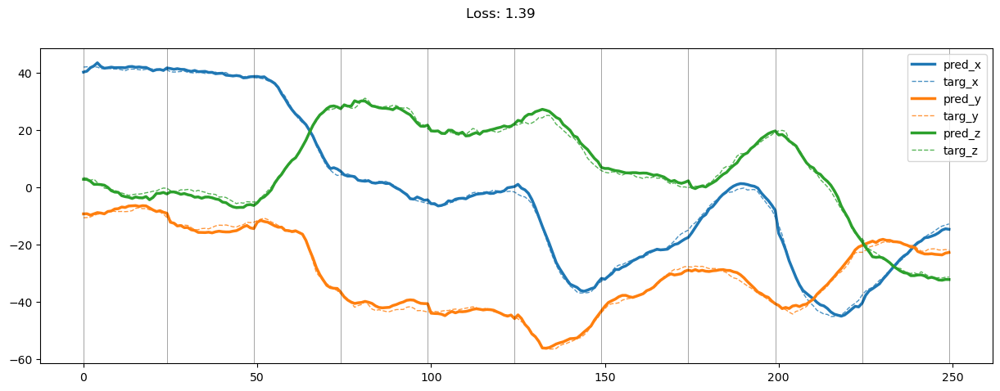

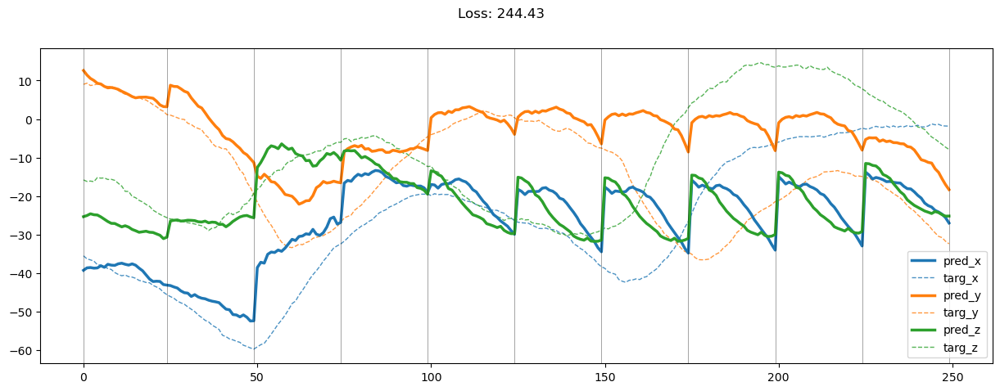

01149: train pred loss:  1.207, g loss:  3.816, diff loss:  2.346, d loss:  1.727
       valid pred loss:  169.344, g loss:  505.279, diff loss:  335.672, d loss:  1.729


100%|██████████| 17/17 [00:01<00:00, 15.11it/s]


01150: train pred loss:  1.176, g loss:  3.759, diff loss:  2.319, d loss:  1.725
       valid pred loss:  167.939, g loss:  498.968, diff loss:  330.764, d loss:  1.726


100%|██████████| 17/17 [00:01<00:00, 15.15it/s]


01151: train pred loss:  1.165, g loss:  3.750, diff loss:  2.319, d loss:  1.720
       valid pred loss:  169.270, g loss:  503.485, diff loss:  333.948, d loss:  1.719


100%|██████████| 17/17 [00:01<00:00, 14.73it/s]


01152: train pred loss:  1.193, g loss:  3.839, diff loss:  2.377, d loss:  1.712
       valid pred loss:  167.782, g loss:  499.449, diff loss:  331.396, d loss:  1.709


100%|██████████| 17/17 [00:01<00:00, 14.79it/s]


01153: train pred loss:  1.181, g loss:  3.771, diff loss:  2.315, d loss:  1.700
       valid pred loss:  169.016, g loss:  504.854, diff loss:  335.560, d loss:  1.697


100%|██████████| 17/17 [00:01<00:00, 14.98it/s]


01154: train pred loss:  1.171, g loss:  3.762, diff loss:  2.309, d loss:  1.687
       valid pred loss:  170.680, g loss:  511.298, diff loss:  340.334, d loss:  1.682


100%|██████████| 17/17 [00:01<00:00, 15.14it/s]


01155: train pred loss:  1.130, g loss:  3.665, diff loss:  2.246, d loss:  1.672
       valid pred loss:  170.393, g loss:  509.943, diff loss:  339.257, d loss:  1.666


100%|██████████| 17/17 [00:01<00:00, 15.06it/s]


01156: train pred loss:  1.140, g loss:  3.706, diff loss:  2.267, d loss:  1.655
       valid pred loss:  170.553, g loss:  514.410, diff loss:  343.555, d loss:  1.648


100%|██████████| 17/17 [00:01<00:00, 15.14it/s]


01157: train pred loss:  1.175, g loss:  3.782, diff loss:  2.298, d loss:  1.635
       valid pred loss:  168.716, g loss:  511.008, diff loss:  341.979, d loss:  1.628


100%|██████████| 17/17 [00:01<00:00, 14.74it/s]


01158: train pred loss:  1.173, g loss:  3.795, diff loss:  2.302, d loss:  1.615
       valid pred loss:  167.384, g loss:  503.208, diff loss:  335.498, d loss:  1.607


100%|██████████| 17/17 [00:01<00:00, 15.16it/s]


01159: train pred loss:  1.173, g loss:  3.812, diff loss:  2.305, d loss:  1.594
       valid pred loss:  170.822, g loss:  509.442, diff loss:  338.281, d loss:  1.587


100%|██████████| 17/17 [00:01<00:00, 14.26it/s]


01160: train pred loss:  1.170, g loss:  3.820, diff loss:  2.303, d loss:  1.573
       valid pred loss:  167.691, g loss:  502.561, diff loss:  334.516, d loss:  1.565


100%|██████████| 17/17 [00:01<00:00, 14.86it/s]


01161: train pred loss:  1.179, g loss:  3.866, diff loss:  2.323, d loss:  1.552
       valid pred loss:  168.537, g loss:  505.151, diff loss:  336.243, d loss:  1.545


100%|██████████| 17/17 [00:01<00:00, 15.20it/s]


01162: train pred loss:  1.174, g loss:  3.882, diff loss:  2.328, d loss:  1.532
       valid pred loss:  168.164, g loss:  502.181, diff loss:  333.630, d loss:  1.525


100%|██████████| 17/17 [00:01<00:00, 15.17it/s]


01163: train pred loss:  1.172, g loss:  3.848, diff loss:  2.278, d loss:  1.513
       valid pred loss:  168.942, g loss:  504.152, diff loss:  334.806, d loss:  1.507


100%|██████████| 17/17 [00:01<00:00, 15.14it/s]


01164: train pred loss:  1.133, g loss:  3.791, diff loss:  2.242, d loss:  1.495
       valid pred loss:  167.982, g loss:  500.515, diff loss:  332.110, d loss:  1.489


100%|██████████| 17/17 [00:01<00:00, 15.12it/s]


01165: train pred loss:  1.131, g loss:  3.784, diff loss:  2.220, d loss:  1.479
       valid pred loss:  166.390, g loss:  500.443, diff loss:  333.612, d loss:  1.474


100%|██████████| 17/17 [00:01<00:00, 14.32it/s]


01166: train pred loss:  1.147, g loss:  3.844, diff loss:  2.245, d loss:  1.464
       valid pred loss:  168.669, g loss:  506.590, diff loss:  337.461, d loss:  1.459


100%|██████████| 17/17 [00:01<00:00, 14.82it/s]


01167: train pred loss:  1.143, g loss:  3.879, diff loss:  2.266, d loss:  1.450
       valid pred loss:  169.502, g loss:  508.570, diff loss:  338.589, d loss:  1.446


100%|██████████| 17/17 [00:01<00:00, 15.16it/s]


01168: train pred loss:  1.139, g loss:  3.887, diff loss:  2.258, d loss:  1.439
       valid pred loss:  168.292, g loss:  507.694, diff loss:  338.905, d loss:  1.435


100%|██████████| 17/17 [00:01<00:00, 15.16it/s]


01169: train pred loss:  1.141, g loss:  3.883, diff loss:  2.234, d loss:  1.430
       valid pred loss:  171.588, g loss:  517.490, diff loss:  345.388, d loss:  1.426


100%|██████████| 17/17 [00:01<00:00, 15.20it/s]


01170: train pred loss:  1.148, g loss:  3.946, diff loss:  2.274, d loss:  1.421
       valid pred loss:  167.554, g loss:  503.005, diff loss:  334.921, d loss:  1.418


100%|██████████| 17/17 [00:01<00:00, 15.14it/s]


01171: train pred loss:  1.122, g loss:  3.865, diff loss:  2.203, d loss:  1.414
       valid pred loss:  169.662, g loss:  512.211, diff loss:  342.004, d loss:  1.412


100%|██████████| 17/17 [00:01<00:00, 14.63it/s]


01172: train pred loss:  1.148, g loss:  3.940, diff loss:  2.238, d loss:  1.409
       valid pred loss:  168.051, g loss:  506.231, diff loss:  337.622, d loss:  1.408


100%|██████████| 17/17 [00:01<00:00, 14.67it/s]


01173: train pred loss:  1.155, g loss:  4.027, diff loss:  2.305, d loss:  1.404
       valid pred loss:  169.793, g loss:  511.496, diff loss:  341.133, d loss:  1.404


100%|██████████| 17/17 [00:01<00:00, 15.15it/s]


01174: train pred loss:  1.165, g loss:  4.006, diff loss:  2.265, d loss:  1.401
       valid pred loss:  171.725, g loss:  521.044, diff loss:  348.740, d loss:  1.402


100%|██████████| 17/17 [00:01<00:00, 15.10it/s]


01175: train pred loss:  1.170, g loss:  4.064, diff loss:  2.309, d loss:  1.399
       valid pred loss:  166.608, g loss:  504.317, diff loss:  337.123, d loss:  1.401


100%|██████████| 17/17 [00:01<00:00, 14.90it/s]


01176: train pred loss:  1.166, g loss:  3.995, diff loss:  2.239, d loss:  1.398
       valid pred loss:  172.822, g loss:  525.394, diff loss:  351.982, d loss:  1.400


100%|██████████| 17/17 [00:01<00:00, 15.18it/s]


01177: train pred loss:  1.132, g loss:  3.970, diff loss:  2.246, d loss:  1.397
       valid pred loss:  166.727, g loss:  499.417, diff loss:  332.099, d loss:  1.400


100%|██████████| 17/17 [00:01<00:00, 15.18it/s]


01178: train pred loss:  1.155, g loss:  4.039, diff loss:  2.292, d loss:  1.398
       valid pred loss:  165.732, g loss:  495.646, diff loss:  329.325, d loss:  1.399


100%|██████████| 17/17 [00:01<00:00, 15.10it/s]


01179: train pred loss:  1.160, g loss:  4.044, diff loss:  2.296, d loss:  1.399
       valid pred loss:  168.350, g loss:  507.305, diff loss:  338.371, d loss:  1.401


100%|██████████| 17/17 [00:01<00:00, 14.96it/s]


01180: train pred loss:  1.147, g loss:  3.986, diff loss:  2.258, d loss:  1.401
       valid pred loss:  168.255, g loss:  504.873, diff loss:  336.041, d loss:  1.403


100%|██████████| 17/17 [00:01<00:00, 15.17it/s]


01181: train pred loss:  1.127, g loss:  3.928, diff loss:  2.228, d loss:  1.403
       valid pred loss:  168.471, g loss:  506.379, diff loss:  337.341, d loss:  1.406


100%|██████████| 17/17 [00:01<00:00, 15.23it/s]


01182: train pred loss:  1.119, g loss:  3.866, diff loss:  2.186, d loss:  1.407
       valid pred loss:  166.165, g loss:  501.344, diff loss:  334.626, d loss:  1.410


100%|██████████| 17/17 [00:01<00:00, 14.96it/s]


01183: train pred loss:  1.117, g loss:  3.879, diff loss:  2.214, d loss:  1.411
       valid pred loss:  167.190, g loss:  504.541, diff loss:  336.812, d loss:  1.415


100%|██████████| 17/17 [00:01<00:00, 15.21it/s]


01184: train pred loss:  1.183, g loss:  4.016, diff loss:  2.301, d loss:  1.418
       valid pred loss:  168.339, g loss:  504.327, diff loss:  335.466, d loss:  1.422


100%|██████████| 17/17 [00:01<00:00, 15.27it/s]


01185: train pred loss:  1.131, g loss:  3.826, diff loss:  2.181, d loss:  1.425
       valid pred loss:  170.575, g loss:  516.719, diff loss:  345.639, d loss:  1.431


100%|██████████| 17/17 [00:01<00:00, 15.26it/s]


01186: train pred loss:  1.133, g loss:  3.882, diff loss:  2.253, d loss:  1.435
       valid pred loss:  169.508, g loss:  516.763, diff loss:  346.769, d loss:  1.441


100%|██████████| 17/17 [00:01<00:00, 15.26it/s]


01187: train pred loss:  1.174, g loss:  3.938, diff loss:  2.286, d loss:  1.446
       valid pred loss:  170.803, g loss:  521.694, diff loss:  350.423, d loss:  1.453


100%|██████████| 17/17 [00:01<00:00, 15.27it/s]


01188: train pred loss:  1.155, g loss:  3.890, diff loss:  2.275, d loss:  1.458
       valid pred loss:  171.834, g loss:  523.571, diff loss:  351.289, d loss:  1.466


100%|██████████| 17/17 [00:01<00:00, 15.20it/s]


01189: train pred loss:  1.175, g loss:  3.932, diff loss:  2.316, d loss:  1.473
       valid pred loss:  168.572, g loss:  517.474, diff loss:  348.471, d loss:  1.481


100%|██████████| 17/17 [00:01<00:00, 14.41it/s]


01190: train pred loss:  1.177, g loss:  3.902, diff loss:  2.303, d loss:  1.489
       valid pred loss:  170.955, g loss:  519.452, diff loss:  348.085, d loss:  1.498


100%|██████████| 17/17 [00:01<00:00, 14.75it/s]


01191: train pred loss:  1.153, g loss:  3.810, diff loss:  2.253, d loss:  1.506
       valid pred loss:  167.330, g loss:  509.022, diff loss:  341.297, d loss:  1.516


100%|██████████| 17/17 [00:01<00:00, 15.25it/s]


01192: train pred loss:  1.151, g loss:  3.812, diff loss:  2.273, d loss:  1.524
       valid pred loss:  168.149, g loss:  508.471, diff loss:  339.944, d loss:  1.534


100%|██████████| 17/17 [00:01<00:00, 15.24it/s]


01193: train pred loss:  1.155, g loss:  3.788, diff loss:  2.262, d loss:  1.542
       valid pred loss:  166.740, g loss:  505.060, diff loss:  337.956, d loss:  1.552


100%|██████████| 17/17 [00:01<00:00, 14.58it/s]


01194: train pred loss:  1.165, g loss:  3.804, diff loss:  2.282, d loss:  1.561
       valid pred loss:  166.934, g loss:  508.831, diff loss:  341.548, d loss:  1.572


100%|██████████| 17/17 [00:01<00:00, 14.84it/s]


01195: train pred loss:  1.185, g loss:  3.816, diff loss:  2.288, d loss:  1.580
       valid pred loss:  167.254, g loss:  508.584, diff loss:  340.995, d loss:  1.592


100%|██████████| 17/17 [00:01<00:00, 15.14it/s]


01196: train pred loss:  1.174, g loss:  3.803, diff loss:  2.299, d loss:  1.600
       valid pred loss:  167.322, g loss:  508.588, diff loss:  340.943, d loss:  1.610


100%|██████████| 17/17 [00:01<00:00, 15.13it/s]


01197: train pred loss:  1.198, g loss:  3.870, diff loss:  2.354, d loss:  1.618
       valid pred loss:  169.466, g loss:  513.062, diff loss:  343.284, d loss:  1.629


100%|██████████| 17/17 [00:01<00:00, 15.05it/s]


01198: train pred loss:  1.179, g loss:  3.772, diff loss:  2.285, d loss:  1.636
       valid pred loss:  166.139, g loss:  502.572, diff loss:  336.131, d loss:  1.647


100%|██████████| 17/17 [00:01<00:00, 15.22it/s]


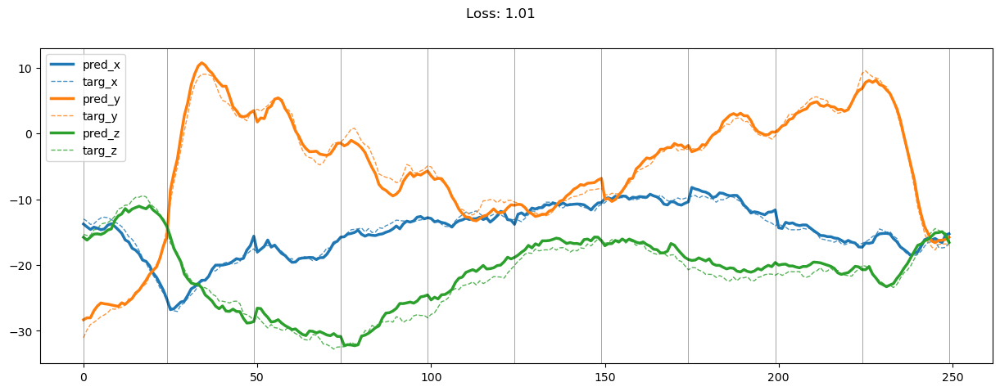

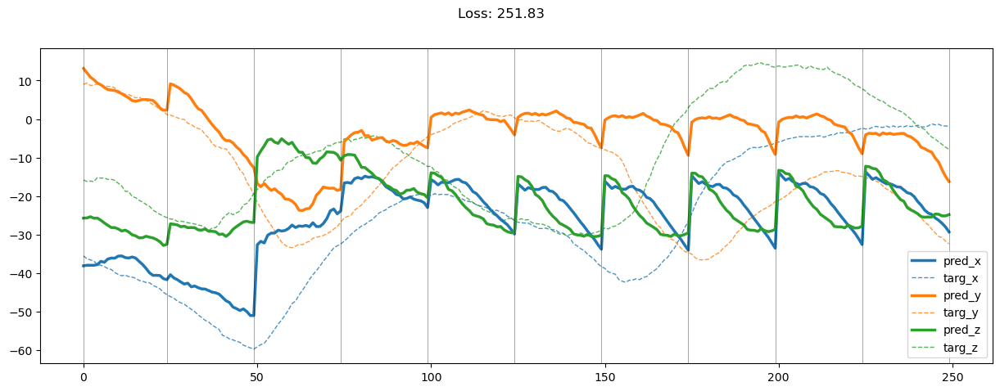

01199: train pred loss:  1.146, g loss:  3.742, diff loss:  2.297, d loss:  1.653
       valid pred loss:  168.189, g loss:  508.806, diff loss:  340.322, d loss:  1.662


100%|██████████| 17/17 [00:01<00:00, 15.11it/s]


01200: train pred loss:  1.196, g loss:  3.853, diff loss:  2.366, d loss:  1.669
       valid pred loss:  164.282, g loss:  498.517, diff loss:  333.949, d loss:  1.679


100%|██████████| 17/17 [00:01<00:00, 15.19it/s]


01201: train pred loss:  1.157, g loss:  3.761, diff loss:  2.320, d loss:  1.683
       valid pred loss:  167.807, g loss:  508.552, diff loss:  340.466, d loss:  1.692


100%|██████████| 17/17 [00:01<00:00, 15.19it/s]


01202: train pred loss:  1.140, g loss:  3.666, diff loss:  2.249, d loss:  1.696
       valid pred loss:  166.313, g loss:  501.730, diff loss:  335.143, d loss:  1.703


100%|██████████| 17/17 [00:01<00:00, 14.55it/s]


01203: train pred loss:  1.169, g loss:  3.752, diff loss:  2.310, d loss:  1.707
       valid pred loss:  166.589, g loss:  500.898, diff loss:  334.039, d loss:  1.713


100%|██████████| 17/17 [00:01<00:00, 15.01it/s]


01204: train pred loss:  1.173, g loss:  3.731, diff loss:  2.290, d loss:  1.715
       valid pred loss:  169.563, g loss:  509.834, diff loss:  340.005, d loss:  1.721


100%|██████████| 17/17 [00:01<00:00, 15.28it/s]


01205: train pred loss:  1.198, g loss:  3.845, diff loss:  2.381, d loss:  1.721
       valid pred loss:  166.368, g loss:  501.240, diff loss:  334.608, d loss:  1.725


100%|██████████| 17/17 [00:01<00:00, 15.17it/s]


01206: train pred loss:  1.177, g loss:  3.776, diff loss:  2.335, d loss:  1.725
       valid pred loss:  167.321, g loss:  500.806, diff loss:  333.221, d loss:  1.728


100%|██████████| 17/17 [00:01<00:00, 15.26it/s]


01207: train pred loss:  1.221, g loss:  3.886, diff loss:  2.401, d loss:  1.726
       valid pred loss:  170.158, g loss:  512.264, diff loss:  341.843, d loss:  1.729


100%|██████████| 17/17 [00:01<00:00, 15.25it/s]


01208: train pred loss:  1.280, g loss:  4.066, diff loss:  2.522, d loss:  1.725
       valid pred loss:  167.304, g loss:  501.569, diff loss:  334.002, d loss:  1.727


100%|██████████| 17/17 [00:01<00:00, 15.24it/s]


01209: train pred loss:  1.243, g loss:  3.919, diff loss:  2.410, d loss:  1.722
       valid pred loss:  163.984, g loss:  494.661, diff loss:  330.412, d loss:  1.722


100%|██████████| 17/17 [00:01<00:00, 15.26it/s]


01210: train pred loss:  1.176, g loss:  3.753, diff loss:  2.308, d loss:  1.716
       valid pred loss:  166.186, g loss:  502.108, diff loss:  335.654, d loss:  1.715


100%|██████████| 17/17 [00:01<00:00, 15.28it/s]


01211: train pred loss:  1.212, g loss:  3.870, diff loss:  2.385, d loss:  1.707
       valid pred loss:  168.112, g loss:  508.388, diff loss:  340.002, d loss:  1.705


100%|██████████| 17/17 [00:01<00:00, 15.25it/s]


01212: train pred loss:  1.223, g loss:  3.918, diff loss:  2.418, d loss:  1.697
       valid pred loss:  170.250, g loss:  513.003, diff loss:  342.474, d loss:  1.693


100%|██████████| 17/17 [00:01<00:00, 15.28it/s]


01213: train pred loss:  1.240, g loss:  3.957, diff loss:  2.434, d loss:  1.685
       valid pred loss:  168.969, g loss:  510.924, diff loss:  341.669, d loss:  1.680


100%|██████████| 17/17 [00:01<00:00, 15.28it/s]


01214: train pred loss:  1.238, g loss:  3.908, diff loss:  2.379, d loss:  1.669
       valid pred loss:  167.102, g loss:  511.744, diff loss:  344.349, d loss:  1.665


100%|██████████| 17/17 [00:01<00:00, 15.02it/s]


01215: train pred loss:  1.206, g loss:  3.843, diff loss:  2.339, d loss:  1.654
       valid pred loss:  167.086, g loss:  507.419, diff loss:  340.030, d loss:  1.648


100%|██████████| 17/17 [00:01<00:00, 15.10it/s]


01216: train pred loss:  1.181, g loss:  3.778, diff loss:  2.289, d loss:  1.636
       valid pred loss:  171.833, g loss:  522.975, diff loss:  350.830, d loss:  1.631


100%|██████████| 17/17 [00:01<00:00, 15.23it/s]


01217: train pred loss:  1.172, g loss:  3.802, diff loss:  2.311, d loss:  1.619
       valid pred loss:  169.368, g loss:  511.795, diff loss:  342.104, d loss:  1.612


100%|██████████| 17/17 [00:01<00:00, 14.77it/s]


01218: train pred loss:  1.145, g loss:  3.722, diff loss:  2.246, d loss:  1.600
       valid pred loss:  169.358, g loss:  516.245, diff loss:  346.552, d loss:  1.593


100%|██████████| 17/17 [00:01<00:00, 14.04it/s]


01219: train pred loss:  1.150, g loss:  3.747, diff loss:  2.254, d loss:  1.581
       valid pred loss:  169.386, g loss:  519.503, diff loss:  349.769, d loss:  1.573


100%|██████████| 17/17 [00:01<00:00, 15.23it/s]


01220: train pred loss:  1.144, g loss:  3.733, diff loss:  2.232, d loss:  1.562
       valid pred loss:  167.834, g loss:  507.832, diff loss:  339.636, d loss:  1.555


100%|██████████| 17/17 [00:01<00:00, 15.27it/s]


01221: train pred loss:  1.134, g loss:  3.692, diff loss:  2.187, d loss:  1.543
       valid pred loss:  168.483, g loss:  509.321, diff loss:  340.460, d loss:  1.537


100%|██████████| 17/17 [00:01<00:00, 14.98it/s]


01222: train pred loss:  1.125, g loss:  3.709, diff loss:  2.198, d loss:  1.525
       valid pred loss:  169.381, g loss:  513.108, diff loss:  343.335, d loss:  1.520


100%|██████████| 17/17 [00:01<00:00, 15.27it/s]


01223: train pred loss:  1.155, g loss:  3.837, diff loss:  2.279, d loss:  1.507
       valid pred loss:  170.188, g loss:  518.677, diff loss:  348.081, d loss:  1.503


100%|██████████| 17/17 [00:01<00:00, 15.27it/s]


01224: train pred loss:  1.234, g loss:  4.080, diff loss:  2.426, d loss:  1.492
       valid pred loss:  173.046, g loss:  529.267, diff loss:  355.795, d loss:  1.487


100%|██████████| 17/17 [00:01<00:00, 14.93it/s]


01225: train pred loss:  1.195, g loss:  3.936, diff loss:  2.305, d loss:  1.477
       valid pred loss:  170.965, g loss:  521.151, diff loss:  349.744, d loss:  1.473


100%|██████████| 17/17 [00:01<00:00, 14.82it/s]


01226: train pred loss:  1.187, g loss:  4.015, diff loss:  2.375, d loss:  1.464
       valid pred loss:  169.455, g loss:  515.280, diff loss:  345.365, d loss:  1.461


100%|██████████| 17/17 [00:01<00:00, 15.03it/s]


01227: train pred loss:  1.207, g loss:  4.055, diff loss:  2.377, d loss:  1.451
       valid pred loss:  168.685, g loss:  510.515, diff loss:  341.353, d loss:  1.450


100%|██████████| 17/17 [00:01<00:00, 15.11it/s]


01228: train pred loss:  1.212, g loss:  4.083, diff loss:  2.384, d loss:  1.441
       valid pred loss:  167.870, g loss:  506.652, diff loss:  338.288, d loss:  1.439


100%|██████████| 17/17 [00:01<00:00, 15.20it/s]


01229: train pred loss:  1.250, g loss:  4.195, diff loss:  2.441, d loss:  1.431
       valid pred loss:  167.699, g loss:  504.624, diff loss:  336.416, d loss:  1.431


100%|██████████| 17/17 [00:01<00:00, 15.19it/s]


01230: train pred loss:  1.264, g loss:  4.292, diff loss:  2.509, d loss:  1.424
       valid pred loss:  170.633, g loss:  511.809, diff loss:  340.652, d loss:  1.424


100%|██████████| 17/17 [00:01<00:00, 15.06it/s]


01231: train pred loss:  1.223, g loss:  4.143, diff loss:  2.387, d loss:  1.418
       valid pred loss:  168.003, g loss:  503.999, diff loss:  335.458, d loss:  1.418


100%|██████████| 17/17 [00:01<00:00, 14.74it/s]


01232: train pred loss:  1.188, g loss:  4.039, diff loss:  2.305, d loss:  1.413
       valid pred loss:  168.296, g loss:  506.700, diff loss:  337.853, d loss:  1.412


100%|██████████| 17/17 [00:01<00:00, 15.16it/s]


01233: train pred loss:  1.159, g loss:  3.988, diff loss:  2.270, d loss:  1.408
       valid pred loss:  167.268, g loss:  505.425, diff loss:  337.596, d loss:  1.409


100%|██████████| 17/17 [00:01<00:00, 15.15it/s]


01234: train pred loss:  1.138, g loss:  3.967, diff loss:  2.260, d loss:  1.404
       valid pred loss:  167.285, g loss:  506.286, diff loss:  338.429, d loss:  1.406


100%|██████████| 17/17 [00:01<00:00, 15.11it/s]


01235: train pred loss:  1.128, g loss:  3.953, diff loss:  2.248, d loss:  1.402
       valid pred loss:  169.914, g loss:  511.848, diff loss:  341.355, d loss:  1.404


100%|██████████| 17/17 [00:01<00:00, 15.11it/s]


01236: train pred loss:  1.159, g loss:  3.981, diff loss:  2.238, d loss:  1.400
       valid pred loss:  170.848, g loss:  516.217, diff loss:  344.784, d loss:  1.403


100%|██████████| 17/17 [00:01<00:00, 15.15it/s]


01237: train pred loss:  1.140, g loss:  3.977, diff loss:  2.249, d loss:  1.399
       valid pred loss:  167.180, g loss:  508.411, diff loss:  340.644, d loss:  1.401


100%|██████████| 17/17 [00:01<00:00, 14.93it/s]


01238: train pred loss:  1.111, g loss:  3.900, diff loss:  2.199, d loss:  1.398
       valid pred loss:  173.202, g loss:  525.873, diff loss:  352.084, d loss:  1.402


100%|██████████| 17/17 [00:01<00:00, 14.99it/s]


01239: train pred loss:  1.173, g loss:  4.042, diff loss:  2.282, d loss:  1.399
       valid pred loss:  169.579, g loss:  515.761, diff loss:  345.597, d loss:  1.402


100%|██████████| 17/17 [00:01<00:00, 14.88it/s]


01240: train pred loss:  1.185, g loss:  4.085, diff loss:  2.316, d loss:  1.400
       valid pred loss:  173.669, g loss:  530.154, diff loss:  355.905, d loss:  1.403


100%|██████████| 17/17 [00:01<00:00, 14.99it/s]


01241: train pred loss:  1.184, g loss:  4.079, diff loss:  2.316, d loss:  1.401
       valid pred loss:  166.608, g loss:  504.488, diff loss:  337.306, d loss:  1.405


100%|██████████| 17/17 [00:01<00:00, 15.19it/s]


01242: train pred loss:  1.225, g loss:  4.195, diff loss:  2.399, d loss:  1.403
       valid pred loss:  168.197, g loss:  507.408, diff loss:  338.647, d loss:  1.407


100%|██████████| 17/17 [00:01<00:00, 15.19it/s]


01243: train pred loss:  1.200, g loss:  4.137, diff loss:  2.378, d loss:  1.407
       valid pred loss:  168.913, g loss:  512.913, diff loss:  343.447, d loss:  1.412


100%|██████████| 17/17 [00:01<00:00, 15.22it/s]


01244: train pred loss:  1.192, g loss:  4.056, diff loss:  2.317, d loss:  1.411
       valid pred loss:  169.058, g loss:  515.528, diff loss:  345.931, d loss:  1.416


100%|██████████| 17/17 [00:01<00:00, 14.66it/s]


01245: train pred loss:  1.209, g loss:  4.093, diff loss:  2.352, d loss:  1.417
       valid pred loss:  168.301, g loss:  515.234, diff loss:  346.408, d loss:  1.422


100%|██████████| 17/17 [00:01<00:00, 14.44it/s]


01246: train pred loss:  1.184, g loss:  4.037, diff loss:  2.335, d loss:  1.423
       valid pred loss:  165.303, g loss:  500.159, diff loss:  334.347, d loss:  1.429


100%|██████████| 17/17 [00:01<00:00, 14.21it/s]


01247: train pred loss:  1.196, g loss:  4.032, diff loss:  2.335, d loss:  1.433
       valid pred loss:  164.259, g loss:  496.154, diff loss:  331.402, d loss:  1.438


100%|██████████| 17/17 [00:01<00:00, 15.24it/s]


01248: train pred loss:  1.213, g loss:  4.034, diff loss:  2.336, d loss:  1.442
       valid pred loss:  168.103, g loss:  511.906, diff loss:  343.327, d loss:  1.449


100%|██████████| 17/17 [00:01<00:00, 15.25it/s]


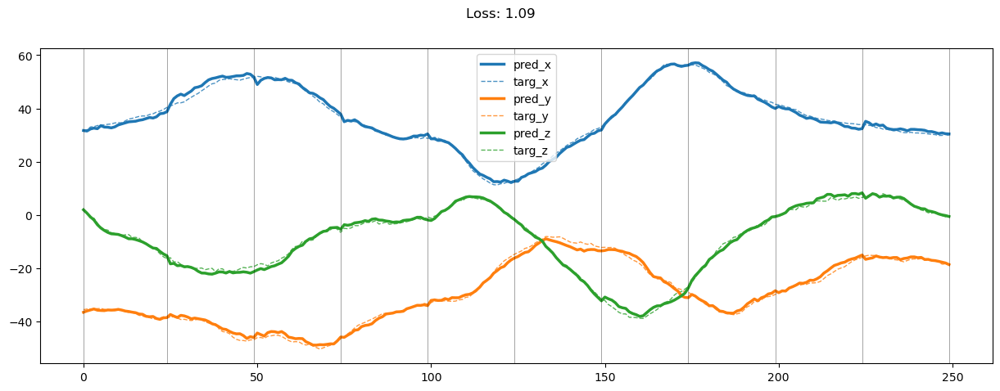

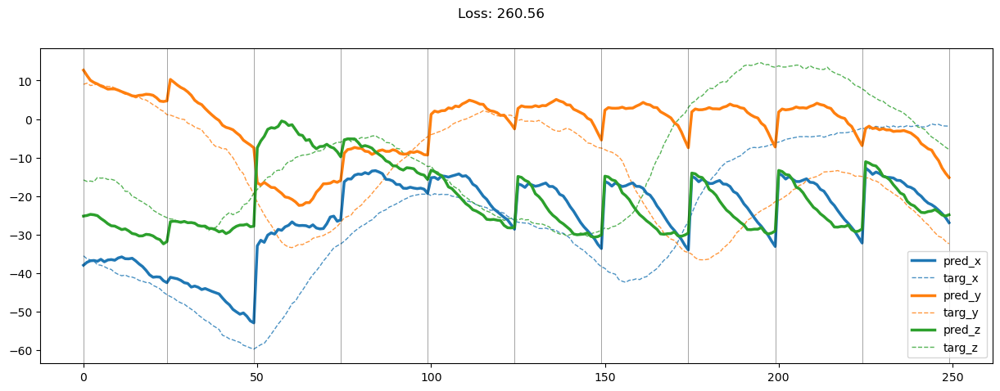

01249: train pred loss:  1.163, g loss:  3.904, diff loss:  2.273, d loss:  1.453
       valid pred loss:  168.795, g loss:  502.723, diff loss:  333.469, d loss:  1.460


100%|██████████| 17/17 [00:01<00:00, 14.80it/s]


01250: train pred loss:  1.144, g loss:  3.881, diff loss:  2.287, d loss:  1.466
       valid pred loss:  162.980, g loss:  489.541, diff loss:  326.120, d loss:  1.473


100%|██████████| 17/17 [00:01<00:00, 14.71it/s]


01251: train pred loss:  1.182, g loss:  3.926, diff loss:  2.311, d loss:  1.479
       valid pred loss:  167.753, g loss:  509.277, diff loss:  341.100, d loss:  1.487


100%|██████████| 17/17 [00:01<00:00, 14.58it/s]


01252: train pred loss:  1.176, g loss:  3.909, diff loss:  2.316, d loss:  1.493
       valid pred loss:  165.128, g loss:  498.711, diff loss:  333.175, d loss:  1.502


100%|██████████| 17/17 [00:01<00:00, 14.40it/s]


01253: train pred loss:  1.156, g loss:  3.842, diff loss:  2.285, d loss:  1.509
       valid pred loss:  165.754, g loss:  500.983, diff loss:  334.836, d loss:  1.518


100%|██████████| 17/17 [00:01<00:00, 14.23it/s]


01254: train pred loss:  1.120, g loss:  3.702, diff loss:  2.196, d loss:  1.525
       valid pred loss:  164.537, g loss:  491.884, diff loss:  326.969, d loss:  1.535


100%|██████████| 17/17 [00:01<00:00, 15.28it/s]


01255: train pred loss:  1.100, g loss:  3.657, diff loss:  2.186, d loss:  1.542
       valid pred loss:  166.604, g loss:  501.199, diff loss:  334.230, d loss:  1.552


100%|██████████| 17/17 [00:01<00:00, 15.23it/s]


01256: train pred loss:  1.178, g loss:  3.861, diff loss:  2.324, d loss:  1.559
       valid pred loss:  164.599, g loss:  496.757, diff loss:  331.807, d loss:  1.569


100%|██████████| 17/17 [00:01<00:00, 15.22it/s]


01257: train pred loss:  1.136, g loss:  3.732, diff loss:  2.250, d loss:  1.576
       valid pred loss:  164.412, g loss:  496.715, diff loss:  331.965, d loss:  1.586


100%|██████████| 17/17 [00:01<00:00, 15.22it/s]


01258: train pred loss:  1.180, g loss:  3.907, diff loss:  2.392, d loss:  1.593
       valid pred loss:  165.300, g loss:  498.625, diff loss:  332.998, d loss:  1.603


100%|██████████| 17/17 [00:01<00:00, 15.19it/s]


01259: train pred loss:  1.288, g loss:  4.072, diff loss:  2.460, d loss:  1.610
       valid pred loss:  165.239, g loss:  501.983, diff loss:  336.426, d loss:  1.619


100%|██████████| 17/17 [00:01<00:00, 15.24it/s]


01260: train pred loss:  1.253, g loss:  4.005, diff loss:  2.438, d loss:  1.626
       valid pred loss:  165.366, g loss:  497.405, diff loss:  331.730, d loss:  1.635


100%|██████████| 17/17 [00:01<00:00, 14.96it/s]


01261: train pred loss:  1.275, g loss:  4.077, diff loss:  2.497, d loss:  1.641
       valid pred loss:  164.755, g loss:  497.687, diff loss:  332.632, d loss:  1.651


100%|██████████| 17/17 [00:01<00:00, 15.12it/s]


01262: train pred loss:  1.347, g loss:  4.214, diff loss:  2.570, d loss:  1.656
       valid pred loss:  161.782, g loss:  489.984, diff loss:  327.908, d loss:  1.664


100%|██████████| 17/17 [00:01<00:00, 15.27it/s]


01263: train pred loss:  1.249, g loss:  3.990, diff loss:  2.451, d loss:  1.669
       valid pred loss:  164.639, g loss:  497.298, diff loss:  332.371, d loss:  1.676


100%|██████████| 17/17 [00:01<00:00, 14.95it/s]


01264: train pred loss:  1.235, g loss:  3.949, diff loss:  2.430, d loss:  1.681
       valid pred loss:  164.916, g loss:  494.011, diff loss:  328.813, d loss:  1.687


100%|██████████| 17/17 [00:01<00:00, 14.63it/s]


01265: train pred loss:  1.206, g loss:  3.835, diff loss:  2.350, d loss:  1.690
       valid pred loss:  165.969, g loss:  505.370, diff loss:  339.124, d loss:  1.698


100%|██████████| 17/17 [00:01<00:00, 15.21it/s]


01266: train pred loss:  1.182, g loss:  3.765, diff loss:  2.307, d loss:  1.700
       valid pred loss:  164.410, g loss:  500.163, diff loss:  335.480, d loss:  1.706


100%|██████████| 17/17 [00:01<00:00, 14.98it/s]


01267: train pred loss:  1.148, g loss:  3.683, diff loss:  2.262, d loss:  1.706
       valid pred loss:  167.523, g loss:  506.444, diff loss:  338.650, d loss:  1.712


100%|██████████| 17/17 [00:01<00:00, 15.26it/s]


01268: train pred loss:  1.152, g loss:  3.658, diff loss:  2.237, d loss:  1.712
       valid pred loss:  166.582, g loss:  502.708, diff loss:  335.858, d loss:  1.716


100%|██████████| 17/17 [00:01<00:00, 15.27it/s]


01269: train pred loss:  1.117, g loss:  3.597, diff loss:  2.211, d loss:  1.715
       valid pred loss:  167.940, g loss:  510.464, diff loss:  342.256, d loss:  1.718


100%|██████████| 17/17 [00:01<00:00, 15.24it/s]


01270: train pred loss:  1.114, g loss:  3.582, diff loss:  2.200, d loss:  1.716
       valid pred loss:  165.517, g loss:  500.016, diff loss:  334.232, d loss:  1.718


100%|██████████| 17/17 [00:01<00:00, 15.21it/s]


01271: train pred loss:  1.086, g loss:  3.456, diff loss:  2.102, d loss:  1.716
       valid pred loss:  164.211, g loss:  500.611, diff loss:  336.132, d loss:  1.717


100%|██████████| 17/17 [00:01<00:00, 15.22it/s]


01272: train pred loss:  1.118, g loss:  3.573, diff loss:  2.185, d loss:  1.713
       valid pred loss:  161.507, g loss:  485.705, diff loss:  323.928, d loss:  1.713


100%|██████████| 17/17 [00:01<00:00, 15.21it/s]


01273: train pred loss:  1.154, g loss:  3.667, diff loss:  2.242, d loss:  1.708
       valid pred loss:  161.668, g loss:  488.830, diff loss:  326.890, d loss:  1.708


100%|██████████| 17/17 [00:01<00:00, 15.25it/s]


01274: train pred loss:  1.131, g loss:  3.625, diff loss:  2.219, d loss:  1.701
       valid pred loss:  163.846, g loss:  493.684, diff loss:  329.562, d loss:  1.700


100%|██████████| 17/17 [00:01<00:00, 15.04it/s]


01275: train pred loss:  1.146, g loss:  3.589, diff loss:  2.164, d loss:  1.692
       valid pred loss:  161.387, g loss:  483.280, diff loss:  321.613, d loss:  1.690


100%|██████████| 17/17 [00:01<00:00, 15.23it/s]


01276: train pred loss:  1.151, g loss:  3.670, diff loss:  2.235, d loss:  1.683
       valid pred loss:  167.439, g loss:  506.394, diff loss:  338.669, d loss:  1.680


100%|██████████| 17/17 [00:01<00:00, 15.24it/s]


01277: train pred loss:  1.130, g loss:  3.643, diff loss:  2.223, d loss:  1.671
       valid pred loss:  164.727, g loss:  495.672, diff loss:  330.652, d loss:  1.667


100%|██████████| 17/17 [00:01<00:00, 15.20it/s]


01278: train pred loss:  1.182, g loss:  3.749, diff loss:  2.271, d loss:  1.658
       valid pred loss:  165.654, g loss:  503.340, diff loss:  337.386, d loss:  1.653


100%|██████████| 17/17 [00:01<00:00, 14.70it/s]


01279: train pred loss:  1.199, g loss:  3.822, diff loss:  2.319, d loss:  1.644
       valid pred loss:  162.069, g loss:  492.850, diff loss:  330.473, d loss:  1.638


100%|██████████| 17/17 [00:01<00:00, 15.12it/s]


01280: train pred loss:  1.210, g loss:  3.900, diff loss:  2.377, d loss:  1.628
       valid pred loss:  164.639, g loss:  503.121, diff loss:  338.165, d loss:  1.622


100%|██████████| 17/17 [00:01<00:00, 15.13it/s]


01281: train pred loss:  1.198, g loss:  3.893, diff loss:  2.373, d loss:  1.613
       valid pred loss:  166.497, g loss:  513.755, diff loss:  346.932, d loss:  1.606


100%|██████████| 17/17 [00:01<00:00, 14.51it/s]


01282: train pred loss:  1.171, g loss:  3.796, diff loss:  2.292, d loss:  1.595
       valid pred loss:  163.274, g loss:  501.521, diff loss:  337.909, d loss:  1.588


100%|██████████| 17/17 [00:01<00:00, 15.14it/s]


01283: train pred loss:  1.182, g loss:  3.824, diff loss:  2.298, d loss:  1.579
       valid pred loss:  164.427, g loss:  495.082, diff loss:  330.305, d loss:  1.571


100%|██████████| 17/17 [00:01<00:00, 14.28it/s]


01284: train pred loss:  1.176, g loss:  3.819, diff loss:  2.287, d loss:  1.562
       valid pred loss:  162.763, g loss:  499.168, diff loss:  336.042, d loss:  1.555


100%|██████████| 17/17 [00:01<00:00, 14.56it/s]


01285: train pred loss:  1.229, g loss:  4.016, diff loss:  2.418, d loss:  1.546
       valid pred loss:  166.546, g loss:  511.109, diff loss:  344.189, d loss:  1.539


100%|██████████| 17/17 [00:01<00:00, 14.38it/s]


01286: train pred loss:  1.181, g loss:  3.866, diff loss:  2.304, d loss:  1.529
       valid pred loss:  165.472, g loss:  494.383, diff loss:  328.522, d loss:  1.524


100%|██████████| 17/17 [00:01<00:00, 14.81it/s]


01287: train pred loss:  1.195, g loss:  3.947, diff loss:  2.355, d loss:  1.513
       valid pred loss:  165.172, g loss:  497.657, diff loss:  332.082, d loss:  1.509


100%|██████████| 17/17 [00:01<00:00, 14.66it/s]


01288: train pred loss:  1.179, g loss:  3.923, diff loss:  2.334, d loss:  1.499
       valid pred loss:  161.481, g loss:  491.302, diff loss:  329.403, d loss:  1.493


100%|██████████| 17/17 [00:01<00:00, 15.16it/s]


01289: train pred loss:  1.212, g loss:  3.998, diff loss:  2.360, d loss:  1.486
       valid pred loss:  164.816, g loss:  499.148, diff loss:  333.899, d loss:  1.480


100%|██████████| 17/17 [00:01<00:00, 15.15it/s]


01290: train pred loss:  1.193, g loss:  3.974, diff loss:  2.340, d loss:  1.473
       valid pred loss:  163.305, g loss:  495.326, diff loss:  331.573, d loss:  1.468


100%|██████████| 17/17 [00:01<00:00, 15.16it/s]


01291: train pred loss:  1.247, g loss:  4.135, diff loss:  2.431, d loss:  1.461
       valid pred loss:  165.490, g loss:  501.656, diff loss:  335.702, d loss:  1.457


100%|██████████| 17/17 [00:01<00:00, 15.15it/s]


01292: train pred loss:  1.201, g loss:  3.993, diff loss:  2.320, d loss:  1.450
       valid pred loss:  163.440, g loss:  495.129, diff loss:  331.210, d loss:  1.447


100%|██████████| 17/17 [00:01<00:00, 15.19it/s]


01293: train pred loss:  1.224, g loss:  4.077, diff loss:  2.367, d loss:  1.441
       valid pred loss:  169.733, g loss:  521.900, diff loss:  351.674, d loss:  1.438


100%|██████████| 17/17 [00:01<00:00, 15.14it/s]


01294: train pred loss:  1.202, g loss:  4.008, diff loss:  2.304, d loss:  1.432
       valid pred loss:  165.675, g loss:  505.707, diff loss:  339.524, d loss:  1.430


100%|██████████| 17/17 [00:01<00:00, 14.90it/s]


01295: train pred loss:  1.149, g loss:  3.888, diff loss:  2.225, d loss:  1.425
       valid pred loss:  166.094, g loss:  503.006, diff loss:  336.391, d loss:  1.424


100%|██████████| 17/17 [00:01<00:00, 15.18it/s]


01296: train pred loss:  1.134, g loss:  3.856, diff loss:  2.194, d loss:  1.419
       valid pred loss:  165.098, g loss:  500.100, diff loss:  334.469, d loss:  1.418


100%|██████████| 17/17 [00:01<00:00, 15.09it/s]


01297: train pred loss:  1.136, g loss:  3.899, diff loss:  2.223, d loss:  1.414
       valid pred loss:  165.667, g loss:  505.742, diff loss:  339.529, d loss:  1.414


100%|██████████| 17/17 [00:01<00:00, 15.22it/s]


01298: train pred loss:  1.184, g loss:  4.064, diff loss:  2.330, d loss:  1.410
       valid pred loss:  160.742, g loss:  484.820, diff loss:  323.522, d loss:  1.409


100%|██████████| 17/17 [00:01<00:00, 15.13it/s]


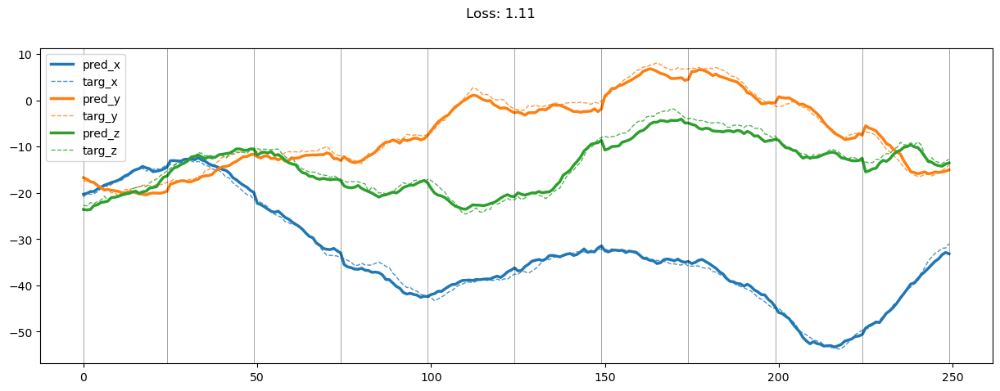

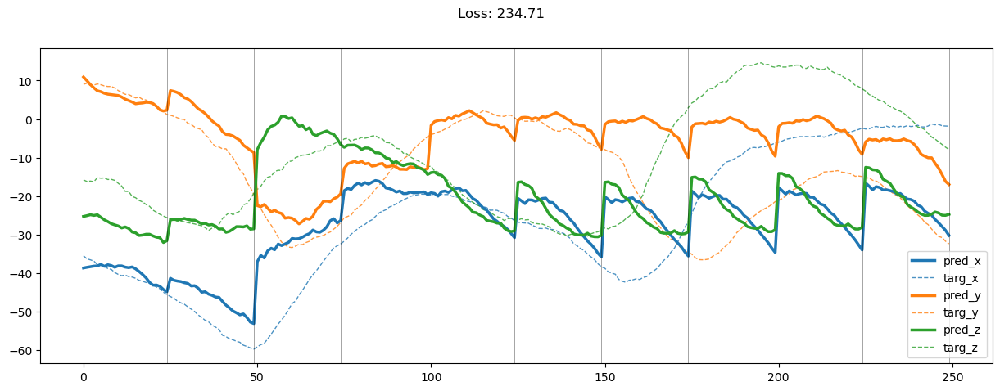

01299: train pred loss:  1.166, g loss:  4.028, diff loss:  2.302, d loss:  1.407
       valid pred loss:  168.977, g loss:  510.963, diff loss:  341.422, d loss:  1.407


100%|██████████| 17/17 [00:01<00:00, 14.77it/s]


01300: train pred loss:  1.174, g loss:  4.052, diff loss:  2.311, d loss:  1.404
       valid pred loss:  167.446, g loss:  510.694, diff loss:  342.677, d loss:  1.405


100%|██████████| 17/17 [00:01<00:00, 15.10it/s]


01301: train pred loss:  1.220, g loss:  4.198, diff loss:  2.404, d loss:  1.402
       valid pred loss:  165.833, g loss:  509.563, diff loss:  343.153, d loss:  1.404


100%|██████████| 17/17 [00:01<00:00, 15.16it/s]


01302: train pred loss:  1.191, g loss:  4.098, diff loss:  2.330, d loss:  1.401
       valid pred loss:  166.843, g loss:  513.625, diff loss:  346.204, d loss:  1.404


100%|██████████| 17/17 [00:01<00:00, 15.15it/s]


01303: train pred loss:  1.140, g loss:  3.960, diff loss:  2.240, d loss:  1.401
       valid pred loss:  165.363, g loss:  507.268, diff loss:  341.325, d loss:  1.403


100%|██████████| 17/17 [00:01<00:00, 15.17it/s]


01304: train pred loss:  1.189, g loss:  4.100, diff loss:  2.331, d loss:  1.400
       valid pred loss:  167.397, g loss:  509.800, diff loss:  341.824, d loss:  1.402


100%|██████████| 17/17 [00:01<00:00, 15.13it/s]


01305: train pred loss:  1.212, g loss:  4.178, diff loss:  2.388, d loss:  1.400
       valid pred loss:  169.762, g loss:  516.519, diff loss:  346.182, d loss:  1.404


100%|██████████| 17/17 [00:01<00:00, 14.86it/s]


01306: train pred loss:  1.217, g loss:  4.124, diff loss:  2.334, d loss:  1.402
       valid pred loss:  168.717, g loss:  516.009, diff loss:  346.720, d loss:  1.405


100%|██████████| 17/17 [00:01<00:00, 14.77it/s]


01307: train pred loss:  1.210, g loss:  4.151, diff loss:  2.372, d loss:  1.403
       valid pred loss:  165.863, g loss:  507.164, diff loss:  340.738, d loss:  1.408


100%|██████████| 17/17 [00:01<00:00, 15.16it/s]


01308: train pred loss:  1.183, g loss:  4.067, diff loss:  2.324, d loss:  1.406
       valid pred loss:  171.872, g loss:  517.519, diff loss:  345.093, d loss:  1.411


100%|██████████| 17/17 [00:01<00:00, 15.19it/s]


01309: train pred loss:  1.204, g loss:  4.097, diff loss:  2.342, d loss:  1.409
       valid pred loss:  170.130, g loss:  514.818, diff loss:  344.144, d loss:  1.414


100%|██████████| 17/17 [00:01<00:00, 15.20it/s]


01310: train pred loss:  1.184, g loss:  4.030, diff loss:  2.307, d loss:  1.414
       valid pred loss:  168.337, g loss:  507.701, diff loss:  338.832, d loss:  1.418


100%|██████████| 17/17 [00:01<00:00, 15.19it/s]


01311: train pred loss:  1.207, g loss:  4.067, diff loss:  2.333, d loss:  1.419
       valid pred loss:  168.809, g loss:  510.904, diff loss:  341.576, d loss:  1.425


100%|██████████| 17/17 [00:01<00:00, 15.18it/s]


01312: train pred loss:  1.175, g loss:  3.999, diff loss:  2.311, d loss:  1.426
       valid pred loss:  168.276, g loss:  515.179, diff loss:  346.398, d loss:  1.431


100%|██████████| 17/17 [00:01<00:00, 15.17it/s]


01313: train pred loss:  1.254, g loss:  4.195, diff loss:  2.444, d loss:  1.436
       valid pred loss:  166.206, g loss:  508.735, diff loss:  342.038, d loss:  1.440


100%|██████████| 17/17 [00:01<00:00, 15.14it/s]


01314: train pred loss:  1.180, g loss:  3.964, diff loss:  2.300, d loss:  1.442
       valid pred loss:  170.671, g loss:  516.200, diff loss:  345.056, d loss:  1.450


100%|██████████| 17/17 [00:01<00:00, 15.11it/s]


01315: train pred loss:  1.173, g loss:  3.912, diff loss:  2.271, d loss:  1.452
       valid pred loss:  173.445, g loss:  532.158, diff loss:  358.254, d loss:  1.460


100%|██████████| 17/17 [00:01<00:00, 15.12it/s]


01316: train pred loss:  1.248, g loss:  4.074, diff loss:  2.372, d loss:  1.462
       valid pred loss:  171.710, g loss:  518.827, diff loss:  346.673, d loss:  1.473


100%|██████████| 17/17 [00:01<00:00, 15.12it/s]


01317: train pred loss:  1.217, g loss:  4.007, diff loss:  2.352, d loss:  1.474
       valid pred loss:  172.036, g loss:  529.227, diff loss:  356.762, d loss:  1.483


100%|██████████| 17/17 [00:01<00:00, 14.69it/s]


01318: train pred loss:  1.166, g loss:  3.884, diff loss:  2.294, d loss:  1.486
       valid pred loss:  168.385, g loss:  518.800, diff loss:  350.000, d loss:  1.498


100%|██████████| 17/17 [00:01<00:00, 15.21it/s]


01319: train pred loss:  1.160, g loss:  3.821, diff loss:  2.251, d loss:  1.499
       valid pred loss:  170.456, g loss:  529.144, diff loss:  358.287, d loss:  1.510


100%|██████████| 17/17 [00:01<00:00, 14.62it/s]


01320: train pred loss:  1.147, g loss:  3.764, diff loss:  2.221, d loss:  1.514
       valid pred loss:  168.151, g loss:  523.174, diff loss:  354.636, d loss:  1.525


100%|██████████| 17/17 [00:01<00:00, 14.99it/s]


01321: train pred loss:  1.106, g loss:  3.661, diff loss:  2.173, d loss:  1.528
       valid pred loss:  167.233, g loss:  515.562, diff loss:  347.955, d loss:  1.540


100%|██████████| 17/17 [00:01<00:00, 15.21it/s]


01322: train pred loss:  1.062, g loss:  3.538, diff loss:  2.106, d loss:  1.543
       valid pred loss:  165.071, g loss:  507.834, diff loss:  342.400, d loss:  1.555


100%|██████████| 17/17 [00:01<00:00, 15.25it/s]


01323: train pred loss:  1.092, g loss:  3.593, diff loss:  2.144, d loss:  1.559
       valid pred loss:  170.025, g loss:  523.379, diff loss:  353.002, d loss:  1.570


100%|██████████| 17/17 [00:01<00:00, 15.21it/s]


01324: train pred loss:  1.092, g loss:  3.587, diff loss:  2.148, d loss:  1.573
       valid pred loss:  167.308, g loss:  511.545, diff loss:  343.897, d loss:  1.586


100%|██████████| 17/17 [00:01<00:00, 15.15it/s]


01325: train pred loss:  1.102, g loss:  3.583, diff loss:  2.144, d loss:  1.589
       valid pred loss:  165.912, g loss:  508.998, diff loss:  342.755, d loss:  1.599


100%|██████████| 17/17 [00:01<00:00, 14.96it/s]


01326: train pred loss:  1.111, g loss:  3.642, diff loss:  2.203, d loss:  1.603
       valid pred loss:  168.960, g loss:  518.455, diff loss:  349.172, d loss:  1.613


100%|██████████| 17/17 [00:01<00:00, 15.17it/s]


01327: train pred loss:  1.094, g loss:  3.548, diff loss:  2.135, d loss:  1.615
       valid pred loss:  165.848, g loss:  507.605, diff loss:  341.443, d loss:  1.627


100%|██████████| 17/17 [00:01<00:00, 14.92it/s]


01328: train pred loss:  1.088, g loss:  3.535, diff loss:  2.135, d loss:  1.629
       valid pred loss:  165.554, g loss:  504.509, diff loss:  338.648, d loss:  1.640


100%|██████████| 17/17 [00:01<00:00, 15.23it/s]


01329: train pred loss:  1.078, g loss:  3.440, diff loss:  2.057, d loss:  1.641
       valid pred loss:  167.622, g loss:  511.313, diff loss:  343.391, d loss:  1.652


100%|██████████| 17/17 [00:01<00:00, 14.98it/s]


01330: train pred loss:  1.082, g loss:  3.486, diff loss:  2.105, d loss:  1.652
       valid pred loss:  168.309, g loss:  513.427, diff loss:  344.824, d loss:  1.662


100%|██████████| 17/17 [00:01<00:00, 15.23it/s]


01331: train pred loss:  1.086, g loss:  3.521, diff loss:  2.142, d loss:  1.662
       valid pred loss:  163.938, g loss:  502.975, diff loss:  338.747, d loss:  1.672


100%|██████████| 17/17 [00:01<00:00, 14.08it/s]


01332: train pred loss:  1.101, g loss:  3.548, diff loss:  2.157, d loss:  1.672
       valid pred loss:  169.264, g loss:  517.709, diff loss:  348.161, d loss:  1.681


100%|██████████| 17/17 [00:01<00:00, 15.13it/s]


01333: train pred loss:  1.134, g loss:  3.666, diff loss:  2.247, d loss:  1.680
       valid pred loss:  168.084, g loss:  513.087, diff loss:  344.721, d loss:  1.688


100%|██████████| 17/17 [00:01<00:00, 15.19it/s]


01334: train pred loss:  1.116, g loss:  3.575, diff loss:  2.177, d loss:  1.686
       valid pred loss:  171.358, g loss:  532.570, diff loss:  360.934, d loss:  1.695


100%|██████████| 17/17 [00:01<00:00, 15.26it/s]


01335: train pred loss:  1.079, g loss:  3.468, diff loss:  2.109, d loss:  1.691
       valid pred loss:  167.641, g loss:  515.858, diff loss:  347.941, d loss:  1.700


100%|██████████| 17/17 [00:01<00:00, 15.08it/s]


01336: train pred loss:  1.139, g loss:  3.660, diff loss:  2.243, d loss:  1.694
       valid pred loss:  168.479, g loss:  515.300, diff loss:  346.546, d loss:  1.702


100%|██████████| 17/17 [00:01<00:00, 15.27it/s]


01337: train pred loss:  1.109, g loss:  3.551, diff loss:  2.165, d loss:  1.697
       valid pred loss:  164.107, g loss:  500.289, diff loss:  335.907, d loss:  1.704


100%|██████████| 17/17 [00:01<00:00, 15.00it/s]


01338: train pred loss:  1.096, g loss:  3.541, diff loss:  2.169, d loss:  1.697
       valid pred loss:  162.875, g loss:  484.600, diff loss:  321.449, d loss:  1.700


100%|██████████| 17/17 [00:01<00:00, 14.85it/s]


01339: train pred loss:  1.113, g loss:  3.538, diff loss:  2.144, d loss:  1.689
       valid pred loss:  166.991, g loss:  505.004, diff loss:  337.728, d loss:  1.681


100%|██████████| 17/17 [00:01<00:00, 15.20it/s]


01340: train pred loss:  1.100, g loss:  3.519, diff loss:  2.128, d loss:  1.668
       valid pred loss:  167.152, g loss:  502.824, diff loss:  335.372, d loss:  1.651


100%|██████████| 17/17 [00:01<00:00, 15.17it/s]


01341: train pred loss:  1.090, g loss:  3.557, diff loss:  2.161, d loss:  1.639
       valid pred loss:  163.511, g loss:  493.907, diff loss:  330.079, d loss:  1.618


100%|██████████| 17/17 [00:01<00:00, 15.21it/s]


01342: train pred loss:  1.095, g loss:  3.611, diff loss:  2.192, d loss:  1.609
       valid pred loss:  165.749, g loss:  501.515, diff loss:  335.428, d loss:  1.586


100%|██████████| 17/17 [00:01<00:00, 15.21it/s]


01343: train pred loss:  1.141, g loss:  3.713, diff loss:  2.229, d loss:  1.580
       valid pred loss:  166.644, g loss:  509.069, diff loss:  342.068, d loss:  1.557


100%|██████████| 17/17 [00:01<00:00, 15.23it/s]


01344: train pred loss:  1.146, g loss:  3.729, diff loss:  2.220, d loss:  1.554
       valid pred loss:  164.805, g loss:  498.797, diff loss:  333.615, d loss:  1.531


100%|██████████| 17/17 [00:01<00:00, 15.20it/s]


01345: train pred loss:  1.159, g loss:  3.796, diff loss:  2.256, d loss:  1.532
       valid pred loss:  163.712, g loss:  486.381, diff loss:  322.272, d loss:  1.509


100%|██████████| 17/17 [00:01<00:00, 15.22it/s]


01346: train pred loss:  1.143, g loss:  3.774, diff loss:  2.230, d loss:  1.510
       valid pred loss:  166.049, g loss:  505.079, diff loss:  338.612, d loss:  1.486


100%|██████████| 17/17 [00:01<00:00, 15.20it/s]


01347: train pred loss:  1.111, g loss:  3.725, diff loss:  2.193, d loss:  1.492
       valid pred loss:  169.902, g loss:  523.554, diff loss:  353.215, d loss:  1.470


100%|██████████| 17/17 [00:01<00:00, 14.35it/s]


01348: train pred loss:  1.097, g loss:  3.693, diff loss:  2.159, d loss:  1.479
       valid pred loss:  167.937, g loss:  515.609, diff loss:  347.216, d loss:  1.454


100%|██████████| 17/17 [00:01<00:00, 15.03it/s]


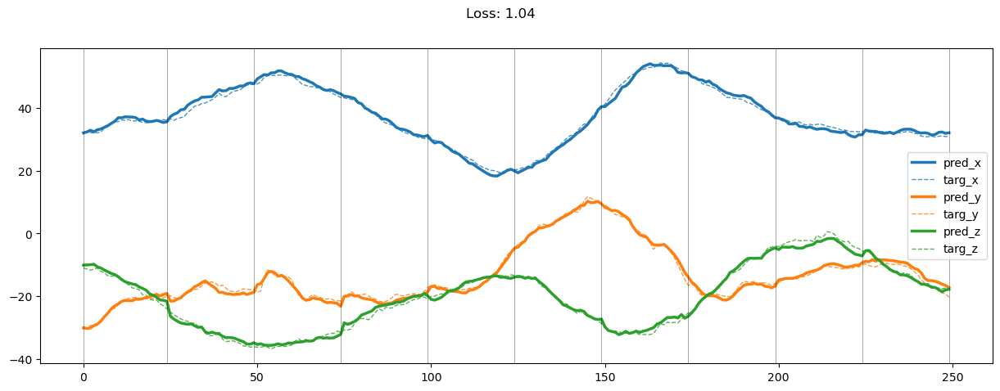

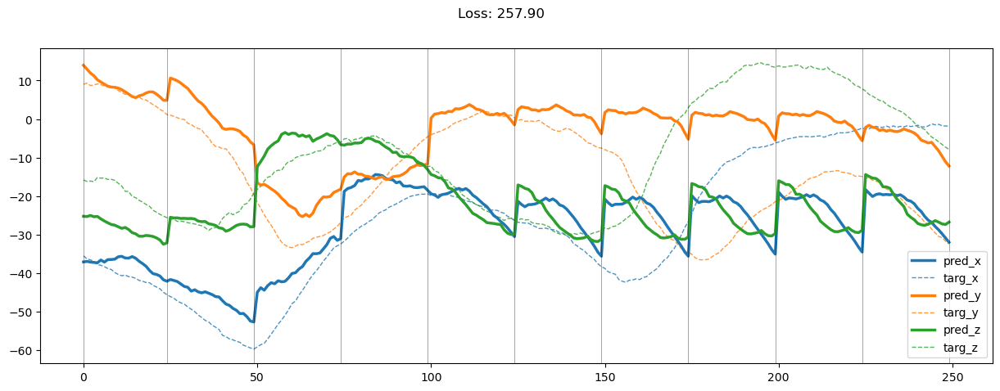

01349: train pred loss:  1.061, g loss:  3.591, diff loss:  2.075, d loss:  1.464
       valid pred loss:  165.013, g loss:  502.280, diff loss:  336.795, d loss:  1.443


100%|██████████| 17/17 [00:01<00:00, 15.02it/s]


01350: train pred loss:  1.074, g loss:  3.654, diff loss:  2.110, d loss:  1.455
       valid pred loss:  165.713, g loss:  510.784, diff loss:  344.583, d loss:  1.432


100%|██████████| 17/17 [00:01<00:00, 15.24it/s]


01351: train pred loss:  1.101, g loss:  3.766, diff loss:  2.181, d loss:  1.446
       valid pred loss:  166.729, g loss:  507.071, diff loss:  339.843, d loss:  1.427


100%|██████████| 17/17 [00:01<00:00, 14.87it/s]


01352: train pred loss:  1.128, g loss:  3.826, diff loss:  2.204, d loss:  1.440
       valid pred loss:  166.823, g loss:  506.842, diff loss:  339.511, d loss:  1.420


100%|██████████| 17/17 [00:01<00:00, 14.81it/s]


01353: train pred loss:  1.156, g loss:  3.910, diff loss:  2.253, d loss:  1.436
       valid pred loss:  164.368, g loss:  494.713, diff loss:  329.832, d loss:  1.417


100%|██████████| 17/17 [00:01<00:00, 15.06it/s]


01354: train pred loss:  1.144, g loss:  3.871, diff loss:  2.223, d loss:  1.434
       valid pred loss:  170.358, g loss:  522.389, diff loss:  351.517, d loss:  1.417


100%|██████████| 17/17 [00:01<00:00, 14.91it/s]


01355: train pred loss:  1.139, g loss:  3.887, diff loss:  2.246, d loss:  1.436
       valid pred loss:  164.517, g loss:  500.773, diff loss:  335.744, d loss:  1.419


100%|██████████| 17/17 [00:01<00:00, 15.02it/s]


01356: train pred loss:  1.130, g loss:  3.823, diff loss:  2.193, d loss:  1.436
       valid pred loss:  163.622, g loss:  500.436, diff loss:  336.308, d loss:  1.423


100%|██████████| 17/17 [00:01<00:00, 14.99it/s]


01357: train pred loss:  1.082, g loss:  3.687, diff loss:  2.110, d loss:  1.438
       valid pred loss:  165.943, g loss:  509.530, diff loss:  343.086, d loss:  1.425


100%|██████████| 17/17 [00:01<00:00, 15.24it/s]


01358: train pred loss:  1.068, g loss:  3.659, diff loss:  2.104, d loss:  1.442
       valid pred loss:  165.794, g loss:  512.882, diff loss:  346.596, d loss:  1.431


100%|██████████| 17/17 [00:01<00:00, 15.23it/s]


01359: train pred loss:  1.082, g loss:  3.700, diff loss:  2.140, d loss:  1.447
       valid pred loss:  166.079, g loss:  511.522, diff loss:  344.962, d loss:  1.438


100%|██████████| 17/17 [00:01<00:00, 15.24it/s]


01360: train pred loss:  1.153, g loss:  3.900, diff loss:  2.280, d loss:  1.455
       valid pred loss:  167.811, g loss:  522.028, diff loss:  353.749, d loss:  1.447


100%|██████████| 17/17 [00:01<00:00, 14.79it/s]


01361: train pred loss:  1.103, g loss:  3.698, diff loss:  2.140, d loss:  1.463
       valid pred loss:  168.056, g loss:  519.218, diff loss:  350.706, d loss:  1.457


100%|██████████| 17/17 [00:01<00:00, 15.23it/s]


01362: train pred loss:  1.062, g loss:  3.590, diff loss:  2.085, d loss:  1.472
       valid pred loss:  167.902, g loss:  520.267, diff loss:  351.925, d loss:  1.469


100%|██████████| 17/17 [00:01<00:00, 15.23it/s]


01363: train pred loss:  1.058, g loss:  3.561, diff loss:  2.072, d loss:  1.482
       valid pred loss:  166.224, g loss:  506.238, diff loss:  339.585, d loss:  1.479


100%|██████████| 17/17 [00:01<00:00, 15.05it/s]


01364: train pred loss:  1.147, g loss:  3.798, diff loss:  2.232, d loss:  1.492
       valid pred loss:  164.732, g loss:  509.284, diff loss:  344.138, d loss:  1.494


100%|██████████| 17/17 [00:01<00:00, 15.20it/s]


01365: train pred loss:  1.134, g loss:  3.733, diff loss:  2.192, d loss:  1.504
       valid pred loss:  164.282, g loss:  506.180, diff loss:  341.495, d loss:  1.504


100%|██████████| 17/17 [00:01<00:00, 15.22it/s]


01366: train pred loss:  1.197, g loss:  3.941, diff loss:  2.348, d loss:  1.514
       valid pred loss:  163.890, g loss:  503.208, diff loss:  338.925, d loss:  1.516


100%|██████████| 17/17 [00:01<00:00, 15.19it/s]


01367: train pred loss:  1.181, g loss:  3.896, diff loss:  2.330, d loss:  1.526
       valid pred loss:  163.897, g loss:  501.985, diff loss:  337.707, d loss:  1.529


100%|██████████| 17/17 [00:01<00:00, 15.12it/s]


01368: train pred loss:  1.146, g loss:  3.750, diff loss:  2.228, d loss:  1.537
       valid pred loss:  169.981, g loss:  512.651, diff loss:  342.298, d loss:  1.541


100%|██████████| 17/17 [00:01<00:00, 15.12it/s]


01369: train pred loss:  1.148, g loss:  3.748, diff loss:  2.233, d loss:  1.549
       valid pred loss:  169.223, g loss:  514.468, diff loss:  344.882, d loss:  1.552


100%|██████████| 17/17 [00:01<00:00, 14.58it/s]


01370: train pred loss:  1.114, g loss:  3.650, diff loss:  2.177, d loss:  1.559
       valid pred loss:  165.566, g loss:  502.077, diff loss:  336.157, d loss:  1.564


100%|██████████| 17/17 [00:01<00:00, 15.23it/s]


01371: train pred loss:  1.115, g loss:  3.670, diff loss:  2.203, d loss:  1.568
       valid pred loss:  171.525, g loss:  517.601, diff loss:  345.729, d loss:  1.573


100%|██████████| 17/17 [00:01<00:00, 14.88it/s]


01372: train pred loss:  1.150, g loss:  3.749, diff loss:  2.253, d loss:  1.577
       valid pred loss:  163.335, g loss:  501.972, diff loss:  338.295, d loss:  1.583


100%|██████████| 17/17 [00:01<00:00, 15.19it/s]


01373: train pred loss:  1.201, g loss:  3.854, diff loss:  2.312, d loss:  1.584
       valid pred loss:  167.766, g loss:  511.787, diff loss:  343.685, d loss:  1.589


100%|██████████| 17/17 [00:01<00:00, 15.21it/s]


01374: train pred loss:  1.151, g loss:  3.725, diff loss:  2.238, d loss:  1.590
       valid pred loss:  166.231, g loss:  509.991, diff loss:  343.427, d loss:  1.596


100%|██████████| 17/17 [00:01<00:00, 15.21it/s]


01375: train pred loss:  1.152, g loss:  3.690, diff loss:  2.204, d loss:  1.595
       valid pred loss:  165.497, g loss:  505.469, diff loss:  339.642, d loss:  1.600


100%|██████████| 17/17 [00:01<00:00, 14.94it/s]


01376: train pred loss:  1.124, g loss:  3.621, diff loss:  2.166, d loss:  1.598
       valid pred loss:  167.272, g loss:  515.723, diff loss:  348.123, d loss:  1.603


100%|██████████| 17/17 [00:01<00:00, 15.22it/s]


01377: train pred loss:  1.117, g loss:  3.621, diff loss:  2.174, d loss:  1.600
       valid pred loss:  166.351, g loss:  508.079, diff loss:  341.401, d loss:  1.605


100%|██████████| 17/17 [00:01<00:00, 15.24it/s]


01378: train pred loss:  1.169, g loss:  3.717, diff loss:  2.218, d loss:  1.601
       valid pred loss:  169.703, g loss:  520.546, diff loss:  350.516, d loss:  1.606


100%|██████████| 17/17 [00:01<00:00, 15.17it/s]


01379: train pred loss:  1.148, g loss:  3.737, diff loss:  2.259, d loss:  1.600
       valid pred loss:  163.662, g loss:  496.131, diff loss:  332.141, d loss:  1.604


100%|██████████| 17/17 [00:01<00:00, 15.18it/s]


01380: train pred loss:  1.177, g loss:  3.807, diff loss:  2.298, d loss:  1.597
       valid pred loss:  164.018, g loss:  500.075, diff loss:  335.727, d loss:  1.601


100%|██████████| 17/17 [00:01<00:00, 14.34it/s]


01381: train pred loss:  1.103, g loss:  3.559, diff loss:  2.121, d loss:  1.594
       valid pred loss:  162.986, g loss:  492.140, diff loss:  328.821, d loss:  1.597


100%|██████████| 17/17 [00:01<00:00, 15.25it/s]


01382: train pred loss:  1.097, g loss:  3.593, diff loss:  2.159, d loss:  1.588
       valid pred loss:  167.074, g loss:  508.607, diff loss:  341.196, d loss:  1.591


100%|██████████| 17/17 [00:01<00:00, 15.20it/s]


01383: train pred loss:  1.127, g loss:  3.648, diff loss:  2.179, d loss:  1.582
       valid pred loss:  167.037, g loss:  506.123, diff loss:  338.744, d loss:  1.584


100%|██████████| 17/17 [00:01<00:00, 15.23it/s]


01384: train pred loss:  1.144, g loss:  3.743, diff loss:  2.251, d loss:  1.574
       valid pred loss:  167.240, g loss:  515.115, diff loss:  347.529, d loss:  1.577


100%|██████████| 17/17 [00:01<00:00, 14.97it/s]


01385: train pred loss:  1.151, g loss:  3.759, diff loss:  2.254, d loss:  1.566
       valid pred loss:  167.317, g loss:  510.731, diff loss:  343.060, d loss:  1.567


100%|██████████| 17/17 [00:01<00:00, 15.18it/s]


01386: train pred loss:  1.186, g loss:  3.847, diff loss:  2.300, d loss:  1.557
       valid pred loss:  168.301, g loss:  511.113, diff loss:  342.450, d loss:  1.558


100%|██████████| 17/17 [00:01<00:00, 13.74it/s]


01387: train pred loss:  1.159, g loss:  3.843, diff loss:  2.316, d loss:  1.548
       valid pred loss:  167.578, g loss:  511.986, diff loss:  344.039, d loss:  1.547


100%|██████████| 17/17 [00:01<00:00, 14.79it/s]


01388: train pred loss:  1.155, g loss:  3.830, diff loss:  2.300, d loss:  1.538
       valid pred loss:  166.962, g loss:  509.542, diff loss:  342.202, d loss:  1.538


100%|██████████| 17/17 [00:01<00:00, 14.93it/s]


01389: train pred loss:  1.117, g loss:  3.679, diff loss:  2.176, d loss:  1.526
       valid pred loss:  164.837, g loss:  501.585, diff loss:  336.362, d loss:  1.528


100%|██████████| 17/17 [00:01<00:00, 15.22it/s]


01390: train pred loss:  1.089, g loss:  3.636, diff loss:  2.154, d loss:  1.517
       valid pred loss:  163.718, g loss:  500.316, diff loss:  336.202, d loss:  1.517


100%|██████████| 17/17 [00:01<00:00, 15.28it/s]


01391: train pred loss:  1.082, g loss:  3.615, diff loss:  2.129, d loss:  1.507
       valid pred loss:  165.138, g loss:  506.785, diff loss:  341.242, d loss:  1.507


100%|██████████| 17/17 [00:01<00:00, 14.15it/s]


01392: train pred loss:  1.106, g loss:  3.656, diff loss:  2.138, d loss:  1.498
       valid pred loss:  165.653, g loss:  506.621, diff loss:  340.553, d loss:  1.497


100%|██████████| 17/17 [00:01<00:00, 14.21it/s]


01393: train pred loss:  1.067, g loss:  3.556, diff loss:  2.068, d loss:  1.489
       valid pred loss:  167.032, g loss:  509.341, diff loss:  341.884, d loss:  1.488


100%|██████████| 17/17 [00:01<00:00, 15.13it/s]


01394: train pred loss:  1.049, g loss:  3.526, diff loss:  2.044, d loss:  1.479
       valid pred loss:  165.707, g loss:  509.138, diff loss:  342.996, d loss:  1.479


100%|██████████| 17/17 [00:01<00:00, 15.23it/s]


01395: train pred loss:  1.029, g loss:  3.483, diff loss:  2.013, d loss:  1.472
       valid pred loss:  168.903, g loss:  515.860, diff loss:  346.512, d loss:  1.472


100%|██████████| 17/17 [00:01<00:00, 15.23it/s]


01396: train pred loss:  1.056, g loss:  3.578, diff loss:  2.071, d loss:  1.465
       valid pred loss:  170.301, g loss:  526.950, diff loss:  356.197, d loss:  1.465


100%|██████████| 17/17 [00:01<00:00, 15.20it/s]


01397: train pred loss:  1.061, g loss:  3.590, diff loss:  2.069, d loss:  1.458
       valid pred loss:  166.266, g loss:  507.802, diff loss:  341.075, d loss:  1.459


100%|██████████| 17/17 [00:01<00:00, 15.23it/s]


01398: train pred loss:  1.106, g loss:  3.764, diff loss:  2.191, d loss:  1.452
       valid pred loss:  168.942, g loss:  517.338, diff loss:  347.927, d loss:  1.453


100%|██████████| 17/17 [00:01<00:00, 15.16it/s]


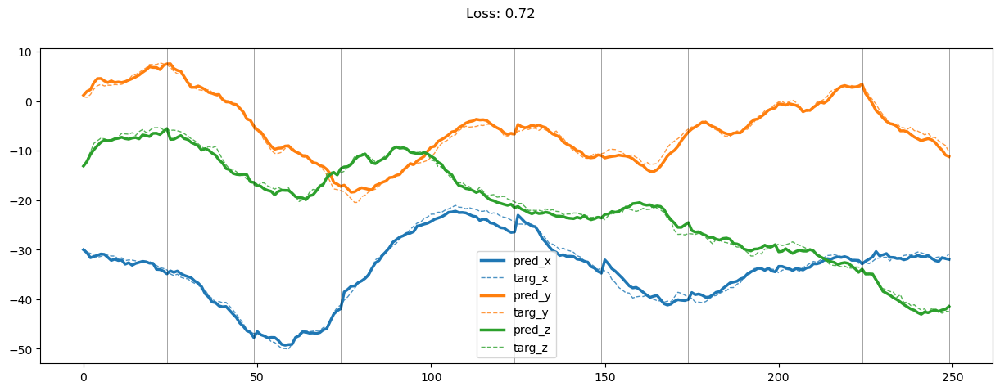

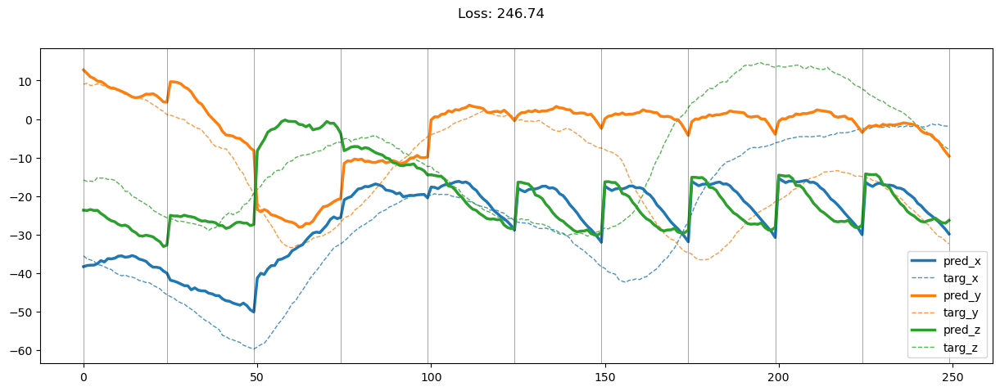

01399: train pred loss:  1.101, g loss:  3.744, diff loss:  2.168, d loss:  1.448
       valid pred loss:  165.938, g loss:  509.157, diff loss:  342.743, d loss:  1.448


100%|██████████| 17/17 [00:01<00:00, 15.24it/s]


01400: train pred loss:  1.107, g loss:  3.761, diff loss:  2.173, d loss:  1.444
       valid pred loss:  167.981, g loss:  513.914, diff loss:  345.451, d loss:  1.445


100%|██████████| 17/17 [00:01<00:00, 15.03it/s]


01401: train pred loss:  1.073, g loss:  3.663, diff loss:  2.104, d loss:  1.440
       valid pred loss:  166.806, g loss:  511.105, diff loss:  343.812, d loss:  1.442


100%|██████████| 17/17 [00:01<00:00, 14.94it/s]


01402: train pred loss:  1.092, g loss:  3.743, diff loss:  2.161, d loss:  1.438
       valid pred loss:  167.303, g loss:  509.682, diff loss:  341.888, d loss:  1.440


100%|██████████| 17/17 [00:01<00:00, 15.18it/s]


01403: train pred loss:  1.115, g loss:  3.776, diff loss:  2.168, d loss:  1.437
       valid pred loss:  165.435, g loss:  503.755, diff loss:  337.828, d loss:  1.439


100%|██████████| 17/17 [00:01<00:00, 15.17it/s]


01404: train pred loss:  1.098, g loss:  3.709, diff loss:  2.117, d loss:  1.436
       valid pred loss:  168.622, g loss:  511.387, diff loss:  342.273, d loss:  1.439


100%|██████████| 17/17 [00:01<00:00, 15.05it/s]


01405: train pred loss:  1.104, g loss:  3.733, diff loss:  2.135, d loss:  1.436
       valid pred loss:  167.573, g loss:  510.628, diff loss:  342.564, d loss:  1.440


100%|██████████| 17/17 [00:01<00:00, 15.16it/s]


01406: train pred loss:  1.108, g loss:  3.749, diff loss:  2.148, d loss:  1.436
       valid pred loss:  171.441, g loss:  527.970, diff loss:  356.039, d loss:  1.441


100%|██████████| 17/17 [00:01<00:00, 14.80it/s]


01407: train pred loss:  1.089, g loss:  3.715, diff loss:  2.136, d loss:  1.438
       valid pred loss:  167.725, g loss:  509.403, diff loss:  341.194, d loss:  1.444


100%|██████████| 17/17 [00:01<00:00, 15.25it/s]


01408: train pred loss:  1.074, g loss:  3.659, diff loss:  2.099, d loss:  1.440
       valid pred loss:  175.329, g loss:  536.185, diff loss:  360.375, d loss:  1.447


100%|██████████| 17/17 [00:01<00:00, 15.17it/s]


01409: train pred loss:  1.115, g loss:  3.729, diff loss:  2.133, d loss:  1.443
       valid pred loss:  163.401, g loss:  492.022, diff loss:  328.147, d loss:  1.450


100%|██████████| 17/17 [00:01<00:00, 15.04it/s]


01410: train pred loss:  1.140, g loss:  3.810, diff loss:  2.196, d loss:  1.448
       valid pred loss:  172.751, g loss:  532.587, diff loss:  359.368, d loss:  1.455


100%|██████████| 17/17 [00:01<00:00, 15.06it/s]


01411: train pred loss:  1.133, g loss:  3.820, diff loss:  2.219, d loss:  1.452
       valid pred loss:  164.879, g loss:  503.148, diff loss:  337.808, d loss:  1.460


100%|██████████| 17/17 [00:01<00:00, 15.14it/s]


01412: train pred loss:  1.132, g loss:  3.808, diff loss:  2.217, d loss:  1.457
       valid pred loss:  164.598, g loss:  499.862, diff loss:  334.811, d loss:  1.467


100%|██████████| 17/17 [00:01<00:00, 15.12it/s]


01413: train pred loss:  1.086, g loss:  3.673, diff loss:  2.136, d loss:  1.464
       valid pred loss:  161.587, g loss:  489.161, diff loss:  327.130, d loss:  1.473


100%|██████████| 17/17 [00:01<00:00, 15.19it/s]


01414: train pred loss:  1.058, g loss:  3.554, diff loss:  2.053, d loss:  1.470
       valid pred loss:  166.504, g loss:  502.032, diff loss:  335.094, d loss:  1.481


100%|██████████| 17/17 [00:01<00:00, 15.19it/s]


01415: train pred loss:  1.041, g loss:  3.515, diff loss:  2.041, d loss:  1.478
       valid pred loss:  162.821, g loss:  499.100, diff loss:  335.854, d loss:  1.489


100%|██████████| 17/17 [00:01<00:00, 15.11it/s]


01416: train pred loss:  1.042, g loss:  3.479, diff loss:  2.012, d loss:  1.486
       valid pred loss:  168.086, g loss:  510.852, diff loss:  342.350, d loss:  1.497


100%|██████████| 17/17 [00:01<00:00, 15.12it/s]


01417: train pred loss:  1.000, g loss:  3.362, diff loss:  1.947, d loss:  1.495
       valid pred loss:  165.918, g loss:  505.371, diff loss:  339.046, d loss:  1.506


100%|██████████| 17/17 [00:01<00:00, 15.23it/s]


01418: train pred loss:  1.011, g loss:  3.351, diff loss:  1.933, d loss:  1.502
       valid pred loss:  167.550, g loss:  511.463, diff loss:  343.515, d loss:  1.516


100%|██████████| 17/17 [00:01<00:00, 15.17it/s]


01419: train pred loss:  1.020, g loss:  3.393, diff loss:  1.974, d loss:  1.512
       valid pred loss:  163.837, g loss:  500.663, diff loss:  336.435, d loss:  1.525


100%|██████████| 17/17 [00:01<00:00, 15.17it/s]


01420: train pred loss:  1.038, g loss:  3.471, diff loss:  2.043, d loss:  1.520
       valid pred loss:  165.313, g loss:  499.882, diff loss:  334.188, d loss:  1.534


100%|██████████| 17/17 [00:01<00:00, 15.14it/s]


01421: train pred loss:  1.064, g loss:  3.528, diff loss:  2.082, d loss:  1.529
       valid pred loss:  162.830, g loss:  490.630, diff loss:  327.426, d loss:  1.544


100%|██████████| 17/17 [00:01<00:00, 15.17it/s]


01422: train pred loss:  1.128, g loss:  3.704, diff loss:  2.200, d loss:  1.538
       valid pred loss:  162.337, g loss:  494.065, diff loss:  331.361, d loss:  1.552


100%|██████████| 17/17 [00:01<00:00, 15.20it/s]


01423: train pred loss:  1.140, g loss:  3.726, diff loss:  2.218, d loss:  1.546
       valid pred loss:  166.637, g loss:  508.383, diff loss:  341.385, d loss:  1.560


100%|██████████| 17/17 [00:01<00:00, 15.16it/s]


01424: train pred loss:  1.142, g loss:  3.740, diff loss:  2.236, d loss:  1.554
       valid pred loss:  168.499, g loss:  518.187, diff loss:  349.333, d loss:  1.568


100%|██████████| 17/17 [00:01<00:00, 15.11it/s]


01425: train pred loss:  1.177, g loss:  3.768, diff loss:  2.234, d loss:  1.562
       valid pred loss:  162.857, g loss:  498.406, diff loss:  335.200, d loss:  1.576


100%|██████████| 17/17 [00:01<00:00, 14.69it/s]


01426: train pred loss:  1.089, g loss:  3.571, diff loss:  2.131, d loss:  1.569
       valid pred loss:  167.227, g loss:  511.509, diff loss:  343.938, d loss:  1.583


100%|██████████| 17/17 [00:01<00:00, 14.57it/s]


01427: train pred loss:  1.057, g loss:  3.487, diff loss:  2.083, d loss:  1.575
       valid pred loss:  164.801, g loss:  511.778, diff loss:  346.636, d loss:  1.588


100%|██████████| 17/17 [00:01<00:00, 15.12it/s]


01428: train pred loss:  1.083, g loss:  3.516, diff loss:  2.090, d loss:  1.580
       valid pred loss:  164.221, g loss:  503.414, diff loss:  338.856, d loss:  1.593


100%|██████████| 17/17 [00:01<00:00, 15.16it/s]


01429: train pred loss:  1.044, g loss:  3.437, diff loss:  2.053, d loss:  1.585
       valid pred loss:  164.215, g loss:  507.295, diff loss:  342.747, d loss:  1.598


100%|██████████| 17/17 [00:01<00:00, 15.13it/s]


01430: train pred loss:  1.049, g loss:  3.473, diff loss:  2.087, d loss:  1.589
       valid pred loss:  167.332, g loss:  515.751, diff loss:  348.087, d loss:  1.602


100%|██████████| 17/17 [00:01<00:00, 14.92it/s]


01431: train pred loss:  1.057, g loss:  3.477, diff loss:  2.085, d loss:  1.592
       valid pred loss:  164.005, g loss:  504.369, diff loss:  340.034, d loss:  1.605


100%|██████████| 17/17 [00:01<00:00, 15.19it/s]


01432: train pred loss:  1.036, g loss:  3.401, diff loss:  2.031, d loss:  1.594
       valid pred loss:  165.054, g loss:  505.627, diff loss:  340.244, d loss:  1.607


100%|██████████| 17/17 [00:01<00:00, 14.75it/s]


01433: train pred loss:  1.129, g loss:  3.701, diff loss:  2.239, d loss:  1.594
       valid pred loss:  166.066, g loss:  507.390, diff loss:  340.995, d loss:  1.606


100%|██████████| 17/17 [00:01<00:00, 15.14it/s]


01434: train pred loss:  1.180, g loss:  3.788, diff loss:  2.275, d loss:  1.594
       valid pred loss:  167.344, g loss:  516.834, diff loss:  349.161, d loss:  1.606


100%|██████████| 17/17 [00:01<00:00, 15.17it/s]


01435: train pred loss:  1.147, g loss:  3.711, diff loss:  2.231, d loss:  1.594
       valid pred loss:  167.110, g loss:  510.976, diff loss:  343.536, d loss:  1.604


100%|██████████| 17/17 [00:01<00:00, 14.20it/s]


01436: train pred loss:  1.142, g loss:  3.662, diff loss:  2.185, d loss:  1.592
       valid pred loss:  163.615, g loss:  505.093, diff loss:  341.146, d loss:  1.602


100%|██████████| 17/17 [00:01<00:00, 14.98it/s]


01437: train pred loss:  1.081, g loss:  3.544, diff loss:  2.126, d loss:  1.589
       valid pred loss:  165.415, g loss:  511.143, diff loss:  345.394, d loss:  1.598


100%|██████████| 17/17 [00:01<00:00, 15.19it/s]


01438: train pred loss:  1.077, g loss:  3.545, diff loss:  2.128, d loss:  1.585
       valid pred loss:  162.223, g loss:  500.286, diff loss:  337.727, d loss:  1.594


100%|██████████| 17/17 [00:01<00:00, 15.16it/s]


01439: train pred loss:  1.074, g loss:  3.546, diff loss:  2.129, d loss:  1.580
       valid pred loss:  165.984, g loss:  509.819, diff loss:  343.495, d loss:  1.589


100%|██████████| 17/17 [00:01<00:00, 15.20it/s]


01440: train pred loss:  1.098, g loss:  3.589, diff loss:  2.145, d loss:  1.575
       valid pred loss:  163.703, g loss:  500.344, diff loss:  336.296, d loss:  1.582


100%|██████████| 17/17 [00:01<00:00, 15.19it/s]


01441: train pred loss:  1.081, g loss:  3.540, diff loss:  2.108, d loss:  1.568
       valid pred loss:  164.148, g loss:  509.409, diff loss:  344.912, d loss:  1.576


100%|██████████| 17/17 [00:01<00:00, 15.21it/s]


01442: train pred loss:  1.124, g loss:  3.685, diff loss:  2.206, d loss:  1.562
       valid pred loss:  163.582, g loss:  503.371, diff loss:  339.435, d loss:  1.568


100%|██████████| 17/17 [00:01<00:00, 15.17it/s]


01443: train pred loss:  1.093, g loss:  3.597, diff loss:  2.143, d loss:  1.555
       valid pred loss:  165.704, g loss:  504.249, diff loss:  338.185, d loss:  1.561


100%|██████████| 17/17 [00:01<00:00, 15.23it/s]


01444: train pred loss:  1.091, g loss:  3.603, diff loss:  2.145, d loss:  1.548
       valid pred loss:  162.874, g loss:  496.240, diff loss:  333.000, d loss:  1.554


100%|██████████| 17/17 [00:01<00:00, 15.21it/s]


01445: train pred loss:  1.098, g loss:  3.622, diff loss:  2.151, d loss:  1.540
       valid pred loss:  168.135, g loss:  518.106, diff loss:  349.598, d loss:  1.545


100%|██████████| 17/17 [00:01<00:00, 14.94it/s]


01446: train pred loss:  1.086, g loss:  3.581, diff loss:  2.116, d loss:  1.532
       valid pred loss:  165.393, g loss:  508.834, diff loss:  343.062, d loss:  1.537


100%|██████████| 17/17 [00:01<00:00, 15.23it/s]


01447: train pred loss:  1.096, g loss:  3.629, diff loss:  2.147, d loss:  1.524
       valid pred loss:  163.691, g loss:  504.442, diff loss:  340.365, d loss:  1.529


100%|██████████| 17/17 [00:01<00:00, 15.20it/s]


01448: train pred loss:  1.036, g loss:  3.484, diff loss:  2.054, d loss:  1.516
       valid pred loss:  162.772, g loss:  502.764, diff loss:  339.598, d loss:  1.521


100%|██████████| 17/17 [00:01<00:00, 14.98it/s]


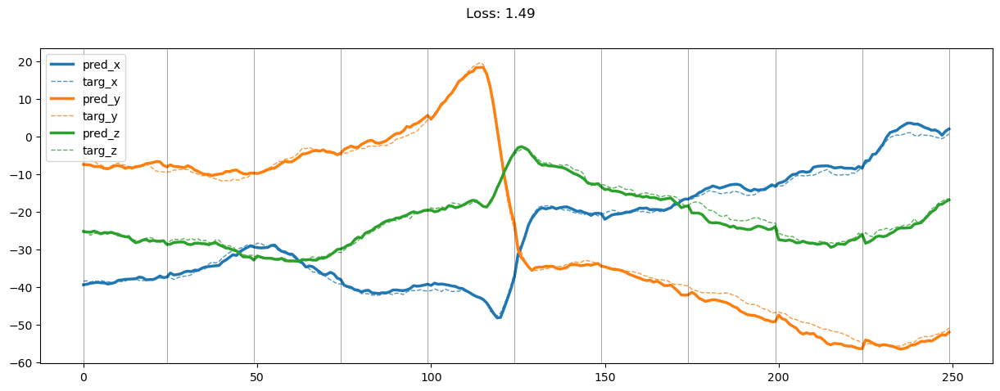

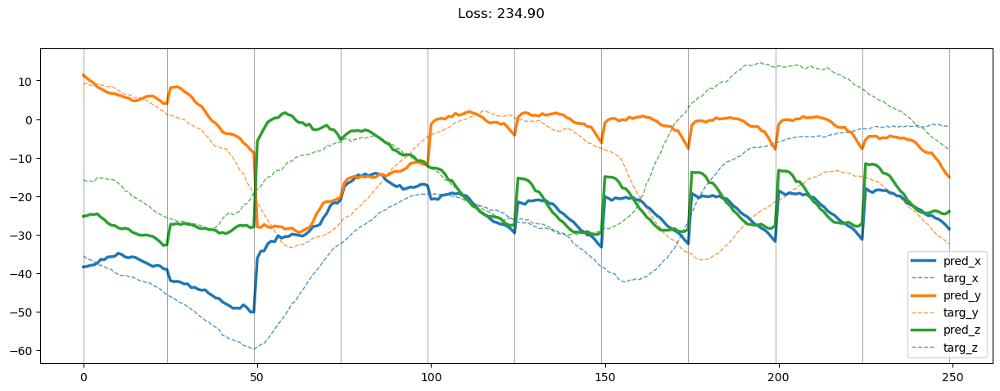

01449: train pred loss:  1.010, g loss:  3.394, diff loss:  1.983, d loss:  1.508
       valid pred loss:  165.921, g loss:  513.924, diff loss:  347.601, d loss:  1.512


100%|██████████| 17/17 [00:01<00:00, 15.16it/s]


01450: train pred loss:  0.981, g loss:  3.312, diff loss:  1.923, d loss:  1.501
       valid pred loss:  163.542, g loss:  502.415, diff loss:  338.463, d loss:  1.504


100%|██████████| 17/17 [00:01<00:00, 15.26it/s]


01451: train pred loss:  0.980, g loss:  3.347, diff loss:  1.950, d loss:  1.492
       valid pred loss:  164.945, g loss:  510.195, diff loss:  344.831, d loss:  1.497


100%|██████████| 17/17 [00:01<00:00, 14.78it/s]


01452: train pred loss:  0.990, g loss:  3.377, diff loss:  1.963, d loss:  1.486
       valid pred loss:  162.330, g loss:  504.733, diff loss:  341.976, d loss:  1.489


100%|██████████| 17/17 [00:01<00:00, 15.08it/s]


01453: train pred loss:  1.042, g loss:  3.528, diff loss:  2.054, d loss:  1.479
       valid pred loss:  165.252, g loss:  510.182, diff loss:  344.495, d loss:  1.483


100%|██████████| 17/17 [00:01<00:00, 15.01it/s]


01454: train pred loss:  1.052, g loss:  3.506, diff loss:  2.013, d loss:  1.472
       valid pred loss:  164.472, g loss:  509.353, diff loss:  344.439, d loss:  1.477


100%|██████████| 17/17 [00:01<00:00, 15.25it/s]


01455: train pred loss:  1.039, g loss:  3.479, diff loss:  1.993, d loss:  1.467
       valid pred loss:  163.284, g loss:  500.698, diff loss:  336.966, d loss:  1.471


100%|██████████| 17/17 [00:01<00:00, 15.07it/s]


01456: train pred loss:  1.013, g loss:  3.435, diff loss:  1.968, d loss:  1.461
       valid pred loss:  164.695, g loss:  504.775, diff loss:  339.624, d loss:  1.465


100%|██████████| 17/17 [00:01<00:00, 15.20it/s]


01457: train pred loss:  1.011, g loss:  3.441, diff loss:  1.969, d loss:  1.457
       valid pred loss:  166.182, g loss:  505.796, diff loss:  339.151, d loss:  1.460


100%|██████████| 17/17 [00:01<00:00, 15.20it/s]


01458: train pred loss:  1.056, g loss:  3.582, diff loss:  2.060, d loss:  1.453
       valid pred loss:  166.243, g loss:  509.392, diff loss:  342.681, d loss:  1.457


100%|██████████| 17/17 [00:01<00:00, 15.21it/s]


01459: train pred loss:  1.036, g loss:  3.546, diff loss:  2.038, d loss:  1.449
       valid pred loss:  164.836, g loss:  500.277, diff loss:  334.968, d loss:  1.453


100%|██████████| 17/17 [00:01<00:00, 15.24it/s]


01460: train pred loss:  1.047, g loss:  3.536, diff loss:  2.013, d loss:  1.446
       valid pred loss:  169.350, g loss:  514.677, diff loss:  344.849, d loss:  1.450


100%|██████████| 17/17 [00:01<00:00, 15.25it/s]


01461: train pred loss:  1.008, g loss:  3.479, diff loss:  1.990, d loss:  1.444
       valid pred loss:  172.016, g loss:  531.328, diff loss:  358.831, d loss:  1.448


100%|██████████| 17/17 [00:01<00:00, 15.20it/s]


01462: train pred loss:  1.109, g loss:  3.696, diff loss:  2.104, d loss:  1.442
       valid pred loss:  168.033, g loss:  511.065, diff loss:  342.549, d loss:  1.446


100%|██████████| 17/17 [00:01<00:00, 15.18it/s]


01463: train pred loss:  1.143, g loss:  3.782, diff loss:  2.154, d loss:  1.441
       valid pred loss:  166.663, g loss:  508.042, diff loss:  340.894, d loss:  1.446


100%|██████████| 17/17 [00:01<00:00, 15.17it/s]


01464: train pred loss:  1.067, g loss:  3.663, diff loss:  2.108, d loss:  1.439
       valid pred loss:  164.570, g loss:  500.199, diff loss:  335.145, d loss:  1.446


100%|██████████| 17/17 [00:01<00:00, 14.92it/s]


01465: train pred loss:  1.052, g loss:  3.600, diff loss:  2.061, d loss:  1.440
       valid pred loss:  162.524, g loss:  496.274, diff loss:  333.265, d loss:  1.446


100%|██████████| 17/17 [00:01<00:00, 15.21it/s]


01466: train pred loss:  1.091, g loss:  3.751, diff loss:  2.175, d loss:  1.440
       valid pred loss:  165.410, g loss:  502.023, diff loss:  336.130, d loss:  1.446


100%|██████████| 17/17 [00:01<00:00, 15.19it/s]


01467: train pred loss:  1.045, g loss:  3.594, diff loss:  2.066, d loss:  1.442
       valid pred loss:  162.456, g loss:  493.271, diff loss:  330.333, d loss:  1.448


100%|██████████| 17/17 [00:01<00:00, 15.20it/s]


01468: train pred loss:  1.012, g loss:  3.498, diff loss:  2.006, d loss:  1.444
       valid pred loss:  165.892, g loss:  507.766, diff loss:  341.397, d loss:  1.450


100%|██████████| 17/17 [00:01<00:00, 15.08it/s]


01469: train pred loss:  1.036, g loss:  3.529, diff loss:  2.017, d loss:  1.446
       valid pred loss:  161.362, g loss:  498.801, diff loss:  336.968, d loss:  1.454


100%|██████████| 17/17 [00:01<00:00, 15.15it/s]


01470: train pred loss:  1.056, g loss:  3.609, diff loss:  2.081, d loss:  1.449
       valid pred loss:  164.061, g loss:  503.025, diff loss:  338.496, d loss:  1.457


100%|██████████| 17/17 [00:01<00:00, 15.19it/s]


01471: train pred loss:  1.101, g loss:  3.655, diff loss:  2.088, d loss:  1.453
       valid pred loss:  164.036, g loss:  501.513, diff loss:  337.014, d loss:  1.461


100%|██████████| 17/17 [00:01<00:00, 15.21it/s]


01472: train pred loss:  1.058, g loss:  3.570, diff loss:  2.052, d loss:  1.457
       valid pred loss:  163.187, g loss:  494.581, diff loss:  330.939, d loss:  1.466


100%|██████████| 17/17 [00:01<00:00, 15.13it/s]


01473: train pred loss:  1.001, g loss:  3.396, diff loss:  1.940, d loss:  1.462
       valid pred loss:  163.010, g loss:  499.426, diff loss:  335.967, d loss:  1.470


100%|██████████| 17/17 [00:01<00:00, 15.22it/s]


01474: train pred loss:  1.002, g loss:  3.400, diff loss:  1.951, d loss:  1.467
       valid pred loss:  164.082, g loss:  495.547, diff loss:  331.024, d loss:  1.477


100%|██████████| 17/17 [00:01<00:00, 15.22it/s]


01475: train pred loss:  0.974, g loss:  3.324, diff loss:  1.910, d loss:  1.473
       valid pred loss:  163.383, g loss:  500.556, diff loss:  336.739, d loss:  1.482


100%|██████████| 17/17 [00:01<00:00, 15.23it/s]


01476: train pred loss:  1.000, g loss:  3.403, diff loss:  1.971, d loss:  1.479
       valid pred loss:  161.635, g loss:  490.509, diff loss:  328.447, d loss:  1.487


100%|██████████| 17/17 [00:01<00:00, 15.24it/s]


01477: train pred loss:  1.034, g loss:  3.446, diff loss:  1.987, d loss:  1.485
       valid pred loss:  161.873, g loss:  500.264, diff loss:  337.972, d loss:  1.495


100%|██████████| 17/17 [00:01<00:00, 15.23it/s]


01478: train pred loss:  0.999, g loss:  3.349, diff loss:  1.933, d loss:  1.492
       valid pred loss:  158.549, g loss:  482.152, diff loss:  323.191, d loss:  1.502


100%|██████████| 17/17 [00:01<00:00, 15.24it/s]


01479: train pred loss:  0.970, g loss:  3.299, diff loss:  1.920, d loss:  1.500
       valid pred loss:  160.587, g loss:  489.587, diff loss:  328.596, d loss:  1.509


100%|██████████| 17/17 [00:01<00:00, 15.28it/s]


01480: train pred loss:  0.969, g loss:  3.265, diff loss:  1.894, d loss:  1.507
       valid pred loss:  161.749, g loss:  498.648, diff loss:  336.503, d loss:  1.517


100%|██████████| 17/17 [00:01<00:00, 14.94it/s]


01481: train pred loss:  0.991, g loss:  3.304, diff loss:  1.919, d loss:  1.514
       valid pred loss:  169.886, g loss:  521.559, diff loss:  351.284, d loss:  1.524


100%|██████████| 17/17 [00:01<00:00, 14.95it/s]


01482: train pred loss:  1.011, g loss:  3.374, diff loss:  1.974, d loss:  1.522
       valid pred loss:  166.276, g loss:  506.001, diff loss:  339.342, d loss:  1.532


100%|██████████| 17/17 [00:01<00:00, 14.40it/s]


01483: train pred loss:  1.005, g loss:  3.344, diff loss:  1.956, d loss:  1.528
       valid pred loss:  162.697, g loss:  494.823, diff loss:  331.749, d loss:  1.539


100%|██████████| 17/17 [00:01<00:00, 15.22it/s]


01484: train pred loss:  0.969, g loss:  3.250, diff loss:  1.906, d loss:  1.536
       valid pred loss:  163.314, g loss:  501.851, diff loss:  338.167, d loss:  1.546


100%|██████████| 17/17 [00:01<00:00, 15.25it/s]


01485: train pred loss:  0.981, g loss:  3.269, diff loss:  1.918, d loss:  1.543
       valid pred loss:  164.735, g loss:  504.867, diff loss:  339.766, d loss:  1.553


100%|██████████| 17/17 [00:01<00:00, 14.98it/s]


01486: train pred loss:  1.026, g loss:  3.401, diff loss:  2.010, d loss:  1.550
       valid pred loss:  162.885, g loss:  497.632, diff loss:  334.386, d loss:  1.560


100%|██████████| 17/17 [00:01<00:00, 15.27it/s]


01487: train pred loss:  0.991, g loss:  3.315, diff loss:  1.965, d loss:  1.556
       valid pred loss:  162.567, g loss:  495.465, diff loss:  332.543, d loss:  1.566


100%|██████████| 17/17 [00:01<00:00, 14.10it/s]


01488: train pred loss:  1.107, g loss:  3.632, diff loss:  2.169, d loss:  1.561
       valid pred loss:  162.485, g loss:  490.071, diff loss:  327.234, d loss:  1.572


100%|██████████| 17/17 [00:01<00:00, 15.00it/s]


01489: train pred loss:  1.063, g loss:  3.496, diff loss:  2.082, d loss:  1.567
       valid pred loss:  159.675, g loss:  486.201, diff loss:  326.178, d loss:  1.578


100%|██████████| 17/17 [00:01<00:00, 15.17it/s]


01490: train pred loss:  1.026, g loss:  3.377, diff loss:  2.003, d loss:  1.572
       valid pred loss:  162.980, g loss:  498.626, diff loss:  335.301, d loss:  1.582


100%|██████████| 17/17 [00:01<00:00, 15.16it/s]


01491: train pred loss:  1.042, g loss:  3.439, diff loss:  2.052, d loss:  1.576
       valid pred loss:  164.956, g loss:  506.464, diff loss:  341.166, d loss:  1.585


100%|██████████| 17/17 [00:01<00:00, 15.14it/s]


01492: train pred loss:  1.034, g loss:  3.390, diff loss:  2.013, d loss:  1.580
       valid pred loss:  164.201, g loss:  502.132, diff loss:  337.591, d loss:  1.589


100%|██████████| 17/17 [00:01<00:00, 15.13it/s]


01493: train pred loss:  1.028, g loss:  3.385, diff loss:  2.016, d loss:  1.582
       valid pred loss:  162.521, g loss:  496.649, diff loss:  333.790, d loss:  1.592


100%|██████████| 17/17 [00:01<00:00, 15.18it/s]


01494: train pred loss:  0.995, g loss:  3.302, diff loss:  1.967, d loss:  1.585
       valid pred loss:  162.948, g loss:  500.202, diff loss:  336.918, d loss:  1.593


100%|██████████| 17/17 [00:01<00:00, 15.15it/s]


01495: train pred loss:  0.979, g loss:  3.234, diff loss:  1.916, d loss:  1.587
       valid pred loss:  162.220, g loss:  496.395, diff loss:  333.840, d loss:  1.595


100%|██████████| 17/17 [00:01<00:00, 15.07it/s]


01496: train pred loss:  0.998, g loss:  3.287, diff loss:  1.951, d loss:  1.587
       valid pred loss:  163.443, g loss:  503.465, diff loss:  339.686, d loss:  1.595


100%|██████████| 17/17 [00:01<00:00, 15.22it/s]


01497: train pred loss:  0.988, g loss:  3.267, diff loss:  1.941, d loss:  1.587
       valid pred loss:  160.370, g loss:  493.503, diff loss:  332.796, d loss:  1.594


100%|██████████| 17/17 [00:01<00:00, 15.14it/s]


01498: train pred loss:  0.980, g loss:  3.250, diff loss:  1.932, d loss:  1.586
       valid pred loss:  164.150, g loss:  502.746, diff loss:  338.259, d loss:  1.592


100%|██████████| 17/17 [00:01<00:00, 13.92it/s]


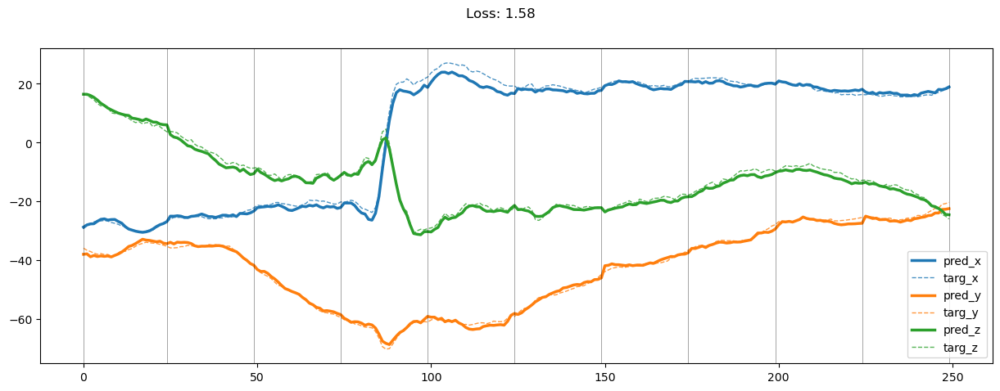

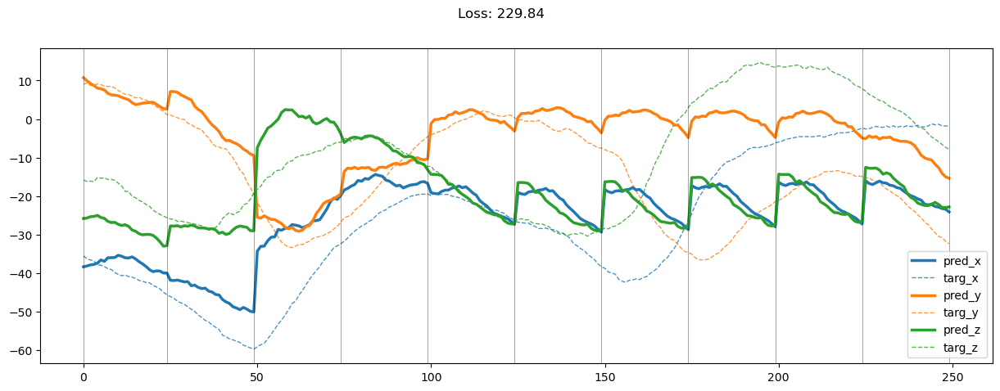

01499: train pred loss:  1.028, g loss:  3.422, diff loss:  2.055, d loss:  1.585
       valid pred loss:  161.759, g loss:  493.149, diff loss:  331.052, d loss:  1.592


100%|██████████| 17/17 [00:01<00:00, 15.13it/s]


01500: train pred loss:  1.117, g loss:  3.650, diff loss:  2.192, d loss:  1.583
       valid pred loss:  167.899, g loss:  510.341, diff loss:  342.103, d loss:  1.589


100%|██████████| 17/17 [00:01<00:00, 15.15it/s]


01501: train pred loss:  1.129, g loss:  3.666, diff loss:  2.194, d loss:  1.580
       valid pred loss:  167.497, g loss:  511.046, diff loss:  343.207, d loss:  1.585


100%|██████████| 17/17 [00:01<00:00, 15.18it/s]


01502: train pred loss:  1.070, g loss:  3.532, diff loss:  2.118, d loss:  1.577
       valid pred loss:  167.925, g loss:  516.903, diff loss:  348.634, d loss:  1.582


100%|██████████| 17/17 [00:01<00:00, 14.92it/s]


01503: train pred loss:  1.016, g loss:  3.355, diff loss:  1.991, d loss:  1.573
       valid pred loss:  167.773, g loss:  512.893, diff loss:  344.772, d loss:  1.577


100%|██████████| 17/17 [00:01<00:00, 14.65it/s]


01504: train pred loss:  1.038, g loss:  3.436, diff loss:  2.047, d loss:  1.568
       valid pred loss:  167.603, g loss:  510.376, diff loss:  342.422, d loss:  1.572


100%|██████████| 17/17 [00:01<00:00, 15.16it/s]


01505: train pred loss:  1.108, g loss:  3.648, diff loss:  2.185, d loss:  1.563
       valid pred loss:  166.938, g loss:  505.833, diff loss:  338.540, d loss:  1.566


100%|██████████| 17/17 [00:01<00:00, 15.00it/s]


01506: train pred loss:  1.097, g loss:  3.585, diff loss:  2.129, d loss:  1.557
       valid pred loss:  167.828, g loss:  515.882, diff loss:  347.694, d loss:  1.561


100%|██████████| 17/17 [00:01<00:00, 15.02it/s]


01507: train pred loss:  1.070, g loss:  3.529, diff loss:  2.096, d loss:  1.551
       valid pred loss:  168.453, g loss:  508.137, diff loss:  339.319, d loss:  1.554


100%|██████████| 17/17 [00:01<00:00, 14.82it/s]


01508: train pred loss:  1.068, g loss:  3.517, diff loss:  2.080, d loss:  1.545
       valid pred loss:  165.704, g loss:  507.751, diff loss:  341.677, d loss:  1.548


100%|██████████| 17/17 [00:01<00:00, 15.14it/s]


01509: train pred loss:  1.070, g loss:  3.488, diff loss:  2.043, d loss:  1.538
       valid pred loss:  167.533, g loss:  509.888, diff loss:  341.980, d loss:  1.541


100%|██████████| 17/17 [00:01<00:00, 14.60it/s]


01510: train pred loss:  1.051, g loss:  3.506, diff loss:  2.076, d loss:  1.531
       valid pred loss:  164.255, g loss:  504.237, diff loss:  339.600, d loss:  1.534


100%|██████████| 17/17 [00:01<00:00, 14.64it/s]


01511: train pred loss:  0.987, g loss:  3.343, diff loss:  1.970, d loss:  1.525
       valid pred loss:  167.051, g loss:  506.585, diff loss:  339.147, d loss:  1.527


100%|██████████| 17/17 [00:01<00:00, 15.18it/s]


01512: train pred loss:  0.975, g loss:  3.276, diff loss:  1.909, d loss:  1.519
       valid pred loss:  166.478, g loss:  510.787, diff loss:  343.916, d loss:  1.520


100%|██████████| 17/17 [00:01<00:00, 15.03it/s]


01513: train pred loss:  1.008, g loss:  3.368, diff loss:  1.962, d loss:  1.511
       valid pred loss:  166.372, g loss:  508.809, diff loss:  342.036, d loss:  1.513


100%|██████████| 17/17 [00:01<00:00, 14.65it/s]


01514: train pred loss:  0.998, g loss:  3.369, diff loss:  1.966, d loss:  1.504
       valid pred loss:  166.468, g loss:  506.337, diff loss:  339.461, d loss:  1.506


100%|██████████| 17/17 [00:01<00:00, 14.41it/s]


01515: train pred loss:  0.990, g loss:  3.311, diff loss:  1.910, d loss:  1.498
       valid pred loss:  165.629, g loss:  505.032, diff loss:  338.989, d loss:  1.499


100%|██████████| 17/17 [00:01<00:00, 14.82it/s]


01516: train pred loss:  0.985, g loss:  3.343, diff loss:  1.941, d loss:  1.491
       valid pred loss:  161.763, g loss:  490.897, diff loss:  328.713, d loss:  1.493


100%|██████████| 17/17 [00:01<00:00, 14.83it/s]


01517: train pred loss:  0.997, g loss:  3.379, diff loss:  1.957, d loss:  1.486
       valid pred loss:  162.474, g loss:  498.615, diff loss:  335.713, d loss:  1.486


100%|██████████| 17/17 [00:01<00:00, 15.07it/s]


01518: train pred loss:  0.966, g loss:  3.284, diff loss:  1.886, d loss:  1.479
       valid pred loss:  163.479, g loss:  499.813, diff loss:  335.899, d loss:  1.481


100%|██████████| 17/17 [00:01<00:00, 15.17it/s]


01519: train pred loss:  0.954, g loss:  3.254, diff loss:  1.861, d loss:  1.474
       valid pred loss:  161.982, g loss:  492.696, diff loss:  330.273, d loss:  1.475


100%|██████████| 17/17 [00:01<00:00, 15.12it/s]


01520: train pred loss:  0.948, g loss:  3.271, diff loss:  1.878, d loss:  1.469
       valid pred loss:  164.652, g loss:  500.579, diff loss:  335.479, d loss:  1.470


100%|██████████| 17/17 [00:01<00:00, 15.19it/s]


01521: train pred loss:  1.018, g loss:  3.453, diff loss:  1.984, d loss:  1.463
       valid pred loss:  165.521, g loss:  504.846, diff loss:  338.871, d loss:  1.466


100%|██████████| 17/17 [00:01<00:00, 15.22it/s]


01522: train pred loss:  1.007, g loss:  3.447, diff loss:  1.984, d loss:  1.460
       valid pred loss:  165.559, g loss:  506.583, diff loss:  340.565, d loss:  1.462


100%|██████████| 17/17 [00:01<00:00, 15.21it/s]


01523: train pred loss:  0.980, g loss:  3.342, diff loss:  1.900, d loss:  1.456
       valid pred loss:  167.916, g loss:  511.888, diff loss:  343.507, d loss:  1.457


100%|██████████| 17/17 [00:01<00:00, 15.22it/s]


01524: train pred loss:  0.956, g loss:  3.278, diff loss:  1.856, d loss:  1.453
       valid pred loss:  164.689, g loss:  501.709, diff loss:  336.552, d loss:  1.455


100%|██████████| 17/17 [00:01<00:00, 14.83it/s]


01525: train pred loss:  0.950, g loss:  3.279, diff loss:  1.859, d loss:  1.450
       valid pred loss:  165.943, g loss:  506.054, diff loss:  339.638, d loss:  1.452


100%|██████████| 17/17 [00:01<00:00, 14.99it/s]


01526: train pred loss:  0.965, g loss:  3.314, diff loss:  1.874, d loss:  1.448
       valid pred loss:  163.197, g loss:  495.882, diff loss:  332.209, d loss:  1.449


100%|██████████| 17/17 [00:01<00:00, 15.20it/s]


01527: train pred loss:  0.960, g loss:  3.332, diff loss:  1.894, d loss:  1.445
       valid pred loss:  163.826, g loss:  498.433, diff loss:  334.129, d loss:  1.448


100%|██████████| 17/17 [00:01<00:00, 15.19it/s]


01528: train pred loss:  0.975, g loss:  3.354, diff loss:  1.899, d loss:  1.444
       valid pred loss:  165.182, g loss:  509.241, diff loss:  343.579, d loss:  1.447


100%|██████████| 17/17 [00:01<00:00, 15.17it/s]


01529: train pred loss:  0.963, g loss:  3.309, diff loss:  1.867, d loss:  1.444
       valid pred loss:  165.938, g loss:  506.699, diff loss:  340.279, d loss:  1.447


100%|██████████| 17/17 [00:01<00:00, 15.15it/s]


01530: train pred loss:  0.950, g loss:  3.298, diff loss:  1.867, d loss:  1.443
       valid pred loss:  165.198, g loss:  509.110, diff loss:  343.430, d loss:  1.446


100%|██████████| 17/17 [00:01<00:00, 15.13it/s]


01531: train pred loss:  0.933, g loss:  3.265, diff loss:  1.852, d loss:  1.444
       valid pred loss:  162.880, g loss:  497.305, diff loss:  333.943, d loss:  1.446


100%|██████████| 17/17 [00:01<00:00, 15.04it/s]


01532: train pred loss:  0.968, g loss:  3.339, diff loss:  1.892, d loss:  1.444
       valid pred loss:  163.185, g loss:  498.934, diff loss:  335.270, d loss:  1.448


100%|██████████| 17/17 [00:01<00:00, 15.07it/s]


01533: train pred loss:  0.949, g loss:  3.312, diff loss:  1.885, d loss:  1.445
       valid pred loss:  168.560, g loss:  511.424, diff loss:  342.388, d loss:  1.451


100%|██████████| 17/17 [00:01<00:00, 15.16it/s]


01534: train pred loss:  0.934, g loss:  3.255, diff loss:  1.847, d loss:  1.447
       valid pred loss:  162.708, g loss:  495.391, diff loss:  332.211, d loss:  1.452


100%|██████████| 17/17 [00:01<00:00, 15.10it/s]


01535: train pred loss:  0.893, g loss:  3.122, diff loss:  1.758, d loss:  1.450
       valid pred loss:  165.537, g loss:  506.053, diff loss:  340.047, d loss:  1.455


100%|██████████| 17/17 [00:01<00:00, 15.03it/s]


01536: train pred loss:  0.939, g loss:  3.214, diff loss:  1.808, d loss:  1.452
       valid pred loss:  165.344, g loss:  509.401, diff loss:  343.594, d loss:  1.458


100%|██████████| 17/17 [00:01<00:00, 15.05it/s]


01537: train pred loss:  0.934, g loss:  3.226, diff loss:  1.831, d loss:  1.456
       valid pred loss:  164.777, g loss:  501.121, diff loss:  335.885, d loss:  1.461


100%|██████████| 17/17 [00:01<00:00, 15.04it/s]


01538: train pred loss:  0.942, g loss:  3.237, diff loss:  1.839, d loss:  1.460
       valid pred loss:  163.412, g loss:  504.210, diff loss:  340.345, d loss:  1.466


100%|██████████| 17/17 [00:01<00:00, 15.07it/s]


01539: train pred loss:  0.934, g loss:  3.196, diff loss:  1.812, d loss:  1.465
       valid pred loss:  164.316, g loss:  501.470, diff loss:  336.708, d loss:  1.471


100%|██████████| 17/17 [00:01<00:00, 15.09it/s]


01540: train pred loss:  0.958, g loss:  3.250, diff loss:  1.848, d loss:  1.470
       valid pred loss:  161.921, g loss:  492.410, diff loss:  330.049, d loss:  1.475


100%|██████████| 17/17 [00:01<00:00, 15.08it/s]


01541: train pred loss:  0.905, g loss:  3.136, diff loss:  1.794, d loss:  1.474
       valid pred loss:  164.821, g loss:  507.448, diff loss:  342.194, d loss:  1.482


100%|██████████| 17/17 [00:01<00:00, 15.02it/s]


01542: train pred loss:  1.018, g loss:  3.447, diff loss:  1.998, d loss:  1.480
       valid pred loss:  163.316, g loss:  494.101, diff loss:  330.359, d loss:  1.489


100%|██████████| 17/17 [00:01<00:00, 14.15it/s]


01543: train pred loss:  1.156, g loss:  3.850, diff loss:  2.271, d loss:  1.486
       valid pred loss:  162.923, g loss:  493.487, diff loss:  330.145, d loss:  1.495


100%|██████████| 17/17 [00:01<00:00, 14.97it/s]


01544: train pred loss:  1.381, g loss:  4.500, diff loss:  2.702, d loss:  1.492
       valid pred loss:  165.742, g loss:  500.222, diff loss:  334.068, d loss:  1.502


100%|██████████| 17/17 [00:01<00:00, 14.45it/s]


01545: train pred loss:  2.052, g loss:  6.378, diff loss:  3.916, d loss:  1.499
       valid pred loss:  169.960, g loss:  505.321, diff loss:  334.955, d loss:  1.507


100%|██████████| 17/17 [00:01<00:00, 14.43it/s]


01546: train pred loss:  3.006, g loss:  9.109, diff loss:  5.700, d loss:  1.505
       valid pred loss:  181.864, g loss:  521.739, diff loss:  339.476, d loss:  1.515


100%|██████████| 17/17 [00:01<00:00, 15.09it/s]


01547: train pred loss:  4.151, g loss:  12.537, diff loss:  7.990, d loss:  1.513
       valid pred loss:  183.102, g loss:  538.914, diff loss:  355.421, d loss:  1.523


100%|██████████| 17/17 [00:01<00:00, 15.11it/s]


01548: train pred loss:  8.833, g loss:  24.854, diff loss:  15.630, d loss:  1.519
       valid pred loss:  240.299, g loss:  647.033, diff loss:  406.349, d loss:  1.530


100%|██████████| 17/17 [00:01<00:00, 15.03it/s]


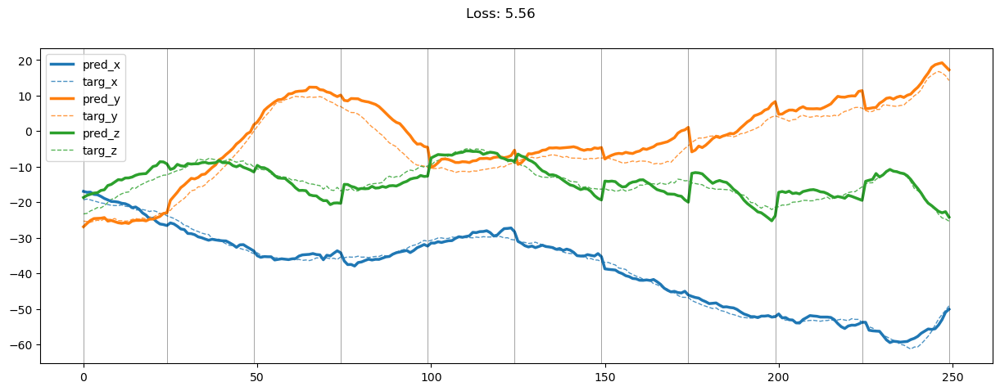

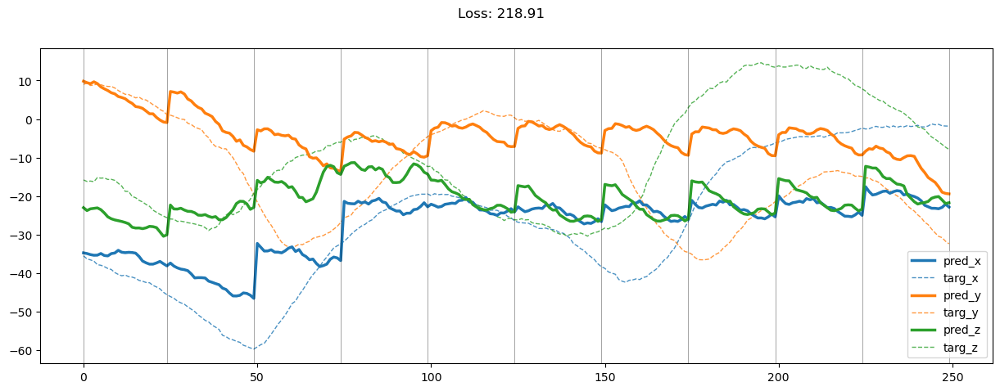

01549: train pred loss:  10.674, g loss:  31.061, diff loss:  20.002, d loss:  1.525
       valid pred loss:  182.737, g loss:  541.417, diff loss:  358.301, d loss:  1.538


100%|██████████| 17/17 [00:01<00:00, 15.14it/s]


01550: train pred loss:  7.683, g loss:  22.643, diff loss:  14.582, d loss:  1.533
       valid pred loss:  252.711, g loss:  680.443, diff loss:  427.359, d loss:  1.545


100%|██████████| 17/17 [00:01<00:00, 15.19it/s]


01551: train pred loss:  9.441, g loss:  27.820, diff loss:  18.007, d loss:  1.539
       valid pred loss:  244.271, g loss:  628.030, diff loss:  383.391, d loss:  1.550


100%|██████████| 17/17 [00:01<00:00, 15.13it/s]


01552: train pred loss:  7.887, g loss:  23.913, diff loss:  15.658, d loss:  1.545
       valid pred loss:  173.414, g loss:  493.482, diff loss:  319.706, d loss:  1.556


100%|██████████| 17/17 [00:01<00:00, 14.85it/s]


01553: train pred loss:  5.101, g loss:  15.338, diff loss:  9.874, d loss:  1.551
       valid pred loss:  202.792, g loss:  647.638, diff loss:  444.488, d loss:  1.562


100%|██████████| 17/17 [00:01<00:00, 14.69it/s]


01554: train pred loss:  3.362, g loss:  10.332, diff loss:  6.612, d loss:  1.557
       valid pred loss:  190.886, g loss:  593.558, diff loss:  402.318, d loss:  1.567


100%|██████████| 17/17 [00:01<00:00, 15.05it/s]


01555: train pred loss:  2.885, g loss:  8.948, diff loss:  5.709, d loss:  1.563
       valid pred loss:  179.304, g loss:  541.254, diff loss:  361.599, d loss:  1.574


100%|██████████| 17/17 [00:01<00:00, 15.23it/s]


01556: train pred loss:  2.637, g loss:  8.198, diff loss:  5.210, d loss:  1.567
       valid pred loss:  166.969, g loss:  496.123, diff loss:  328.807, d loss:  1.577


100%|██████████| 17/17 [00:01<00:00, 15.12it/s]


01557: train pred loss:  2.155, g loss:  6.679, diff loss:  4.175, d loss:  1.571
       valid pred loss:  167.169, g loss:  499.162, diff loss:  331.648, d loss:  1.582


100%|██████████| 17/17 [00:01<00:00, 14.82it/s]


01558: train pred loss:  1.755, g loss:  5.579, diff loss:  3.478, d loss:  1.575
       valid pred loss:  164.564, g loss:  490.858, diff loss:  325.952, d loss:  1.584


100%|██████████| 17/17 [00:01<00:00, 15.18it/s]


01559: train pred loss:  1.582, g loss:  5.039, diff loss:  3.113, d loss:  1.577
       valid pred loss:  168.939, g loss:  503.347, diff loss:  334.067, d loss:  1.586


100%|██████████| 17/17 [00:01<00:00, 15.02it/s]


01560: train pred loss:  1.472, g loss:  4.713, diff loss:  2.898, d loss:  1.579
       valid pred loss:  167.672, g loss:  498.373, diff loss:  330.360, d loss:  1.588


100%|██████████| 17/17 [00:01<00:00, 15.12it/s]


01561: train pred loss:  1.401, g loss:  4.515, diff loss:  2.771, d loss:  1.579
       valid pred loss:  166.876, g loss:  500.024, diff loss:  332.809, d loss:  1.588


100%|██████████| 17/17 [00:01<00:00, 15.12it/s]


01562: train pred loss:  1.349, g loss:  4.370, diff loss:  2.678, d loss:  1.580
       valid pred loss:  169.818, g loss:  506.488, diff loss:  336.330, d loss:  1.588


100%|██████████| 17/17 [00:01<00:00, 15.07it/s]


01563: train pred loss:  1.301, g loss:  4.238, diff loss:  2.593, d loss:  1.579
       valid pred loss:  166.802, g loss:  496.108, diff loss:  328.964, d loss:  1.586


100%|██████████| 17/17 [00:01<00:00, 15.10it/s]


01564: train pred loss:  1.262, g loss:  4.129, diff loss:  2.522, d loss:  1.578
       valid pred loss:  167.086, g loss:  497.811, diff loss:  330.382, d loss:  1.584


100%|██████████| 17/17 [00:01<00:00, 14.75it/s]


01565: train pred loss:  1.245, g loss:  4.072, diff loss:  2.481, d loss:  1.575
       valid pred loss:  167.100, g loss:  501.135, diff loss:  333.690, d loss:  1.582


100%|██████████| 17/17 [00:01<00:00, 15.10it/s]


01566: train pred loss:  1.213, g loss:  3.992, diff loss:  2.431, d loss:  1.572
       valid pred loss:  166.080, g loss:  494.754, diff loss:  328.327, d loss:  1.578


100%|██████████| 17/17 [00:01<00:00, 15.21it/s]


01567: train pred loss:  1.167, g loss:  3.854, diff loss:  2.337, d loss:  1.569
       valid pred loss:  167.307, g loss:  496.307, diff loss:  328.650, d loss:  1.574


100%|██████████| 17/17 [00:01<00:00, 15.12it/s]


01568: train pred loss:  1.127, g loss:  3.721, diff loss:  2.239, d loss:  1.564
       valid pred loss:  164.372, g loss:  487.749, diff loss:  323.023, d loss:  1.568


100%|██████████| 17/17 [00:01<00:00, 14.84it/s]


01569: train pred loss:  1.106, g loss:  3.661, diff loss:  2.197, d loss:  1.559
       valid pred loss:  163.112, g loss:  487.627, diff loss:  324.156, d loss:  1.563


100%|██████████| 17/17 [00:01<00:00, 14.89it/s]


01570: train pred loss:  1.093, g loss:  3.631, diff loss:  2.175, d loss:  1.553
       valid pred loss:  163.747, g loss:  487.325, diff loss:  323.215, d loss:  1.557


100%|██████████| 17/17 [00:01<00:00, 15.15it/s]


01571: train pred loss:  1.080, g loss:  3.582, diff loss:  2.135, d loss:  1.547
       valid pred loss:  166.030, g loss:  495.709, diff loss:  329.312, d loss:  1.551


100%|██████████| 17/17 [00:01<00:00, 15.07it/s]


01572: train pred loss:  1.046, g loss:  3.509, diff loss:  2.091, d loss:  1.541
       valid pred loss:  163.591, g loss:  484.972, diff loss:  321.009, d loss:  1.544


100%|██████████| 17/17 [00:01<00:00, 15.09it/s]


01573: train pred loss:  1.055, g loss:  3.511, diff loss:  2.078, d loss:  1.534
       valid pred loss:  163.139, g loss:  483.731, diff loss:  320.213, d loss:  1.537


100%|██████████| 17/17 [00:01<00:00, 15.14it/s]


01574: train pred loss:  1.062, g loss:  3.550, diff loss:  2.105, d loss:  1.527
       valid pred loss:  166.704, g loss:  496.391, diff loss:  329.302, d loss:  1.530


100%|██████████| 17/17 [00:01<00:00, 15.02it/s]


01575: train pred loss:  1.037, g loss:  3.480, diff loss:  2.055, d loss:  1.521
       valid pred loss:  164.367, g loss:  487.764, diff loss:  323.006, d loss:  1.523


100%|██████████| 17/17 [00:01<00:00, 14.64it/s]


01576: train pred loss:  1.028, g loss:  3.474, diff loss:  2.050, d loss:  1.514
       valid pred loss:  164.605, g loss:  488.889, diff loss:  323.886, d loss:  1.516


100%|██████████| 17/17 [00:01<00:00, 14.56it/s]


01577: train pred loss:  1.033, g loss:  3.473, diff loss:  2.039, d loss:  1.507
       valid pred loss:  162.312, g loss:  480.888, diff loss:  318.173, d loss:  1.509


100%|██████████| 17/17 [00:01<00:00, 14.72it/s]


01578: train pred loss:  1.033, g loss:  3.498, diff loss:  2.057, d loss:  1.501
       valid pred loss:  161.227, g loss:  477.206, diff loss:  315.568, d loss:  1.502


100%|██████████| 17/17 [00:01<00:00, 15.11it/s]


01579: train pred loss:  1.034, g loss:  3.482, diff loss:  2.034, d loss:  1.495
       valid pred loss:  164.910, g loss:  487.696, diff loss:  322.369, d loss:  1.496


100%|██████████| 17/17 [00:01<00:00, 14.90it/s]


01580: train pred loss:  1.013, g loss:  3.432, diff loss:  1.999, d loss:  1.489
       valid pred loss:  161.207, g loss:  475.985, diff loss:  314.354, d loss:  1.489


100%|██████████| 17/17 [00:01<00:00, 15.14it/s]


01581: train pred loss:  1.004, g loss:  3.432, diff loss:  2.001, d loss:  1.483
       valid pred loss:  160.427, g loss:  476.816, diff loss:  315.959, d loss:  1.484


100%|██████████| 17/17 [00:01<00:00, 15.13it/s]


01582: train pred loss:  0.992, g loss:  3.414, diff loss:  1.989, d loss:  1.478
       valid pred loss:  163.965, g loss:  489.243, diff loss:  324.842, d loss:  1.478


100%|██████████| 17/17 [00:01<00:00, 14.50it/s]


01583: train pred loss:  0.991, g loss:  3.392, diff loss:  1.961, d loss:  1.474
       valid pred loss:  162.958, g loss:  484.862, diff loss:  321.461, d loss:  1.473


100%|██████████| 17/17 [00:01<00:00, 15.07it/s]


01584: train pred loss:  0.967, g loss:  3.315, diff loss:  1.903, d loss:  1.469
       valid pred loss:  164.697, g loss:  488.447, diff loss:  323.301, d loss:  1.468


100%|██████████| 17/17 [00:01<00:00, 14.93it/s]


01585: train pred loss:  0.974, g loss:  3.340, diff loss:  1.915, d loss:  1.464
       valid pred loss:  165.731, g loss:  492.057, diff loss:  325.872, d loss:  1.464


100%|██████████| 17/17 [00:01<00:00, 14.73it/s]


01586: train pred loss:  0.984, g loss:  3.366, diff loss:  1.927, d loss:  1.461
       valid pred loss:  165.516, g loss:  490.486, diff loss:  324.511, d loss:  1.460


100%|██████████| 17/17 [00:01<00:00, 14.28it/s]


01587: train pred loss:  0.977, g loss:  3.363, diff loss:  1.926, d loss:  1.457
       valid pred loss:  163.850, g loss:  487.266, diff loss:  322.952, d loss:  1.457


100%|██████████| 17/17 [00:01<00:00, 14.82it/s]


01588: train pred loss:  0.955, g loss:  3.310, diff loss:  1.890, d loss:  1.454
       valid pred loss:  163.927, g loss:  486.180, diff loss:  321.785, d loss:  1.454


100%|██████████| 17/17 [00:01<00:00, 14.57it/s]


01589: train pred loss:  0.923, g loss:  3.212, diff loss:  1.821, d loss:  1.452
       valid pred loss:  163.832, g loss:  487.678, diff loss:  323.375, d loss:  1.452


100%|██████████| 17/17 [00:01<00:00, 14.88it/s]


01590: train pred loss:  0.931, g loss:  3.262, diff loss:  1.860, d loss:  1.450
       valid pred loss:  163.950, g loss:  485.792, diff loss:  321.368, d loss:  1.450


100%|██████████| 17/17 [00:01<00:00, 15.23it/s]


01591: train pred loss:  0.939, g loss:  3.274, diff loss:  1.863, d loss:  1.448
       valid pred loss:  163.078, g loss:  484.600, diff loss:  321.047, d loss:  1.449


100%|██████████| 17/17 [00:01<00:00, 15.22it/s]


01592: train pred loss:  0.955, g loss:  3.328, diff loss:  1.899, d loss:  1.447
       valid pred loss:  163.391, g loss:  485.370, diff loss:  321.503, d loss:  1.448


100%|██████████| 17/17 [00:01<00:00, 15.16it/s]


01593: train pred loss:  0.932, g loss:  3.260, diff loss:  1.852, d loss:  1.447
       valid pred loss:  163.495, g loss:  484.283, diff loss:  320.311, d loss:  1.448


100%|██████████| 17/17 [00:01<00:00, 15.21it/s]


01594: train pred loss:  0.924, g loss:  3.227, diff loss:  1.828, d loss:  1.447
       valid pred loss:  164.174, g loss:  484.769, diff loss:  320.117, d loss:  1.447


100%|██████████| 17/17 [00:01<00:00, 15.04it/s]


01595: train pred loss:  0.922, g loss:  3.221, diff loss:  1.824, d loss:  1.447
       valid pred loss:  163.705, g loss:  484.602, diff loss:  320.421, d loss:  1.448


100%|██████████| 17/17 [00:01<00:00, 15.03it/s]


01596: train pred loss:  0.930, g loss:  3.238, diff loss:  1.834, d loss:  1.448
       valid pred loss:  164.934, g loss:  488.671, diff loss:  323.263, d loss:  1.449


100%|██████████| 17/17 [00:01<00:00, 15.19it/s]


01597: train pred loss:  0.909, g loss:  3.194, diff loss:  1.813, d loss:  1.450
       valid pred loss:  163.366, g loss:  482.122, diff loss:  318.284, d loss:  1.451


100%|██████████| 17/17 [00:01<00:00, 15.20it/s]


01598: train pred loss:  0.897, g loss:  3.149, diff loss:  1.783, d loss:  1.452
       valid pred loss:  164.049, g loss:  484.873, diff loss:  320.356, d loss:  1.453


100%|██████████| 17/17 [00:01<00:00, 14.49it/s]


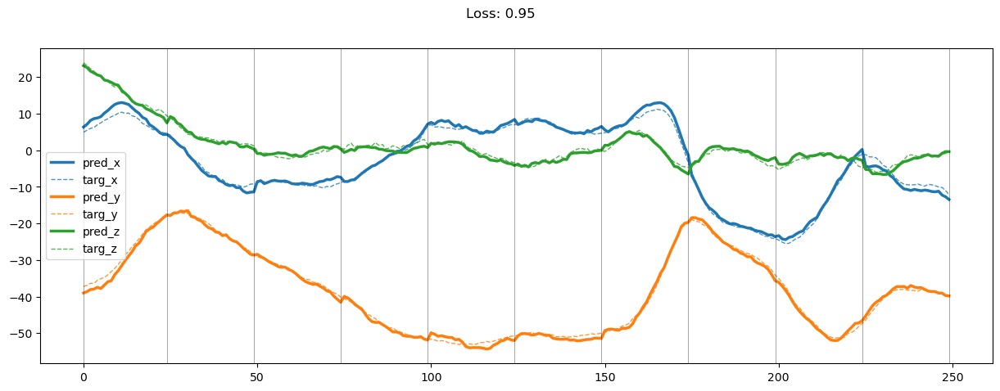

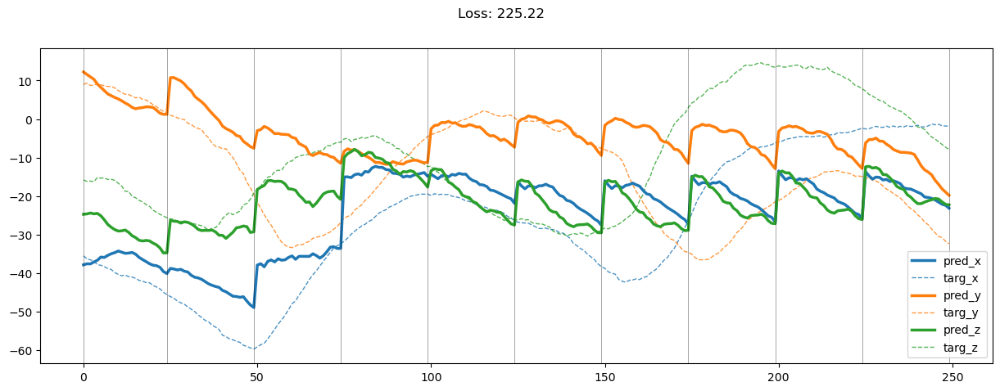

01599: train pred loss:  0.892, g loss:  3.150, diff loss:  1.792, d loss:  1.454
       valid pred loss:  164.845, g loss:  487.017, diff loss:  321.707, d loss:  1.456


100%|██████████| 17/17 [00:01<00:00, 15.14it/s]


01600: train pred loss:  0.897, g loss:  3.131, diff loss:  1.773, d loss:  1.456
       valid pred loss:  163.401, g loss:  483.589, diff loss:  319.727, d loss:  1.458


100%|██████████| 17/17 [00:01<00:00, 14.78it/s]


01601: train pred loss:  0.890, g loss:  3.116, diff loss:  1.769, d loss:  1.459
       valid pred loss:  164.526, g loss:  487.650, diff loss:  322.668, d loss:  1.462


100%|██████████| 17/17 [00:01<00:00, 14.81it/s]


01602: train pred loss:  0.882, g loss:  3.084, diff loss:  1.750, d loss:  1.463
       valid pred loss:  162.368, g loss:  481.150, diff loss:  318.331, d loss:  1.466


100%|██████████| 17/17 [00:01<00:00, 15.21it/s]


01603: train pred loss:  0.912, g loss:  3.172, diff loss:  1.812, d loss:  1.466
       valid pred loss:  162.727, g loss:  481.199, diff loss:  318.026, d loss:  1.470


100%|██████████| 17/17 [00:01<00:00, 14.35it/s]


01604: train pred loss:  0.910, g loss:  3.137, diff loss:  1.785, d loss:  1.470
       valid pred loss:  164.010, g loss:  485.871, diff loss:  321.421, d loss:  1.474


100%|██████████| 17/17 [00:01<00:00, 15.26it/s]


01605: train pred loss:  0.902, g loss:  3.123, diff loss:  1.784, d loss:  1.475
       valid pred loss:  161.320, g loss:  479.488, diff loss:  317.734, d loss:  1.480


100%|██████████| 17/17 [00:01<00:00, 15.06it/s]


01606: train pred loss:  0.907, g loss:  3.119, diff loss:  1.781, d loss:  1.480
       valid pred loss:  162.381, g loss:  483.116, diff loss:  320.307, d loss:  1.485


100%|██████████| 17/17 [00:01<00:00, 15.16it/s]


01607: train pred loss:  0.874, g loss:  3.047, diff loss:  1.748, d loss:  1.485
       valid pred loss:  160.626, g loss:  476.149, diff loss:  315.101, d loss:  1.490


100%|██████████| 17/17 [00:01<00:00, 15.21it/s]


01608: train pred loss:  0.877, g loss:  3.022, diff loss:  1.726, d loss:  1.491
       valid pred loss:  160.428, g loss:  474.092, diff loss:  313.248, d loss:  1.496


100%|██████████| 17/17 [00:01<00:00, 15.23it/s]


01609: train pred loss:  0.875, g loss:  3.020, diff loss:  1.731, d loss:  1.496
       valid pred loss:  161.981, g loss:  477.966, diff loss:  315.575, d loss:  1.502


100%|██████████| 17/17 [00:01<00:00, 14.46it/s]


01610: train pred loss:  0.871, g loss:  3.003, diff loss:  1.724, d loss:  1.502
       valid pred loss:  161.493, g loss:  478.407, diff loss:  316.510, d loss:  1.508


100%|██████████| 17/17 [00:01<00:00, 15.03it/s]


01611: train pred loss:  0.881, g loss:  3.023, diff loss:  1.740, d loss:  1.508
       valid pred loss:  160.079, g loss:  472.527, diff loss:  312.050, d loss:  1.514


100%|██████████| 17/17 [00:01<00:00, 15.23it/s]


01612: train pred loss:  0.879, g loss:  2.990, diff loss:  1.715, d loss:  1.513
       valid pred loss:  161.231, g loss:  475.312, diff loss:  313.689, d loss:  1.520


100%|██████████| 17/17 [00:01<00:00, 14.99it/s]


01613: train pred loss:  0.866, g loss:  2.976, diff loss:  1.719, d loss:  1.519
       valid pred loss:  161.920, g loss:  477.669, diff loss:  315.362, d loss:  1.526


100%|██████████| 17/17 [00:01<00:00, 15.24it/s]


01614: train pred loss:  0.883, g loss:  2.996, diff loss:  1.727, d loss:  1.524
       valid pred loss:  162.703, g loss:  479.722, diff loss:  316.636, d loss:  1.531


100%|██████████| 17/17 [00:01<00:00, 15.22it/s]


01615: train pred loss:  0.877, g loss:  2.995, diff loss:  1.737, d loss:  1.530
       valid pred loss:  162.352, g loss:  477.338, diff loss:  314.608, d loss:  1.537


100%|██████████| 17/17 [00:01<00:00, 15.05it/s]


01616: train pred loss:  0.884, g loss:  2.992, diff loss:  1.730, d loss:  1.535
       valid pred loss:  161.059, g loss:  473.439, diff loss:  312.007, d loss:  1.542


100%|██████████| 17/17 [00:01<00:00, 14.39it/s]


01617: train pred loss:  0.869, g loss:  2.968, diff loss:  1.726, d loss:  1.540
       valid pred loss:  161.999, g loss:  476.824, diff loss:  314.456, d loss:  1.547


100%|██████████| 17/17 [00:01<00:00, 15.28it/s]


01618: train pred loss:  0.855, g loss:  2.914, diff loss:  1.690, d loss:  1.545
       valid pred loss:  162.093, g loss:  479.975, diff loss:  317.517, d loss:  1.552


100%|██████████| 17/17 [00:01<00:00, 15.25it/s]


01619: train pred loss:  0.847, g loss:  2.885, diff loss:  1.672, d loss:  1.549
       valid pred loss:  161.807, g loss:  477.181, diff loss:  315.011, d loss:  1.556


100%|██████████| 17/17 [00:01<00:00, 14.71it/s]


01620: train pred loss:  0.862, g loss:  2.916, diff loss:  1.692, d loss:  1.553
       valid pred loss:  160.950, g loss:  478.631, diff loss:  317.321, d loss:  1.560


100%|██████████| 17/17 [00:01<00:00, 15.24it/s]


01621: train pred loss:  0.854, g loss:  2.912, diff loss:  1.697, d loss:  1.556
       valid pred loss:  161.307, g loss:  477.036, diff loss:  315.373, d loss:  1.564


100%|██████████| 17/17 [00:01<00:00, 15.28it/s]


01622: train pred loss:  0.853, g loss:  2.909, diff loss:  1.697, d loss:  1.559
       valid pred loss:  161.444, g loss:  477.956, diff loss:  316.157, d loss:  1.566


100%|██████████| 17/17 [00:01<00:00, 15.28it/s]


01623: train pred loss:  0.837, g loss:  2.852, diff loss:  1.658, d loss:  1.561
       valid pred loss:  162.116, g loss:  476.457, diff loss:  313.988, d loss:  1.569


100%|██████████| 17/17 [00:01<00:00, 15.21it/s]


01624: train pred loss:  0.856, g loss:  2.909, diff loss:  1.698, d loss:  1.563
       valid pred loss:  162.138, g loss:  479.338, diff loss:  316.848, d loss:  1.570


100%|██████████| 17/17 [00:01<00:00, 15.23it/s]


01625: train pred loss:  0.855, g loss:  2.887, diff loss:  1.678, d loss:  1.564
       valid pred loss:  162.411, g loss:  478.267, diff loss:  315.504, d loss:  1.571


100%|██████████| 17/17 [00:01<00:00, 14.63it/s]


01626: train pred loss:  0.856, g loss:  2.917, diff loss:  1.707, d loss:  1.565
       valid pred loss:  161.673, g loss:  476.883, diff loss:  314.858, d loss:  1.572


100%|██████████| 17/17 [00:01<00:00, 15.02it/s]


01627: train pred loss:  0.865, g loss:  2.922, diff loss:  1.704, d loss:  1.565
       valid pred loss:  161.989, g loss:  477.076, diff loss:  314.735, d loss:  1.571


100%|██████████| 17/17 [00:01<00:00, 15.28it/s]


01628: train pred loss:  0.858, g loss:  2.929, diff loss:  1.716, d loss:  1.564
       valid pred loss:  163.732, g loss:  483.091, diff loss:  319.006, d loss:  1.570


100%|██████████| 17/17 [00:01<00:00, 15.29it/s]


01629: train pred loss:  0.850, g loss:  2.877, diff loss:  1.673, d loss:  1.563
       valid pred loss:  161.204, g loss:  478.053, diff loss:  316.496, d loss:  1.569


100%|██████████| 17/17 [00:01<00:00, 15.27it/s]


01630: train pred loss:  0.848, g loss:  2.878, diff loss:  1.674, d loss:  1.561
       valid pred loss:  160.367, g loss:  474.361, diff loss:  313.639, d loss:  1.567


100%|██████████| 17/17 [00:01<00:00, 14.99it/s]


01631: train pred loss:  0.830, g loss:  2.812, diff loss:  1.624, d loss:  1.559
       valid pred loss:  161.421, g loss:  479.029, diff loss:  317.250, d loss:  1.563


100%|██████████| 17/17 [00:01<00:00, 15.28it/s]


01632: train pred loss:  0.830, g loss:  2.805, diff loss:  1.615, d loss:  1.556
       valid pred loss:  162.429, g loss:  479.574, diff loss:  316.785, d loss:  1.560


100%|██████████| 17/17 [00:01<00:00, 15.26it/s]


01633: train pred loss:  0.850, g loss:  2.893, diff loss:  1.680, d loss:  1.553
       valid pred loss:  162.659, g loss:  480.470, diff loss:  317.448, d loss:  1.556


100%|██████████| 17/17 [00:01<00:00, 15.29it/s]


01634: train pred loss:  0.851, g loss:  2.917, diff loss:  1.700, d loss:  1.549
       valid pred loss:  162.366, g loss:  479.652, diff loss:  316.920, d loss:  1.552


100%|██████████| 17/17 [00:01<00:00, 15.12it/s]


01635: train pred loss:  0.819, g loss:  2.811, diff loss:  1.622, d loss:  1.545
       valid pred loss:  162.743, g loss:  481.633, diff loss:  318.520, d loss:  1.547


100%|██████████| 17/17 [00:01<00:00, 15.23it/s]


01636: train pred loss:  0.829, g loss:  2.844, diff loss:  1.642, d loss:  1.540
       valid pred loss:  163.853, g loss:  485.883, diff loss:  321.656, d loss:  1.543


100%|██████████| 17/17 [00:01<00:00, 14.73it/s]


01637: train pred loss:  0.840, g loss:  2.879, diff loss:  1.662, d loss:  1.535
       valid pred loss:  161.548, g loss:  477.531, diff loss:  315.605, d loss:  1.537


100%|██████████| 17/17 [00:01<00:00, 15.16it/s]


01638: train pred loss:  0.833, g loss:  2.870, diff loss:  1.656, d loss:  1.531
       valid pred loss:  162.164, g loss:  478.204, diff loss:  315.658, d loss:  1.532


100%|██████████| 17/17 [00:01<00:00, 15.18it/s]


01639: train pred loss:  0.829, g loss:  2.858, diff loss:  1.643, d loss:  1.526
       valid pred loss:  162.593, g loss:  478.517, diff loss:  315.538, d loss:  1.526


100%|██████████| 17/17 [00:01<00:00, 15.15it/s]


01640: train pred loss:  0.842, g loss:  2.892, diff loss:  1.660, d loss:  1.521
       valid pred loss:  160.865, g loss:  471.928, diff loss:  310.671, d loss:  1.521


100%|██████████| 17/17 [00:01<00:00, 15.16it/s]


01641: train pred loss:  0.836, g loss:  2.887, diff loss:  1.656, d loss:  1.515
       valid pred loss:  162.082, g loss:  477.042, diff loss:  314.564, d loss:  1.516


100%|██████████| 17/17 [00:01<00:00, 15.18it/s]


01642: train pred loss:  0.836, g loss:  2.859, diff loss:  1.624, d loss:  1.511
       valid pred loss:  163.572, g loss:  481.283, diff loss:  317.310, d loss:  1.510


100%|██████████| 17/17 [00:01<00:00, 15.17it/s]


01643: train pred loss:  0.832, g loss:  2.866, diff loss:  1.630, d loss:  1.506
       valid pred loss:  162.467, g loss:  478.938, diff loss:  316.064, d loss:  1.505


100%|██████████| 17/17 [00:01<00:00, 15.21it/s]


01644: train pred loss:  0.828, g loss:  2.858, diff loss:  1.622, d loss:  1.501
       valid pred loss:  162.545, g loss:  474.053, diff loss:  311.097, d loss:  1.500


100%|██████████| 17/17 [00:01<00:00, 15.19it/s]


01645: train pred loss:  0.854, g loss:  2.921, diff loss:  1.654, d loss:  1.496
       valid pred loss:  162.367, g loss:  479.353, diff loss:  316.569, d loss:  1.495


100%|██████████| 17/17 [00:01<00:00, 15.20it/s]


01646: train pred loss:  0.819, g loss:  2.860, diff loss:  1.623, d loss:  1.492
       valid pred loss:  164.028, g loss:  485.884, diff loss:  321.435, d loss:  1.490


100%|██████████| 17/17 [00:01<00:00, 15.17it/s]


01647: train pred loss:  0.808, g loss:  2.827, diff loss:  1.596, d loss:  1.487
       valid pred loss:  164.327, g loss:  488.028, diff loss:  323.275, d loss:  1.485


100%|██████████| 17/17 [00:01<00:00, 15.17it/s]


01648: train pred loss:  0.832, g loss:  2.882, diff loss:  1.623, d loss:  1.483
       valid pred loss:  162.111, g loss:  481.025, diff loss:  318.484, d loss:  1.481


100%|██████████| 17/17 [00:01<00:00, 14.99it/s]


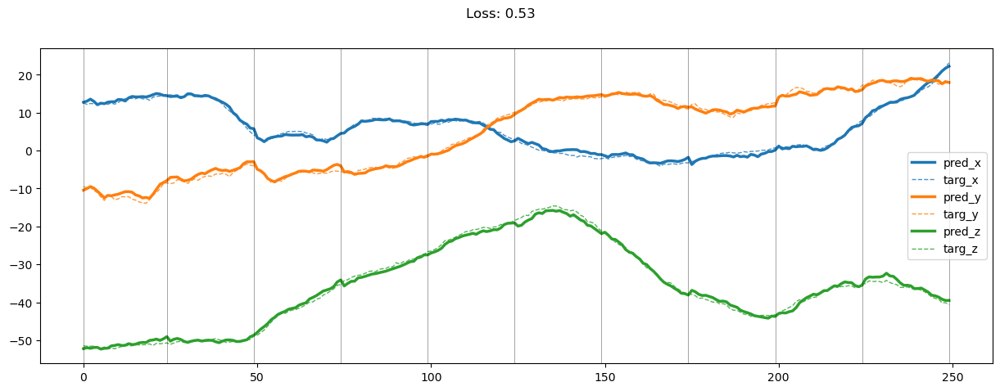

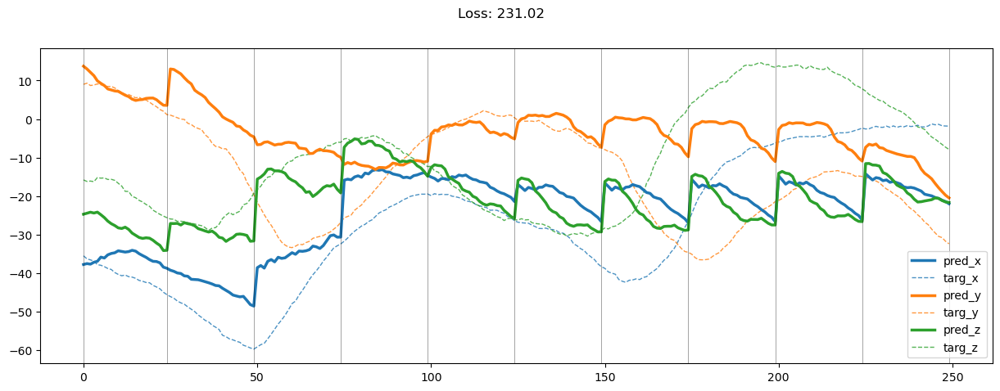

01649: train pred loss:  0.836, g loss:  2.908, diff loss:  1.641, d loss:  1.480
       valid pred loss:  163.133, g loss:  487.643, diff loss:  324.074, d loss:  1.476


100%|██████████| 17/17 [00:01<00:00, 15.16it/s]


01650: train pred loss:  0.849, g loss:  2.976, diff loss:  1.691, d loss:  1.476
       valid pred loss:  162.271, g loss:  482.558, diff loss:  319.847, d loss:  1.472


100%|██████████| 17/17 [00:01<00:00, 15.08it/s]


01651: train pred loss:  0.813, g loss:  2.855, diff loss:  1.603, d loss:  1.473
       valid pred loss:  162.452, g loss:  481.018, diff loss:  318.123, d loss:  1.470


100%|██████████| 17/17 [00:01<00:00, 15.22it/s]


01652: train pred loss:  0.836, g loss:  2.929, diff loss:  1.651, d loss:  1.472
       valid pred loss:  161.433, g loss:  479.944, diff loss:  318.067, d loss:  1.469


100%|██████████| 17/17 [00:01<00:00, 15.23it/s]


01653: train pred loss:  0.816, g loss:  2.861, diff loss:  1.604, d loss:  1.471
       valid pred loss:  164.144, g loss:  488.706, diff loss:  324.119, d loss:  1.470


100%|██████████| 17/17 [00:01<00:00, 15.25it/s]


01654: train pred loss:  0.821, g loss:  2.892, diff loss:  1.630, d loss:  1.472
       valid pred loss:  162.337, g loss:  483.672, diff loss:  320.893, d loss:  1.471


100%|██████████| 17/17 [00:01<00:00, 14.98it/s]


01655: train pred loss:  0.818, g loss:  2.884, diff loss:  1.624, d loss:  1.471
       valid pred loss:  161.649, g loss:  481.327, diff loss:  319.234, d loss:  1.470


100%|██████████| 17/17 [00:01<00:00, 15.25it/s]


01656: train pred loss:  0.814, g loss:  2.869, diff loss:  1.613, d loss:  1.471
       valid pred loss:  164.255, g loss:  488.484, diff loss:  323.785, d loss:  1.469


100%|██████████| 17/17 [00:01<00:00, 15.25it/s]


01657: train pred loss:  0.810, g loss:  2.836, diff loss:  1.582, d loss:  1.469
       valid pred loss:  162.810, g loss:  481.194, diff loss:  317.938, d loss:  1.468


100%|██████████| 17/17 [00:01<00:00, 15.07it/s]


01658: train pred loss:  0.816, g loss:  2.884, diff loss:  1.623, d loss:  1.469
       valid pred loss:  161.040, g loss:  475.707, diff loss:  314.221, d loss:  1.467


100%|██████████| 17/17 [00:01<00:00, 14.61it/s]


01659: train pred loss:  0.826, g loss:  2.904, diff loss:  1.632, d loss:  1.468
       valid pred loss:  161.431, g loss:  480.240, diff loss:  318.361, d loss:  1.466


100%|██████████| 17/17 [00:01<00:00, 15.24it/s]


01660: train pred loss:  0.823, g loss:  2.895, diff loss:  1.625, d loss:  1.468
       valid pred loss:  162.556, g loss:  484.612, diff loss:  321.607, d loss:  1.466


100%|██████████| 17/17 [00:01<00:00, 14.91it/s]


01661: train pred loss:  0.821, g loss:  2.881, diff loss:  1.613, d loss:  1.467
       valid pred loss:  162.587, g loss:  481.835, diff loss:  318.799, d loss:  1.465


100%|██████████| 17/17 [00:01<00:00, 14.74it/s]


01662: train pred loss:  0.817, g loss:  2.869, diff loss:  1.604, d loss:  1.467
       valid pred loss:  160.648, g loss:  477.211, diff loss:  316.114, d loss:  1.465


100%|██████████| 17/17 [00:01<00:00, 15.27it/s]


01663: train pred loss:  0.815, g loss:  2.849, diff loss:  1.586, d loss:  1.466
       valid pred loss:  163.419, g loss:  485.202, diff loss:  321.332, d loss:  1.464


100%|██████████| 17/17 [00:01<00:00, 15.28it/s]


01664: train pred loss:  0.842, g loss:  2.928, diff loss:  1.637, d loss:  1.466
       valid pred loss:  162.140, g loss:  478.606, diff loss:  316.015, d loss:  1.464


100%|██████████| 17/17 [00:01<00:00, 14.19it/s]


01665: train pred loss:  0.820, g loss:  2.881, diff loss:  1.612, d loss:  1.466
       valid pred loss:  161.546, g loss:  480.987, diff loss:  318.990, d loss:  1.463


100%|██████████| 17/17 [00:01<00:00, 15.27it/s]


01666: train pred loss:  0.815, g loss:  2.899, diff loss:  1.635, d loss:  1.465
       valid pred loss:  161.870, g loss:  480.382, diff loss:  318.061, d loss:  1.463


100%|██████████| 17/17 [00:01<00:00, 14.33it/s]


01667: train pred loss:  0.799, g loss:  2.834, diff loss:  1.585, d loss:  1.465
       valid pred loss:  162.277, g loss:  483.010, diff loss:  320.280, d loss:  1.463


100%|██████████| 17/17 [00:01<00:00, 15.18it/s]


01668: train pred loss:  0.801, g loss:  2.846, diff loss:  1.595, d loss:  1.465
       valid pred loss:  160.439, g loss:  476.607, diff loss:  315.716, d loss:  1.463


100%|██████████| 17/17 [00:01<00:00, 15.14it/s]


01669: train pred loss:  0.837, g loss:  2.938, diff loss:  1.651, d loss:  1.465
       valid pred loss:  162.293, g loss:  481.840, diff loss:  319.095, d loss:  1.463


100%|██████████| 17/17 [00:01<00:00, 15.16it/s]


01670: train pred loss:  0.869, g loss:  3.045, diff loss:  1.726, d loss:  1.465
       valid pred loss:  164.607, g loss:  485.632, diff loss:  320.573, d loss:  1.463


100%|██████████| 17/17 [00:01<00:00, 14.98it/s]


01671: train pred loss:  0.860, g loss:  2.967, diff loss:  1.656, d loss:  1.465
       valid pred loss:  162.823, g loss:  485.969, diff loss:  322.694, d loss:  1.463


100%|██████████| 17/17 [00:01<00:00, 15.03it/s]


01672: train pred loss:  0.790, g loss:  2.802, diff loss:  1.561, d loss:  1.465
       valid pred loss:  162.731, g loss:  486.160, diff loss:  322.977, d loss:  1.463


100%|██████████| 17/17 [00:01<00:00, 15.10it/s]


01673: train pred loss:  0.800, g loss:  2.830, diff loss:  1.580, d loss:  1.465
       valid pred loss:  162.868, g loss:  485.445, diff loss:  322.125, d loss:  1.463


100%|██████████| 17/17 [00:01<00:00, 15.12it/s]


01674: train pred loss:  0.813, g loss:  2.840, diff loss:  1.578, d loss:  1.465
       valid pred loss:  163.998, g loss:  489.305, diff loss:  324.857, d loss:  1.463


100%|██████████| 17/17 [00:01<00:00, 15.01it/s]


01675: train pred loss:  0.814, g loss:  2.873, diff loss:  1.610, d loss:  1.465
       valid pred loss:  163.973, g loss:  490.893, diff loss:  326.469, d loss:  1.464


100%|██████████| 17/17 [00:01<00:00, 14.86it/s]


01676: train pred loss:  0.817, g loss:  2.870, diff loss:  1.603, d loss:  1.466
       valid pred loss:  163.062, g loss:  485.303, diff loss:  321.791, d loss:  1.464


100%|██████████| 17/17 [00:01<00:00, 14.77it/s]


01677: train pred loss:  0.831, g loss:  2.913, diff loss:  1.633, d loss:  1.466
       valid pred loss:  164.896, g loss:  487.168, diff loss:  321.822, d loss:  1.464


100%|██████████| 17/17 [00:01<00:00, 15.18it/s]


01678: train pred loss:  0.809, g loss:  2.844, diff loss:  1.586, d loss:  1.466
       valid pred loss:  162.974, g loss:  481.693, diff loss:  318.269, d loss:  1.465


100%|██████████| 17/17 [00:01<00:00, 15.12it/s]


01679: train pred loss:  0.823, g loss:  2.910, diff loss:  1.639, d loss:  1.467
       valid pred loss:  163.683, g loss:  482.805, diff loss:  318.673, d loss:  1.465


100%|██████████| 17/17 [00:01<00:00, 14.80it/s]


01680: train pred loss:  0.822, g loss:  2.876, diff loss:  1.606, d loss:  1.467
       valid pred loss:  163.134, g loss:  482.955, diff loss:  319.373, d loss:  1.465


100%|██████████| 17/17 [00:01<00:00, 14.81it/s]


01681: train pred loss:  0.858, g loss:  2.991, diff loss:  1.685, d loss:  1.467
       valid pred loss:  164.127, g loss:  486.190, diff loss:  321.615, d loss:  1.466


100%|██████████| 17/17 [00:01<00:00, 14.29it/s]


01682: train pred loss:  0.826, g loss:  2.895, diff loss:  1.622, d loss:  1.468
       valid pred loss:  164.446, g loss:  486.859, diff loss:  321.966, d loss:  1.466


100%|██████████| 17/17 [00:01<00:00, 14.97it/s]


01683: train pred loss:  0.822, g loss:  2.887, diff loss:  1.619, d loss:  1.468
       valid pred loss:  164.081, g loss:  489.124, diff loss:  324.596, d loss:  1.467


100%|██████████| 17/17 [00:01<00:00, 14.63it/s]


01684: train pred loss:  0.817, g loss:  2.882, diff loss:  1.620, d loss:  1.469
       valid pred loss:  165.802, g loss:  495.455, diff loss:  329.207, d loss:  1.467


100%|██████████| 17/17 [00:01<00:00, 14.70it/s]


01685: train pred loss:  0.815, g loss:  2.859, diff loss:  1.599, d loss:  1.469
       valid pred loss:  163.531, g loss:  492.305, diff loss:  328.329, d loss:  1.468


100%|██████████| 17/17 [00:01<00:00, 14.89it/s]


01686: train pred loss:  0.815, g loss:  2.882, diff loss:  1.623, d loss:  1.470
       valid pred loss:  163.511, g loss:  488.827, diff loss:  324.871, d loss:  1.468


100%|██████████| 17/17 [00:01<00:00, 15.04it/s]


01687: train pred loss:  0.805, g loss:  2.830, diff loss:  1.582, d loss:  1.470
       valid pred loss:  162.879, g loss:  487.801, diff loss:  324.478, d loss:  1.469


100%|██████████| 17/17 [00:01<00:00, 14.37it/s]


01688: train pred loss:  0.839, g loss:  2.930, diff loss:  1.649, d loss:  1.471
       valid pred loss:  162.744, g loss:  483.484, diff loss:  320.297, d loss:  1.470


100%|██████████| 17/17 [00:01<00:00, 14.75it/s]


01689: train pred loss:  0.834, g loss:  2.913, diff loss:  1.637, d loss:  1.471
       valid pred loss:  164.814, g loss:  490.501, diff loss:  325.244, d loss:  1.470


100%|██████████| 17/17 [00:01<00:00, 14.76it/s]


01690: train pred loss:  0.826, g loss:  2.891, diff loss:  1.623, d loss:  1.472
       valid pred loss:  162.449, g loss:  489.410, diff loss:  326.519, d loss:  1.471


100%|██████████| 17/17 [00:01<00:00, 15.08it/s]


01691: train pred loss:  0.818, g loss:  2.853, diff loss:  1.595, d loss:  1.473
       valid pred loss:  162.603, g loss:  482.880, diff loss:  319.835, d loss:  1.471


100%|██████████| 17/17 [00:01<00:00, 15.16it/s]


01692: train pred loss:  0.817, g loss:  2.842, diff loss:  1.585, d loss:  1.473
       valid pred loss:  163.904, g loss:  485.547, diff loss:  321.203, d loss:  1.472


100%|██████████| 17/17 [00:01<00:00, 15.02it/s]


01693: train pred loss:  0.833, g loss:  2.897, diff loss:  1.625, d loss:  1.474
       valid pred loss:  164.169, g loss:  488.618, diff loss:  324.009, d loss:  1.472


100%|██████████| 17/17 [00:01<00:00, 15.08it/s]


01694: train pred loss:  0.807, g loss:  2.832, diff loss:  1.587, d loss:  1.474
       valid pred loss:  160.980, g loss:  481.422, diff loss:  320.003, d loss:  1.473


100%|██████████| 17/17 [00:01<00:00, 15.17it/s]


01695: train pred loss:  0.812, g loss:  2.859, diff loss:  1.609, d loss:  1.475
       valid pred loss:  164.203, g loss:  495.097, diff loss:  330.457, d loss:  1.474


100%|██████████| 17/17 [00:01<00:00, 14.85it/s]


01696: train pred loss:  0.824, g loss:  2.884, diff loss:  1.623, d loss:  1.476
       valid pred loss:  162.886, g loss:  485.087, diff loss:  321.764, d loss:  1.474


100%|██████████| 17/17 [00:01<00:00, 15.11it/s]


01697: train pred loss:  0.852, g loss:  2.982, diff loss:  1.694, d loss:  1.476
       valid pred loss:  163.400, g loss:  487.227, diff loss:  323.391, d loss:  1.475


100%|██████████| 17/17 [00:01<00:00, 15.18it/s]


01698: train pred loss:  0.868, g loss:  3.002, diff loss:  1.698, d loss:  1.477
       valid pred loss:  164.140, g loss:  492.993, diff loss:  328.417, d loss:  1.475


100%|██████████| 17/17 [00:01<00:00, 15.20it/s]


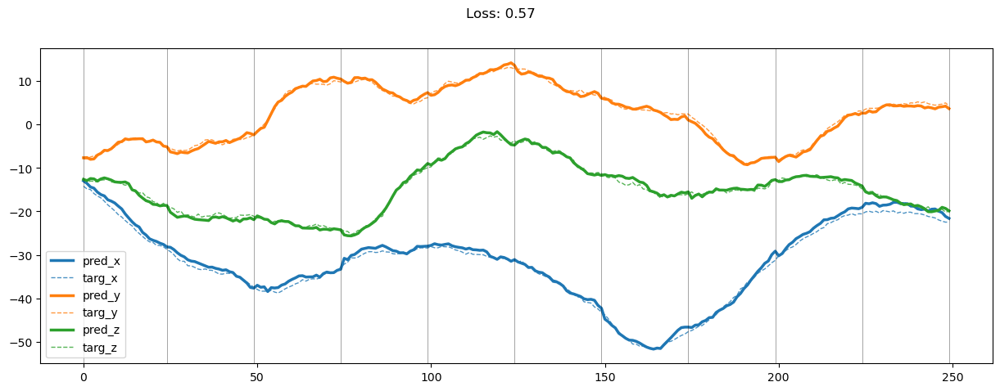

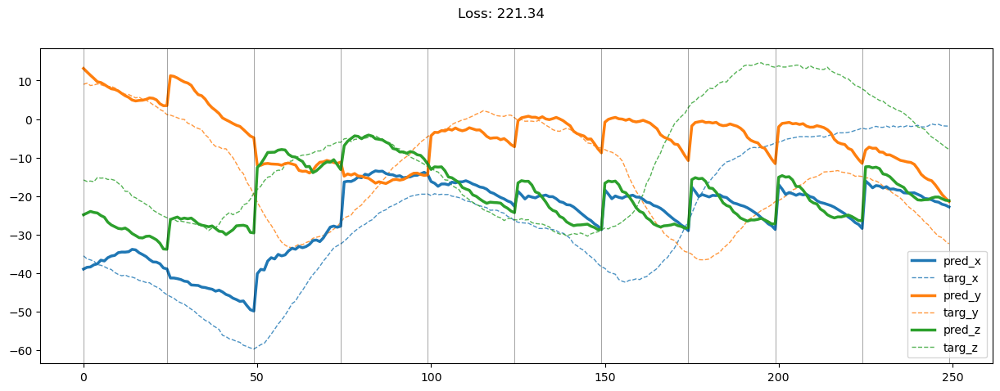

01699: train pred loss:  0.858, g loss:  2.980, diff loss:  1.688, d loss:  1.477
       valid pred loss:  164.263, g loss:  492.530, diff loss:  327.831, d loss:  1.476


100%|██████████| 17/17 [00:01<00:00, 15.16it/s]


01700: train pred loss:  0.866, g loss:  2.976, diff loss:  1.676, d loss:  1.478
       valid pred loss:  162.807, g loss:  481.377, diff loss:  318.135, d loss:  1.476


100%|██████████| 17/17 [00:01<00:00, 14.89it/s]


01701: train pred loss:  0.866, g loss:  3.025, diff loss:  1.725, d loss:  1.478
       valid pred loss:  163.896, g loss:  484.337, diff loss:  320.007, d loss:  1.477


100%|██████████| 17/17 [00:01<00:00, 14.74it/s]


01702: train pred loss:  0.868, g loss:  3.006, diff loss:  1.706, d loss:  1.479
       valid pred loss:  163.173, g loss:  482.504, diff loss:  318.897, d loss:  1.478


100%|██████████| 17/17 [00:01<00:00, 14.83it/s]


01703: train pred loss:  0.835, g loss:  2.929, diff loss:  1.662, d loss:  1.479
       valid pred loss:  162.911, g loss:  484.873, diff loss:  321.530, d loss:  1.478


100%|██████████| 17/17 [00:01<00:00, 14.58it/s]


01704: train pred loss:  0.826, g loss:  2.874, diff loss:  1.617, d loss:  1.480
       valid pred loss:  164.828, g loss:  493.233, diff loss:  327.973, d loss:  1.479


100%|██████████| 17/17 [00:01<00:00, 15.06it/s]


01705: train pred loss:  0.822, g loss:  2.884, diff loss:  1.632, d loss:  1.481
       valid pred loss:  161.213, g loss:  479.974, diff loss:  318.330, d loss:  1.480


100%|██████████| 17/17 [00:01<00:00, 14.68it/s]


01706: train pred loss:  0.837, g loss:  2.924, diff loss:  1.658, d loss:  1.482
       valid pred loss:  162.318, g loss:  484.312, diff loss:  321.564, d loss:  1.481


100%|██████████| 17/17 [00:01<00:00, 14.95it/s]


01707: train pred loss:  0.849, g loss:  2.959, diff loss:  1.682, d loss:  1.483
       valid pred loss:  161.646, g loss:  482.047, diff loss:  319.972, d loss:  1.481


100%|██████████| 17/17 [00:01<00:00, 15.11it/s]


01708: train pred loss:  0.844, g loss:  2.919, diff loss:  1.647, d loss:  1.483
       valid pred loss:  160.657, g loss:  480.067, diff loss:  318.981, d loss:  1.482


100%|██████████| 17/17 [00:01<00:00, 15.11it/s]


01709: train pred loss:  0.838, g loss:  2.917, diff loss:  1.652, d loss:  1.484
       valid pred loss:  160.981, g loss:  476.513, diff loss:  315.105, d loss:  1.483


100%|██████████| 17/17 [00:01<00:00, 15.12it/s]


01710: train pred loss:  0.830, g loss:  2.887, diff loss:  1.631, d loss:  1.485
       valid pred loss:  162.260, g loss:  480.557, diff loss:  317.871, d loss:  1.484


100%|██████████| 17/17 [00:01<00:00, 15.10it/s]


01711: train pred loss:  0.818, g loss:  2.852, diff loss:  1.609, d loss:  1.486
       valid pred loss:  162.314, g loss:  481.394, diff loss:  318.656, d loss:  1.485


100%|██████████| 17/17 [00:01<00:00, 15.03it/s]


01712: train pred loss:  0.822, g loss:  2.878, diff loss:  1.633, d loss:  1.487
       valid pred loss:  164.778, g loss:  494.157, diff loss:  328.955, d loss:  1.486


100%|██████████| 17/17 [00:01<00:00, 14.28it/s]


01713: train pred loss:  0.859, g loss:  2.992, diff loss:  1.711, d loss:  1.488
       valid pred loss:  162.705, g loss:  482.923, diff loss:  319.796, d loss:  1.487


100%|██████████| 17/17 [00:01<00:00, 15.15it/s]


01714: train pred loss:  0.861, g loss:  2.967, diff loss:  1.685, d loss:  1.489
       valid pred loss:  167.604, g loss:  502.829, diff loss:  334.804, d loss:  1.488


100%|██████████| 17/17 [00:01<00:00, 15.19it/s]


01715: train pred loss:  0.859, g loss:  2.979, diff loss:  1.701, d loss:  1.490
       valid pred loss:  164.756, g loss:  493.739, diff loss:  328.563, d loss:  1.490


100%|██████████| 17/17 [00:01<00:00, 14.64it/s]


01716: train pred loss:  0.835, g loss:  2.906, diff loss:  1.652, d loss:  1.491
       valid pred loss:  165.793, g loss:  496.119, diff loss:  329.907, d loss:  1.491


100%|██████████| 17/17 [00:01<00:00, 15.20it/s]


01717: train pred loss:  0.827, g loss:  2.869, diff loss:  1.625, d loss:  1.493
       valid pred loss:  166.913, g loss:  510.484, diff loss:  343.153, d loss:  1.492


100%|██████████| 17/17 [00:01<00:00, 15.11it/s]


01718: train pred loss:  0.831, g loss:  2.876, diff loss:  1.628, d loss:  1.494
       valid pred loss:  167.805, g loss:  507.150, diff loss:  338.929, d loss:  1.493


100%|██████████| 17/17 [00:01<00:00, 15.14it/s]


01719: train pred loss:  0.829, g loss:  2.857, diff loss:  1.612, d loss:  1.495
       valid pred loss:  167.493, g loss:  508.782, diff loss:  340.874, d loss:  1.494


100%|██████████| 17/17 [00:01<00:00, 15.09it/s]


01720: train pred loss:  0.839, g loss:  2.871, diff loss:  1.618, d loss:  1.496
       valid pred loss:  162.935, g loss:  486.332, diff loss:  322.983, d loss:  1.496


100%|██████████| 17/17 [00:01<00:00, 14.85it/s]


01721: train pred loss:  0.810, g loss:  2.805, diff loss:  1.582, d loss:  1.497
       valid pred loss:  161.835, g loss:  482.487, diff loss:  320.239, d loss:  1.497


100%|██████████| 17/17 [00:01<00:00, 14.43it/s]


01722: train pred loss:  0.819, g loss:  2.856, diff loss:  1.625, d loss:  1.498
       valid pred loss:  166.617, g loss:  502.902, diff loss:  335.874, d loss:  1.498


100%|██████████| 17/17 [00:01<00:00, 14.94it/s]


01723: train pred loss:  0.864, g loss:  2.921, diff loss:  1.648, d loss:  1.500
       valid pred loss:  162.279, g loss:  487.577, diff loss:  324.888, d loss:  1.499


100%|██████████| 17/17 [00:01<00:00, 14.74it/s]


01724: train pred loss:  0.868, g loss:  2.964, diff loss:  1.687, d loss:  1.501
       valid pred loss:  164.470, g loss:  494.902, diff loss:  330.023, d loss:  1.501


100%|██████████| 17/17 [00:01<00:00, 15.18it/s]


01725: train pred loss:  0.841, g loss:  2.881, diff loss:  1.633, d loss:  1.502
       valid pred loss:  165.163, g loss:  495.406, diff loss:  329.835, d loss:  1.502


100%|██████████| 17/17 [00:01<00:00, 14.94it/s]


01726: train pred loss:  0.824, g loss:  2.850, diff loss:  1.620, d loss:  1.503
       valid pred loss:  166.700, g loss:  508.256, diff loss:  341.150, d loss:  1.503


100%|██████████| 17/17 [00:01<00:00, 14.54it/s]


01727: train pred loss:  0.821, g loss:  2.845, diff loss:  1.619, d loss:  1.505
       valid pred loss:  164.130, g loss:  494.207, diff loss:  329.673, d loss:  1.505


100%|██████████| 17/17 [00:01<00:00, 15.19it/s]


01728: train pred loss:  0.806, g loss:  2.794, diff loss:  1.584, d loss:  1.506
       valid pred loss:  165.290, g loss:  500.713, diff loss:  335.019, d loss:  1.506


100%|██████████| 17/17 [00:01<00:00, 15.00it/s]


01729: train pred loss:  0.816, g loss:  2.817, diff loss:  1.598, d loss:  1.507
       valid pred loss:  163.988, g loss:  499.920, diff loss:  335.530, d loss:  1.507


100%|██████████| 17/17 [00:01<00:00, 15.18it/s]


01730: train pred loss:  0.825, g loss:  2.855, diff loss:  1.628, d loss:  1.508
       valid pred loss:  165.219, g loss:  498.215, diff loss:  332.595, d loss:  1.508


100%|██████████| 17/17 [00:01<00:00, 15.19it/s]


01731: train pred loss:  0.884, g loss:  3.026, diff loss:  1.742, d loss:  1.510
       valid pred loss:  164.129, g loss:  487.437, diff loss:  322.908, d loss:  1.510


100%|██████████| 17/17 [00:01<00:00, 15.18it/s]


01732: train pred loss:  0.847, g loss:  2.891, diff loss:  1.644, d loss:  1.511
       valid pred loss:  163.573, g loss:  490.830, diff loss:  326.859, d loss:  1.511


100%|██████████| 17/17 [00:01<00:00, 15.19it/s]


01733: train pred loss:  0.836, g loss:  2.885, diff loss:  1.652, d loss:  1.512
       valid pred loss:  161.924, g loss:  483.315, diff loss:  320.994, d loss:  1.512


100%|██████████| 17/17 [00:01<00:00, 15.20it/s]


01734: train pred loss:  0.866, g loss:  2.970, diff loss:  1.707, d loss:  1.513
       valid pred loss:  164.074, g loss:  490.050, diff loss:  325.580, d loss:  1.514


100%|██████████| 17/17 [00:01<00:00, 15.20it/s]


01735: train pred loss:  0.839, g loss:  2.891, diff loss:  1.656, d loss:  1.514
       valid pred loss:  163.531, g loss:  490.718, diff loss:  326.792, d loss:  1.515


100%|██████████| 17/17 [00:01<00:00, 15.25it/s]


01736: train pred loss:  0.860, g loss:  2.918, diff loss:  1.663, d loss:  1.515
       valid pred loss:  163.231, g loss:  489.501, diff loss:  325.876, d loss:  1.516


100%|██████████| 17/17 [00:01<00:00, 14.75it/s]


01737: train pred loss:  0.848, g loss:  2.896, diff loss:  1.655, d loss:  1.517
       valid pred loss:  161.920, g loss:  490.305, diff loss:  327.991, d loss:  1.517


100%|██████████| 17/17 [00:01<00:00, 14.16it/s]


01738: train pred loss:  0.834, g loss:  2.898, diff loss:  1.671, d loss:  1.518
       valid pred loss:  163.925, g loss:  499.822, diff loss:  335.505, d loss:  1.518


100%|██████████| 17/17 [00:01<00:00, 14.55it/s]


01739: train pred loss:  0.861, g loss:  2.956, diff loss:  1.704, d loss:  1.519
       valid pred loss:  163.378, g loss:  487.728, diff loss:  323.959, d loss:  1.519


100%|██████████| 17/17 [00:01<00:00, 14.87it/s]


01740: train pred loss:  0.849, g loss:  2.908, diff loss:  1.668, d loss:  1.520
       valid pred loss:  165.492, g loss:  497.948, diff loss:  332.066, d loss:  1.520


100%|██████████| 17/17 [00:01<00:00, 15.18it/s]


01741: train pred loss:  0.835, g loss:  2.873, diff loss:  1.648, d loss:  1.521
       valid pred loss:  163.204, g loss:  488.361, diff loss:  324.768, d loss:  1.521


100%|██████████| 17/17 [00:01<00:00, 15.18it/s]


01742: train pred loss:  0.822, g loss:  2.831, diff loss:  1.620, d loss:  1.522
       valid pred loss:  164.383, g loss:  490.242, diff loss:  325.471, d loss:  1.522


100%|██████████| 17/17 [00:01<00:00, 15.18it/s]


01743: train pred loss:  0.872, g loss:  2.978, diff loss:  1.719, d loss:  1.523
       valid pred loss:  162.425, g loss:  483.772, diff loss:  320.960, d loss:  1.523


100%|██████████| 17/17 [00:01<00:00, 15.15it/s]


01744: train pred loss:  0.882, g loss:  2.982, diff loss:  1.713, d loss:  1.524
       valid pred loss:  165.523, g loss:  495.800, diff loss:  329.891, d loss:  1.524


100%|██████████| 17/17 [00:01<00:00, 14.23it/s]


01745: train pred loss:  0.889, g loss:  2.986, diff loss:  1.710, d loss:  1.524
       valid pred loss:  166.902, g loss:  506.420, diff loss:  339.132, d loss:  1.525


100%|██████████| 17/17 [00:01<00:00, 15.23it/s]


01746: train pred loss:  0.845, g loss:  2.874, diff loss:  1.644, d loss:  1.525
       valid pred loss:  167.046, g loss:  508.243, diff loss:  340.812, d loss:  1.526


100%|██████████| 17/17 [00:01<00:00, 15.23it/s]


01747: train pred loss:  0.848, g loss:  2.914, diff loss:  1.681, d loss:  1.526
       valid pred loss:  164.485, g loss:  494.210, diff loss:  329.340, d loss:  1.526


100%|██████████| 17/17 [00:01<00:00, 14.66it/s]


01748: train pred loss:  0.898, g loss:  2.997, diff loss:  1.715, d loss:  1.527
       valid pred loss:  165.188, g loss:  500.244, diff loss:  334.672, d loss:  1.527


100%|██████████| 17/17 [00:01<00:00, 15.24it/s]


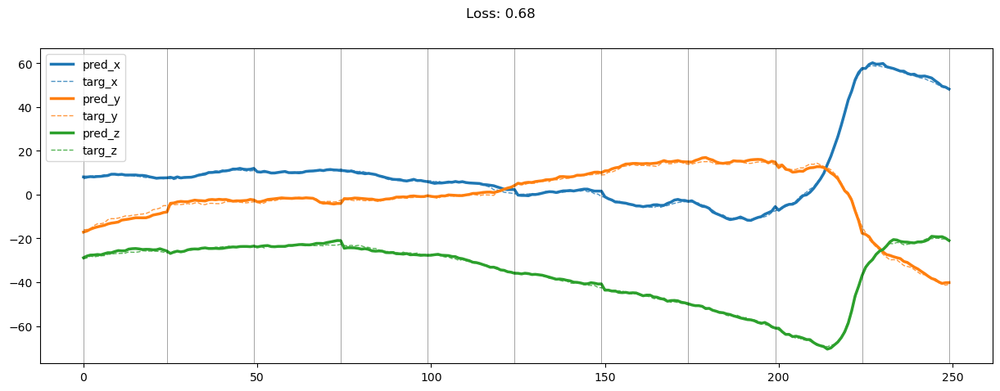

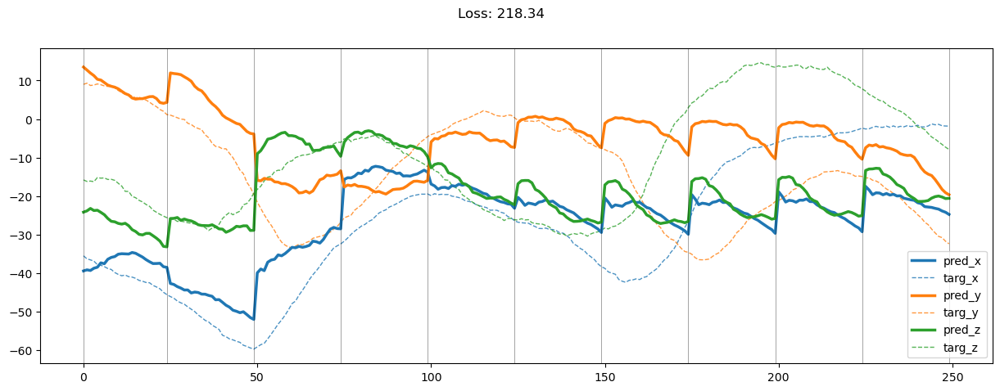

01749: train pred loss:  0.889, g loss:  3.007, diff loss:  1.734, d loss:  1.527
       valid pred loss:  167.821, g loss:  504.158, diff loss:  335.954, d loss:  1.528


100%|██████████| 17/17 [00:01<00:00, 15.23it/s]


01750: train pred loss:  0.868, g loss:  2.960, diff loss:  1.709, d loss:  1.528
       valid pred loss:  164.834, g loss:  498.417, diff loss:  333.200, d loss:  1.528


100%|██████████| 17/17 [00:01<00:00, 15.26it/s]


01751: train pred loss:  0.890, g loss:  3.031, diff loss:  1.758, d loss:  1.528
       valid pred loss:  163.260, g loss:  489.884, diff loss:  326.241, d loss:  1.528


100%|██████████| 17/17 [00:01<00:00, 15.25it/s]


01752: train pred loss:  1.022, g loss:  3.293, diff loss:  1.888, d loss:  1.529
       valid pred loss:  161.860, g loss:  480.972, diff loss:  318.730, d loss:  1.529


100%|██████████| 17/17 [00:01<00:00, 15.25it/s]


01753: train pred loss:  0.925, g loss:  3.072, diff loss:  1.764, d loss:  1.529
       valid pred loss:  162.651, g loss:  492.220, diff loss:  329.187, d loss:  1.530


100%|██████████| 17/17 [00:01<00:00, 15.26it/s]


01754: train pred loss:  0.872, g loss:  2.961, diff loss:  1.707, d loss:  1.529
       valid pred loss:  164.717, g loss:  496.279, diff loss:  331.181, d loss:  1.530


100%|██████████| 17/17 [00:01<00:00, 15.28it/s]


01755: train pred loss:  0.865, g loss:  2.960, diff loss:  1.713, d loss:  1.530
       valid pred loss:  164.240, g loss:  492.261, diff loss:  327.640, d loss:  1.530


100%|██████████| 17/17 [00:01<00:00, 15.19it/s]


01756: train pred loss:  0.923, g loss:  3.126, diff loss:  1.822, d loss:  1.530
       valid pred loss:  164.256, g loss:  490.267, diff loss:  325.630, d loss:  1.530


100%|██████████| 17/17 [00:01<00:00, 15.14it/s]


01757: train pred loss:  0.872, g loss:  2.957, diff loss:  1.703, d loss:  1.530
       valid pred loss:  162.849, g loss:  485.484, diff loss:  322.253, d loss:  1.530


100%|██████████| 17/17 [00:01<00:00, 15.20it/s]


01758: train pred loss:  0.856, g loss:  2.919, diff loss:  1.682, d loss:  1.530
       valid pred loss:  164.597, g loss:  490.876, diff loss:  325.897, d loss:  1.530


100%|██████████| 17/17 [00:01<00:00, 14.52it/s]


01759: train pred loss:  0.843, g loss:  2.906, diff loss:  1.682, d loss:  1.530
       valid pred loss:  164.681, g loss:  495.077, diff loss:  330.015, d loss:  1.530


100%|██████████| 17/17 [00:01<00:00, 15.23it/s]


01760: train pred loss:  0.828, g loss:  2.855, diff loss:  1.645, d loss:  1.530
       valid pred loss:  163.441, g loss:  487.593, diff loss:  323.771, d loss:  1.530


100%|██████████| 17/17 [00:01<00:00, 15.19it/s]


01761: train pred loss:  0.802, g loss:  2.779, diff loss:  1.595, d loss:  1.530
       valid pred loss:  161.914, g loss:  483.932, diff loss:  321.637, d loss:  1.530


100%|██████████| 17/17 [00:01<00:00, 15.05it/s]


01762: train pred loss:  0.860, g loss:  2.919, diff loss:  1.677, d loss:  1.529
       valid pred loss:  159.796, g loss:  472.986, diff loss:  312.808, d loss:  1.529


100%|██████████| 17/17 [00:01<00:00, 15.20it/s]


01763: train pred loss:  0.899, g loss:  3.044, diff loss:  1.762, d loss:  1.529
       valid pred loss:  164.017, g loss:  492.450, diff loss:  328.051, d loss:  1.529


100%|██████████| 17/17 [00:01<00:00, 15.21it/s]


01764: train pred loss:  0.879, g loss:  2.971, diff loss:  1.709, d loss:  1.528
       valid pred loss:  162.081, g loss:  489.113, diff loss:  326.649, d loss:  1.529


100%|██████████| 17/17 [00:01<00:00, 15.20it/s]


01765: train pred loss:  0.850, g loss:  2.911, diff loss:  1.678, d loss:  1.528
       valid pred loss:  161.315, g loss:  486.666, diff loss:  324.967, d loss:  1.528


100%|██████████| 17/17 [00:01<00:00, 15.18it/s]


01766: train pred loss:  0.840, g loss:  2.874, diff loss:  1.650, d loss:  1.527
       valid pred loss:  160.601, g loss:  482.096, diff loss:  321.112, d loss:  1.528


100%|██████████| 17/17 [00:01<00:00, 14.86it/s]


01767: train pred loss:  0.839, g loss:  2.864, diff loss:  1.641, d loss:  1.527
       valid pred loss:  162.601, g loss:  484.529, diff loss:  321.543, d loss:  1.527


100%|██████████| 17/17 [00:01<00:00, 15.24it/s]


01768: train pred loss:  0.849, g loss:  2.902, diff loss:  1.668, d loss:  1.526
       valid pred loss:  161.557, g loss:  486.035, diff loss:  324.093, d loss:  1.526


100%|██████████| 17/17 [00:01<00:00, 15.26it/s]


01769: train pred loss:  0.850, g loss:  2.923, diff loss:  1.688, d loss:  1.525
       valid pred loss:  162.908, g loss:  487.749, diff loss:  324.456, d loss:  1.525


100%|██████████| 17/17 [00:01<00:00, 15.28it/s]


01770: train pred loss:  0.859, g loss:  2.957, diff loss:  1.712, d loss:  1.524
       valid pred loss:  166.800, g loss:  499.412, diff loss:  332.225, d loss:  1.525


100%|██████████| 17/17 [00:01<00:00, 14.19it/s]


01771: train pred loss:  0.891, g loss:  3.023, diff loss:  1.745, d loss:  1.524
       valid pred loss:  164.081, g loss:  495.282, diff loss:  330.814, d loss:  1.523


100%|██████████| 17/17 [00:01<00:00, 15.19it/s]


01772: train pred loss:  0.887, g loss:  3.016, diff loss:  1.741, d loss:  1.523
       valid pred loss:  162.766, g loss:  494.495, diff loss:  331.341, d loss:  1.523


100%|██████████| 17/17 [00:01<00:00, 15.19it/s]


01773: train pred loss:  0.895, g loss:  3.043, diff loss:  1.759, d loss:  1.522
       valid pred loss:  166.663, g loss:  503.795, diff loss:  336.742, d loss:  1.521


100%|██████████| 17/17 [00:01<00:00, 14.97it/s]


01774: train pred loss:  0.924, g loss:  3.107, diff loss:  1.793, d loss:  1.521
       valid pred loss:  161.423, g loss:  486.016, diff loss:  324.203, d loss:  1.520


100%|██████████| 17/17 [00:01<00:00, 14.17it/s]


01775: train pred loss:  0.877, g loss:  2.996, diff loss:  1.728, d loss:  1.519
       valid pred loss:  163.266, g loss:  492.560, diff loss:  328.904, d loss:  1.519


100%|██████████| 17/17 [00:01<00:00, 14.64it/s]


01776: train pred loss:  0.869, g loss:  2.979, diff loss:  1.718, d loss:  1.518
       valid pred loss:  163.722, g loss:  496.799, diff loss:  332.684, d loss:  1.518


100%|██████████| 17/17 [00:01<00:00, 15.10it/s]


01777: train pred loss:  0.866, g loss:  2.962, diff loss:  1.703, d loss:  1.517
       valid pred loss:  164.407, g loss:  496.327, diff loss:  331.527, d loss:  1.517


100%|██████████| 17/17 [00:01<00:00, 14.89it/s]


01778: train pred loss:  0.874, g loss:  2.996, diff loss:  1.728, d loss:  1.516
       valid pred loss:  163.407, g loss:  487.462, diff loss:  323.661, d loss:  1.516


100%|██████████| 17/17 [00:01<00:00, 15.13it/s]


01779: train pred loss:  0.883, g loss:  3.034, diff loss:  1.756, d loss:  1.515
       valid pred loss:  162.622, g loss:  483.859, diff loss:  320.841, d loss:  1.514


100%|██████████| 17/17 [00:01<00:00, 15.19it/s]


01780: train pred loss:  0.833, g loss:  2.878, diff loss:  1.649, d loss:  1.513
       valid pred loss:  162.831, g loss:  485.970, diff loss:  322.742, d loss:  1.513


100%|██████████| 17/17 [00:01<00:00, 15.25it/s]


01781: train pred loss:  0.867, g loss:  2.959, diff loss:  1.694, d loss:  1.512
       valid pred loss:  165.421, g loss:  494.356, diff loss:  328.537, d loss:  1.512


100%|██████████| 17/17 [00:01<00:00, 15.26it/s]


01782: train pred loss:  0.871, g loss:  2.973, diff loss:  1.703, d loss:  1.511
       valid pred loss:  161.185, g loss:  476.492, diff loss:  314.908, d loss:  1.510


100%|██████████| 17/17 [00:01<00:00, 15.23it/s]


01783: train pred loss:  0.839, g loss:  2.898, diff loss:  1.659, d loss:  1.509
       valid pred loss:  161.939, g loss:  484.019, diff loss:  321.679, d loss:  1.509


100%|██████████| 17/17 [00:01<00:00, 14.50it/s]


01784: train pred loss:  0.839, g loss:  2.916, diff loss:  1.676, d loss:  1.508
       valid pred loss:  164.102, g loss:  498.912, diff loss:  334.408, d loss:  1.508


100%|██████████| 17/17 [00:01<00:00, 15.10it/s]


01785: train pred loss:  0.849, g loss:  2.918, diff loss:  1.666, d loss:  1.507
       valid pred loss:  164.765, g loss:  500.126, diff loss:  334.958, d loss:  1.506


100%|██████████| 17/17 [00:01<00:00, 15.27it/s]


01786: train pred loss:  0.874, g loss:  3.009, diff loss:  1.730, d loss:  1.505
       valid pred loss:  164.268, g loss:  496.261, diff loss:  331.588, d loss:  1.505


100%|██████████| 17/17 [00:01<00:00, 15.28it/s]


01787: train pred loss:  0.860, g loss:  2.954, diff loss:  1.688, d loss:  1.504
       valid pred loss:  161.462, g loss:  483.456, diff loss:  321.588, d loss:  1.503


100%|██████████| 17/17 [00:01<00:00, 15.25it/s]


01788: train pred loss:  0.857, g loss:  2.939, diff loss:  1.675, d loss:  1.503
       valid pred loss:  162.970, g loss:  486.094, diff loss:  322.717, d loss:  1.502


100%|██████████| 17/17 [00:01<00:00, 15.27it/s]


01789: train pred loss:  0.841, g loss:  2.909, diff loss:  1.660, d loss:  1.501
       valid pred loss:  161.901, g loss:  478.383, diff loss:  316.073, d loss:  1.501


100%|██████████| 17/17 [00:01<00:00, 15.28it/s]


01790: train pred loss:  0.846, g loss:  2.916, diff loss:  1.661, d loss:  1.500
       valid pred loss:  162.786, g loss:  485.653, diff loss:  322.456, d loss:  1.499


100%|██████████| 17/17 [00:01<00:00, 15.24it/s]


01791: train pred loss:  0.819, g loss:  2.855, diff loss:  1.624, d loss:  1.499
       valid pred loss:  160.775, g loss:  475.718, diff loss:  314.531, d loss:  1.498


100%|██████████| 17/17 [00:01<00:00, 15.27it/s]


01792: train pred loss:  0.861, g loss:  2.966, diff loss:  1.692, d loss:  1.497
       valid pred loss:  162.039, g loss:  482.701, diff loss:  320.249, d loss:  1.497


100%|██████████| 17/17 [00:01<00:00, 15.27it/s]


01793: train pred loss:  0.846, g loss:  2.917, diff loss:  1.657, d loss:  1.496
       valid pred loss:  160.810, g loss:  484.170, diff loss:  322.946, d loss:  1.495


100%|██████████| 17/17 [00:01<00:00, 15.26it/s]


01794: train pred loss:  0.824, g loss:  2.858, diff loss:  1.619, d loss:  1.495
       valid pred loss:  163.386, g loss:  494.785, diff loss:  330.983, d loss:  1.494


100%|██████████| 17/17 [00:01<00:00, 15.21it/s]


01795: train pred loss:  0.811, g loss:  2.850, diff loss:  1.623, d loss:  1.494
       valid pred loss:  164.411, g loss:  503.766, diff loss:  338.938, d loss:  1.493


100%|██████████| 17/17 [00:01<00:00, 15.00it/s]


01796: train pred loss:  0.832, g loss:  2.901, diff loss:  1.652, d loss:  1.492
       valid pred loss:  167.306, g loss:  507.331, diff loss:  339.607, d loss:  1.492


100%|██████████| 17/17 [00:01<00:00, 15.20it/s]


01797: train pred loss:  0.909, g loss:  3.140, diff loss:  1.812, d loss:  1.491
       valid pred loss:  164.897, g loss:  499.987, diff loss:  334.671, d loss:  1.491


100%|██████████| 17/17 [00:01<00:00, 15.17it/s]


01798: train pred loss:  1.041, g loss:  3.500, diff loss:  2.039, d loss:  1.490
       valid pred loss:  163.828, g loss:  496.597, diff loss:  332.348, d loss:  1.489


100%|██████████| 17/17 [00:01<00:00, 15.16it/s]


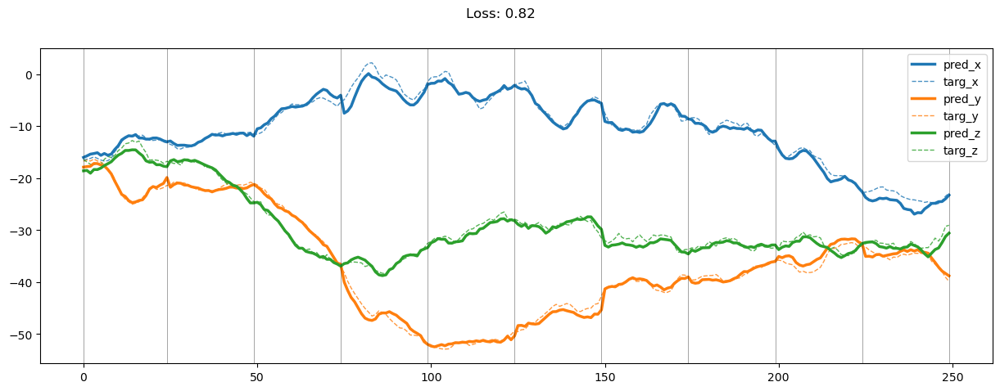

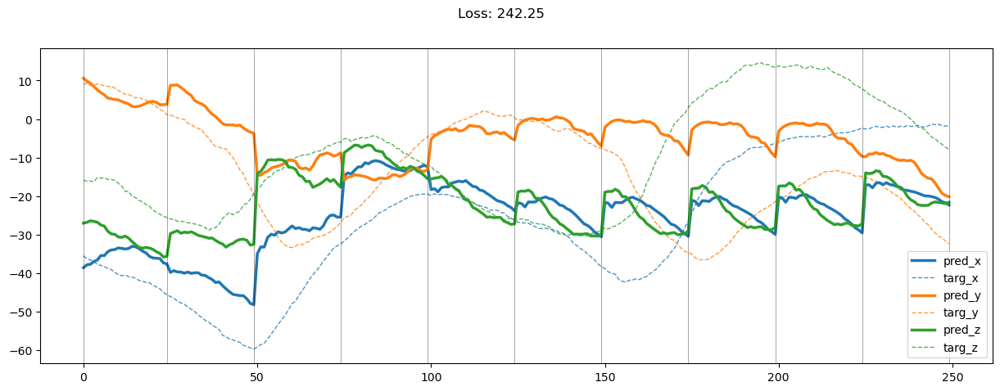

01799: train pred loss:  0.970, g loss:  3.247, diff loss:  1.856, d loss:  1.489
       valid pred loss:  167.977, g loss:  509.860, diff loss:  341.461, d loss:  1.488


100%|██████████| 17/17 [00:01<00:00, 15.12it/s]


01800: train pred loss:  0.924, g loss:  3.121, diff loss:  1.774, d loss:  1.488
       valid pred loss:  165.577, g loss:  505.354, diff loss:  339.354, d loss:  1.487


100%|██████████| 17/17 [00:01<00:00, 15.15it/s]


01801: train pred loss:  0.926, g loss:  3.125, diff loss:  1.775, d loss:  1.487
       valid pred loss:  168.449, g loss:  506.959, diff loss:  338.086, d loss:  1.486


100%|██████████| 17/17 [00:01<00:00, 14.23it/s]


01802: train pred loss:  0.872, g loss:  3.027, diff loss:  1.731, d loss:  1.486
       valid pred loss:  167.459, g loss:  510.084, diff loss:  342.199, d loss:  1.485


100%|██████████| 17/17 [00:01<00:00, 15.20it/s]


01803: train pred loss:  0.871, g loss:  3.024, diff loss:  1.728, d loss:  1.485
       valid pred loss:  166.766, g loss:  501.962, diff loss:  334.770, d loss:  1.485


100%|██████████| 17/17 [00:01<00:00, 14.81it/s]


01804: train pred loss:  0.873, g loss:  2.990, diff loss:  1.691, d loss:  1.485
       valid pred loss:  166.364, g loss:  499.846, diff loss:  333.055, d loss:  1.484


100%|██████████| 17/17 [00:01<00:00, 15.24it/s]


01805: train pred loss:  0.848, g loss:  2.936, diff loss:  1.661, d loss:  1.484
       valid pred loss:  162.543, g loss:  490.259, diff loss:  327.289, d loss:  1.483


100%|██████████| 17/17 [00:01<00:00, 15.24it/s]


01806: train pred loss:  0.867, g loss:  3.012, diff loss:  1.717, d loss:  1.483
       valid pred loss:  166.733, g loss:  509.458, diff loss:  342.296, d loss:  1.483


100%|██████████| 17/17 [00:01<00:00, 15.19it/s]


01807: train pred loss:  0.980, g loss:  3.288, diff loss:  1.880, d loss:  1.483
       valid pred loss:  164.829, g loss:  492.924, diff loss:  327.667, d loss:  1.482


100%|██████████| 17/17 [00:01<00:00, 14.85it/s]


01808: train pred loss:  0.920, g loss:  3.156, diff loss:  1.807, d loss:  1.482
       valid pred loss:  165.050, g loss:  502.972, diff loss:  337.492, d loss:  1.482


100%|██████████| 17/17 [00:01<00:00, 14.84it/s]


01809: train pred loss:  0.887, g loss:  3.074, diff loss:  1.758, d loss:  1.482
       valid pred loss:  164.958, g loss:  500.122, diff loss:  334.734, d loss:  1.481


100%|██████████| 17/17 [00:01<00:00, 15.20it/s]


01810: train pred loss:  0.895, g loss:  3.061, diff loss:  1.736, d loss:  1.481
       valid pred loss:  166.032, g loss:  500.342, diff loss:  333.879, d loss:  1.481


100%|██████████| 17/17 [00:01<00:00, 15.19it/s]


01811: train pred loss:  0.869, g loss:  2.994, diff loss:  1.695, d loss:  1.481
       valid pred loss:  163.275, g loss:  487.342, diff loss:  323.636, d loss:  1.481


100%|██████████| 17/17 [00:01<00:00, 15.12it/s]


01812: train pred loss:  0.881, g loss:  3.035, diff loss:  1.723, d loss:  1.481
       valid pred loss:  162.765, g loss:  486.482, diff loss:  323.286, d loss:  1.481


100%|██████████| 17/17 [00:01<00:00, 15.16it/s]


01813: train pred loss:  0.897, g loss:  3.065, diff loss:  1.738, d loss:  1.481
       valid pred loss:  162.790, g loss:  488.244, diff loss:  325.023, d loss:  1.480


100%|██████████| 17/17 [00:01<00:00, 15.13it/s]


01814: train pred loss:  0.843, g loss:  2.923, diff loss:  1.649, d loss:  1.481
       valid pred loss:  161.859, g loss:  483.949, diff loss:  321.659, d loss:  1.480


100%|██████████| 17/17 [00:01<00:00, 15.13it/s]


01815: train pred loss:  0.837, g loss:  2.907, diff loss:  1.640, d loss:  1.481
       valid pred loss:  161.543, g loss:  484.032, diff loss:  322.059, d loss:  1.480


100%|██████████| 17/17 [00:01<00:00, 15.13it/s]


01816: train pred loss:  0.839, g loss:  2.933, diff loss:  1.663, d loss:  1.481
       valid pred loss:  160.885, g loss:  487.724, diff loss:  326.408, d loss:  1.480


100%|██████████| 17/17 [00:01<00:00, 15.11it/s]


01817: train pred loss:  0.843, g loss:  2.940, diff loss:  1.666, d loss:  1.481
       valid pred loss:  161.776, g loss:  488.390, diff loss:  326.184, d loss:  1.481


100%|██████████| 17/17 [00:01<00:00, 15.14it/s]


01818: train pred loss:  0.840, g loss:  2.938, diff loss:  1.667, d loss:  1.481
       valid pred loss:  162.624, g loss:  490.523, diff loss:  327.469, d loss:  1.481


100%|██████████| 17/17 [00:01<00:00, 15.10it/s]


01819: train pred loss:  0.845, g loss:  2.927, diff loss:  1.652, d loss:  1.481
       valid pred loss:  160.510, g loss:  483.454, diff loss:  322.513, d loss:  1.481


100%|██████████| 17/17 [00:01<00:00, 15.05it/s]


01820: train pred loss:  0.837, g loss:  2.922, diff loss:  1.656, d loss:  1.482
       valid pred loss:  161.585, g loss:  490.985, diff loss:  328.970, d loss:  1.482


100%|██████████| 17/17 [00:01<00:00, 15.09it/s]


01821: train pred loss:  0.817, g loss:  2.871, diff loss:  1.624, d loss:  1.482
       valid pred loss:  159.012, g loss:  479.159, diff loss:  319.718, d loss:  1.482


100%|██████████| 17/17 [00:01<00:00, 14.84it/s]


01822: train pred loss:  0.798, g loss:  2.789, diff loss:  1.563, d loss:  1.483
       valid pred loss:  160.072, g loss:  474.844, diff loss:  314.344, d loss:  1.483


100%|██████████| 17/17 [00:01<00:00, 15.12it/s]


01823: train pred loss:  0.838, g loss:  2.958, diff loss:  1.692, d loss:  1.483
       valid pred loss:  160.398, g loss:  479.819, diff loss:  318.994, d loss:  1.484


100%|██████████| 17/17 [00:01<00:00, 14.76it/s]


01824: train pred loss:  0.861, g loss:  2.955, diff loss:  1.668, d loss:  1.484
       valid pred loss:  161.471, g loss:  489.576, diff loss:  327.678, d loss:  1.484


100%|██████████| 17/17 [00:01<00:00, 15.00it/s]


01825: train pred loss:  0.920, g loss:  3.130, diff loss:  1.784, d loss:  1.485
       valid pred loss:  162.732, g loss:  490.076, diff loss:  326.918, d loss:  1.485


100%|██████████| 17/17 [00:01<00:00, 15.14it/s]


01826: train pred loss:  0.892, g loss:  3.079, diff loss:  1.762, d loss:  1.486
       valid pred loss:  164.672, g loss:  499.478, diff loss:  334.382, d loss:  1.486


100%|██████████| 17/17 [00:01<00:00, 15.11it/s]


01827: train pred loss:  0.896, g loss:  3.088, diff loss:  1.768, d loss:  1.487
       valid pred loss:  162.054, g loss:  491.200, diff loss:  328.723, d loss:  1.487


100%|██████████| 17/17 [00:01<00:00, 14.36it/s]


01828: train pred loss:  0.902, g loss:  3.103, diff loss:  1.779, d loss:  1.488
       valid pred loss:  163.402, g loss:  503.250, diff loss:  339.426, d loss:  1.488


100%|██████████| 17/17 [00:01<00:00, 14.84it/s]


01829: train pred loss:  0.885, g loss:  3.052, diff loss:  1.745, d loss:  1.489
       valid pred loss:  164.973, g loss:  501.754, diff loss:  336.359, d loss:  1.489


100%|██████████| 17/17 [00:01<00:00, 13.56it/s]


01830: train pred loss:  0.915, g loss:  3.091, diff loss:  1.756, d loss:  1.490
       valid pred loss:  164.197, g loss:  496.051, diff loss:  331.434, d loss:  1.491


100%|██████████| 17/17 [00:01<00:00, 13.56it/s]


01831: train pred loss:  0.873, g loss:  3.014, diff loss:  1.722, d loss:  1.491
       valid pred loss:  160.150, g loss:  488.027, diff loss:  327.459, d loss:  1.492


100%|██████████| 17/17 [00:01<00:00, 13.90it/s]


01832: train pred loss:  0.867, g loss:  2.984, diff loss:  1.699, d loss:  1.492
       valid pred loss:  163.936, g loss:  497.203, diff loss:  332.851, d loss:  1.493


100%|██████████| 17/17 [00:01<00:00, 15.13it/s]


01833: train pred loss:  0.835, g loss:  2.889, diff loss:  1.637, d loss:  1.493
       valid pred loss:  162.687, g loss:  491.958, diff loss:  328.855, d loss:  1.495


100%|██████████| 17/17 [00:01<00:00, 15.09it/s]


01834: train pred loss:  0.811, g loss:  2.835, diff loss:  1.609, d loss:  1.495
       valid pred loss:  160.107, g loss:  480.089, diff loss:  319.567, d loss:  1.496


100%|██████████| 17/17 [00:01<00:00, 15.13it/s]


01835: train pred loss:  0.816, g loss:  2.828, diff loss:  1.598, d loss:  1.496
       valid pred loss:  163.431, g loss:  492.403, diff loss:  328.560, d loss:  1.497


100%|██████████| 17/17 [00:01<00:00, 15.15it/s]


01836: train pred loss:  0.820, g loss:  2.830, diff loss:  1.599, d loss:  1.497
       valid pred loss:  160.249, g loss:  472.754, diff loss:  312.093, d loss:  1.499


100%|██████████| 17/17 [00:01<00:00, 14.29it/s]


01837: train pred loss:  0.825, g loss:  2.870, diff loss:  1.634, d loss:  1.499
       valid pred loss:  159.200, g loss:  473.925, diff loss:  314.315, d loss:  1.500


100%|██████████| 17/17 [00:01<00:00, 15.21it/s]


01838: train pred loss:  0.811, g loss:  2.835, diff loss:  1.614, d loss:  1.500
       valid pred loss:  157.319, g loss:  466.857, diff loss:  309.129, d loss:  1.502


100%|██████████| 17/17 [00:01<00:00, 15.16it/s]


01839: train pred loss:  0.814, g loss:  2.824, diff loss:  1.602, d loss:  1.502
       valid pred loss:  160.713, g loss:  473.978, diff loss:  312.859, d loss:  1.503


100%|██████████| 17/17 [00:01<00:00, 15.19it/s]


01840: train pred loss:  0.820, g loss:  2.847, diff loss:  1.620, d loss:  1.503
       valid pred loss:  162.529, g loss:  488.612, diff loss:  325.678, d loss:  1.505


100%|██████████| 17/17 [00:01<00:00, 15.17it/s]


01841: train pred loss:  0.819, g loss:  2.822, diff loss:  1.598, d loss:  1.504
       valid pred loss:  163.294, g loss:  485.485, diff loss:  321.788, d loss:  1.506


100%|██████████| 17/17 [00:01<00:00, 15.22it/s]


01842: train pred loss:  0.834, g loss:  2.876, diff loss:  1.638, d loss:  1.506
       valid pred loss:  162.940, g loss:  494.408, diff loss:  331.066, d loss:  1.508


100%|██████████| 17/17 [00:01<00:00, 14.97it/s]


01843: train pred loss:  0.909, g loss:  3.057, diff loss:  1.746, d loss:  1.507
       valid pred loss:  160.379, g loss:  481.340, diff loss:  320.559, d loss:  1.509


100%|██████████| 17/17 [00:01<00:00, 15.12it/s]


01844: train pred loss:  0.873, g loss:  2.993, diff loss:  1.719, d loss:  1.509
       valid pred loss:  159.663, g loss:  485.799, diff loss:  325.737, d loss:  1.511


100%|██████████| 17/17 [00:01<00:00, 14.14it/s]


01845: train pred loss:  0.839, g loss:  2.893, diff loss:  1.654, d loss:  1.510
       valid pred loss:  162.426, g loss:  494.414, diff loss:  331.590, d loss:  1.512


100%|██████████| 17/17 [00:01<00:00, 15.13it/s]


01846: train pred loss:  0.869, g loss:  2.946, diff loss:  1.679, d loss:  1.511
       valid pred loss:  162.984, g loss:  495.580, diff loss:  332.199, d loss:  1.514


100%|██████████| 17/17 [00:01<00:00, 15.14it/s]


01847: train pred loss:  0.900, g loss:  3.073, diff loss:  1.777, d loss:  1.513
       valid pred loss:  162.546, g loss:  490.351, diff loss:  327.410, d loss:  1.515


100%|██████████| 17/17 [00:01<00:00, 14.94it/s]


01848: train pred loss:  0.928, g loss:  3.129, diff loss:  1.806, d loss:  1.514
       valid pred loss:  163.784, g loss:  498.933, diff loss:  334.755, d loss:  1.516


100%|██████████| 17/17 [00:01<00:00, 14.57it/s]


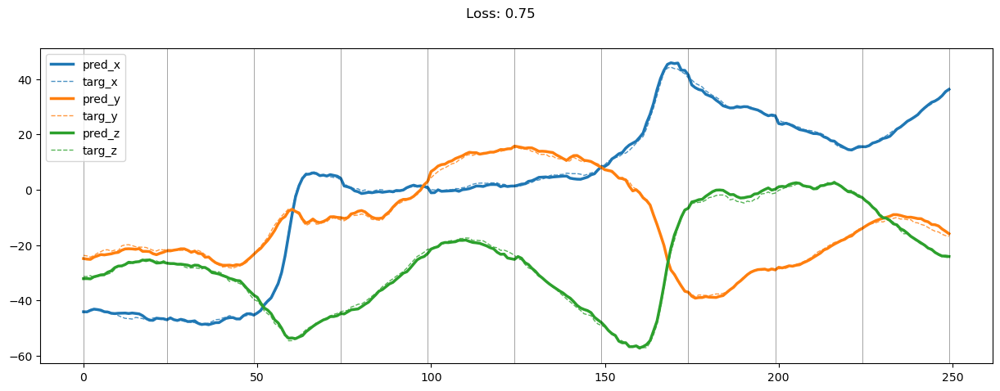

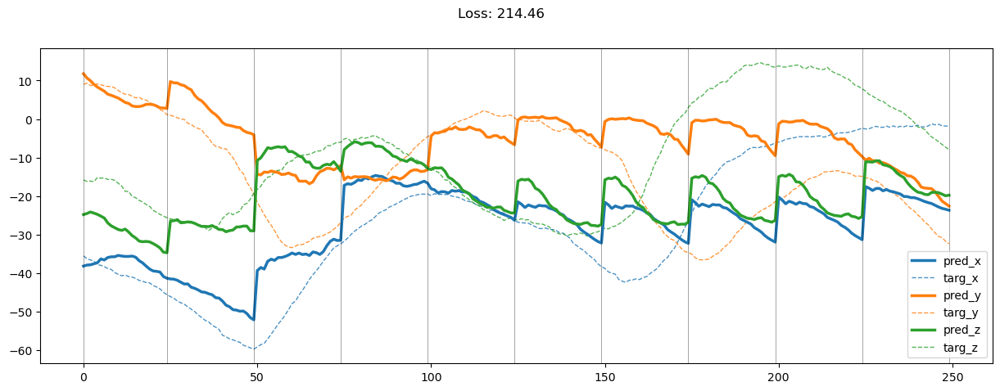

01849: train pred loss:  0.914, g loss:  3.091, diff loss:  1.783, d loss:  1.516
       valid pred loss:  163.367, g loss:  495.846, diff loss:  332.086, d loss:  1.518


100%|██████████| 17/17 [00:01<00:00, 15.16it/s]


01850: train pred loss:  0.851, g loss:  2.932, diff loss:  1.688, d loss:  1.517
       valid pred loss:  166.541, g loss:  500.841, diff loss:  333.908, d loss:  1.519


100%|██████████| 17/17 [00:01<00:00, 15.17it/s]


01851: train pred loss:  0.894, g loss:  3.047, diff loss:  1.760, d loss:  1.518
       valid pred loss:  161.939, g loss:  490.575, diff loss:  328.246, d loss:  1.520


100%|██████████| 17/17 [00:01<00:00, 15.21it/s]


01852: train pred loss:  0.931, g loss:  3.120, diff loss:  1.798, d loss:  1.519
       valid pred loss:  164.300, g loss:  500.244, diff loss:  335.554, d loss:  1.522


100%|██████████| 17/17 [00:01<00:00, 15.22it/s]


01853: train pred loss:  0.882, g loss:  2.976, diff loss:  1.703, d loss:  1.520
       valid pred loss:  164.070, g loss:  491.561, diff loss:  327.103, d loss:  1.523


100%|██████████| 17/17 [00:01<00:00, 15.17it/s]


01854: train pred loss:  0.863, g loss:  2.923, diff loss:  1.671, d loss:  1.521
       valid pred loss:  162.422, g loss:  496.358, diff loss:  333.548, d loss:  1.524


100%|██████████| 17/17 [00:01<00:00, 15.22it/s]


01855: train pred loss:  0.825, g loss:  2.831, diff loss:  1.618, d loss:  1.522
       valid pred loss:  161.442, g loss:  487.670, diff loss:  325.842, d loss:  1.525


100%|██████████| 17/17 [00:01<00:00, 15.20it/s]


01856: train pred loss:  0.819, g loss:  2.811, diff loss:  1.605, d loss:  1.523
       valid pred loss:  164.021, g loss:  498.620, diff loss:  334.213, d loss:  1.526


100%|██████████| 17/17 [00:01<00:00, 15.04it/s]


01857: train pred loss:  0.799, g loss:  2.730, diff loss:  1.545, d loss:  1.524
       valid pred loss:  164.320, g loss:  499.710, diff loss:  335.005, d loss:  1.526


100%|██████████| 17/17 [00:01<00:00, 15.23it/s]


01858: train pred loss:  0.808, g loss:  2.769, diff loss:  1.575, d loss:  1.525
       valid pred loss:  163.922, g loss:  498.427, diff loss:  334.120, d loss:  1.527


100%|██████████| 17/17 [00:01<00:00, 15.20it/s]


01859: train pred loss:  0.801, g loss:  2.789, diff loss:  1.602, d loss:  1.525
       valid pred loss:  165.294, g loss:  503.824, diff loss:  338.146, d loss:  1.528


100%|██████████| 17/17 [00:01<00:00, 15.19it/s]


01860: train pred loss:  0.850, g loss:  2.884, diff loss:  1.650, d loss:  1.526
       valid pred loss:  162.231, g loss:  493.113, diff loss:  330.499, d loss:  1.528


100%|██████████| 17/17 [00:01<00:00, 15.21it/s]


01861: train pred loss:  0.818, g loss:  2.807, diff loss:  1.605, d loss:  1.527
       valid pred loss:  161.390, g loss:  492.575, diff loss:  330.802, d loss:  1.529


100%|██████████| 17/17 [00:01<00:00, 15.23it/s]


01862: train pred loss:  0.803, g loss:  2.768, diff loss:  1.581, d loss:  1.527
       valid pred loss:  159.533, g loss:  479.367, diff loss:  319.451, d loss:  1.530


100%|██████████| 17/17 [00:01<00:00, 14.10it/s]


01863: train pred loss:  0.833, g loss:  2.839, diff loss:  1.623, d loss:  1.527
       valid pred loss:  162.830, g loss:  495.401, diff loss:  332.189, d loss:  1.530


100%|██████████| 17/17 [00:01<00:00, 15.15it/s]


01864: train pred loss:  0.874, g loss:  2.940, diff loss:  1.682, d loss:  1.527
       valid pred loss:  167.708, g loss:  507.284, diff loss:  339.193, d loss:  1.530


100%|██████████| 17/17 [00:01<00:00, 15.19it/s]


01865: train pred loss:  0.875, g loss:  2.989, diff loss:  1.731, d loss:  1.528
       valid pred loss:  167.779, g loss:  512.597, diff loss:  344.436, d loss:  1.530


100%|██████████| 17/17 [00:01<00:00, 14.89it/s]


01866: train pred loss:  0.843, g loss:  2.896, diff loss:  1.669, d loss:  1.528
       valid pred loss:  165.990, g loss:  498.567, diff loss:  332.195, d loss:  1.530


100%|██████████| 17/17 [00:01<00:00, 15.23it/s]


01867: train pred loss:  0.839, g loss:  2.805, diff loss:  1.582, d loss:  1.528
       valid pred loss:  162.972, g loss:  490.154, diff loss:  326.799, d loss:  1.529


100%|██████████| 17/17 [00:01<00:00, 14.53it/s]


01868: train pred loss:  0.796, g loss:  2.737, diff loss:  1.557, d loss:  1.527
       valid pred loss:  165.053, g loss:  495.931, diff loss:  330.495, d loss:  1.529


100%|██████████| 17/17 [00:01<00:00, 14.37it/s]


01869: train pred loss:  0.768, g loss:  2.668, diff loss:  1.516, d loss:  1.527
       valid pred loss:  162.141, g loss:  484.154, diff loss:  321.630, d loss:  1.529


100%|██████████| 17/17 [00:01<00:00, 14.62it/s]


01870: train pred loss:  0.786, g loss:  2.697, diff loss:  1.527, d loss:  1.527
       valid pred loss:  161.301, g loss:  487.163, diff loss:  325.478, d loss:  1.529


100%|██████████| 17/17 [00:01<00:00, 15.02it/s]


01871: train pred loss:  0.783, g loss:  2.713, diff loss:  1.545, d loss:  1.526
       valid pred loss:  163.646, g loss:  497.108, diff loss:  333.077, d loss:  1.528


100%|██████████| 17/17 [00:01<00:00, 14.13it/s]


01872: train pred loss:  0.772, g loss:  2.662, diff loss:  1.505, d loss:  1.525
       valid pred loss:  161.896, g loss:  488.253, diff loss:  325.973, d loss:  1.527


100%|██████████| 17/17 [00:01<00:00, 15.23it/s]


01873: train pred loss:  0.754, g loss:  2.620, diff loss:  1.480, d loss:  1.525
       valid pred loss:  165.814, g loss:  508.210, diff loss:  342.011, d loss:  1.527


100%|██████████| 17/17 [00:01<00:00, 15.24it/s]


01874: train pred loss:  0.819, g loss:  2.805, diff loss:  1.600, d loss:  1.524
       valid pred loss:  165.655, g loss:  501.055, diff loss:  335.013, d loss:  1.526


100%|██████████| 17/17 [00:01<00:00, 14.84it/s]


01875: train pred loss:  0.819, g loss:  2.807, diff loss:  1.601, d loss:  1.523
       valid pred loss:  166.912, g loss:  508.938, diff loss:  341.639, d loss:  1.525


100%|██████████| 17/17 [00:01<00:00, 15.16it/s]


01876: train pred loss:  0.820, g loss:  2.823, diff loss:  1.615, d loss:  1.522
       valid pred loss:  165.113, g loss:  501.197, diff loss:  335.697, d loss:  1.524


100%|██████████| 17/17 [00:01<00:00, 15.18it/s]


01877: train pred loss:  0.830, g loss:  2.851, diff loss:  1.632, d loss:  1.521
       valid pred loss:  164.225, g loss:  489.720, diff loss:  325.106, d loss:  1.523


100%|██████████| 17/17 [00:01<00:00, 15.10it/s]


01878: train pred loss:  0.826, g loss:  2.843, diff loss:  1.626, d loss:  1.520
       valid pred loss:  165.107, g loss:  503.832, diff loss:  338.335, d loss:  1.521


100%|██████████| 17/17 [00:01<00:00, 15.19it/s]


01879: train pred loss:  0.844, g loss:  2.894, diff loss:  1.658, d loss:  1.519
       valid pred loss:  169.576, g loss:  514.295, diff loss:  344.328, d loss:  1.520


100%|██████████| 17/17 [00:01<00:00, 15.22it/s]


01880: train pred loss:  0.822, g loss:  2.824, diff loss:  1.609, d loss:  1.517
       valid pred loss:  169.050, g loss:  510.075, diff loss:  340.633, d loss:  1.519


100%|██████████| 17/17 [00:01<00:00, 15.19it/s]


01881: train pred loss:  0.832, g loss:  2.833, diff loss:  1.608, d loss:  1.516
       valid pred loss:  165.146, g loss:  505.687, diff loss:  340.147, d loss:  1.517


100%|██████████| 17/17 [00:01<00:00, 14.09it/s]


01882: train pred loss:  0.849, g loss:  2.891, diff loss:  1.647, d loss:  1.515
       valid pred loss:  164.956, g loss:  502.945, diff loss:  337.594, d loss:  1.516


100%|██████████| 17/17 [00:01<00:00, 15.26it/s]


01883: train pred loss:  0.816, g loss:  2.817, diff loss:  1.604, d loss:  1.513
       valid pred loss:  165.727, g loss:  507.179, diff loss:  341.056, d loss:  1.514


100%|██████████| 17/17 [00:01<00:00, 15.24it/s]


01884: train pred loss:  0.819, g loss:  2.822, diff loss:  1.606, d loss:  1.512
       valid pred loss:  170.298, g loss:  517.763, diff loss:  347.067, d loss:  1.513


100%|██████████| 17/17 [00:01<00:00, 15.25it/s]


01885: train pred loss:  0.861, g loss:  2.924, diff loss:  1.664, d loss:  1.511
       valid pred loss:  169.276, g loss:  519.525, diff loss:  349.849, d loss:  1.511


100%|██████████| 17/17 [00:01<00:00, 15.23it/s]


01886: train pred loss:  0.864, g loss:  2.951, diff loss:  1.687, d loss:  1.509
       valid pred loss:  167.291, g loss:  508.394, diff loss:  340.703, d loss:  1.510


100%|██████████| 17/17 [00:01<00:00, 13.85it/s]


01887: train pred loss:  0.848, g loss:  2.890, diff loss:  1.639, d loss:  1.507
       valid pred loss:  168.338, g loss:  519.425, diff loss:  350.686, d loss:  1.509


100%|██████████| 17/17 [00:01<00:00, 14.95it/s]


01888: train pred loss:  0.838, g loss:  2.904, diff loss:  1.663, d loss:  1.506
       valid pred loss:  166.781, g loss:  509.245, diff loss:  342.060, d loss:  1.507


100%|██████████| 17/17 [00:01<00:00, 15.21it/s]


01889: train pred loss:  0.820, g loss:  2.838, diff loss:  1.613, d loss:  1.504
       valid pred loss:  167.776, g loss:  514.635, diff loss:  346.454, d loss:  1.505


100%|██████████| 17/17 [00:01<00:00, 15.21it/s]


01890: train pred loss:  0.799, g loss:  2.783, diff loss:  1.578, d loss:  1.503
       valid pred loss:  169.356, g loss:  521.786, diff loss:  352.023, d loss:  1.504


100%|██████████| 17/17 [00:01<00:00, 15.22it/s]


01891: train pred loss:  0.796, g loss:  2.795, diff loss:  1.590, d loss:  1.502
       valid pred loss:  166.492, g loss:  515.077, diff loss:  348.176, d loss:  1.502


100%|██████████| 17/17 [00:01<00:00, 14.95it/s]


01892: train pred loss:  0.874, g loss:  3.019, diff loss:  1.735, d loss:  1.500
       valid pred loss:  167.800, g loss:  518.265, diff loss:  350.056, d loss:  1.501


100%|██████████| 17/17 [00:01<00:00, 14.32it/s]


01893: train pred loss:  0.891, g loss:  3.036, diff loss:  1.733, d loss:  1.498
       valid pred loss:  168.014, g loss:  509.760, diff loss:  341.334, d loss:  1.500


100%|██████████| 17/17 [00:01<00:00, 15.16it/s]


01894: train pred loss:  0.863, g loss:  2.959, diff loss:  1.684, d loss:  1.497
       valid pred loss:  165.448, g loss:  508.247, diff loss:  342.387, d loss:  1.498


100%|██████████| 17/17 [00:01<00:00, 15.17it/s]


01895: train pred loss:  0.863, g loss:  2.936, diff loss:  1.659, d loss:  1.496
       valid pred loss:  167.670, g loss:  513.756, diff loss:  345.673, d loss:  1.497


100%|██████████| 17/17 [00:01<00:00, 15.16it/s]


01896: train pred loss:  0.834, g loss:  2.890, diff loss:  1.641, d loss:  1.495
       valid pred loss:  165.067, g loss:  501.882, diff loss:  336.400, d loss:  1.495


100%|██████████| 17/17 [00:01<00:00, 14.94it/s]


01897: train pred loss:  0.840, g loss:  2.886, diff loss:  1.629, d loss:  1.493
       valid pred loss:  167.313, g loss:  517.686, diff loss:  349.957, d loss:  1.494


100%|██████████| 17/17 [00:01<00:00, 15.18it/s]


01898: train pred loss:  0.822, g loss:  2.857, diff loss:  1.618, d loss:  1.492
       valid pred loss:  164.405, g loss:  512.706, diff loss:  347.883, d loss:  1.493


100%|██████████| 17/17 [00:01<00:00, 15.17it/s]


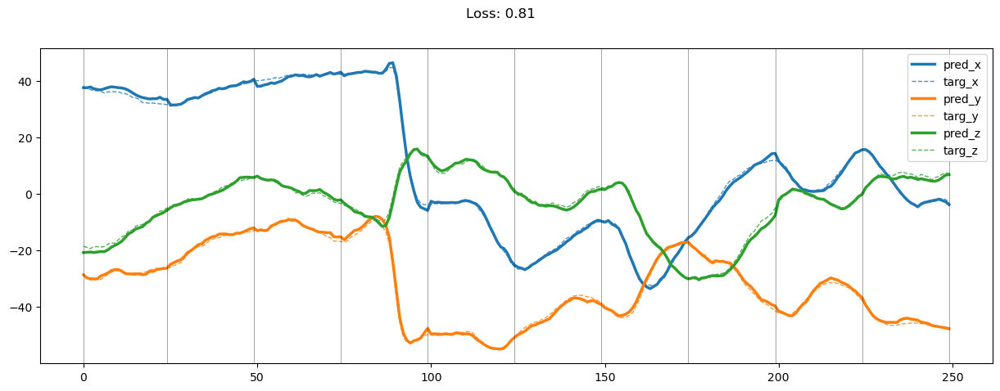

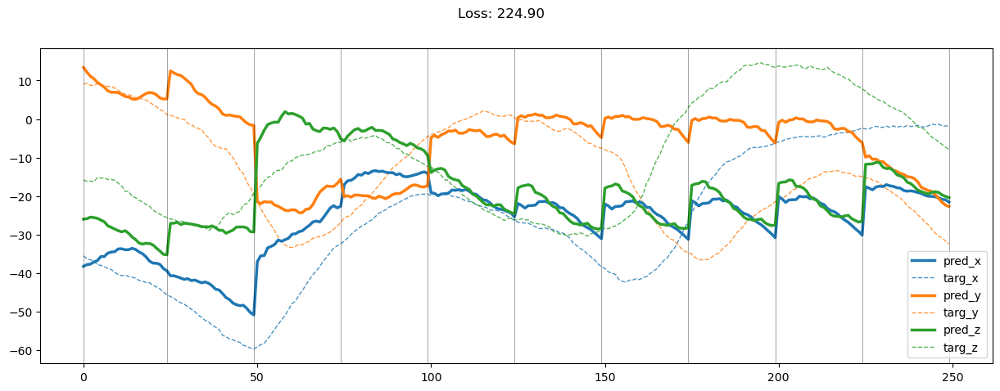

01899: train pred loss:  0.814, g loss:  2.831, diff loss:  1.598, d loss:  1.491
       valid pred loss:  165.846, g loss:  513.745, diff loss:  347.481, d loss:  1.492


100%|██████████| 17/17 [00:01<00:00, 15.08it/s]


01900: train pred loss:  0.828, g loss:  2.868, diff loss:  1.620, d loss:  1.490
       valid pred loss:  168.295, g loss:  518.942, diff loss:  350.227, d loss:  1.491


100%|██████████| 17/17 [00:01<00:00, 15.24it/s]


01901: train pred loss:  0.797, g loss:  2.782, diff loss:  1.563, d loss:  1.489
       valid pred loss:  170.561, g loss:  531.262, diff loss:  360.280, d loss:  1.490


100%|██████████| 17/17 [00:01<00:00, 15.23it/s]


01902: train pred loss:  0.795, g loss:  2.784, diff loss:  1.566, d loss:  1.488
       valid pred loss:  172.284, g loss:  531.022, diff loss:  358.317, d loss:  1.489


100%|██████████| 17/17 [00:01<00:00, 15.20it/s]


01903: train pred loss:  0.792, g loss:  2.735, diff loss:  1.519, d loss:  1.487
       valid pred loss:  171.150, g loss:  526.494, diff loss:  354.921, d loss:  1.488


100%|██████████| 17/17 [00:01<00:00, 15.22it/s]


01904: train pred loss:  0.784, g loss:  2.753, diff loss:  1.545, d loss:  1.486
       valid pred loss:  166.743, g loss:  513.820, diff loss:  346.654, d loss:  1.487


100%|██████████| 17/17 [00:01<00:00, 14.91it/s]


01905: train pred loss:  0.785, g loss:  2.742, diff loss:  1.532, d loss:  1.486
       valid pred loss:  168.351, g loss:  521.567, diff loss:  352.791, d loss:  1.486


100%|██████████| 17/17 [00:01<00:00, 15.20it/s]


01906: train pred loss:  0.774, g loss:  2.720, diff loss:  1.521, d loss:  1.485
       valid pred loss:  167.741, g loss:  515.497, diff loss:  347.331, d loss:  1.486


100%|██████████| 17/17 [00:01<00:00, 13.71it/s]


01907: train pred loss:  0.817, g loss:  2.857, diff loss:  1.613, d loss:  1.485
       valid pred loss:  162.995, g loss:  498.149, diff loss:  334.727, d loss:  1.486


100%|██████████| 17/17 [00:01<00:00, 14.68it/s]


01908: train pred loss:  0.883, g loss:  3.015, diff loss:  1.706, d loss:  1.484
       valid pred loss:  165.142, g loss:  502.253, diff loss:  336.685, d loss:  1.485


100%|██████████| 17/17 [00:01<00:00, 15.01it/s]


01909: train pred loss:  0.875, g loss:  3.023, diff loss:  1.721, d loss:  1.484
       valid pred loss:  166.295, g loss:  507.082, diff loss:  340.360, d loss:  1.485


100%|██████████| 17/17 [00:01<00:00, 15.19it/s]


01910: train pred loss:  0.855, g loss:  2.942, diff loss:  1.660, d loss:  1.483
       valid pred loss:  165.773, g loss:  509.799, diff loss:  343.598, d loss:  1.485


100%|██████████| 17/17 [00:01<00:00, 15.14it/s]


01911: train pred loss:  0.875, g loss:  3.028, diff loss:  1.726, d loss:  1.483
       valid pred loss:  164.236, g loss:  496.791, diff loss:  332.129, d loss:  1.485


100%|██████████| 17/17 [00:01<00:00, 15.16it/s]


01912: train pred loss:  0.925, g loss:  3.129, diff loss:  1.776, d loss:  1.483
       valid pred loss:  165.918, g loss:  506.752, diff loss:  340.408, d loss:  1.485


100%|██████████| 17/17 [00:01<00:00, 14.97it/s]


01913: train pred loss:  0.852, g loss:  2.948, diff loss:  1.668, d loss:  1.483
       valid pred loss:  162.684, g loss:  495.488, diff loss:  332.377, d loss:  1.485


100%|██████████| 17/17 [00:01<00:00, 15.08it/s]


01914: train pred loss:  0.835, g loss:  2.910, diff loss:  1.647, d loss:  1.484
       valid pred loss:  162.996, g loss:  501.490, diff loss:  338.067, d loss:  1.485


100%|██████████| 17/17 [00:01<00:00, 15.24it/s]


01915: train pred loss:  0.813, g loss:  2.841, diff loss:  1.601, d loss:  1.484
       valid pred loss:  164.814, g loss:  504.294, diff loss:  339.055, d loss:  1.485


100%|██████████| 17/17 [00:01<00:00, 15.17it/s]


01916: train pred loss:  0.828, g loss:  2.862, diff loss:  1.607, d loss:  1.484
       valid pred loss:  163.661, g loss:  496.736, diff loss:  332.649, d loss:  1.486


100%|██████████| 17/17 [00:01<00:00, 15.18it/s]


01917: train pred loss:  0.819, g loss:  2.872, diff loss:  1.627, d loss:  1.484
       valid pred loss:  162.520, g loss:  494.446, diff loss:  331.501, d loss:  1.486


100%|██████████| 17/17 [00:01<00:00, 15.19it/s]


01918: train pred loss:  0.827, g loss:  2.883, diff loss:  1.631, d loss:  1.485
       valid pred loss:  162.259, g loss:  493.682, diff loss:  330.999, d loss:  1.487


100%|██████████| 17/17 [00:01<00:00, 15.23it/s]


01919: train pred loss:  0.811, g loss:  2.815, diff loss:  1.579, d loss:  1.486
       valid pred loss:  166.770, g loss:  505.542, diff loss:  338.348, d loss:  1.488


100%|██████████| 17/17 [00:01<00:00, 14.12it/s]


01920: train pred loss:  0.831, g loss:  2.880, diff loss:  1.625, d loss:  1.486
       valid pred loss:  165.767, g loss:  511.512, diff loss:  345.322, d loss:  1.489


100%|██████████| 17/17 [00:01<00:00, 15.20it/s]


01921: train pred loss:  0.850, g loss:  2.931, diff loss:  1.657, d loss:  1.487
       valid pred loss:  164.591, g loss:  507.008, diff loss:  341.996, d loss:  1.490


100%|██████████| 17/17 [00:01<00:00, 15.21it/s]


01922: train pred loss:  0.805, g loss:  2.805, diff loss:  1.578, d loss:  1.488
       valid pred loss:  166.118, g loss:  507.743, diff loss:  341.204, d loss:  1.491


100%|██████████| 17/17 [00:01<00:00, 15.20it/s]


01923: train pred loss:  0.794, g loss:  2.807, diff loss:  1.592, d loss:  1.489
       valid pred loss:  164.916, g loss:  508.359, diff loss:  343.024, d loss:  1.492


100%|██████████| 17/17 [00:01<00:00, 15.21it/s]


01924: train pred loss:  0.803, g loss:  2.789, diff loss:  1.567, d loss:  1.490
       valid pred loss:  163.589, g loss:  496.203, diff loss:  332.196, d loss:  1.493


100%|██████████| 17/17 [00:01<00:00, 14.81it/s]


01925: train pred loss:  0.807, g loss:  2.820, diff loss:  1.594, d loss:  1.491
       valid pred loss:  165.374, g loss:  505.951, diff loss:  340.160, d loss:  1.494


100%|██████████| 17/17 [00:01<00:00, 14.72it/s]


01926: train pred loss:  0.776, g loss:  2.726, diff loss:  1.532, d loss:  1.493
       valid pred loss:  163.233, g loss:  499.448, diff loss:  335.800, d loss:  1.495


100%|██████████| 17/17 [00:01<00:00, 14.93it/s]


01927: train pred loss:  0.795, g loss:  2.768, diff loss:  1.557, d loss:  1.494
       valid pred loss:  166.144, g loss:  503.672, diff loss:  337.115, d loss:  1.497


100%|██████████| 17/17 [00:01<00:00, 15.16it/s]


01928: train pred loss:  0.825, g loss:  2.838, diff loss:  1.599, d loss:  1.495
       valid pred loss:  160.388, g loss:  487.101, diff loss:  326.300, d loss:  1.498


100%|██████████| 17/17 [00:01<00:00, 14.13it/s]


01929: train pred loss:  0.801, g loss:  2.751, diff loss:  1.537, d loss:  1.497
       valid pred loss:  159.134, g loss:  486.996, diff loss:  327.452, d loss:  1.500


100%|██████████| 17/17 [00:01<00:00, 15.23it/s]


01930: train pred loss:  0.779, g loss:  2.731, diff loss:  1.540, d loss:  1.498
       valid pred loss:  161.461, g loss:  493.938, diff loss:  332.068, d loss:  1.501


100%|██████████| 17/17 [00:01<00:00, 14.72it/s]


01931: train pred loss:  0.810, g loss:  2.820, diff loss:  1.600, d loss:  1.499
       valid pred loss:  163.804, g loss:  497.283, diff loss:  333.070, d loss:  1.503


100%|██████████| 17/17 [00:01<00:00, 14.56it/s]


01932: train pred loss:  0.793, g loss:  2.767, diff loss:  1.565, d loss:  1.501
       valid pred loss:  161.243, g loss:  489.754, diff loss:  328.105, d loss:  1.504


100%|██████████| 17/17 [00:01<00:00, 15.21it/s]


01933: train pred loss:  0.804, g loss:  2.804, diff loss:  1.593, d loss:  1.502
       valid pred loss:  163.898, g loss:  496.070, diff loss:  331.767, d loss:  1.506


100%|██████████| 17/17 [00:01<00:00, 15.20it/s]


01934: train pred loss:  0.854, g loss:  2.928, diff loss:  1.669, d loss:  1.504
       valid pred loss:  163.285, g loss:  498.147, diff loss:  334.459, d loss:  1.507


100%|██████████| 17/17 [00:01<00:00, 15.22it/s]


01935: train pred loss:  0.841, g loss:  2.862, diff loss:  1.617, d loss:  1.505
       valid pred loss:  162.023, g loss:  494.548, diff loss:  332.123, d loss:  1.509


100%|██████████| 17/17 [00:01<00:00, 15.12it/s]


01936: train pred loss:  0.804, g loss:  2.783, diff loss:  1.576, d loss:  1.507
       valid pred loss:  163.734, g loss:  499.892, diff loss:  335.757, d loss:  1.510


100%|██████████| 17/17 [00:01<00:00, 15.26it/s]


01937: train pred loss:  0.796, g loss:  2.744, diff loss:  1.547, d loss:  1.508
       valid pred loss:  165.917, g loss:  503.623, diff loss:  337.306, d loss:  1.512


100%|██████████| 17/17 [00:01<00:00, 14.77it/s]


01938: train pred loss:  0.765, g loss:  2.643, diff loss:  1.479, d loss:  1.510
       valid pred loss:  164.597, g loss:  501.981, diff loss:  336.987, d loss:  1.513


100%|██████████| 17/17 [00:01<00:00, 15.26it/s]


01939: train pred loss:  0.818, g loss:  2.806, diff loss:  1.590, d loss:  1.511
       valid pred loss:  166.279, g loss:  510.243, diff loss:  343.568, d loss:  1.515


100%|██████████| 17/17 [00:01<00:00, 14.26it/s]


01940: train pred loss:  0.964, g loss:  3.237, diff loss:  1.876, d loss:  1.512
       valid pred loss:  161.147, g loss:  495.525, diff loss:  333.983, d loss:  1.516


100%|██████████| 17/17 [00:01<00:00, 14.38it/s]


01941: train pred loss:  1.045, g loss:  3.508, diff loss:  2.067, d loss:  1.514
       valid pred loss:  165.148, g loss:  505.993, diff loss:  340.451, d loss:  1.517


100%|██████████| 17/17 [00:01<00:00, 14.72it/s]


01942: train pred loss:  0.948, g loss:  3.212, diff loss:  1.869, d loss:  1.515
       valid pred loss:  162.682, g loss:  501.460, diff loss:  338.386, d loss:  1.519


100%|██████████| 17/17 [00:01<00:00, 15.18it/s]


01943: train pred loss:  0.979, g loss:  3.308, diff loss:  1.935, d loss:  1.516
       valid pred loss:  164.659, g loss:  505.281, diff loss:  340.230, d loss:  1.520


100%|██████████| 17/17 [00:01<00:00, 14.54it/s]


01944: train pred loss:  1.136, g loss:  3.814, diff loss:  2.285, d loss:  1.518
       valid pred loss:  168.288, g loss:  521.592, diff loss:  352.913, d loss:  1.521


100%|██████████| 17/17 [00:01<00:00, 15.23it/s]


01945: train pred loss:  1.219, g loss:  3.959, diff loss:  2.348, d loss:  1.519
       valid pred loss:  167.730, g loss:  518.104, diff loss:  349.984, d loss:  1.523


100%|██████████| 17/17 [00:01<00:00, 15.22it/s]


01946: train pred loss:  1.190, g loss:  3.916, diff loss:  2.335, d loss:  1.520
       valid pred loss:  164.638, g loss:  509.268, diff loss:  344.241, d loss:  1.523


100%|██████████| 17/17 [00:01<00:00, 15.24it/s]


01947: train pred loss:  1.143, g loss:  3.709, diff loss:  2.176, d loss:  1.521
       valid pred loss:  161.473, g loss:  501.373, diff loss:  339.512, d loss:  1.524


100%|██████████| 17/17 [00:01<00:00, 15.23it/s]


01948: train pred loss:  1.011, g loss:  3.385, diff loss:  1.985, d loss:  1.521
       valid pred loss:  172.099, g loss:  535.214, diff loss:  362.728, d loss:  1.525


100%|██████████| 17/17 [00:01<00:00, 15.23it/s]


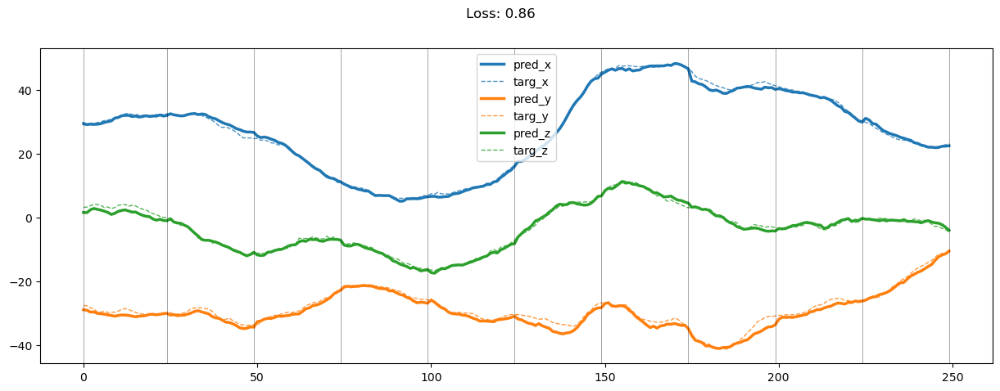

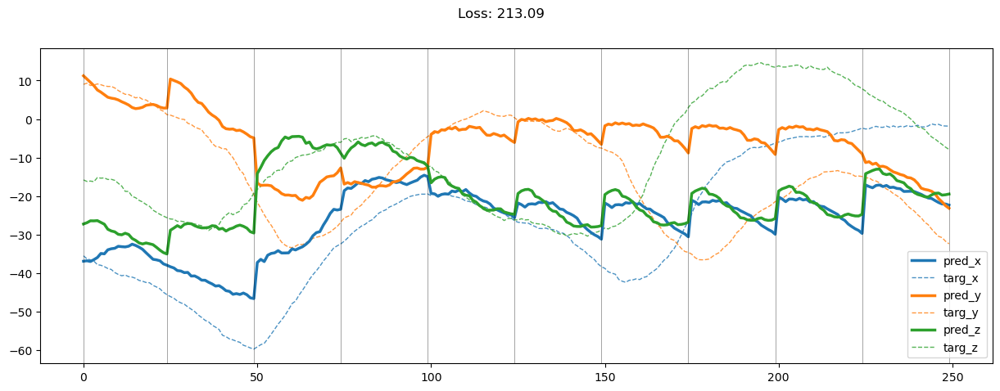

01949: train pred loss:  0.930, g loss:  3.127, diff loss:  1.808, d loss:  1.522
       valid pred loss:  167.473, g loss:  524.389, diff loss:  356.530, d loss:  1.526


100%|██████████| 17/17 [00:01<00:00, 15.18it/s]


01950: train pred loss:  0.882, g loss:  3.012, diff loss:  1.743, d loss:  1.523
       valid pred loss:  168.443, g loss:  527.988, diff loss:  359.159, d loss:  1.527


100%|██████████| 17/17 [00:01<00:00, 15.18it/s]


01951: train pred loss:  0.869, g loss:  2.966, diff loss:  1.710, d loss:  1.524
       valid pred loss:  168.347, g loss:  526.264, diff loss:  357.532, d loss:  1.527


100%|██████████| 17/17 [00:01<00:00, 14.72it/s]


01952: train pred loss:  0.852, g loss:  2.890, diff loss:  1.651, d loss:  1.524
       valid pred loss:  168.252, g loss:  524.155, diff loss:  355.519, d loss:  1.527


100%|██████████| 17/17 [00:01<00:00, 15.15it/s]


01953: train pred loss:  0.817, g loss:  2.812, diff loss:  1.608, d loss:  1.524
       valid pred loss:  166.386, g loss:  516.827, diff loss:  350.056, d loss:  1.528


100%|██████████| 17/17 [00:01<00:00, 14.58it/s]


01954: train pred loss:  0.791, g loss:  2.719, diff loss:  1.542, d loss:  1.524
       valid pred loss:  170.320, g loss:  530.301, diff loss:  359.597, d loss:  1.528


100%|██████████| 17/17 [00:01<00:00, 15.19it/s]


01955: train pred loss:  0.822, g loss:  2.814, diff loss:  1.606, d loss:  1.525
       valid pred loss:  164.284, g loss:  505.478, diff loss:  340.809, d loss:  1.528


100%|██████████| 17/17 [00:01<00:00, 15.19it/s]


01956: train pred loss:  0.800, g loss:  2.733, diff loss:  1.547, d loss:  1.524
       valid pred loss:  165.791, g loss:  514.074, diff loss:  347.898, d loss:  1.528


100%|██████████| 17/17 [00:01<00:00, 15.02it/s]


01957: train pred loss:  0.804, g loss:  2.755, diff loss:  1.564, d loss:  1.524
       valid pred loss:  166.360, g loss:  513.345, diff loss:  346.601, d loss:  1.528


100%|██████████| 17/17 [00:01<00:00, 15.20it/s]


01958: train pred loss:  0.782, g loss:  2.725, diff loss:  1.557, d loss:  1.524
       valid pred loss:  163.292, g loss:  508.029, diff loss:  344.352, d loss:  1.527


100%|██████████| 17/17 [00:01<00:00, 14.05it/s]


01959: train pred loss:  0.809, g loss:  2.775, diff loss:  1.579, d loss:  1.524
       valid pred loss:  164.487, g loss:  508.111, diff loss:  343.238, d loss:  1.527


100%|██████████| 17/17 [00:01<00:00, 15.04it/s]


01960: train pred loss:  0.808, g loss:  2.775, diff loss:  1.580, d loss:  1.523
       valid pred loss:  162.628, g loss:  495.958, diff loss:  332.944, d loss:  1.527


100%|██████████| 17/17 [00:01<00:00, 14.19it/s]


01961: train pred loss:  0.762, g loss:  2.650, diff loss:  1.500, d loss:  1.522
       valid pred loss:  168.794, g loss:  518.104, diff loss:  348.923, d loss:  1.525


100%|██████████| 17/17 [00:01<00:00, 15.11it/s]


01962: train pred loss:  0.738, g loss:  2.598, diff loss:  1.471, d loss:  1.522
       valid pred loss:  164.888, g loss:  503.183, diff loss:  337.908, d loss:  1.525


100%|██████████| 17/17 [00:01<00:00, 14.53it/s]


01963: train pred loss:  0.766, g loss:  2.655, diff loss:  1.500, d loss:  1.521
       valid pred loss:  163.402, g loss:  503.767, diff loss:  339.976, d loss:  1.524


100%|██████████| 17/17 [00:01<00:00, 15.21it/s]


01964: train pred loss:  0.776, g loss:  2.723, diff loss:  1.557, d loss:  1.520
       valid pred loss:  164.973, g loss:  505.947, diff loss:  340.585, d loss:  1.523


100%|██████████| 17/17 [00:01<00:00, 15.11it/s]


01965: train pred loss:  0.800, g loss:  2.772, diff loss:  1.581, d loss:  1.519
       valid pred loss:  163.092, g loss:  505.649, diff loss:  342.166, d loss:  1.522


100%|██████████| 17/17 [00:01<00:00, 15.20it/s]


01966: train pred loss:  0.796, g loss:  2.724, diff loss:  1.535, d loss:  1.518
       valid pred loss:  163.504, g loss:  502.846, diff loss:  338.951, d loss:  1.521


100%|██████████| 17/17 [00:01<00:00, 15.13it/s]


01967: train pred loss:  0.758, g loss:  2.642, diff loss:  1.491, d loss:  1.516
       valid pred loss:  162.473, g loss:  501.186, diff loss:  338.320, d loss:  1.519


100%|██████████| 17/17 [00:01<00:00, 15.01it/s]


01968: train pred loss:  0.745, g loss:  2.578, diff loss:  1.439, d loss:  1.515
       valid pred loss:  164.681, g loss:  508.649, diff loss:  343.573, d loss:  1.518


100%|██████████| 17/17 [00:01<00:00, 15.24it/s]


01969: train pred loss:  0.727, g loss:  2.554, diff loss:  1.431, d loss:  1.513
       valid pred loss:  165.399, g loss:  506.156, diff loss:  340.361, d loss:  1.516


100%|██████████| 17/17 [00:01<00:00, 14.44it/s]


01970: train pred loss:  0.736, g loss:  2.588, diff loss:  1.455, d loss:  1.513
       valid pred loss:  165.572, g loss:  514.496, diff loss:  348.527, d loss:  1.515


100%|██████████| 17/17 [00:01<00:00, 15.15it/s]


01971: train pred loss:  0.756, g loss:  2.633, diff loss:  1.478, d loss:  1.511
       valid pred loss:  163.093, g loss:  499.999, diff loss:  336.508, d loss:  1.514


100%|██████████| 17/17 [00:01<00:00, 15.03it/s]


01972: train pred loss:  0.758, g loss:  2.646, diff loss:  1.487, d loss:  1.510
       valid pred loss:  160.888, g loss:  499.495, diff loss:  338.207, d loss:  1.512


100%|██████████| 17/17 [00:01<00:00, 14.86it/s]


01973: train pred loss:  0.722, g loss:  2.541, diff loss:  1.418, d loss:  1.508
       valid pred loss:  161.480, g loss:  499.228, diff loss:  337.347, d loss:  1.510


100%|██████████| 17/17 [00:01<00:00, 14.83it/s]


01974: train pred loss:  0.732, g loss:  2.555, diff loss:  1.420, d loss:  1.507
       valid pred loss:  166.414, g loss:  517.083, diff loss:  350.267, d loss:  1.509


100%|██████████| 17/17 [00:01<00:00, 14.96it/s]


01975: train pred loss:  0.743, g loss:  2.602, diff loss:  1.455, d loss:  1.505
       valid pred loss:  165.670, g loss:  514.893, diff loss:  348.820, d loss:  1.507


100%|██████████| 17/17 [00:01<00:00, 15.12it/s]


01976: train pred loss:  0.742, g loss:  2.609, diff loss:  1.461, d loss:  1.504
       valid pred loss:  167.028, g loss:  523.029, diff loss:  355.596, d loss:  1.506


100%|██████████| 17/17 [00:01<00:00, 15.16it/s]


01977: train pred loss:  0.712, g loss:  2.503, diff loss:  1.384, d loss:  1.502
       valid pred loss:  166.291, g loss:  516.638, diff loss:  349.940, d loss:  1.504


100%|██████████| 17/17 [00:01<00:00, 15.10it/s]


01978: train pred loss:  0.721, g loss:  2.553, diff loss:  1.423, d loss:  1.501
       valid pred loss:  166.932, g loss:  516.798, diff loss:  349.458, d loss:  1.503


100%|██████████| 17/17 [00:01<00:00, 15.13it/s]


01979: train pred loss:  0.745, g loss:  2.620, diff loss:  1.464, d loss:  1.499
       valid pred loss:  166.970, g loss:  516.003, diff loss:  348.624, d loss:  1.501


100%|██████████| 17/17 [00:01<00:00, 15.11it/s]


01980: train pred loss:  0.737, g loss:  2.604, diff loss:  1.454, d loss:  1.498
       valid pred loss:  163.637, g loss:  505.340, diff loss:  341.292, d loss:  1.500


100%|██████████| 17/17 [00:01<00:00, 15.11it/s]


01981: train pred loss:  0.743, g loss:  2.633, diff loss:  1.477, d loss:  1.497
       valid pred loss:  165.696, g loss:  508.190, diff loss:  342.082, d loss:  1.499


100%|██████████| 17/17 [00:01<00:00, 14.56it/s]


01982: train pred loss:  0.749, g loss:  2.650, diff loss:  1.486, d loss:  1.495
       valid pred loss:  161.668, g loss:  495.801, diff loss:  333.719, d loss:  1.497


100%|██████████| 17/17 [00:01<00:00, 14.45it/s]


01983: train pred loss:  0.762, g loss:  2.679, diff loss:  1.501, d loss:  1.494
       valid pred loss:  164.318, g loss:  503.856, diff loss:  339.124, d loss:  1.496


100%|██████████| 17/17 [00:01<00:00, 14.58it/s]


01984: train pred loss:  0.766, g loss:  2.692, diff loss:  1.510, d loss:  1.493
       valid pred loss:  164.593, g loss:  503.317, diff loss:  338.308, d loss:  1.495


100%|██████████| 17/17 [00:01<00:00, 15.12it/s]


01985: train pred loss:  0.746, g loss:  2.640, diff loss:  1.476, d loss:  1.492
       valid pred loss:  163.699, g loss:  500.448, diff loss:  336.333, d loss:  1.494


100%|██████████| 17/17 [00:01<00:00, 15.11it/s]


01986: train pred loss:  0.755, g loss:  2.638, diff loss:  1.464, d loss:  1.491
       valid pred loss:  163.231, g loss:  504.142, diff loss:  340.493, d loss:  1.493


100%|██████████| 17/17 [00:01<00:00, 15.14it/s]


01987: train pred loss:  0.721, g loss:  2.555, diff loss:  1.413, d loss:  1.490
       valid pred loss:  163.432, g loss:  502.269, diff loss:  338.418, d loss:  1.492


100%|██████████| 17/17 [00:01<00:00, 15.07it/s]


01988: train pred loss:  0.715, g loss:  2.553, diff loss:  1.416, d loss:  1.489
       valid pred loss:  164.712, g loss:  506.641, diff loss:  341.509, d loss:  1.492


100%|██████████| 17/17 [00:01<00:00, 15.09it/s]


01989: train pred loss:  0.711, g loss:  2.551, diff loss:  1.419, d loss:  1.488
       valid pred loss:  164.901, g loss:  513.092, diff loss:  347.771, d loss:  1.491


100%|██████████| 17/17 [00:01<00:00, 15.09it/s]


01990: train pred loss:  0.719, g loss:  2.567, diff loss:  1.426, d loss:  1.488
       valid pred loss:  165.411, g loss:  510.779, diff loss:  344.947, d loss:  1.490


100%|██████████| 17/17 [00:01<00:00, 15.02it/s]


01991: train pred loss:  0.749, g loss:  2.656, diff loss:  1.483, d loss:  1.487
       valid pred loss:  165.131, g loss:  513.904, diff loss:  348.351, d loss:  1.489


100%|██████████| 17/17 [00:01<00:00, 15.09it/s]


01992: train pred loss:  0.816, g loss:  2.866, diff loss:  1.626, d loss:  1.487
       valid pred loss:  166.810, g loss:  516.693, diff loss:  349.460, d loss:  1.489


100%|██████████| 17/17 [00:01<00:00, 15.08it/s]


01993: train pred loss:  0.789, g loss:  2.751, diff loss:  1.538, d loss:  1.486
       valid pred loss:  169.166, g loss:  529.351, diff loss:  359.762, d loss:  1.489


100%|██████████| 17/17 [00:01<00:00, 14.88it/s]


01994: train pred loss:  0.775, g loss:  2.692, diff loss:  1.493, d loss:  1.486
       valid pred loss:  169.677, g loss:  527.312, diff loss:  357.212, d loss:  1.489


100%|██████████| 17/17 [00:01<00:00, 14.41it/s]


01995: train pred loss:  0.765, g loss:  2.705, diff loss:  1.516, d loss:  1.486
       valid pred loss:  168.724, g loss:  527.924, diff loss:  358.776, d loss:  1.489


100%|██████████| 17/17 [00:01<00:00, 15.22it/s]


01996: train pred loss:  0.787, g loss:  2.746, diff loss:  1.534, d loss:  1.486
       valid pred loss:  165.874, g loss:  514.017, diff loss:  347.720, d loss:  1.489


100%|██████████| 17/17 [00:01<00:00, 14.07it/s]


01997: train pred loss:  0.755, g loss:  2.662, diff loss:  1.483, d loss:  1.486
       valid pred loss:  165.796, g loss:  516.160, diff loss:  349.942, d loss:  1.489


100%|██████████| 17/17 [00:01<00:00, 14.84it/s]


01998: train pred loss:  0.744, g loss:  2.621, diff loss:  1.454, d loss:  1.487
       valid pred loss:  166.503, g loss:  517.265, diff loss:  350.340, d loss:  1.489


100%|██████████| 17/17 [00:01<00:00, 14.29it/s]


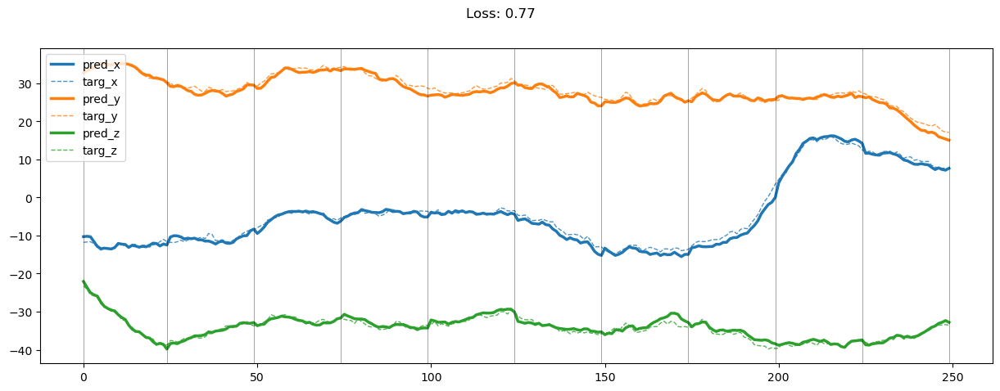

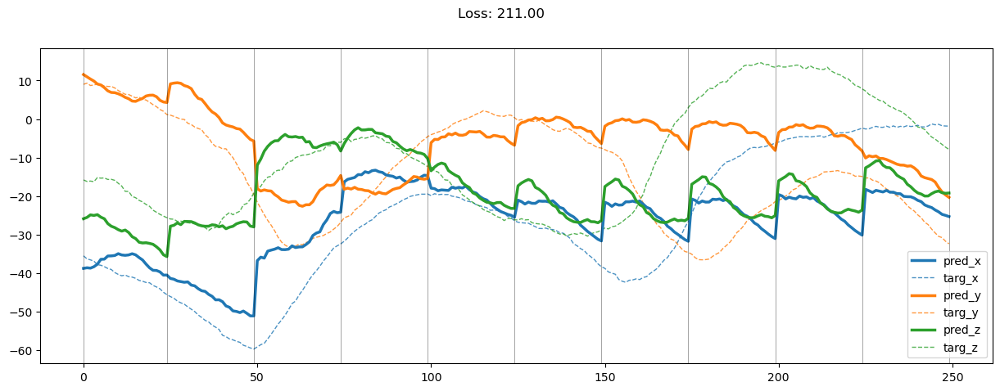

01999: train pred loss:  0.730, g loss:  2.605, diff loss:  1.450, d loss:  1.487
       valid pred loss:  166.527, g loss:  515.723, diff loss:  348.775, d loss:  1.490


In [33]:
draw = True

for epoch in range(EPOCH):
    #####
    # 1. 用上半部訓練50epoch
    # 2. 隨機用上或下半部訓練Model
    # 3. 印出trajectory結果
    #####
    
    if (epoch + 1) % 50 == 0:
        draw = True
    
    train_pred_loss, train_g_loss, train_diff_loss, train_d_loss = train(train_loader, draw)
    valid_pred_loss, valid_g_loss, valid_diff_loss, valid_d_loss = evalute(valid_loader, draw)
    
    draw = False
    
    ep = str(epoch).zfill(5)
    print(f'{ep:>5}: train pred loss: {train_pred_loss: 2.3f}, g loss: {train_g_loss: 2.3f}, diff loss: {train_diff_loss: 2.3f}, d loss: {train_d_loss: 2.3f}\n' +
          f'{"":>5}  valid pred loss: {valid_pred_loss: 2.3f}, g loss: {valid_g_loss: 2.3f}, diff loss: {valid_diff_loss: 2.3f}, d loss: {valid_d_loss: 2.3f}')

In [34]:
def output_eval(model, dataloader):
    model.eval()
    
    results = []
    
    with torch.no_grad():
        for source_data, source_label, target_data, target_label in dataloader:
            source_data = source_data.to(device)
            target_data = target_data.to(device)

            #############
            # generator #
            #############
            predict_mag = model(source_data[:, :, :, :9], source_data[:, :, :, 9:12])

            predict_loss = mse_loss(predict_mag, target_data[:, :, :, 9:12])
            
            results.extend(zip(predict_mag.detach().cpu().numpy(), target_data[:, :, :, 9:12].cpu().numpy()))
            
            break
    
    return np.array(results)

100%|██████████| 17/17 [00:01<00:00, 15.11it/s]


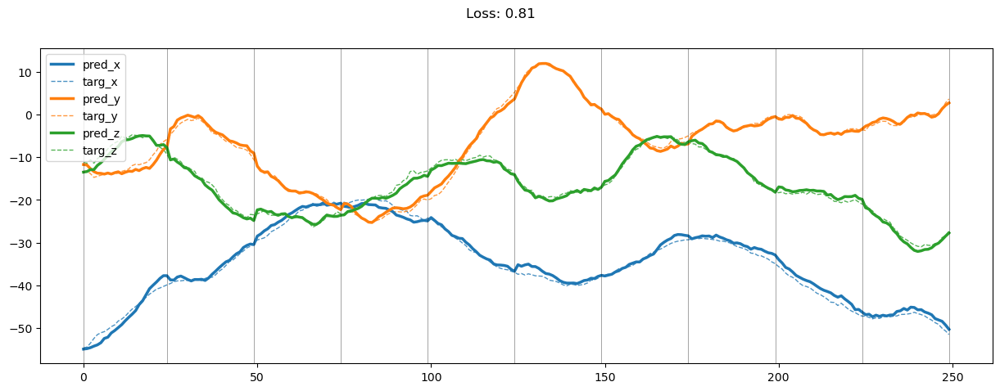

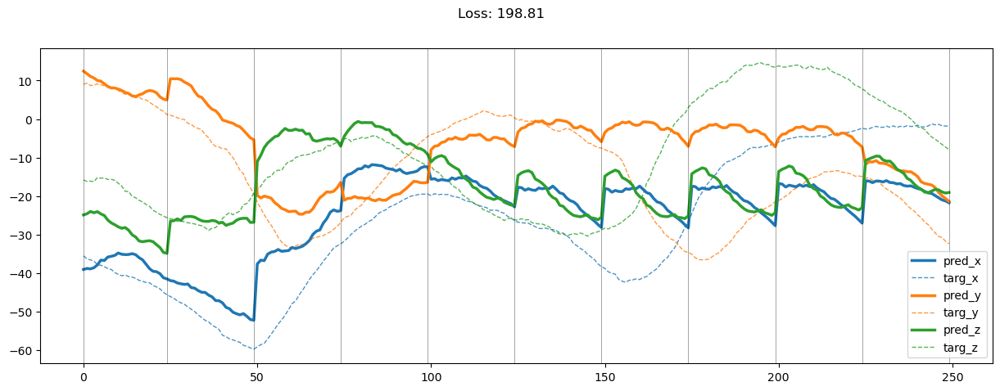

00000: train pred loss:  0.758, g loss:  2.664, diff loss:  1.483, d loss:  1.488
       valid pred loss:  166.196, g loss:  513.348, diff loss:  346.730, d loss:  1.489


100%|██████████| 17/17 [00:01<00:00, 15.24it/s]


00001: train pred loss:  0.773, g loss:  2.713, diff loss:  1.517, d loss:  1.488
       valid pred loss:  164.381, g loss:  507.289, diff loss:  342.487, d loss:  1.490


100%|██████████| 17/17 [00:01<00:00, 15.25it/s]


00002: train pred loss:  0.784, g loss:  2.728, diff loss:  1.523, d loss:  1.489
       valid pred loss:  165.870, g loss:  513.466, diff loss:  347.175, d loss:  1.491


100%|██████████| 17/17 [00:01<00:00, 15.26it/s]


00003: train pred loss:  0.786, g loss:  2.779, diff loss:  1.572, d loss:  1.489
       valid pred loss:  165.458, g loss:  506.464, diff loss:  340.587, d loss:  1.492


100%|██████████| 17/17 [00:01<00:00, 15.17it/s]


00004: train pred loss:  0.810, g loss:  2.821, diff loss:  1.591, d loss:  1.491
       valid pred loss:  164.069, g loss:  509.894, diff loss:  345.407, d loss:  1.493


100%|██████████| 17/17 [00:01<00:00, 15.17it/s]


00005: train pred loss:  0.818, g loss:  2.842, diff loss:  1.605, d loss:  1.492
       valid pred loss:  165.500, g loss:  516.648, diff loss:  350.731, d loss:  1.495


100%|██████████| 17/17 [00:01<00:00, 15.16it/s]


00006: train pred loss:  0.785, g loss:  2.730, diff loss:  1.527, d loss:  1.493
       valid pred loss:  168.915, g loss:  523.332, diff loss:  354.002, d loss:  1.495


100%|██████████| 17/17 [00:01<00:00, 15.17it/s]


00007: train pred loss:  0.773, g loss:  2.723, diff loss:  1.534, d loss:  1.494
       valid pred loss:  166.658, g loss:  515.326, diff loss:  348.253, d loss:  1.496


100%|██████████| 17/17 [00:01<00:00, 14.68it/s]


00008: train pred loss:  0.756, g loss:  2.667, diff loss:  1.496, d loss:  1.495
       valid pred loss:  165.792, g loss:  507.632, diff loss:  341.428, d loss:  1.501


100%|██████████| 17/17 [00:01<00:00, 15.20it/s]


00009: train pred loss:  0.748, g loss:  2.633, diff loss:  1.471, d loss:  1.496
       valid pred loss:  164.839, g loss:  510.512, diff loss:  345.261, d loss:  1.499


100%|██████████| 17/17 [00:01<00:00, 15.20it/s]


00010: train pred loss:  0.738, g loss:  2.580, diff loss:  1.429, d loss:  1.498
       valid pred loss:  167.244, g loss:  513.555, diff loss:  345.900, d loss:  1.500


100%|██████████| 17/17 [00:01<00:00, 15.21it/s]


00011: train pred loss:  0.739, g loss:  2.580, diff loss:  1.429, d loss:  1.498
       valid pred loss:  168.343, g loss:  521.987, diff loss:  353.234, d loss:  1.501


100%|██████████| 17/17 [00:01<00:00, 15.23it/s]


00012: train pred loss:  0.740, g loss:  2.615, diff loss:  1.464, d loss:  1.499
       valid pred loss:  163.492, g loss:  502.443, diff loss:  338.542, d loss:  1.502


100%|██████████| 17/17 [00:01<00:00, 15.01it/s]


00013: train pred loss:  0.757, g loss:  2.648, diff loss:  1.480, d loss:  1.500
       valid pred loss:  159.489, g loss:  491.275, diff loss:  331.377, d loss:  1.502


100%|██████████| 17/17 [00:01<00:00, 15.24it/s]


00014: train pred loss:  0.750, g loss:  2.642, diff loss:  1.482, d loss:  1.501
       valid pred loss:  165.144, g loss:  506.886, diff loss:  341.335, d loss:  1.503


100%|██████████| 17/17 [00:01<00:00, 15.26it/s]


00015: train pred loss:  0.744, g loss:  2.604, diff loss:  1.452, d loss:  1.502
       valid pred loss:  166.870, g loss:  515.377, diff loss:  348.101, d loss:  1.505


100%|██████████| 17/17 [00:01<00:00, 14.70it/s]


00016: train pred loss:  0.756, g loss:  2.641, diff loss:  1.478, d loss:  1.502
       valid pred loss:  165.808, g loss:  510.935, diff loss:  344.722, d loss:  1.506


100%|██████████| 17/17 [00:01<00:00, 15.22it/s]


00017: train pred loss:  0.760, g loss:  2.671, diff loss:  1.505, d loss:  1.504
       valid pred loss:  169.705, g loss:  522.127, diff loss:  352.019, d loss:  1.508


100%|██████████| 17/17 [00:01<00:00, 15.00it/s]


00018: train pred loss:  0.805, g loss:  2.771, diff loss:  1.560, d loss:  1.505
       valid pred loss:  169.954, g loss:  523.647, diff loss:  353.291, d loss:  1.509


100%|██████████| 17/17 [00:01<00:00, 15.25it/s]


00019: train pred loss:  0.822, g loss:  2.809, diff loss:  1.583, d loss:  1.505
       valid pred loss:  167.172, g loss:  517.037, diff loss:  349.463, d loss:  1.510


100%|██████████| 17/17 [00:01<00:00, 15.24it/s]


00020: train pred loss:  0.816, g loss:  2.802, diff loss:  1.584, d loss:  1.507
       valid pred loss:  166.599, g loss:  512.814, diff loss:  345.815, d loss:  1.511


100%|██████████| 17/17 [00:01<00:00, 14.05it/s]


00021: train pred loss:  0.799, g loss:  2.755, diff loss:  1.554, d loss:  1.508
       valid pred loss:  167.342, g loss:  514.945, diff loss:  347.204, d loss:  1.512


100%|██████████| 17/17 [00:01<00:00, 15.18it/s]


00022: train pred loss:  0.787, g loss:  2.687, diff loss:  1.499, d loss:  1.509
       valid pred loss:  166.022, g loss:  508.601, diff loss:  342.181, d loss:  1.513


100%|██████████| 17/17 [00:01<00:00, 15.22it/s]


00023: train pred loss:  0.764, g loss:  2.648, diff loss:  1.485, d loss:  1.510
       valid pred loss:  166.222, g loss:  509.119, diff loss:  342.501, d loss:  1.515


100%|██████████| 17/17 [00:01<00:00, 15.23it/s]


00024: train pred loss:  0.778, g loss:  2.719, diff loss:  1.542, d loss:  1.511
       valid pred loss:  165.410, g loss:  505.347, diff loss:  339.541, d loss:  1.516


100%|██████████| 17/17 [00:01<00:00, 15.19it/s]


00025: train pred loss:  0.790, g loss:  2.714, diff loss:  1.526, d loss:  1.512
       valid pred loss:  163.749, g loss:  503.200, diff loss:  339.056, d loss:  1.517


100%|██████████| 17/17 [00:01<00:00, 14.48it/s]


00026: train pred loss:  0.810, g loss:  2.758, diff loss:  1.551, d loss:  1.513
       valid pred loss:  167.134, g loss:  515.853, diff loss:  348.326, d loss:  1.518


100%|██████████| 17/17 [00:01<00:00, 15.24it/s]


00027: train pred loss:  0.776, g loss:  2.691, diff loss:  1.519, d loss:  1.514
       valid pred loss:  164.657, g loss:  504.866, diff loss:  339.816, d loss:  1.518


100%|██████████| 17/17 [00:01<00:00, 15.25it/s]


00028: train pred loss:  0.759, g loss:  2.633, diff loss:  1.479, d loss:  1.515
       valid pred loss:  165.521, g loss:  510.744, diff loss:  344.831, d loss:  1.519


100%|██████████| 17/17 [00:01<00:00, 15.24it/s]


00029: train pred loss:  0.785, g loss:  2.685, diff loss:  1.505, d loss:  1.515
       valid pred loss:  166.969, g loss:  510.388, diff loss:  343.027, d loss:  1.520


100%|██████████| 17/17 [00:01<00:00, 15.22it/s]


00030: train pred loss:  0.764, g loss:  2.661, diff loss:  1.503, d loss:  1.516
       valid pred loss:  165.792, g loss:  508.509, diff loss:  342.325, d loss:  1.521


100%|██████████| 17/17 [00:01<00:00, 15.25it/s]


00031: train pred loss:  0.778, g loss:  2.697, diff loss:  1.525, d loss:  1.517
       valid pred loss:  164.945, g loss:  508.235, diff loss:  342.899, d loss:  1.522


100%|██████████| 17/17 [00:01<00:00, 15.25it/s]


00032: train pred loss:  0.744, g loss:  2.599, diff loss:  1.461, d loss:  1.517
       valid pred loss:  163.111, g loss:  501.910, diff loss:  338.408, d loss:  1.521


100%|██████████| 17/17 [00:01<00:00, 15.22it/s]


00033: train pred loss:  0.725, g loss:  2.538, diff loss:  1.420, d loss:  1.517
       valid pred loss:  164.655, g loss:  506.899, diff loss:  341.853, d loss:  1.522


100%|██████████| 17/17 [00:01<00:00, 15.21it/s]


00034: train pred loss:  0.706, g loss:  2.494, diff loss:  1.395, d loss:  1.518
       valid pred loss:  162.083, g loss:  493.397, diff loss:  330.924, d loss:  1.522


100%|██████████| 17/17 [00:01<00:00, 15.23it/s]


00035: train pred loss:  0.723, g loss:  2.540, diff loss:  1.425, d loss:  1.518
       valid pred loss:  162.389, g loss:  494.848, diff loss:  332.070, d loss:  1.523


100%|██████████| 17/17 [00:01<00:00, 15.19it/s]


00036: train pred loss:  0.716, g loss:  2.528, diff loss:  1.419, d loss:  1.518
       valid pred loss:  165.885, g loss:  508.871, diff loss:  342.596, d loss:  1.522


100%|██████████| 17/17 [00:01<00:00, 15.17it/s]


00037: train pred loss:  0.727, g loss:  2.558, diff loss:  1.439, d loss:  1.518
       valid pred loss:  165.294, g loss:  506.353, diff loss:  340.670, d loss:  1.522


100%|██████████| 17/17 [00:01<00:00, 15.16it/s]


00038: train pred loss:  0.719, g loss:  2.549, diff loss:  1.437, d loss:  1.518
       valid pred loss:  165.408, g loss:  506.100, diff loss:  340.302, d loss:  1.522


100%|██████████| 17/17 [00:01<00:00, 15.17it/s]


00039: train pred loss:  0.732, g loss:  2.564, diff loss:  1.440, d loss:  1.518
       valid pred loss:  165.195, g loss:  501.738, diff loss:  336.153, d loss:  1.521


100%|██████████| 17/17 [00:01<00:00, 15.14it/s]


00040: train pred loss:  0.751, g loss:  2.617, diff loss:  1.473, d loss:  1.517
       valid pred loss:  163.326, g loss:  499.133, diff loss:  335.417, d loss:  1.521


100%|██████████| 17/17 [00:01<00:00, 15.11it/s]


00041: train pred loss:  0.768, g loss:  2.662, diff loss:  1.500, d loss:  1.517
       valid pred loss:  164.341, g loss:  501.838, diff loss:  337.106, d loss:  1.521


100%|██████████| 17/17 [00:01<00:00, 15.24it/s]


00042: train pred loss:  0.764, g loss:  2.659, diff loss:  1.501, d loss:  1.516
       valid pred loss:  162.775, g loss:  495.997, diff loss:  332.831, d loss:  1.520


100%|██████████| 17/17 [00:01<00:00, 15.18it/s]


00043: train pred loss:  0.765, g loss:  2.641, diff loss:  1.482, d loss:  1.515
       valid pred loss:  161.394, g loss:  499.330, diff loss:  337.543, d loss:  1.519


100%|██████████| 17/17 [00:01<00:00, 15.18it/s]


00044: train pred loss:  0.757, g loss:  2.629, diff loss:  1.477, d loss:  1.515
       valid pred loss:  165.648, g loss:  513.098, diff loss:  347.057, d loss:  1.518


100%|██████████| 17/17 [00:01<00:00, 15.23it/s]


00045: train pred loss:  0.789, g loss:  2.724, diff loss:  1.539, d loss:  1.514
       valid pred loss:  166.756, g loss:  520.249, diff loss:  353.099, d loss:  1.518


100%|██████████| 17/17 [00:01<00:00, 15.22it/s]


00046: train pred loss:  0.821, g loss:  2.809, diff loss:  1.592, d loss:  1.513
       valid pred loss:  168.236, g loss:  521.364, diff loss:  352.734, d loss:  1.517


100%|██████████| 17/17 [00:01<00:00, 15.18it/s]


00047: train pred loss:  0.814, g loss:  2.780, diff loss:  1.568, d loss:  1.512
       valid pred loss:  167.998, g loss:  520.909, diff loss:  352.515, d loss:  1.516


100%|██████████| 17/17 [00:01<00:00, 15.04it/s]


00048: train pred loss:  0.815, g loss:  2.827, diff loss:  1.613, d loss:  1.511
       valid pred loss:  165.703, g loss:  512.567, diff loss:  346.468, d loss:  1.515


100%|██████████| 17/17 [00:01<00:00, 15.21it/s]


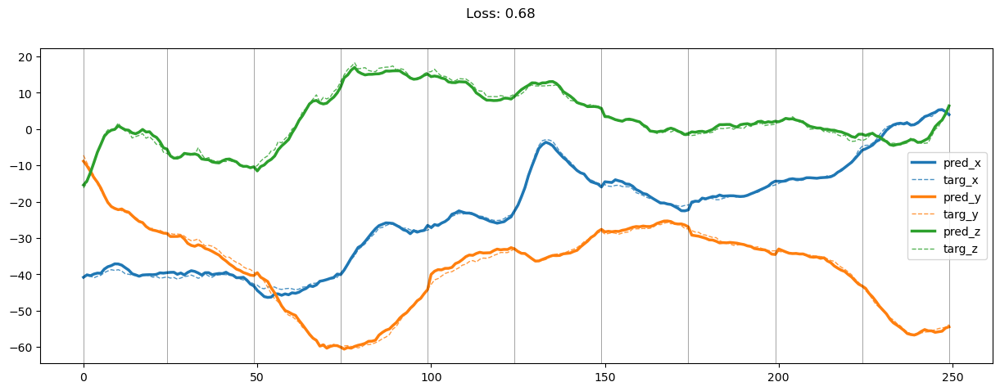

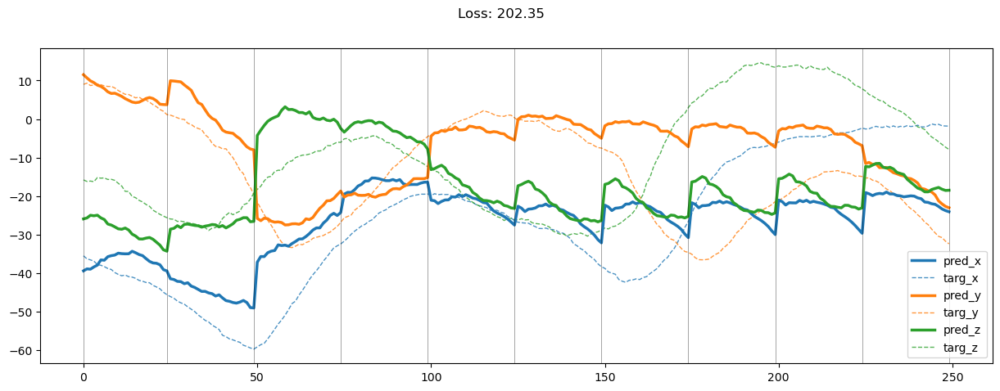

00049: train pred loss:  0.816, g loss:  2.807, diff loss:  1.591, d loss:  1.510
       valid pred loss:  167.250, g loss:  517.923, diff loss:  350.275, d loss:  1.513


100%|██████████| 17/17 [00:01<00:00, 15.08it/s]


00050: train pred loss:  0.788, g loss:  2.734, diff loss:  1.545, d loss:  1.509
       valid pred loss:  163.939, g loss:  509.791, diff loss:  345.453, d loss:  1.512


100%|██████████| 17/17 [00:01<00:00, 15.23it/s]


00051: train pred loss:  0.797, g loss:  2.744, diff loss:  1.545, d loss:  1.508
       valid pred loss:  164.071, g loss:  505.977, diff loss:  341.506, d loss:  1.511


100%|██████████| 17/17 [00:01<00:00, 15.02it/s]


00052: train pred loss:  0.802, g loss:  2.790, diff loss:  1.585, d loss:  1.507
       valid pred loss:  167.118, g loss:  515.189, diff loss:  347.669, d loss:  1.510


100%|██████████| 17/17 [00:01<00:00, 15.12it/s]


00053: train pred loss:  0.772, g loss:  2.682, diff loss:  1.505, d loss:  1.505
       valid pred loss:  160.359, g loss:  494.969, diff loss:  334.208, d loss:  1.509


100%|██████████| 17/17 [00:01<00:00, 15.13it/s]


00054: train pred loss:  0.749, g loss:  2.628, diff loss:  1.473, d loss:  1.504
       valid pred loss:  163.120, g loss:  504.724, diff loss:  341.200, d loss:  1.508


100%|██████████| 17/17 [00:01<00:00, 15.21it/s]


00055: train pred loss:  0.748, g loss:  2.614, diff loss:  1.459, d loss:  1.503
       valid pred loss:  164.320, g loss:  505.687, diff loss:  340.962, d loss:  1.506


100%|██████████| 17/17 [00:01<00:00, 15.22it/s]


00056: train pred loss:  0.738, g loss:  2.602, diff loss:  1.456, d loss:  1.502
       valid pred loss:  166.877, g loss:  512.227, diff loss:  344.943, d loss:  1.505


100%|██████████| 17/17 [00:01<00:00, 15.23it/s]


00057: train pred loss:  0.770, g loss:  2.692, diff loss:  1.512, d loss:  1.501
       valid pred loss:  164.673, g loss:  504.607, diff loss:  339.527, d loss:  1.504


100%|██████████| 17/17 [00:01<00:00, 14.76it/s]


00058: train pred loss:  0.771, g loss:  2.682, diff loss:  1.501, d loss:  1.500
       valid pred loss:  164.873, g loss:  506.907, diff loss:  341.625, d loss:  1.503


100%|██████████| 17/17 [00:01<00:00, 15.25it/s]


00059: train pred loss:  0.775, g loss:  2.693, diff loss:  1.507, d loss:  1.499
       valid pred loss:  162.968, g loss:  499.494, diff loss:  336.117, d loss:  1.502


100%|██████████| 17/17 [00:01<00:00, 15.25it/s]


00060: train pred loss:  0.723, g loss:  2.571, diff loss:  1.436, d loss:  1.498
       valid pred loss:  165.251, g loss:  507.102, diff loss:  341.440, d loss:  1.501


100%|██████████| 17/17 [00:01<00:00, 15.25it/s]


00061: train pred loss:  0.745, g loss:  2.616, diff loss:  1.458, d loss:  1.497
       valid pred loss:  162.468, g loss:  498.093, diff loss:  335.214, d loss:  1.500


100%|██████████| 17/17 [00:01<00:00, 15.24it/s]


00062: train pred loss:  0.716, g loss:  2.533, diff loss:  1.404, d loss:  1.496
       valid pred loss:  158.842, g loss:  491.701, diff loss:  332.446, d loss:  1.499


100%|██████████| 17/17 [00:01<00:00, 15.24it/s]


00063: train pred loss:  0.725, g loss:  2.579, diff loss:  1.439, d loss:  1.495
       valid pred loss:  161.467, g loss:  495.122, diff loss:  333.242, d loss:  1.498


100%|██████████| 17/17 [00:01<00:00, 15.24it/s]


00064: train pred loss:  0.729, g loss:  2.588, diff loss:  1.443, d loss:  1.494
       valid pred loss:  164.096, g loss:  510.589, diff loss:  346.078, d loss:  1.497


100%|██████████| 17/17 [00:01<00:00, 15.27it/s]


00065: train pred loss:  0.735, g loss:  2.613, diff loss:  1.461, d loss:  1.493
       valid pred loss:  162.246, g loss:  502.139, diff loss:  339.478, d loss:  1.497


100%|██████████| 17/17 [00:01<00:00, 15.27it/s]


00066: train pred loss:  0.741, g loss:  2.614, diff loss:  1.456, d loss:  1.493
       valid pred loss:  164.558, g loss:  508.524, diff loss:  343.550, d loss:  1.496


100%|██████████| 17/17 [00:01<00:00, 15.21it/s]


00067: train pred loss:  0.725, g loss:  2.589, diff loss:  1.446, d loss:  1.492
       valid pred loss:  163.200, g loss:  499.653, diff loss:  336.037, d loss:  1.495


100%|██████████| 17/17 [00:01<00:00, 15.02it/s]


00068: train pred loss:  0.725, g loss:  2.582, diff loss:  1.439, d loss:  1.492
       valid pred loss:  162.343, g loss:  496.693, diff loss:  333.934, d loss:  1.495


100%|██████████| 17/17 [00:01<00:00, 15.25it/s]


00069: train pred loss:  0.746, g loss:  2.642, diff loss:  1.477, d loss:  1.492
       valid pred loss:  161.391, g loss:  493.900, diff loss:  332.092, d loss:  1.495


100%|██████████| 17/17 [00:01<00:00, 14.54it/s]


00070: train pred loss:  0.748, g loss:  2.604, diff loss:  1.437, d loss:  1.491
       valid pred loss:  160.527, g loss:  487.189, diff loss:  326.245, d loss:  1.495


100%|██████████| 17/17 [00:01<00:00, 15.20it/s]


00071: train pred loss:  0.734, g loss:  2.592, diff loss:  1.439, d loss:  1.491
       valid pred loss:  163.331, g loss:  491.621, diff loss:  327.874, d loss:  1.495


100%|██████████| 17/17 [00:01<00:00, 14.61it/s]


00072: train pred loss:  0.756, g loss:  2.650, diff loss:  1.474, d loss:  1.491
       valid pred loss:  164.141, g loss:  504.078, diff loss:  339.520, d loss:  1.494


100%|██████████| 17/17 [00:01<00:00, 15.18it/s]


00073: train pred loss:  0.788, g loss:  2.743, diff loss:  1.536, d loss:  1.491
       valid pred loss:  161.087, g loss:  493.964, diff loss:  332.460, d loss:  1.495


100%|██████████| 17/17 [00:01<00:00, 14.44it/s]


00074: train pred loss:  0.767, g loss:  2.656, diff loss:  1.470, d loss:  1.491
       valid pred loss:  161.720, g loss:  496.118, diff loss:  333.981, d loss:  1.495


100%|██████████| 17/17 [00:01<00:00, 15.23it/s]


00075: train pred loss:  0.740, g loss:  2.629, diff loss:  1.470, d loss:  1.491
       valid pred loss:  162.269, g loss:  498.951, diff loss:  336.266, d loss:  1.495


100%|██████████| 17/17 [00:01<00:00, 15.22it/s]


00076: train pred loss:  0.759, g loss:  2.668, diff loss:  1.491, d loss:  1.492
       valid pred loss:  165.403, g loss:  506.523, diff loss:  340.704, d loss:  1.495


100%|██████████| 17/17 [00:01<00:00, 15.23it/s]


00077: train pred loss:  0.792, g loss:  2.750, diff loss:  1.540, d loss:  1.492
       valid pred loss:  165.127, g loss:  504.368, diff loss:  338.825, d loss:  1.496


100%|██████████| 17/17 [00:01<00:00, 15.22it/s]


00078: train pred loss:  0.768, g loss:  2.683, diff loss:  1.498, d loss:  1.493
       valid pred loss:  165.446, g loss:  511.609, diff loss:  345.748, d loss:  1.496


100%|██████████| 17/17 [00:01<00:00, 15.23it/s]


00079: train pred loss:  0.795, g loss:  2.789, diff loss:  1.576, d loss:  1.493
       valid pred loss:  164.698, g loss:  510.023, diff loss:  344.910, d loss:  1.497


100%|██████████| 17/17 [00:01<00:00, 14.50it/s]


00080: train pred loss:  0.755, g loss:  2.685, diff loss:  1.513, d loss:  1.494
       valid pred loss:  167.855, g loss:  518.508, diff loss:  350.240, d loss:  1.498


100%|██████████| 17/17 [00:01<00:00, 13.96it/s]


00081: train pred loss:  0.724, g loss:  2.583, diff loss:  1.444, d loss:  1.494
       valid pred loss:  164.127, g loss:  510.037, diff loss:  345.498, d loss:  1.499


100%|██████████| 17/17 [00:01<00:00, 14.34it/s]


00082: train pred loss:  0.730, g loss:  2.580, diff loss:  1.436, d loss:  1.495
       valid pred loss:  167.166, g loss:  516.887, diff loss:  349.310, d loss:  1.500


100%|██████████| 17/17 [00:01<00:00, 15.23it/s]


00083: train pred loss:  0.728, g loss:  2.570, diff loss:  1.429, d loss:  1.496
       valid pred loss:  165.627, g loss:  510.575, diff loss:  344.538, d loss:  1.501


100%|██████████| 17/17 [00:01<00:00, 15.25it/s]


00084: train pred loss:  0.725, g loss:  2.571, diff loss:  1.433, d loss:  1.498
       valid pred loss:  164.557, g loss:  510.551, diff loss:  345.584, d loss:  1.502


100%|██████████| 17/17 [00:01<00:00, 14.64it/s]


00085: train pred loss:  0.686, g loss:  2.464, diff loss:  1.366, d loss:  1.498
       valid pred loss:  166.924, g loss:  513.683, diff loss:  346.350, d loss:  1.503


100%|██████████| 17/17 [00:01<00:00, 15.15it/s]


00086: train pred loss:  0.703, g loss:  2.504, diff loss:  1.391, d loss:  1.500
       valid pred loss:  161.558, g loss:  499.659, diff loss:  337.694, d loss:  1.504


100%|██████████| 17/17 [00:01<00:00, 15.14it/s]


00087: train pred loss:  0.696, g loss:  2.477, diff loss:  1.371, d loss:  1.500
       valid pred loss:  164.578, g loss:  507.470, diff loss:  342.486, d loss:  1.505


100%|██████████| 17/17 [00:01<00:00, 15.13it/s]


00088: train pred loss:  0.712, g loss:  2.528, diff loss:  1.408, d loss:  1.502
       valid pred loss:  165.213, g loss:  507.672, diff loss:  342.053, d loss:  1.506


100%|██████████| 17/17 [00:01<00:00, 15.10it/s]


00089: train pred loss:  0.719, g loss:  2.536, diff loss:  1.410, d loss:  1.503
       valid pred loss:  166.897, g loss:  520.495, diff loss:  353.194, d loss:  1.508


100%|██████████| 17/17 [00:01<00:00, 14.64it/s]


00090: train pred loss:  0.735, g loss:  2.591, diff loss:  1.450, d loss:  1.504
       valid pred loss:  163.868, g loss:  505.492, diff loss:  341.221, d loss:  1.509


100%|██████████| 17/17 [00:01<00:00, 15.17it/s]


00091: train pred loss:  0.710, g loss:  2.499, diff loss:  1.384, d loss:  1.505
       valid pred loss:  164.833, g loss:  508.243, diff loss:  343.008, d loss:  1.510


100%|██████████| 17/17 [00:01<00:00, 14.85it/s]


00092: train pred loss:  0.687, g loss:  2.444, diff loss:  1.353, d loss:  1.507
       valid pred loss:  164.366, g loss:  504.879, diff loss:  340.113, d loss:  1.511


100%|██████████| 17/17 [00:01<00:00, 15.11it/s]


00093: train pred loss:  0.706, g loss:  2.505, diff loss:  1.397, d loss:  1.508
       valid pred loss:  164.414, g loss:  500.005, diff loss:  335.192, d loss:  1.513


100%|██████████| 17/17 [00:01<00:00, 15.05it/s]


00094: train pred loss:  0.709, g loss:  2.499, diff loss:  1.389, d loss:  1.509
       valid pred loss:  164.833, g loss:  507.465, diff loss:  342.234, d loss:  1.513


100%|██████████| 17/17 [00:01<00:00, 15.07it/s]


00095: train pred loss:  0.701, g loss:  2.475, diff loss:  1.374, d loss:  1.510
       valid pred loss:  164.504, g loss:  507.565, diff loss:  342.664, d loss:  1.515


100%|██████████| 17/17 [00:01<00:00, 14.96it/s]


00096: train pred loss:  0.696, g loss:  2.460, diff loss:  1.365, d loss:  1.511
       valid pred loss:  165.037, g loss:  506.620, diff loss:  341.186, d loss:  1.516


100%|██████████| 17/17 [00:01<00:00, 15.14it/s]


00097: train pred loss:  0.688, g loss:  2.449, diff loss:  1.363, d loss:  1.512
       valid pred loss:  165.735, g loss:  519.299, diff loss:  353.169, d loss:  1.517


100%|██████████| 17/17 [00:01<00:00, 15.12it/s]


00098: train pred loss:  0.672, g loss:  2.394, diff loss:  1.325, d loss:  1.513
       valid pred loss:  165.352, g loss:  514.815, diff loss:  349.069, d loss:  1.517


100%|██████████| 17/17 [00:01<00:00, 15.14it/s]


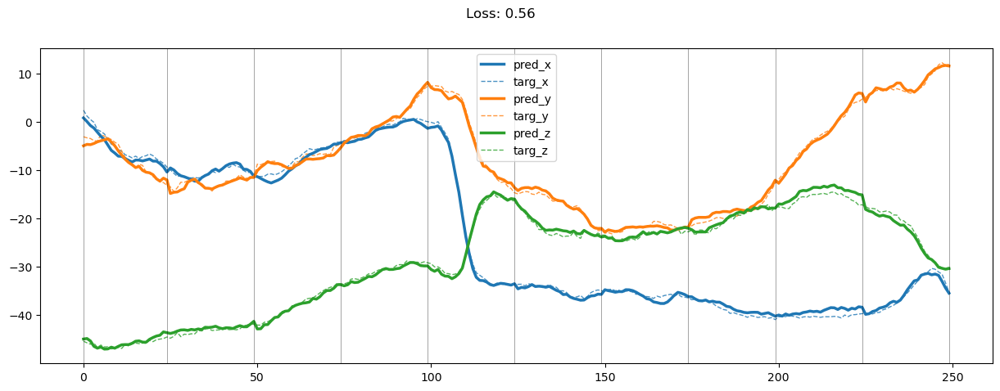

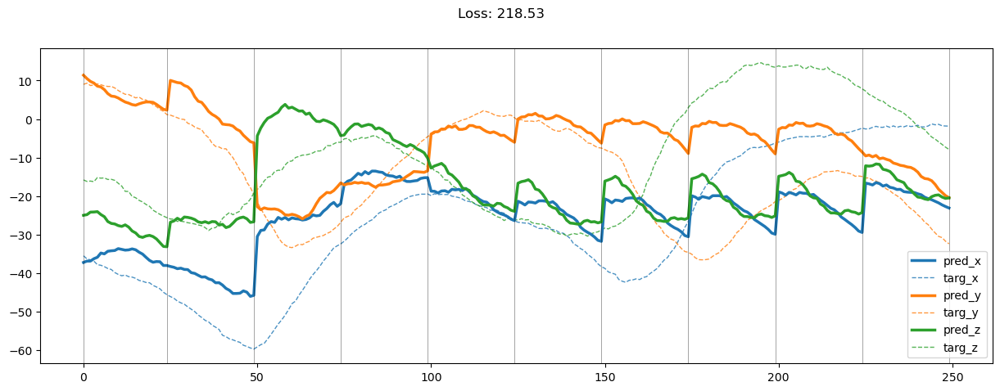

00099: train pred loss:  0.704, g loss:  2.477, diff loss:  1.376, d loss:  1.513
       valid pred loss:  164.358, g loss:  509.373, diff loss:  344.620, d loss:  1.518


100%|██████████| 17/17 [00:01<00:00, 13.86it/s]


00100: train pred loss:  0.722, g loss:  2.536, diff loss:  1.418, d loss:  1.514
       valid pred loss:  163.501, g loss:  506.443, diff loss:  342.549, d loss:  1.519


100%|██████████| 17/17 [00:01<00:00, 14.61it/s]


00101: train pred loss:  0.744, g loss:  2.567, diff loss:  1.428, d loss:  1.515
       valid pred loss:  163.638, g loss:  503.169, diff loss:  339.138, d loss:  1.519


100%|██████████| 17/17 [00:01<00:00, 15.09it/s]


00102: train pred loss:  0.742, g loss:  2.554, diff loss:  1.418, d loss:  1.515
       valid pred loss:  165.070, g loss:  511.306, diff loss:  345.843, d loss:  1.520


100%|██████████| 17/17 [00:01<00:00, 15.11it/s]


00103: train pred loss:  0.749, g loss:  2.609, diff loss:  1.466, d loss:  1.516
       valid pred loss:  162.769, g loss:  505.453, diff loss:  342.292, d loss:  1.520


100%|██████████| 17/17 [00:01<00:00, 14.46it/s]


00104: train pred loss:  0.756, g loss:  2.626, diff loss:  1.476, d loss:  1.516
       valid pred loss:  165.218, g loss:  505.426, diff loss:  339.817, d loss:  1.521


100%|██████████| 17/17 [00:01<00:00, 15.10it/s]


00105: train pred loss:  0.755, g loss:  2.636, diff loss:  1.486, d loss:  1.516
       valid pred loss:  164.922, g loss:  511.946, diff loss:  346.634, d loss:  1.521


100%|██████████| 17/17 [00:01<00:00, 14.77it/s]


00106: train pred loss:  0.791, g loss:  2.762, diff loss:  1.577, d loss:  1.517
       valid pred loss:  162.967, g loss:  504.581, diff loss:  341.222, d loss:  1.521


100%|██████████| 17/17 [00:01<00:00, 14.57it/s]


00107: train pred loss:  0.742, g loss:  2.609, diff loss:  1.473, d loss:  1.516
       valid pred loss:  163.854, g loss:  512.042, diff loss:  347.796, d loss:  1.521


100%|██████████| 17/17 [00:01<00:00, 14.66it/s]


00108: train pred loss:  0.763, g loss:  2.650, diff loss:  1.493, d loss:  1.516
       valid pred loss:  163.954, g loss:  493.461, diff loss:  329.115, d loss:  1.520


100%|██████████| 17/17 [00:01<00:00, 15.10it/s]


00109: train pred loss:  0.755, g loss:  2.622, diff loss:  1.474, d loss:  1.516
       valid pred loss:  165.473, g loss:  513.980, diff loss:  348.115, d loss:  1.520


100%|██████████| 17/17 [00:01<00:00, 15.03it/s]


00110: train pred loss:  0.721, g loss:  2.503, diff loss:  1.387, d loss:  1.516
       valid pred loss:  165.068, g loss:  510.438, diff loss:  344.979, d loss:  1.520


100%|██████████| 17/17 [00:01<00:00, 15.04it/s]


00111: train pred loss:  0.681, g loss:  2.419, diff loss:  1.343, d loss:  1.515
       valid pred loss:  163.272, g loss:  508.332, diff loss:  344.668, d loss:  1.520


100%|██████████| 17/17 [00:01<00:00, 15.07it/s]


00112: train pred loss:  0.696, g loss:  2.453, diff loss:  1.361, d loss:  1.515
       valid pred loss:  166.016, g loss:  514.481, diff loss:  348.072, d loss:  1.519


100%|██████████| 17/17 [00:01<00:00, 15.05it/s]


00113: train pred loss:  0.708, g loss:  2.471, diff loss:  1.366, d loss:  1.514
       valid pred loss:  164.869, g loss:  510.771, diff loss:  345.508, d loss:  1.518


100%|██████████| 17/17 [00:01<00:00, 15.04it/s]


00114: train pred loss:  0.700, g loss:  2.466, diff loss:  1.369, d loss:  1.513
       valid pred loss:  166.514, g loss:  519.177, diff loss:  352.268, d loss:  1.517


100%|██████████| 17/17 [00:01<00:00, 15.03it/s]


00115: train pred loss:  0.726, g loss:  2.570, diff loss:  1.445, d loss:  1.512
       valid pred loss:  164.672, g loss:  508.666, diff loss:  343.598, d loss:  1.517


100%|██████████| 17/17 [00:01<00:00, 15.06it/s]


00116: train pred loss:  0.715, g loss:  2.522, diff loss:  1.409, d loss:  1.511
       valid pred loss:  166.010, g loss:  519.599, diff loss:  353.192, d loss:  1.515


100%|██████████| 17/17 [00:01<00:00, 15.08it/s]


00117: train pred loss:  0.712, g loss:  2.515, diff loss:  1.403, d loss:  1.510
       valid pred loss:  165.500, g loss:  515.332, diff loss:  349.435, d loss:  1.514


100%|██████████| 17/17 [00:01<00:00, 15.06it/s]


00118: train pred loss:  0.724, g loss:  2.554, diff loss:  1.429, d loss:  1.509
       valid pred loss:  166.594, g loss:  510.884, diff loss:  343.892, d loss:  1.514


100%|██████████| 17/17 [00:01<00:00, 15.02it/s]


00119: train pred loss:  0.743, g loss:  2.609, diff loss:  1.465, d loss:  1.508
       valid pred loss:  164.037, g loss:  509.036, diff loss:  344.599, d loss:  1.512


100%|██████████| 17/17 [00:01<00:00, 14.90it/s]


00120: train pred loss:  0.728, g loss:  2.570, diff loss:  1.439, d loss:  1.507
       valid pred loss:  165.513, g loss:  507.672, diff loss:  341.759, d loss:  1.511


100%|██████████| 17/17 [00:01<00:00, 15.06it/s]


00121: train pred loss:  0.722, g loss:  2.513, diff loss:  1.387, d loss:  1.506
       valid pred loss:  163.277, g loss:  504.323, diff loss:  340.645, d loss:  1.510


100%|██████████| 17/17 [00:01<00:00, 14.79it/s]


00122: train pred loss:  0.706, g loss:  2.488, diff loss:  1.377, d loss:  1.505
       valid pred loss:  164.306, g loss:  505.043, diff loss:  340.334, d loss:  1.509


100%|██████████| 17/17 [00:01<00:00, 15.10it/s]


00123: train pred loss:  0.711, g loss:  2.518, diff loss:  1.401, d loss:  1.504
       valid pred loss:  164.595, g loss:  506.077, diff loss:  341.078, d loss:  1.507


100%|██████████| 17/17 [00:01<00:00, 15.14it/s]


00124: train pred loss:  0.751, g loss:  2.609, diff loss:  1.451, d loss:  1.503
       valid pred loss:  166.767, g loss:  519.216, diff loss:  352.044, d loss:  1.506


100%|██████████| 17/17 [00:01<00:00, 15.09it/s]


00125: train pred loss:  0.744, g loss:  2.607, diff loss:  1.455, d loss:  1.501
       valid pred loss:  165.789, g loss:  506.880, diff loss:  340.684, d loss:  1.506


100%|██████████| 17/17 [00:01<00:00, 14.83it/s]


00126: train pred loss:  0.776, g loss:  2.703, diff loss:  1.518, d loss:  1.500
       valid pred loss:  165.830, g loss:  506.862, diff loss:  340.624, d loss:  1.504


100%|██████████| 17/17 [00:01<00:00, 14.71it/s]


00127: train pred loss:  0.788, g loss:  2.736, diff loss:  1.538, d loss:  1.499
       valid pred loss:  165.452, g loss:  505.627, diff loss:  339.765, d loss:  1.503


100%|██████████| 17/17 [00:01<00:00, 15.21it/s]


00128: train pred loss:  0.801, g loss:  2.791, diff loss:  1.578, d loss:  1.498
       valid pred loss:  168.250, g loss:  513.669, diff loss:  345.009, d loss:  1.502


100%|██████████| 17/17 [00:01<00:00, 15.13it/s]


00129: train pred loss:  0.741, g loss:  2.606, diff loss:  1.452, d loss:  1.497
       valid pred loss:  164.663, g loss:  505.595, diff loss:  340.522, d loss:  1.501


100%|██████████| 17/17 [00:01<00:00, 15.02it/s]


00130: train pred loss:  0.718, g loss:  2.540, diff loss:  1.408, d loss:  1.497
       valid pred loss:  165.832, g loss:  507.616, diff loss:  341.372, d loss:  1.500


100%|██████████| 17/17 [00:01<00:00, 15.23it/s]


00131: train pred loss:  0.712, g loss:  2.529, diff loss:  1.403, d loss:  1.496
       valid pred loss:  164.435, g loss:  504.698, diff loss:  339.851, d loss:  1.499


100%|██████████| 17/17 [00:01<00:00, 15.12it/s]


00132: train pred loss:  0.708, g loss:  2.491, diff loss:  1.367, d loss:  1.495
       valid pred loss:  168.065, g loss:  511.877, diff loss:  343.400, d loss:  1.499


100%|██████████| 17/17 [00:01<00:00, 15.18it/s]


00133: train pred loss:  0.692, g loss:  2.470, diff loss:  1.362, d loss:  1.494
       valid pred loss:  166.249, g loss:  513.177, diff loss:  346.515, d loss:  1.498


100%|██████████| 17/17 [00:01<00:00, 15.15it/s]


00134: train pred loss:  0.665, g loss:  2.406, diff loss:  1.324, d loss:  1.494
       valid pred loss:  165.124, g loss:  507.632, diff loss:  342.094, d loss:  1.498


100%|██████████| 17/17 [00:01<00:00, 15.21it/s]


00135: train pred loss:  0.820, g loss:  2.782, diff loss:  1.545, d loss:  1.493
       valid pred loss:  163.248, g loss:  503.848, diff loss:  340.185, d loss:  1.497


100%|██████████| 17/17 [00:01<00:00, 15.22it/s]


00136: train pred loss:  0.938, g loss:  3.051, diff loss:  1.696, d loss:  1.493
       valid pred loss:  164.773, g loss:  506.529, diff loss:  341.341, d loss:  1.497


100%|██████████| 17/17 [00:01<00:00, 14.96it/s]


00137: train pred loss:  0.866, g loss:  2.990, diff loss:  1.707, d loss:  1.493
       valid pred loss:  164.820, g loss:  505.887, diff loss:  340.651, d loss:  1.496


100%|██████████| 17/17 [00:01<00:00, 14.23it/s]


00138: train pred loss:  0.901, g loss:  3.069, diff loss:  1.751, d loss:  1.492
       valid pred loss:  161.173, g loss:  498.047, diff loss:  336.458, d loss:  1.496


100%|██████████| 17/17 [00:01<00:00, 13.91it/s]


00139: train pred loss:  1.034, g loss:  3.458, diff loss:  2.007, d loss:  1.492
       valid pred loss:  167.857, g loss:  524.202, diff loss:  355.930, d loss:  1.497


100%|██████████| 17/17 [00:01<00:00, 15.15it/s]


00140: train pred loss:  0.988, g loss:  3.327, diff loss:  1.921, d loss:  1.492
       valid pred loss:  164.811, g loss:  516.083, diff loss:  350.857, d loss:  1.497


100%|██████████| 17/17 [00:01<00:00, 15.13it/s]


00141: train pred loss:  0.939, g loss:  3.181, diff loss:  1.824, d loss:  1.493
       valid pred loss:  165.632, g loss:  507.846, diff loss:  341.798, d loss:  1.496


100%|██████████| 17/17 [00:01<00:00, 15.15it/s]


00142: train pred loss:  0.896, g loss:  3.074, diff loss:  1.761, d loss:  1.493
       valid pred loss:  165.023, g loss:  502.814, diff loss:  337.377, d loss:  1.497


100%|██████████| 17/17 [00:01<00:00, 15.12it/s]


00143: train pred loss:  0.840, g loss:  2.890, diff loss:  1.633, d loss:  1.493
       valid pred loss:  165.743, g loss:  509.064, diff loss:  342.907, d loss:  1.497


100%|██████████| 17/17 [00:01<00:00, 14.85it/s]


00144: train pred loss:  0.796, g loss:  2.764, diff loss:  1.551, d loss:  1.494
       valid pred loss:  161.926, g loss:  498.300, diff loss:  335.959, d loss:  1.498


100%|██████████| 17/17 [00:01<00:00, 15.06it/s]


00145: train pred loss:  0.763, g loss:  2.673, diff loss:  1.495, d loss:  1.494
       valid pred loss:  159.901, g loss:  490.332, diff loss:  330.018, d loss:  1.498


100%|██████████| 17/17 [00:01<00:00, 15.15it/s]


00146: train pred loss:  0.730, g loss:  2.584, diff loss:  1.438, d loss:  1.494
       valid pred loss:  162.483, g loss:  499.277, diff loss:  336.382, d loss:  1.499


100%|██████████| 17/17 [00:01<00:00, 15.13it/s]


00147: train pred loss:  0.741, g loss:  2.633, diff loss:  1.477, d loss:  1.496
       valid pred loss:  170.131, g loss:  520.165, diff loss:  349.623, d loss:  1.500


100%|██████████| 17/17 [00:01<00:00, 14.04it/s]


00148: train pred loss:  0.718, g loss:  2.543, diff loss:  1.412, d loss:  1.496
       valid pred loss:  163.599, g loss:  506.409, diff loss:  342.399, d loss:  1.501


100%|██████████| 17/17 [00:01<00:00, 15.19it/s]


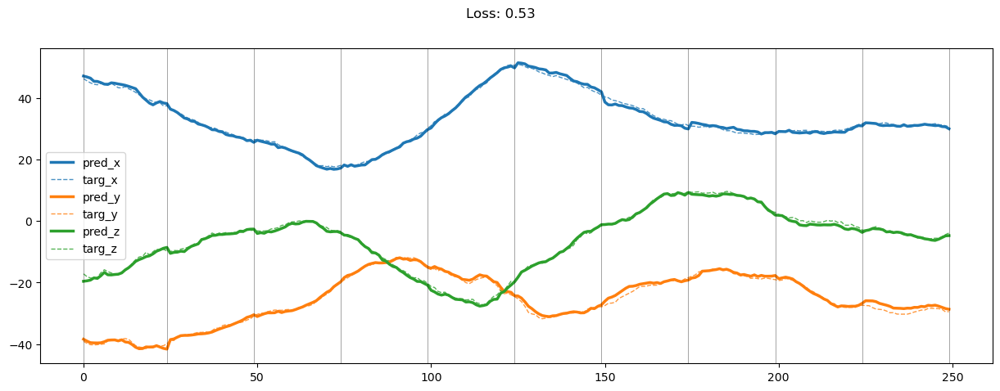

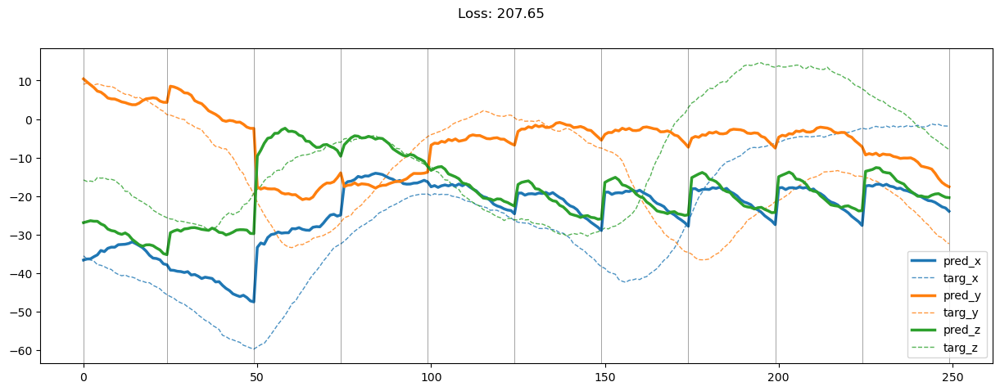

00149: train pred loss:  0.684, g loss:  2.438, diff loss:  1.341, d loss:  1.497
       valid pred loss:  163.464, g loss:  504.979, diff loss:  341.106, d loss:  1.502


100%|██████████| 17/17 [00:01<00:00, 15.13it/s]


00150: train pred loss:  0.685, g loss:  2.450, diff loss:  1.353, d loss:  1.498
       valid pred loss:  163.900, g loss:  504.175, diff loss:  339.866, d loss:  1.504


100%|██████████| 17/17 [00:01<00:00, 15.16it/s]


00151: train pred loss:  0.706, g loss:  2.503, diff loss:  1.386, d loss:  1.499
       valid pred loss:  163.154, g loss:  501.207, diff loss:  337.646, d loss:  1.505


100%|██████████| 17/17 [00:01<00:00, 15.18it/s]


00152: train pred loss:  0.697, g loss:  2.478, diff loss:  1.371, d loss:  1.500
       valid pred loss:  166.067, g loss:  508.593, diff loss:  342.121, d loss:  1.506


100%|██████████| 17/17 [00:01<00:00, 15.21it/s]


00153: train pred loss:  0.699, g loss:  2.491, diff loss:  1.384, d loss:  1.502
       valid pred loss:  161.401, g loss:  497.194, diff loss:  335.388, d loss:  1.506


100%|██████████| 17/17 [00:01<00:00, 15.18it/s]


00154: train pred loss:  0.707, g loss:  2.509, diff loss:  1.395, d loss:  1.503
       valid pred loss:  164.373, g loss:  501.009, diff loss:  336.231, d loss:  1.508


100%|██████████| 17/17 [00:01<00:00, 15.15it/s]


00155: train pred loss:  0.710, g loss:  2.530, diff loss:  1.415, d loss:  1.504
       valid pred loss:  163.337, g loss:  504.444, diff loss:  340.705, d loss:  1.509


100%|██████████| 17/17 [00:01<00:00, 15.18it/s]


00156: train pred loss:  0.701, g loss:  2.496, diff loss:  1.390, d loss:  1.505
       valid pred loss:  162.005, g loss:  501.462, diff loss:  339.056, d loss:  1.511


100%|██████████| 17/17 [00:01<00:00, 15.15it/s]


00157: train pred loss:  0.723, g loss:  2.567, diff loss:  1.439, d loss:  1.506
       valid pred loss:  163.343, g loss:  504.605, diff loss:  340.862, d loss:  1.511


100%|██████████| 17/17 [00:01<00:00, 15.19it/s]


00158: train pred loss:  0.707, g loss:  2.506, diff loss:  1.396, d loss:  1.507
       valid pred loss:  165.551, g loss:  511.091, diff loss:  345.141, d loss:  1.512


100%|██████████| 17/17 [00:01<00:00, 15.16it/s]


00159: train pred loss:  0.692, g loss:  2.451, diff loss:  1.357, d loss:  1.508
       valid pred loss:  165.445, g loss:  516.732, diff loss:  350.888, d loss:  1.513


100%|██████████| 17/17 [00:01<00:00, 15.16it/s]


00160: train pred loss:  0.694, g loss:  2.466, diff loss:  1.371, d loss:  1.509
       valid pred loss:  163.847, g loss:  508.303, diff loss:  344.058, d loss:  1.515


100%|██████████| 17/17 [00:01<00:00, 14.68it/s]


00161: train pred loss:  0.685, g loss:  2.436, diff loss:  1.351, d loss:  1.510
       valid pred loss:  165.976, g loss:  516.207, diff loss:  349.835, d loss:  1.515


100%|██████████| 17/17 [00:01<00:00, 15.18it/s]


00162: train pred loss:  0.685, g loss:  2.419, diff loss:  1.335, d loss:  1.511
       valid pred loss:  163.789, g loss:  507.557, diff loss:  343.372, d loss:  1.517


100%|██████████| 17/17 [00:01<00:00, 15.17it/s]


00163: train pred loss:  0.684, g loss:  2.412, diff loss:  1.330, d loss:  1.512
       valid pred loss:  162.843, g loss:  500.039, diff loss:  336.801, d loss:  1.517


100%|██████████| 17/17 [00:01<00:00, 15.19it/s]


00164: train pred loss:  0.690, g loss:  2.438, diff loss:  1.350, d loss:  1.513
       valid pred loss:  164.560, g loss:  508.377, diff loss:  343.423, d loss:  1.518


100%|██████████| 17/17 [00:01<00:00, 15.19it/s]


00165: train pred loss:  0.676, g loss:  2.401, diff loss:  1.328, d loss:  1.513
       valid pred loss:  165.294, g loss:  509.588, diff loss:  343.900, d loss:  1.519


100%|██████████| 17/17 [00:01<00:00, 15.11it/s]


00166: train pred loss:  0.684, g loss:  2.428, diff loss:  1.348, d loss:  1.514
       valid pred loss:  164.341, g loss:  506.219, diff loss:  341.485, d loss:  1.519


100%|██████████| 17/17 [00:01<00:00, 15.13it/s]


00167: train pred loss:  0.667, g loss:  2.365, diff loss:  1.302, d loss:  1.514
       valid pred loss:  160.290, g loss:  495.983, diff loss:  335.300, d loss:  1.520


100%|██████████| 17/17 [00:01<00:00, 14.89it/s]


00168: train pred loss:  0.659, g loss:  2.356, diff loss:  1.301, d loss:  1.515
       valid pred loss:  158.821, g loss:  493.973, diff loss:  334.760, d loss:  1.520


100%|██████████| 17/17 [00:01<00:00, 14.87it/s]


00169: train pred loss:  0.639, g loss:  2.310, diff loss:  1.276, d loss:  1.515
       valid pred loss:  167.334, g loss:  514.024, diff loss:  346.297, d loss:  1.520


100%|██████████| 17/17 [00:01<00:00, 15.08it/s]


00170: train pred loss:  0.653, g loss:  2.348, diff loss:  1.299, d loss:  1.515
       valid pred loss:  164.791, g loss:  508.949, diff loss:  343.766, d loss:  1.520


100%|██████████| 17/17 [00:01<00:00, 14.81it/s]


00171: train pred loss:  0.644, g loss:  2.301, diff loss:  1.262, d loss:  1.515
       valid pred loss:  166.037, g loss:  511.968, diff loss:  345.538, d loss:  1.520


100%|██████████| 17/17 [00:01<00:00, 15.27it/s]


00172: train pred loss:  0.653, g loss:  2.347, diff loss:  1.298, d loss:  1.514
       valid pred loss:  166.610, g loss:  510.428, diff loss:  343.425, d loss:  1.520


100%|██████████| 17/17 [00:01<00:00, 15.25it/s]


00173: train pred loss:  0.672, g loss:  2.382, diff loss:  1.315, d loss:  1.515
       valid pred loss:  166.637, g loss:  515.633, diff loss:  348.603, d loss:  1.520


100%|██████████| 17/17 [00:01<00:00, 15.25it/s]


00174: train pred loss:  0.678, g loss:  2.413, diff loss:  1.339, d loss:  1.514
       valid pred loss:  163.348, g loss:  503.054, diff loss:  339.312, d loss:  1.519


100%|██████████| 17/17 [00:01<00:00, 15.19it/s]


00175: train pred loss:  0.696, g loss:  2.445, diff loss:  1.352, d loss:  1.513
       valid pred loss:  165.521, g loss:  511.265, diff loss:  345.349, d loss:  1.519


100%|██████████| 17/17 [00:01<00:00, 15.20it/s]


00176: train pred loss:  0.681, g loss:  2.423, diff loss:  1.345, d loss:  1.513
       valid pred loss:  167.150, g loss:  518.944, diff loss:  351.399, d loss:  1.518


100%|██████████| 17/17 [00:01<00:00, 15.22it/s]


00177: train pred loss:  0.670, g loss:  2.389, diff loss:  1.321, d loss:  1.512
       valid pred loss:  165.466, g loss:  512.980, diff loss:  347.119, d loss:  1.517


100%|██████████| 17/17 [00:01<00:00, 15.24it/s]


00178: train pred loss:  0.668, g loss:  2.386, diff loss:  1.320, d loss:  1.512
       valid pred loss:  169.559, g loss:  524.050, diff loss:  354.095, d loss:  1.516


100%|██████████| 17/17 [00:01<00:00, 15.27it/s]


00179: train pred loss:  0.672, g loss:  2.397, diff loss:  1.326, d loss:  1.511
       valid pred loss:  166.017, g loss:  514.657, diff loss:  348.244, d loss:  1.515


100%|██████████| 17/17 [00:01<00:00, 15.08it/s]


00180: train pred loss:  0.691, g loss:  2.438, diff loss:  1.347, d loss:  1.510
       valid pred loss:  165.738, g loss:  507.523, diff loss:  341.387, d loss:  1.514


100%|██████████| 17/17 [00:01<00:00, 15.23it/s]


00181: train pred loss:  0.664, g loss:  2.368, diff loss:  1.303, d loss:  1.509
       valid pred loss:  168.524, g loss:  519.661, diff loss:  350.738, d loss:  1.513


100%|██████████| 17/17 [00:01<00:00, 15.22it/s]


00182: train pred loss:  0.656, g loss:  2.323, diff loss:  1.265, d loss:  1.507
       valid pred loss:  166.941, g loss:  520.693, diff loss:  353.352, d loss:  1.512


100%|██████████| 17/17 [00:01<00:00, 15.29it/s]


00183: train pred loss:  0.644, g loss:  2.342, diff loss:  1.295, d loss:  1.506
       valid pred loss:  167.598, g loss:  523.046, diff loss:  355.047, d loss:  1.511


100%|██████████| 17/17 [00:01<00:00, 15.26it/s]


00184: train pred loss:  0.643, g loss:  2.320, diff loss:  1.273, d loss:  1.506
       valid pred loss:  168.258, g loss:  517.827, diff loss:  349.167, d loss:  1.510


100%|██████████| 17/17 [00:01<00:00, 15.22it/s]


00185: train pred loss:  0.671, g loss:  2.395, diff loss:  1.319, d loss:  1.505
       valid pred loss:  169.009, g loss:  526.771, diff loss:  357.359, d loss:  1.509


100%|██████████| 17/17 [00:01<00:00, 15.24it/s]


00186: train pred loss:  0.716, g loss:  2.504, diff loss:  1.382, d loss:  1.503
       valid pred loss:  170.444, g loss:  526.882, diff loss:  356.033, d loss:  1.507


100%|██████████| 17/17 [00:01<00:00, 13.84it/s]


00187: train pred loss:  0.732, g loss:  2.560, diff loss:  1.420, d loss:  1.502
       valid pred loss:  168.250, g loss:  522.018, diff loss:  353.363, d loss:  1.506


100%|██████████| 17/17 [00:01<00:00, 15.27it/s]


00188: train pred loss:  0.711, g loss:  2.511, diff loss:  1.391, d loss:  1.501
       valid pred loss:  168.221, g loss:  525.806, diff loss:  357.178, d loss:  1.505


100%|██████████| 17/17 [00:01<00:00, 15.28it/s]


00189: train pred loss:  0.706, g loss:  2.469, diff loss:  1.353, d loss:  1.500
       valid pred loss:  164.785, g loss:  513.424, diff loss:  348.231, d loss:  1.504


100%|██████████| 17/17 [00:01<00:00, 14.53it/s]


00190: train pred loss:  0.678, g loss:  2.423, diff loss:  1.334, d loss:  1.499
       valid pred loss:  165.602, g loss:  516.549, diff loss:  350.538, d loss:  1.503


100%|██████████| 17/17 [00:01<00:00, 14.73it/s]


00191: train pred loss:  0.681, g loss:  2.454, diff loss:  1.361, d loss:  1.498
       valid pred loss:  162.027, g loss:  506.373, diff loss:  343.936, d loss:  1.502


100%|██████████| 17/17 [00:01<00:00, 15.28it/s]


00192: train pred loss:  0.684, g loss:  2.445, diff loss:  1.347, d loss:  1.497
       valid pred loss:  164.382, g loss:  510.370, diff loss:  345.577, d loss:  1.501


100%|██████████| 17/17 [00:01<00:00, 13.97it/s]


00193: train pred loss:  0.690, g loss:  2.469, diff loss:  1.365, d loss:  1.496
       valid pred loss:  164.241, g loss:  512.571, diff loss:  347.918, d loss:  1.500


100%|██████████| 17/17 [00:01<00:00, 14.35it/s]


00194: train pred loss:  0.723, g loss:  2.558, diff loss:  1.421, d loss:  1.496
       valid pred loss:  166.558, g loss:  512.580, diff loss:  345.609, d loss:  1.499


100%|██████████| 17/17 [00:01<00:00, 15.20it/s]


00195: train pred loss:  0.714, g loss:  2.520, diff loss:  1.391, d loss:  1.495
       valid pred loss:  162.387, g loss:  498.370, diff loss:  335.570, d loss:  1.499


100%|██████████| 17/17 [00:01<00:00, 15.18it/s]


00196: train pred loss:  0.700, g loss:  2.471, diff loss:  1.356, d loss:  1.494
       valid pred loss:  165.168, g loss:  503.526, diff loss:  337.945, d loss:  1.498


100%|██████████| 17/17 [00:01<00:00, 14.70it/s]


00197: train pred loss:  0.693, g loss:  2.465, diff loss:  1.355, d loss:  1.494
       valid pred loss:  165.431, g loss:  507.555, diff loss:  341.710, d loss:  1.498


100%|██████████| 17/17 [00:01<00:00, 14.58it/s]


00198: train pred loss:  0.671, g loss:  2.396, diff loss:  1.308, d loss:  1.493
       valid pred loss:  162.815, g loss:  498.092, diff loss:  334.863, d loss:  1.498


100%|██████████| 17/17 [00:01<00:00, 14.67it/s]


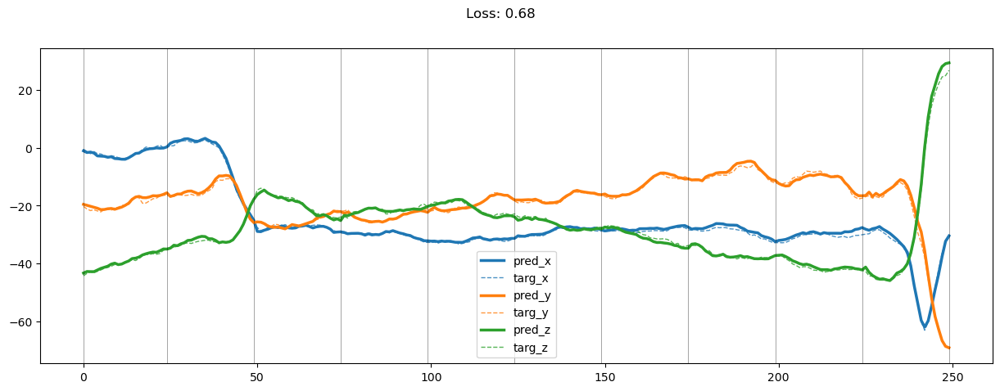

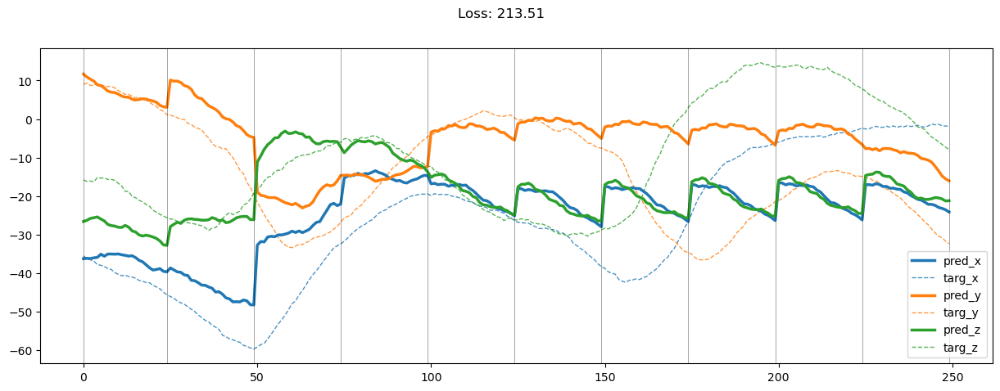

00199: train pred loss:  0.654, g loss:  2.366, diff loss:  1.296, d loss:  1.493
       valid pred loss:  164.825, g loss:  509.532, diff loss:  344.293, d loss:  1.498


100%|██████████| 17/17 [00:01<00:00, 14.83it/s]


00200: train pred loss:  0.663, g loss:  2.393, diff loss:  1.314, d loss:  1.493
       valid pred loss:  162.993, g loss:  503.612, diff loss:  340.205, d loss:  1.497


100%|██████████| 17/17 [00:01<00:00, 15.22it/s]


00201: train pred loss:  0.664, g loss:  2.381, diff loss:  1.300, d loss:  1.493
       valid pred loss:  163.802, g loss:  506.166, diff loss:  341.950, d loss:  1.498


100%|██████████| 17/17 [00:01<00:00, 15.03it/s]


00202: train pred loss:  0.683, g loss:  2.437, diff loss:  1.337, d loss:  1.493
       valid pred loss:  163.817, g loss:  506.614, diff loss:  342.384, d loss:  1.498


100%|██████████| 17/17 [00:01<00:00, 15.22it/s]


00203: train pred loss:  0.666, g loss:  2.396, diff loss:  1.313, d loss:  1.493
       valid pred loss:  161.977, g loss:  497.576, diff loss:  335.185, d loss:  1.498


100%|██████████| 17/17 [00:01<00:00, 14.99it/s]


00204: train pred loss:  0.651, g loss:  2.365, diff loss:  1.299, d loss:  1.494
       valid pred loss:  162.640, g loss:  500.957, diff loss:  337.904, d loss:  1.499


100%|██████████| 17/17 [00:01<00:00, 15.21it/s]


00205: train pred loss:  0.679, g loss:  2.401, diff loss:  1.307, d loss:  1.494
       valid pred loss:  163.669, g loss:  503.767, diff loss:  339.685, d loss:  1.500


100%|██████████| 17/17 [00:01<00:00, 15.21it/s]


00206: train pred loss:  0.696, g loss:  2.444, diff loss:  1.333, d loss:  1.495
       valid pred loss:  162.685, g loss:  504.747, diff loss:  341.650, d loss:  1.500


100%|██████████| 17/17 [00:01<00:00, 15.20it/s]


00207: train pred loss:  0.670, g loss:  2.376, diff loss:  1.291, d loss:  1.496
       valid pred loss:  162.833, g loss:  498.848, diff loss:  335.603, d loss:  1.500


100%|██████████| 17/17 [00:01<00:00, 14.97it/s]


00208: train pred loss:  0.680, g loss:  2.398, diff loss:  1.305, d loss:  1.496
       valid pred loss:  162.627, g loss:  497.509, diff loss:  334.472, d loss:  1.501


100%|██████████| 17/17 [00:01<00:00, 15.19it/s]


00209: train pred loss:  0.680, g loss:  2.441, diff loss:  1.349, d loss:  1.498
       valid pred loss:  164.186, g loss:  502.402, diff loss:  337.807, d loss:  1.502


100%|██████████| 17/17 [00:01<00:00, 15.17it/s]


00210: train pred loss:  0.693, g loss:  2.490, diff loss:  1.385, d loss:  1.498
       valid pred loss:  160.883, g loss:  498.625, diff loss:  337.334, d loss:  1.504


100%|██████████| 17/17 [00:01<00:00, 15.20it/s]


00211: train pred loss:  0.695, g loss:  2.487, diff loss:  1.382, d loss:  1.499
       valid pred loss:  163.576, g loss:  505.917, diff loss:  341.933, d loss:  1.505


100%|██████████| 17/17 [00:01<00:00, 15.23it/s]


00212: train pred loss:  0.734, g loss:  2.596, diff loss:  1.453, d loss:  1.501
       valid pred loss:  166.085, g loss:  512.956, diff loss:  346.465, d loss:  1.506


100%|██████████| 17/17 [00:01<00:00, 15.21it/s]


00213: train pred loss:  0.708, g loss:  2.505, diff loss:  1.389, d loss:  1.501
       valid pred loss:  164.423, g loss:  509.652, diff loss:  344.824, d loss:  1.507


100%|██████████| 17/17 [00:01<00:00, 15.25it/s]


00214: train pred loss:  0.720, g loss:  2.535, diff loss:  1.408, d loss:  1.503
       valid pred loss:  164.011, g loss:  505.272, diff loss:  340.857, d loss:  1.509


100%|██████████| 17/17 [00:01<00:00, 14.68it/s]


00215: train pred loss:  0.663, g loss:  2.383, diff loss:  1.314, d loss:  1.503
       valid pred loss:  163.144, g loss:  506.072, diff loss:  342.526, d loss:  1.509


100%|██████████| 17/17 [00:01<00:00, 14.86it/s]


00216: train pred loss:  0.678, g loss:  2.436, diff loss:  1.353, d loss:  1.505
       valid pred loss:  164.395, g loss:  504.321, diff loss:  339.524, d loss:  1.510


100%|██████████| 17/17 [00:01<00:00, 15.14it/s]


00217: train pred loss:  0.697, g loss:  2.468, diff loss:  1.367, d loss:  1.506
       valid pred loss:  163.346, g loss:  503.523, diff loss:  339.777, d loss:  1.512


100%|██████████| 17/17 [00:01<00:00, 15.17it/s]


00218: train pred loss:  0.704, g loss:  2.493, diff loss:  1.386, d loss:  1.507
       valid pred loss:  164.714, g loss:  504.680, diff loss:  339.566, d loss:  1.513


100%|██████████| 17/17 [00:01<00:00, 15.19it/s]


00219: train pred loss:  0.691, g loss:  2.446, diff loss:  1.354, d loss:  1.508
       valid pred loss:  163.395, g loss:  502.828, diff loss:  339.034, d loss:  1.514


100%|██████████| 17/17 [00:01<00:00, 15.21it/s]


00220: train pred loss:  0.670, g loss:  2.379, diff loss:  1.308, d loss:  1.509
       valid pred loss:  164.407, g loss:  511.101, diff loss:  346.297, d loss:  1.515


100%|██████████| 17/17 [00:01<00:00, 14.45it/s]


00221: train pred loss:  0.645, g loss:  2.310, diff loss:  1.266, d loss:  1.510
       valid pred loss:  165.038, g loss:  508.655, diff loss:  343.220, d loss:  1.516


100%|██████████| 17/17 [00:01<00:00, 14.48it/s]


00222: train pred loss:  0.656, g loss:  2.361, diff loss:  1.306, d loss:  1.511
       valid pred loss:  165.981, g loss:  510.611, diff loss:  344.234, d loss:  1.516


100%|██████████| 17/17 [00:01<00:00, 15.19it/s]


00223: train pred loss:  0.670, g loss:  2.373, diff loss:  1.305, d loss:  1.511
       valid pred loss:  169.598, g loss:  520.720, diff loss:  350.727, d loss:  1.517


100%|██████████| 17/17 [00:01<00:00, 15.13it/s]


00224: train pred loss:  0.667, g loss:  2.389, diff loss:  1.324, d loss:  1.513
       valid pred loss:  166.984, g loss:  516.149, diff loss:  348.771, d loss:  1.518


100%|██████████| 17/17 [00:01<00:00, 15.18it/s]


00225: train pred loss:  0.699, g loss:  2.434, diff loss:  1.338, d loss:  1.513
       valid pred loss:  165.826, g loss:  512.494, diff loss:  346.274, d loss:  1.519


100%|██████████| 17/17 [00:01<00:00, 15.14it/s]


00226: train pred loss:  0.681, g loss:  2.425, diff loss:  1.348, d loss:  1.514
       valid pred loss:  166.607, g loss:  517.985, diff loss:  350.984, d loss:  1.519


100%|██████████| 17/17 [00:01<00:00, 15.12it/s]


00227: train pred loss:  0.674, g loss:  2.407, diff loss:  1.336, d loss:  1.514
       valid pred loss:  166.422, g loss:  511.678, diff loss:  344.863, d loss:  1.519


100%|██████████| 17/17 [00:01<00:00, 14.79it/s]


00228: train pred loss:  0.632, g loss:  2.282, diff loss:  1.254, d loss:  1.514
       valid pred loss:  165.060, g loss:  507.818, diff loss:  342.366, d loss:  1.520


100%|██████████| 17/17 [00:01<00:00, 14.73it/s]


00229: train pred loss:  0.642, g loss:  2.295, diff loss:  1.257, d loss:  1.514
       valid pred loss:  165.892, g loss:  516.354, diff loss:  350.069, d loss:  1.519


100%|██████████| 17/17 [00:01<00:00, 15.12it/s]


00230: train pred loss:  0.624, g loss:  2.245, diff loss:  1.225, d loss:  1.514
       valid pred loss:  164.731, g loss:  509.374, diff loss:  344.250, d loss:  1.519


100%|██████████| 17/17 [00:01<00:00, 15.06it/s]


00231: train pred loss:  0.620, g loss:  2.226, diff loss:  1.210, d loss:  1.514
       valid pred loss:  166.372, g loss:  512.496, diff loss:  345.730, d loss:  1.519


100%|██████████| 17/17 [00:01<00:00, 15.08it/s]


00232: train pred loss:  0.640, g loss:  2.282, diff loss:  1.244, d loss:  1.513
       valid pred loss:  167.415, g loss:  515.114, diff loss:  347.305, d loss:  1.519


100%|██████████| 17/17 [00:01<00:00, 14.86it/s]


00233: train pred loss:  0.622, g loss:  2.234, diff loss:  1.216, d loss:  1.513
       valid pred loss:  167.235, g loss:  518.025, diff loss:  350.396, d loss:  1.518


100%|██████████| 17/17 [00:01<00:00, 15.00it/s]


00234: train pred loss:  0.642, g loss:  2.309, diff loss:  1.269, d loss:  1.512
       valid pred loss:  167.282, g loss:  518.499, diff loss:  350.822, d loss:  1.517


100%|██████████| 17/17 [00:01<00:00, 15.09it/s]


00235: train pred loss:  0.655, g loss:  2.355, diff loss:  1.302, d loss:  1.512
       valid pred loss:  167.810, g loss:  519.274, diff loss:  351.068, d loss:  1.517


100%|██████████| 17/17 [00:01<00:00, 15.12it/s]


00236: train pred loss:  0.674, g loss:  2.383, diff loss:  1.310, d loss:  1.511
       valid pred loss:  167.825, g loss:  522.919, diff loss:  354.698, d loss:  1.516


100%|██████████| 17/17 [00:01<00:00, 15.03it/s]


00237: train pred loss:  0.699, g loss:  2.456, diff loss:  1.357, d loss:  1.511
       valid pred loss:  163.993, g loss:  509.620, diff loss:  345.230, d loss:  1.515


100%|██████████| 17/17 [00:01<00:00, 15.14it/s]


00238: train pred loss:  0.687, g loss:  2.428, diff loss:  1.340, d loss:  1.509
       valid pred loss:  165.347, g loss:  511.666, diff loss:  345.920, d loss:  1.514


100%|██████████| 17/17 [00:01<00:00, 14.53it/s]


00239: train pred loss:  0.667, g loss:  2.382, diff loss:  1.314, d loss:  1.509
       valid pred loss:  166.609, g loss:  518.879, diff loss:  351.870, d loss:  1.513


100%|██████████| 17/17 [00:01<00:00, 14.62it/s]


00240: train pred loss:  0.673, g loss:  2.383, diff loss:  1.308, d loss:  1.508
       valid pred loss:  168.187, g loss:  521.552, diff loss:  352.965, d loss:  1.512


100%|██████████| 17/17 [00:01<00:00, 14.65it/s]


00241: train pred loss:  0.654, g loss:  2.345, diff loss:  1.287, d loss:  1.506
       valid pred loss:  168.440, g loss:  527.032, diff loss:  358.191, d loss:  1.511


100%|██████████| 17/17 [00:01<00:00, 14.99it/s]


00242: train pred loss:  0.677, g loss:  2.410, diff loss:  1.329, d loss:  1.505
       valid pred loss:  166.310, g loss:  518.313, diff loss:  351.600, d loss:  1.509


100%|██████████| 17/17 [00:01<00:00, 14.14it/s]


00243: train pred loss:  0.647, g loss:  2.352, diff loss:  1.299, d loss:  1.504
       valid pred loss:  166.554, g loss:  516.829, diff loss:  349.871, d loss:  1.508


100%|██████████| 17/17 [00:01<00:00, 15.09it/s]


00244: train pred loss:  0.650, g loss:  2.352, diff loss:  1.295, d loss:  1.503
       valid pred loss:  166.688, g loss:  512.176, diff loss:  345.084, d loss:  1.507


100%|██████████| 17/17 [00:01<00:00, 15.17it/s]


00245: train pred loss:  0.655, g loss:  2.331, diff loss:  1.268, d loss:  1.502
       valid pred loss:  168.306, g loss:  522.438, diff loss:  353.726, d loss:  1.506


100%|██████████| 17/17 [00:01<00:00, 15.05it/s]


00246: train pred loss:  0.641, g loss:  2.311, diff loss:  1.261, d loss:  1.501
       valid pred loss:  168.952, g loss:  528.015, diff loss:  358.656, d loss:  1.505


100%|██████████| 17/17 [00:01<00:00, 15.03it/s]


00247: train pred loss:  0.695, g loss:  2.459, diff loss:  1.354, d loss:  1.500
       valid pred loss:  169.729, g loss:  530.318, diff loss:  360.181, d loss:  1.504


100%|██████████| 17/17 [00:01<00:00, 15.04it/s]


00248: train pred loss:  0.695, g loss:  2.492, diff loss:  1.385, d loss:  1.498
       valid pred loss:  170.444, g loss:  526.749, diff loss:  355.897, d loss:  1.503


100%|██████████| 17/17 [00:01<00:00, 15.12it/s]


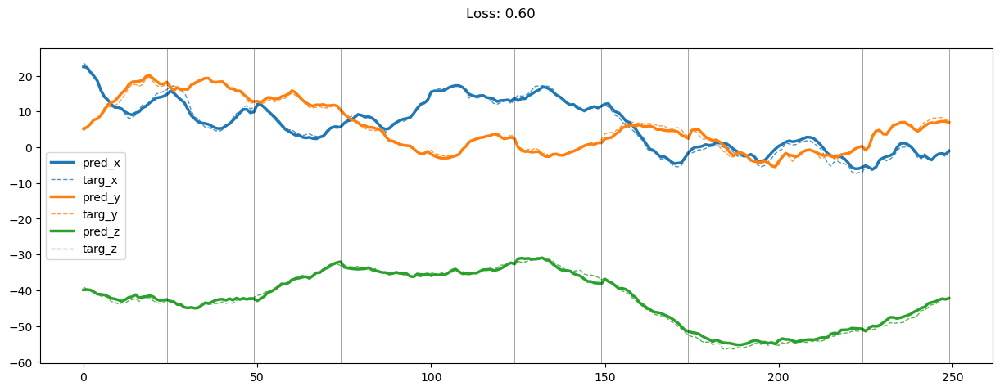

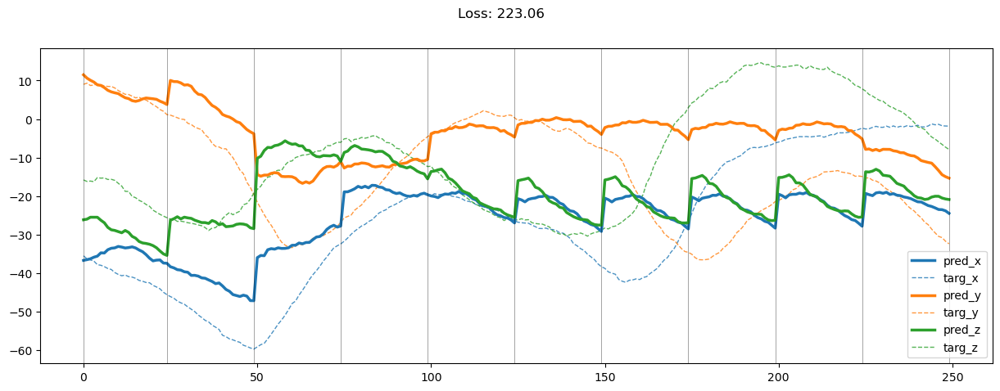

00249: train pred loss:  0.766, g loss:  2.697, diff loss:  1.519, d loss:  1.497
       valid pred loss:  173.696, g loss:  538.136, diff loss:  364.031, d loss:  1.502


100%|██████████| 17/17 [00:01<00:00, 15.14it/s]


00250: train pred loss:  0.797, g loss:  2.780, diff loss:  1.570, d loss:  1.496
       valid pred loss:  168.299, g loss:  517.897, diff loss:  349.186, d loss:  1.501


100%|██████████| 17/17 [00:01<00:00, 15.10it/s]


00251: train pred loss:  0.746, g loss:  2.625, diff loss:  1.465, d loss:  1.496
       valid pred loss:  167.758, g loss:  514.107, diff loss:  345.938, d loss:  1.500


100%|██████████| 17/17 [00:01<00:00, 15.05it/s]


00252: train pred loss:  0.924, g loss:  3.168, diff loss:  1.830, d loss:  1.495
       valid pred loss:  174.458, g loss:  534.658, diff loss:  359.788, d loss:  1.500


100%|██████████| 17/17 [00:01<00:00, 15.13it/s]


00253: train pred loss:  0.914, g loss:  3.107, diff loss:  1.778, d loss:  1.495
       valid pred loss:  172.944, g loss:  530.576, diff loss:  357.220, d loss:  1.499


100%|██████████| 17/17 [00:01<00:00, 15.12it/s]


00254: train pred loss:  0.923, g loss:  3.133, diff loss:  1.794, d loss:  1.494
       valid pred loss:  170.274, g loss:  524.376, diff loss:  353.688, d loss:  1.499


100%|██████████| 17/17 [00:01<00:00, 15.11it/s]


00255: train pred loss:  0.957, g loss:  3.232, diff loss:  1.859, d loss:  1.494
       valid pred loss:  173.337, g loss:  532.443, diff loss:  358.692, d loss:  1.498


100%|██████████| 17/17 [00:01<00:00, 15.19it/s]


00256: train pred loss:  0.894, g loss:  3.035, diff loss:  1.725, d loss:  1.494
       valid pred loss:  170.296, g loss:  521.360, diff loss:  350.651, d loss:  1.498


100%|██████████| 17/17 [00:01<00:00, 15.02it/s]


00257: train pred loss:  0.821, g loss:  2.824, diff loss:  1.587, d loss:  1.494
       valid pred loss:  169.785, g loss:  520.086, diff loss:  349.888, d loss:  1.498


100%|██████████| 17/17 [00:01<00:00, 15.07it/s]


00258: train pred loss:  0.753, g loss:  2.658, diff loss:  1.489, d loss:  1.494
       valid pred loss:  168.700, g loss:  513.772, diff loss:  344.659, d loss:  1.499


100%|██████████| 17/17 [00:01<00:00, 15.06it/s]


00259: train pred loss:  0.764, g loss:  2.658, diff loss:  1.478, d loss:  1.494
       valid pred loss:  167.726, g loss:  518.651, diff loss:  350.513, d loss:  1.499


100%|██████████| 17/17 [00:01<00:00, 14.10it/s]


00260: train pred loss:  0.732, g loss:  2.602, diff loss:  1.454, d loss:  1.494
       valid pred loss:  170.155, g loss:  521.371, diff loss:  350.803, d loss:  1.499


100%|██████████| 17/17 [00:01<00:00, 14.59it/s]


00261: train pred loss:  0.743, g loss:  2.612, diff loss:  1.454, d loss:  1.495
       valid pred loss:  167.146, g loss:  515.366, diff loss:  347.807, d loss:  1.499


100%|██████████| 17/17 [00:01<00:00, 13.98it/s]


00262: train pred loss:  0.714, g loss:  2.517, diff loss:  1.388, d loss:  1.495
       valid pred loss:  171.590, g loss:  527.170, diff loss:  355.168, d loss:  1.500


100%|██████████| 17/17 [00:01<00:00, 15.08it/s]


00263: train pred loss:  0.718, g loss:  2.532, diff loss:  1.399, d loss:  1.496
       valid pred loss:  166.142, g loss:  512.874, diff loss:  346.321, d loss:  1.501


100%|██████████| 17/17 [00:01<00:00, 15.06it/s]


00264: train pred loss:  0.699, g loss:  2.488, diff loss:  1.376, d loss:  1.497
       valid pred loss:  166.422, g loss:  509.294, diff loss:  342.462, d loss:  1.502


100%|██████████| 17/17 [00:01<00:00, 15.10it/s]


00265: train pred loss:  0.685, g loss:  2.435, diff loss:  1.338, d loss:  1.498
       valid pred loss:  165.858, g loss:  507.586, diff loss:  341.319, d loss:  1.503


100%|██████████| 17/17 [00:01<00:00, 15.18it/s]


00266: train pred loss:  0.666, g loss:  2.389, diff loss:  1.312, d loss:  1.498
       valid pred loss:  168.486, g loss:  519.287, diff loss:  350.393, d loss:  1.503


100%|██████████| 17/17 [00:01<00:00, 14.75it/s]


00267: train pred loss:  0.662, g loss:  2.351, diff loss:  1.279, d loss:  1.500
       valid pred loss:  166.743, g loss:  516.659, diff loss:  349.509, d loss:  1.505


100%|██████████| 17/17 [00:01<00:00, 14.64it/s]


00268: train pred loss:  0.660, g loss:  2.365, diff loss:  1.296, d loss:  1.501
       valid pred loss:  167.842, g loss:  516.418, diff loss:  348.170, d loss:  1.506


100%|██████████| 17/17 [00:01<00:00, 14.51it/s]


00269: train pred loss:  0.641, g loss:  2.313, diff loss:  1.264, d loss:  1.502
       valid pred loss:  167.462, g loss:  512.955, diff loss:  345.088, d loss:  1.507


100%|██████████| 17/17 [00:01<00:00, 14.75it/s]


00270: train pred loss:  0.652, g loss:  2.333, diff loss:  1.274, d loss:  1.503
       valid pred loss:  167.593, g loss:  514.948, diff loss:  346.952, d loss:  1.508


100%|██████████| 17/17 [00:01<00:00, 13.59it/s]


00271: train pred loss:  0.632, g loss:  2.284, diff loss:  1.246, d loss:  1.504
       valid pred loss:  166.909, g loss:  516.247, diff loss:  348.935, d loss:  1.509


100%|██████████| 17/17 [00:01<00:00, 15.21it/s]


00272: train pred loss:  0.649, g loss:  2.318, diff loss:  1.264, d loss:  1.505
       valid pred loss:  167.120, g loss:  514.905, diff loss:  347.383, d loss:  1.511


100%|██████████| 17/17 [00:01<00:00, 14.29it/s]


00273: train pred loss:  0.657, g loss:  2.347, diff loss:  1.286, d loss:  1.506
       valid pred loss:  169.624, g loss:  520.650, diff loss:  350.626, d loss:  1.511


100%|██████████| 17/17 [00:01<00:00, 14.77it/s]


00274: train pred loss:  0.658, g loss:  2.330, diff loss:  1.270, d loss:  1.507
       valid pred loss:  167.784, g loss:  518.249, diff loss:  350.066, d loss:  1.513


100%|██████████| 17/17 [00:01<00:00, 15.15it/s]


00275: train pred loss:  0.643, g loss:  2.298, diff loss:  1.253, d loss:  1.509
       valid pred loss:  172.775, g loss:  529.112, diff loss:  355.939, d loss:  1.514


100%|██████████| 17/17 [00:01<00:00, 14.56it/s]


00276: train pred loss:  0.639, g loss:  2.312, diff loss:  1.273, d loss:  1.510
       valid pred loss:  169.302, g loss:  523.009, diff loss:  353.310, d loss:  1.514


100%|██████████| 17/17 [00:01<00:00, 15.03it/s]


00277: train pred loss:  0.624, g loss:  2.249, diff loss:  1.225, d loss:  1.510
       valid pred loss:  168.608, g loss:  519.039, diff loss:  350.033, d loss:  1.515


100%|██████████| 17/17 [00:01<00:00, 15.15it/s]


00278: train pred loss:  0.615, g loss:  2.230, diff loss:  1.216, d loss:  1.511
       valid pred loss:  170.404, g loss:  525.416, diff loss:  354.616, d loss:  1.516


100%|██████████| 17/17 [00:01<00:00, 15.18it/s]


00279: train pred loss:  0.609, g loss:  2.222, diff loss:  1.215, d loss:  1.512
       valid pred loss:  168.450, g loss:  516.314, diff loss:  347.469, d loss:  1.517


100%|██████████| 17/17 [00:01<00:00, 15.14it/s]


00280: train pred loss:  0.619, g loss:  2.226, diff loss:  1.209, d loss:  1.512
       valid pred loss:  170.868, g loss:  523.109, diff loss:  351.846, d loss:  1.517


100%|██████████| 17/17 [00:01<00:00, 15.22it/s]


00281: train pred loss:  0.658, g loss:  2.343, diff loss:  1.288, d loss:  1.513
       valid pred loss:  170.112, g loss:  521.860, diff loss:  351.354, d loss:  1.518


100%|██████████| 17/17 [00:01<00:00, 15.23it/s]


00282: train pred loss:  0.684, g loss:  2.402, diff loss:  1.321, d loss:  1.513
       valid pred loss:  170.690, g loss:  521.931, diff loss:  350.848, d loss:  1.518


100%|██████████| 17/17 [00:01<00:00, 15.21it/s]


00283: train pred loss:  0.654, g loss:  2.334, diff loss:  1.284, d loss:  1.513
       valid pred loss:  167.046, g loss:  515.256, diff loss:  347.816, d loss:  1.518


100%|██████████| 17/17 [00:01<00:00, 15.22it/s]


00284: train pred loss:  0.624, g loss:  2.259, diff loss:  1.238, d loss:  1.514
       valid pred loss:  167.196, g loss:  515.649, diff loss:  348.058, d loss:  1.518


100%|██████████| 17/17 [00:01<00:00, 15.18it/s]


00285: train pred loss:  0.631, g loss:  2.267, diff loss:  1.240, d loss:  1.514
       valid pred loss:  168.499, g loss:  518.308, diff loss:  349.415, d loss:  1.518


100%|██████████| 17/17 [00:01<00:00, 14.91it/s]


00286: train pred loss:  0.626, g loss:  2.276, diff loss:  1.254, d loss:  1.513
       valid pred loss:  168.444, g loss:  518.280, diff loss:  349.442, d loss:  1.518


100%|██████████| 17/17 [00:01<00:00, 14.75it/s]


00287: train pred loss:  0.683, g loss:  2.438, diff loss:  1.358, d loss:  1.513
       valid pred loss:  167.900, g loss:  521.661, diff loss:  353.366, d loss:  1.518


100%|██████████| 17/17 [00:01<00:00, 15.23it/s]


00288: train pred loss:  0.768, g loss:  2.649, diff loss:  1.484, d loss:  1.512
       valid pred loss:  171.738, g loss:  532.967, diff loss:  360.834, d loss:  1.517


100%|██████████| 17/17 [00:01<00:00, 15.26it/s]


00289: train pred loss:  0.711, g loss:  2.499, diff loss:  1.390, d loss:  1.511
       valid pred loss:  168.851, g loss:  524.997, diff loss:  355.750, d loss:  1.516


100%|██████████| 17/17 [00:01<00:00, 15.24it/s]


00290: train pred loss:  0.709, g loss:  2.500, diff loss:  1.392, d loss:  1.511
       valid pred loss:  170.888, g loss:  528.763, diff loss:  357.478, d loss:  1.516


100%|██████████| 17/17 [00:01<00:00, 15.25it/s]


00291: train pred loss:  0.697, g loss:  2.449, diff loss:  1.353, d loss:  1.510
       valid pred loss:  169.211, g loss:  520.276, diff loss:  350.667, d loss:  1.515


100%|██████████| 17/17 [00:01<00:00, 15.26it/s]


00292: train pred loss:  0.668, g loss:  2.359, diff loss:  1.291, d loss:  1.509
       valid pred loss:  171.694, g loss:  533.061, diff loss:  360.968, d loss:  1.513


100%|██████████| 17/17 [00:01<00:00, 15.27it/s]


00293: train pred loss:  0.665, g loss:  2.372, diff loss:  1.306, d loss:  1.508
       valid pred loss:  170.720, g loss:  528.660, diff loss:  357.540, d loss:  1.512


100%|██████████| 17/17 [00:01<00:00, 15.26it/s]


00294: train pred loss:  0.658, g loss:  2.341, diff loss:  1.280, d loss:  1.508
       valid pred loss:  171.293, g loss:  534.280, diff loss:  362.586, d loss:  1.511


100%|██████████| 17/17 [00:01<00:00, 14.82it/s]


00295: train pred loss:  0.659, g loss:  2.363, diff loss:  1.301, d loss:  1.506
       valid pred loss:  171.539, g loss:  530.540, diff loss:  358.600, d loss:  1.510


100%|██████████| 17/17 [00:01<00:00, 15.18it/s]


00296: train pred loss:  0.661, g loss:  2.376, diff loss:  1.310, d loss:  1.505
       valid pred loss:  174.785, g loss:  540.784, diff loss:  365.595, d loss:  1.509


100%|██████████| 17/17 [00:01<00:00, 15.22it/s]


00297: train pred loss:  0.655, g loss:  2.351, diff loss:  1.291, d loss:  1.504
       valid pred loss:  174.727, g loss:  542.582, diff loss:  367.451, d loss:  1.508


100%|██████████| 17/17 [00:01<00:00, 15.10it/s]


00298: train pred loss:  0.631, g loss:  2.282, diff loss:  1.245, d loss:  1.503
       valid pred loss:  171.743, g loss:  533.999, diff loss:  361.851, d loss:  1.506


100%|██████████| 17/17 [00:01<00:00, 15.19it/s]


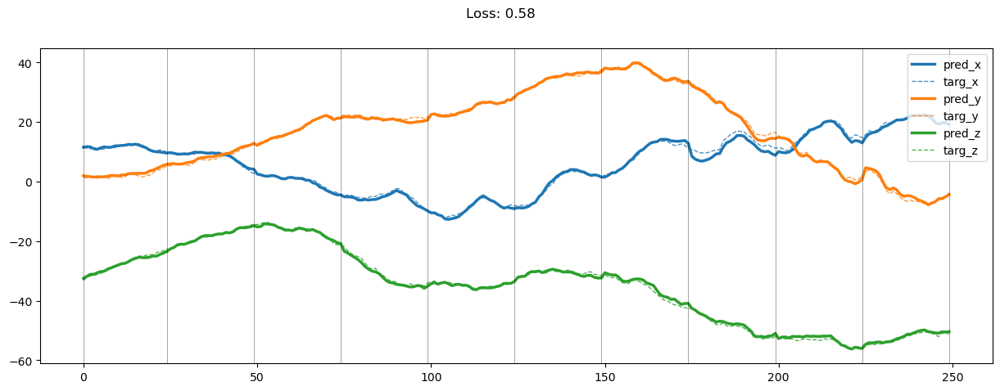

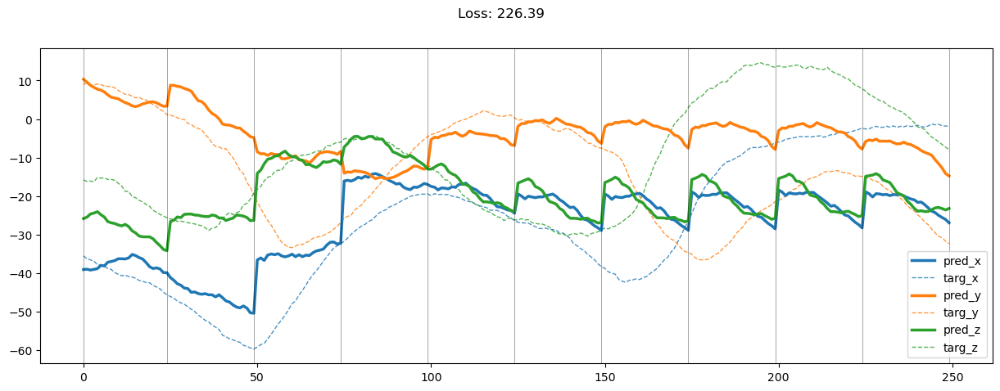

00299: train pred loss:  0.618, g loss:  2.235, diff loss:  1.210, d loss:  1.502
       valid pred loss:  170.040, g loss:  528.754, diff loss:  358.307, d loss:  1.505


100%|██████████| 17/17 [00:01<00:00, 15.06it/s]


00300: train pred loss:  0.641, g loss:  2.314, diff loss:  1.264, d loss:  1.501
       valid pred loss:  170.320, g loss:  528.702, diff loss:  357.974, d loss:  1.504


100%|██████████| 17/17 [00:01<00:00, 15.19it/s]


00301: train pred loss:  0.628, g loss:  2.279, diff loss:  1.241, d loss:  1.500
       valid pred loss:  171.354, g loss:  531.517, diff loss:  359.755, d loss:  1.503


100%|██████████| 17/17 [00:01<00:00, 14.24it/s]


00302: train pred loss:  0.631, g loss:  2.289, diff loss:  1.247, d loss:  1.499
       valid pred loss:  169.155, g loss:  523.713, diff loss:  354.148, d loss:  1.502


100%|██████████| 17/17 [00:01<00:00, 15.23it/s]


00303: train pred loss:  0.630, g loss:  2.270, diff loss:  1.227, d loss:  1.498
       valid pred loss:  172.007, g loss:  533.055, diff loss:  360.637, d loss:  1.501


100%|██████████| 17/17 [00:01<00:00, 15.20it/s]


00304: train pred loss:  0.643, g loss:  2.311, diff loss:  1.255, d loss:  1.497
       valid pred loss:  167.959, g loss:  520.281, diff loss:  351.910, d loss:  1.500


100%|██████████| 17/17 [00:01<00:00, 15.20it/s]


00305: train pred loss:  0.623, g loss:  2.273, diff loss:  1.236, d loss:  1.496
       valid pred loss:  169.133, g loss:  518.337, diff loss:  348.792, d loss:  1.500


100%|██████████| 17/17 [00:01<00:00, 15.20it/s]


00306: train pred loss:  0.637, g loss:  2.302, diff loss:  1.251, d loss:  1.496
       valid pred loss:  167.588, g loss:  521.290, diff loss:  353.289, d loss:  1.499


100%|██████████| 17/17 [00:01<00:00, 15.18it/s]


00307: train pred loss:  0.631, g loss:  2.300, diff loss:  1.255, d loss:  1.495
       valid pred loss:  166.733, g loss:  515.348, diff loss:  348.202, d loss:  1.498


100%|██████████| 17/17 [00:01<00:00, 15.09it/s]


00308: train pred loss:  0.641, g loss:  2.325, diff loss:  1.268, d loss:  1.494
       valid pred loss:  167.959, g loss:  519.148, diff loss:  350.775, d loss:  1.498


100%|██████████| 17/17 [00:01<00:00, 14.98it/s]


00309: train pred loss:  0.647, g loss:  2.329, diff loss:  1.266, d loss:  1.494
       valid pred loss:  169.531, g loss:  523.286, diff loss:  353.341, d loss:  1.498


100%|██████████| 17/17 [00:01<00:00, 15.22it/s]


00310: train pred loss:  0.672, g loss:  2.389, diff loss:  1.302, d loss:  1.494
       valid pred loss:  169.368, g loss:  523.309, diff loss:  353.527, d loss:  1.498


100%|██████████| 17/17 [00:01<00:00, 15.22it/s]


00311: train pred loss:  0.665, g loss:  2.373, diff loss:  1.293, d loss:  1.494
       valid pred loss:  167.554, g loss:  519.483, diff loss:  351.515, d loss:  1.498


100%|██████████| 17/17 [00:01<00:00, 15.12it/s]


00312: train pred loss:  0.649, g loss:  2.316, diff loss:  1.252, d loss:  1.494
       valid pred loss:  168.132, g loss:  518.616, diff loss:  350.071, d loss:  1.499


100%|██████████| 17/17 [00:01<00:00, 15.00it/s]


00313: train pred loss:  0.633, g loss:  2.301, diff loss:  1.253, d loss:  1.494
       valid pred loss:  168.321, g loss:  516.697, diff loss:  347.963, d loss:  1.499


100%|██████████| 17/17 [00:01<00:00, 15.21it/s]


00314: train pred loss:  0.630, g loss:  2.293, diff loss:  1.248, d loss:  1.495
       valid pred loss:  166.679, g loss:  514.582, diff loss:  347.492, d loss:  1.500


100%|██████████| 17/17 [00:01<00:00, 14.91it/s]


00315: train pred loss:  0.600, g loss:  2.199, diff loss:  1.186, d loss:  1.496
       valid pred loss:  168.828, g loss:  519.967, diff loss:  350.728, d loss:  1.500


100%|██████████| 17/17 [00:01<00:00, 15.26it/s]


00316: train pred loss:  0.590, g loss:  2.166, diff loss:  1.162, d loss:  1.496
       valid pred loss:  170.016, g loss:  524.874, diff loss:  354.447, d loss:  1.500


100%|██████████| 17/17 [00:01<00:00, 15.28it/s]


00317: train pred loss:  0.601, g loss:  2.226, diff loss:  1.212, d loss:  1.497
       valid pred loss:  169.978, g loss:  530.131, diff loss:  359.743, d loss:  1.501


100%|██████████| 17/17 [00:01<00:00, 15.28it/s]


00318: train pred loss:  0.627, g loss:  2.274, diff loss:  1.235, d loss:  1.498
       valid pred loss:  168.908, g loss:  523.452, diff loss:  354.134, d loss:  1.503


100%|██████████| 17/17 [00:01<00:00, 14.51it/s]


00319: train pred loss:  0.665, g loss:  2.339, diff loss:  1.264, d loss:  1.499
       valid pred loss:  167.023, g loss:  518.404, diff loss:  350.973, d loss:  1.504


100%|██████████| 17/17 [00:01<00:00, 15.08it/s]


00320: train pred loss:  0.635, g loss:  2.295, diff loss:  1.251, d loss:  1.500
       valid pred loss:  168.305, g loss:  520.072, diff loss:  351.361, d loss:  1.505


100%|██████████| 17/17 [00:01<00:00, 15.14it/s]


00321: train pred loss:  0.625, g loss:  2.260, diff loss:  1.226, d loss:  1.501
       valid pred loss:  169.530, g loss:  521.006, diff loss:  351.072, d loss:  1.507


100%|██████████| 17/17 [00:01<00:00, 15.13it/s]


00322: train pred loss:  0.636, g loss:  2.282, diff loss:  1.239, d loss:  1.502
       valid pred loss:  169.734, g loss:  527.217, diff loss:  357.078, d loss:  1.507


100%|██████████| 17/17 [00:01<00:00, 14.82it/s]


00323: train pred loss:  0.653, g loss:  2.318, diff loss:  1.259, d loss:  1.504
       valid pred loss:  173.797, g loss:  540.519, diff loss:  366.319, d loss:  1.508


100%|██████████| 17/17 [00:01<00:00, 15.17it/s]


00324: train pred loss:  0.636, g loss:  2.291, diff loss:  1.250, d loss:  1.505
       valid pred loss:  170.210, g loss:  526.303, diff loss:  355.691, d loss:  1.509


100%|██████████| 17/17 [00:01<00:00, 15.20it/s]


00325: train pred loss:  0.634, g loss:  2.276, diff loss:  1.239, d loss:  1.506
       valid pred loss:  171.192, g loss:  530.801, diff loss:  359.209, d loss:  1.511


100%|██████████| 17/17 [00:01<00:00, 15.23it/s]


00326: train pred loss:  0.607, g loss:  2.214, diff loss:  1.205, d loss:  1.507
       valid pred loss:  167.917, g loss:  521.204, diff loss:  352.887, d loss:  1.512


100%|██████████| 17/17 [00:01<00:00, 15.19it/s]


00327: train pred loss:  0.613, g loss:  2.225, diff loss:  1.211, d loss:  1.509
       valid pred loss:  168.636, g loss:  523.499, diff loss:  354.464, d loss:  1.513


100%|██████████| 17/17 [00:01<00:00, 15.18it/s]


00328: train pred loss:  0.648, g loss:  2.324, diff loss:  1.276, d loss:  1.509
       valid pred loss:  169.681, g loss:  523.871, diff loss:  353.792, d loss:  1.514


100%|██████████| 17/17 [00:01<00:00, 15.14it/s]


00329: train pred loss:  0.675, g loss:  2.395, diff loss:  1.321, d loss:  1.510
       valid pred loss:  167.881, g loss:  521.048, diff loss:  352.770, d loss:  1.514


100%|██████████| 17/17 [00:01<00:00, 15.22it/s]


00330: train pred loss:  0.645, g loss:  2.308, diff loss:  1.264, d loss:  1.511
       valid pred loss:  168.522, g loss:  520.070, diff loss:  351.151, d loss:  1.515


100%|██████████| 17/17 [00:01<00:00, 15.18it/s]


00331: train pred loss:  0.643, g loss:  2.315, diff loss:  1.274, d loss:  1.512
       valid pred loss:  170.986, g loss:  533.758, diff loss:  362.376, d loss:  1.516


100%|██████████| 17/17 [00:01<00:00, 15.11it/s]


00332: train pred loss:  0.645, g loss:  2.319, diff loss:  1.277, d loss:  1.512
       valid pred loss:  168.031, g loss:  523.079, diff loss:  354.653, d loss:  1.517


100%|██████████| 17/17 [00:01<00:00, 14.70it/s]


00333: train pred loss:  0.681, g loss:  2.390, diff loss:  1.312, d loss:  1.513
       valid pred loss:  167.175, g loss:  526.861, diff loss:  359.291, d loss:  1.517


100%|██████████| 17/17 [00:01<00:00, 14.98it/s]


00334: train pred loss:  0.661, g loss:  2.342, diff loss:  1.284, d loss:  1.514
       valid pred loss:  171.386, g loss:  530.048, diff loss:  358.268, d loss:  1.518


100%|██████████| 17/17 [00:01<00:00, 14.30it/s]


00335: train pred loss:  0.677, g loss:  2.368, diff loss:  1.294, d loss:  1.514
       valid pred loss:  170.367, g loss:  528.874, diff loss:  358.113, d loss:  1.518


100%|██████████| 17/17 [00:01<00:00, 15.18it/s]


00336: train pred loss:  0.652, g loss:  2.323, diff loss:  1.275, d loss:  1.513
       valid pred loss:  167.201, g loss:  519.208, diff loss:  351.613, d loss:  1.517


100%|██████████| 17/17 [00:01<00:00, 15.15it/s]


00337: train pred loss:  0.632, g loss:  2.261, diff loss:  1.233, d loss:  1.513
       valid pred loss:  169.622, g loss:  522.766, diff loss:  352.750, d loss:  1.517


100%|██████████| 17/17 [00:01<00:00, 14.93it/s]


00338: train pred loss:  0.617, g loss:  2.213, diff loss:  1.200, d loss:  1.513
       valid pred loss:  167.269, g loss:  517.539, diff loss:  349.874, d loss:  1.516


100%|██████████| 17/17 [00:01<00:00, 15.06it/s]


00339: train pred loss:  0.625, g loss:  2.244, diff loss:  1.222, d loss:  1.512
       valid pred loss:  169.495, g loss:  531.393, diff loss:  361.503, d loss:  1.516


100%|██████████| 17/17 [00:01<00:00, 14.78it/s]


00340: train pred loss:  0.609, g loss:  2.207, diff loss:  1.200, d loss:  1.512
       valid pred loss:  170.518, g loss:  531.408, diff loss:  360.493, d loss:  1.515


100%|██████████| 17/17 [00:01<00:00, 15.21it/s]


00341: train pred loss:  0.593, g loss:  2.157, diff loss:  1.165, d loss:  1.511
       valid pred loss:  170.000, g loss:  528.868, diff loss:  358.471, d loss:  1.514


100%|██████████| 17/17 [00:01<00:00, 14.55it/s]


00342: train pred loss:  0.591, g loss:  2.145, diff loss:  1.155, d loss:  1.511
       valid pred loss:  167.694, g loss:  523.019, diff loss:  354.927, d loss:  1.513


100%|██████████| 17/17 [00:01<00:00, 15.24it/s]


00343: train pred loss:  0.605, g loss:  2.218, diff loss:  1.214, d loss:  1.510
       valid pred loss:  173.236, g loss:  539.531, diff loss:  365.896, d loss:  1.512


100%|██████████| 17/17 [00:01<00:00, 15.22it/s]


00344: train pred loss:  0.638, g loss:  2.294, diff loss:  1.255, d loss:  1.508
       valid pred loss:  168.845, g loss:  522.189, diff loss:  352.944, d loss:  1.511


100%|██████████| 17/17 [00:01<00:00, 14.70it/s]


00345: train pred loss:  0.665, g loss:  2.345, diff loss:  1.278, d loss:  1.507
       valid pred loss:  169.889, g loss:  533.811, diff loss:  363.520, d loss:  1.509


100%|██████████| 17/17 [00:01<00:00, 15.15it/s]


00346: train pred loss:  0.691, g loss:  2.395, diff loss:  1.301, d loss:  1.506
       valid pred loss:  166.604, g loss:  521.198, diff loss:  354.191, d loss:  1.509


100%|██████████| 17/17 [00:01<00:00, 15.13it/s]


00347: train pred loss:  0.654, g loss:  2.348, diff loss:  1.289, d loss:  1.505
       valid pred loss:  164.502, g loss:  512.526, diff loss:  347.621, d loss:  1.508


100%|██████████| 17/17 [00:01<00:00, 14.52it/s]


00348: train pred loss:  0.619, g loss:  2.237, diff loss:  1.212, d loss:  1.503
       valid pred loss:  165.870, g loss:  518.002, diff loss:  351.727, d loss:  1.506


100%|██████████| 17/17 [00:01<00:00, 15.03it/s]


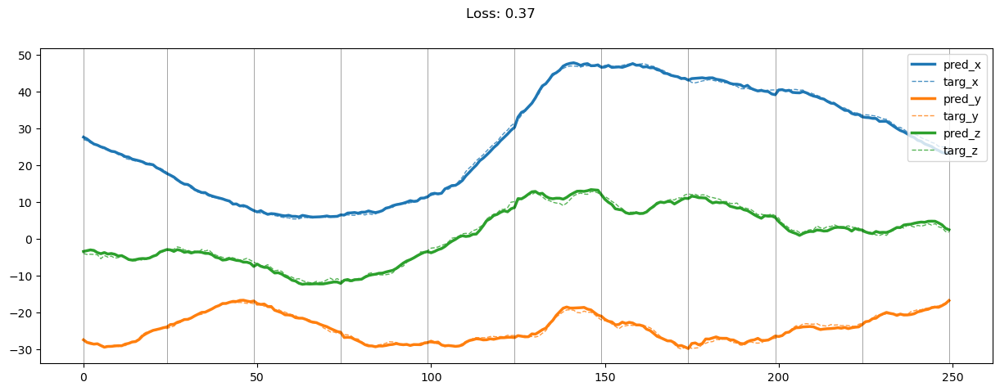

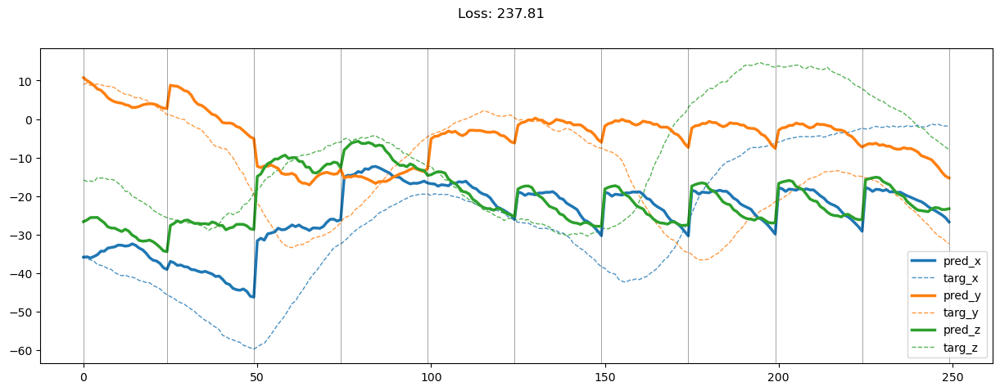

00349: train pred loss:  0.607, g loss:  2.213, diff loss:  1.199, d loss:  1.502
       valid pred loss:  168.343, g loss:  523.650, diff loss:  354.900, d loss:  1.505


100%|██████████| 17/17 [00:01<00:00, 15.15it/s]


00350: train pred loss:  0.591, g loss:  2.175, diff loss:  1.175, d loss:  1.501
       valid pred loss:  167.614, g loss:  517.638, diff loss:  349.617, d loss:  1.503


100%|██████████| 17/17 [00:01<00:00, 15.15it/s]


00351: train pred loss:  0.597, g loss:  2.186, diff loss:  1.179, d loss:  1.500
       valid pred loss:  165.625, g loss:  514.107, diff loss:  348.073, d loss:  1.502


100%|██████████| 17/17 [00:01<00:00, 15.21it/s]


00352: train pred loss:  0.614, g loss:  2.226, diff loss:  1.202, d loss:  1.499
       valid pred loss:  166.492, g loss:  520.966, diff loss:  354.065, d loss:  1.501


100%|██████████| 17/17 [00:01<00:00, 15.23it/s]


00353: train pred loss:  0.605, g loss:  2.218, diff loss:  1.201, d loss:  1.498
       valid pred loss:  168.440, g loss:  524.771, diff loss:  355.921, d loss:  1.501


100%|██████████| 17/17 [00:01<00:00, 15.01it/s]


00354: train pred loss:  0.602, g loss:  2.206, diff loss:  1.194, d loss:  1.499
       valid pred loss:  167.879, g loss:  523.661, diff loss:  355.373, d loss:  1.502


100%|██████████| 17/17 [00:01<00:00, 15.24it/s]


00355: train pred loss:  0.602, g loss:  2.192, diff loss:  1.179, d loss:  1.499
       valid pred loss:  166.047, g loss:  513.531, diff loss:  347.076, d loss:  1.504


100%|██████████| 17/17 [00:01<00:00, 14.33it/s]


00356: train pred loss:  0.617, g loss:  2.217, diff loss:  1.191, d loss:  1.500
       valid pred loss:  166.154, g loss:  518.316, diff loss:  351.758, d loss:  1.507


100%|██████████| 17/17 [00:01<00:00, 15.19it/s]


00357: train pred loss:  0.642, g loss:  2.305, diff loss:  1.256, d loss:  1.502
       valid pred loss:  169.074, g loss:  523.399, diff loss:  353.922, d loss:  1.510


100%|██████████| 17/17 [00:01<00:00, 15.19it/s]


00358: train pred loss:  0.658, g loss:  2.338, diff loss:  1.274, d loss:  1.504
       valid pred loss:  171.227, g loss:  529.304, diff loss:  357.677, d loss:  1.513


100%|██████████| 17/17 [00:01<00:00, 15.17it/s]


00359: train pred loss:  0.656, g loss:  2.366, diff loss:  1.306, d loss:  1.505
       valid pred loss:  168.065, g loss:  523.407, diff loss:  354.941, d loss:  1.512


100%|██████████| 17/17 [00:01<00:00, 15.20it/s]


00360: train pred loss:  0.657, g loss:  2.360, diff loss:  1.298, d loss:  1.505
       valid pred loss:  169.412, g loss:  526.207, diff loss:  356.393, d loss:  1.512


100%|██████████| 17/17 [00:01<00:00, 14.09it/s]


00361: train pred loss:  0.639, g loss:  2.293, diff loss:  1.247, d loss:  1.503
       valid pred loss:  166.095, g loss:  519.778, diff loss:  353.278, d loss:  1.508


100%|██████████| 17/17 [00:01<00:00, 14.10it/s]


00362: train pred loss:  0.645, g loss:  2.333, diff loss:  1.278, d loss:  1.500
       valid pred loss:  167.039, g loss:  516.258, diff loss:  348.811, d loss:  1.504


100%|██████████| 17/17 [00:01<00:00, 15.06it/s]


00363: train pred loss:  0.649, g loss:  2.328, diff loss:  1.266, d loss:  1.497
       valid pred loss:  163.318, g loss:  505.517, diff loss:  341.788, d loss:  1.502


100%|██████████| 17/17 [00:01<00:00, 15.12it/s]


00364: train pred loss:  0.633, g loss:  2.311, diff loss:  1.264, d loss:  1.495
       valid pred loss:  164.802, g loss:  513.280, diff loss:  348.065, d loss:  1.498


100%|██████████| 17/17 [00:01<00:00, 14.54it/s]


00365: train pred loss:  0.641, g loss:  2.318, diff loss:  1.261, d loss:  1.494
       valid pred loss:  170.374, g loss:  527.261, diff loss:  356.473, d loss:  1.498


100%|██████████| 17/17 [00:01<00:00, 14.20it/s]


00366: train pred loss:  0.663, g loss:  2.354, diff loss:  1.275, d loss:  1.493
       valid pred loss:  167.047, g loss:  517.963, diff loss:  350.503, d loss:  1.499


100%|██████████| 17/17 [00:01<00:00, 15.26it/s]


00367: train pred loss:  0.664, g loss:  2.368, diff loss:  1.289, d loss:  1.496
       valid pred loss:  169.145, g loss:  524.761, diff loss:  355.206, d loss:  1.502


100%|██████████| 17/17 [00:01<00:00, 15.23it/s]


00368: train pred loss:  0.678, g loss:  2.417, diff loss:  1.328, d loss:  1.499
       valid pred loss:  168.458, g loss:  520.013, diff loss:  351.149, d loss:  1.508


100%|██████████| 17/17 [00:01<00:00, 15.22it/s]


00369: train pred loss:  0.666, g loss:  2.390, diff loss:  1.316, d loss:  1.502
       valid pred loss:  168.706, g loss:  520.935, diff loss:  351.829, d loss:  1.514


100%|██████████| 17/17 [00:01<00:00, 15.23it/s]


00370: train pred loss:  0.644, g loss:  2.301, diff loss:  1.253, d loss:  1.506
       valid pred loss:  169.600, g loss:  529.821, diff loss:  359.824, d loss:  1.518


100%|██████████| 17/17 [00:01<00:00, 14.17it/s]


00371: train pred loss:  0.622, g loss:  2.238, diff loss:  1.214, d loss:  1.508
       valid pred loss:  166.926, g loss:  516.124, diff loss:  348.801, d loss:  1.520


100%|██████████| 17/17 [00:01<00:00, 13.69it/s]


00372: train pred loss:  0.624, g loss:  2.251, diff loss:  1.225, d loss:  1.509
       valid pred loss:  167.318, g loss:  518.784, diff loss:  351.069, d loss:  1.517


100%|██████████| 17/17 [00:01<00:00, 14.37it/s]


00373: train pred loss:  0.614, g loss:  2.210, diff loss:  1.191, d loss:  1.505
       valid pred loss:  172.755, g loss:  538.806, diff loss:  365.649, d loss:  1.513


100%|██████████| 17/17 [00:01<00:00, 14.73it/s]


00374: train pred loss:  0.638, g loss:  2.289, diff loss:  1.242, d loss:  1.501
       valid pred loss:  172.217, g loss:  539.407, diff loss:  366.783, d loss:  1.505


100%|██████████| 17/17 [00:01<00:00, 14.25it/s]


00375: train pred loss:  0.639, g loss:  2.304, diff loss:  1.251, d loss:  1.496
       valid pred loss:  171.853, g loss:  534.613, diff loss:  362.347, d loss:  1.499


100%|██████████| 17/17 [00:01<00:00, 15.12it/s]


00376: train pred loss:  0.647, g loss:  2.316, diff loss:  1.252, d loss:  1.492
       valid pred loss:  166.871, g loss:  514.430, diff loss:  347.141, d loss:  1.494


100%|██████████| 17/17 [00:01<00:00, 15.10it/s]


00377: train pred loss:  0.645, g loss:  2.342, diff loss:  1.278, d loss:  1.490
       valid pred loss:  169.286, g loss:  526.079, diff loss:  356.374, d loss:  1.492


100%|██████████| 17/17 [00:01<00:00, 14.95it/s]


00378: train pred loss:  0.636, g loss:  2.301, diff loss:  1.245, d loss:  1.490
       valid pred loss:  168.121, g loss:  518.343, diff loss:  349.803, d loss:  1.492


100%|██████████| 17/17 [00:01<00:00, 15.13it/s]


00379: train pred loss:  0.617, g loss:  2.240, diff loss:  1.204, d loss:  1.490
       valid pred loss:  176.030, g loss:  539.315, diff loss:  362.868, d loss:  1.495


100%|██████████| 17/17 [00:01<00:00, 15.08it/s]


00380: train pred loss:  0.620, g loss:  2.252, diff loss:  1.216, d loss:  1.494
       valid pred loss:  173.844, g loss:  538.003, diff loss:  363.748, d loss:  1.500


100%|██████████| 17/17 [00:01<00:00, 15.05it/s]


00381: train pred loss:  0.616, g loss:  2.241, diff loss:  1.214, d loss:  1.498
       valid pred loss:  171.180, g loss:  532.811, diff loss:  361.227, d loss:  1.509


100%|██████████| 17/17 [00:01<00:00, 15.13it/s]


00382: train pred loss:  0.636, g loss:  2.292, diff loss:  1.251, d loss:  1.504
       valid pred loss:  173.175, g loss:  535.009, diff loss:  361.437, d loss:  1.517


100%|██████████| 17/17 [00:01<00:00, 15.18it/s]


00383: train pred loss:  0.645, g loss:  2.327, diff loss:  1.282, d loss:  1.510
       valid pred loss:  171.607, g loss:  535.415, diff loss:  363.417, d loss:  1.525


100%|██████████| 17/17 [00:01<00:00, 15.09it/s]


00384: train pred loss:  0.665, g loss:  2.344, diff loss:  1.284, d loss:  1.515
       valid pred loss:  171.969, g loss:  538.095, diff loss:  365.737, d loss:  1.528


100%|██████████| 17/17 [00:01<00:00, 15.07it/s]


00385: train pred loss:  0.667, g loss:  2.367, diff loss:  1.307, d loss:  1.516
       valid pred loss:  170.243, g loss:  526.595, diff loss:  355.963, d loss:  1.527


100%|██████████| 17/17 [00:01<00:00, 15.18it/s]


00386: train pred loss:  0.623, g loss:  2.221, diff loss:  1.202, d loss:  1.514
       valid pred loss:  167.423, g loss:  516.978, diff loss:  349.159, d loss:  1.519


100%|██████████| 17/17 [00:01<00:00, 15.12it/s]


00387: train pred loss:  0.608, g loss:  2.191, diff loss:  1.181, d loss:  1.508
       valid pred loss:  169.302, g loss:  523.658, diff loss:  353.953, d loss:  1.509


100%|██████████| 17/17 [00:01<00:00, 14.87it/s]


00388: train pred loss:  0.628, g loss:  2.266, diff loss:  1.230, d loss:  1.501
       valid pred loss:  167.699, g loss:  520.973, diff loss:  352.864, d loss:  1.500


100%|██████████| 17/17 [00:01<00:00, 14.73it/s]


00389: train pred loss:  0.622, g loss:  2.274, diff loss:  1.240, d loss:  1.497
       valid pred loss:  167.280, g loss:  514.820, diff loss:  347.129, d loss:  1.500


100%|██████████| 17/17 [00:01<00:00, 14.96it/s]


00390: train pred loss:  0.618, g loss:  2.241, diff loss:  1.211, d loss:  1.497
       valid pred loss:  170.904, g loss:  529.407, diff loss:  358.093, d loss:  1.501


100%|██████████| 17/17 [00:01<00:00, 15.01it/s]


00391: train pred loss:  0.610, g loss:  2.232, diff loss:  1.210, d loss:  1.498
       valid pred loss:  170.465, g loss:  526.745, diff loss:  355.870, d loss:  1.502


100%|██████████| 17/17 [00:01<00:00, 15.10it/s]


00392: train pred loss:  0.608, g loss:  2.219, diff loss:  1.201, d loss:  1.499
       valid pred loss:  170.980, g loss:  528.879, diff loss:  357.490, d loss:  1.503


100%|██████████| 17/17 [00:01<00:00, 15.14it/s]


00393: train pred loss:  0.588, g loss:  2.153, diff loss:  1.155, d loss:  1.499
       valid pred loss:  170.624, g loss:  529.658, diff loss:  358.626, d loss:  1.503


100%|██████████| 17/17 [00:01<00:00, 15.06it/s]


00394: train pred loss:  0.595, g loss:  2.175, diff loss:  1.171, d loss:  1.500
       valid pred loss:  167.723, g loss:  516.352, diff loss:  348.222, d loss:  1.504


100%|██████████| 17/17 [00:01<00:00, 15.14it/s]


00395: train pred loss:  0.570, g loss:  2.096, diff loss:  1.118, d loss:  1.501
       valid pred loss:  169.042, g loss:  520.577, diff loss:  351.128, d loss:  1.505


100%|██████████| 17/17 [00:01<00:00, 14.92it/s]


00396: train pred loss:  0.604, g loss:  2.189, diff loss:  1.178, d loss:  1.502
       valid pred loss:  167.555, g loss:  520.773, diff loss:  352.811, d loss:  1.505


100%|██████████| 17/17 [00:01<00:00, 15.05it/s]


00397: train pred loss:  0.602, g loss:  2.187, diff loss:  1.178, d loss:  1.502
       valid pred loss:  170.349, g loss:  525.823, diff loss:  355.069, d loss:  1.507


100%|██████████| 17/17 [00:01<00:00, 14.84it/s]


00398: train pred loss:  0.597, g loss:  2.172, diff loss:  1.169, d loss:  1.503
       valid pred loss:  169.505, g loss:  525.755, diff loss:  355.846, d loss:  1.508


100%|██████████| 17/17 [00:01<00:00, 14.16it/s]


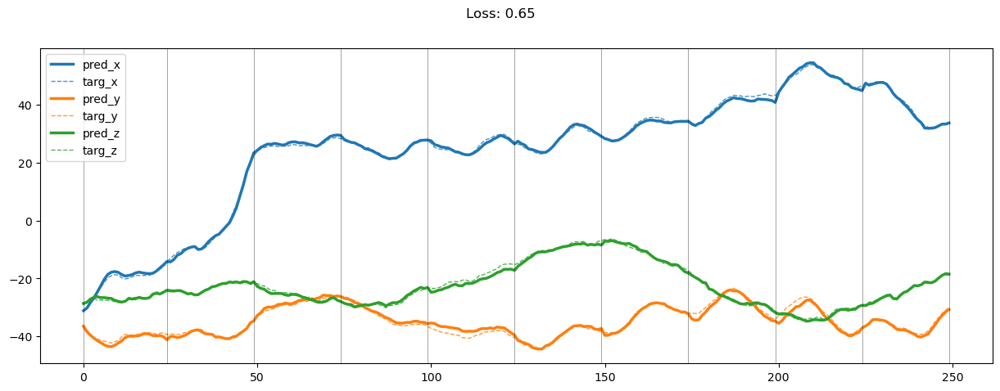

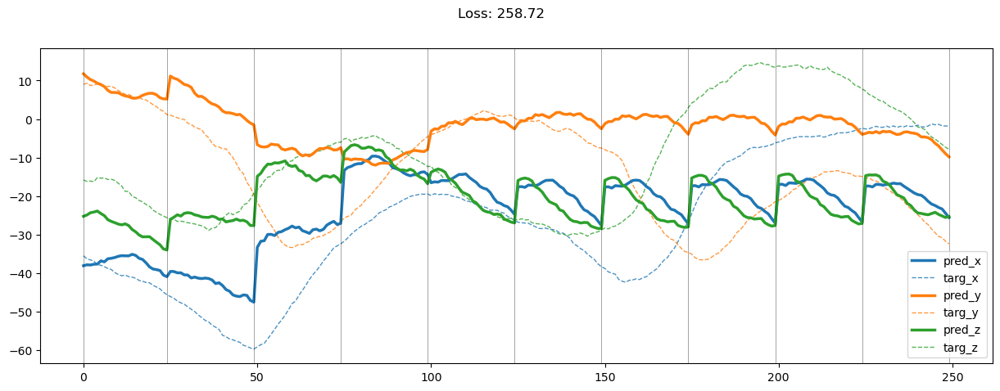

00399: train pred loss:  0.605, g loss:  2.227, diff loss:  1.216, d loss:  1.504
       valid pred loss:  171.053, g loss:  529.923, diff loss:  358.467, d loss:  1.508


100%|██████████| 17/17 [00:01<00:00, 15.09it/s]


00400: train pred loss:  0.623, g loss:  2.259, diff loss:  1.232, d loss:  1.505
       valid pred loss:  172.150, g loss:  538.591, diff loss:  366.039, d loss:  1.509


100%|██████████| 17/17 [00:01<00:00, 15.10it/s]


00401: train pred loss:  0.629, g loss:  2.256, diff loss:  1.224, d loss:  1.506
       valid pred loss:  171.162, g loss:  532.898, diff loss:  361.335, d loss:  1.510


100%|██████████| 17/17 [00:01<00:00, 15.06it/s]


00402: train pred loss:  0.631, g loss:  2.264, diff loss:  1.230, d loss:  1.507
       valid pred loss:  172.770, g loss:  541.952, diff loss:  368.782, d loss:  1.511


100%|██████████| 17/17 [00:01<00:00, 15.03it/s]


00403: train pred loss:  0.606, g loss:  2.195, diff loss:  1.187, d loss:  1.508
       valid pred loss:  170.804, g loss:  532.875, diff loss:  361.671, d loss:  1.512


100%|██████████| 17/17 [00:01<00:00, 15.08it/s]


00404: train pred loss:  0.602, g loss:  2.204, diff loss:  1.201, d loss:  1.509
       valid pred loss:  172.219, g loss:  537.641, diff loss:  365.022, d loss:  1.512


100%|██████████| 17/17 [00:01<00:00, 14.57it/s]


00405: train pred loss:  0.602, g loss:  2.187, diff loss:  1.185, d loss:  1.509
       valid pred loss:  171.710, g loss:  535.346, diff loss:  363.238, d loss:  1.513


100%|██████████| 17/17 [00:01<00:00, 15.08it/s]


00406: train pred loss:  0.605, g loss:  2.201, diff loss:  1.196, d loss:  1.509
       valid pred loss:  170.132, g loss:  530.014, diff loss:  359.483, d loss:  1.514


100%|██████████| 17/17 [00:01<00:00, 15.10it/s]


00407: train pred loss:  0.620, g loss:  2.236, diff loss:  1.217, d loss:  1.510
       valid pred loss:  168.703, g loss:  524.424, diff loss:  355.322, d loss:  1.513


100%|██████████| 17/17 [00:01<00:00, 15.13it/s]


00408: train pred loss:  0.617, g loss:  2.256, diff loss:  1.240, d loss:  1.510
       valid pred loss:  167.247, g loss:  522.502, diff loss:  354.858, d loss:  1.514


100%|██████████| 17/17 [00:01<00:00, 15.11it/s]


00409: train pred loss:  0.636, g loss:  2.279, diff loss:  1.244, d loss:  1.510
       valid pred loss:  170.276, g loss:  531.496, diff loss:  360.822, d loss:  1.514


100%|██████████| 17/17 [00:01<00:00, 15.15it/s]


00410: train pred loss:  0.667, g loss:  2.385, diff loss:  1.318, d loss:  1.510
       valid pred loss:  170.098, g loss:  524.416, diff loss:  353.921, d loss:  1.515


100%|██████████| 17/17 [00:01<00:00, 13.93it/s]


00411: train pred loss:  0.649, g loss:  2.326, diff loss:  1.277, d loss:  1.510
       valid pred loss:  171.497, g loss:  535.410, diff loss:  363.516, d loss:  1.514


100%|██████████| 17/17 [00:01<00:00, 14.71it/s]


00412: train pred loss:  0.639, g loss:  2.278, diff loss:  1.240, d loss:  1.510
       valid pred loss:  167.681, g loss:  521.251, diff loss:  353.171, d loss:  1.514


100%|██████████| 17/17 [00:01<00:00, 15.22it/s]


00413: train pred loss:  0.638, g loss:  2.291, diff loss:  1.253, d loss:  1.510
       valid pred loss:  170.567, g loss:  535.774, diff loss:  364.809, d loss:  1.513


100%|██████████| 17/17 [00:01<00:00, 15.23it/s]


00414: train pred loss:  0.617, g loss:  2.226, diff loss:  1.209, d loss:  1.509
       valid pred loss:  167.808, g loss:  525.809, diff loss:  357.602, d loss:  1.513


100%|██████████| 17/17 [00:01<00:00, 15.00it/s]


00415: train pred loss:  0.613, g loss:  2.216, diff loss:  1.202, d loss:  1.508
       valid pred loss:  170.949, g loss:  537.017, diff loss:  365.668, d loss:  1.512


100%|██████████| 17/17 [00:01<00:00, 15.19it/s]


00416: train pred loss:  0.603, g loss:  2.196, diff loss:  1.191, d loss:  1.508
       valid pred loss:  169.505, g loss:  527.903, diff loss:  357.997, d loss:  1.511


100%|██████████| 17/17 [00:01<00:00, 15.20it/s]


00417: train pred loss:  0.607, g loss:  2.190, diff loss:  1.181, d loss:  1.507
       valid pred loss:  170.479, g loss:  524.950, diff loss:  354.069, d loss:  1.510


100%|██████████| 17/17 [00:01<00:00, 15.18it/s]


00418: train pred loss:  0.622, g loss:  2.241, diff loss:  1.216, d loss:  1.506
       valid pred loss:  169.943, g loss:  522.349, diff loss:  352.004, d loss:  1.509


100%|██████████| 17/17 [00:01<00:00, 14.75it/s]


00419: train pred loss:  0.628, g loss:  2.240, diff loss:  1.208, d loss:  1.505
       valid pred loss:  168.347, g loss:  523.806, diff loss:  355.056, d loss:  1.508


100%|██████████| 17/17 [00:01<00:00, 15.16it/s]


00420: train pred loss:  0.616, g loss:  2.219, diff loss:  1.198, d loss:  1.504
       valid pred loss:  168.547, g loss:  519.438, diff loss:  350.486, d loss:  1.507


100%|██████████| 17/17 [00:01<00:00, 14.11it/s]


00421: train pred loss:  0.610, g loss:  2.222, diff loss:  1.206, d loss:  1.503
       valid pred loss:  164.968, g loss:  508.406, diff loss:  343.033, d loss:  1.506


100%|██████████| 17/17 [00:01<00:00, 14.68it/s]


00422: train pred loss:  0.625, g loss:  2.253, diff loss:  1.221, d loss:  1.502
       valid pred loss:  169.814, g loss:  520.749, diff loss:  350.528, d loss:  1.505


100%|██████████| 17/17 [00:01<00:00, 15.02it/s]


00423: train pred loss:  0.635, g loss:  2.283, diff loss:  1.240, d loss:  1.502
       valid pred loss:  165.523, g loss:  512.777, diff loss:  346.847, d loss:  1.504


100%|██████████| 17/17 [00:01<00:00, 14.66it/s]


00424: train pred loss:  0.630, g loss:  2.275, diff loss:  1.236, d loss:  1.500
       valid pred loss:  166.947, g loss:  519.913, diff loss:  352.558, d loss:  1.503


100%|██████████| 17/17 [00:01<00:00, 15.23it/s]


00425: train pred loss:  0.625, g loss:  2.255, diff loss:  1.220, d loss:  1.500
       valid pred loss:  168.448, g loss:  526.516, diff loss:  357.659, d loss:  1.502


100%|██████████| 17/17 [00:01<00:00, 14.98it/s]


00426: train pred loss:  0.617, g loss:  2.241, diff loss:  1.214, d loss:  1.498
       valid pred loss:  164.246, g loss:  503.468, diff loss:  338.812, d loss:  1.501


100%|██████████| 17/17 [00:01<00:00, 15.18it/s]


00427: train pred loss:  0.638, g loss:  2.303, diff loss:  1.254, d loss:  1.498
       valid pred loss:  163.815, g loss:  503.063, diff loss:  338.837, d loss:  1.501


100%|██████████| 17/17 [00:01<00:00, 15.19it/s]


00428: train pred loss:  0.611, g loss:  2.228, diff loss:  1.206, d loss:  1.498
       valid pred loss:  166.242, g loss:  515.010, diff loss:  348.358, d loss:  1.501


100%|██████████| 17/17 [00:01<00:00, 15.06it/s]


00429: train pred loss:  0.597, g loss:  2.185, diff loss:  1.175, d loss:  1.497
       valid pred loss:  166.061, g loss:  508.613, diff loss:  342.141, d loss:  1.500


100%|██████████| 17/17 [00:01<00:00, 14.59it/s]


00430: train pred loss:  0.606, g loss:  2.199, diff loss:  1.180, d loss:  1.497
       valid pred loss:  164.643, g loss:  508.294, diff loss:  343.239, d loss:  1.500


100%|██████████| 17/17 [00:01<00:00, 14.51it/s]


00431: train pred loss:  0.619, g loss:  2.232, diff loss:  1.201, d loss:  1.497
       valid pred loss:  163.888, g loss:  503.672, diff loss:  339.372, d loss:  1.499


100%|██████████| 17/17 [00:01<00:00, 15.24it/s]


00432: train pred loss:  0.622, g loss:  2.242, diff loss:  1.207, d loss:  1.497
       valid pred loss:  165.300, g loss:  512.625, diff loss:  346.913, d loss:  1.500


100%|██████████| 17/17 [00:01<00:00, 15.21it/s]


00433: train pred loss:  0.600, g loss:  2.202, diff loss:  1.189, d loss:  1.497
       valid pred loss:  167.911, g loss:  515.973, diff loss:  347.650, d loss:  1.499


100%|██████████| 17/17 [00:01<00:00, 15.23it/s]


00434: train pred loss:  0.621, g loss:  2.260, diff loss:  1.227, d loss:  1.497
       valid pred loss:  169.103, g loss:  521.724, diff loss:  352.210, d loss:  1.500


100%|██████████| 17/17 [00:01<00:00, 15.22it/s]


00435: train pred loss:  0.665, g loss:  2.350, diff loss:  1.273, d loss:  1.497
       valid pred loss:  167.371, g loss:  515.199, diff loss:  347.418, d loss:  1.501


100%|██████████| 17/17 [00:01<00:00, 15.17it/s]


00436: train pred loss:  0.621, g loss:  2.258, diff loss:  1.225, d loss:  1.498
       valid pred loss:  169.790, g loss:  528.391, diff loss:  358.192, d loss:  1.501


100%|██████████| 17/17 [00:01<00:00, 15.17it/s]


00437: train pred loss:  0.623, g loss:  2.255, diff loss:  1.221, d loss:  1.499
       valid pred loss:  169.010, g loss:  527.595, diff loss:  358.176, d loss:  1.502


100%|██████████| 17/17 [00:01<00:00, 15.24it/s]


00438: train pred loss:  0.623, g loss:  2.243, diff loss:  1.210, d loss:  1.499
       valid pred loss:  165.390, g loss:  512.437, diff loss:  346.639, d loss:  1.503


100%|██████████| 17/17 [00:01<00:00, 15.25it/s]


00439: train pred loss:  0.653, g loss:  2.378, diff loss:  1.316, d loss:  1.500
       valid pred loss:  165.821, g loss:  513.885, diff loss:  347.657, d loss:  1.504


100%|██████████| 17/17 [00:01<00:00, 15.27it/s]


00440: train pred loss:  0.729, g loss:  2.547, diff loss:  1.410, d loss:  1.501
       valid pred loss:  164.649, g loss:  508.271, diff loss:  343.215, d loss:  1.505


100%|██████████| 17/17 [00:01<00:00, 15.26it/s]


00441: train pred loss:  0.737, g loss:  2.571, diff loss:  1.427, d loss:  1.502
       valid pred loss:  166.641, g loss:  517.118, diff loss:  350.071, d loss:  1.506


100%|██████████| 17/17 [00:01<00:00, 15.26it/s]


00442: train pred loss:  0.671, g loss:  2.402, diff loss:  1.325, d loss:  1.503
       valid pred loss:  162.610, g loss:  503.539, diff loss:  340.524, d loss:  1.506


100%|██████████| 17/17 [00:01<00:00, 15.25it/s]


00443: train pred loss:  0.661, g loss:  2.367, diff loss:  1.301, d loss:  1.504
       valid pred loss:  169.366, g loss:  515.944, diff loss:  346.175, d loss:  1.508


100%|██████████| 17/17 [00:01<00:00, 15.25it/s]


00444: train pred loss:  0.659, g loss:  2.339, diff loss:  1.276, d loss:  1.506
       valid pred loss:  170.482, g loss:  525.019, diff loss:  354.135, d loss:  1.509


100%|██████████| 17/17 [00:01<00:00, 15.27it/s]


00445: train pred loss:  0.617, g loss:  2.227, diff loss:  1.207, d loss:  1.506
       valid pred loss:  170.823, g loss:  526.811, diff loss:  355.587, d loss:  1.510


100%|██████████| 17/17 [00:01<00:00, 15.28it/s]


00446: train pred loss:  0.600, g loss:  2.191, diff loss:  1.189, d loss:  1.507
       valid pred loss:  166.339, g loss:  515.483, diff loss:  348.743, d loss:  1.511


100%|██████████| 17/17 [00:01<00:00, 15.21it/s]


00447: train pred loss:  0.592, g loss:  2.167, diff loss:  1.174, d loss:  1.508
       valid pred loss:  167.038, g loss:  516.427, diff loss:  348.989, d loss:  1.511


100%|██████████| 17/17 [00:01<00:00, 15.25it/s]


00448: train pred loss:  0.596, g loss:  2.161, diff loss:  1.164, d loss:  1.509
       valid pred loss:  169.621, g loss:  523.348, diff loss:  353.328, d loss:  1.513


100%|██████████| 17/17 [00:01<00:00, 15.26it/s]


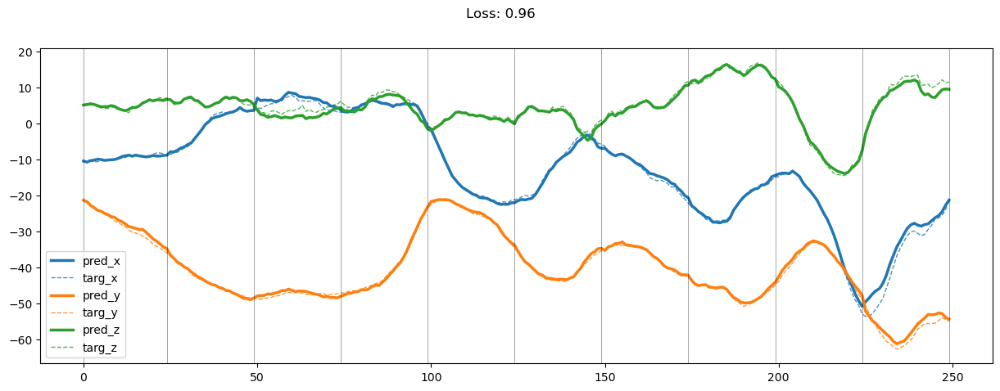

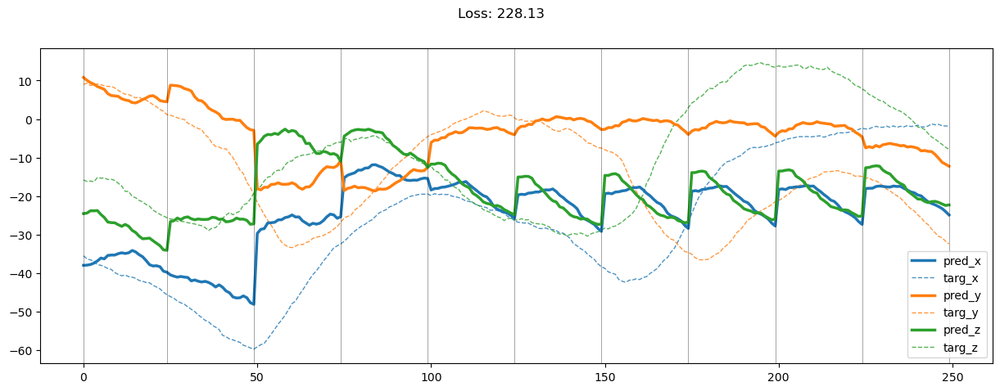

00449: train pred loss:  0.593, g loss:  2.156, diff loss:  1.163, d loss:  1.510
       valid pred loss:  167.854, g loss:  518.761, diff loss:  350.509, d loss:  1.513


100%|██████████| 17/17 [00:01<00:00, 15.25it/s]


00450: train pred loss:  0.604, g loss:  2.207, diff loss:  1.203, d loss:  1.510
       valid pred loss:  166.293, g loss:  511.004, diff loss:  344.313, d loss:  1.514


100%|██████████| 17/17 [00:01<00:00, 14.38it/s]


00451: train pred loss:  0.626, g loss:  2.245, diff loss:  1.220, d loss:  1.511
       valid pred loss:  168.697, g loss:  521.239, diff loss:  352.144, d loss:  1.514


100%|██████████| 17/17 [00:01<00:00, 15.27it/s]


00452: train pred loss:  0.601, g loss:  2.180, diff loss:  1.180, d loss:  1.511
       valid pred loss:  170.111, g loss:  526.546, diff loss:  356.037, d loss:  1.514


100%|██████████| 17/17 [00:01<00:00, 15.13it/s]


00453: train pred loss:  0.594, g loss:  2.166, diff loss:  1.174, d loss:  1.511
       valid pred loss:  166.202, g loss:  518.732, diff loss:  352.133, d loss:  1.514


100%|██████████| 17/17 [00:01<00:00, 15.18it/s]


00454: train pred loss:  0.590, g loss:  2.153, diff loss:  1.164, d loss:  1.510
       valid pred loss:  174.053, g loss:  541.445, diff loss:  366.995, d loss:  1.514


100%|██████████| 17/17 [00:01<00:00, 15.28it/s]


00455: train pred loss:  0.593, g loss:  2.156, diff loss:  1.164, d loss:  1.510
       valid pred loss:  171.994, g loss:  533.901, diff loss:  361.509, d loss:  1.514


100%|██████████| 17/17 [00:01<00:00, 15.29it/s]


00456: train pred loss:  0.594, g loss:  2.171, diff loss:  1.178, d loss:  1.510
       valid pred loss:  168.821, g loss:  522.050, diff loss:  352.831, d loss:  1.514


100%|██████████| 17/17 [00:01<00:00, 15.14it/s]


00457: train pred loss:  0.590, g loss:  2.135, diff loss:  1.145, d loss:  1.510
       valid pred loss:  166.926, g loss:  518.550, diff loss:  351.224, d loss:  1.512


100%|██████████| 17/17 [00:01<00:00, 15.28it/s]


00458: train pred loss:  0.609, g loss:  2.196, diff loss:  1.187, d loss:  1.509
       valid pred loss:  167.752, g loss:  519.828, diff loss:  351.676, d loss:  1.511


100%|██████████| 17/17 [00:01<00:00, 15.29it/s]


00459: train pred loss:  0.594, g loss:  2.155, diff loss:  1.160, d loss:  1.508
       valid pred loss:  167.594, g loss:  522.714, diff loss:  354.719, d loss:  1.511


100%|██████████| 17/17 [00:01<00:00, 15.17it/s]


00460: train pred loss:  0.621, g loss:  2.249, diff loss:  1.225, d loss:  1.507
       valid pred loss:  170.053, g loss:  523.019, diff loss:  352.565, d loss:  1.510


100%|██████████| 17/17 [00:01<00:00, 15.28it/s]


00461: train pred loss:  0.611, g loss:  2.200, diff loss:  1.186, d loss:  1.506
       valid pred loss:  169.896, g loss:  528.673, diff loss:  358.375, d loss:  1.509


100%|██████████| 17/17 [00:01<00:00, 15.28it/s]


00462: train pred loss:  0.617, g loss:  2.216, diff loss:  1.195, d loss:  1.505
       valid pred loss:  168.207, g loss:  521.539, diff loss:  352.927, d loss:  1.507


100%|██████████| 17/17 [00:01<00:00, 14.10it/s]


00463: train pred loss:  0.589, g loss:  2.132, diff loss:  1.138, d loss:  1.504
       valid pred loss:  168.274, g loss:  523.442, diff loss:  354.763, d loss:  1.506


100%|██████████| 17/17 [00:01<00:00, 15.24it/s]


00464: train pred loss:  0.585, g loss:  2.145, diff loss:  1.154, d loss:  1.503
       valid pred loss:  170.700, g loss:  528.563, diff loss:  357.458, d loss:  1.505


100%|██████████| 17/17 [00:01<00:00, 14.57it/s]


00465: train pred loss:  0.579, g loss:  2.134, diff loss:  1.147, d loss:  1.502
       valid pred loss:  168.576, g loss:  519.169, diff loss:  350.186, d loss:  1.504


100%|██████████| 17/17 [00:01<00:00, 15.20it/s]


00466: train pred loss:  0.593, g loss:  2.174, diff loss:  1.173, d loss:  1.501
       valid pred loss:  164.999, g loss:  508.222, diff loss:  342.814, d loss:  1.503


100%|██████████| 17/17 [00:01<00:00, 15.26it/s]


00467: train pred loss:  0.618, g loss:  2.245, diff loss:  1.218, d loss:  1.500
       valid pred loss:  166.390, g loss:  514.858, diff loss:  348.059, d loss:  1.501


100%|██████████| 17/17 [00:01<00:00, 15.28it/s]


00468: train pred loss:  0.611, g loss:  2.231, diff loss:  1.209, d loss:  1.499
       valid pred loss:  164.042, g loss:  502.677, diff loss:  338.225, d loss:  1.501


100%|██████████| 17/17 [00:01<00:00, 15.29it/s]


00469: train pred loss:  0.619, g loss:  2.251, diff loss:  1.221, d loss:  1.498
       valid pred loss:  169.227, g loss:  521.055, diff loss:  351.417, d loss:  1.500


100%|██████████| 17/17 [00:01<00:00, 15.06it/s]


00470: train pred loss:  0.623, g loss:  2.250, diff loss:  1.214, d loss:  1.497
       valid pred loss:  165.934, g loss:  514.193, diff loss:  347.847, d loss:  1.500


100%|██████████| 17/17 [00:01<00:00, 15.25it/s]


00471: train pred loss:  0.642, g loss:  2.265, diff loss:  1.210, d loss:  1.497
       valid pred loss:  165.629, g loss:  511.279, diff loss:  345.239, d loss:  1.499


100%|██████████| 17/17 [00:01<00:00, 14.52it/s]


00472: train pred loss:  0.615, g loss:  2.219, diff loss:  1.191, d loss:  1.496
       valid pred loss:  171.185, g loss:  527.132, diff loss:  355.535, d loss:  1.499


100%|██████████| 17/17 [00:01<00:00, 14.57it/s]


00473: train pred loss:  0.600, g loss:  2.203, diff loss:  1.190, d loss:  1.496
       valid pred loss:  167.723, g loss:  517.246, diff loss:  349.111, d loss:  1.498


100%|██████████| 17/17 [00:01<00:00, 15.16it/s]


00474: train pred loss:  0.589, g loss:  2.153, diff loss:  1.151, d loss:  1.496
       valid pred loss:  166.755, g loss:  517.344, diff loss:  350.177, d loss:  1.499


100%|██████████| 17/17 [00:01<00:00, 15.20it/s]


00475: train pred loss:  0.603, g loss:  2.174, diff loss:  1.159, d loss:  1.496
       valid pred loss:  165.424, g loss:  514.896, diff loss:  349.060, d loss:  1.499


100%|██████████| 17/17 [00:01<00:00, 15.21it/s]


00476: train pred loss:  0.593, g loss:  2.164, diff loss:  1.158, d loss:  1.496
       valid pred loss:  167.484, g loss:  518.011, diff loss:  350.116, d loss:  1.499


100%|██████████| 17/17 [00:01<00:00, 15.22it/s]


00477: train pred loss:  0.601, g loss:  2.199, diff loss:  1.186, d loss:  1.497
       valid pred loss:  164.437, g loss:  504.875, diff loss:  340.027, d loss:  1.500


100%|██████████| 17/17 [00:01<00:00, 14.77it/s]


00478: train pred loss:  0.592, g loss:  2.143, diff loss:  1.140, d loss:  1.498
       valid pred loss:  163.222, g loss:  504.173, diff loss:  340.541, d loss:  1.501


100%|██████████| 17/17 [00:01<00:00, 15.26it/s]


00479: train pred loss:  0.602, g loss:  2.204, diff loss:  1.191, d loss:  1.499
       valid pred loss:  162.657, g loss:  503.670, diff loss:  340.604, d loss:  1.502


100%|██████████| 17/17 [00:01<00:00, 14.77it/s]


00480: train pred loss:  0.593, g loss:  2.160, diff loss:  1.157, d loss:  1.500
       valid pred loss:  161.749, g loss:  496.643, diff loss:  334.485, d loss:  1.503


100%|██████████| 17/17 [00:01<00:00, 14.14it/s]


00481: train pred loss:  0.604, g loss:  2.189, diff loss:  1.176, d loss:  1.501
       valid pred loss:  164.728, g loss:  504.254, diff loss:  339.119, d loss:  1.504


100%|██████████| 17/17 [00:01<00:00, 15.27it/s]


00482: train pred loss:  0.608, g loss:  2.216, diff loss:  1.201, d loss:  1.501
       valid pred loss:  164.436, g loss:  511.087, diff loss:  346.244, d loss:  1.505


100%|██████████| 17/17 [00:01<00:00, 15.28it/s]


00483: train pred loss:  0.599, g loss:  2.176, diff loss:  1.171, d loss:  1.503
       valid pred loss:  163.672, g loss:  506.233, diff loss:  342.156, d loss:  1.506


100%|██████████| 17/17 [00:01<00:00, 15.28it/s]


00484: train pred loss:  0.605, g loss:  2.213, diff loss:  1.203, d loss:  1.504
       valid pred loss:  164.330, g loss:  505.640, diff loss:  340.907, d loss:  1.508


100%|██████████| 17/17 [00:01<00:00, 15.18it/s]


00485: train pred loss:  0.611, g loss:  2.204, diff loss:  1.189, d loss:  1.505
       valid pred loss:  163.442, g loss:  503.311, diff loss:  339.466, d loss:  1.509


100%|██████████| 17/17 [00:01<00:00, 15.12it/s]


00486: train pred loss:  0.595, g loss:  2.177, diff loss:  1.180, d loss:  1.507
       valid pred loss:  166.119, g loss:  516.641, diff loss:  350.121, d loss:  1.510


100%|██████████| 17/17 [00:01<00:00, 15.18it/s]


00487: train pred loss:  0.625, g loss:  2.268, diff loss:  1.241, d loss:  1.508
       valid pred loss:  165.676, g loss:  516.018, diff loss:  349.941, d loss:  1.511


100%|██████████| 17/17 [00:01<00:00, 15.22it/s]


00488: train pred loss:  0.587, g loss:  2.149, diff loss:  1.162, d loss:  1.509
       valid pred loss:  167.619, g loss:  515.682, diff loss:  347.664, d loss:  1.512


100%|██████████| 17/17 [00:01<00:00, 15.22it/s]


00489: train pred loss:  0.601, g loss:  2.187, diff loss:  1.186, d loss:  1.510
       valid pred loss:  165.944, g loss:  514.810, diff loss:  348.468, d loss:  1.513


100%|██████████| 17/17 [00:01<00:00, 15.23it/s]


00490: train pred loss:  0.592, g loss:  2.152, diff loss:  1.160, d loss:  1.510
       valid pred loss:  166.257, g loss:  510.915, diff loss:  344.260, d loss:  1.514


100%|██████████| 17/17 [00:01<00:00, 15.02it/s]


00491: train pred loss:  0.610, g loss:  2.212, diff loss:  1.204, d loss:  1.511
       valid pred loss:  168.661, g loss:  524.156, diff loss:  355.099, d loss:  1.514


100%|██████████| 17/17 [00:01<00:00, 15.00it/s]


00492: train pred loss:  0.612, g loss:  2.235, diff loss:  1.224, d loss:  1.511
       valid pred loss:  169.115, g loss:  527.977, diff loss:  358.464, d loss:  1.514


100%|██████████| 17/17 [00:01<00:00, 15.18it/s]


00493: train pred loss:  0.596, g loss:  2.161, diff loss:  1.167, d loss:  1.511
       valid pred loss:  168.227, g loss:  517.096, diff loss:  348.472, d loss:  1.514


100%|██████████| 17/17 [00:01<00:00, 14.61it/s]


00494: train pred loss:  0.592, g loss:  2.158, diff loss:  1.169, d loss:  1.512
       valid pred loss:  170.253, g loss:  527.246, diff loss:  356.596, d loss:  1.515


100%|██████████| 17/17 [00:01<00:00, 15.03it/s]


00495: train pred loss:  0.576, g loss:  2.125, diff loss:  1.152, d loss:  1.512
       valid pred loss:  167.407, g loss:  518.786, diff loss:  350.982, d loss:  1.514


100%|██████████| 17/17 [00:01<00:00, 15.05it/s]


00496: train pred loss:  0.595, g loss:  2.145, diff loss:  1.152, d loss:  1.511
       valid pred loss:  168.932, g loss:  518.818, diff loss:  349.488, d loss:  1.514


100%|██████████| 17/17 [00:01<00:00, 15.04it/s]


00497: train pred loss:  0.580, g loss:  2.120, diff loss:  1.141, d loss:  1.511
       valid pred loss:  168.506, g loss:  516.313, diff loss:  347.409, d loss:  1.513


100%|██████████| 17/17 [00:01<00:00, 15.16it/s]


00498: train pred loss:  0.565, g loss:  2.085, diff loss:  1.120, d loss:  1.510
       valid pred loss:  167.845, g loss:  517.101, diff loss:  348.856, d loss:  1.512


100%|██████████| 17/17 [00:01<00:00, 14.88it/s]


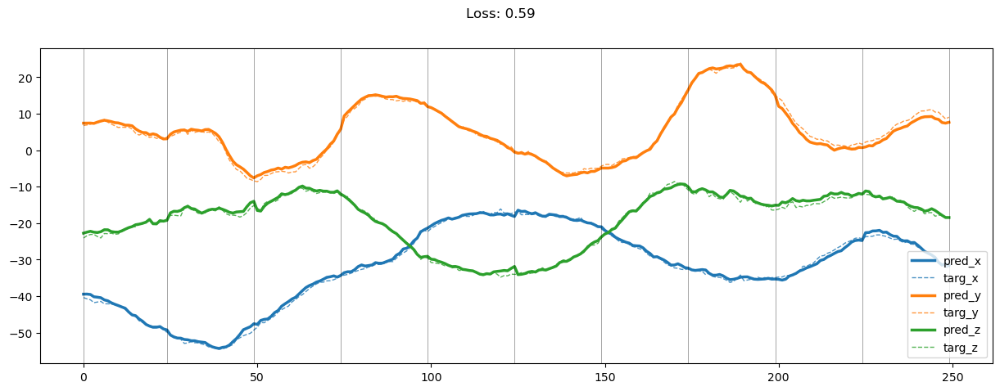

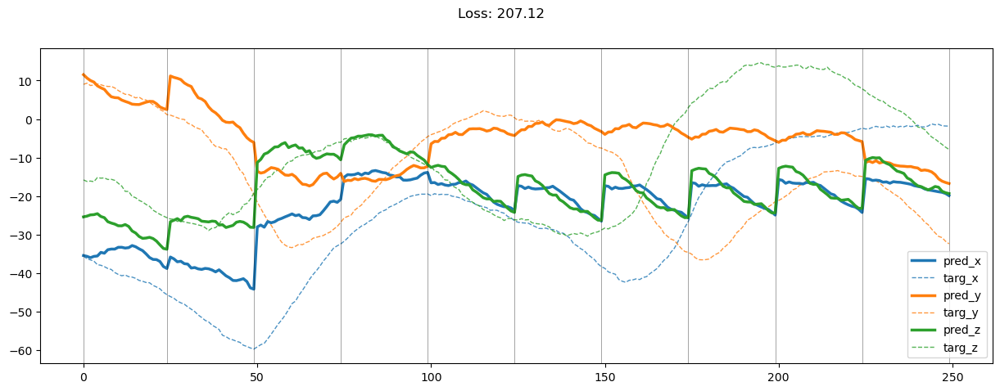

00499: train pred loss:  0.574, g loss:  2.102, diff loss:  1.127, d loss:  1.509
       valid pred loss:  168.929, g loss:  516.854, diff loss:  347.524, d loss:  1.511


100%|██████████| 17/17 [00:01<00:00, 15.06it/s]


00500: train pred loss:  0.620, g loss:  2.235, diff loss:  1.213, d loss:  1.508
       valid pred loss:  170.232, g loss:  524.032, diff loss:  353.399, d loss:  1.510


100%|██████████| 17/17 [00:01<00:00, 15.24it/s]


00501: train pred loss:  0.615, g loss:  2.202, diff loss:  1.185, d loss:  1.507
       valid pred loss:  170.611, g loss:  525.380, diff loss:  354.367, d loss:  1.509


100%|██████████| 17/17 [00:01<00:00, 14.64it/s]


00502: train pred loss:  0.622, g loss:  2.221, diff loss:  1.196, d loss:  1.505
       valid pred loss:  168.597, g loss:  517.428, diff loss:  348.428, d loss:  1.508


100%|██████████| 17/17 [00:01<00:00, 14.51it/s]


00503: train pred loss:  0.595, g loss:  2.162, diff loss:  1.162, d loss:  1.505
       valid pred loss:  169.580, g loss:  520.811, diff loss:  350.826, d loss:  1.506


100%|██████████| 17/17 [00:01<00:00, 14.84it/s]


00504: train pred loss:  0.582, g loss:  2.135, diff loss:  1.147, d loss:  1.503
       valid pred loss:  167.013, g loss:  516.688, diff loss:  349.268, d loss:  1.505


100%|██████████| 17/17 [00:01<00:00, 15.02it/s]


00505: train pred loss:  0.608, g loss:  2.219, diff loss:  1.203, d loss:  1.501
       valid pred loss:  168.840, g loss:  522.497, diff loss:  353.250, d loss:  1.503


100%|██████████| 17/17 [00:01<00:00, 15.07it/s]


00506: train pred loss:  0.618, g loss:  2.218, diff loss:  1.192, d loss:  1.500
       valid pred loss:  167.614, g loss:  523.464, diff loss:  355.441, d loss:  1.502


100%|██████████| 17/17 [00:01<00:00, 15.10it/s]


00507: train pred loss:  0.608, g loss:  2.204, diff loss:  1.186, d loss:  1.499
       valid pred loss:  169.682, g loss:  522.923, diff loss:  352.831, d loss:  1.501


100%|██████████| 17/17 [00:01<00:00, 14.89it/s]


00508: train pred loss:  0.607, g loss:  2.213, diff loss:  1.195, d loss:  1.498
       valid pred loss:  170.749, g loss:  530.497, diff loss:  359.337, d loss:  1.500


100%|██████████| 17/17 [00:01<00:00, 15.07it/s]


00509: train pred loss:  0.595, g loss:  2.169, diff loss:  1.162, d loss:  1.497
       valid pred loss:  169.487, g loss:  525.089, diff loss:  355.190, d loss:  1.499


100%|██████████| 17/17 [00:01<00:00, 14.20it/s]


00510: train pred loss:  0.584, g loss:  2.125, diff loss:  1.129, d loss:  1.497
       valid pred loss:  169.363, g loss:  521.880, diff loss:  352.104, d loss:  1.498


100%|██████████| 17/17 [00:01<00:00, 15.14it/s]


00511: train pred loss:  0.579, g loss:  2.113, diff loss:  1.120, d loss:  1.496
       valid pred loss:  168.414, g loss:  520.362, diff loss:  351.536, d loss:  1.498


100%|██████████| 17/17 [00:01<00:00, 15.07it/s]


00512: train pred loss:  0.595, g loss:  2.160, diff loss:  1.152, d loss:  1.496
       valid pred loss:  168.407, g loss:  523.276, diff loss:  354.456, d loss:  1.498


100%|██████████| 17/17 [00:01<00:00, 15.09it/s]


00513: train pred loss:  0.576, g loss:  2.114, diff loss:  1.124, d loss:  1.495
       valid pred loss:  169.470, g loss:  525.355, diff loss:  355.471, d loss:  1.498


100%|██████████| 17/17 [00:01<00:00, 15.13it/s]


00514: train pred loss:  0.574, g loss:  2.099, diff loss:  1.111, d loss:  1.495
       valid pred loss:  167.442, g loss:  521.227, diff loss:  353.371, d loss:  1.498


100%|██████████| 17/17 [00:01<00:00, 14.88it/s]


00515: train pred loss:  0.566, g loss:  2.092, diff loss:  1.113, d loss:  1.496
       valid pred loss:  169.403, g loss:  524.885, diff loss:  355.069, d loss:  1.498


100%|██████████| 17/17 [00:01<00:00, 14.89it/s]


00516: train pred loss:  0.581, g loss:  2.122, diff loss:  1.128, d loss:  1.496
       valid pred loss:  169.613, g loss:  527.843, diff loss:  357.818, d loss:  1.499


100%|██████████| 17/17 [00:01<00:00, 15.05it/s]


00517: train pred loss:  0.596, g loss:  2.172, diff loss:  1.163, d loss:  1.497
       valid pred loss:  168.719, g loss:  523.101, diff loss:  353.970, d loss:  1.499


100%|██████████| 17/17 [00:01<00:00, 15.03it/s]


00518: train pred loss:  0.604, g loss:  2.184, diff loss:  1.167, d loss:  1.498
       valid pred loss:  170.762, g loss:  532.042, diff loss:  360.869, d loss:  1.500


100%|██████████| 17/17 [00:01<00:00, 14.43it/s]


00519: train pred loss:  0.606, g loss:  2.218, diff loss:  1.201, d loss:  1.499
       valid pred loss:  172.514, g loss:  540.630, diff loss:  367.707, d loss:  1.502


100%|██████████| 17/17 [00:01<00:00, 15.12it/s]


00520: train pred loss:  0.571, g loss:  2.101, diff loss:  1.121, d loss:  1.500
       valid pred loss:  171.658, g loss:  536.102, diff loss:  364.036, d loss:  1.503


100%|██████████| 17/17 [00:01<00:00, 15.01it/s]


00521: train pred loss:  0.577, g loss:  2.118, diff loss:  1.133, d loss:  1.501
       valid pred loss:  170.784, g loss:  534.144, diff loss:  362.953, d loss:  1.504


100%|██████████| 17/17 [00:01<00:00, 14.04it/s]


00522: train pred loss:  0.580, g loss:  2.132, diff loss:  1.146, d loss:  1.502
       valid pred loss:  169.300, g loss:  525.873, diff loss:  356.168, d loss:  1.506


100%|██████████| 17/17 [00:01<00:00, 15.08it/s]


00523: train pred loss:  0.573, g loss:  2.082, diff loss:  1.104, d loss:  1.504
       valid pred loss:  170.549, g loss:  532.752, diff loss:  361.800, d loss:  1.507


100%|██████████| 17/17 [00:01<00:00, 14.86it/s]


00524: train pred loss:  0.564, g loss:  2.057, diff loss:  1.089, d loss:  1.505
       valid pred loss:  168.432, g loss:  530.154, diff loss:  361.319, d loss:  1.509


100%|██████████| 17/17 [00:01<00:00, 14.94it/s]


00525: train pred loss:  0.554, g loss:  2.043, diff loss:  1.086, d loss:  1.506
       valid pred loss:  171.932, g loss:  537.248, diff loss:  364.915, d loss:  1.510


100%|██████████| 17/17 [00:01<00:00, 14.99it/s]


00526: train pred loss:  0.558, g loss:  2.056, diff loss:  1.097, d loss:  1.508
       valid pred loss:  170.782, g loss:  533.259, diff loss:  362.077, d loss:  1.511


100%|██████████| 17/17 [00:01<00:00, 14.51it/s]


00527: train pred loss:  0.550, g loss:  2.031, diff loss:  1.081, d loss:  1.509
       valid pred loss:  170.321, g loss:  533.020, diff loss:  362.301, d loss:  1.512


100%|██████████| 17/17 [00:01<00:00, 14.05it/s]


00528: train pred loss:  0.568, g loss:  2.083, diff loss:  1.117, d loss:  1.510
       valid pred loss:  170.842, g loss:  527.847, diff loss:  356.607, d loss:  1.513


100%|██████████| 17/17 [00:01<00:00, 15.16it/s]


00529: train pred loss:  0.582, g loss:  2.124, diff loss:  1.143, d loss:  1.511
       valid pred loss:  172.881, g loss:  537.544, diff loss:  364.266, d loss:  1.514


100%|██████████| 17/17 [00:01<00:00, 15.16it/s]


00530: train pred loss:  0.601, g loss:  2.161, diff loss:  1.163, d loss:  1.512
       valid pred loss:  168.533, g loss:  521.398, diff loss:  352.468, d loss:  1.515


100%|██████████| 17/17 [00:01<00:00, 15.16it/s]


00531: train pred loss:  0.578, g loss:  2.107, diff loss:  1.132, d loss:  1.512
       valid pred loss:  169.784, g loss:  527.063, diff loss:  356.884, d loss:  1.515


100%|██████████| 17/17 [00:01<00:00, 15.10it/s]


00532: train pred loss:  0.559, g loss:  2.055, diff loss:  1.099, d loss:  1.512
       valid pred loss:  168.230, g loss:  520.520, diff loss:  351.893, d loss:  1.515


100%|██████████| 17/17 [00:01<00:00, 15.09it/s]


00533: train pred loss:  0.549, g loss:  2.037, diff loss:  1.091, d loss:  1.513
       valid pred loss:  171.705, g loss:  529.554, diff loss:  357.453, d loss:  1.516


100%|██████████| 17/17 [00:01<00:00, 15.06it/s]


00534: train pred loss:  0.549, g loss:  2.032, diff loss:  1.086, d loss:  1.512
       valid pred loss:  170.677, g loss:  527.189, diff loss:  356.115, d loss:  1.515


100%|██████████| 17/17 [00:01<00:00, 14.81it/s]


00535: train pred loss:  0.557, g loss:  2.037, diff loss:  1.083, d loss:  1.512
       valid pred loss:  169.274, g loss:  526.168, diff loss:  356.497, d loss:  1.514


100%|██████████| 17/17 [00:01<00:00, 15.16it/s]


00536: train pred loss:  0.554, g loss:  2.040, diff loss:  1.087, d loss:  1.511
       valid pred loss:  169.973, g loss:  524.430, diff loss:  354.060, d loss:  1.514


100%|██████████| 17/17 [00:01<00:00, 15.15it/s]


00537: train pred loss:  0.560, g loss:  2.056, diff loss:  1.097, d loss:  1.511
       valid pred loss:  172.078, g loss:  536.643, diff loss:  364.167, d loss:  1.512


100%|██████████| 17/17 [00:01<00:00, 15.19it/s]


00538: train pred loss:  0.584, g loss:  2.121, diff loss:  1.138, d loss:  1.509
       valid pred loss:  174.863, g loss:  542.578, diff loss:  367.315, d loss:  1.511


100%|██████████| 17/17 [00:01<00:00, 15.15it/s]


00539: train pred loss:  0.579, g loss:  2.100, diff loss:  1.120, d loss:  1.508
       valid pred loss:  175.703, g loss:  549.184, diff loss:  373.080, d loss:  1.510


100%|██████████| 17/17 [00:01<00:00, 15.17it/s]


00540: train pred loss:  0.570, g loss:  2.090, diff loss:  1.118, d loss:  1.507
       valid pred loss:  169.344, g loss:  527.162, diff loss:  357.415, d loss:  1.508


100%|██████████| 17/17 [00:01<00:00, 15.02it/s]


00541: train pred loss:  0.552, g loss:  2.042, diff loss:  1.086, d loss:  1.505
       valid pred loss:  173.403, g loss:  540.921, diff loss:  367.115, d loss:  1.507


100%|██████████| 17/17 [00:01<00:00, 15.10it/s]


00542: train pred loss:  0.577, g loss:  2.123, diff loss:  1.141, d loss:  1.504
       valid pred loss:  173.515, g loss:  539.160, diff loss:  365.240, d loss:  1.505


100%|██████████| 17/17 [00:01<00:00, 15.17it/s]


00543: train pred loss:  0.599, g loss:  2.180, diff loss:  1.174, d loss:  1.503
       valid pred loss:  174.468, g loss:  540.851, diff loss:  365.977, d loss:  1.506


100%|██████████| 17/17 [00:01<00:00, 15.13it/s]


00544: train pred loss:  0.583, g loss:  2.109, diff loss:  1.120, d loss:  1.503
       valid pred loss:  171.338, g loss:  533.092, diff loss:  361.350, d loss:  1.507


100%|██████████| 17/17 [00:01<00:00, 15.16it/s]


00545: train pred loss:  0.560, g loss:  2.052, diff loss:  1.087, d loss:  1.504
       valid pred loss:  171.986, g loss:  535.605, diff loss:  363.217, d loss:  1.510


100%|██████████| 17/17 [00:01<00:00, 15.19it/s]


00546: train pred loss:  0.553, g loss:  2.029, diff loss:  1.071, d loss:  1.505
       valid pred loss:  171.056, g loss:  537.313, diff loss:  365.856, d loss:  1.512


100%|██████████| 17/17 [00:01<00:00, 15.18it/s]


00547: train pred loss:  0.563, g loss:  2.065, diff loss:  1.097, d loss:  1.505
       valid pred loss:  167.787, g loss:  521.721, diff loss:  353.531, d loss:  1.511


100%|██████████| 17/17 [00:01<00:00, 15.21it/s]


00548: train pred loss:  0.560, g loss:  2.077, diff loss:  1.111, d loss:  1.503
       valid pred loss:  169.192, g loss:  526.209, diff loss:  356.613, d loss:  1.509


100%|██████████| 17/17 [00:01<00:00, 15.22it/s]


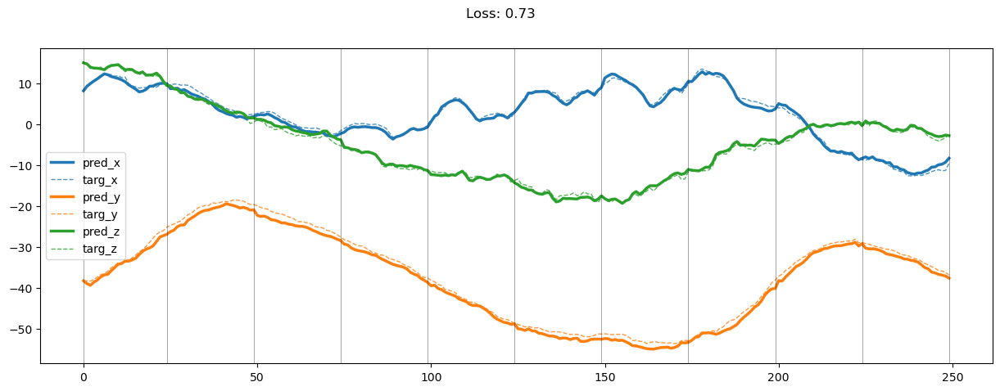

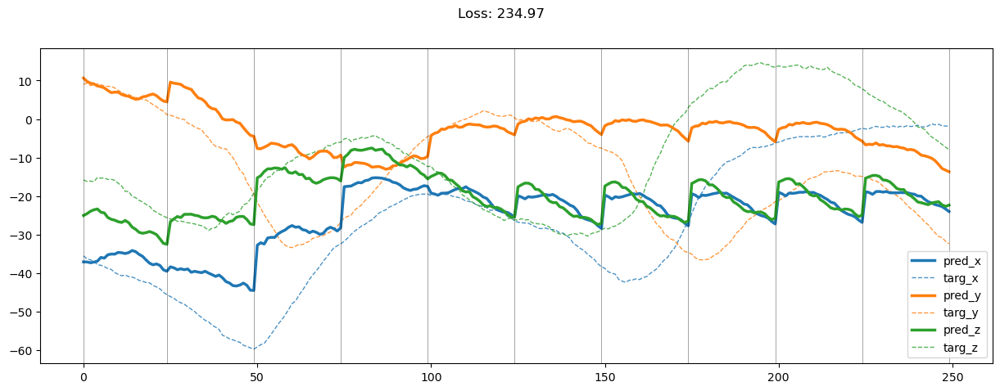

00549: train pred loss:  0.581, g loss:  2.127, diff loss:  1.138, d loss:  1.501
       valid pred loss:  172.468, g loss:  539.113, diff loss:  366.238, d loss:  1.506


100%|██████████| 17/17 [00:01<00:00, 14.99it/s]


00550: train pred loss:  0.613, g loss:  2.204, diff loss:  1.181, d loss:  1.499
       valid pred loss:  171.912, g loss:  534.695, diff loss:  362.374, d loss:  1.503


100%|██████████| 17/17 [00:01<00:00, 15.06it/s]


00551: train pred loss:  0.588, g loss:  2.138, diff loss:  1.138, d loss:  1.497
       valid pred loss:  171.142, g loss:  529.296, diff loss:  357.744, d loss:  1.503


100%|██████████| 17/17 [00:01<00:00, 14.57it/s]


00552: train pred loss:  0.590, g loss:  2.153, diff loss:  1.151, d loss:  1.497
       valid pred loss:  171.665, g loss:  539.214, diff loss:  367.139, d loss:  1.504


100%|██████████| 17/17 [00:01<00:00, 15.21it/s]


00553: train pred loss:  0.599, g loss:  2.172, diff loss:  1.162, d loss:  1.497
       valid pred loss:  168.218, g loss:  522.337, diff loss:  353.712, d loss:  1.506


100%|██████████| 17/17 [00:01<00:00, 14.50it/s]


00554: train pred loss:  0.640, g loss:  2.286, diff loss:  1.237, d loss:  1.500
       valid pred loss:  168.389, g loss:  525.633, diff loss:  356.838, d loss:  1.510


100%|██████████| 17/17 [00:01<00:00, 15.28it/s]


00555: train pred loss:  0.636, g loss:  2.299, diff loss:  1.256, d loss:  1.502
       valid pred loss:  172.982, g loss:  532.246, diff loss:  358.862, d loss:  1.514


100%|██████████| 17/17 [00:01<00:00, 15.27it/s]


00556: train pred loss:  0.621, g loss:  2.243, diff loss:  1.216, d loss:  1.504
       valid pred loss:  169.740, g loss:  520.723, diff loss:  350.582, d loss:  1.516


100%|██████████| 17/17 [00:01<00:00, 14.43it/s]


00557: train pred loss:  0.607, g loss:  2.201, diff loss:  1.189, d loss:  1.505
       valid pred loss:  167.260, g loss:  517.742, diff loss:  350.081, d loss:  1.516


100%|██████████| 17/17 [00:01<00:00, 14.80it/s]


00558: train pred loss:  0.621, g loss:  2.215, diff loss:  1.188, d loss:  1.504
       valid pred loss:  170.375, g loss:  525.582, diff loss:  354.807, d loss:  1.516


100%|██████████| 17/17 [00:01<00:00, 14.80it/s]


00559: train pred loss:  0.605, g loss:  2.174, diff loss:  1.162, d loss:  1.502
       valid pred loss:  170.916, g loss:  532.112, diff loss:  360.791, d loss:  1.511


100%|██████████| 17/17 [00:01<00:00, 15.22it/s]


00560: train pred loss:  0.599, g loss:  2.175, diff loss:  1.165, d loss:  1.498
       valid pred loss:  176.982, g loss:  549.173, diff loss:  371.782, d loss:  1.506


100%|██████████| 17/17 [00:01<00:00, 15.27it/s]


00561: train pred loss:  0.600, g loss:  2.185, diff loss:  1.170, d loss:  1.495
       valid pred loss:  175.248, g loss:  541.197, diff loss:  365.537, d loss:  1.502


100%|██████████| 17/17 [00:01<00:00, 15.26it/s]


00562: train pred loss:  0.606, g loss:  2.204, diff loss:  1.181, d loss:  1.492
       valid pred loss:  171.339, g loss:  529.786, diff loss:  358.031, d loss:  1.498


100%|██████████| 17/17 [00:01<00:00, 15.26it/s]


00563: train pred loss:  0.559, g loss:  2.076, diff loss:  1.099, d loss:  1.491
       valid pred loss:  173.014, g loss:  537.777, diff loss:  364.347, d loss:  1.499


100%|██████████| 17/17 [00:01<00:00, 15.22it/s]


00564: train pred loss:  0.589, g loss:  2.160, diff loss:  1.154, d loss:  1.492
       valid pred loss:  173.794, g loss:  536.542, diff loss:  362.335, d loss:  1.502


100%|██████████| 17/17 [00:01<00:00, 15.22it/s]


00565: train pred loss:  0.555, g loss:  2.070, diff loss:  1.102, d loss:  1.496
       valid pred loss:  174.616, g loss:  540.298, diff loss:  365.275, d loss:  1.509


100%|██████████| 17/17 [00:01<00:00, 15.25it/s]


00566: train pred loss:  0.561, g loss:  2.078, diff loss:  1.108, d loss:  1.501
       valid pred loss:  178.050, g loss:  550.520, diff loss:  372.070, d loss:  1.517


100%|██████████| 17/17 [00:01<00:00, 13.77it/s]


00567: train pred loss:  0.575, g loss:  2.095, diff loss:  1.118, d loss:  1.507
       valid pred loss:  171.704, g loss:  532.317, diff loss:  360.219, d loss:  1.525


100%|██████████| 17/17 [00:01<00:00, 14.50it/s]


00568: train pred loss:  0.588, g loss:  2.148, diff loss:  1.161, d loss:  1.510
       valid pred loss:  175.719, g loss:  546.913, diff loss:  370.802, d loss:  1.528


100%|██████████| 17/17 [00:01<00:00, 14.14it/s]


00569: train pred loss:  0.591, g loss:  2.132, diff loss:  1.142, d loss:  1.511
       valid pred loss:  169.688, g loss:  525.644, diff loss:  355.562, d loss:  1.525


100%|██████████| 17/17 [00:01<00:00, 14.84it/s]


00570: train pred loss:  0.577, g loss:  2.134, diff loss:  1.155, d loss:  1.508
       valid pred loss:  169.862, g loss:  526.807, diff loss:  356.545, d loss:  1.518


100%|██████████| 17/17 [00:01<00:00, 15.24it/s]


00571: train pred loss:  0.592, g loss:  2.154, diff loss:  1.155, d loss:  1.502
       valid pred loss:  172.429, g loss:  536.881, diff loss:  364.044, d loss:  1.507


100%|██████████| 17/17 [00:01<00:00, 15.25it/s]


00572: train pred loss:  0.578, g loss:  2.129, diff loss:  1.137, d loss:  1.495
       valid pred loss:  173.069, g loss:  537.777, diff loss:  364.292, d loss:  1.497


100%|██████████| 17/17 [00:01<00:00, 15.25it/s]


00573: train pred loss:  0.588, g loss:  2.156, diff loss:  1.148, d loss:  1.490
       valid pred loss:  173.400, g loss:  538.789, diff loss:  364.966, d loss:  1.490


100%|██████████| 17/17 [00:01<00:00, 15.25it/s]


00574: train pred loss:  0.596, g loss:  2.195, diff loss:  1.177, d loss:  1.488
       valid pred loss:  174.588, g loss:  547.790, diff loss:  372.781, d loss:  1.490


100%|██████████| 17/17 [00:01<00:00, 15.26it/s]


00575: train pred loss:  0.566, g loss:  2.117, diff loss:  1.130, d loss:  1.489
       valid pred loss:  169.928, g loss:  531.762, diff loss:  361.414, d loss:  1.492


100%|██████████| 17/17 [00:01<00:00, 15.25it/s]


00576: train pred loss:  0.551, g loss:  2.059, diff loss:  1.089, d loss:  1.491
       valid pred loss:  171.630, g loss:  529.253, diff loss:  357.205, d loss:  1.493


100%|██████████| 17/17 [00:01<00:00, 14.99it/s]


00577: train pred loss:  0.557, g loss:  2.078, diff loss:  1.104, d loss:  1.492
       valid pred loss:  172.402, g loss:  531.260, diff loss:  358.443, d loss:  1.495


100%|██████████| 17/17 [00:01<00:00, 13.75it/s]


00578: train pred loss:  0.571, g loss:  2.115, diff loss:  1.128, d loss:  1.495
       valid pred loss:  170.814, g loss:  526.509, diff loss:  355.282, d loss:  1.498


100%|██████████| 17/17 [00:01<00:00, 13.65it/s]


00579: train pred loss:  0.584, g loss:  2.152, diff loss:  1.155, d loss:  1.497
       valid pred loss:  170.237, g loss:  525.656, diff loss:  355.008, d loss:  1.500


100%|██████████| 17/17 [00:01<00:00, 14.49it/s]


00580: train pred loss:  0.611, g loss:  2.206, diff loss:  1.186, d loss:  1.500
       valid pred loss:  170.539, g loss:  525.504, diff loss:  354.558, d loss:  1.503


100%|██████████| 17/17 [00:01<00:00, 15.24it/s]


00581: train pred loss:  0.611, g loss:  2.209, diff loss:  1.191, d loss:  1.502
       valid pred loss:  171.436, g loss:  528.464, diff loss:  356.623, d loss:  1.506


100%|██████████| 17/17 [00:01<00:00, 14.23it/s]


00582: train pred loss:  0.591, g loss:  2.149, diff loss:  1.154, d loss:  1.505
       valid pred loss:  170.669, g loss:  524.535, diff loss:  353.463, d loss:  1.508


100%|██████████| 17/17 [00:01<00:00, 13.85it/s]


00583: train pred loss:  0.602, g loss:  2.159, diff loss:  1.155, d loss:  1.508
       valid pred loss:  167.458, g loss:  514.516, diff loss:  346.658, d loss:  1.511


100%|██████████| 17/17 [00:01<00:00, 14.55it/s]


00584: train pred loss:  0.595, g loss:  2.154, diff loss:  1.160, d loss:  1.510
       valid pred loss:  167.284, g loss:  521.836, diff loss:  354.154, d loss:  1.514


100%|██████████| 17/17 [00:01<00:00, 15.07it/s]


00585: train pred loss:  0.594, g loss:  2.157, diff loss:  1.165, d loss:  1.512
       valid pred loss:  168.889, g loss:  521.256, diff loss:  351.972, d loss:  1.516


100%|██████████| 17/17 [00:01<00:00, 14.05it/s]


00586: train pred loss:  0.568, g loss:  2.078, diff loss:  1.114, d loss:  1.515
       valid pred loss:  167.956, g loss:  520.960, diff loss:  352.611, d loss:  1.518


100%|██████████| 17/17 [00:01<00:00, 15.21it/s]


00587: train pred loss:  0.555, g loss:  2.037, diff loss:  1.089, d loss:  1.517
       valid pred loss:  171.379, g loss:  531.376, diff loss:  359.606, d loss:  1.520


100%|██████████| 17/17 [00:01<00:00, 15.02it/s]


00588: train pred loss:  0.588, g loss:  2.141, diff loss:  1.161, d loss:  1.518
       valid pred loss:  168.375, g loss:  520.905, diff loss:  352.140, d loss:  1.522


100%|██████████| 17/17 [00:01<00:00, 15.21it/s]


00589: train pred loss:  0.588, g loss:  2.137, diff loss:  1.159, d loss:  1.519
       valid pred loss:  169.642, g loss:  525.916, diff loss:  355.885, d loss:  1.523


100%|██████████| 17/17 [00:01<00:00, 15.19it/s]


00590: train pred loss:  0.571, g loss:  2.079, diff loss:  1.118, d loss:  1.520
       valid pred loss:  171.752, g loss:  534.877, diff loss:  362.736, d loss:  1.524


100%|██████████| 17/17 [00:01<00:00, 14.91it/s]


00591: train pred loss:  0.579, g loss:  2.096, diff loss:  1.128, d loss:  1.521
       valid pred loss:  174.041, g loss:  543.570, diff loss:  369.140, d loss:  1.524


100%|██████████| 17/17 [00:01<00:00, 13.90it/s]


00592: train pred loss:  0.554, g loss:  2.037, diff loss:  1.094, d loss:  1.521
       valid pred loss:  169.912, g loss:  530.860, diff loss:  360.560, d loss:  1.524


100%|██████████| 17/17 [00:01<00:00, 14.43it/s]


00593: train pred loss:  0.563, g loss:  2.043, diff loss:  1.090, d loss:  1.521
       valid pred loss:  169.168, g loss:  526.836, diff loss:  357.280, d loss:  1.524


100%|██████████| 17/17 [00:01<00:00, 14.93it/s]


00594: train pred loss:  0.563, g loss:  2.048, diff loss:  1.095, d loss:  1.520
       valid pred loss:  172.159, g loss:  536.497, diff loss:  363.949, d loss:  1.523


100%|██████████| 17/17 [00:01<00:00, 15.25it/s]


00595: train pred loss:  0.569, g loss:  2.079, diff loss:  1.119, d loss:  1.519
       valid pred loss:  170.001, g loss:  531.939, diff loss:  361.548, d loss:  1.521


100%|██████████| 17/17 [00:01<00:00, 15.27it/s]


00596: train pred loss:  0.582, g loss:  2.115, diff loss:  1.141, d loss:  1.517
       valid pred loss:  170.423, g loss:  533.548, diff loss:  362.733, d loss:  1.520


100%|██████████| 17/17 [00:01<00:00, 15.30it/s]


00597: train pred loss:  0.561, g loss:  2.051, diff loss:  1.095, d loss:  1.515
       valid pred loss:  168.749, g loss:  524.515, diff loss:  355.372, d loss:  1.517


100%|██████████| 17/17 [00:01<00:00, 15.28it/s]


00598: train pred loss:  0.572, g loss:  2.098, diff loss:  1.131, d loss:  1.513
       valid pred loss:  166.976, g loss:  520.724, diff loss:  353.351, d loss:  1.515


100%|██████████| 17/17 [00:01<00:00, 15.27it/s]


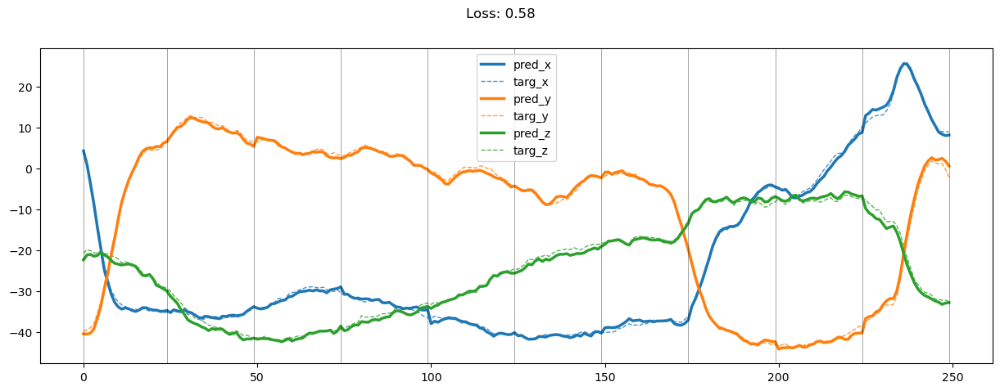

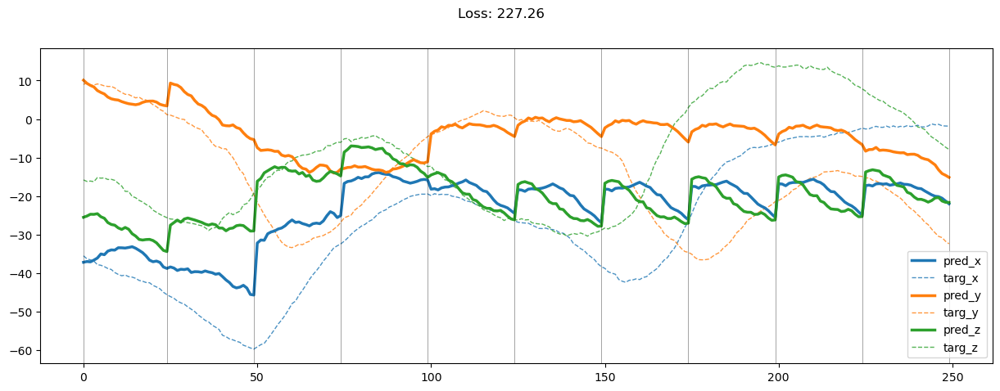

00599: train pred loss:  0.559, g loss:  2.061, diff loss:  1.103, d loss:  1.511
       valid pred loss:  167.212, g loss:  523.340, diff loss:  355.729, d loss:  1.513


100%|██████████| 17/17 [00:01<00:00, 15.25it/s]


00600: train pred loss:  0.548, g loss:  2.028, diff loss:  1.080, d loss:  1.509
       valid pred loss:  169.823, g loss:  522.520, diff loss:  352.296, d loss:  1.510


100%|██████████| 17/17 [00:01<00:00, 15.29it/s]


00601: train pred loss:  0.565, g loss:  2.074, diff loss:  1.106, d loss:  1.506
       valid pred loss:  166.561, g loss:  509.983, diff loss:  343.018, d loss:  1.508


100%|██████████| 17/17 [00:01<00:00, 14.70it/s]


00602: train pred loss:  0.548, g loss:  2.034, diff loss:  1.080, d loss:  1.503
       valid pred loss:  170.556, g loss:  529.123, diff loss:  358.160, d loss:  1.505


100%|██████████| 17/17 [00:01<00:00, 15.20it/s]


00603: train pred loss:  0.536, g loss:  2.018, diff loss:  1.073, d loss:  1.502
       valid pred loss:  168.619, g loss:  522.248, diff loss:  353.220, d loss:  1.502


100%|██████████| 17/17 [00:01<00:00, 14.69it/s]


00604: train pred loss:  0.553, g loss:  2.059, diff loss:  1.095, d loss:  1.498
       valid pred loss:  170.284, g loss:  525.046, diff loss:  354.350, d loss:  1.500


100%|██████████| 17/17 [00:01<00:00, 14.44it/s]


00605: train pred loss:  0.586, g loss:  2.141, diff loss:  1.142, d loss:  1.496
       valid pred loss:  170.826, g loss:  526.029, diff loss:  354.789, d loss:  1.497


100%|██████████| 17/17 [00:01<00:00, 14.73it/s]


00606: train pred loss:  0.592, g loss:  2.159, diff loss:  1.151, d loss:  1.494
       valid pred loss:  168.271, g loss:  516.618, diff loss:  347.930, d loss:  1.495


100%|██████████| 17/17 [00:01<00:00, 15.27it/s]


00607: train pred loss:  0.567, g loss:  2.082, diff loss:  1.098, d loss:  1.492
       valid pred loss:  171.599, g loss:  527.813, diff loss:  355.797, d loss:  1.494


100%|██████████| 17/17 [00:01<00:00, 15.27it/s]


00608: train pred loss:  0.571, g loss:  2.116, diff loss:  1.126, d loss:  1.491
       valid pred loss:  169.715, g loss:  523.784, diff loss:  353.650, d loss:  1.492


100%|██████████| 17/17 [00:01<00:00, 15.28it/s]


00609: train pred loss:  0.625, g loss:  2.264, diff loss:  1.218, d loss:  1.489
       valid pred loss:  166.193, g loss:  514.379, diff loss:  347.765, d loss:  1.491


100%|██████████| 17/17 [00:01<00:00, 15.15it/s]


00610: train pred loss:  0.637, g loss:  2.323, diff loss:  1.264, d loss:  1.488
       valid pred loss:  170.554, g loss:  528.228, diff loss:  357.252, d loss:  1.490


100%|██████████| 17/17 [00:01<00:00, 15.06it/s]


00611: train pred loss:  0.612, g loss:  2.252, diff loss:  1.217, d loss:  1.487
       valid pred loss:  170.271, g loss:  525.901, diff loss:  355.208, d loss:  1.489


100%|██████████| 17/17 [00:01<00:00, 15.24it/s]


00612: train pred loss:  0.585, g loss:  2.170, diff loss:  1.162, d loss:  1.487
       valid pred loss:  172.489, g loss:  531.961, diff loss:  359.049, d loss:  1.489


100%|██████████| 17/17 [00:01<00:00, 15.25it/s]


00613: train pred loss:  0.603, g loss:  2.204, diff loss:  1.179, d loss:  1.487
       valid pred loss:  170.102, g loss:  523.777, diff loss:  353.252, d loss:  1.490


100%|██████████| 17/17 [00:01<00:00, 14.74it/s]


00614: train pred loss:  0.586, g loss:  2.144, diff loss:  1.136, d loss:  1.488
       valid pred loss:  170.728, g loss:  525.646, diff loss:  354.497, d loss:  1.490


100%|██████████| 17/17 [00:01<00:00, 15.22it/s]


00615: train pred loss:  0.576, g loss:  2.119, diff loss:  1.122, d loss:  1.489
       valid pred loss:  171.306, g loss:  531.995, diff loss:  360.268, d loss:  1.491


100%|██████████| 17/17 [00:01<00:00, 15.22it/s]


00616: train pred loss:  0.555, g loss:  2.062, diff loss:  1.088, d loss:  1.490
       valid pred loss:  170.108, g loss:  530.801, diff loss:  360.274, d loss:  1.493


100%|██████████| 17/17 [00:01<00:00, 15.11it/s]


00617: train pred loss:  0.561, g loss:  2.071, diff loss:  1.091, d loss:  1.491
       valid pred loss:  169.165, g loss:  526.662, diff loss:  357.080, d loss:  1.495


100%|██████████| 17/17 [00:01<00:00, 14.33it/s]


00618: train pred loss:  0.563, g loss:  2.097, diff loss:  1.118, d loss:  1.494
       valid pred loss:  167.043, g loss:  517.415, diff loss:  349.958, d loss:  1.497


100%|██████████| 17/17 [00:01<00:00, 15.25it/s]


00619: train pred loss:  0.550, g loss:  2.038, diff loss:  1.074, d loss:  1.495
       valid pred loss:  169.355, g loss:  520.513, diff loss:  350.746, d loss:  1.499


100%|██████████| 17/17 [00:01<00:00, 15.25it/s]


00620: train pred loss:  0.549, g loss:  2.035, diff loss:  1.074, d loss:  1.498
       valid pred loss:  168.405, g loss:  516.230, diff loss:  347.415, d loss:  1.501


100%|██████████| 17/17 [00:01<00:00, 15.25it/s]


00621: train pred loss:  0.547, g loss:  2.054, diff loss:  1.097, d loss:  1.500
       valid pred loss:  170.867, g loss:  526.619, diff loss:  355.345, d loss:  1.504


100%|██████████| 17/17 [00:01<00:00, 14.56it/s]


00622: train pred loss:  0.586, g loss:  2.123, diff loss:  1.130, d loss:  1.503
       valid pred loss:  168.650, g loss:  517.563, diff loss:  348.508, d loss:  1.507


100%|██████████| 17/17 [00:01<00:00, 15.14it/s]


00623: train pred loss:  0.563, g loss:  2.073, diff loss:  1.105, d loss:  1.505
       valid pred loss:  169.197, g loss:  517.714, diff loss:  348.115, d loss:  1.509


100%|██████████| 17/17 [00:01<00:00, 15.15it/s]


00624: train pred loss:  0.578, g loss:  2.097, diff loss:  1.117, d loss:  1.508
       valid pred loss:  170.163, g loss:  526.285, diff loss:  355.722, d loss:  1.512


100%|██████████| 17/17 [00:01<00:00, 15.15it/s]


00625: train pred loss:  0.619, g loss:  2.215, diff loss:  1.196, d loss:  1.510
       valid pred loss:  167.914, g loss:  520.369, diff loss:  352.056, d loss:  1.514


100%|██████████| 17/17 [00:01<00:00, 15.15it/s]


00626: train pred loss:  0.606, g loss:  2.152, diff loss:  1.149, d loss:  1.512
       valid pred loss:  169.342, g loss:  525.198, diff loss:  355.460, d loss:  1.516


100%|██████████| 17/17 [00:01<00:00, 13.70it/s]


00627: train pred loss:  0.552, g loss:  2.022, diff loss:  1.074, d loss:  1.515
       valid pred loss:  168.623, g loss:  525.950, diff loss:  356.933, d loss:  1.518


100%|██████████| 17/17 [00:01<00:00, 13.83it/s]


00628: train pred loss:  0.550, g loss:  2.028, diff loss:  1.084, d loss:  1.517
       valid pred loss:  169.897, g loss:  530.624, diff loss:  360.335, d loss:  1.520


100%|██████████| 17/17 [00:01<00:00, 15.20it/s]


00629: train pred loss:  0.559, g loss:  2.038, diff loss:  1.087, d loss:  1.518
       valid pred loss:  170.274, g loss:  528.171, diff loss:  357.506, d loss:  1.521


100%|██████████| 17/17 [00:01<00:00, 15.19it/s]


00630: train pred loss:  0.568, g loss:  2.069, diff loss:  1.111, d loss:  1.519
       valid pred loss:  170.060, g loss:  529.647, diff loss:  359.197, d loss:  1.523


100%|██████████| 17/17 [00:01<00:00, 14.49it/s]


00631: train pred loss:  0.564, g loss:  2.070, diff loss:  1.117, d loss:  1.520
       valid pred loss:  168.126, g loss:  523.657, diff loss:  355.142, d loss:  1.523


100%|██████████| 17/17 [00:01<00:00, 15.04it/s]


00632: train pred loss:  0.571, g loss:  2.093, diff loss:  1.133, d loss:  1.521
       valid pred loss:  171.336, g loss:  532.008, diff loss:  360.284, d loss:  1.524


100%|██████████| 17/17 [00:01<00:00, 15.17it/s]


00633: train pred loss:  0.580, g loss:  2.116, diff loss:  1.147, d loss:  1.521
       valid pred loss:  171.843, g loss:  532.179, diff loss:  359.948, d loss:  1.525


100%|██████████| 17/17 [00:01<00:00, 15.15it/s]


00634: train pred loss:  0.568, g loss:  2.086, diff loss:  1.129, d loss:  1.522
       valid pred loss:  169.531, g loss:  526.914, diff loss:  356.994, d loss:  1.524


100%|██████████| 17/17 [00:01<00:00, 15.19it/s]


00635: train pred loss:  0.574, g loss:  2.085, diff loss:  1.122, d loss:  1.521
       valid pred loss:  169.916, g loss:  528.190, diff loss:  357.886, d loss:  1.524


100%|██████████| 17/17 [00:01<00:00, 15.14it/s]


00636: train pred loss:  0.540, g loss:  2.008, diff loss:  1.078, d loss:  1.520
       valid pred loss:  167.782, g loss:  523.520, diff loss:  355.349, d loss:  1.522


100%|██████████| 17/17 [00:01<00:00, 15.13it/s]


00637: train pred loss:  0.560, g loss:  2.037, diff loss:  1.086, d loss:  1.519
       valid pred loss:  166.266, g loss:  515.046, diff loss:  348.389, d loss:  1.521


100%|██████████| 17/17 [00:01<00:00, 15.19it/s]


00638: train pred loss:  0.568, g loss:  2.062, diff loss:  1.102, d loss:  1.518
       valid pred loss:  171.352, g loss:  528.806, diff loss:  357.061, d loss:  1.520


100%|██████████| 17/17 [00:01<00:00, 15.15it/s]


00639: train pred loss:  0.554, g loss:  2.045, diff loss:  1.097, d loss:  1.515
       valid pred loss:  167.694, g loss:  523.407, diff loss:  355.319, d loss:  1.518


100%|██████████| 17/17 [00:01<00:00, 15.11it/s]


00640: train pred loss:  0.530, g loss:  1.981, diff loss:  1.055, d loss:  1.513
       valid pred loss:  168.246, g loss:  520.096, diff loss:  351.453, d loss:  1.515


100%|██████████| 17/17 [00:01<00:00, 15.11it/s]


00641: train pred loss:  0.529, g loss:  1.967, diff loss:  1.039, d loss:  1.511
       valid pred loss:  169.911, g loss:  527.863, diff loss:  357.553, d loss:  1.513


100%|██████████| 17/17 [00:01<00:00, 15.05it/s]


00642: train pred loss:  0.515, g loss:  1.925, diff loss:  1.009, d loss:  1.508
       valid pred loss:  169.804, g loss:  524.639, diff loss:  354.433, d loss:  1.510


100%|██████████| 17/17 [00:01<00:00, 15.09it/s]


00643: train pred loss:  0.517, g loss:  1.941, diff loss:  1.021, d loss:  1.506
       valid pred loss:  168.013, g loss:  516.063, diff loss:  347.645, d loss:  1.507


100%|██████████| 17/17 [00:01<00:00, 15.14it/s]


00644: train pred loss:  0.533, g loss:  1.977, diff loss:  1.038, d loss:  1.503
       valid pred loss:  168.878, g loss:  520.721, diff loss:  351.437, d loss:  1.505


100%|██████████| 17/17 [00:01<00:00, 15.10it/s]


00645: train pred loss:  0.517, g loss:  1.949, diff loss:  1.023, d loss:  1.500
       valid pred loss:  171.000, g loss:  526.213, diff loss:  354.804, d loss:  1.503


100%|██████████| 17/17 [00:01<00:00, 15.05it/s]


00646: train pred loss:  0.527, g loss:  1.981, diff loss:  1.043, d loss:  1.498
       valid pred loss:  169.224, g loss:  526.473, diff loss:  356.837, d loss:  1.500


100%|██████████| 17/17 [00:01<00:00, 14.71it/s]


00647: train pred loss:  0.554, g loss:  2.047, diff loss:  1.080, d loss:  1.496
       valid pred loss:  170.837, g loss:  530.243, diff loss:  358.991, d loss:  1.497


100%|██████████| 17/17 [00:01<00:00, 14.64it/s]


00648: train pred loss:  0.551, g loss:  2.037, diff loss:  1.070, d loss:  1.494
       valid pred loss:  170.209, g loss:  528.318, diff loss:  357.693, d loss:  1.496


100%|██████████| 17/17 [00:01<00:00, 15.21it/s]


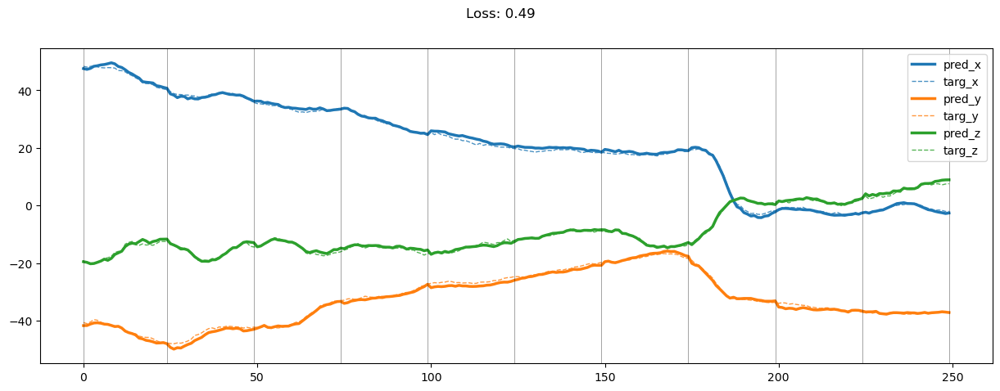

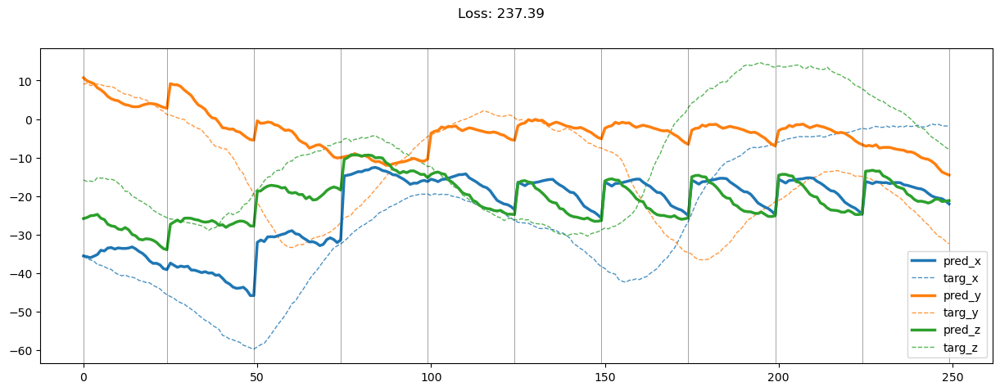

00649: train pred loss:  0.553, g loss:  2.054, diff loss:  1.083, d loss:  1.492
       valid pred loss:  174.071, g loss:  537.411, diff loss:  362.921, d loss:  1.493


100%|██████████| 17/17 [00:01<00:00, 14.16it/s]


00650: train pred loss:  0.565, g loss:  2.110, diff loss:  1.125, d loss:  1.490
       valid pred loss:  171.356, g loss:  528.878, diff loss:  357.102, d loss:  1.492


100%|██████████| 17/17 [00:01<00:00, 15.23it/s]


00651: train pred loss:  0.541, g loss:  2.026, diff loss:  1.064, d loss:  1.489
       valid pred loss:  171.697, g loss:  531.458, diff loss:  359.340, d loss:  1.491


100%|██████████| 17/17 [00:01<00:00, 15.13it/s]


00652: train pred loss:  0.543, g loss:  2.043, diff loss:  1.077, d loss:  1.488
       valid pred loss:  168.933, g loss:  526.666, diff loss:  357.311, d loss:  1.489


100%|██████████| 17/17 [00:01<00:00, 15.18it/s]


00653: train pred loss:  0.554, g loss:  2.075, diff loss:  1.098, d loss:  1.487
       valid pred loss:  170.784, g loss:  527.861, diff loss:  356.653, d loss:  1.489


100%|██████████| 17/17 [00:01<00:00, 15.11it/s]


00654: train pred loss:  0.560, g loss:  2.090, diff loss:  1.107, d loss:  1.486
       valid pred loss:  168.149, g loss:  522.833, diff loss:  354.260, d loss:  1.489


100%|██████████| 17/17 [00:01<00:00, 13.81it/s]


00655: train pred loss:  0.554, g loss:  2.058, diff loss:  1.081, d loss:  1.486
       valid pred loss:  169.496, g loss:  524.849, diff loss:  354.930, d loss:  1.489


100%|██████████| 17/17 [00:01<00:00, 14.50it/s]


00656: train pred loss:  0.549, g loss:  2.062, diff loss:  1.089, d loss:  1.486
       valid pred loss:  172.061, g loss:  531.020, diff loss:  358.536, d loss:  1.489


100%|██████████| 17/17 [00:01<00:00, 14.86it/s]


00657: train pred loss:  0.554, g loss:  2.072, diff loss:  1.095, d loss:  1.488
       valid pred loss:  174.344, g loss:  539.909, diff loss:  365.143, d loss:  1.490


100%|██████████| 17/17 [00:01<00:00, 14.58it/s]


00658: train pred loss:  0.541, g loss:  2.028, diff loss:  1.064, d loss:  1.488
       valid pred loss:  172.461, g loss:  531.868, diff loss:  358.987, d loss:  1.492


100%|██████████| 17/17 [00:01<00:00, 14.03it/s]


00659: train pred loss:  0.532, g loss:  2.004, diff loss:  1.051, d loss:  1.490
       valid pred loss:  173.303, g loss:  535.044, diff loss:  361.322, d loss:  1.493


100%|██████████| 17/17 [00:01<00:00, 15.14it/s]


00660: train pred loss:  0.538, g loss:  2.013, diff loss:  1.057, d loss:  1.492
       valid pred loss:  173.904, g loss:  538.326, diff loss:  364.005, d loss:  1.495


100%|██████████| 17/17 [00:01<00:00, 14.88it/s]


00661: train pred loss:  0.544, g loss:  2.014, diff loss:  1.054, d loss:  1.494
       valid pred loss:  174.531, g loss:  538.822, diff loss:  363.876, d loss:  1.498


100%|██████████| 17/17 [00:01<00:00, 14.91it/s]


00662: train pred loss:  0.537, g loss:  1.991, diff loss:  1.041, d loss:  1.496
       valid pred loss:  173.602, g loss:  540.681, diff loss:  366.668, d loss:  1.500


100%|██████████| 17/17 [00:01<00:00, 15.14it/s]


00663: train pred loss:  0.548, g loss:  2.038, diff loss:  1.079, d loss:  1.498
       valid pred loss:  172.385, g loss:  532.664, diff loss:  359.869, d loss:  1.502


100%|██████████| 17/17 [00:01<00:00, 15.14it/s]


00664: train pred loss:  0.551, g loss:  2.044, diff loss:  1.084, d loss:  1.500
       valid pred loss:  174.435, g loss:  546.142, diff loss:  371.299, d loss:  1.505


100%|██████████| 17/17 [00:01<00:00, 15.13it/s]


00665: train pred loss:  0.599, g loss:  2.175, diff loss:  1.170, d loss:  1.503
       valid pred loss:  173.669, g loss:  545.001, diff loss:  370.928, d loss:  1.508


100%|██████████| 17/17 [00:01<00:00, 15.17it/s]


00666: train pred loss:  0.593, g loss:  2.159, diff loss:  1.162, d loss:  1.506
       valid pred loss:  177.035, g loss:  547.314, diff loss:  369.877, d loss:  1.510


100%|██████████| 17/17 [00:01<00:00, 15.17it/s]


00667: train pred loss:  0.577, g loss:  2.117, diff loss:  1.139, d loss:  1.508
       valid pred loss:  171.888, g loss:  529.093, diff loss:  356.807, d loss:  1.513


100%|██████████| 17/17 [00:01<00:00, 15.11it/s]


00668: train pred loss:  0.564, g loss:  2.066, diff loss:  1.103, d loss:  1.510
       valid pred loss:  170.175, g loss:  524.709, diff loss:  354.137, d loss:  1.515


100%|██████████| 17/17 [00:01<00:00, 15.16it/s]


00669: train pred loss:  0.546, g loss:  2.010, diff loss:  1.068, d loss:  1.513
       valid pred loss:  173.539, g loss:  542.534, diff loss:  368.601, d loss:  1.518


100%|██████████| 17/17 [00:01<00:00, 15.12it/s]


00670: train pred loss:  0.552, g loss:  2.013, diff loss:  1.066, d loss:  1.515
       valid pred loss:  170.706, g loss:  529.452, diff loss:  358.353, d loss:  1.520


100%|██████████| 17/17 [00:01<00:00, 14.81it/s]


00671: train pred loss:  0.548, g loss:  1.993, diff loss:  1.052, d loss:  1.517
       valid pred loss:  172.153, g loss:  533.249, diff loss:  360.705, d loss:  1.522


100%|██████████| 17/17 [00:01<00:00, 15.15it/s]


00672: train pred loss:  0.535, g loss:  1.983, diff loss:  1.056, d loss:  1.519
       valid pred loss:  174.523, g loss:  543.540, diff loss:  368.628, d loss:  1.523


100%|██████████| 17/17 [00:01<00:00, 15.18it/s]


00673: train pred loss:  0.539, g loss:  1.997, diff loss:  1.068, d loss:  1.520
       valid pred loss:  173.107, g loss:  537.013, diff loss:  363.518, d loss:  1.525


100%|██████████| 17/17 [00:01<00:00, 14.63it/s]


00674: train pred loss:  0.533, g loss:  1.969, diff loss:  1.047, d loss:  1.521
       valid pred loss:  172.328, g loss:  532.541, diff loss:  359.825, d loss:  1.525


100%|██████████| 17/17 [00:01<00:00, 14.81it/s]


00675: train pred loss:  0.534, g loss:  1.956, diff loss:  1.034, d loss:  1.522
       valid pred loss:  170.240, g loss:  522.529, diff loss:  351.902, d loss:  1.525


100%|██████████| 17/17 [00:01<00:00, 15.06it/s]


00676: train pred loss:  0.531, g loss:  1.976, diff loss:  1.057, d loss:  1.522
       valid pred loss:  172.313, g loss:  531.226, diff loss:  358.525, d loss:  1.526


100%|██████████| 17/17 [00:01<00:00, 13.63it/s]


00677: train pred loss:  0.527, g loss:  1.950, diff loss:  1.035, d loss:  1.522
       valid pred loss:  170.537, g loss:  528.032, diff loss:  357.108, d loss:  1.525


100%|██████████| 17/17 [00:01<00:00, 15.16it/s]


00678: train pred loss:  0.568, g loss:  2.076, diff loss:  1.119, d loss:  1.521
       valid pred loss:  171.530, g loss:  532.504, diff loss:  360.586, d loss:  1.526


100%|██████████| 17/17 [00:01<00:00, 15.17it/s]


00679: train pred loss:  0.704, g loss:  2.392, diff loss:  1.299, d loss:  1.521
       valid pred loss:  175.361, g loss:  544.384, diff loss:  368.634, d loss:  1.524


100%|██████████| 17/17 [00:01<00:00, 15.12it/s]


00680: train pred loss:  0.639, g loss:  2.251, diff loss:  1.221, d loss:  1.520
       valid pred loss:  173.900, g loss:  536.689, diff loss:  362.399, d loss:  1.522


100%|██████████| 17/17 [00:01<00:00, 15.19it/s]


00681: train pred loss:  0.588, g loss:  2.118, diff loss:  1.138, d loss:  1.518
       valid pred loss:  173.254, g loss:  534.317, diff loss:  360.671, d loss:  1.521


100%|██████████| 17/17 [00:01<00:00, 15.19it/s]


00682: train pred loss:  0.549, g loss:  2.017, diff loss:  1.074, d loss:  1.516
       valid pred loss:  168.252, g loss:  520.773, diff loss:  352.127, d loss:  1.519


100%|██████████| 17/17 [00:01<00:00, 15.18it/s]


00683: train pred loss:  0.545, g loss:  2.034, diff loss:  1.093, d loss:  1.514
       valid pred loss:  171.064, g loss:  529.827, diff loss:  358.367, d loss:  1.517


100%|██████████| 17/17 [00:01<00:00, 15.18it/s]


00684: train pred loss:  0.545, g loss:  2.024, diff loss:  1.082, d loss:  1.512
       valid pred loss:  169.715, g loss:  529.675, diff loss:  359.562, d loss:  1.513


100%|██████████| 17/17 [00:01<00:00, 15.16it/s]


00685: train pred loss:  0.540, g loss:  1.999, diff loss:  1.059, d loss:  1.509
       valid pred loss:  172.899, g loss:  535.233, diff loss:  361.934, d loss:  1.511


100%|██████████| 17/17 [00:01<00:00, 15.19it/s]


00686: train pred loss:  0.546, g loss:  2.030, diff loss:  1.081, d loss:  1.507
       valid pred loss:  174.405, g loss:  539.026, diff loss:  364.218, d loss:  1.508


100%|██████████| 17/17 [00:01<00:00, 15.12it/s]


00687: train pred loss:  0.552, g loss:  2.019, diff loss:  1.062, d loss:  1.505
       valid pred loss:  173.354, g loss:  535.103, diff loss:  361.343, d loss:  1.505


100%|██████████| 17/17 [00:01<00:00, 15.07it/s]


00688: train pred loss:  0.539, g loss:  1.982, diff loss:  1.036, d loss:  1.502
       valid pred loss:  172.223, g loss:  537.241, diff loss:  364.610, d loss:  1.503


100%|██████████| 17/17 [00:01<00:00, 14.75it/s]


00689: train pred loss:  0.549, g loss:  2.034, diff loss:  1.075, d loss:  1.500
       valid pred loss:  171.598, g loss:  532.004, diff loss:  359.995, d loss:  1.501


100%|██████████| 17/17 [00:01<00:00, 14.67it/s]


00690: train pred loss:  0.535, g loss:  2.009, diff loss:  1.062, d loss:  1.497
       valid pred loss:  172.542, g loss:  537.803, diff loss:  364.848, d loss:  1.498


100%|██████████| 17/17 [00:01<00:00, 14.57it/s]


00691: train pred loss:  0.526, g loss:  1.964, diff loss:  1.022, d loss:  1.494
       valid pred loss:  170.541, g loss:  529.113, diff loss:  358.157, d loss:  1.496


100%|██████████| 17/17 [00:01<00:00, 15.21it/s]


00692: train pred loss:  0.515, g loss:  1.953, diff loss:  1.020, d loss:  1.493
       valid pred loss:  173.519, g loss:  539.849, diff loss:  365.912, d loss:  1.494


100%|██████████| 17/17 [00:01<00:00, 15.23it/s]


00693: train pred loss:  0.527, g loss:  1.972, diff loss:  1.026, d loss:  1.491
       valid pred loss:  170.613, g loss:  531.951, diff loss:  360.918, d loss:  1.491


100%|██████████| 17/17 [00:01<00:00, 15.12it/s]


00694: train pred loss:  0.514, g loss:  1.939, diff loss:  1.005, d loss:  1.489
       valid pred loss:  171.901, g loss:  535.250, diff loss:  362.928, d loss:  1.490


100%|██████████| 17/17 [00:01<00:00, 13.94it/s]


00695: train pred loss:  0.504, g loss:  1.916, diff loss:  0.990, d loss:  1.488
       valid pred loss:  169.678, g loss:  529.453, diff loss:  359.352, d loss:  1.489


100%|██████████| 17/17 [00:01<00:00, 14.06it/s]


00696: train pred loss:  0.524, g loss:  1.981, diff loss:  1.034, d loss:  1.487
       valid pred loss:  171.064, g loss:  531.791, diff loss:  360.303, d loss:  1.489


100%|██████████| 17/17 [00:01<00:00, 14.42it/s]


00697: train pred loss:  0.514, g loss:  1.947, diff loss:  1.009, d loss:  1.486
       valid pred loss:  167.777, g loss:  522.225, diff loss:  354.024, d loss:  1.488


100%|██████████| 17/17 [00:01<00:00, 15.15it/s]


00698: train pred loss:  0.516, g loss:  1.964, diff loss:  1.023, d loss:  1.486
       valid pred loss:  168.365, g loss:  517.294, diff loss:  348.504, d loss:  1.488


100%|██████████| 17/17 [00:01<00:00, 15.01it/s]


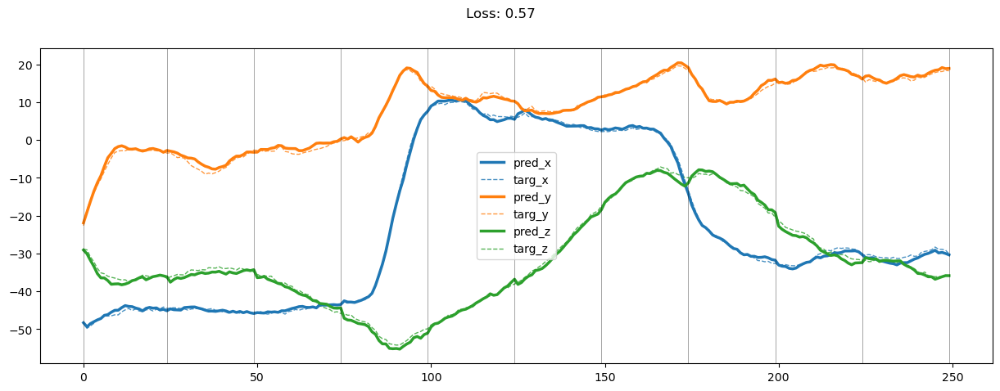

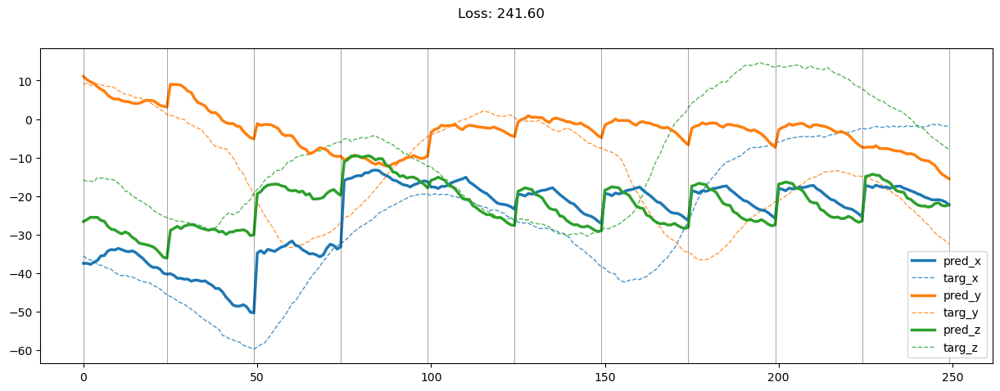

00699: train pred loss:  0.524, g loss:  1.984, diff loss:  1.035, d loss:  1.486
       valid pred loss:  168.610, g loss:  519.911, diff loss:  350.877, d loss:  1.488


100%|██████████| 17/17 [00:01<00:00, 14.94it/s]


00700: train pred loss:  0.554, g loss:  2.068, diff loss:  1.090, d loss:  1.486
       valid pred loss:  169.745, g loss:  524.136, diff loss:  353.967, d loss:  1.488


100%|██████████| 17/17 [00:01<00:00, 15.19it/s]


00701: train pred loss:  0.551, g loss:  2.064, diff loss:  1.090, d loss:  1.487
       valid pred loss:  169.649, g loss:  524.754, diff loss:  354.683, d loss:  1.490


100%|██████████| 17/17 [00:01<00:00, 15.20it/s]


00702: train pred loss:  0.541, g loss:  2.024, diff loss:  1.061, d loss:  1.488
       valid pred loss:  170.547, g loss:  524.970, diff loss:  354.002, d loss:  1.491


100%|██████████| 17/17 [00:01<00:00, 14.61it/s]


00703: train pred loss:  0.556, g loss:  2.063, diff loss:  1.086, d loss:  1.490
       valid pred loss:  169.286, g loss:  525.378, diff loss:  355.672, d loss:  1.492


100%|██████████| 17/17 [00:01<00:00, 15.22it/s]


00704: train pred loss:  0.626, g loss:  2.210, diff loss:  1.166, d loss:  1.491
       valid pred loss:  169.003, g loss:  525.449, diff loss:  356.029, d loss:  1.495


100%|██████████| 17/17 [00:01<00:00, 14.73it/s]


00705: train pred loss:  0.604, g loss:  2.211, diff loss:  1.190, d loss:  1.493
       valid pred loss:  167.827, g loss:  531.039, diff loss:  362.797, d loss:  1.497


100%|██████████| 17/17 [00:01<00:00, 15.22it/s]


00706: train pred loss:  0.580, g loss:  2.132, diff loss:  1.138, d loss:  1.495
       valid pred loss:  169.697, g loss:  525.674, diff loss:  355.565, d loss:  1.499


100%|██████████| 17/17 [00:01<00:00, 15.18it/s]


00707: train pred loss:  0.557, g loss:  2.043, diff loss:  1.074, d loss:  1.498
       valid pred loss:  166.661, g loss:  516.449, diff loss:  349.378, d loss:  1.502


100%|██████████| 17/17 [00:01<00:00, 15.00it/s]


00708: train pred loss:  0.543, g loss:  2.020, diff loss:  1.067, d loss:  1.501
       valid pred loss:  169.117, g loss:  526.158, diff loss:  356.634, d loss:  1.505


100%|██████████| 17/17 [00:01<00:00, 15.24it/s]


00709: train pred loss:  0.530, g loss:  1.980, diff loss:  1.044, d loss:  1.503
       valid pred loss:  169.987, g loss:  530.858, diff loss:  360.467, d loss:  1.507


100%|██████████| 17/17 [00:01<00:00, 15.22it/s]


00710: train pred loss:  0.525, g loss:  1.980, diff loss:  1.051, d loss:  1.505
       valid pred loss:  171.104, g loss:  527.892, diff loss:  356.387, d loss:  1.510


100%|██████████| 17/17 [00:01<00:00, 15.24it/s]


00711: train pred loss:  0.534, g loss:  1.972, diff loss:  1.037, d loss:  1.508
       valid pred loss:  175.127, g loss:  542.568, diff loss:  367.043, d loss:  1.513


100%|██████████| 17/17 [00:01<00:00, 15.22it/s]


00712: train pred loss:  0.531, g loss:  1.969, diff loss:  1.039, d loss:  1.511
       valid pred loss:  170.940, g loss:  529.358, diff loss:  358.021, d loss:  1.516


100%|██████████| 17/17 [00:01<00:00, 15.24it/s]


00713: train pred loss:  0.520, g loss:  1.938, diff loss:  1.021, d loss:  1.513
       valid pred loss:  168.367, g loss:  521.458, diff loss:  352.697, d loss:  1.518


100%|██████████| 17/17 [00:01<00:00, 14.84it/s]


00714: train pred loss:  0.508, g loss:  1.900, diff loss:  0.998, d loss:  1.516
       valid pred loss:  170.674, g loss:  529.281, diff loss:  358.214, d loss:  1.520


100%|██████████| 17/17 [00:01<00:00, 14.13it/s]


00715: train pred loss:  0.519, g loss:  1.927, diff loss:  1.015, d loss:  1.517
       valid pred loss:  172.524, g loss:  531.949, diff loss:  359.035, d loss:  1.522


100%|██████████| 17/17 [00:01<00:00, 14.78it/s]


00716: train pred loss:  0.520, g loss:  1.935, diff loss:  1.023, d loss:  1.519
       valid pred loss:  173.478, g loss:  538.582, diff loss:  364.715, d loss:  1.524


100%|██████████| 17/17 [00:01<00:00, 15.26it/s]


00717: train pred loss:  0.513, g loss:  1.918, diff loss:  1.016, d loss:  1.520
       valid pred loss:  172.526, g loss:  531.466, diff loss:  358.552, d loss:  1.525


100%|██████████| 17/17 [00:01<00:00, 15.26it/s]


00718: train pred loss:  0.509, g loss:  1.906, diff loss:  1.008, d loss:  1.522
       valid pred loss:  172.443, g loss:  537.204, diff loss:  364.374, d loss:  1.526


100%|██████████| 17/17 [00:01<00:00, 15.25it/s]


00719: train pred loss:  0.499, g loss:  1.867, diff loss:  0.980, d loss:  1.522
       valid pred loss:  173.786, g loss:  537.117, diff loss:  362.944, d loss:  1.526


100%|██████████| 17/17 [00:01<00:00, 15.22it/s]


00720: train pred loss:  0.509, g loss:  1.891, diff loss:  0.994, d loss:  1.522
       valid pred loss:  171.930, g loss:  529.799, diff loss:  357.483, d loss:  1.527


100%|██████████| 17/17 [00:01<00:00, 14.80it/s]


00721: train pred loss:  0.530, g loss:  1.970, diff loss:  1.052, d loss:  1.523
       valid pred loss:  174.550, g loss:  538.806, diff loss:  363.870, d loss:  1.526


100%|██████████| 17/17 [00:01<00:00, 14.35it/s]


00722: train pred loss:  0.535, g loss:  1.981, diff loss:  1.059, d loss:  1.523
       valid pred loss:  171.212, g loss:  525.117, diff loss:  353.519, d loss:  1.526


100%|██████████| 17/17 [00:01<00:00, 13.96it/s]


00723: train pred loss:  0.563, g loss:  2.057, diff loss:  1.106, d loss:  1.521
       valid pred loss:  169.804, g loss:  522.138, diff loss:  351.946, d loss:  1.525


100%|██████████| 17/17 [00:01<00:00, 15.19it/s]


00724: train pred loss:  0.542, g loss:  2.004, diff loss:  1.072, d loss:  1.520
       valid pred loss:  171.901, g loss:  530.192, diff loss:  357.902, d loss:  1.523


100%|██████████| 17/17 [00:01<00:00, 14.54it/s]


00725: train pred loss:  0.529, g loss:  1.962, diff loss:  1.042, d loss:  1.519
       valid pred loss:  172.454, g loss:  533.636, diff loss:  360.792, d loss:  1.522


100%|██████████| 17/17 [00:01<00:00, 14.76it/s]


00726: train pred loss:  0.525, g loss:  1.948, diff loss:  1.030, d loss:  1.517
       valid pred loss:  171.736, g loss:  530.556, diff loss:  358.428, d loss:  1.520


100%|██████████| 17/17 [00:01<00:00, 15.23it/s]


00727: train pred loss:  0.519, g loss:  1.930, diff loss:  1.016, d loss:  1.515
       valid pred loss:  172.367, g loss:  534.433, diff loss:  361.672, d loss:  1.518


100%|██████████| 17/17 [00:01<00:00, 14.70it/s]


00728: train pred loss:  0.527, g loss:  1.974, diff loss:  1.050, d loss:  1.513
       valid pred loss:  170.767, g loss:  526.098, diff loss:  354.935, d loss:  1.516


100%|██████████| 17/17 [00:01<00:00, 15.28it/s]


00729: train pred loss:  0.568, g loss:  2.081, diff loss:  1.114, d loss:  1.511
       valid pred loss:  174.755, g loss:  537.230, diff loss:  362.075, d loss:  1.512


100%|██████████| 17/17 [00:01<00:00, 14.99it/s]


00730: train pred loss:  0.553, g loss:  2.034, diff loss:  1.079, d loss:  1.508
       valid pred loss:  173.317, g loss:  534.402, diff loss:  360.683, d loss:  1.510


100%|██████████| 17/17 [00:01<00:00, 15.27it/s]


00731: train pred loss:  0.556, g loss:  2.048, diff loss:  1.088, d loss:  1.505
       valid pred loss:  175.411, g loss:  538.112, diff loss:  362.297, d loss:  1.508


100%|██████████| 17/17 [00:01<00:00, 15.02it/s]


00732: train pred loss:  0.544, g loss:  2.012, diff loss:  1.061, d loss:  1.502
       valid pred loss:  174.401, g loss:  538.212, diff loss:  363.403, d loss:  1.504


100%|██████████| 17/17 [00:01<00:00, 15.01it/s]


00733: train pred loss:  0.529, g loss:  1.969, diff loss:  1.030, d loss:  1.500
       valid pred loss:  176.304, g loss:  540.012, diff loss:  363.298, d loss:  1.502


100%|██████████| 17/17 [00:01<00:00, 15.22it/s]


00734: train pred loss:  0.519, g loss:  1.950, diff loss:  1.020, d loss:  1.498
       valid pred loss:  169.865, g loss:  518.665, diff loss:  348.389, d loss:  1.500


100%|██████████| 17/17 [00:01<00:00, 15.20it/s]


00735: train pred loss:  0.524, g loss:  1.962, diff loss:  1.024, d loss:  1.495
       valid pred loss:  174.744, g loss:  533.817, diff loss:  358.658, d loss:  1.497


100%|██████████| 17/17 [00:01<00:00, 15.15it/s]


00736: train pred loss:  0.530, g loss:  1.992, diff loss:  1.045, d loss:  1.493
       valid pred loss:  171.827, g loss:  531.394, diff loss:  359.150, d loss:  1.496


100%|██████████| 17/17 [00:01<00:00, 15.02it/s]


00737: train pred loss:  0.504, g loss:  1.926, diff loss:  1.003, d loss:  1.491
       valid pred loss:  173.622, g loss:  532.011, diff loss:  357.971, d loss:  1.494


100%|██████████| 17/17 [00:01<00:00, 15.27it/s]


00738: train pred loss:  0.502, g loss:  1.917, diff loss:  0.994, d loss:  1.490
       valid pred loss:  170.676, g loss:  525.523, diff loss:  354.426, d loss:  1.492


100%|██████████| 17/17 [00:01<00:00, 15.29it/s]


00739: train pred loss:  0.523, g loss:  1.978, diff loss:  1.033, d loss:  1.488
       valid pred loss:  170.495, g loss:  524.787, diff loss:  353.871, d loss:  1.491


100%|██████████| 17/17 [00:01<00:00, 15.23it/s]


00740: train pred loss:  0.574, g loss:  2.153, diff loss:  1.156, d loss:  1.487
       valid pred loss:  170.783, g loss:  522.256, diff loss:  351.050, d loss:  1.490


100%|██████████| 17/17 [00:01<00:00, 15.19it/s]


00741: train pred loss:  0.780, g loss:  2.724, diff loss:  1.519, d loss:  1.486
       valid pred loss:  171.577, g loss:  524.837, diff loss:  352.836, d loss:  1.490


100%|██████████| 17/17 [00:01<00:00, 15.01it/s]


00742: train pred loss:  1.150, g loss:  3.707, diff loss:  2.132, d loss:  1.485
       valid pred loss:  175.228, g loss:  536.620, diff loss:  360.969, d loss:  1.489


100%|██████████| 17/17 [00:01<00:00, 14.68it/s]


00743: train pred loss:  1.168, g loss:  3.850, diff loss:  2.257, d loss:  1.485
       valid pred loss:  181.845, g loss:  527.106, diff loss:  344.837, d loss:  1.489


100%|██████████| 17/17 [00:01<00:00, 14.92it/s]


00744: train pred loss:  1.400, g loss:  4.446, diff loss:  2.621, d loss:  1.486
       valid pred loss:  180.116, g loss:  548.726, diff loss:  368.187, d loss:  1.490


100%|██████████| 17/17 [00:01<00:00, 15.23it/s]


00745: train pred loss:  1.601, g loss:  5.184, diff loss:  3.159, d loss:  1.486
       valid pred loss:  204.133, g loss:  635.947, diff loss:  431.391, d loss:  1.490


100%|██████████| 17/17 [00:01<00:00, 14.70it/s]


00746: train pred loss:  3.220, g loss:  9.689, diff loss:  6.046, d loss:  1.487
       valid pred loss:  235.772, g loss:  731.788, diff loss:  495.591, d loss:  1.486


100%|██████████| 17/17 [00:01<00:00, 15.24it/s]


00747: train pred loss:  3.098, g loss:  9.541, diff loss:  6.022, d loss:  1.488
       valid pred loss:  283.600, g loss:  784.225, diff loss:  500.204, d loss:  1.491


100%|██████████| 17/17 [00:01<00:00, 15.24it/s]


00748: train pred loss:  2.974, g loss:  9.134, diff loss:  5.740, d loss:  1.489
       valid pred loss:  186.574, g loss:  539.072, diff loss:  352.081, d loss:  1.496


100%|██████████| 17/17 [00:01<00:00, 15.08it/s]


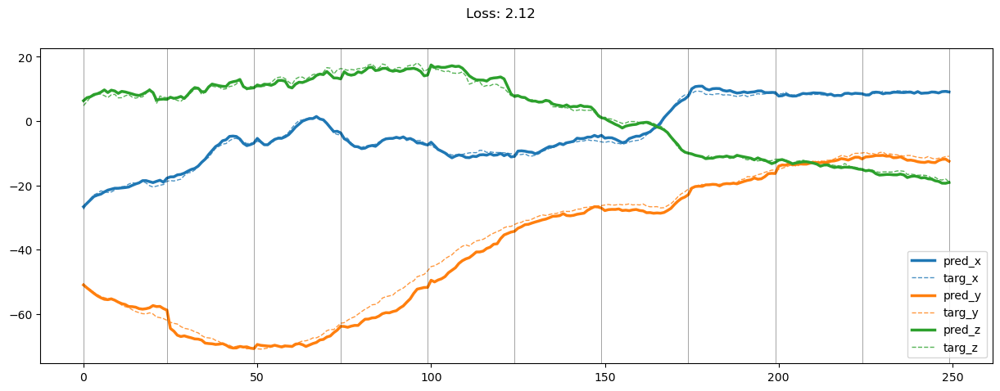

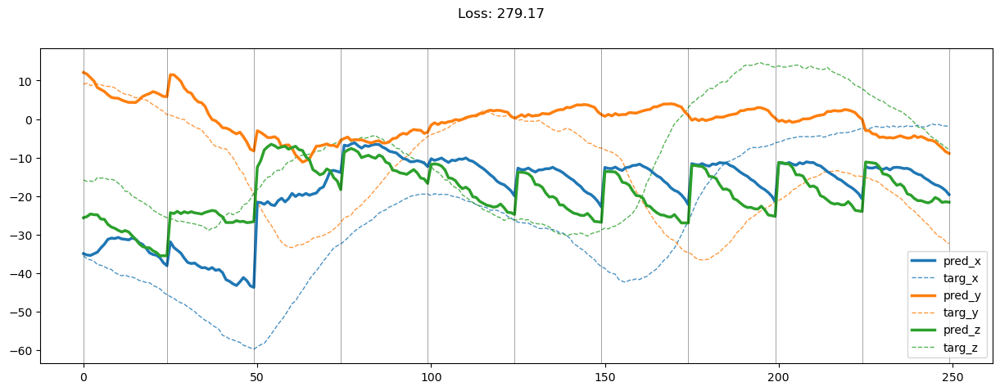

00749: train pred loss:  2.360, g loss:  7.250, diff loss:  4.472, d loss:  1.492
       valid pred loss:  180.716, g loss:  528.132, diff loss:  347.000, d loss:  1.497


100%|██████████| 17/17 [00:01<00:00, 14.93it/s]


00750: train pred loss:  2.121, g loss:  6.629, diff loss:  4.092, d loss:  1.494
       valid pred loss:  172.581, g loss:  533.455, diff loss:  360.460, d loss:  1.498


100%|██████████| 17/17 [00:01<00:00, 15.26it/s]


00751: train pred loss:  1.720, g loss:  5.521, diff loss:  3.388, d loss:  1.497
       valid pred loss:  175.755, g loss:  530.325, diff loss:  354.159, d loss:  1.502


100%|██████████| 17/17 [00:01<00:00, 15.06it/s]


00752: train pred loss:  1.512, g loss:  4.862, diff loss:  2.939, d loss:  1.498
       valid pred loss:  175.397, g loss:  535.687, diff loss:  359.883, d loss:  1.505


100%|██████████| 17/17 [00:01<00:00, 15.25it/s]


00753: train pred loss:  1.203, g loss:  3.992, diff loss:  2.382, d loss:  1.501
       valid pred loss:  177.609, g loss:  533.995, diff loss:  355.981, d loss:  1.507


100%|██████████| 17/17 [00:01<00:00, 15.27it/s]


00754: train pred loss:  0.972, g loss:  3.238, diff loss:  1.861, d loss:  1.504
       valid pred loss:  172.245, g loss:  524.401, diff loss:  351.754, d loss:  1.510


100%|██████████| 17/17 [00:01<00:00, 15.17it/s]


00755: train pred loss:  0.816, g loss:  2.797, diff loss:  1.580, d loss:  1.507
       valid pred loss:  171.186, g loss:  516.169, diff loss:  344.584, d loss:  1.513


100%|██████████| 17/17 [00:01<00:00, 15.09it/s]


00756: train pred loss:  0.747, g loss:  2.635, diff loss:  1.489, d loss:  1.509
       valid pred loss:  171.911, g loss:  520.389, diff loss:  348.081, d loss:  1.515


100%|██████████| 17/17 [00:01<00:00, 14.21it/s]


00757: train pred loss:  0.688, g loss:  2.457, diff loss:  1.371, d loss:  1.512
       valid pred loss:  172.853, g loss:  525.423, diff loss:  352.175, d loss:  1.517


100%|██████████| 17/17 [00:01<00:00, 15.25it/s]


00758: train pred loss:  0.656, g loss:  2.348, diff loss:  1.297, d loss:  1.514
       valid pred loss:  172.461, g loss:  517.861, diff loss:  345.007, d loss:  1.519


100%|██████████| 17/17 [00:01<00:00, 15.25it/s]


00759: train pred loss:  0.617, g loss:  2.243, diff loss:  1.233, d loss:  1.516
       valid pred loss:  172.208, g loss:  519.872, diff loss:  347.272, d loss:  1.522


100%|██████████| 17/17 [00:01<00:00, 15.26it/s]


00760: train pred loss:  0.603, g loss:  2.190, diff loss:  1.195, d loss:  1.519
       valid pred loss:  172.682, g loss:  519.761, diff loss:  346.689, d loss:  1.524


100%|██████████| 17/17 [00:01<00:00, 15.26it/s]


00761: train pred loss:  0.582, g loss:  2.133, diff loss:  1.161, d loss:  1.520
       valid pred loss:  171.336, g loss:  515.820, diff loss:  344.097, d loss:  1.526


100%|██████████| 17/17 [00:01<00:00, 15.26it/s]


00762: train pred loss:  0.578, g loss:  2.111, diff loss:  1.144, d loss:  1.521
       valid pred loss:  172.484, g loss:  521.156, diff loss:  348.286, d loss:  1.526


100%|██████████| 17/17 [00:01<00:00, 15.22it/s]


00763: train pred loss:  0.565, g loss:  2.074, diff loss:  1.121, d loss:  1.522
       valid pred loss:  173.253, g loss:  528.619, diff loss:  354.980, d loss:  1.527


100%|██████████| 17/17 [00:01<00:00, 15.23it/s]


00764: train pred loss:  0.556, g loss:  2.037, diff loss:  1.094, d loss:  1.523
       valid pred loss:  174.210, g loss:  528.814, diff loss:  354.218, d loss:  1.528


100%|██████████| 17/17 [00:01<00:00, 15.24it/s]


00765: train pred loss:  0.541, g loss:  2.000, diff loss:  1.072, d loss:  1.523
       valid pred loss:  174.630, g loss:  530.171, diff loss:  355.155, d loss:  1.528


100%|██████████| 17/17 [00:01<00:00, 15.25it/s]


00766: train pred loss:  0.541, g loss:  2.005, diff loss:  1.076, d loss:  1.523
       valid pred loss:  176.765, g loss:  536.920, diff loss:  359.769, d loss:  1.528


100%|██████████| 17/17 [00:01<00:00, 15.25it/s]


00767: train pred loss:  0.534, g loss:  1.983, diff loss:  1.061, d loss:  1.523
       valid pred loss:  173.793, g loss:  524.473, diff loss:  350.294, d loss:  1.527


100%|██████████| 17/17 [00:01<00:00, 15.25it/s]


00768: train pred loss:  0.530, g loss:  1.975, diff loss:  1.056, d loss:  1.522
       valid pred loss:  174.601, g loss:  523.883, diff loss:  348.895, d loss:  1.526


100%|██████████| 17/17 [00:01<00:00, 15.24it/s]


00769: train pred loss:  0.523, g loss:  1.956, diff loss:  1.044, d loss:  1.521
       valid pred loss:  175.712, g loss:  534.138, diff loss:  358.037, d loss:  1.524


100%|██████████| 17/17 [00:01<00:00, 14.66it/s]


00770: train pred loss:  0.517, g loss:  1.946, diff loss:  1.037, d loss:  1.518
       valid pred loss:  171.389, g loss:  518.393, diff loss:  346.613, d loss:  1.523


100%|██████████| 17/17 [00:01<00:00, 15.18it/s]


00771: train pred loss:  0.523, g loss:  1.956, diff loss:  1.040, d loss:  1.517
       valid pred loss:  171.981, g loss:  515.542, diff loss:  343.168, d loss:  1.520


100%|██████████| 17/17 [00:01<00:00, 14.72it/s]


00772: train pred loss:  0.526, g loss:  1.952, diff loss:  1.031, d loss:  1.515
       valid pred loss:  173.564, g loss:  520.463, diff loss:  346.505, d loss:  1.518


100%|██████████| 17/17 [00:01<00:00, 15.14it/s]


00773: train pred loss:  0.525, g loss:  1.980, diff loss:  1.058, d loss:  1.512
       valid pred loss:  175.032, g loss:  525.274, diff loss:  349.845, d loss:  1.516


100%|██████████| 17/17 [00:01<00:00, 15.05it/s]


00774: train pred loss:  0.520, g loss:  1.942, diff loss:  1.022, d loss:  1.509
       valid pred loss:  173.417, g loss:  524.017, diff loss:  350.200, d loss:  1.513


100%|██████████| 17/17 [00:01<00:00, 15.18it/s]


00775: train pred loss:  0.520, g loss:  1.943, diff loss:  1.020, d loss:  1.507
       valid pred loss:  174.372, g loss:  526.918, diff loss:  352.144, d loss:  1.510


100%|██████████| 17/17 [00:01<00:00, 15.26it/s]


00776: train pred loss:  0.510, g loss:  1.930, diff loss:  1.015, d loss:  1.504
       valid pred loss:  173.322, g loss:  524.904, diff loss:  351.177, d loss:  1.508


100%|██████████| 17/17 [00:01<00:00, 15.17it/s]


00777: train pred loss:  0.502, g loss:  1.907, diff loss:  0.998, d loss:  1.502
       valid pred loss:  173.361, g loss:  525.367, diff loss:  351.598, d loss:  1.505


100%|██████████| 17/17 [00:01<00:00, 15.23it/s]


00778: train pred loss:  0.502, g loss:  1.913, diff loss:  1.001, d loss:  1.499
       valid pred loss:  171.047, g loss:  515.910, diff loss:  344.452, d loss:  1.502


100%|██████████| 17/17 [00:01<00:00, 14.57it/s]


00779: train pred loss:  0.504, g loss:  1.905, diff loss:  0.988, d loss:  1.496
       valid pred loss:  172.114, g loss:  522.471, diff loss:  349.944, d loss:  1.500


100%|██████████| 17/17 [00:01<00:00, 15.13it/s]


00780: train pred loss:  0.503, g loss:  1.921, diff loss:  1.002, d loss:  1.494
       valid pred loss:  169.672, g loss:  515.202, diff loss:  345.115, d loss:  1.498


100%|██████████| 17/17 [00:01<00:00, 15.05it/s]


00781: train pred loss:  0.511, g loss:  1.942, diff loss:  1.013, d loss:  1.491
       valid pred loss:  171.325, g loss:  524.410, diff loss:  352.667, d loss:  1.496


100%|██████████| 17/17 [00:01<00:00, 15.13it/s]


00782: train pred loss:  0.491, g loss:  1.889, diff loss:  0.977, d loss:  1.490
       valid pred loss:  172.903, g loss:  526.321, diff loss:  352.999, d loss:  1.493


100%|██████████| 17/17 [00:01<00:00, 15.11it/s]


00783: train pred loss:  0.494, g loss:  1.897, diff loss:  0.982, d loss:  1.488
       valid pred loss:  172.273, g loss:  526.299, diff loss:  353.605, d loss:  1.492


100%|██████████| 17/17 [00:01<00:00, 14.80it/s]


00784: train pred loss:  0.486, g loss:  1.866, diff loss:  0.958, d loss:  1.487
       valid pred loss:  171.650, g loss:  523.586, diff loss:  351.513, d loss:  1.490


100%|██████████| 17/17 [00:01<00:00, 14.69it/s]


00785: train pred loss:  0.480, g loss:  1.848, diff loss:  0.943, d loss:  1.485
       valid pred loss:  173.814, g loss:  528.530, diff loss:  354.292, d loss:  1.490


100%|██████████| 17/17 [00:01<00:00, 15.01it/s]


00786: train pred loss:  0.481, g loss:  1.860, diff loss:  0.953, d loss:  1.485
       valid pred loss:  173.457, g loss:  525.093, diff loss:  351.212, d loss:  1.488


100%|██████████| 17/17 [00:01<00:00, 14.84it/s]


00787: train pred loss:  0.474, g loss:  1.840, diff loss:  0.940, d loss:  1.485
       valid pred loss:  172.857, g loss:  522.939, diff loss:  349.658, d loss:  1.488


100%|██████████| 17/17 [00:01<00:00, 14.65it/s]


00788: train pred loss:  0.479, g loss:  1.859, diff loss:  0.954, d loss:  1.485
       valid pred loss:  173.075, g loss:  529.178, diff loss:  355.678, d loss:  1.489


100%|██████████| 17/17 [00:01<00:00, 14.55it/s]


00789: train pred loss:  0.485, g loss:  1.875, diff loss:  0.965, d loss:  1.485
       valid pred loss:  173.130, g loss:  529.473, diff loss:  355.919, d loss:  1.490


100%|██████████| 17/17 [00:01<00:00, 15.17it/s]


00790: train pred loss:  0.488, g loss:  1.890, diff loss:  0.978, d loss:  1.486
       valid pred loss:  174.017, g loss:  530.636, diff loss:  356.195, d loss:  1.490


100%|██████████| 17/17 [00:01<00:00, 14.60it/s]


00791: train pred loss:  0.490, g loss:  1.878, diff loss:  0.964, d loss:  1.487
       valid pred loss:  174.384, g loss:  536.199, diff loss:  361.394, d loss:  1.492


100%|██████████| 17/17 [00:01<00:00, 13.85it/s]


00792: train pred loss:  0.486, g loss:  1.875, diff loss:  0.967, d loss:  1.488
       valid pred loss:  173.328, g loss:  533.320, diff loss:  359.573, d loss:  1.494


100%|██████████| 17/17 [00:01<00:00, 14.78it/s]


00793: train pred loss:  0.483, g loss:  1.861, diff loss:  0.959, d loss:  1.490
       valid pred loss:  171.988, g loss:  522.499, diff loss:  350.094, d loss:  1.495


100%|██████████| 17/17 [00:01<00:00, 14.07it/s]


00794: train pred loss:  0.476, g loss:  1.834, diff loss:  0.941, d loss:  1.492
       valid pred loss:  173.242, g loss:  526.555, diff loss:  352.899, d loss:  1.499


100%|██████████| 17/17 [00:01<00:00, 14.82it/s]


00795: train pred loss:  0.481, g loss:  1.837, diff loss:  0.941, d loss:  1.494
       valid pred loss:  172.090, g loss:  524.516, diff loss:  352.014, d loss:  1.501


100%|██████████| 17/17 [00:01<00:00, 14.71it/s]


00796: train pred loss:  0.488, g loss:  1.871, diff loss:  0.971, d loss:  1.497
       valid pred loss:  175.023, g loss:  533.641, diff loss:  358.210, d loss:  1.504


100%|██████████| 17/17 [00:01<00:00, 14.12it/s]


00797: train pred loss:  0.479, g loss:  1.835, diff loss:  0.947, d loss:  1.500
       valid pred loss:  175.287, g loss:  536.059, diff loss:  360.365, d loss:  1.507


100%|██████████| 17/17 [00:01<00:00, 14.91it/s]


00798: train pred loss:  0.471, g loss:  1.811, diff loss:  0.933, d loss:  1.502
       valid pred loss:  174.815, g loss:  537.031, diff loss:  361.813, d loss:  1.509


100%|██████████| 17/17 [00:01<00:00, 14.88it/s]


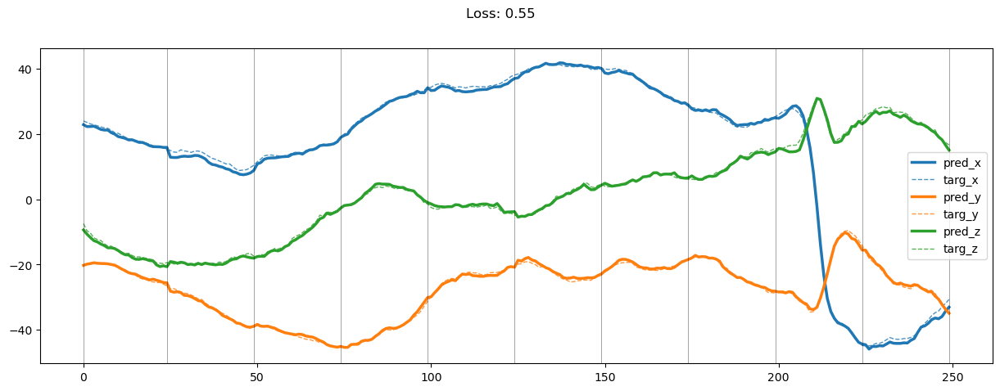

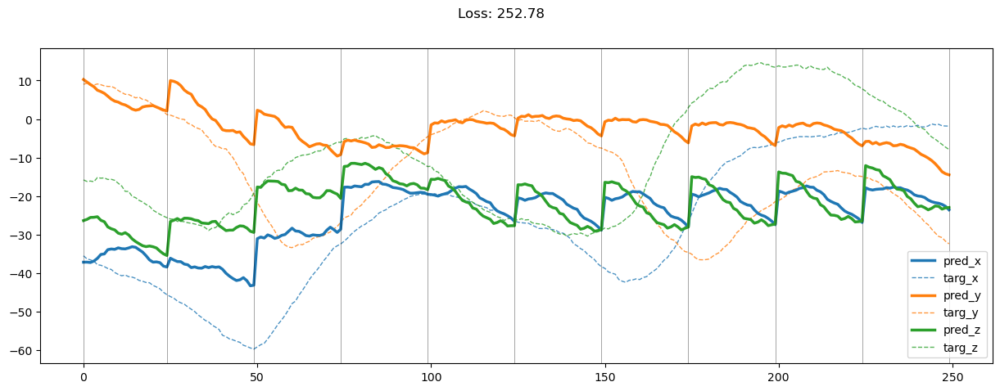

00799: train pred loss:  0.479, g loss:  1.827, diff loss:  0.945, d loss:  1.505
       valid pred loss:  174.266, g loss:  530.265, diff loss:  355.599, d loss:  1.512


100%|██████████| 17/17 [00:01<00:00, 15.19it/s]


00800: train pred loss:  0.468, g loss:  1.803, diff loss:  0.934, d loss:  1.507
       valid pred loss:  174.173, g loss:  535.398, diff loss:  360.827, d loss:  1.515


100%|██████████| 17/17 [00:01<00:00, 14.91it/s]


00801: train pred loss:  0.465, g loss:  1.785, diff loss:  0.922, d loss:  1.510
       valid pred loss:  173.369, g loss:  530.535, diff loss:  356.770, d loss:  1.517


100%|██████████| 17/17 [00:01<00:00, 15.07it/s]


00802: train pred loss:  0.476, g loss:  1.813, diff loss:  0.940, d loss:  1.513
       valid pred loss:  174.155, g loss:  534.917, diff loss:  360.369, d loss:  1.520


100%|██████████| 17/17 [00:01<00:00, 14.79it/s]


00803: train pred loss:  0.479, g loss:  1.813, diff loss:  0.940, d loss:  1.515
       valid pred loss:  172.881, g loss:  526.099, diff loss:  352.826, d loss:  1.522


100%|██████████| 17/17 [00:01<00:00, 14.95it/s]


00804: train pred loss:  0.486, g loss:  1.822, diff loss:  0.943, d loss:  1.517
       valid pred loss:  171.454, g loss:  520.692, diff loss:  348.849, d loss:  1.525


100%|██████████| 17/17 [00:01<00:00, 15.21it/s]


00805: train pred loss:  0.482, g loss:  1.830, diff loss:  0.958, d loss:  1.519
       valid pred loss:  172.186, g loss:  523.975, diff loss:  351.401, d loss:  1.526


100%|██████████| 17/17 [00:01<00:00, 14.72it/s]


00806: train pred loss:  0.472, g loss:  1.789, diff loss:  0.927, d loss:  1.521
       valid pred loss:  171.515, g loss:  521.429, diff loss:  349.527, d loss:  1.528


100%|██████████| 17/17 [00:01<00:00, 13.78it/s]


00807: train pred loss:  0.468, g loss:  1.778, diff loss:  0.922, d loss:  1.522
       valid pred loss:  172.354, g loss:  523.691, diff loss:  350.952, d loss:  1.529


100%|██████████| 17/17 [00:01<00:00, 14.82it/s]


00808: train pred loss:  0.476, g loss:  1.791, diff loss:  0.928, d loss:  1.524
       valid pred loss:  174.268, g loss:  528.024, diff loss:  353.371, d loss:  1.530


100%|██████████| 17/17 [00:01<00:00, 15.13it/s]


00809: train pred loss:  0.471, g loss:  1.789, diff loss:  0.932, d loss:  1.524
       valid pred loss:  174.755, g loss:  528.438, diff loss:  353.300, d loss:  1.530


100%|██████████| 17/17 [00:01<00:00, 15.11it/s]


00810: train pred loss:  0.469, g loss:  1.773, diff loss:  0.917, d loss:  1.524
       valid pred loss:  175.573, g loss:  538.595, diff loss:  362.638, d loss:  1.531


100%|██████████| 17/17 [00:01<00:00, 14.85it/s]


00811: train pred loss:  0.466, g loss:  1.776, diff loss:  0.923, d loss:  1.523
       valid pred loss:  174.279, g loss:  528.050, diff loss:  353.387, d loss:  1.530


100%|██████████| 17/17 [00:01<00:00, 15.18it/s]


00812: train pred loss:  0.469, g loss:  1.781, diff loss:  0.924, d loss:  1.523
       valid pred loss:  176.898, g loss:  533.422, diff loss:  356.138, d loss:  1.528


100%|██████████| 17/17 [00:01<00:00, 15.19it/s]


00813: train pred loss:  0.464, g loss:  1.778, diff loss:  0.925, d loss:  1.522
       valid pred loss:  177.470, g loss:  533.214, diff loss:  355.358, d loss:  1.528


100%|██████████| 17/17 [00:01<00:00, 15.22it/s]


00814: train pred loss:  0.466, g loss:  1.779, diff loss:  0.924, d loss:  1.520
       valid pred loss:  178.739, g loss:  541.554, diff loss:  362.427, d loss:  1.526


100%|██████████| 17/17 [00:01<00:00, 15.18it/s]


00815: train pred loss:  0.482, g loss:  1.840, diff loss:  0.967, d loss:  1.519
       valid pred loss:  175.965, g loss:  534.224, diff loss:  357.869, d loss:  1.523


100%|██████████| 17/17 [00:01<00:00, 14.94it/s]


00816: train pred loss:  0.479, g loss:  1.821, diff loss:  0.949, d loss:  1.517
       valid pred loss:  176.632, g loss:  536.354, diff loss:  359.329, d loss:  1.521


100%|██████████| 17/17 [00:01<00:00, 15.18it/s]


00817: train pred loss:  0.487, g loss:  1.833, diff loss:  0.950, d loss:  1.514
       valid pred loss:  176.357, g loss:  534.989, diff loss:  358.237, d loss:  1.518


100%|██████████| 17/17 [00:01<00:00, 15.20it/s]


00818: train pred loss:  0.467, g loss:  1.802, diff loss:  0.937, d loss:  1.512
       valid pred loss:  177.173, g loss:  540.059, diff loss:  362.488, d loss:  1.516


100%|██████████| 17/17 [00:01<00:00, 15.19it/s]


00819: train pred loss:  0.480, g loss:  1.845, diff loss:  0.965, d loss:  1.509
       valid pred loss:  177.257, g loss:  537.968, diff loss:  360.311, d loss:  1.513


100%|██████████| 17/17 [00:01<00:00, 14.84it/s]


00820: train pred loss:  0.486, g loss:  1.843, diff loss:  0.954, d loss:  1.505
       valid pred loss:  176.283, g loss:  541.315, diff loss:  364.629, d loss:  1.510


100%|██████████| 17/17 [00:01<00:00, 14.66it/s]


00821: train pred loss:  0.474, g loss:  1.819, diff loss:  0.939, d loss:  1.503
       valid pred loss:  175.766, g loss:  536.956, diff loss:  360.784, d loss:  1.507


100%|██████████| 17/17 [00:01<00:00, 15.15it/s]


00822: train pred loss:  0.479, g loss:  1.823, diff loss:  0.936, d loss:  1.501
       valid pred loss:  175.662, g loss:  535.485, diff loss:  359.415, d loss:  1.504


100%|██████████| 17/17 [00:01<00:00, 14.90it/s]


00823: train pred loss:  0.477, g loss:  1.825, diff loss:  0.936, d loss:  1.497
       valid pred loss:  179.047, g loss:  552.914, diff loss:  373.457, d loss:  1.502


100%|██████████| 17/17 [00:01<00:00, 15.18it/s]


00824: train pred loss:  0.471, g loss:  1.822, diff loss:  0.937, d loss:  1.495
       valid pred loss:  177.796, g loss:  547.557, diff loss:  369.347, d loss:  1.499


100%|██████████| 17/17 [00:01<00:00, 15.18it/s]


00825: train pred loss:  0.471, g loss:  1.821, diff loss:  0.933, d loss:  1.493
       valid pred loss:  176.019, g loss:  540.252, diff loss:  363.816, d loss:  1.497


100%|██████████| 17/17 [00:01<00:00, 15.08it/s]


00826: train pred loss:  0.460, g loss:  1.775, diff loss:  0.896, d loss:  1.491
       valid pred loss:  177.276, g loss:  541.175, diff loss:  363.481, d loss:  1.495


100%|██████████| 17/17 [00:01<00:00, 15.21it/s]


00827: train pred loss:  0.457, g loss:  1.782, diff loss:  0.904, d loss:  1.489
       valid pred loss:  178.981, g loss:  545.014, diff loss:  365.613, d loss:  1.493


100%|██████████| 17/17 [00:01<00:00, 15.22it/s]


00828: train pred loss:  0.464, g loss:  1.808, diff loss:  0.921, d loss:  1.487
       valid pred loss:  177.234, g loss:  540.685, diff loss:  363.030, d loss:  1.491


100%|██████████| 17/17 [00:01<00:00, 15.22it/s]


00829: train pred loss:  0.465, g loss:  1.800, diff loss:  0.911, d loss:  1.486
       valid pred loss:  178.105, g loss:  541.510, diff loss:  362.981, d loss:  1.490


100%|██████████| 17/17 [00:01<00:00, 15.25it/s]


00830: train pred loss:  0.471, g loss:  1.813, diff loss:  0.916, d loss:  1.485
       valid pred loss:  176.834, g loss:  537.986, diff loss:  360.727, d loss:  1.489


100%|██████████| 17/17 [00:01<00:00, 15.22it/s]


00831: train pred loss:  0.473, g loss:  1.828, diff loss:  0.929, d loss:  1.484
       valid pred loss:  175.790, g loss:  538.302, diff loss:  362.087, d loss:  1.489


100%|██████████| 17/17 [00:01<00:00, 14.31it/s]


00832: train pred loss:  0.472, g loss:  1.834, diff loss:  0.935, d loss:  1.484
       valid pred loss:  177.426, g loss:  544.426, diff loss:  366.575, d loss:  1.489


100%|██████████| 17/17 [00:01<00:00, 15.23it/s]


00833: train pred loss:  0.465, g loss:  1.813, diff loss:  0.922, d loss:  1.484
       valid pred loss:  177.670, g loss:  544.229, diff loss:  366.135, d loss:  1.490


100%|██████████| 17/17 [00:01<00:00, 15.23it/s]


00834: train pred loss:  0.454, g loss:  1.773, diff loss:  0.893, d loss:  1.484
       valid pred loss:  176.728, g loss:  543.997, diff loss:  366.845, d loss:  1.490


100%|██████████| 17/17 [00:01<00:00, 15.22it/s]


00835: train pred loss:  0.457, g loss:  1.784, diff loss:  0.902, d loss:  1.486
       valid pred loss:  176.979, g loss:  540.408, diff loss:  363.006, d loss:  1.491


100%|██████████| 17/17 [00:01<00:00, 15.21it/s]


00836: train pred loss:  0.451, g loss:  1.766, diff loss:  0.892, d loss:  1.487
       valid pred loss:  175.338, g loss:  537.799, diff loss:  362.040, d loss:  1.493


100%|██████████| 17/17 [00:01<00:00, 15.17it/s]


00837: train pred loss:  0.461, g loss:  1.788, diff loss:  0.906, d loss:  1.488
       valid pred loss:  175.622, g loss:  541.918, diff loss:  365.877, d loss:  1.495


100%|██████████| 17/17 [00:01<00:00, 15.18it/s]


00838: train pred loss:  0.467, g loss:  1.809, diff loss:  0.923, d loss:  1.490
       valid pred loss:  175.336, g loss:  536.061, diff loss:  360.308, d loss:  1.497


100%|██████████| 17/17 [00:01<00:00, 15.25it/s]


00839: train pred loss:  0.471, g loss:  1.815, diff loss:  0.927, d loss:  1.493
       valid pred loss:  174.201, g loss:  534.048, diff loss:  359.433, d loss:  1.499


100%|██████████| 17/17 [00:01<00:00, 15.19it/s]


00840: train pred loss:  0.459, g loss:  1.790, diff loss:  0.916, d loss:  1.495
       valid pred loss:  176.917, g loss:  543.970, diff loss:  366.642, d loss:  1.502


100%|██████████| 17/17 [00:01<00:00, 15.18it/s]


00841: train pred loss:  0.462, g loss:  1.788, diff loss:  0.914, d loss:  1.498
       valid pred loss:  177.369, g loss:  546.692, diff loss:  368.915, d loss:  1.505


100%|██████████| 17/17 [00:01<00:00, 14.72it/s]


00842: train pred loss:  0.472, g loss:  1.806, diff loss:  0.926, d loss:  1.500
       valid pred loss:  177.735, g loss:  548.526, diff loss:  370.385, d loss:  1.507


100%|██████████| 17/17 [00:01<00:00, 15.27it/s]


00843: train pred loss:  0.472, g loss:  1.809, diff loss:  0.931, d loss:  1.503
       valid pred loss:  178.822, g loss:  550.381, diff loss:  371.157, d loss:  1.511


100%|██████████| 17/17 [00:01<00:00, 15.23it/s]


00844: train pred loss:  0.469, g loss:  1.813, diff loss:  0.941, d loss:  1.506
       valid pred loss:  177.799, g loss:  546.539, diff loss:  368.341, d loss:  1.514


100%|██████████| 17/17 [00:01<00:00, 15.26it/s]


00845: train pred loss:  0.463, g loss:  1.770, diff loss:  0.908, d loss:  1.509
       valid pred loss:  178.901, g loss:  546.013, diff loss:  366.716, d loss:  1.517


100%|██████████| 17/17 [00:01<00:00, 15.25it/s]


00846: train pred loss:  0.474, g loss:  1.798, diff loss:  0.926, d loss:  1.511
       valid pred loss:  177.882, g loss:  547.109, diff loss:  368.832, d loss:  1.519


100%|██████████| 17/17 [00:01<00:00, 15.28it/s]


00847: train pred loss:  0.468, g loss:  1.788, diff loss:  0.925, d loss:  1.515
       valid pred loss:  176.369, g loss:  542.284, diff loss:  365.523, d loss:  1.522


100%|██████████| 17/17 [00:01<00:00, 15.22it/s]


00848: train pred loss:  0.466, g loss:  1.782, diff loss:  0.924, d loss:  1.517
       valid pred loss:  176.787, g loss:  542.303, diff loss:  365.127, d loss:  1.525


100%|██████████| 17/17 [00:01<00:00, 14.29it/s]


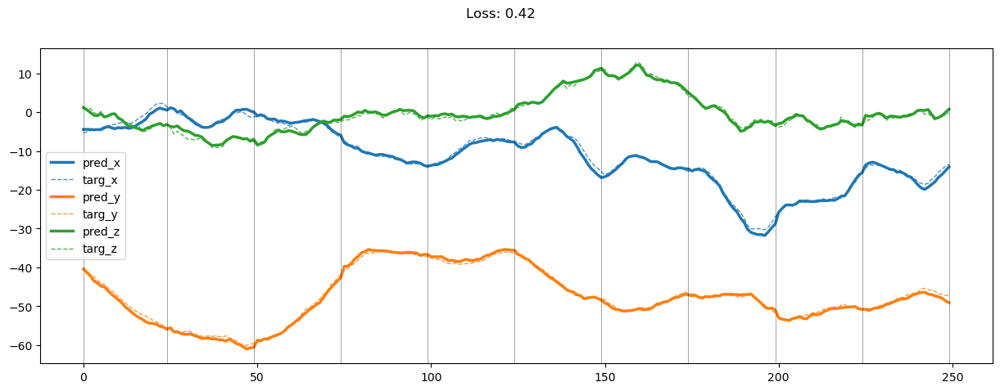

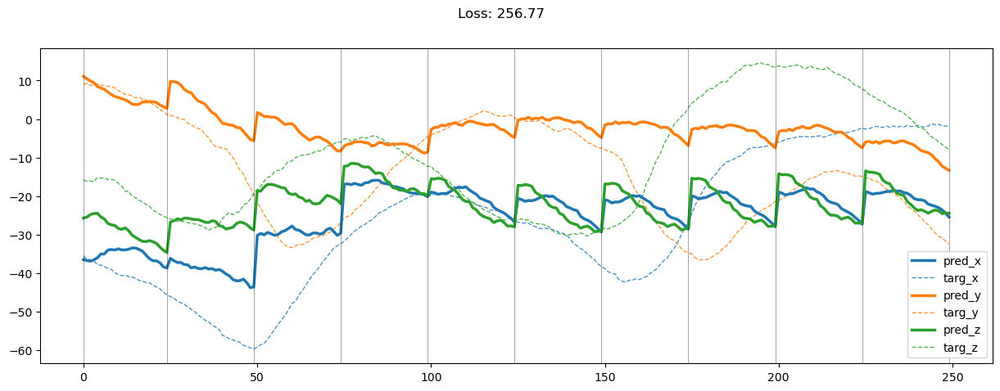

00849: train pred loss:  0.482, g loss:  1.823, diff loss:  0.951, d loss:  1.519
       valid pred loss:  174.271, g loss:  536.623, diff loss:  361.965, d loss:  1.527


100%|██████████| 17/17 [00:01<00:00, 15.18it/s]


00850: train pred loss:  0.497, g loss:  1.863, diff loss:  0.977, d loss:  1.521
       valid pred loss:  176.172, g loss:  541.480, diff loss:  364.922, d loss:  1.528


100%|██████████| 17/17 [00:01<00:00, 15.21it/s]


00851: train pred loss:  0.499, g loss:  1.858, diff loss:  0.971, d loss:  1.522
       valid pred loss:  177.049, g loss:  543.606, diff loss:  366.172, d loss:  1.529


100%|██████████| 17/17 [00:01<00:00, 15.04it/s]


00852: train pred loss:  0.526, g loss:  1.941, diff loss:  1.029, d loss:  1.523
       valid pred loss:  174.540, g loss:  535.117, diff loss:  360.193, d loss:  1.531


100%|██████████| 17/17 [00:01<00:00, 14.68it/s]


00853: train pred loss:  0.498, g loss:  1.876, diff loss:  0.991, d loss:  1.524
       valid pred loss:  177.340, g loss:  546.052, diff loss:  368.329, d loss:  1.531


100%|██████████| 17/17 [00:01<00:00, 15.24it/s]


00854: train pred loss:  0.506, g loss:  1.871, diff loss:  0.979, d loss:  1.524
       valid pred loss:  176.087, g loss:  537.800, diff loss:  361.329, d loss:  1.531


100%|██████████| 17/17 [00:01<00:00, 15.22it/s]


00855: train pred loss:  0.489, g loss:  1.830, diff loss:  0.955, d loss:  1.524
       valid pred loss:  175.934, g loss:  538.578, diff loss:  362.261, d loss:  1.531


100%|██████████| 17/17 [00:01<00:00, 15.22it/s]


00856: train pred loss:  0.475, g loss:  1.788, diff loss:  0.927, d loss:  1.524
       valid pred loss:  176.619, g loss:  542.387, diff loss:  365.383, d loss:  1.529


100%|██████████| 17/17 [00:01<00:00, 14.90it/s]


00857: train pred loss:  0.473, g loss:  1.791, diff loss:  0.930, d loss:  1.523
       valid pred loss:  176.753, g loss:  538.744, diff loss:  361.606, d loss:  1.529


100%|██████████| 17/17 [00:01<00:00, 15.24it/s]


00858: train pred loss:  0.465, g loss:  1.763, diff loss:  0.909, d loss:  1.522
       valid pred loss:  177.134, g loss:  541.533, diff loss:  364.013, d loss:  1.528


100%|██████████| 17/17 [00:01<00:00, 15.24it/s]


00859: train pred loss:  0.454, g loss:  1.747, diff loss:  0.903, d loss:  1.520
       valid pred loss:  177.686, g loss:  546.098, diff loss:  368.024, d loss:  1.526


100%|██████████| 17/17 [00:01<00:00, 15.24it/s]


00860: train pred loss:  0.454, g loss:  1.733, diff loss:  0.888, d loss:  1.519
       valid pred loss:  175.662, g loss:  540.725, diff loss:  364.673, d loss:  1.523


100%|██████████| 17/17 [00:01<00:00, 15.24it/s]


00861: train pred loss:  0.467, g loss:  1.770, diff loss:  0.909, d loss:  1.516
       valid pred loss:  175.413, g loss:  535.867, diff loss:  360.062, d loss:  1.521


100%|██████████| 17/17 [00:01<00:00, 15.20it/s]


00862: train pred loss:  0.462, g loss:  1.775, diff loss:  0.917, d loss:  1.513
       valid pred loss:  177.660, g loss:  545.064, diff loss:  367.009, d loss:  1.518


100%|██████████| 17/17 [00:01<00:00, 14.38it/s]


00863: train pred loss:  0.458, g loss:  1.767, diff loss:  0.910, d loss:  1.510
       valid pred loss:  175.803, g loss:  538.603, diff loss:  362.402, d loss:  1.515


100%|██████████| 17/17 [00:01<00:00, 15.23it/s]


00864: train pred loss:  0.454, g loss:  1.756, diff loss:  0.901, d loss:  1.508
       valid pred loss:  172.065, g loss:  524.726, diff loss:  352.260, d loss:  1.513


100%|██████████| 17/17 [00:01<00:00, 15.09it/s]


00865: train pred loss:  0.465, g loss:  1.783, diff loss:  0.913, d loss:  1.505
       valid pred loss:  175.323, g loss:  533.809, diff loss:  358.081, d loss:  1.509


100%|██████████| 17/17 [00:01<00:00, 15.22it/s]


00866: train pred loss:  0.462, g loss:  1.770, diff loss:  0.901, d loss:  1.502
       valid pred loss:  175.034, g loss:  534.954, diff loss:  359.513, d loss:  1.506


100%|██████████| 17/17 [00:01<00:00, 15.04it/s]


00867: train pred loss:  0.458, g loss:  1.778, diff loss:  0.909, d loss:  1.498
       valid pred loss:  174.510, g loss:  533.854, diff loss:  358.933, d loss:  1.502


100%|██████████| 17/17 [00:01<00:00, 15.17it/s]


00868: train pred loss:  0.469, g loss:  1.809, diff loss:  0.927, d loss:  1.496
       valid pred loss:  175.699, g loss:  535.405, diff loss:  359.293, d loss:  1.501


100%|██████████| 17/17 [00:01<00:00, 14.89it/s]


00869: train pred loss:  0.485, g loss:  1.850, diff loss:  0.948, d loss:  1.493
       valid pred loss:  173.642, g loss:  527.788, diff loss:  353.731, d loss:  1.498


100%|██████████| 17/17 [00:01<00:00, 15.18it/s]


00870: train pred loss:  0.477, g loss:  1.839, diff loss:  0.943, d loss:  1.491
       valid pred loss:  175.979, g loss:  535.489, diff loss:  359.093, d loss:  1.496


100%|██████████| 17/17 [00:01<00:00, 14.74it/s]


00871: train pred loss:  0.484, g loss:  1.851, diff loss:  0.946, d loss:  1.489
       valid pred loss:  176.973, g loss:  538.668, diff loss:  361.274, d loss:  1.493


100%|██████████| 17/17 [00:01<00:00, 15.21it/s]


00872: train pred loss:  0.476, g loss:  1.840, diff loss:  0.941, d loss:  1.487
       valid pred loss:  176.952, g loss:  543.534, diff loss:  366.160, d loss:  1.492


100%|██████████| 17/17 [00:01<00:00, 15.25it/s]


00873: train pred loss:  0.481, g loss:  1.866, diff loss:  0.960, d loss:  1.485
       valid pred loss:  175.986, g loss:  534.380, diff loss:  357.970, d loss:  1.491


100%|██████████| 17/17 [00:01<00:00, 15.18it/s]


00874: train pred loss:  0.474, g loss:  1.833, diff loss:  0.933, d loss:  1.484
       valid pred loss:  172.938, g loss:  527.958, diff loss:  354.595, d loss:  1.490


100%|██████████| 17/17 [00:01<00:00, 15.17it/s]


00875: train pred loss:  0.470, g loss:  1.840, diff loss:  0.943, d loss:  1.483
       valid pred loss:  175.925, g loss:  535.034, diff loss:  358.684, d loss:  1.490


100%|██████████| 17/17 [00:01<00:00, 15.17it/s]


00876: train pred loss:  0.484, g loss:  1.846, diff loss:  0.935, d loss:  1.483
       valid pred loss:  176.158, g loss:  535.232, diff loss:  358.649, d loss:  1.489


100%|██████████| 17/17 [00:01<00:00, 15.21it/s]


00877: train pred loss:  0.492, g loss:  1.880, diff loss:  0.960, d loss:  1.483
       valid pred loss:  177.684, g loss:  538.859, diff loss:  360.750, d loss:  1.489


100%|██████████| 17/17 [00:01<00:00, 14.73it/s]


00878: train pred loss:  0.482, g loss:  1.857, diff loss:  0.949, d loss:  1.484
       valid pred loss:  177.151, g loss:  538.998, diff loss:  361.423, d loss:  1.490


100%|██████████| 17/17 [00:01<00:00, 14.42it/s]


00879: train pred loss:  0.492, g loss:  1.875, diff loss:  0.957, d loss:  1.484
       valid pred loss:  177.965, g loss:  540.494, diff loss:  362.105, d loss:  1.491


100%|██████████| 17/17 [00:01<00:00, 14.03it/s]


00880: train pred loss:  0.484, g loss:  1.856, diff loss:  0.947, d loss:  1.485
       valid pred loss:  178.193, g loss:  547.081, diff loss:  368.467, d loss:  1.493


100%|██████████| 17/17 [00:01<00:00, 14.47it/s]


00881: train pred loss:  0.474, g loss:  1.839, diff loss:  0.942, d loss:  1.487
       valid pred loss:  177.545, g loss:  541.387, diff loss:  363.422, d loss:  1.494


100%|██████████| 17/17 [00:01<00:00, 14.90it/s]


00882: train pred loss:  0.487, g loss:  1.873, diff loss:  0.965, d loss:  1.489
       valid pred loss:  178.816, g loss:  543.171, diff loss:  363.938, d loss:  1.496


100%|██████████| 17/17 [00:01<00:00, 15.03it/s]


00883: train pred loss:  0.477, g loss:  1.830, diff loss:  0.934, d loss:  1.491
       valid pred loss:  178.550, g loss:  546.783, diff loss:  367.819, d loss:  1.499


100%|██████████| 17/17 [00:01<00:00, 15.23it/s]


00884: train pred loss:  0.486, g loss:  1.860, diff loss:  0.959, d loss:  1.494
       valid pred loss:  177.970, g loss:  543.204, diff loss:  364.822, d loss:  1.502


100%|██████████| 17/17 [00:01<00:00, 15.23it/s]


00885: train pred loss:  0.484, g loss:  1.849, diff loss:  0.952, d loss:  1.497
       valid pred loss:  176.513, g loss:  541.183, diff loss:  364.261, d loss:  1.505


100%|██████████| 17/17 [00:01<00:00, 15.23it/s]


00886: train pred loss:  0.485, g loss:  1.839, diff loss:  0.944, d loss:  1.499
       valid pred loss:  178.113, g loss:  543.409, diff loss:  364.890, d loss:  1.508


100%|██████████| 17/17 [00:01<00:00, 15.23it/s]


00887: train pred loss:  0.487, g loss:  1.862, diff loss:  0.968, d loss:  1.502
       valid pred loss:  176.857, g loss:  538.420, diff loss:  361.160, d loss:  1.511


100%|██████████| 17/17 [00:01<00:00, 15.23it/s]


00888: train pred loss:  0.472, g loss:  1.812, diff loss:  0.936, d loss:  1.505
       valid pred loss:  180.501, g loss:  552.371, diff loss:  371.470, d loss:  1.514


100%|██████████| 17/17 [00:01<00:00, 14.60it/s]


00889: train pred loss:  0.469, g loss:  1.788, diff loss:  0.919, d loss:  1.509
       valid pred loss:  179.628, g loss:  547.732, diff loss:  367.708, d loss:  1.517


100%|██████████| 17/17 [00:01<00:00, 15.16it/s]


00890: train pred loss:  0.475, g loss:  1.803, diff loss:  0.931, d loss:  1.511
       valid pred loss:  178.512, g loss:  544.976, diff loss:  366.070, d loss:  1.520


100%|██████████| 17/17 [00:01<00:00, 15.25it/s]


00891: train pred loss:  0.466, g loss:  1.782, diff loss:  0.920, d loss:  1.514
       valid pred loss:  175.724, g loss:  534.189, diff loss:  358.074, d loss:  1.523


100%|██████████| 17/17 [00:01<00:00, 15.26it/s]


00892: train pred loss:  0.471, g loss:  1.784, diff loss:  0.921, d loss:  1.516
       valid pred loss:  177.070, g loss:  544.182, diff loss:  366.723, d loss:  1.525


100%|██████████| 17/17 [00:01<00:00, 14.97it/s]


00893: train pred loss:  0.471, g loss:  1.783, diff loss:  0.921, d loss:  1.519
       valid pred loss:  180.388, g loss:  551.273, diff loss:  370.498, d loss:  1.528


100%|██████████| 17/17 [00:01<00:00, 15.17it/s]


00894: train pred loss:  0.470, g loss:  1.777, diff loss:  0.918, d loss:  1.521
       valid pred loss:  179.006, g loss:  542.560, diff loss:  363.168, d loss:  1.529


100%|██████████| 17/17 [00:01<00:00, 15.19it/s]


00895: train pred loss:  0.458, g loss:  1.745, diff loss:  0.898, d loss:  1.522
       valid pred loss:  178.475, g loss:  545.107, diff loss:  366.248, d loss:  1.531


100%|██████████| 17/17 [00:01<00:00, 15.15it/s]


00896: train pred loss:  0.462, g loss:  1.767, diff loss:  0.918, d loss:  1.523
       valid pred loss:  177.157, g loss:  541.736, diff loss:  364.196, d loss:  1.532


100%|██████████| 17/17 [00:01<00:00, 15.07it/s]


00897: train pred loss:  0.465, g loss:  1.762, diff loss:  0.911, d loss:  1.525
       valid pred loss:  174.754, g loss:  531.572, diff loss:  356.436, d loss:  1.533


100%|██████████| 17/17 [00:01<00:00, 15.14it/s]


00898: train pred loss:  0.464, g loss:  1.761, diff loss:  0.913, d loss:  1.526
       valid pred loss:  174.986, g loss:  531.918, diff loss:  356.549, d loss:  1.533


100%|██████████| 17/17 [00:01<00:00, 14.31it/s]


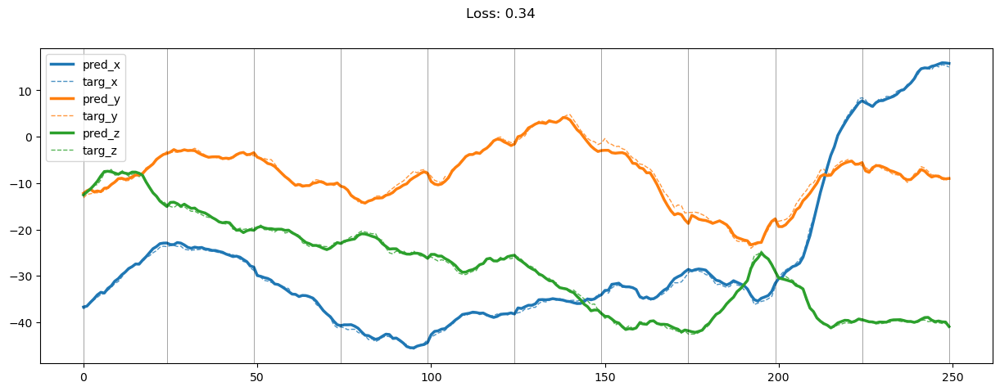

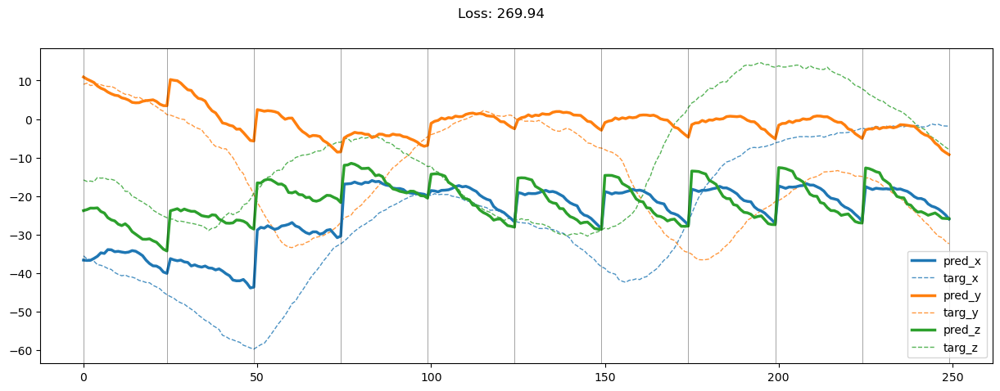

00899: train pred loss:  0.458, g loss:  1.750, diff loss:  0.907, d loss:  1.526
       valid pred loss:  177.057, g loss:  532.169, diff loss:  354.730, d loss:  1.533


100%|██████████| 17/17 [00:01<00:00, 15.09it/s]


00900: train pred loss:  0.474, g loss:  1.802, diff loss:  0.942, d loss:  1.525
       valid pred loss:  178.194, g loss:  538.249, diff loss:  359.672, d loss:  1.532


100%|██████████| 17/17 [00:01<00:00, 15.18it/s]


00901: train pred loss:  0.463, g loss:  1.763, diff loss:  0.914, d loss:  1.524
       valid pred loss:  178.007, g loss:  539.574, diff loss:  361.183, d loss:  1.531


100%|██████████| 17/17 [00:01<00:00, 15.25it/s]


00902: train pred loss:  0.467, g loss:  1.770, diff loss:  0.915, d loss:  1.523
       valid pred loss:  179.402, g loss:  548.269, diff loss:  368.481, d loss:  1.529


100%|██████████| 17/17 [00:01<00:00, 15.14it/s]


00903: train pred loss:  0.456, g loss:  1.748, diff loss:  0.903, d loss:  1.522
       valid pred loss:  178.020, g loss:  544.124, diff loss:  365.716, d loss:  1.527


100%|██████████| 17/17 [00:01<00:00, 15.18it/s]


00904: train pred loss:  0.471, g loss:  1.797, diff loss:  0.935, d loss:  1.519
       valid pred loss:  178.296, g loss:  546.176, diff loss:  367.490, d loss:  1.525


100%|██████████| 17/17 [00:01<00:00, 15.14it/s]


00905: train pred loss:  0.466, g loss:  1.786, diff loss:  0.927, d loss:  1.517
       valid pred loss:  175.524, g loss:  533.695, diff loss:  357.780, d loss:  1.523


100%|██████████| 17/17 [00:01<00:00, 15.07it/s]


00906: train pred loss:  0.478, g loss:  1.818, diff loss:  0.944, d loss:  1.514
       valid pred loss:  179.732, g loss:  544.617, diff loss:  364.491, d loss:  1.519


100%|██████████| 17/17 [00:01<00:00, 15.17it/s]


00907: train pred loss:  0.482, g loss:  1.826, diff loss:  0.946, d loss:  1.511
       valid pred loss:  174.730, g loss:  528.142, diff loss:  353.014, d loss:  1.516


100%|██████████| 17/17 [00:01<00:00, 14.49it/s]


00908: train pred loss:  0.495, g loss:  1.868, diff loss:  0.972, d loss:  1.508
       valid pred loss:  175.411, g loss:  525.336, diff loss:  349.525, d loss:  1.513


100%|██████████| 17/17 [00:01<00:00, 14.85it/s]


00909: train pred loss:  0.484, g loss:  1.831, diff loss:  0.943, d loss:  1.505
       valid pred loss:  174.975, g loss:  530.079, diff loss:  354.701, d loss:  1.510


100%|██████████| 17/17 [00:01<00:00, 14.54it/s]


00910: train pred loss:  0.484, g loss:  1.845, diff loss:  0.954, d loss:  1.501
       valid pred loss:  176.414, g loss:  531.173, diff loss:  354.353, d loss:  1.507


100%|██████████| 17/17 [00:01<00:00, 15.10it/s]


00911: train pred loss:  0.478, g loss:  1.832, diff loss:  0.944, d loss:  1.499
       valid pred loss:  172.449, g loss:  519.787, diff loss:  346.928, d loss:  1.504


100%|██████████| 17/17 [00:01<00:00, 15.03it/s]


00912: train pred loss:  0.479, g loss:  1.834, diff loss:  0.942, d loss:  1.496
       valid pred loss:  175.315, g loss:  528.911, diff loss:  353.184, d loss:  1.501


100%|██████████| 17/17 [00:01<00:00, 15.13it/s]


00913: train pred loss:  0.476, g loss:  1.840, diff loss:  0.947, d loss:  1.493
       valid pred loss:  176.666, g loss:  530.356, diff loss:  353.275, d loss:  1.498


100%|██████████| 17/17 [00:01<00:00, 15.06it/s]


00914: train pred loss:  0.481, g loss:  1.856, diff loss:  0.956, d loss:  1.491
       valid pred loss:  174.779, g loss:  526.749, diff loss:  351.551, d loss:  1.495


100%|██████████| 17/17 [00:01<00:00, 15.08it/s]


00915: train pred loss:  0.483, g loss:  1.860, diff loss:  0.956, d loss:  1.489
       valid pred loss:  173.827, g loss:  528.882, diff loss:  354.634, d loss:  1.493


100%|██████████| 17/17 [00:01<00:00, 14.93it/s]


00916: train pred loss:  0.490, g loss:  1.857, diff loss:  0.943, d loss:  1.487
       valid pred loss:  177.463, g loss:  537.215, diff loss:  359.330, d loss:  1.492


100%|██████████| 17/17 [00:01<00:00, 14.79it/s]


00917: train pred loss:  0.505, g loss:  1.905, diff loss:  0.975, d loss:  1.486
       valid pred loss:  174.856, g loss:  530.212, diff loss:  354.932, d loss:  1.491


100%|██████████| 17/17 [00:01<00:00, 15.09it/s]


00918: train pred loss:  0.501, g loss:  1.917, diff loss:  0.989, d loss:  1.484
       valid pred loss:  174.678, g loss:  533.989, diff loss:  358.886, d loss:  1.489


100%|██████████| 17/17 [00:01<00:00, 14.68it/s]


00919: train pred loss:  0.505, g loss:  1.924, diff loss:  0.991, d loss:  1.483
       valid pred loss:  174.068, g loss:  531.828, diff loss:  357.334, d loss:  1.489


100%|██████████| 17/17 [00:01<00:00, 13.93it/s]


00920: train pred loss:  0.498, g loss:  1.895, diff loss:  0.968, d loss:  1.482
       valid pred loss:  173.360, g loss:  529.528, diff loss:  355.742, d loss:  1.488


100%|██████████| 17/17 [00:01<00:00, 15.09it/s]


00921: train pred loss:  0.476, g loss:  1.845, diff loss:  0.941, d loss:  1.482
       valid pred loss:  176.343, g loss:  543.001, diff loss:  366.233, d loss:  1.489


100%|██████████| 17/17 [00:01<00:00, 15.06it/s]


00922: train pred loss:  0.466, g loss:  1.810, diff loss:  0.917, d loss:  1.483
       valid pred loss:  178.781, g loss:  548.916, diff loss:  369.709, d loss:  1.489


100%|██████████| 17/17 [00:01<00:00, 15.03it/s]


00923: train pred loss:  0.468, g loss:  1.801, diff loss:  0.907, d loss:  1.483
       valid pred loss:  175.263, g loss:  538.340, diff loss:  362.652, d loss:  1.489


100%|██████████| 17/17 [00:01<00:00, 14.00it/s]


00924: train pred loss:  0.457, g loss:  1.794, diff loss:  0.912, d loss:  1.485
       valid pred loss:  177.934, g loss:  548.344, diff loss:  369.988, d loss:  1.492


100%|██████████| 17/17 [00:01<00:00, 14.87it/s]


00925: train pred loss:  0.463, g loss:  1.811, diff loss:  0.924, d loss:  1.486
       valid pred loss:  179.106, g loss:  550.688, diff loss:  371.162, d loss:  1.494


100%|██████████| 17/17 [00:01<00:00, 14.96it/s]


00926: train pred loss:  0.479, g loss:  1.849, diff loss:  0.948, d loss:  1.489
       valid pred loss:  175.920, g loss:  543.726, diff loss:  367.388, d loss:  1.496


100%|██████████| 17/17 [00:01<00:00, 15.06it/s]


00927: train pred loss:  0.470, g loss:  1.826, diff loss:  0.937, d loss:  1.491
       valid pred loss:  173.895, g loss:  534.267, diff loss:  359.957, d loss:  1.499


100%|██████████| 17/17 [00:01<00:00, 15.10it/s]


00928: train pred loss:  0.485, g loss:  1.850, diff loss:  0.949, d loss:  1.494
       valid pred loss:  174.076, g loss:  535.078, diff loss:  360.590, d loss:  1.502


100%|██████████| 17/17 [00:01<00:00, 15.14it/s]


00929: train pred loss:  0.494, g loss:  1.885, diff loss:  0.978, d loss:  1.496
       valid pred loss:  173.416, g loss:  532.887, diff loss:  359.062, d loss:  1.505


100%|██████████| 17/17 [00:01<00:00, 15.08it/s]


00930: train pred loss:  0.496, g loss:  1.892, diff loss:  0.986, d loss:  1.499
       valid pred loss:  174.867, g loss:  541.200, diff loss:  365.927, d loss:  1.508


100%|██████████| 17/17 [00:01<00:00, 15.15it/s]


00931: train pred loss:  0.498, g loss:  1.891, diff loss:  0.986, d loss:  1.503
       valid pred loss:  179.921, g loss:  555.507, diff loss:  375.183, d loss:  1.511


100%|██████████| 17/17 [00:01<00:00, 15.10it/s]


00932: train pred loss:  0.500, g loss:  1.876, diff loss:  0.973, d loss:  1.506
       valid pred loss:  175.132, g loss:  539.739, diff loss:  364.208, d loss:  1.514


100%|██████████| 17/17 [00:01<00:00, 15.03it/s]


00933: train pred loss:  0.491, g loss:  1.849, diff loss:  0.958, d loss:  1.509
       valid pred loss:  176.746, g loss:  538.827, diff loss:  361.685, d loss:  1.518


100%|██████████| 17/17 [00:01<00:00, 14.79it/s]


00934: train pred loss:  0.493, g loss:  1.861, diff loss:  0.971, d loss:  1.512
       valid pred loss:  178.088, g loss:  547.059, diff loss:  368.577, d loss:  1.521


100%|██████████| 17/17 [00:01<00:00, 15.17it/s]


00935: train pred loss:  0.503, g loss:  1.881, diff loss:  0.983, d loss:  1.515
       valid pred loss:  175.230, g loss:  542.344, diff loss:  366.723, d loss:  1.523


100%|██████████| 17/17 [00:01<00:00, 15.12it/s]


00936: train pred loss:  0.497, g loss:  1.858, diff loss:  0.969, d loss:  1.518
       valid pred loss:  176.560, g loss:  544.505, diff loss:  367.556, d loss:  1.526


100%|██████████| 17/17 [00:01<00:00, 14.57it/s]


00937: train pred loss:  0.488, g loss:  1.834, diff loss:  0.956, d loss:  1.520
       valid pred loss:  177.161, g loss:  548.225, diff loss:  370.677, d loss:  1.528


100%|██████████| 17/17 [00:01<00:00, 15.14it/s]


00938: train pred loss:  0.491, g loss:  1.832, diff loss:  0.954, d loss:  1.523
       valid pred loss:  175.521, g loss:  539.720, diff loss:  363.813, d loss:  1.529


100%|██████████| 17/17 [00:01<00:00, 15.19it/s]


00939: train pred loss:  0.474, g loss:  1.800, diff loss:  0.938, d loss:  1.524
       valid pred loss:  175.307, g loss:  535.748, diff loss:  360.057, d loss:  1.532


100%|██████████| 17/17 [00:01<00:00, 15.14it/s]


00940: train pred loss:  0.490, g loss:  1.848, diff loss:  0.972, d loss:  1.525
       valid pred loss:  178.064, g loss:  541.528, diff loss:  363.082, d loss:  1.534


100%|██████████| 17/17 [00:01<00:00, 14.38it/s]


00941: train pred loss:  0.490, g loss:  1.838, diff loss:  0.964, d loss:  1.527
       valid pred loss:  176.567, g loss:  543.238, diff loss:  366.289, d loss:  1.534


100%|██████████| 17/17 [00:01<00:00, 15.10it/s]


00942: train pred loss:  0.494, g loss:  1.855, diff loss:  0.977, d loss:  1.527
       valid pred loss:  174.888, g loss:  543.347, diff loss:  368.078, d loss:  1.533


100%|██████████| 17/17 [00:01<00:00, 14.94it/s]


00943: train pred loss:  0.513, g loss:  1.877, diff loss:  0.980, d loss:  1.526
       valid pred loss:  176.364, g loss:  536.675, diff loss:  359.929, d loss:  1.534


100%|██████████| 17/17 [00:01<00:00, 14.79it/s]


00944: train pred loss:  0.503, g loss:  1.869, diff loss:  0.981, d loss:  1.526
       valid pred loss:  175.897, g loss:  541.482, diff loss:  365.202, d loss:  1.533


100%|██████████| 17/17 [00:01<00:00, 14.36it/s]


00945: train pred loss:  0.512, g loss:  1.919, diff loss:  1.022, d loss:  1.525
       valid pred loss:  176.450, g loss:  539.350, diff loss:  362.517, d loss:  1.532


100%|██████████| 17/17 [00:01<00:00, 15.18it/s]


00946: train pred loss:  0.502, g loss:  1.866, diff loss:  0.978, d loss:  1.524
       valid pred loss:  174.418, g loss:  536.310, diff loss:  361.507, d loss:  1.530


100%|██████████| 17/17 [00:01<00:00, 14.66it/s]


00947: train pred loss:  0.492, g loss:  1.846, diff loss:  0.966, d loss:  1.522
       valid pred loss:  175.223, g loss:  538.100, diff loss:  362.491, d loss:  1.528


100%|██████████| 17/17 [00:01<00:00, 15.16it/s]


00948: train pred loss:  0.492, g loss:  1.846, diff loss:  0.963, d loss:  1.519
       valid pred loss:  174.107, g loss:  527.548, diff loss:  353.052, d loss:  1.526


100%|██████████| 17/17 [00:01<00:00, 15.17it/s]


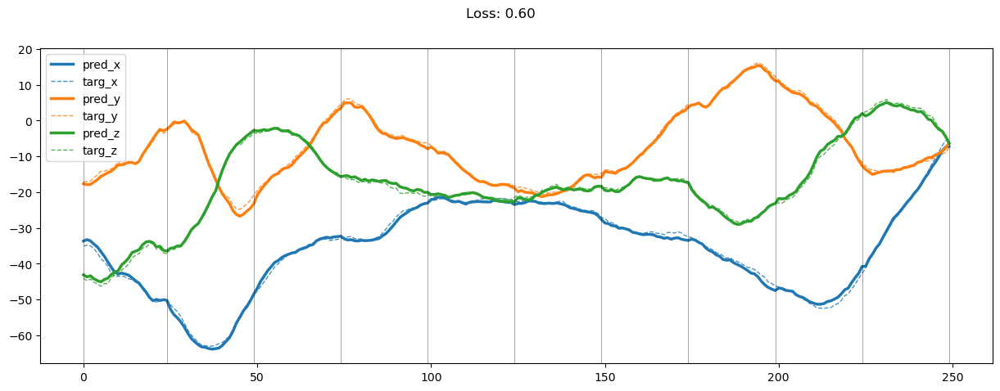

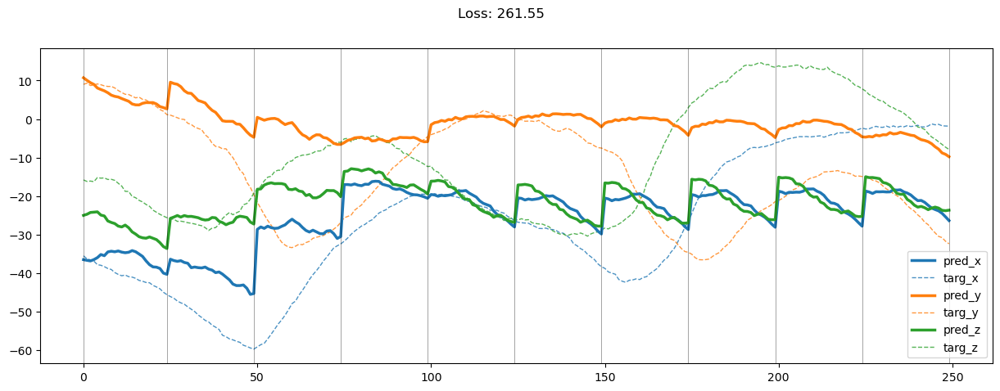

00949: train pred loss:  0.492, g loss:  1.856, diff loss:  0.972, d loss:  1.518
       valid pred loss:  172.908, g loss:  521.382, diff loss:  348.082, d loss:  1.523


100%|██████████| 17/17 [00:01<00:00, 15.15it/s]


00950: train pred loss:  0.483, g loss:  1.828, diff loss:  0.951, d loss:  1.514
       valid pred loss:  174.670, g loss:  530.420, diff loss:  355.357, d loss:  1.520


100%|██████████| 17/17 [00:01<00:00, 15.17it/s]


00951: train pred loss:  0.469, g loss:  1.789, diff loss:  0.923, d loss:  1.512
       valid pred loss:  171.114, g loss:  522.519, diff loss:  351.007, d loss:  1.517


100%|██████████| 17/17 [00:01<00:00, 15.17it/s]


00952: train pred loss:  0.473, g loss:  1.789, diff loss:  0.915, d loss:  1.508
       valid pred loss:  171.100, g loss:  519.960, diff loss:  348.460, d loss:  1.513


100%|██████████| 17/17 [00:01<00:00, 15.27it/s]


00953: train pred loss:  0.478, g loss:  1.825, diff loss:  0.942, d loss:  1.505
       valid pred loss:  171.978, g loss:  523.354, diff loss:  350.972, d loss:  1.510


100%|██████████| 17/17 [00:01<00:00, 15.20it/s]


00954: train pred loss:  0.471, g loss:  1.799, diff loss:  0.921, d loss:  1.502
       valid pred loss:  171.686, g loss:  522.906, diff loss:  350.812, d loss:  1.506


100%|██████████| 17/17 [00:01<00:00, 15.23it/s]


00955: train pred loss:  0.473, g loss:  1.815, diff loss:  0.931, d loss:  1.498
       valid pred loss:  171.088, g loss:  522.010, diff loss:  350.512, d loss:  1.504


100%|██████████| 17/17 [00:01<00:00, 15.20it/s]


00956: train pred loss:  0.471, g loss:  1.822, diff loss:  0.938, d loss:  1.496
       valid pred loss:  171.589, g loss:  519.005, diff loss:  347.002, d loss:  1.500


100%|██████████| 17/17 [00:01<00:00, 15.22it/s]


00957: train pred loss:  0.484, g loss:  1.855, diff loss:  0.954, d loss:  1.493
       valid pred loss:  172.119, g loss:  515.004, diff loss:  342.468, d loss:  1.497


100%|██████████| 17/17 [00:01<00:00, 15.23it/s]


00958: train pred loss:  0.495, g loss:  1.888, diff loss:  0.973, d loss:  1.490
       valid pred loss:  169.870, g loss:  514.821, diff loss:  344.532, d loss:  1.495


100%|██████████| 17/17 [00:01<00:00, 15.25it/s]


00959: train pred loss:  0.496, g loss:  1.901, diff loss:  0.983, d loss:  1.488
       valid pred loss:  169.583, g loss:  514.005, diff loss:  344.000, d loss:  1.492


100%|██████████| 17/17 [00:01<00:00, 15.25it/s]


00960: train pred loss:  0.515, g loss:  1.958, diff loss:  1.019, d loss:  1.486
       valid pred loss:  170.908, g loss:  519.248, diff loss:  347.916, d loss:  1.490


100%|██████████| 17/17 [00:01<00:00, 15.23it/s]


00961: train pred loss:  0.546, g loss:  2.051, diff loss:  1.078, d loss:  1.484
       valid pred loss:  175.780, g loss:  532.087, diff loss:  355.881, d loss:  1.488


100%|██████████| 17/17 [00:01<00:00, 15.23it/s]


00962: train pred loss:  0.583, g loss:  2.129, diff loss:  1.117, d loss:  1.482
       valid pred loss:  173.506, g loss:  520.775, diff loss:  346.842, d loss:  1.488


100%|██████████| 17/17 [00:01<00:00, 14.70it/s]


00963: train pred loss:  0.545, g loss:  2.049, diff loss:  1.075, d loss:  1.481
       valid pred loss:  169.220, g loss:  509.665, diff loss:  340.018, d loss:  1.487


100%|██████████| 17/17 [00:01<00:00, 14.88it/s]


00964: train pred loss:  0.522, g loss:  1.977, diff loss:  1.025, d loss:  1.481
       valid pred loss:  169.810, g loss:  510.679, diff loss:  340.441, d loss:  1.487


100%|██████████| 17/17 [00:01<00:00, 15.13it/s]


00965: train pred loss:  0.539, g loss:  1.999, diff loss:  1.030, d loss:  1.481
       valid pred loss:  169.831, g loss:  513.073, diff loss:  342.814, d loss:  1.486


100%|██████████| 17/17 [00:01<00:00, 15.23it/s]


00966: train pred loss:  0.510, g loss:  1.935, diff loss:  0.996, d loss:  1.481
       valid pred loss:  170.184, g loss:  518.378, diff loss:  347.768, d loss:  1.488


100%|██████████| 17/17 [00:01<00:00, 15.24it/s]


00967: train pred loss:  0.503, g loss:  1.903, diff loss:  0.972, d loss:  1.483
       valid pred loss:  172.429, g loss:  520.961, diff loss:  348.106, d loss:  1.489


100%|██████████| 17/17 [00:01<00:00, 14.97it/s]


00968: train pred loss:  0.483, g loss:  1.854, diff loss:  0.944, d loss:  1.484
       valid pred loss:  174.330, g loss:  526.946, diff loss:  352.193, d loss:  1.491


100%|██████████| 17/17 [00:01<00:00, 15.22it/s]


00969: train pred loss:  0.484, g loss:  1.864, diff loss:  0.957, d loss:  1.486
       valid pred loss:  172.124, g loss:  524.602, diff loss:  352.056, d loss:  1.492


100%|██████████| 17/17 [00:01<00:00, 15.12it/s]


00970: train pred loss:  0.486, g loss:  1.849, diff loss:  0.942, d loss:  1.488
       valid pred loss:  172.577, g loss:  517.315, diff loss:  344.320, d loss:  1.496


100%|██████████| 17/17 [00:01<00:00, 14.63it/s]


00971: train pred loss:  0.495, g loss:  1.864, diff loss:  0.950, d loss:  1.491
       valid pred loss:  173.869, g loss:  518.943, diff loss:  344.658, d loss:  1.497


100%|██████████| 17/17 [00:01<00:00, 15.00it/s]


00972: train pred loss:  0.476, g loss:  1.827, diff loss:  0.936, d loss:  1.494
       valid pred loss:  172.969, g loss:  525.717, diff loss:  352.336, d loss:  1.501


100%|██████████| 17/17 [00:01<00:00, 13.99it/s]


00973: train pred loss:  0.469, g loss:  1.789, diff loss:  0.907, d loss:  1.496
       valid pred loss:  170.896, g loss:  517.349, diff loss:  346.043, d loss:  1.504


100%|██████████| 17/17 [00:01<00:00, 14.80it/s]


00974: train pred loss:  0.499, g loss:  1.885, diff loss:  0.977, d loss:  1.499
       valid pred loss:  170.537, g loss:  514.506, diff loss:  343.563, d loss:  1.507


100%|██████████| 17/17 [00:01<00:00, 15.14it/s]


00975: train pred loss:  0.496, g loss:  1.873, diff loss:  0.970, d loss:  1.502
       valid pred loss:  172.809, g loss:  519.279, diff loss:  346.067, d loss:  1.510


100%|██████████| 17/17 [00:01<00:00, 15.12it/s]


00976: train pred loss:  0.483, g loss:  1.835, diff loss:  0.949, d loss:  1.506
       valid pred loss:  171.188, g loss:  522.842, diff loss:  351.255, d loss:  1.515


100%|██████████| 17/17 [00:01<00:00, 14.82it/s]


00977: train pred loss:  0.475, g loss:  1.821, diff loss:  0.946, d loss:  1.510
       valid pred loss:  174.661, g loss:  528.537, diff loss:  353.480, d loss:  1.518


100%|██████████| 17/17 [00:01<00:00, 14.13it/s]


00978: train pred loss:  0.480, g loss:  1.835, diff loss:  0.958, d loss:  1.513
       valid pred loss:  171.792, g loss:  524.347, diff loss:  352.162, d loss:  1.521


100%|██████████| 17/17 [00:01<00:00, 15.16it/s]


00979: train pred loss:  0.497, g loss:  1.879, diff loss:  0.988, d loss:  1.515
       valid pred loss:  173.639, g loss:  522.967, diff loss:  348.938, d loss:  1.524


100%|██████████| 17/17 [00:01<00:00, 15.15it/s]


00980: train pred loss:  0.565, g loss:  2.061, diff loss:  1.105, d loss:  1.519
       valid pred loss:  171.947, g loss:  522.567, diff loss:  350.233, d loss:  1.527


100%|██████████| 17/17 [00:01<00:00, 15.15it/s]


00981: train pred loss:  0.545, g loss:  1.996, diff loss:  1.063, d loss:  1.521
       valid pred loss:  172.117, g loss:  518.751, diff loss:  346.249, d loss:  1.530


100%|██████████| 17/17 [00:01<00:00, 15.06it/s]


00982: train pred loss:  0.521, g loss:  1.941, diff loss:  1.033, d loss:  1.523
       valid pred loss:  170.147, g loss:  515.278, diff loss:  344.747, d loss:  1.531


100%|██████████| 17/17 [00:01<00:00, 14.80it/s]


00983: train pred loss:  0.509, g loss:  1.896, diff loss:  1.002, d loss:  1.525
       valid pred loss:  169.984, g loss:  517.712, diff loss:  347.345, d loss:  1.533


100%|██████████| 17/17 [00:01<00:00, 14.58it/s]


00984: train pred loss:  0.482, g loss:  1.813, diff loss:  0.947, d loss:  1.526
       valid pred loss:  172.340, g loss:  526.674, diff loss:  353.954, d loss:  1.535


100%|██████████| 17/17 [00:01<00:00, 13.74it/s]


00985: train pred loss:  0.479, g loss:  1.801, diff loss:  0.938, d loss:  1.528
       valid pred loss:  169.853, g loss:  517.633, diff loss:  347.399, d loss:  1.534


100%|██████████| 17/17 [00:01<00:00, 15.23it/s]


00986: train pred loss:  0.510, g loss:  1.888, diff loss:  0.994, d loss:  1.527
       valid pred loss:  170.121, g loss:  518.055, diff loss:  347.553, d loss:  1.535


100%|██████████| 17/17 [00:01<00:00, 15.24it/s]


00987: train pred loss:  0.513, g loss:  1.889, diff loss:  0.993, d loss:  1.527
       valid pred loss:  170.198, g loss:  520.392, diff loss:  349.812, d loss:  1.534


100%|██████████| 17/17 [00:01<00:00, 15.24it/s]


00988: train pred loss:  0.500, g loss:  1.886, diff loss:  1.002, d loss:  1.526
       valid pred loss:  173.334, g loss:  525.355, diff loss:  351.639, d loss:  1.533


100%|██████████| 17/17 [00:01<00:00, 14.74it/s]


00989: train pred loss:  0.536, g loss:  1.975, diff loss:  1.053, d loss:  1.525
       valid pred loss:  173.510, g loss:  527.552, diff loss:  353.659, d loss:  1.531


100%|██████████| 17/17 [00:01<00:00, 15.26it/s]


00990: train pred loss:  0.523, g loss:  1.939, diff loss:  1.030, d loss:  1.524
       valid pred loss:  177.522, g loss:  543.745, diff loss:  365.838, d loss:  1.530


100%|██████████| 17/17 [00:01<00:00, 15.25it/s]


00991: train pred loss:  0.538, g loss:  1.960, diff loss:  1.034, d loss:  1.522
       valid pred loss:  175.992, g loss:  539.288, diff loss:  362.909, d loss:  1.527


100%|██████████| 17/17 [00:01<00:00, 15.27it/s]


00992: train pred loss:  0.505, g loss:  1.878, diff loss:  0.983, d loss:  1.520
       valid pred loss:  176.277, g loss:  541.459, diff loss:  364.792, d loss:  1.525


100%|██████████| 17/17 [00:01<00:00, 15.25it/s]


00993: train pred loss:  0.477, g loss:  1.817, diff loss:  0.947, d loss:  1.517
       valid pred loss:  174.448, g loss:  531.612, diff loss:  356.772, d loss:  1.522


100%|██████████| 17/17 [00:01<00:00, 15.23it/s]


00994: train pred loss:  0.483, g loss:  1.827, diff loss:  0.949, d loss:  1.514
       valid pred loss:  175.358, g loss:  534.171, diff loss:  358.418, d loss:  1.519


100%|██████████| 17/17 [00:01<00:00, 15.24it/s]


00995: train pred loss:  0.476, g loss:  1.812, diff loss:  0.937, d loss:  1.510
       valid pred loss:  177.330, g loss:  545.070, diff loss:  367.343, d loss:  1.516


100%|██████████| 17/17 [00:01<00:00, 15.21it/s]


00996: train pred loss:  0.475, g loss:  1.800, diff loss:  0.923, d loss:  1.507
       valid pred loss:  173.321, g loss:  532.772, diff loss:  359.049, d loss:  1.512


100%|██████████| 17/17 [00:01<00:00, 15.20it/s]


00997: train pred loss:  0.462, g loss:  1.785, diff loss:  0.918, d loss:  1.504
       valid pred loss:  174.920, g loss:  537.251, diff loss:  361.926, d loss:  1.508


100%|██████████| 17/17 [00:01<00:00, 15.20it/s]


00998: train pred loss:  0.485, g loss:  1.856, diff loss:  0.962, d loss:  1.501
       valid pred loss:  175.832, g loss:  541.065, diff loss:  364.824, d loss:  1.505


100%|██████████| 17/17 [00:01<00:00, 15.19it/s]


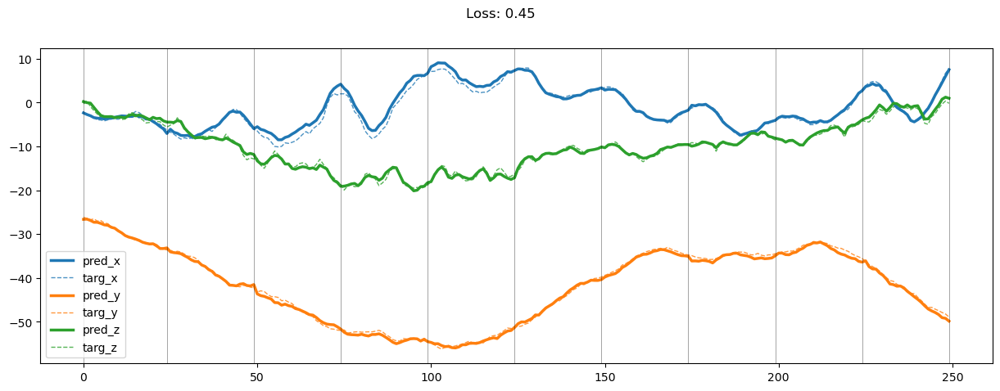

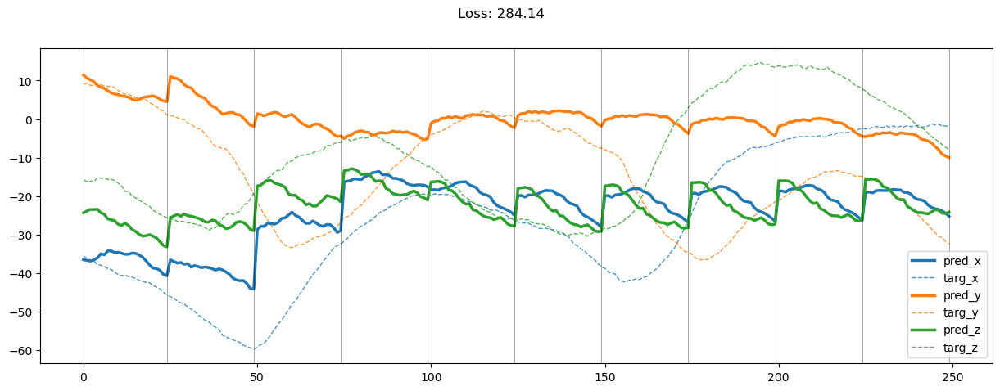

00999: train pred loss:  0.495, g loss:  1.872, diff loss:  0.966, d loss:  1.498
       valid pred loss:  176.281, g loss:  544.998, diff loss:  368.304, d loss:  1.501


100%|██████████| 17/17 [00:01<00:00, 15.11it/s]


01000: train pred loss:  0.492, g loss:  1.853, diff loss:  0.945, d loss:  1.493
       valid pred loss:  179.280, g loss:  549.625, diff loss:  369.930, d loss:  1.498


100%|██████████| 17/17 [00:01<00:00, 15.28it/s]


01001: train pred loss:  0.477, g loss:  1.836, diff loss:  0.941, d loss:  1.491
       valid pred loss:  178.023, g loss:  538.933, diff loss:  360.492, d loss:  1.495


100%|██████████| 17/17 [00:01<00:00, 15.25it/s]


01002: train pred loss:  0.477, g loss:  1.838, diff loss:  0.939, d loss:  1.488
       valid pred loss:  176.219, g loss:  531.925, diff loss:  355.285, d loss:  1.493


100%|██████████| 17/17 [00:01<00:00, 15.27it/s]


01003: train pred loss:  0.473, g loss:  1.818, diff loss:  0.921, d loss:  1.486
       valid pred loss:  175.821, g loss:  538.032, diff loss:  361.788, d loss:  1.491


100%|██████████| 17/17 [00:01<00:00, 15.19it/s]


01004: train pred loss:  0.462, g loss:  1.792, diff loss:  0.904, d loss:  1.485
       valid pred loss:  175.852, g loss:  534.321, diff loss:  358.044, d loss:  1.488


100%|██████████| 17/17 [00:01<00:00, 14.12it/s]


01005: train pred loss:  0.456, g loss:  1.790, diff loss:  0.906, d loss:  1.483
       valid pred loss:  175.841, g loss:  535.681, diff loss:  359.414, d loss:  1.487


100%|██████████| 17/17 [00:01<00:00, 15.23it/s]


01006: train pred loss:  0.484, g loss:  1.857, diff loss:  0.943, d loss:  1.482
       valid pred loss:  176.076, g loss:  536.670, diff loss:  360.166, d loss:  1.486


100%|██████████| 17/17 [00:01<00:00, 15.22it/s]


01007: train pred loss:  0.463, g loss:  1.815, diff loss:  0.921, d loss:  1.481
       valid pred loss:  175.674, g loss:  530.772, diff loss:  354.669, d loss:  1.485


100%|██████████| 17/17 [00:01<00:00, 15.20it/s]


01008: train pred loss:  0.478, g loss:  1.847, diff loss:  0.939, d loss:  1.480
       valid pred loss:  175.538, g loss:  532.514, diff loss:  356.548, d loss:  1.486


100%|██████████| 17/17 [00:01<00:00, 15.18it/s]


01009: train pred loss:  0.500, g loss:  1.918, diff loss:  0.987, d loss:  1.480
       valid pred loss:  173.745, g loss:  531.950, diff loss:  357.777, d loss:  1.487


100%|██████████| 17/17 [00:01<00:00, 15.21it/s]


01010: train pred loss:  0.507, g loss:  1.942, diff loss:  1.006, d loss:  1.481
       valid pred loss:  176.590, g loss:  530.702, diff loss:  353.685, d loss:  1.487


100%|██████████| 17/17 [00:01<00:00, 15.21it/s]


01011: train pred loss:  0.506, g loss:  1.907, diff loss:  0.973, d loss:  1.483
       valid pred loss:  176.635, g loss:  533.723, diff loss:  356.662, d loss:  1.488


100%|██████████| 17/17 [00:01<00:00, 15.15it/s]


01012: train pred loss:  0.471, g loss:  1.833, diff loss:  0.936, d loss:  1.484
       valid pred loss:  177.652, g loss:  541.369, diff loss:  363.294, d loss:  1.490


100%|██████████| 17/17 [00:01<00:00, 14.68it/s]


01013: train pred loss:  0.487, g loss:  1.879, diff loss:  0.969, d loss:  1.486
       valid pred loss:  175.511, g loss:  533.308, diff loss:  357.375, d loss:  1.492


100%|██████████| 17/17 [00:01<00:00, 15.19it/s]


01014: train pred loss:  0.513, g loss:  1.950, diff loss:  1.016, d loss:  1.488
       valid pred loss:  175.979, g loss:  535.538, diff loss:  359.141, d loss:  1.495


100%|██████████| 17/17 [00:01<00:00, 15.18it/s]


01015: train pred loss:  0.506, g loss:  1.921, diff loss:  0.997, d loss:  1.491
       valid pred loss:  177.776, g loss:  541.771, diff loss:  363.581, d loss:  1.499


100%|██████████| 17/17 [00:01<00:00, 15.11it/s]


01016: train pred loss:  0.486, g loss:  1.848, diff loss:  0.947, d loss:  1.494
       valid pred loss:  174.236, g loss:  532.654, diff loss:  358.008, d loss:  1.502


100%|██████████| 17/17 [00:01<00:00, 15.04it/s]


01017: train pred loss:  0.490, g loss:  1.862, diff loss:  0.960, d loss:  1.497
       valid pred loss:  179.935, g loss:  547.958, diff loss:  367.615, d loss:  1.506


100%|██████████| 17/17 [00:01<00:00, 15.12it/s]


01018: train pred loss:  0.533, g loss:  1.968, diff loss:  1.027, d loss:  1.500
       valid pred loss:  177.682, g loss:  542.507, diff loss:  364.421, d loss:  1.508


100%|██████████| 17/17 [00:01<00:00, 15.19it/s]


01019: train pred loss:  0.529, g loss:  1.967, diff loss:  1.033, d loss:  1.504
       valid pred loss:  175.617, g loss:  533.146, diff loss:  357.128, d loss:  1.512


100%|██████████| 17/17 [00:01<00:00, 15.22it/s]


01020: train pred loss:  0.520, g loss:  1.949, diff loss:  1.028, d loss:  1.507
       valid pred loss:  174.202, g loss:  529.119, diff loss:  354.519, d loss:  1.516


100%|██████████| 17/17 [00:01<00:00, 15.23it/s]


01021: train pred loss:  0.544, g loss:  1.996, diff loss:  1.054, d loss:  1.512
       valid pred loss:  173.039, g loss:  530.691, diff loss:  357.258, d loss:  1.519


100%|██████████| 17/17 [00:01<00:00, 15.23it/s]


01022: train pred loss:  0.561, g loss:  2.035, diff loss:  1.079, d loss:  1.515
       valid pred loss:  174.653, g loss:  536.296, diff loss:  361.253, d loss:  1.523


100%|██████████| 17/17 [00:01<00:00, 15.23it/s]


01023: train pred loss:  0.546, g loss:  1.982, diff loss:  1.043, d loss:  1.517
       valid pred loss:  177.142, g loss:  540.338, diff loss:  362.807, d loss:  1.526


100%|██████████| 17/17 [00:01<00:00, 15.15it/s]


01024: train pred loss:  0.526, g loss:  1.947, diff loss:  1.031, d loss:  1.521
       valid pred loss:  176.270, g loss:  537.747, diff loss:  361.090, d loss:  1.528


100%|██████████| 17/17 [00:01<00:00, 13.95it/s]


01025: train pred loss:  0.544, g loss:  1.987, diff loss:  1.055, d loss:  1.522
       valid pred loss:  174.647, g loss:  535.171, diff loss:  360.140, d loss:  1.532


100%|██████████| 17/17 [00:01<00:00, 14.37it/s]


01026: train pred loss:  0.514, g loss:  1.905, diff loss:  1.005, d loss:  1.526
       valid pred loss:  174.546, g loss:  534.880, diff loss:  359.953, d loss:  1.534


100%|██████████| 17/17 [00:01<00:00, 15.14it/s]


01027: train pred loss:  0.498, g loss:  1.853, diff loss:  0.970, d loss:  1.526
       valid pred loss:  173.958, g loss:  534.528, diff loss:  360.189, d loss:  1.535


100%|██████████| 17/17 [00:01<00:00, 15.25it/s]


01028: train pred loss:  0.515, g loss:  1.896, diff loss:  0.998, d loss:  1.528
       valid pred loss:  178.621, g loss:  547.540, diff loss:  368.538, d loss:  1.535


100%|██████████| 17/17 [00:01<00:00, 15.26it/s]


01029: train pred loss:  0.513, g loss:  1.895, diff loss:  1.000, d loss:  1.528
       valid pred loss:  173.103, g loss:  527.713, diff loss:  354.229, d loss:  1.535


100%|██████████| 17/17 [00:01<00:00, 15.26it/s]


01030: train pred loss:  0.503, g loss:  1.878, diff loss:  0.993, d loss:  1.528
       valid pred loss:  174.723, g loss:  534.792, diff loss:  359.689, d loss:  1.536


100%|██████████| 17/17 [00:01<00:00, 15.27it/s]


01031: train pred loss:  0.503, g loss:  1.842, diff loss:  0.956, d loss:  1.528
       valid pred loss:  174.943, g loss:  536.417, diff loss:  361.094, d loss:  1.536


100%|██████████| 17/17 [00:01<00:00, 15.14it/s]


01032: train pred loss:  0.478, g loss:  1.800, diff loss:  0.939, d loss:  1.527
       valid pred loss:  175.705, g loss:  539.161, diff loss:  363.076, d loss:  1.534


100%|██████████| 17/17 [00:01<00:00, 14.32it/s]


01033: train pred loss:  0.472, g loss:  1.777, diff loss:  0.922, d loss:  1.526
       valid pred loss:  175.596, g loss:  535.548, diff loss:  359.570, d loss:  1.532


100%|██████████| 17/17 [00:01<00:00, 14.54it/s]


01034: train pred loss:  0.485, g loss:  1.824, diff loss:  0.952, d loss:  1.524
       valid pred loss:  177.867, g loss:  534.443, diff loss:  356.192, d loss:  1.530


100%|██████████| 17/17 [00:01<00:00, 14.71it/s]


01035: train pred loss:  0.488, g loss:  1.842, diff loss:  0.965, d loss:  1.522
       valid pred loss:  173.692, g loss:  533.772, diff loss:  359.693, d loss:  1.527


100%|██████████| 17/17 [00:01<00:00, 15.20it/s]


01036: train pred loss:  0.507, g loss:  1.875, diff loss:  0.977, d loss:  1.519
       valid pred loss:  176.198, g loss:  537.252, diff loss:  360.664, d loss:  1.524


100%|██████████| 17/17 [00:01<00:00, 15.24it/s]


01037: train pred loss:  0.489, g loss:  1.851, diff loss:  0.968, d loss:  1.516
       valid pred loss:  175.189, g loss:  540.624, diff loss:  365.042, d loss:  1.521


100%|██████████| 17/17 [00:01<00:00, 15.25it/s]


01038: train pred loss:  0.501, g loss:  1.892, diff loss:  0.995, d loss:  1.513
       valid pred loss:  176.407, g loss:  539.516, diff loss:  362.714, d loss:  1.518


100%|██████████| 17/17 [00:01<00:00, 14.90it/s]


01039: train pred loss:  0.478, g loss:  1.823, diff loss:  0.946, d loss:  1.510
       valid pred loss:  176.200, g loss:  537.080, diff loss:  360.480, d loss:  1.514


100%|██████████| 17/17 [00:01<00:00, 14.98it/s]


01040: train pred loss:  0.470, g loss:  1.786, diff loss:  0.913, d loss:  1.506
       valid pred loss:  174.245, g loss:  537.053, diff loss:  362.405, d loss:  1.510


100%|██████████| 17/17 [00:01<00:00, 14.91it/s]


01041: train pred loss:  0.468, g loss:  1.790, diff loss:  0.915, d loss:  1.502
       valid pred loss:  175.813, g loss:  538.335, diff loss:  362.116, d loss:  1.507


100%|██████████| 17/17 [00:01<00:00, 15.23it/s]


01042: train pred loss:  0.447, g loss:  1.743, diff loss:  0.886, d loss:  1.498
       valid pred loss:  175.295, g loss:  537.555, diff loss:  361.850, d loss:  1.503


100%|██████████| 17/17 [00:01<00:00, 14.94it/s]


01043: train pred loss:  0.461, g loss:  1.785, diff loss:  0.910, d loss:  1.495
       valid pred loss:  175.805, g loss:  534.737, diff loss:  358.517, d loss:  1.499


100%|██████████| 17/17 [00:01<00:00, 15.21it/s]


01044: train pred loss:  0.471, g loss:  1.800, diff loss:  0.912, d loss:  1.492
       valid pred loss:  173.250, g loss:  525.251, diff loss:  351.584, d loss:  1.496


100%|██████████| 17/17 [00:01<00:00, 15.17it/s]


01045: train pred loss:  0.483, g loss:  1.841, diff loss:  0.938, d loss:  1.489
       valid pred loss:  175.870, g loss:  540.532, diff loss:  364.242, d loss:  1.494


100%|██████████| 17/17 [00:01<00:00, 15.17it/s]


01046: train pred loss:  0.463, g loss:  1.804, diff loss:  0.917, d loss:  1.487
       valid pred loss:  173.760, g loss:  530.851, diff loss:  356.668, d loss:  1.491


100%|██████████| 17/17 [00:01<00:00, 14.64it/s]


01047: train pred loss:  0.486, g loss:  1.867, diff loss:  0.955, d loss:  1.483
       valid pred loss:  173.259, g loss:  532.656, diff loss:  358.972, d loss:  1.489


100%|██████████| 17/17 [00:01<00:00, 14.68it/s]


01048: train pred loss:  0.465, g loss:  1.819, diff loss:  0.926, d loss:  1.482
       valid pred loss:  175.827, g loss:  538.961, diff loss:  362.707, d loss:  1.488


100%|██████████| 17/17 [00:01<00:00, 14.78it/s]


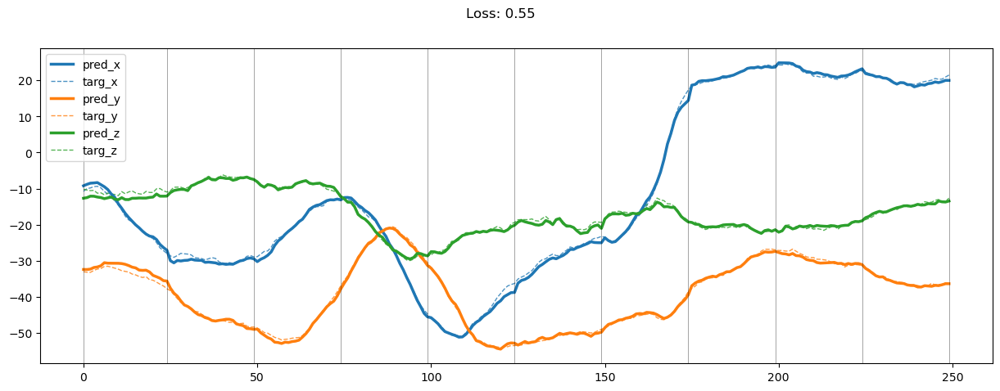

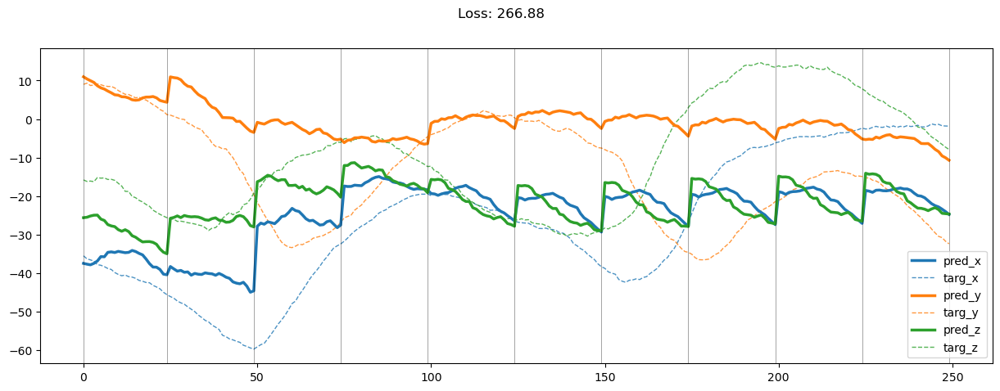

01049: train pred loss:  0.460, g loss:  1.793, diff loss:  0.903, d loss:  1.480
       valid pred loss:  174.842, g loss:  536.344, diff loss:  361.073, d loss:  1.485


100%|██████████| 17/17 [00:01<00:00, 15.12it/s]


01050: train pred loss:  0.474, g loss:  1.843, diff loss:  0.938, d loss:  1.480
       valid pred loss:  175.222, g loss:  539.373, diff loss:  363.721, d loss:  1.485


100%|██████████| 17/17 [00:01<00:00, 15.18it/s]


01051: train pred loss:  0.470, g loss:  1.815, diff loss:  0.913, d loss:  1.479
       valid pred loss:  173.151, g loss:  533.101, diff loss:  359.520, d loss:  1.484


100%|██████████| 17/17 [00:01<00:00, 15.02it/s]


01052: train pred loss:  0.478, g loss:  1.849, diff loss:  0.940, d loss:  1.479
       valid pred loss:  175.443, g loss:  540.599, diff loss:  364.726, d loss:  1.485


100%|██████████| 17/17 [00:01<00:00, 15.12it/s]


01053: train pred loss:  0.483, g loss:  1.866, diff loss:  0.952, d loss:  1.479
       valid pred loss:  173.464, g loss:  532.561, diff loss:  358.668, d loss:  1.486


100%|██████████| 17/17 [00:01<00:00, 14.31it/s]


01054: train pred loss:  0.483, g loss:  1.866, diff loss:  0.952, d loss:  1.481
       valid pred loss:  173.890, g loss:  536.986, diff loss:  362.668, d loss:  1.487


100%|██████████| 17/17 [00:01<00:00, 14.81it/s]


01055: train pred loss:  0.472, g loss:  1.816, diff loss:  0.915, d loss:  1.482
       valid pred loss:  176.137, g loss:  543.228, diff loss:  366.667, d loss:  1.489


100%|██████████| 17/17 [00:01<00:00, 14.90it/s]


01056: train pred loss:  0.471, g loss:  1.823, diff loss:  0.926, d loss:  1.484
       valid pred loss:  173.720, g loss:  537.180, diff loss:  363.038, d loss:  1.491


100%|██████████| 17/17 [00:01<00:00, 14.96it/s]


01057: train pred loss:  0.476, g loss:  1.826, diff loss:  0.927, d loss:  1.486
       valid pred loss:  175.075, g loss:  538.109, diff loss:  362.614, d loss:  1.494


100%|██████████| 17/17 [00:01<00:00, 15.15it/s]


01058: train pred loss:  0.471, g loss:  1.823, diff loss:  0.932, d loss:  1.489
       valid pred loss:  173.344, g loss:  534.866, diff loss:  361.106, d loss:  1.496


100%|██████████| 17/17 [00:01<00:00, 15.13it/s]


01059: train pred loss:  0.467, g loss:  1.799, diff loss:  0.915, d loss:  1.492
       valid pred loss:  176.875, g loss:  544.496, diff loss:  367.208, d loss:  1.500


100%|██████████| 17/17 [00:01<00:00, 15.13it/s]


01060: train pred loss:  0.476, g loss:  1.824, diff loss:  0.935, d loss:  1.496
       valid pred loss:  172.781, g loss:  530.023, diff loss:  356.832, d loss:  1.503


100%|██████████| 17/17 [00:01<00:00, 15.09it/s]


01061: train pred loss:  0.469, g loss:  1.794, diff loss:  0.915, d loss:  1.499
       valid pred loss:  174.157, g loss:  540.569, diff loss:  366.006, d loss:  1.507


100%|██████████| 17/17 [00:01<00:00, 14.93it/s]


01062: train pred loss:  0.465, g loss:  1.790, diff loss:  0.919, d loss:  1.503
       valid pred loss:  173.704, g loss:  542.351, diff loss:  368.246, d loss:  1.512


100%|██████████| 17/17 [00:01<00:00, 14.44it/s]


01063: train pred loss:  0.472, g loss:  1.809, diff loss:  0.935, d loss:  1.506
       valid pred loss:  173.097, g loss:  537.607, diff loss:  364.112, d loss:  1.516


100%|██████████| 17/17 [00:01<00:00, 14.63it/s]


01064: train pred loss:  0.469, g loss:  1.805, diff loss:  0.937, d loss:  1.509
       valid pred loss:  175.108, g loss:  541.734, diff loss:  366.231, d loss:  1.519


100%|██████████| 17/17 [00:01<00:00, 14.60it/s]


01065: train pred loss:  0.477, g loss:  1.818, diff loss:  0.945, d loss:  1.513
       valid pred loss:  175.642, g loss:  547.296, diff loss:  371.262, d loss:  1.522


100%|██████████| 17/17 [00:01<00:00, 14.24it/s]


01066: train pred loss:  0.475, g loss:  1.811, diff loss:  0.943, d loss:  1.516
       valid pred loss:  175.283, g loss:  540.756, diff loss:  365.084, d loss:  1.525


100%|██████████| 17/17 [00:01<00:00, 14.04it/s]


01067: train pred loss:  0.477, g loss:  1.805, diff loss:  0.938, d loss:  1.520
       valid pred loss:  172.712, g loss:  532.987, diff loss:  359.889, d loss:  1.528


100%|██████████| 17/17 [00:01<00:00, 14.06it/s]


01068: train pred loss:  0.489, g loss:  1.844, diff loss:  0.968, d loss:  1.523
       valid pred loss:  172.879, g loss:  533.678, diff loss:  360.416, d loss:  1.532


100%|██████████| 17/17 [00:01<00:00, 15.14it/s]


01069: train pred loss:  0.505, g loss:  1.885, diff loss:  0.994, d loss:  1.525
       valid pred loss:  170.916, g loss:  527.069, diff loss:  355.771, d loss:  1.533


100%|██████████| 17/17 [00:01<00:00, 15.17it/s]


01070: train pred loss:  0.498, g loss:  1.877, diff loss:  0.995, d loss:  1.527
       valid pred loss:  172.931, g loss:  530.907, diff loss:  357.596, d loss:  1.534


100%|██████████| 17/17 [00:01<00:00, 15.13it/s]


01071: train pred loss:  0.491, g loss:  1.841, diff loss:  0.967, d loss:  1.528
       valid pred loss:  174.663, g loss:  538.672, diff loss:  363.630, d loss:  1.536


100%|██████████| 17/17 [00:01<00:00, 14.65it/s]


01072: train pred loss:  0.497, g loss:  1.871, diff loss:  0.992, d loss:  1.529
       valid pred loss:  172.733, g loss:  529.759, diff loss:  356.647, d loss:  1.537


100%|██████████| 17/17 [00:01<00:00, 15.17it/s]


01073: train pred loss:  0.517, g loss:  1.916, diff loss:  1.018, d loss:  1.530
       valid pred loss:  173.498, g loss:  532.428, diff loss:  358.552, d loss:  1.537


100%|██████████| 17/17 [00:01<00:00, 15.18it/s]


01074: train pred loss:  0.510, g loss:  1.894, diff loss:  1.003, d loss:  1.530
       valid pred loss:  170.930, g loss:  529.722, diff loss:  358.413, d loss:  1.536


100%|██████████| 17/17 [00:01<00:00, 14.97it/s]


01075: train pred loss:  0.497, g loss:  1.869, diff loss:  0.991, d loss:  1.529
       valid pred loss:  171.691, g loss:  533.000, diff loss:  360.929, d loss:  1.535


100%|██████████| 17/17 [00:01<00:00, 14.71it/s]


01076: train pred loss:  0.514, g loss:  1.912, diff loss:  1.015, d loss:  1.527
       valid pred loss:  169.529, g loss:  522.856, diff loss:  352.946, d loss:  1.533


100%|██████████| 17/17 [00:01<00:00, 15.16it/s]


01077: train pred loss:  0.491, g loss:  1.853, diff loss:  0.977, d loss:  1.525
       valid pred loss:  169.389, g loss:  521.560, diff loss:  351.788, d loss:  1.531


100%|██████████| 17/17 [00:01<00:00, 15.21it/s]


01078: train pred loss:  0.494, g loss:  1.855, diff loss:  0.975, d loss:  1.523
       valid pred loss:  168.585, g loss:  522.458, diff loss:  353.488, d loss:  1.529


100%|██████████| 17/17 [00:01<00:00, 15.18it/s]


01079: train pred loss:  0.482, g loss:  1.811, diff loss:  0.941, d loss:  1.521
       valid pred loss:  171.584, g loss:  528.564, diff loss:  356.593, d loss:  1.527


100%|██████████| 17/17 [00:01<00:00, 15.17it/s]


01080: train pred loss:  0.473, g loss:  1.788, diff loss:  0.923, d loss:  1.518
       valid pred loss:  171.691, g loss:  530.662, diff loss:  358.581, d loss:  1.524


100%|██████████| 17/17 [00:01<00:00, 15.17it/s]


01081: train pred loss:  0.478, g loss:  1.803, diff loss:  0.930, d loss:  1.514
       valid pred loss:  168.002, g loss:  520.948, diff loss:  352.552, d loss:  1.519


100%|██████████| 17/17 [00:01<00:00, 14.82it/s]


01082: train pred loss:  0.486, g loss:  1.834, diff loss:  0.949, d loss:  1.510
       valid pred loss:  170.008, g loss:  522.097, diff loss:  351.691, d loss:  1.515


100%|██████████| 17/17 [00:01<00:00, 15.18it/s]


01083: train pred loss:  0.474, g loss:  1.797, diff loss:  0.921, d loss:  1.507
       valid pred loss:  171.105, g loss:  531.585, diff loss:  360.078, d loss:  1.511


100%|██████████| 17/17 [00:01<00:00, 15.18it/s]


01084: train pred loss:  0.476, g loss:  1.826, diff loss:  0.945, d loss:  1.503
       valid pred loss:  171.634, g loss:  523.193, diff loss:  351.154, d loss:  1.508


100%|██████████| 17/17 [00:01<00:00, 15.20it/s]


01085: train pred loss:  0.469, g loss:  1.808, diff loss:  0.930, d loss:  1.500
       valid pred loss:  171.059, g loss:  525.479, diff loss:  354.010, d loss:  1.503


100%|██████████| 17/17 [00:01<00:00, 14.86it/s]


01086: train pred loss:  0.492, g loss:  1.870, diff loss:  0.965, d loss:  1.496
       valid pred loss:  170.869, g loss:  522.156, diff loss:  350.874, d loss:  1.501


100%|██████████| 17/17 [00:01<00:00, 14.31it/s]


01087: train pred loss:  0.483, g loss:  1.848, diff loss:  0.948, d loss:  1.493
       valid pred loss:  167.951, g loss:  514.598, diff loss:  346.232, d loss:  1.498


100%|██████████| 17/17 [00:01<00:00, 14.88it/s]


01088: train pred loss:  0.492, g loss:  1.884, diff loss:  0.972, d loss:  1.489
       valid pred loss:  170.529, g loss:  524.727, diff loss:  353.778, d loss:  1.494


100%|██████████| 17/17 [00:01<00:00, 15.22it/s]


01089: train pred loss:  0.503, g loss:  1.912, diff loss:  0.986, d loss:  1.487
       valid pred loss:  172.656, g loss:  527.279, diff loss:  354.201, d loss:  1.492


100%|██████████| 17/17 [00:01<00:00, 15.10it/s]


01090: train pred loss:  0.488, g loss:  1.871, diff loss:  0.957, d loss:  1.484
       valid pred loss:  172.595, g loss:  532.648, diff loss:  359.628, d loss:  1.489


100%|██████████| 17/17 [00:01<00:00, 15.18it/s]


01091: train pred loss:  0.485, g loss:  1.862, diff loss:  0.949, d loss:  1.482
       valid pred loss:  171.775, g loss:  531.703, diff loss:  359.501, d loss:  1.488


100%|██████████| 17/17 [00:01<00:00, 15.18it/s]


01092: train pred loss:  0.482, g loss:  1.867, diff loss:  0.955, d loss:  1.481
       valid pred loss:  173.612, g loss:  533.558, diff loss:  359.517, d loss:  1.485


100%|██████████| 17/17 [00:01<00:00, 15.18it/s]


01093: train pred loss:  0.488, g loss:  1.870, diff loss:  0.950, d loss:  1.479
       valid pred loss:  174.705, g loss:  536.967, diff loss:  361.832, d loss:  1.485


100%|██████████| 17/17 [00:01<00:00, 15.15it/s]


01094: train pred loss:  0.518, g loss:  1.938, diff loss:  0.987, d loss:  1.479
       valid pred loss:  172.623, g loss:  529.249, diff loss:  356.195, d loss:  1.484


100%|██████████| 17/17 [00:01<00:00, 15.14it/s]


01095: train pred loss:  0.489, g loss:  1.900, diff loss:  0.978, d loss:  1.478
       valid pred loss:  172.440, g loss:  528.764, diff loss:  355.892, d loss:  1.484


100%|██████████| 17/17 [00:01<00:00, 15.06it/s]


01096: train pred loss:  0.508, g loss:  1.949, diff loss:  1.010, d loss:  1.479
       valid pred loss:  174.409, g loss:  531.459, diff loss:  356.619, d loss:  1.485


100%|██████████| 17/17 [00:01<00:00, 14.82it/s]


01097: train pred loss:  0.493, g loss:  1.903, diff loss:  0.978, d loss:  1.479
       valid pred loss:  171.860, g loss:  526.203, diff loss:  353.914, d loss:  1.486


100%|██████████| 17/17 [00:01<00:00, 14.89it/s]


01098: train pred loss:  0.506, g loss:  1.940, diff loss:  1.004, d loss:  1.480
       valid pred loss:  172.422, g loss:  526.210, diff loss:  353.361, d loss:  1.487


100%|██████████| 17/17 [00:01<00:00, 15.03it/s]


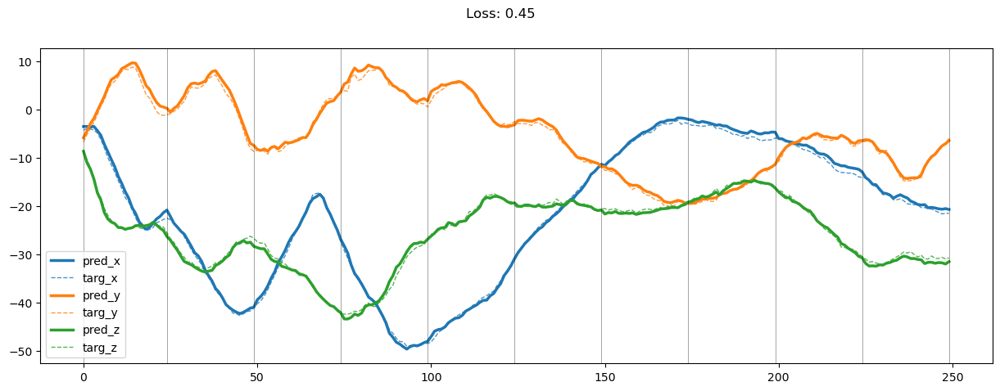

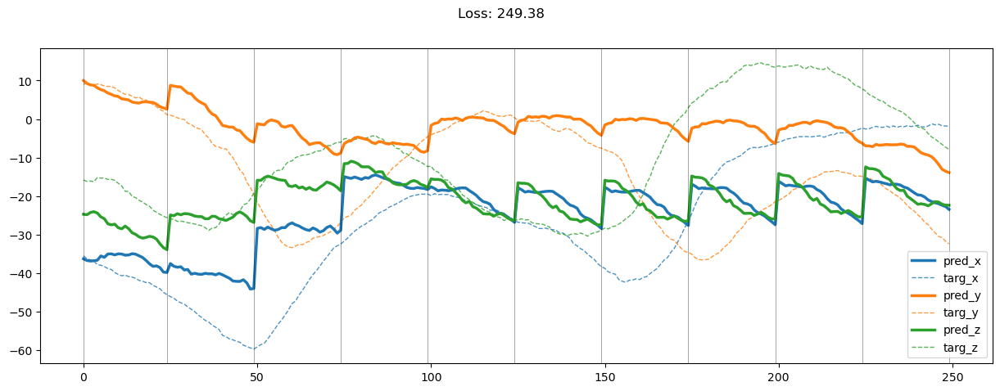

01099: train pred loss:  0.519, g loss:  1.968, diff loss:  1.021, d loss:  1.482
       valid pred loss:  170.755, g loss:  526.313, diff loss:  355.134, d loss:  1.490


100%|██████████| 17/17 [00:01<00:00, 15.13it/s]


01100: train pred loss:  0.511, g loss:  1.938, diff loss:  1.002, d loss:  1.485
       valid pred loss:  171.293, g loss:  524.540, diff loss:  352.825, d loss:  1.492


100%|██████████| 17/17 [00:01<00:00, 15.22it/s]


01101: train pred loss:  0.492, g loss:  1.878, diff loss:  0.963, d loss:  1.487
       valid pred loss:  171.640, g loss:  523.984, diff loss:  351.925, d loss:  1.495


100%|██████████| 17/17 [00:01<00:00, 15.17it/s]


01102: train pred loss:  0.482, g loss:  1.840, diff loss:  0.940, d loss:  1.491
       valid pred loss:  170.412, g loss:  515.314, diff loss:  344.488, d loss:  1.499


100%|██████████| 17/17 [00:01<00:00, 15.17it/s]


01103: train pred loss:  0.486, g loss:  1.853, diff loss:  0.951, d loss:  1.494
       valid pred loss:  172.309, g loss:  521.230, diff loss:  348.511, d loss:  1.502


100%|██████████| 17/17 [00:01<00:00, 14.38it/s]


01104: train pred loss:  0.480, g loss:  1.839, diff loss:  0.948, d loss:  1.498
       valid pred loss:  172.494, g loss:  522.841, diff loss:  349.940, d loss:  1.506


100%|██████████| 17/17 [00:01<00:00, 14.85it/s]


01105: train pred loss:  0.469, g loss:  1.797, diff loss:  0.920, d loss:  1.502
       valid pred loss:  173.298, g loss:  525.384, diff loss:  351.683, d loss:  1.510


100%|██████████| 17/17 [00:01<00:00, 15.21it/s]


01106: train pred loss:  0.467, g loss:  1.786, diff loss:  0.915, d loss:  1.504
       valid pred loss:  172.487, g loss:  528.812, diff loss:  355.926, d loss:  1.514


100%|██████████| 17/17 [00:01<00:00, 15.11it/s]


01107: train pred loss:  0.483, g loss:  1.824, diff loss:  0.942, d loss:  1.509
       valid pred loss:  171.348, g loss:  525.513, diff loss:  353.769, d loss:  1.518


100%|██████████| 17/17 [00:01<00:00, 15.10it/s]


01108: train pred loss:  0.470, g loss:  1.788, diff loss:  0.921, d loss:  1.513
       valid pred loss:  171.254, g loss:  524.808, diff loss:  353.162, d loss:  1.522


100%|██████████| 17/17 [00:01<00:00, 14.15it/s]


01109: train pred loss:  0.473, g loss:  1.797, diff loss:  0.931, d loss:  1.517
       valid pred loss:  170.995, g loss:  515.986, diff loss:  344.604, d loss:  1.528


100%|██████████| 17/17 [00:01<00:00, 15.27it/s]


01110: train pred loss:  0.472, g loss:  1.802, diff loss:  0.941, d loss:  1.521
       valid pred loss:  167.670, g loss:  516.436, diff loss:  348.382, d loss:  1.532


100%|██████████| 17/17 [00:01<00:00, 15.09it/s]


01111: train pred loss:  0.487, g loss:  1.826, diff loss:  0.953, d loss:  1.524
       valid pred loss:  169.294, g loss:  517.057, diff loss:  347.380, d loss:  1.532


100%|██████████| 17/17 [00:01<00:00, 15.27it/s]


01112: train pred loss:  0.510, g loss:  1.882, diff loss:  0.986, d loss:  1.524
       valid pred loss:  170.977, g loss:  516.981, diff loss:  345.622, d loss:  1.533


100%|██████████| 17/17 [00:01<00:00, 15.27it/s]


01113: train pred loss:  0.515, g loss:  1.885, diff loss:  0.986, d loss:  1.526
       valid pred loss:  168.369, g loss:  513.950, diff loss:  345.201, d loss:  1.535


100%|██████████| 17/17 [00:01<00:00, 15.12it/s]


01114: train pred loss:  0.504, g loss:  1.869, diff loss:  0.982, d loss:  1.529
       valid pred loss:  169.899, g loss:  519.125, diff loss:  348.848, d loss:  1.537


100%|██████████| 17/17 [00:01<00:00, 15.26it/s]


01115: train pred loss:  0.486, g loss:  1.836, diff loss:  0.969, d loss:  1.529
       valid pred loss:  171.966, g loss:  529.567, diff loss:  357.223, d loss:  1.538


100%|██████████| 17/17 [00:01<00:00, 15.26it/s]


01116: train pred loss:  0.482, g loss:  1.805, diff loss:  0.940, d loss:  1.529
       valid pred loss:  174.364, g loss:  540.883, diff loss:  366.141, d loss:  1.537


100%|██████████| 17/17 [00:01<00:00, 15.08it/s]


01117: train pred loss:  0.466, g loss:  1.771, diff loss:  0.923, d loss:  1.529
       valid pred loss:  172.070, g loss:  525.650, diff loss:  353.200, d loss:  1.536


100%|██████████| 17/17 [00:01<00:00, 15.15it/s]


01118: train pred loss:  0.467, g loss:  1.778, diff loss:  0.928, d loss:  1.528
       valid pred loss:  173.014, g loss:  528.033, diff loss:  354.638, d loss:  1.535


100%|██████████| 17/17 [00:01<00:00, 15.08it/s]


01119: train pred loss:  0.481, g loss:  1.802, diff loss:  0.937, d loss:  1.527
       valid pred loss:  175.181, g loss:  538.205, diff loss:  362.641, d loss:  1.533


100%|██████████| 17/17 [00:01<00:00, 14.91it/s]


01120: train pred loss:  0.481, g loss:  1.802, diff loss:  0.934, d loss:  1.525
       valid pred loss:  173.302, g loss:  533.446, diff loss:  359.760, d loss:  1.531


100%|██████████| 17/17 [00:01<00:00, 14.45it/s]


01121: train pred loss:  0.485, g loss:  1.808, diff loss:  0.936, d loss:  1.523
       valid pred loss:  174.610, g loss:  531.737, diff loss:  356.741, d loss:  1.528


100%|██████████| 17/17 [00:01<00:00, 14.45it/s]


01122: train pred loss:  0.474, g loss:  1.798, diff loss:  0.934, d loss:  1.520
       valid pred loss:  170.071, g loss:  519.160, diff loss:  348.701, d loss:  1.527


100%|██████████| 17/17 [00:01<00:00, 14.97it/s]


01123: train pred loss:  0.480, g loss:  1.823, diff loss:  0.950, d loss:  1.517
       valid pred loss:  172.210, g loss:  525.052, diff loss:  352.450, d loss:  1.523


100%|██████████| 17/17 [00:01<00:00, 14.88it/s]


01124: train pred loss:  0.500, g loss:  1.871, diff loss:  0.976, d loss:  1.514
       valid pred loss:  167.990, g loss:  513.051, diff loss:  344.667, d loss:  1.520


100%|██████████| 17/17 [00:01<00:00, 15.21it/s]


01125: train pred loss:  0.484, g loss:  1.836, diff loss:  0.953, d loss:  1.510
       valid pred loss:  171.287, g loss:  527.559, diff loss:  355.874, d loss:  1.515


100%|██████████| 17/17 [00:01<00:00, 15.22it/s]


01126: train pred loss:  0.470, g loss:  1.778, diff loss:  0.906, d loss:  1.506
       valid pred loss:  171.059, g loss:  521.295, diff loss:  349.835, d loss:  1.512


100%|██████████| 17/17 [00:01<00:00, 15.24it/s]


01127: train pred loss:  0.470, g loss:  1.802, diff loss:  0.927, d loss:  1.504
       valid pred loss:  170.179, g loss:  516.939, diff loss:  346.354, d loss:  1.508


100%|██████████| 17/17 [00:01<00:00, 15.26it/s]


01128: train pred loss:  0.482, g loss:  1.829, diff loss:  0.937, d loss:  1.500
       valid pred loss:  171.826, g loss:  524.795, diff loss:  352.560, d loss:  1.504


100%|██████████| 17/17 [00:01<00:00, 15.26it/s]


01129: train pred loss:  0.459, g loss:  1.783, diff loss:  0.911, d loss:  1.496
       valid pred loss:  169.289, g loss:  518.606, diff loss:  348.905, d loss:  1.501


100%|██████████| 17/17 [00:01<00:00, 14.59it/s]


01130: train pred loss:  0.451, g loss:  1.764, diff loss:  0.896, d loss:  1.492
       valid pred loss:  170.146, g loss:  520.947, diff loss:  350.385, d loss:  1.497


100%|██████████| 17/17 [00:01<00:00, 14.34it/s]


01131: train pred loss:  0.450, g loss:  1.753, diff loss:  0.883, d loss:  1.489
       valid pred loss:  169.260, g loss:  517.318, diff loss:  347.638, d loss:  1.494


100%|██████████| 17/17 [00:01<00:00, 15.14it/s]


01132: train pred loss:  0.462, g loss:  1.792, diff loss:  0.907, d loss:  1.486
       valid pred loss:  170.276, g loss:  521.258, diff loss:  350.561, d loss:  1.492


100%|██████████| 17/17 [00:01<00:00, 14.97it/s]


01133: train pred loss:  0.460, g loss:  1.782, diff loss:  0.896, d loss:  1.485
       valid pred loss:  170.922, g loss:  515.263, diff loss:  343.916, d loss:  1.489


100%|██████████| 17/17 [00:01<00:00, 15.20it/s]


01134: train pred loss:  0.455, g loss:  1.773, diff loss:  0.889, d loss:  1.482
       valid pred loss:  172.247, g loss:  518.337, diff loss:  345.664, d loss:  1.488


100%|██████████| 17/17 [00:01<00:00, 15.19it/s]


01135: train pred loss:  0.446, g loss:  1.756, diff loss:  0.881, d loss:  1.481
       valid pred loss:  170.407, g loss:  511.474, diff loss:  340.639, d loss:  1.486


100%|██████████| 17/17 [00:01<00:00, 15.21it/s]


01136: train pred loss:  0.475, g loss:  1.836, diff loss:  0.929, d loss:  1.479
       valid pred loss:  168.068, g loss:  503.524, diff loss:  335.027, d loss:  1.485


100%|██████████| 17/17 [00:01<00:00, 14.94it/s]


01137: train pred loss:  0.459, g loss:  1.782, diff loss:  0.891, d loss:  1.479
       valid pred loss:  170.029, g loss:  510.778, diff loss:  340.319, d loss:  1.484


100%|██████████| 17/17 [00:01<00:00, 15.20it/s]


01138: train pred loss:  0.501, g loss:  1.886, diff loss:  0.953, d loss:  1.479
       valid pred loss:  172.392, g loss:  521.980, diff loss:  349.158, d loss:  1.485


100%|██████████| 17/17 [00:01<00:00, 15.20it/s]


01139: train pred loss:  0.543, g loss:  2.004, diff loss:  1.029, d loss:  1.479
       valid pred loss:  167.190, g loss:  501.994, diff loss:  334.375, d loss:  1.485


100%|██████████| 17/17 [00:01<00:00, 15.22it/s]


01140: train pred loss:  0.511, g loss:  1.907, diff loss:  0.966, d loss:  1.480
       valid pred loss:  170.936, g loss:  515.804, diff loss:  344.441, d loss:  1.487


100%|██████████| 17/17 [00:01<00:00, 15.17it/s]


01141: train pred loss:  0.474, g loss:  1.829, diff loss:  0.927, d loss:  1.482
       valid pred loss:  170.622, g loss:  523.943, diff loss:  352.895, d loss:  1.489


100%|██████████| 17/17 [00:01<00:00, 15.17it/s]


01142: train pred loss:  0.465, g loss:  1.794, diff loss:  0.902, d loss:  1.483
       valid pred loss:  171.456, g loss:  519.914, diff loss:  348.034, d loss:  1.491


100%|██████████| 17/17 [00:01<00:00, 14.87it/s]


01143: train pred loss:  0.489, g loss:  1.860, diff loss:  0.947, d loss:  1.486
       valid pred loss:  170.369, g loss:  523.231, diff loss:  352.442, d loss:  1.494


100%|██████████| 17/17 [00:01<00:00, 14.74it/s]


01144: train pred loss:  0.481, g loss:  1.823, diff loss:  0.921, d loss:  1.489
       valid pred loss:  172.407, g loss:  531.663, diff loss:  358.839, d loss:  1.497


100%|██████████| 17/17 [00:01<00:00, 15.20it/s]


01145: train pred loss:  0.463, g loss:  1.779, diff loss:  0.899, d loss:  1.491
       valid pred loss:  171.697, g loss:  524.058, diff loss:  351.947, d loss:  1.500


100%|██████████| 17/17 [00:01<00:00, 15.15it/s]


01146: train pred loss:  0.486, g loss:  1.854, diff loss:  0.954, d loss:  1.495
       valid pred loss:  169.128, g loss:  521.844, diff loss:  352.306, d loss:  1.504


100%|██████████| 17/17 [00:01<00:00, 15.16it/s]


01147: train pred loss:  0.498, g loss:  1.878, diff loss:  0.969, d loss:  1.498
       valid pred loss:  170.862, g loss:  518.239, diff loss:  346.972, d loss:  1.508


100%|██████████| 17/17 [00:01<00:00, 14.64it/s]


01148: train pred loss:  0.497, g loss:  1.891, diff loss:  0.987, d loss:  1.502
       valid pred loss:  170.324, g loss:  523.300, diff loss:  352.575, d loss:  1.511


100%|██████████| 17/17 [00:01<00:00, 14.56it/s]


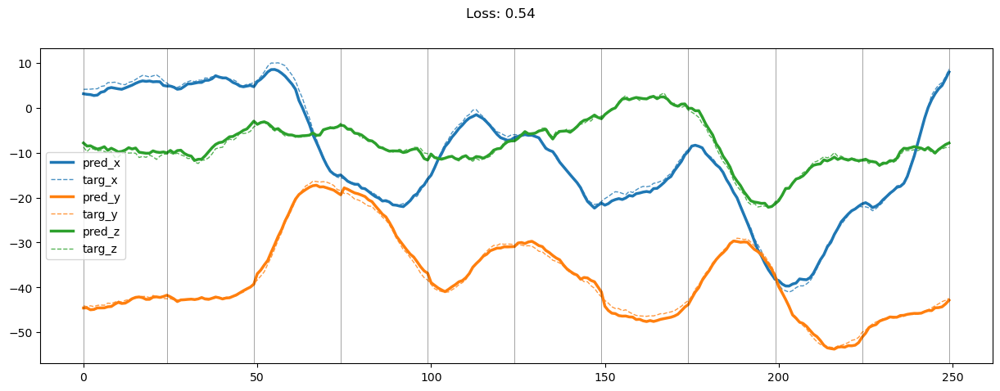

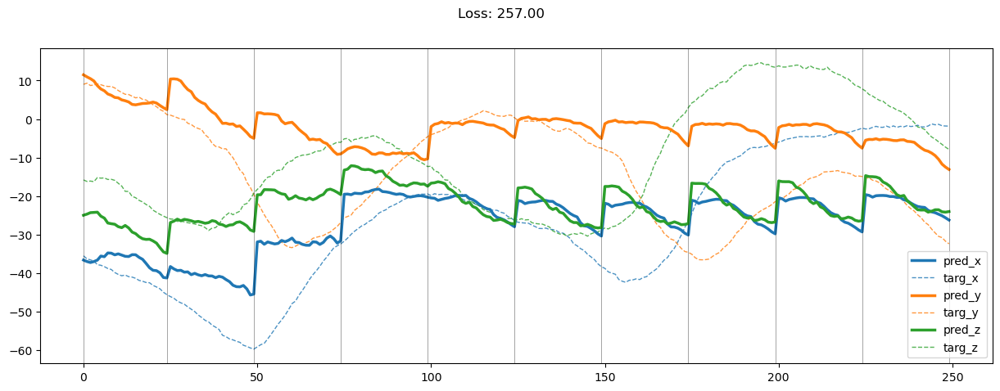

01149: train pred loss:  0.526, g loss:  1.924, diff loss:  0.995, d loss:  1.506
       valid pred loss:  171.465, g loss:  515.942, diff loss:  344.079, d loss:  1.515


100%|██████████| 17/17 [00:01<00:00, 13.89it/s]


01150: train pred loss:  0.510, g loss:  1.936, diff loss:  1.026, d loss:  1.509
       valid pred loss:  171.135, g loss:  523.237, diff loss:  351.707, d loss:  1.519


100%|██████████| 17/17 [00:01<00:00, 15.04it/s]


01151: train pred loss:  0.496, g loss:  1.873, diff loss:  0.981, d loss:  1.513
       valid pred loss:  170.808, g loss:  523.892, diff loss:  352.692, d loss:  1.522


100%|██████████| 17/17 [00:01<00:00, 14.83it/s]


01152: train pred loss:  0.516, g loss:  1.919, diff loss:  1.011, d loss:  1.516
       valid pred loss:  171.192, g loss:  523.015, diff loss:  351.435, d loss:  1.526


100%|██████████| 17/17 [00:01<00:00, 15.07it/s]


01153: train pred loss:  0.521, g loss:  1.900, diff loss:  0.989, d loss:  1.519
       valid pred loss:  168.488, g loss:  510.201, diff loss:  341.327, d loss:  1.529


100%|██████████| 17/17 [00:01<00:00, 15.23it/s]


01154: train pred loss:  0.524, g loss:  1.929, diff loss:  1.017, d loss:  1.522
       valid pred loss:  168.339, g loss:  507.091, diff loss:  338.369, d loss:  1.533


100%|██████████| 17/17 [00:01<00:00, 15.17it/s]


01155: train pred loss:  0.502, g loss:  1.872, diff loss:  0.985, d loss:  1.525
       valid pred loss:  168.122, g loss:  509.137, diff loss:  340.635, d loss:  1.535


100%|██████████| 17/17 [00:01<00:00, 14.70it/s]


01156: train pred loss:  0.485, g loss:  1.828, diff loss:  0.960, d loss:  1.527
       valid pred loss:  170.261, g loss:  518.415, diff loss:  347.775, d loss:  1.537


100%|██████████| 17/17 [00:01<00:00, 15.25it/s]


01157: train pred loss:  0.512, g loss:  1.895, diff loss:  1.000, d loss:  1.529
       valid pred loss:  171.093, g loss:  519.888, diff loss:  348.417, d loss:  1.537


100%|██████████| 17/17 [00:01<00:00, 15.20it/s]


01158: train pred loss:  0.496, g loss:  1.832, diff loss:  0.955, d loss:  1.529
       valid pred loss:  168.226, g loss:  514.189, diff loss:  345.586, d loss:  1.539


100%|██████████| 17/17 [00:01<00:00, 15.22it/s]


01159: train pred loss:  0.482, g loss:  1.806, diff loss:  0.944, d loss:  1.530
       valid pred loss:  169.163, g loss:  511.739, diff loss:  342.198, d loss:  1.537


100%|██████████| 17/17 [00:01<00:00, 15.17it/s]


01160: train pred loss:  0.497, g loss:  1.847, diff loss:  0.969, d loss:  1.529
       valid pred loss:  171.192, g loss:  515.155, diff loss:  343.585, d loss:  1.537


100%|██████████| 17/17 [00:01<00:00, 15.25it/s]


01161: train pred loss:  0.489, g loss:  1.831, diff loss:  0.961, d loss:  1.529
       valid pred loss:  171.987, g loss:  525.614, diff loss:  353.248, d loss:  1.536


100%|██████████| 17/17 [00:01<00:00, 15.24it/s]


01162: train pred loss:  0.475, g loss:  1.789, diff loss:  0.932, d loss:  1.527
       valid pred loss:  171.876, g loss:  524.276, diff loss:  352.020, d loss:  1.535


100%|██████████| 17/17 [00:01<00:00, 15.26it/s]


01163: train pred loss:  0.471, g loss:  1.779, diff loss:  0.924, d loss:  1.526
       valid pred loss:  170.324, g loss:  520.115, diff loss:  349.407, d loss:  1.532


100%|██████████| 17/17 [00:01<00:00, 15.25it/s]


01164: train pred loss:  0.456, g loss:  1.724, diff loss:  0.881, d loss:  1.524
       valid pred loss:  172.576, g loss:  526.152, diff loss:  353.191, d loss:  1.529


100%|██████████| 17/17 [00:01<00:00, 15.23it/s]


01165: train pred loss:  0.467, g loss:  1.748, diff loss:  0.892, d loss:  1.520
       valid pred loss:  171.877, g loss:  525.838, diff loss:  353.573, d loss:  1.527


100%|██████████| 17/17 [00:01<00:00, 15.23it/s]


01166: train pred loss:  0.477, g loss:  1.795, diff loss:  0.926, d loss:  1.517
       valid pred loss:  174.471, g loss:  524.448, diff loss:  349.585, d loss:  1.522


100%|██████████| 17/17 [00:01<00:00, 15.25it/s]


01167: train pred loss:  0.473, g loss:  1.786, diff loss:  0.917, d loss:  1.514
       valid pred loss:  171.451, g loss:  519.294, diff loss:  347.449, d loss:  1.520


100%|██████████| 17/17 [00:01<00:00, 15.24it/s]


01168: train pred loss:  0.474, g loss:  1.800, diff loss:  0.927, d loss:  1.510
       valid pred loss:  170.716, g loss:  516.406, diff loss:  345.292, d loss:  1.515


100%|██████████| 17/17 [00:01<00:00, 15.22it/s]


01169: train pred loss:  0.461, g loss:  1.783, diff loss:  0.919, d loss:  1.506
       valid pred loss:  173.507, g loss:  525.946, diff loss:  352.037, d loss:  1.512


100%|██████████| 17/17 [00:01<00:00, 15.13it/s]


01170: train pred loss:  0.460, g loss:  1.789, diff loss:  0.923, d loss:  1.502
       valid pred loss:  172.161, g loss:  523.196, diff loss:  350.629, d loss:  1.508


100%|██████████| 17/17 [00:01<00:00, 14.41it/s]


01171: train pred loss:  0.461, g loss:  1.783, diff loss:  0.911, d loss:  1.499
       valid pred loss:  170.482, g loss:  514.351, diff loss:  343.458, d loss:  1.503


100%|██████████| 17/17 [00:01<00:00, 15.17it/s]


01172: train pred loss:  0.482, g loss:  1.842, diff loss:  0.946, d loss:  1.494
       valid pred loss:  169.848, g loss:  514.795, diff loss:  344.533, d loss:  1.500


100%|██████████| 17/17 [00:01<00:00, 14.75it/s]


01173: train pred loss:  0.476, g loss:  1.818, diff loss:  0.924, d loss:  1.491
       valid pred loss:  174.560, g loss:  534.366, diff loss:  359.389, d loss:  1.497


100%|██████████| 17/17 [00:01<00:00, 15.27it/s]


01174: train pred loss:  0.450, g loss:  1.749, diff loss:  0.879, d loss:  1.488
       valid pred loss:  175.420, g loss:  535.587, diff loss:  359.747, d loss:  1.494


100%|██████████| 17/17 [00:01<00:00, 15.19it/s]


01175: train pred loss:  0.458, g loss:  1.778, diff loss:  0.895, d loss:  1.485
       valid pred loss:  172.706, g loss:  531.460, diff loss:  358.331, d loss:  1.491


100%|██████████| 17/17 [00:01<00:00, 14.39it/s]


01176: train pred loss:  0.449, g loss:  1.761, diff loss:  0.885, d loss:  1.483
       valid pred loss:  172.301, g loss:  529.746, diff loss:  357.018, d loss:  1.489


100%|██████████| 17/17 [00:01<00:00, 15.25it/s]


01177: train pred loss:  0.462, g loss:  1.805, diff loss:  0.913, d loss:  1.480
       valid pred loss:  171.560, g loss:  523.820, diff loss:  351.832, d loss:  1.486


100%|██████████| 17/17 [00:01<00:00, 15.26it/s]


01178: train pred loss:  0.453, g loss:  1.773, diff loss:  0.889, d loss:  1.479
       valid pred loss:  172.188, g loss:  524.147, diff loss:  351.528, d loss:  1.484


100%|██████████| 17/17 [00:01<00:00, 15.26it/s]


01179: train pred loss:  0.464, g loss:  1.812, diff loss:  0.915, d loss:  1.478
       valid pred loss:  171.405, g loss:  524.457, diff loss:  352.622, d loss:  1.484


100%|██████████| 17/17 [00:01<00:00, 15.23it/s]


01180: train pred loss:  0.473, g loss:  1.847, diff loss:  0.941, d loss:  1.477
       valid pred loss:  170.357, g loss:  521.068, diff loss:  350.280, d loss:  1.484


100%|██████████| 17/17 [00:01<00:00, 15.24it/s]


01181: train pred loss:  0.476, g loss:  1.837, diff loss:  0.929, d loss:  1.478
       valid pred loss:  173.866, g loss:  532.701, diff loss:  358.404, d loss:  1.483


100%|██████████| 17/17 [00:01<00:00, 15.23it/s]


01182: train pred loss:  0.487, g loss:  1.861, diff loss:  0.941, d loss:  1.478
       valid pred loss:  174.416, g loss:  527.931, diff loss:  353.085, d loss:  1.485


100%|██████████| 17/17 [00:01<00:00, 15.24it/s]


01183: train pred loss:  0.489, g loss:  1.871, diff loss:  0.951, d loss:  1.479
       valid pred loss:  171.493, g loss:  521.602, diff loss:  349.680, d loss:  1.487


100%|██████████| 17/17 [00:01<00:00, 15.19it/s]


01184: train pred loss:  0.486, g loss:  1.870, diff loss:  0.955, d loss:  1.481
       valid pred loss:  173.663, g loss:  524.378, diff loss:  350.289, d loss:  1.488


100%|██████████| 17/17 [00:01<00:00, 15.23it/s]


01185: train pred loss:  0.491, g loss:  1.891, diff loss:  0.972, d loss:  1.483
       valid pred loss:  172.489, g loss:  521.839, diff loss:  348.926, d loss:  1.490


100%|██████████| 17/17 [00:01<00:00, 14.41it/s]


01186: train pred loss:  0.468, g loss:  1.814, diff loss:  0.921, d loss:  1.485
       valid pred loss:  174.519, g loss:  526.184, diff loss:  351.245, d loss:  1.494


100%|██████████| 17/17 [00:01<00:00, 14.74it/s]


01187: train pred loss:  0.458, g loss:  1.778, diff loss:  0.899, d loss:  1.488
       valid pred loss:  173.163, g loss:  528.118, diff loss:  354.538, d loss:  1.497


100%|██████████| 17/17 [00:01<00:00, 15.05it/s]


01188: train pred loss:  0.453, g loss:  1.763, diff loss:  0.893, d loss:  1.492
       valid pred loss:  172.902, g loss:  529.358, diff loss:  356.043, d loss:  1.500


100%|██████████| 17/17 [00:01<00:00, 15.20it/s]


01189: train pred loss:  0.449, g loss:  1.757, diff loss:  0.894, d loss:  1.495
       valid pred loss:  172.998, g loss:  528.303, diff loss:  354.896, d loss:  1.504


100%|██████████| 17/17 [00:01<00:00, 14.47it/s]


01190: train pred loss:  0.450, g loss:  1.741, diff loss:  0.881, d loss:  1.499
       valid pred loss:  178.091, g loss:  546.865, diff loss:  368.369, d loss:  1.508


100%|██████████| 17/17 [00:01<00:00, 15.15it/s]


01191: train pred loss:  0.451, g loss:  1.727, diff loss:  0.870, d loss:  1.503
       valid pred loss:  174.165, g loss:  533.314, diff loss:  358.747, d loss:  1.511


100%|██████████| 17/17 [00:01<00:00, 15.23it/s]


01192: train pred loss:  0.450, g loss:  1.726, diff loss:  0.874, d loss:  1.506
       valid pred loss:  173.361, g loss:  526.248, diff loss:  352.490, d loss:  1.516


100%|██████████| 17/17 [00:01<00:00, 15.11it/s]


01193: train pred loss:  0.460, g loss:  1.756, diff loss:  0.898, d loss:  1.511
       valid pred loss:  175.337, g loss:  534.175, diff loss:  358.445, d loss:  1.520


100%|██████████| 17/17 [00:01<00:00, 15.21it/s]


01194: train pred loss:  0.451, g loss:  1.738, diff loss:  0.892, d loss:  1.514
       valid pred loss:  174.034, g loss:  532.656, diff loss:  358.232, d loss:  1.524


100%|██████████| 17/17 [00:01<00:00, 14.60it/s]


01195: train pred loss:  0.461, g loss:  1.763, diff loss:  0.911, d loss:  1.518
       valid pred loss:  173.250, g loss:  534.808, diff loss:  361.171, d loss:  1.528


100%|██████████| 17/17 [00:01<00:00, 15.14it/s]


01196: train pred loss:  0.454, g loss:  1.739, diff loss:  0.897, d loss:  1.521
       valid pred loss:  171.717, g loss:  526.694, diff loss:  354.591, d loss:  1.530


100%|██████████| 17/17 [00:01<00:00, 15.09it/s]


01197: train pred loss:  0.455, g loss:  1.733, diff loss:  0.891, d loss:  1.523
       valid pred loss:  172.956, g loss:  526.959, diff loss:  353.620, d loss:  1.532


100%|██████████| 17/17 [00:01<00:00, 15.14it/s]


01198: train pred loss:  0.449, g loss:  1.718, diff loss:  0.885, d loss:  1.526
       valid pred loss:  175.669, g loss:  535.622, diff loss:  359.572, d loss:  1.535


100%|██████████| 17/17 [00:01<00:00, 15.12it/s]


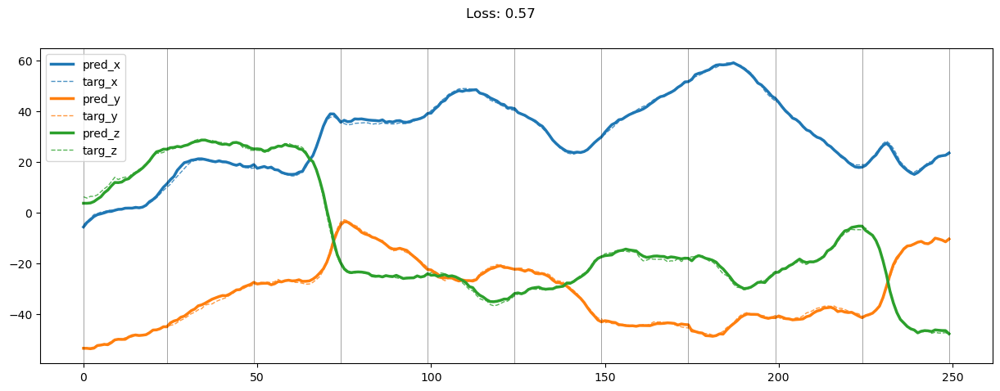

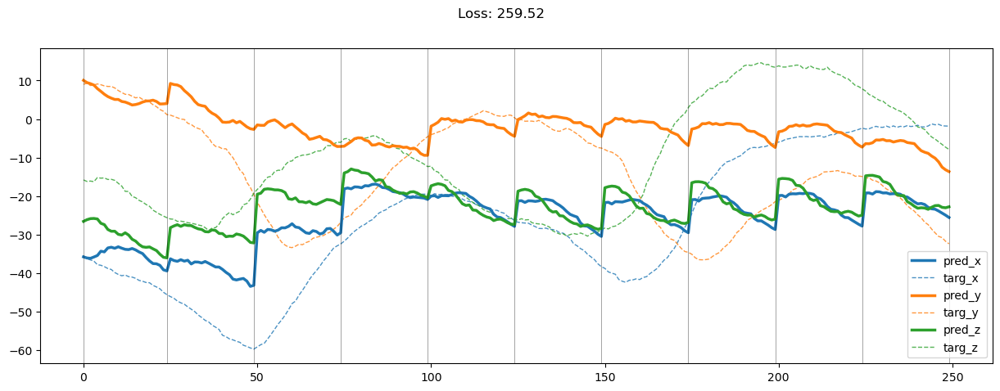

01199: train pred loss:  0.440, g loss:  1.693, diff loss:  0.871, d loss:  1.529
       valid pred loss:  172.055, g loss:  526.911, diff loss:  354.477, d loss:  1.537


100%|██████████| 17/17 [00:01<00:00, 15.04it/s]


01200: train pred loss:  0.442, g loss:  1.688, diff loss:  0.866, d loss:  1.531
       valid pred loss:  170.743, g loss:  518.080, diff loss:  346.960, d loss:  1.538


100%|██████████| 17/17 [00:01<00:00, 15.16it/s]


01201: train pred loss:  0.439, g loss:  1.686, diff loss:  0.866, d loss:  1.531
       valid pred loss:  172.908, g loss:  528.850, diff loss:  355.566, d loss:  1.539


100%|██████████| 17/17 [00:01<00:00, 14.98it/s]


01202: train pred loss:  0.443, g loss:  1.688, diff loss:  0.865, d loss:  1.531
       valid pred loss:  170.906, g loss:  530.216, diff loss:  358.934, d loss:  1.539


100%|██████████| 17/17 [00:01<00:00, 14.70it/s]


01203: train pred loss:  0.438, g loss:  1.693, diff loss:  0.875, d loss:  1.529
       valid pred loss:  174.024, g loss:  533.702, diff loss:  359.300, d loss:  1.538


100%|██████████| 17/17 [00:01<00:00, 14.93it/s]


01204: train pred loss:  0.442, g loss:  1.691, diff loss:  0.867, d loss:  1.529
       valid pred loss:  172.924, g loss:  527.503, diff loss:  354.201, d loss:  1.537


100%|██████████| 17/17 [00:01<00:00, 14.68it/s]


01205: train pred loss:  0.443, g loss:  1.708, diff loss:  0.883, d loss:  1.528
       valid pred loss:  174.747, g loss:  533.981, diff loss:  358.854, d loss:  1.534


100%|██████████| 17/17 [00:01<00:00, 15.23it/s]


01206: train pred loss:  0.441, g loss:  1.687, diff loss:  0.862, d loss:  1.526
       valid pred loss:  171.443, g loss:  521.525, diff loss:  349.700, d loss:  1.533


100%|██████████| 17/17 [00:01<00:00, 15.14it/s]


01207: train pred loss:  0.444, g loss:  1.701, diff loss:  0.871, d loss:  1.534
       valid pred loss:  175.363, g loss:  527.436, diff loss:  351.688, d loss:  1.529


100%|██████████| 17/17 [00:01<00:00, 14.19it/s]


01208: train pred loss:  0.440, g loss:  1.692, diff loss:  0.863, d loss:  1.521
       valid pred loss:  171.437, g loss:  518.693, diff loss:  346.867, d loss:  1.526


100%|██████████| 17/17 [00:01<00:00, 15.18it/s]


01209: train pred loss:  0.430, g loss:  1.671, diff loss:  0.848, d loss:  1.520
       valid pred loss:  172.214, g loss:  524.808, diff loss:  352.203, d loss:  1.522


100%|██████████| 17/17 [00:01<00:00, 15.26it/s]


01210: train pred loss:  0.450, g loss:  1.727, diff loss:  0.881, d loss:  1.513
       valid pred loss:  171.114, g loss:  522.630, diff loss:  351.120, d loss:  1.517


100%|██████████| 17/17 [00:01<00:00, 15.25it/s]


01211: train pred loss:  0.456, g loss:  1.753, diff loss:  0.897, d loss:  1.508
       valid pred loss:  172.734, g loss:  518.523, diff loss:  345.388, d loss:  1.513


100%|██████████| 17/17 [00:01<00:00, 15.23it/s]


01212: train pred loss:  0.458, g loss:  1.768, diff loss:  0.905, d loss:  1.504
       valid pred loss:  170.409, g loss:  517.831, diff loss:  347.018, d loss:  1.510


100%|██████████| 17/17 [00:01<00:00, 15.21it/s]


01213: train pred loss:  0.487, g loss:  1.851, diff loss:  0.956, d loss:  1.500
       valid pred loss:  177.748, g loss:  536.545, diff loss:  358.388, d loss:  1.505


100%|██████████| 17/17 [00:01<00:00, 15.16it/s]


01214: train pred loss:  0.512, g loss:  1.934, diff loss:  1.009, d loss:  1.495
       valid pred loss:  170.125, g loss:  516.026, diff loss:  345.489, d loss:  1.501


100%|██████████| 17/17 [00:01<00:00, 15.05it/s]


01215: train pred loss:  0.533, g loss:  1.986, diff loss:  1.036, d loss:  1.492
       valid pred loss:  175.640, g loss:  524.418, diff loss:  348.361, d loss:  1.497


100%|██████████| 17/17 [00:01<00:00, 14.80it/s]


01216: train pred loss:  0.522, g loss:  1.954, diff loss:  1.012, d loss:  1.488
       valid pred loss:  172.175, g loss:  528.873, diff loss:  356.278, d loss:  1.494


100%|██████████| 17/17 [00:01<00:00, 15.25it/s]


01217: train pred loss:  0.487, g loss:  1.876, diff loss:  0.965, d loss:  1.486
       valid pred loss:  172.594, g loss:  521.567, diff loss:  348.550, d loss:  1.491


100%|██████████| 17/17 [00:01<00:00, 15.25it/s]


01218: train pred loss:  0.477, g loss:  1.849, diff loss:  0.944, d loss:  1.482
       valid pred loss:  176.280, g loss:  531.009, diff loss:  354.302, d loss:  1.488


100%|██████████| 17/17 [00:01<00:00, 14.78it/s]


01219: train pred loss:  0.479, g loss:  1.855, diff loss:  0.946, d loss:  1.480
       valid pred loss:  174.549, g loss:  524.375, diff loss:  349.397, d loss:  1.485


100%|██████████| 17/17 [00:01<00:00, 14.82it/s]


01220: train pred loss:  0.463, g loss:  1.790, diff loss:  0.895, d loss:  1.478
       valid pred loss:  172.101, g loss:  517.882, diff loss:  345.349, d loss:  1.484


100%|██████████| 17/17 [00:01<00:00, 15.25it/s]


01221: train pred loss:  0.446, g loss:  1.751, diff loss:  0.871, d loss:  1.476
       valid pred loss:  172.621, g loss:  517.806, diff loss:  344.753, d loss:  1.483


100%|██████████| 17/17 [00:01<00:00, 15.26it/s]


01222: train pred loss:  0.449, g loss:  1.775, diff loss:  0.890, d loss:  1.476
       valid pred loss:  174.634, g loss:  522.239, diff loss:  347.172, d loss:  1.482


100%|██████████| 17/17 [00:01<00:00, 14.68it/s]


01223: train pred loss:  0.453, g loss:  1.774, diff loss:  0.886, d loss:  1.476
       valid pred loss:  173.238, g loss:  519.512, diff loss:  345.840, d loss:  1.482


100%|██████████| 17/17 [00:01<00:00, 15.26it/s]


01224: train pred loss:  0.459, g loss:  1.806, diff loss:  0.912, d loss:  1.475
       valid pred loss:  169.988, g loss:  508.778, diff loss:  338.357, d loss:  1.483


100%|██████████| 17/17 [00:01<00:00, 15.27it/s]


01225: train pred loss:  0.468, g loss:  1.821, diff loss:  0.919, d loss:  1.476
       valid pred loss:  173.527, g loss:  515.137, diff loss:  341.179, d loss:  1.484


100%|██████████| 17/17 [00:01<00:00, 15.23it/s]


01226: train pred loss:  0.462, g loss:  1.801, diff loss:  0.906, d loss:  1.478
       valid pred loss:  172.422, g loss:  515.521, diff loss:  342.670, d loss:  1.487


100%|██████████| 17/17 [00:01<00:00, 15.23it/s]


01227: train pred loss:  0.457, g loss:  1.798, diff loss:  0.910, d loss:  1.480
       valid pred loss:  171.774, g loss:  508.949, diff loss:  336.749, d loss:  1.488


100%|██████████| 17/17 [00:01<00:00, 15.20it/s]


01228: train pred loss:  0.472, g loss:  1.815, diff loss:  0.916, d loss:  1.482
       valid pred loss:  168.586, g loss:  505.310, diff loss:  336.301, d loss:  1.492


100%|██████████| 17/17 [00:01<00:00, 14.62it/s]


01229: train pred loss:  0.451, g loss:  1.762, diff loss:  0.888, d loss:  1.486
       valid pred loss:  170.880, g loss:  515.206, diff loss:  343.907, d loss:  1.495


100%|██████████| 17/17 [00:01<00:00, 15.16it/s]


01230: train pred loss:  0.456, g loss:  1.758, diff loss:  0.882, d loss:  1.489
       valid pred loss:  169.570, g loss:  511.009, diff loss:  341.024, d loss:  1.499


100%|██████████| 17/17 [00:01<00:00, 15.16it/s]


01231: train pred loss:  0.452, g loss:  1.752, diff loss:  0.884, d loss:  1.493
       valid pred loss:  169.412, g loss:  507.289, diff loss:  337.466, d loss:  1.503


100%|██████████| 17/17 [00:01<00:00, 15.04it/s]


01232: train pred loss:  0.459, g loss:  1.774, diff loss:  0.902, d loss:  1.495
       valid pred loss:  170.551, g loss:  514.273, diff loss:  343.316, d loss:  1.508


100%|██████████| 17/17 [00:01<00:00, 15.07it/s]


01233: train pred loss:  0.456, g loss:  1.764, diff loss:  0.900, d loss:  1.500
       valid pred loss:  168.219, g loss:  501.890, diff loss:  333.268, d loss:  1.512


100%|██████████| 17/17 [00:01<00:00, 15.20it/s]


01234: train pred loss:  0.455, g loss:  1.762, diff loss:  0.903, d loss:  1.504
       valid pred loss:  169.373, g loss:  503.527, diff loss:  333.756, d loss:  1.516


100%|██████████| 17/17 [00:01<00:00, 15.20it/s]


01235: train pred loss:  0.450, g loss:  1.735, diff loss:  0.885, d loss:  1.509
       valid pred loss:  171.020, g loss:  509.416, diff loss:  338.003, d loss:  1.520


100%|██████████| 17/17 [00:01<00:00, 15.22it/s]


01236: train pred loss:  0.448, g loss:  1.721, diff loss:  0.877, d loss:  1.513
       valid pred loss:  172.267, g loss:  521.848, diff loss:  349.190, d loss:  1.524


100%|██████████| 17/17 [00:01<00:00, 15.17it/s]


01237: train pred loss:  0.440, g loss:  1.699, diff loss:  0.867, d loss:  1.518
       valid pred loss:  172.623, g loss:  521.669, diff loss:  348.659, d loss:  1.529


100%|██████████| 17/17 [00:01<00:00, 14.15it/s]


01238: train pred loss:  0.457, g loss:  1.739, diff loss:  0.893, d loss:  1.521
       valid pred loss:  172.106, g loss:  519.867, diff loss:  347.379, d loss:  1.534


100%|██████████| 17/17 [00:01<00:00, 14.72it/s]


01239: train pred loss:  0.446, g loss:  1.717, diff loss:  0.886, d loss:  1.524
       valid pred loss:  170.673, g loss:  516.187, diff loss:  345.134, d loss:  1.537


100%|██████████| 17/17 [00:01<00:00, 14.31it/s]


01240: train pred loss:  0.446, g loss:  1.707, diff loss:  0.878, d loss:  1.527
       valid pred loss:  170.952, g loss:  513.453, diff loss:  342.122, d loss:  1.539


100%|██████████| 17/17 [00:01<00:00, 14.78it/s]


01241: train pred loss:  0.455, g loss:  1.741, diff loss:  0.905, d loss:  1.529
       valid pred loss:  170.072, g loss:  516.403, diff loss:  345.954, d loss:  1.540


100%|██████████| 17/17 [00:01<00:00, 15.23it/s]


01242: train pred loss:  0.449, g loss:  1.706, diff loss:  0.878, d loss:  1.532
       valid pred loss:  172.144, g loss:  521.144, diff loss:  348.625, d loss:  1.542


100%|██████████| 17/17 [00:01<00:00, 15.19it/s]


01243: train pred loss:  0.450, g loss:  1.698, diff loss:  0.870, d loss:  1.533
       valid pred loss:  171.335, g loss:  521.100, diff loss:  349.389, d loss:  1.542


100%|██████████| 17/17 [00:01<00:00, 15.17it/s]


01244: train pred loss:  0.457, g loss:  1.723, diff loss:  0.888, d loss:  1.532
       valid pred loss:  171.543, g loss:  513.625, diff loss:  341.707, d loss:  1.543


100%|██████████| 17/17 [00:01<00:00, 15.14it/s]


01245: train pred loss:  0.448, g loss:  1.704, diff loss:  0.878, d loss:  1.533
       valid pred loss:  172.701, g loss:  524.067, diff loss:  350.991, d loss:  1.543


100%|██████████| 17/17 [00:01<00:00, 15.17it/s]


01246: train pred loss:  0.440, g loss:  1.690, diff loss:  0.872, d loss:  1.533
       valid pred loss:  171.390, g loss:  516.312, diff loss:  344.546, d loss:  1.541


100%|██████████| 17/17 [00:01<00:00, 15.20it/s]


01247: train pred loss:  0.454, g loss:  1.714, diff loss:  0.880, d loss:  1.531
       valid pred loss:  169.665, g loss:  509.853, diff loss:  339.811, d loss:  1.540


100%|██████████| 17/17 [00:01<00:00, 15.20it/s]


01248: train pred loss:  0.469, g loss:  1.740, diff loss:  0.890, d loss:  1.529
       valid pred loss:  170.207, g loss:  512.305, diff loss:  341.718, d loss:  1.537


100%|██████████| 17/17 [00:01<00:00, 14.98it/s]


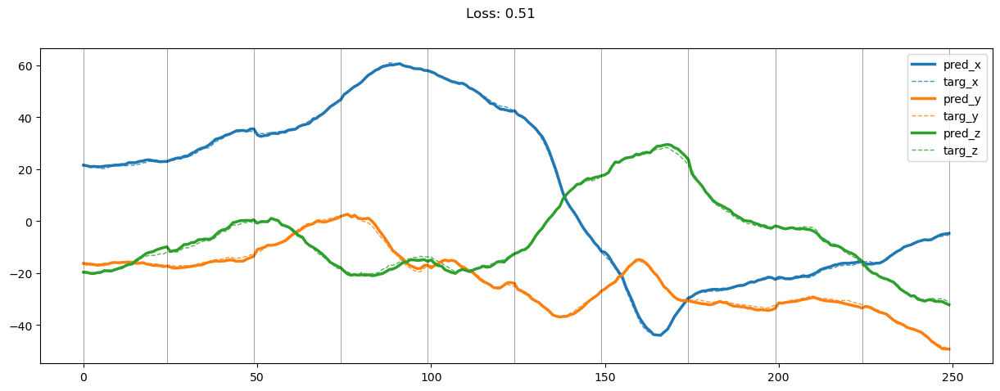

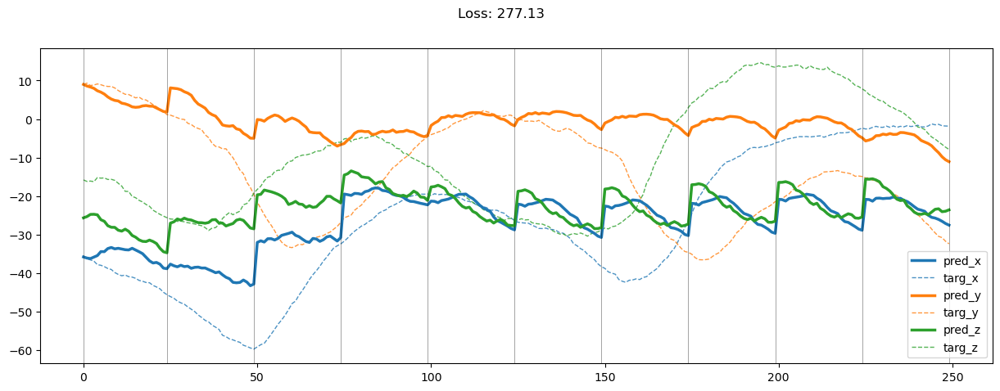

01249: train pred loss:  0.479, g loss:  1.784, diff loss:  0.922, d loss:  1.526
       valid pred loss:  172.610, g loss:  514.409, diff loss:  341.417, d loss:  1.534


100%|██████████| 17/17 [00:01<00:00, 15.19it/s]


01250: train pred loss:  0.481, g loss:  1.793, diff loss:  0.924, d loss:  1.522
       valid pred loss:  172.866, g loss:  523.218, diff loss:  349.966, d loss:  1.529


100%|██████████| 17/17 [00:01<00:00, 14.67it/s]


01251: train pred loss:  0.467, g loss:  1.771, diff loss:  0.914, d loss:  1.519
       valid pred loss:  172.771, g loss:  519.770, diff loss:  346.609, d loss:  1.525


100%|██████████| 17/17 [00:01<00:00, 14.76it/s]


01252: train pred loss:  0.448, g loss:  1.729, diff loss:  0.886, d loss:  1.514
       valid pred loss:  174.769, g loss:  532.521, diff loss:  357.359, d loss:  1.522


100%|██████████| 17/17 [00:01<00:00, 15.16it/s]


01253: train pred loss:  0.445, g loss:  1.720, diff loss:  0.878, d loss:  1.510
       valid pred loss:  173.226, g loss:  525.997, diff loss:  352.374, d loss:  1.518


100%|██████████| 17/17 [00:01<00:00, 15.16it/s]


01254: train pred loss:  0.437, g loss:  1.706, diff loss:  0.866, d loss:  1.506
       valid pred loss:  172.473, g loss:  523.429, diff loss:  350.555, d loss:  1.513


100%|██████████| 17/17 [00:01<00:00, 14.49it/s]


01255: train pred loss:  0.441, g loss:  1.723, diff loss:  0.874, d loss:  1.502
       valid pred loss:  175.177, g loss:  531.707, diff loss:  356.123, d loss:  1.508


100%|██████████| 17/17 [00:01<00:00, 15.14it/s]


01256: train pred loss:  0.431, g loss:  1.693, diff loss:  0.851, d loss:  1.497
       valid pred loss:  173.838, g loss:  532.743, diff loss:  358.495, d loss:  1.503


100%|██████████| 17/17 [00:01<00:00, 15.10it/s]


01257: train pred loss:  0.439, g loss:  1.721, diff loss:  0.867, d loss:  1.493
       valid pred loss:  175.621, g loss:  536.673, diff loss:  360.637, d loss:  1.499


100%|██████████| 17/17 [00:01<00:00, 14.92it/s]


01258: train pred loss:  0.445, g loss:  1.742, diff loss:  0.876, d loss:  1.488
       valid pred loss:  173.985, g loss:  532.417, diff loss:  358.013, d loss:  1.495


100%|██████████| 17/17 [00:01<00:00, 15.29it/s]


01259: train pred loss:  0.469, g loss:  1.794, diff loss:  0.901, d loss:  1.485
       valid pred loss:  175.506, g loss:  533.631, diff loss:  357.701, d loss:  1.492


100%|██████████| 17/17 [00:01<00:00, 15.29it/s]


01260: train pred loss:  0.476, g loss:  1.835, diff loss:  0.932, d loss:  1.482
       valid pred loss:  174.215, g loss:  530.992, diff loss:  356.350, d loss:  1.489


100%|██████████| 17/17 [00:01<00:00, 15.26it/s]


01261: train pred loss:  0.473, g loss:  1.831, diff loss:  0.928, d loss:  1.480
       valid pred loss:  176.570, g loss:  540.189, diff loss:  363.190, d loss:  1.486


100%|██████████| 17/17 [00:01<00:00, 15.28it/s]


01262: train pred loss:  0.458, g loss:  1.794, diff loss:  0.903, d loss:  1.478
       valid pred loss:  176.808, g loss:  541.898, diff loss:  364.659, d loss:  1.484


100%|██████████| 17/17 [00:01<00:00, 15.24it/s]


01263: train pred loss:  0.443, g loss:  1.754, diff loss:  0.876, d loss:  1.476
       valid pred loss:  177.240, g loss:  546.536, diff loss:  368.863, d loss:  1.483


100%|██████████| 17/17 [00:01<00:00, 15.26it/s]


01264: train pred loss:  0.451, g loss:  1.797, diff loss:  0.910, d loss:  1.475
       valid pred loss:  173.302, g loss:  532.669, diff loss:  358.932, d loss:  1.481


100%|██████████| 17/17 [00:01<00:00, 15.23it/s]


01265: train pred loss:  0.463, g loss:  1.820, diff loss:  0.920, d loss:  1.474
       valid pred loss:  176.978, g loss:  537.995, diff loss:  360.583, d loss:  1.482


100%|██████████| 17/17 [00:01<00:00, 15.27it/s]


01266: train pred loss:  0.470, g loss:  1.825, diff loss:  0.918, d loss:  1.474
       valid pred loss:  174.568, g loss:  532.001, diff loss:  356.999, d loss:  1.482


100%|██████████| 17/17 [00:01<00:00, 15.27it/s]


01267: train pred loss:  0.453, g loss:  1.779, diff loss:  0.890, d loss:  1.475
       valid pred loss:  178.174, g loss:  536.109, diff loss:  357.502, d loss:  1.483


100%|██████████| 17/17 [00:01<00:00, 14.96it/s]


01268: train pred loss:  0.466, g loss:  1.815, diff loss:  0.915, d loss:  1.476
       valid pred loss:  175.957, g loss:  540.540, diff loss:  364.151, d loss:  1.485


100%|██████████| 17/17 [00:01<00:00, 15.00it/s]


01269: train pred loss:  0.462, g loss:  1.783, diff loss:  0.888, d loss:  1.478
       valid pred loss:  172.967, g loss:  526.474, diff loss:  353.078, d loss:  1.486


100%|██████████| 17/17 [00:01<00:00, 14.97it/s]


01270: train pred loss:  0.443, g loss:  1.743, diff loss:  0.870, d loss:  1.481
       valid pred loss:  174.650, g loss:  527.275, diff loss:  352.201, d loss:  1.490


100%|██████████| 17/17 [00:01<00:00, 15.26it/s]


01271: train pred loss:  0.448, g loss:  1.762, diff loss:  0.887, d loss:  1.483
       valid pred loss:  173.729, g loss:  530.094, diff loss:  355.944, d loss:  1.493


100%|██████████| 17/17 [00:01<00:00, 15.26it/s]


01272: train pred loss:  0.460, g loss:  1.786, diff loss:  0.903, d loss:  1.486
       valid pred loss:  173.039, g loss:  534.843, diff loss:  361.386, d loss:  1.497


100%|██████████| 17/17 [00:01<00:00, 15.27it/s]


01273: train pred loss:  0.451, g loss:  1.750, diff loss:  0.880, d loss:  1.491
       valid pred loss:  172.452, g loss:  531.277, diff loss:  358.413, d loss:  1.501


100%|██████████| 17/17 [00:01<00:00, 15.05it/s]


01274: train pred loss:  0.444, g loss:  1.730, diff loss:  0.872, d loss:  1.495
       valid pred loss:  170.567, g loss:  524.542, diff loss:  353.566, d loss:  1.505


100%|██████████| 17/17 [00:01<00:00, 15.27it/s]


01275: train pred loss:  0.437, g loss:  1.727, diff loss:  0.880, d loss:  1.499
       valid pred loss:  172.983, g loss:  532.362, diff loss:  358.974, d loss:  1.509


100%|██████████| 17/17 [00:01<00:00, 15.08it/s]


01276: train pred loss:  0.439, g loss:  1.710, diff loss:  0.865, d loss:  1.502
       valid pred loss:  171.988, g loss:  527.235, diff loss:  354.848, d loss:  1.516


100%|██████████| 17/17 [00:01<00:00, 15.27it/s]


01277: train pred loss:  0.439, g loss:  1.694, diff loss:  0.854, d loss:  1.508
       valid pred loss:  174.786, g loss:  537.880, diff loss:  362.698, d loss:  1.519


100%|██████████| 17/17 [00:01<00:00, 14.38it/s]


01278: train pred loss:  0.434, g loss:  1.668, diff loss:  0.836, d loss:  1.510
       valid pred loss:  176.261, g loss:  545.752, diff loss:  369.100, d loss:  1.523


100%|██████████| 17/17 [00:01<00:00, 15.07it/s]


01279: train pred loss:  0.433, g loss:  1.679, diff loss:  0.853, d loss:  1.516
       valid pred loss:  175.364, g loss:  544.656, diff loss:  368.904, d loss:  1.528


100%|██████████| 17/17 [00:01<00:00, 15.27it/s]


01280: train pred loss:  0.439, g loss:  1.688, diff loss:  0.859, d loss:  1.520
       valid pred loss:  175.686, g loss:  547.015, diff loss:  370.945, d loss:  1.531


100%|██████████| 17/17 [00:01<00:00, 15.26it/s]


01281: train pred loss:  0.447, g loss:  1.710, diff loss:  0.877, d loss:  1.524
       valid pred loss:  177.530, g loss:  545.760, diff loss:  367.849, d loss:  1.536


100%|██████████| 17/17 [00:01<00:00, 15.25it/s]


01282: train pred loss:  0.443, g loss:  1.699, diff loss:  0.874, d loss:  1.527
       valid pred loss:  177.401, g loss:  548.875, diff loss:  371.096, d loss:  1.539


100%|██████████| 17/17 [00:01<00:00, 15.26it/s]


01283: train pred loss:  0.458, g loss:  1.736, diff loss:  0.897, d loss:  1.531
       valid pred loss:  178.742, g loss:  554.977, diff loss:  375.860, d loss:  1.542


100%|██████████| 17/17 [00:01<00:00, 15.26it/s]


01284: train pred loss:  0.446, g loss:  1.710, diff loss:  0.885, d loss:  1.532
       valid pred loss:  179.150, g loss:  555.912, diff loss:  376.387, d loss:  1.543


100%|██████████| 17/17 [00:01<00:00, 15.28it/s]


01285: train pred loss:  0.432, g loss:  1.660, diff loss:  0.851, d loss:  1.534
       valid pred loss:  178.306, g loss:  552.441, diff loss:  373.761, d loss:  1.545


100%|██████████| 17/17 [00:01<00:00, 15.28it/s]


01286: train pred loss:  0.441, g loss:  1.691, diff loss:  0.873, d loss:  1.536
       valid pred loss:  177.589, g loss:  546.630, diff loss:  368.668, d loss:  1.546


100%|██████████| 17/17 [00:01<00:00, 15.28it/s]


01287: train pred loss:  0.445, g loss:  1.709, diff loss:  0.888, d loss:  1.535
       valid pred loss:  184.462, g loss:  566.326, diff loss:  381.491, d loss:  1.544


100%|██████████| 17/17 [00:01<00:00, 15.23it/s]


01288: train pred loss:  0.452, g loss:  1.725, diff loss:  0.896, d loss:  1.534
       valid pred loss:  178.169, g loss:  552.610, diff loss:  374.068, d loss:  1.544


100%|██████████| 17/17 [00:01<00:00, 14.38it/s]


01289: train pred loss:  0.446, g loss:  1.701, diff loss:  0.878, d loss:  1.534
       valid pred loss:  179.276, g loss:  553.894, diff loss:  374.242, d loss:  1.541


100%|██████████| 17/17 [00:01<00:00, 14.24it/s]


01290: train pred loss:  0.484, g loss:  1.785, diff loss:  0.920, d loss:  1.529
       valid pred loss:  175.735, g loss:  536.274, diff loss:  360.161, d loss:  1.538


100%|██████████| 17/17 [00:01<00:00, 15.07it/s]


01291: train pred loss:  0.482, g loss:  1.805, diff loss:  0.941, d loss:  1.527
       valid pred loss:  176.773, g loss:  543.460, diff loss:  366.307, d loss:  1.537


100%|██████████| 17/17 [00:01<00:00, 15.28it/s]


01292: train pred loss:  0.454, g loss:  1.734, diff loss:  0.894, d loss:  1.525
       valid pred loss:  177.940, g loss:  544.640, diff loss:  366.317, d loss:  1.533


100%|██████████| 17/17 [00:01<00:00, 15.26it/s]


01293: train pred loss:  0.435, g loss:  1.690, diff loss:  0.867, d loss:  1.520
       valid pred loss:  173.752, g loss:  531.951, diff loss:  357.813, d loss:  1.528


100%|██████████| 17/17 [00:01<00:00, 15.26it/s]


01294: train pred loss:  0.439, g loss:  1.687, diff loss:  0.856, d loss:  1.517
       valid pred loss:  174.897, g loss:  533.401, diff loss:  358.112, d loss:  1.523


100%|██████████| 17/17 [00:01<00:00, 15.28it/s]


01295: train pred loss:  0.440, g loss:  1.700, diff loss:  0.864, d loss:  1.514
       valid pred loss:  175.755, g loss:  541.228, diff loss:  365.078, d loss:  1.520


100%|██████████| 17/17 [00:01<00:00, 15.13it/s]


01296: train pred loss:  0.442, g loss:  1.717, diff loss:  0.875, d loss:  1.509
       valid pred loss:  173.264, g loss:  533.918, diff loss:  360.254, d loss:  1.514


100%|██████████| 17/17 [00:01<00:00, 14.34it/s]


01297: train pred loss:  0.447, g loss:  1.734, diff loss:  0.882, d loss:  1.503
       valid pred loss:  172.926, g loss:  533.344, diff loss:  360.012, d loss:  1.509


100%|██████████| 17/17 [00:01<00:00, 15.24it/s]


01298: train pred loss:  0.435, g loss:  1.716, diff loss:  0.872, d loss:  1.501
       valid pred loss:  175.598, g loss:  544.924, diff loss:  368.917, d loss:  1.506


100%|██████████| 17/17 [00:01<00:00, 15.17it/s]


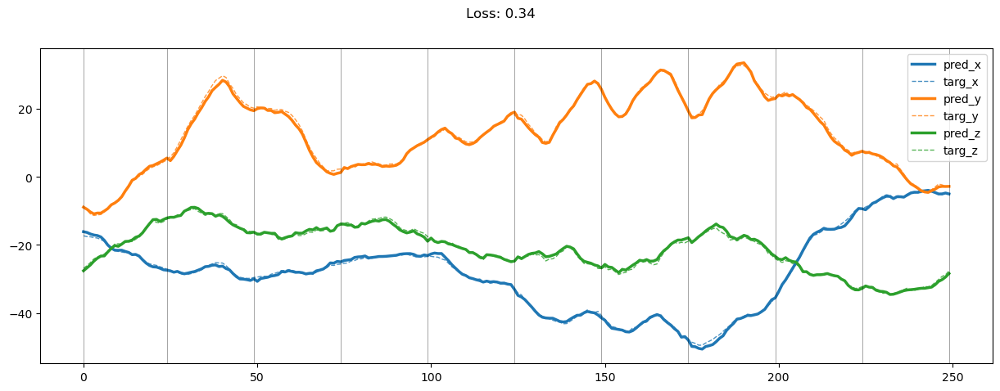

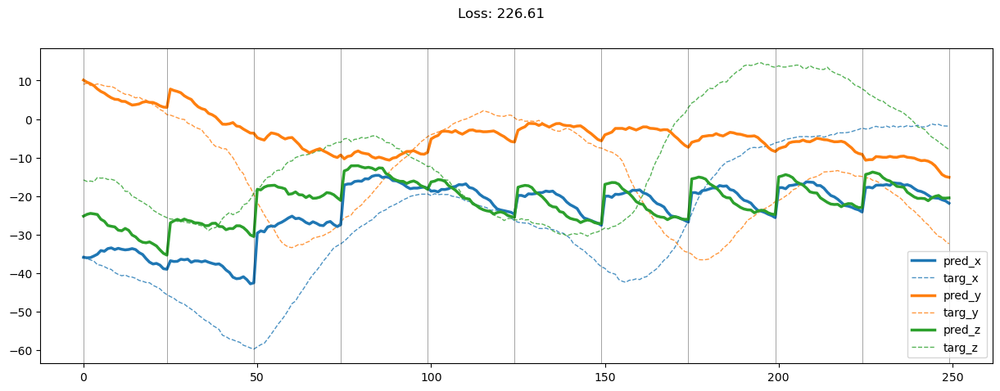

01299: train pred loss:  0.429, g loss:  1.699, diff loss:  0.855, d loss:  1.495
       valid pred loss:  176.459, g loss:  546.015, diff loss:  369.142, d loss:  1.501


100%|██████████| 17/17 [00:01<00:00, 14.33it/s]


01300: train pred loss:  0.443, g loss:  1.733, diff loss:  0.872, d loss:  1.491
       valid pred loss:  173.400, g loss:  533.896, diff loss:  360.077, d loss:  1.496


100%|██████████| 17/17 [00:01<00:00, 15.21it/s]


01301: train pred loss:  0.443, g loss:  1.738, diff loss:  0.871, d loss:  1.486
       valid pred loss:  173.647, g loss:  531.177, diff loss:  357.106, d loss:  1.492


100%|██████████| 17/17 [00:01<00:00, 15.25it/s]


01302: train pred loss:  0.428, g loss:  1.691, diff loss:  0.836, d loss:  1.482
       valid pred loss:  173.677, g loss:  531.423, diff loss:  357.320, d loss:  1.490


100%|██████████| 17/17 [00:01<00:00, 15.16it/s]


01303: train pred loss:  0.451, g loss:  1.763, diff loss:  0.882, d loss:  1.480
       valid pred loss:  175.123, g loss:  537.404, diff loss:  361.852, d loss:  1.486


100%|██████████| 17/17 [00:01<00:00, 15.15it/s]


01304: train pred loss:  0.462, g loss:  1.792, diff loss:  0.896, d loss:  1.477
       valid pred loss:  175.783, g loss:  536.869, diff loss:  360.654, d loss:  1.484


100%|██████████| 17/17 [00:01<00:00, 15.18it/s]


01305: train pred loss:  0.459, g loss:  1.793, diff loss:  0.898, d loss:  1.475
       valid pred loss:  172.321, g loss:  525.062, diff loss:  352.307, d loss:  1.483


100%|██████████| 17/17 [00:01<00:00, 15.14it/s]


01306: train pred loss:  0.458, g loss:  1.811, diff loss:  0.915, d loss:  1.474
       valid pred loss:  169.425, g loss:  520.225, diff loss:  350.364, d loss:  1.480


100%|██████████| 17/17 [00:01<00:00, 15.14it/s]


01307: train pred loss:  0.467, g loss:  1.835, diff loss:  0.929, d loss:  1.473
       valid pred loss:  172.904, g loss:  525.133, diff loss:  351.792, d loss:  1.480


100%|██████████| 17/17 [00:01<00:00, 15.10it/s]


01308: train pred loss:  0.451, g loss:  1.773, diff loss:  0.884, d loss:  1.473
       valid pred loss:  171.275, g loss:  522.412, diff loss:  350.700, d loss:  1.480


100%|██████████| 17/17 [00:01<00:00, 15.11it/s]


01309: train pred loss:  0.463, g loss:  1.815, diff loss:  0.912, d loss:  1.473
       valid pred loss:  173.181, g loss:  530.151, diff loss:  356.533, d loss:  1.481


100%|██████████| 17/17 [00:01<00:00, 13.85it/s]


01310: train pred loss:  0.460, g loss:  1.796, diff loss:  0.899, d loss:  1.474
       valid pred loss:  174.789, g loss:  535.601, diff loss:  360.379, d loss:  1.483


100%|██████████| 17/17 [00:01<00:00, 15.06it/s]


01311: train pred loss:  0.459, g loss:  1.799, diff loss:  0.904, d loss:  1.476
       valid pred loss:  177.526, g loss:  543.881, diff loss:  365.922, d loss:  1.484


100%|██████████| 17/17 [00:01<00:00, 15.20it/s]


01312: train pred loss:  0.451, g loss:  1.797, diff loss:  0.913, d loss:  1.477
       valid pred loss:  174.489, g loss:  536.016, diff loss:  361.099, d loss:  1.488


100%|██████████| 17/17 [00:01<00:00, 15.22it/s]


01313: train pred loss:  0.471, g loss:  1.850, diff loss:  0.949, d loss:  1.480
       valid pred loss:  173.942, g loss:  531.854, diff loss:  357.487, d loss:  1.491


100%|██████████| 17/17 [00:01<00:00, 15.19it/s]


01314: train pred loss:  0.496, g loss:  1.903, diff loss:  0.981, d loss:  1.484
       valid pred loss:  175.085, g loss:  533.109, diff loss:  357.603, d loss:  1.494


100%|██████████| 17/17 [00:01<00:00, 15.14it/s]


01315: train pred loss:  0.477, g loss:  1.832, diff loss:  0.934, d loss:  1.488
       valid pred loss:  176.774, g loss:  542.967, diff loss:  365.777, d loss:  1.499


100%|██████████| 17/17 [00:01<00:00, 15.14it/s]


01316: train pred loss:  0.472, g loss:  1.815, diff loss:  0.926, d loss:  1.492
       valid pred loss:  175.191, g loss:  537.224, diff loss:  361.621, d loss:  1.502


100%|██████████| 17/17 [00:01<00:00, 15.17it/s]


01317: train pred loss:  0.451, g loss:  1.748, diff loss:  0.885, d loss:  1.497
       valid pred loss:  173.189, g loss:  526.782, diff loss:  353.187, d loss:  1.509


100%|██████████| 17/17 [00:01<00:00, 15.16it/s]


01318: train pred loss:  0.443, g loss:  1.714, diff loss:  0.864, d loss:  1.501
       valid pred loss:  173.055, g loss:  527.345, diff loss:  353.889, d loss:  1.514


100%|██████████| 17/17 [00:01<00:00, 15.10it/s]


01319: train pred loss:  0.458, g loss:  1.736, diff loss:  0.875, d loss:  1.506
       valid pred loss:  176.572, g loss:  542.436, diff loss:  365.467, d loss:  1.518


100%|██████████| 17/17 [00:01<00:00, 15.15it/s]


01320: train pred loss:  0.437, g loss:  1.695, diff loss:  0.859, d loss:  1.511
       valid pred loss:  175.788, g loss:  542.020, diff loss:  365.840, d loss:  1.523


100%|██████████| 17/17 [00:01<00:00, 15.13it/s]


01321: train pred loss:  0.425, g loss:  1.662, diff loss:  0.844, d loss:  1.516
       valid pred loss:  175.791, g loss:  541.802, diff loss:  365.623, d loss:  1.528


100%|██████████| 17/17 [00:01<00:00, 15.15it/s]


01322: train pred loss:  0.430, g loss:  1.657, diff loss:  0.838, d loss:  1.520
       valid pred loss:  172.706, g loss:  533.639, diff loss:  360.549, d loss:  1.533


100%|██████████| 17/17 [00:01<00:00, 14.21it/s]


01323: train pred loss:  0.429, g loss:  1.635, diff loss:  0.820, d loss:  1.525
       valid pred loss:  174.931, g loss:  536.922, diff loss:  361.612, d loss:  1.538


100%|██████████| 17/17 [00:01<00:00, 15.00it/s]


01324: train pred loss:  0.426, g loss:  1.650, diff loss:  0.842, d loss:  1.529
       valid pred loss:  173.623, g loss:  537.281, diff loss:  363.282, d loss:  1.540


100%|██████████| 17/17 [00:01<00:00, 15.17it/s]


01325: train pred loss:  0.450, g loss:  1.693, diff loss:  0.863, d loss:  1.531
       valid pred loss:  172.964, g loss:  533.920, diff loss:  360.580, d loss:  1.542


100%|██████████| 17/17 [00:01<00:00, 15.22it/s]


01326: train pred loss:  0.440, g loss:  1.676, diff loss:  0.858, d loss:  1.532
       valid pred loss:  174.206, g loss:  539.443, diff loss:  364.862, d loss:  1.543


100%|██████████| 17/17 [00:01<00:00, 15.15it/s]


01327: train pred loss:  0.448, g loss:  1.716, diff loss:  0.891, d loss:  1.534
       valid pred loss:  175.478, g loss:  543.897, diff loss:  368.046, d loss:  1.545


100%|██████████| 17/17 [00:01<00:00, 15.17it/s]


01328: train pred loss:  0.450, g loss:  1.732, diff loss:  0.907, d loss:  1.536
       valid pred loss:  173.713, g loss:  534.074, diff loss:  359.989, d loss:  1.545


100%|██████████| 17/17 [00:01<00:00, 14.80it/s]


01329: train pred loss:  0.458, g loss:  1.738, diff loss:  0.904, d loss:  1.535
       valid pred loss:  172.382, g loss:  531.613, diff loss:  358.858, d loss:  1.545


100%|██████████| 17/17 [00:01<00:00, 15.19it/s]


01330: train pred loss:  0.453, g loss:  1.715, diff loss:  0.886, d loss:  1.535
       valid pred loss:  171.721, g loss:  523.199, diff loss:  351.105, d loss:  1.545


100%|██████████| 17/17 [00:01<00:00, 15.22it/s]


01331: train pred loss:  0.457, g loss:  1.732, diff loss:  0.897, d loss:  1.533
       valid pred loss:  169.426, g loss:  518.158, diff loss:  348.356, d loss:  1.542


100%|██████████| 17/17 [00:01<00:00, 15.26it/s]


01332: train pred loss:  0.449, g loss:  1.709, diff loss:  0.881, d loss:  1.532
       valid pred loss:  170.727, g loss:  524.862, diff loss:  353.759, d loss:  1.542


100%|██████████| 17/17 [00:01<00:00, 15.21it/s]


01333: train pred loss:  0.455, g loss:  1.721, diff loss:  0.885, d loss:  1.530
       valid pred loss:  169.312, g loss:  522.749, diff loss:  353.057, d loss:  1.538


100%|██████████| 17/17 [00:01<00:00, 15.17it/s]


01334: train pred loss:  0.463, g loss:  1.758, diff loss:  0.910, d loss:  1.525
       valid pred loss:  175.194, g loss:  541.871, diff loss:  366.294, d loss:  1.534


100%|██████████| 17/17 [00:01<00:00, 15.20it/s]


01335: train pred loss:  0.492, g loss:  1.828, diff loss:  0.948, d loss:  1.521
       valid pred loss:  174.468, g loss:  535.443, diff loss:  360.590, d loss:  1.531


100%|██████████| 17/17 [00:01<00:00, 14.78it/s]


01336: train pred loss:  0.453, g loss:  1.748, diff loss:  0.904, d loss:  1.519
       valid pred loss:  170.380, g loss:  525.351, diff loss:  354.582, d loss:  1.526


100%|██████████| 17/17 [00:01<00:00, 15.24it/s]


01337: train pred loss:  0.458, g loss:  1.743, diff loss:  0.890, d loss:  1.514
       valid pred loss:  172.539, g loss:  533.793, diff loss:  360.859, d loss:  1.521


100%|██████████| 17/17 [00:01<00:00, 15.24it/s]


01338: train pred loss:  0.440, g loss:  1.704, diff loss:  0.864, d loss:  1.508
       valid pred loss:  173.370, g loss:  533.745, diff loss:  359.976, d loss:  1.516


100%|██████████| 17/17 [00:01<00:00, 15.23it/s]


01339: train pred loss:  0.435, g loss:  1.709, diff loss:  0.870, d loss:  1.505
       valid pred loss:  174.837, g loss:  539.067, diff loss:  363.828, d loss:  1.512


100%|██████████| 17/17 [00:01<00:00, 15.27it/s]


01340: train pred loss:  0.425, g loss:  1.674, diff loss:  0.841, d loss:  1.502
       valid pred loss:  173.586, g loss:  535.846, diff loss:  361.853, d loss:  1.507


100%|██████████| 17/17 [00:01<00:00, 15.24it/s]


01341: train pred loss:  0.443, g loss:  1.708, diff loss:  0.852, d loss:  1.497
       valid pred loss:  175.679, g loss:  542.464, diff loss:  366.372, d loss:  1.502


100%|██████████| 17/17 [00:01<00:00, 14.77it/s]


01342: train pred loss:  0.438, g loss:  1.725, diff loss:  0.867, d loss:  1.491
       valid pred loss:  174.224, g loss:  538.127, diff loss:  363.486, d loss:  1.498


100%|██████████| 17/17 [00:01<00:00, 15.18it/s]


01343: train pred loss:  0.453, g loss:  1.768, diff loss:  0.892, d loss:  1.488
       valid pred loss:  172.716, g loss:  526.977, diff loss:  353.841, d loss:  1.495


100%|██████████| 17/17 [00:01<00:00, 15.15it/s]


01344: train pred loss:  0.478, g loss:  1.823, diff loss:  0.919, d loss:  1.486
       valid pred loss:  172.603, g loss:  533.878, diff loss:  360.850, d loss:  1.491


100%|██████████| 17/17 [00:01<00:00, 15.11it/s]


01345: train pred loss:  0.477, g loss:  1.850, diff loss:  0.943, d loss:  1.483
       valid pred loss:  174.071, g loss:  536.496, diff loss:  361.995, d loss:  1.487


100%|██████████| 17/17 [00:01<00:00, 15.13it/s]


01346: train pred loss:  0.468, g loss:  1.804, diff loss:  0.903, d loss:  1.480
       valid pred loss:  176.815, g loss:  548.487, diff loss:  371.242, d loss:  1.487


100%|██████████| 17/17 [00:01<00:00, 14.15it/s]


01347: train pred loss:  0.443, g loss:  1.753, diff loss:  0.876, d loss:  1.478
       valid pred loss:  174.477, g loss:  542.993, diff loss:  368.083, d loss:  1.484


100%|██████████| 17/17 [00:01<00:00, 14.60it/s]


01348: train pred loss:  0.425, g loss:  1.704, diff loss:  0.842, d loss:  1.475
       valid pred loss:  175.623, g loss:  539.601, diff loss:  363.543, d loss:  1.482


100%|██████████| 17/17 [00:01<00:00, 15.28it/s]


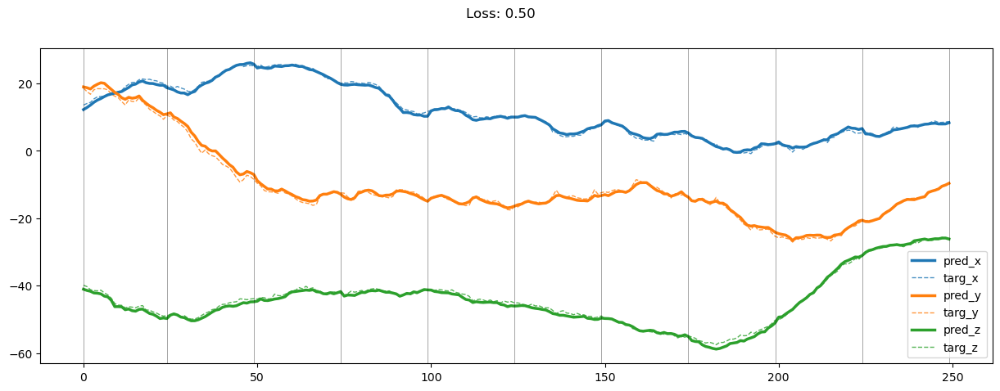

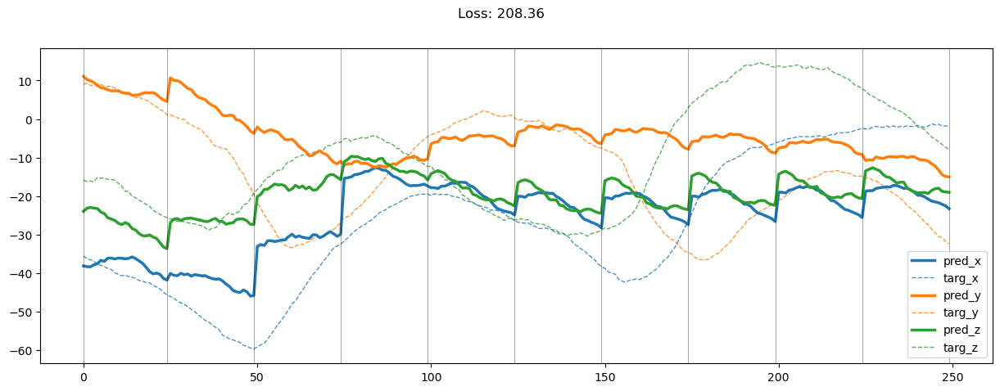

01349: train pred loss:  0.438, g loss:  1.748, diff loss:  0.872, d loss:  1.474
       valid pred loss:  172.820, g loss:  532.699, diff loss:  359.444, d loss:  1.483


100%|██████████| 17/17 [00:01<00:00, 15.21it/s]


01350: train pred loss:  0.441, g loss:  1.753, diff loss:  0.874, d loss:  1.474
       valid pred loss:  175.067, g loss:  537.620, diff loss:  362.117, d loss:  1.482


100%|██████████| 17/17 [00:01<00:00, 15.24it/s]


01351: train pred loss:  0.445, g loss:  1.755, diff loss:  0.872, d loss:  1.474
       valid pred loss:  178.187, g loss:  546.966, diff loss:  368.345, d loss:  1.482


100%|██████████| 17/17 [00:01<00:00, 15.26it/s]


01352: train pred loss:  0.436, g loss:  1.734, diff loss:  0.861, d loss:  1.475
       valid pred loss:  181.149, g loss:  552.242, diff loss:  370.661, d loss:  1.484


100%|██████████| 17/17 [00:01<00:00, 15.27it/s]


01353: train pred loss:  0.424, g loss:  1.688, diff loss:  0.830, d loss:  1.477
       valid pred loss:  174.660, g loss:  535.295, diff loss:  360.204, d loss:  1.486


100%|██████████| 17/17 [00:01<00:00, 15.20it/s]


01354: train pred loss:  0.419, g loss:  1.674, diff loss:  0.824, d loss:  1.480
       valid pred loss:  175.525, g loss:  538.738, diff loss:  362.785, d loss:  1.488


100%|██████████| 17/17 [00:01<00:00, 14.93it/s]


01355: train pred loss:  0.428, g loss:  1.705, diff loss:  0.849, d loss:  1.482
       valid pred loss:  174.422, g loss:  536.432, diff loss:  361.587, d loss:  1.493


100%|██████████| 17/17 [00:01<00:00, 13.77it/s]


01356: train pred loss:  0.424, g loss:  1.689, diff loss:  0.840, d loss:  1.486
       valid pred loss:  175.926, g loss:  537.932, diff loss:  361.586, d loss:  1.496


100%|██████████| 17/17 [00:01<00:00, 15.24it/s]


01357: train pred loss:  0.420, g loss:  1.667, diff loss:  0.826, d loss:  1.489
       valid pred loss:  177.586, g loss:  546.956, diff loss:  368.954, d loss:  1.499


100%|██████████| 17/17 [00:01<00:00, 15.24it/s]


01358: train pred loss:  0.418, g loss:  1.656, diff loss:  0.821, d loss:  1.492
       valid pred loss:  176.864, g loss:  541.795, diff loss:  364.520, d loss:  1.504


100%|██████████| 17/17 [00:01<00:00, 15.23it/s]


01359: train pred loss:  0.458, g loss:  1.767, diff loss:  0.897, d loss:  1.496
       valid pred loss:  176.809, g loss:  543.770, diff loss:  366.554, d loss:  1.507


100%|██████████| 17/17 [00:01<00:00, 15.24it/s]


01360: train pred loss:  0.448, g loss:  1.726, diff loss:  0.869, d loss:  1.501
       valid pred loss:  175.284, g loss:  542.117, diff loss:  366.430, d loss:  1.513


100%|██████████| 17/17 [00:01<00:00, 15.23it/s]


01361: train pred loss:  0.442, g loss:  1.719, diff loss:  0.874, d loss:  1.505
       valid pred loss:  173.584, g loss:  536.024, diff loss:  362.042, d loss:  1.518


100%|██████████| 17/17 [00:01<00:00, 15.21it/s]


01362: train pred loss:  0.425, g loss:  1.661, diff loss:  0.837, d loss:  1.510
       valid pred loss:  175.466, g loss:  532.109, diff loss:  356.250, d loss:  1.522


100%|██████████| 17/17 [00:01<00:00, 14.59it/s]


01363: train pred loss:  0.417, g loss:  1.630, diff loss:  0.819, d loss:  1.514
       valid pred loss:  174.966, g loss:  534.975, diff loss:  359.621, d loss:  1.527


100%|██████████| 17/17 [00:01<00:00, 14.88it/s]


01364: train pred loss:  0.414, g loss:  1.618, diff loss:  0.814, d loss:  1.520
       valid pred loss:  174.029, g loss:  532.496, diff loss:  358.082, d loss:  1.531


100%|██████████| 17/17 [00:01<00:00, 14.35it/s]


01365: train pred loss:  0.419, g loss:  1.637, diff loss:  0.832, d loss:  1.524
       valid pred loss:  174.327, g loss:  534.688, diff loss:  359.980, d loss:  1.536


100%|██████████| 17/17 [00:01<00:00, 15.29it/s]


01366: train pred loss:  0.435, g loss:  1.671, diff loss:  0.852, d loss:  1.528
       valid pred loss:  176.197, g loss:  535.041, diff loss:  358.465, d loss:  1.538


100%|██████████| 17/17 [00:01<00:00, 14.86it/s]


01367: train pred loss:  0.425, g loss:  1.641, diff loss:  0.835, d loss:  1.531
       valid pred loss:  172.083, g loss:  524.264, diff loss:  351.806, d loss:  1.542


100%|██████████| 17/17 [00:01<00:00, 14.92it/s]


01368: train pred loss:  0.427, g loss:  1.650, diff loss:  0.845, d loss:  1.534
       valid pred loss:  173.262, g loss:  533.860, diff loss:  360.225, d loss:  1.544


100%|██████████| 17/17 [00:01<00:00, 15.19it/s]


01369: train pred loss:  0.442, g loss:  1.691, diff loss:  0.872, d loss:  1.535
       valid pred loss:  173.101, g loss:  537.816, diff loss:  364.343, d loss:  1.546


100%|██████████| 17/17 [00:01<00:00, 15.20it/s]


01370: train pred loss:  0.441, g loss:  1.688, diff loss:  0.871, d loss:  1.537
       valid pred loss:  175.132, g loss:  544.025, diff loss:  368.521, d loss:  1.547


100%|██████████| 17/17 [00:01<00:00, 15.20it/s]


01371: train pred loss:  0.435, g loss:  1.668, diff loss:  0.857, d loss:  1.536
       valid pred loss:  172.777, g loss:  530.871, diff loss:  357.722, d loss:  1.547


100%|██████████| 17/17 [00:01<00:00, 15.00it/s]


01372: train pred loss:  0.435, g loss:  1.664, diff loss:  0.854, d loss:  1.537
       valid pred loss:  174.249, g loss:  537.510, diff loss:  362.888, d loss:  1.544


100%|██████████| 17/17 [00:01<00:00, 15.19it/s]


01373: train pred loss:  0.439, g loss:  1.669, diff loss:  0.853, d loss:  1.535
       valid pred loss:  173.951, g loss:  535.099, diff loss:  360.774, d loss:  1.543


100%|██████████| 17/17 [00:01<00:00, 15.00it/s]


01374: train pred loss:  0.431, g loss:  1.665, diff loss:  0.856, d loss:  1.534
       valid pred loss:  170.634, g loss:  523.775, diff loss:  352.765, d loss:  1.541


100%|██████████| 17/17 [00:01<00:00, 14.74it/s]


01375: train pred loss:  0.406, g loss:  1.587, diff loss:  0.801, d loss:  1.532
       valid pred loss:  173.007, g loss:  529.072, diff loss:  355.687, d loss:  1.539


100%|██████████| 17/17 [00:01<00:00, 14.50it/s]


01376: train pred loss:  0.425, g loss:  1.644, diff loss:  0.837, d loss:  1.529
       valid pred loss:  173.713, g loss:  532.259, diff loss:  358.165, d loss:  1.536


100%|██████████| 17/17 [00:01<00:00, 14.81it/s]


01377: train pred loss:  0.432, g loss:  1.653, diff loss:  0.835, d loss:  1.524
       valid pred loss:  175.033, g loss:  538.220, diff loss:  362.803, d loss:  1.532


100%|██████████| 17/17 [00:01<00:00, 14.32it/s]


01378: train pred loss:  0.450, g loss:  1.722, diff loss:  0.882, d loss:  1.521
       valid pred loss:  171.197, g loss:  523.213, diff loss:  351.629, d loss:  1.529


100%|██████████| 17/17 [00:01<00:00, 14.77it/s]


01379: train pred loss:  0.453, g loss:  1.729, diff loss:  0.882, d loss:  1.516
       valid pred loss:  174.626, g loss:  531.537, diff loss:  356.518, d loss:  1.523


100%|██████████| 17/17 [00:01<00:00, 14.72it/s]


01380: train pred loss:  0.459, g loss:  1.756, diff loss:  0.899, d loss:  1.512
       valid pred loss:  177.182, g loss:  539.411, diff loss:  361.832, d loss:  1.518


100%|██████████| 17/17 [00:01<00:00, 13.99it/s]


01381: train pred loss:  0.457, g loss:  1.765, diff loss:  0.906, d loss:  1.508
       valid pred loss:  176.119, g loss:  540.045, diff loss:  363.526, d loss:  1.514


100%|██████████| 17/17 [00:01<00:00, 14.81it/s]


01382: train pred loss:  0.456, g loss:  1.760, diff loss:  0.898, d loss:  1.503
       valid pred loss:  178.068, g loss:  540.602, diff loss:  362.127, d loss:  1.509


100%|██████████| 17/17 [00:01<00:00, 15.08it/s]


01383: train pred loss:  0.465, g loss:  1.780, diff loss:  0.904, d loss:  1.498
       valid pred loss:  176.298, g loss:  541.437, diff loss:  364.727, d loss:  1.503


100%|██████████| 17/17 [00:01<00:00, 14.57it/s]


01384: train pred loss:  0.460, g loss:  1.785, diff loss:  0.908, d loss:  1.493
       valid pred loss:  175.701, g loss:  534.478, diff loss:  358.360, d loss:  1.499


100%|██████████| 17/17 [00:01<00:00, 15.09it/s]


01385: train pred loss:  0.434, g loss:  1.708, diff loss:  0.854, d loss:  1.489
       valid pred loss:  175.190, g loss:  542.358, diff loss:  366.749, d loss:  1.496


100%|██████████| 17/17 [00:01<00:00, 15.22it/s]


01386: train pred loss:  0.429, g loss:  1.703, diff loss:  0.849, d loss:  1.485
       valid pred loss:  174.801, g loss:  533.169, diff loss:  357.943, d loss:  1.491


100%|██████████| 17/17 [00:01<00:00, 15.20it/s]


01387: train pred loss:  0.451, g loss:  1.750, diff loss:  0.870, d loss:  1.482
       valid pred loss:  173.694, g loss:  536.701, diff loss:  362.579, d loss:  1.489


100%|██████████| 17/17 [00:01<00:00, 14.96it/s]


01388: train pred loss:  0.449, g loss:  1.774, diff loss:  0.893, d loss:  1.479
       valid pred loss:  176.719, g loss:  543.622, diff loss:  366.473, d loss:  1.486


100%|██████████| 17/17 [00:01<00:00, 13.81it/s]


01389: train pred loss:  0.456, g loss:  1.772, diff loss:  0.882, d loss:  1.477
       valid pred loss:  176.683, g loss:  545.023, diff loss:  367.906, d loss:  1.483


100%|██████████| 17/17 [00:01<00:00, 13.72it/s]


01390: train pred loss:  0.450, g loss:  1.766, diff loss:  0.879, d loss:  1.475
       valid pred loss:  177.212, g loss:  546.092, diff loss:  368.444, d loss:  1.481


100%|██████████| 17/17 [00:01<00:00, 15.24it/s]


01391: train pred loss:  0.460, g loss:  1.807, diff loss:  0.908, d loss:  1.474
       valid pred loss:  173.416, g loss:  533.973, diff loss:  360.120, d loss:  1.480


100%|██████████| 17/17 [00:01<00:00, 14.94it/s]


01392: train pred loss:  0.506, g loss:  1.916, diff loss:  0.971, d loss:  1.472
       valid pred loss:  177.737, g loss:  547.032, diff loss:  368.859, d loss:  1.481


100%|██████████| 17/17 [00:01<00:00, 15.23it/s]


01393: train pred loss:  0.501, g loss:  1.914, diff loss:  0.974, d loss:  1.472
       valid pred loss:  178.523, g loss:  550.598, diff loss:  371.639, d loss:  1.481


100%|██████████| 17/17 [00:01<00:00, 15.24it/s]


01394: train pred loss:  0.486, g loss:  1.862, diff loss:  0.939, d loss:  1.474
       valid pred loss:  179.110, g loss:  552.310, diff loss:  372.766, d loss:  1.483


100%|██████████| 17/17 [00:01<00:00, 15.26it/s]


01395: train pred loss:  0.461, g loss:  1.806, diff loss:  0.909, d loss:  1.475
       valid pred loss:  174.274, g loss:  533.693, diff loss:  358.987, d loss:  1.485


100%|██████████| 17/17 [00:01<00:00, 15.26it/s]


01396: train pred loss:  0.441, g loss:  1.745, diff loss:  0.871, d loss:  1.478
       valid pred loss:  177.330, g loss:  545.492, diff loss:  367.733, d loss:  1.487


100%|██████████| 17/17 [00:01<00:00, 15.26it/s]


01397: train pred loss:  0.441, g loss:  1.719, diff loss:  0.847, d loss:  1.480
       valid pred loss:  173.725, g loss:  530.539, diff loss:  356.387, d loss:  1.490


100%|██████████| 17/17 [00:01<00:00, 15.12it/s]


01398: train pred loss:  0.452, g loss:  1.743, diff loss:  0.864, d loss:  1.483
       valid pred loss:  177.367, g loss:  543.441, diff loss:  365.651, d loss:  1.492


100%|██████████| 17/17 [00:01<00:00, 15.24it/s]


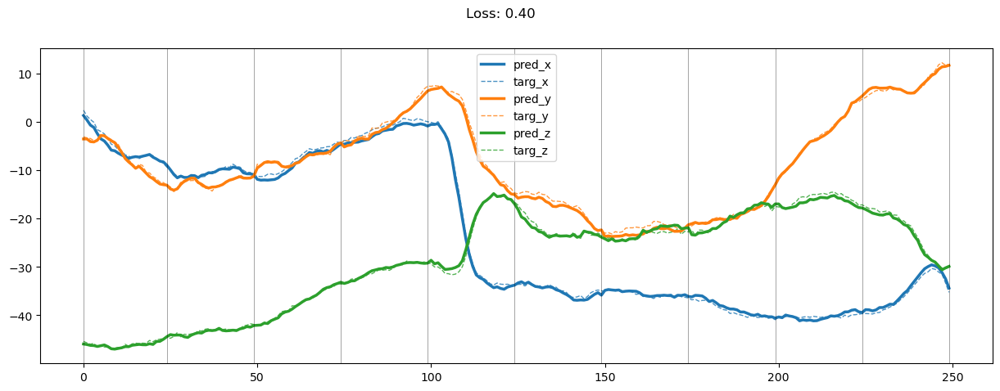

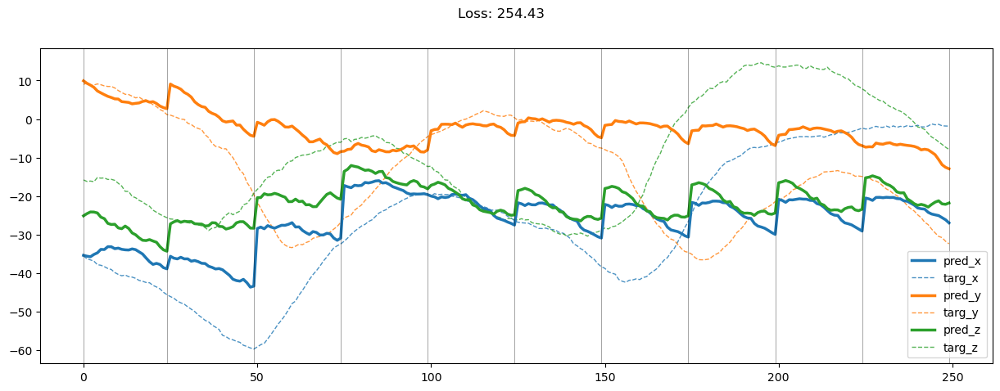

01399: train pred loss:  0.426, g loss:  1.694, diff loss:  0.844, d loss:  1.486
       valid pred loss:  174.988, g loss:  537.941, diff loss:  362.535, d loss:  1.497


100%|██████████| 17/17 [00:01<00:00, 15.23it/s]


01400: train pred loss:  0.417, g loss:  1.653, diff loss:  0.817, d loss:  1.491
       valid pred loss:  172.358, g loss:  526.640, diff loss:  353.868, d loss:  1.501


100%|██████████| 17/17 [00:01<00:00, 14.90it/s]


01401: train pred loss:  0.416, g loss:  1.647, diff loss:  0.817, d loss:  1.495
       valid pred loss:  170.899, g loss:  529.034, diff loss:  357.726, d loss:  1.507


100%|██████████| 17/17 [00:01<00:00, 15.23it/s]


01402: train pred loss:  0.422, g loss:  1.650, diff loss:  0.818, d loss:  1.499
       valid pred loss:  176.689, g loss:  540.773, diff loss:  363.680, d loss:  1.511


100%|██████████| 17/17 [00:01<00:00, 15.13it/s]


01403: train pred loss:  0.427, g loss:  1.673, diff loss:  0.842, d loss:  1.505
       valid pred loss:  174.780, g loss:  539.559, diff loss:  364.380, d loss:  1.516


100%|██████████| 17/17 [00:01<00:00, 15.01it/s]


01404: train pred loss:  0.432, g loss:  1.669, diff loss:  0.838, d loss:  1.510
       valid pred loss:  173.068, g loss:  537.576, diff loss:  364.114, d loss:  1.521


100%|██████████| 17/17 [00:01<00:00, 15.24it/s]


01405: train pred loss:  0.417, g loss:  1.626, diff loss:  0.813, d loss:  1.514
       valid pred loss:  171.988, g loss:  527.411, diff loss:  355.032, d loss:  1.524


100%|██████████| 17/17 [00:01<00:00, 15.12it/s]


01406: train pred loss:  0.430, g loss:  1.664, diff loss:  0.843, d loss:  1.518
       valid pred loss:  174.365, g loss:  535.419, diff loss:  360.668, d loss:  1.530


100%|██████████| 17/17 [00:01<00:00, 15.23it/s]


01407: train pred loss:  0.424, g loss:  1.645, diff loss:  0.834, d loss:  1.523
       valid pred loss:  175.955, g loss:  541.743, diff loss:  365.407, d loss:  1.536


100%|██████████| 17/17 [00:01<00:00, 15.25it/s]


01408: train pred loss:  0.416, g loss:  1.616, diff loss:  0.817, d loss:  1.528
       valid pred loss:  173.164, g loss:  530.949, diff loss:  357.406, d loss:  1.538


100%|██████████| 17/17 [00:01<00:00, 15.20it/s]


01409: train pred loss:  0.414, g loss:  1.618, diff loss:  0.824, d loss:  1.530
       valid pred loss:  173.853, g loss:  532.025, diff loss:  357.796, d loss:  1.542


100%|██████████| 17/17 [00:01<00:00, 15.15it/s]


01410: train pred loss:  0.410, g loss:  1.587, diff loss:  0.799, d loss:  1.534
       valid pred loss:  177.402, g loss:  540.498, diff loss:  362.722, d loss:  1.544


100%|██████████| 17/17 [00:01<00:00, 15.01it/s]


01411: train pred loss:  0.429, g loss:  1.657, diff loss:  0.851, d loss:  1.535
       valid pred loss:  172.895, g loss:  528.206, diff loss:  354.938, d loss:  1.546


100%|██████████| 17/17 [00:01<00:00, 15.03it/s]


01412: train pred loss:  0.443, g loss:  1.694, diff loss:  0.876, d loss:  1.538
       valid pred loss:  177.557, g loss:  548.862, diff loss:  370.934, d loss:  1.548


100%|██████████| 17/17 [00:01<00:00, 15.05it/s]


01413: train pred loss:  0.441, g loss:  1.680, diff loss:  0.864, d loss:  1.537
       valid pred loss:  175.072, g loss:  540.813, diff loss:  365.369, d loss:  1.547


100%|██████████| 17/17 [00:01<00:00, 15.12it/s]


01414: train pred loss:  0.434, g loss:  1.683, diff loss:  0.875, d loss:  1.538
       valid pred loss:  176.332, g loss:  542.651, diff loss:  365.947, d loss:  1.547


100%|██████████| 17/17 [00:01<00:00, 15.12it/s]


01415: train pred loss:  0.446, g loss:  1.700, diff loss:  0.879, d loss:  1.536
       valid pred loss:  175.093, g loss:  540.291, diff loss:  364.824, d loss:  1.544


100%|██████████| 17/17 [00:01<00:00, 15.07it/s]


01416: train pred loss:  0.434, g loss:  1.663, diff loss:  0.852, d loss:  1.535
       valid pred loss:  175.087, g loss:  539.543, diff loss:  364.082, d loss:  1.544


100%|██████████| 17/17 [00:01<00:00, 15.11it/s]


01417: train pred loss:  0.412, g loss:  1.603, diff loss:  0.813, d loss:  1.533
       valid pred loss:  175.964, g loss:  541.851, diff loss:  365.511, d loss:  1.542


100%|██████████| 17/17 [00:01<00:00, 15.05it/s]


01418: train pred loss:  0.424, g loss:  1.639, diff loss:  0.833, d loss:  1.529
       valid pred loss:  174.384, g loss:  538.107, diff loss:  363.344, d loss:  1.538


100%|██████████| 17/17 [00:01<00:00, 15.19it/s]


01419: train pred loss:  0.424, g loss:  1.644, diff loss:  0.835, d loss:  1.526
       valid pred loss:  177.604, g loss:  550.053, diff loss:  372.064, d loss:  1.532


100%|██████████| 17/17 [00:01<00:00, 14.92it/s]


01420: train pred loss:  0.420, g loss:  1.643, diff loss:  0.836, d loss:  1.523
       valid pred loss:  179.500, g loss:  561.114, diff loss:  381.227, d loss:  1.529


100%|██████████| 17/17 [00:01<00:00, 15.01it/s]


01421: train pred loss:  0.406, g loss:  1.593, diff loss:  0.795, d loss:  1.518
       valid pred loss:  177.248, g loss:  554.717, diff loss:  377.078, d loss:  1.524


100%|██████████| 17/17 [00:01<00:00, 14.00it/s]


01422: train pred loss:  0.413, g loss:  1.625, diff loss:  0.815, d loss:  1.513
       valid pred loss:  176.863, g loss:  552.187, diff loss:  374.928, d loss:  1.520


100%|██████████| 17/17 [00:01<00:00, 14.46it/s]


01423: train pred loss:  0.409, g loss:  1.614, diff loss:  0.803, d loss:  1.508
       valid pred loss:  178.557, g loss:  552.577, diff loss:  373.618, d loss:  1.512


100%|██████████| 17/17 [00:01<00:00, 15.21it/s]


01424: train pred loss:  0.410, g loss:  1.619, diff loss:  0.803, d loss:  1.503
       valid pred loss:  174.931, g loss:  546.460, diff loss:  371.124, d loss:  1.510


100%|██████████| 17/17 [00:01<00:00, 14.70it/s]


01425: train pred loss:  0.429, g loss:  1.697, diff loss:  0.858, d loss:  1.498
       valid pred loss:  179.780, g loss:  553.398, diff loss:  373.207, d loss:  1.505


100%|██████████| 17/17 [00:01<00:00, 14.58it/s]


01426: train pred loss:  0.435, g loss:  1.707, diff loss:  0.856, d loss:  1.493
       valid pred loss:  180.156, g loss:  555.645, diff loss:  375.073, d loss:  1.500


100%|██████████| 17/17 [00:01<00:00, 15.20it/s]


01427: train pred loss:  0.438, g loss:  1.717, diff loss:  0.858, d loss:  1.489
       valid pred loss:  179.138, g loss:  558.756, diff loss:  379.197, d loss:  1.494


100%|██████████| 17/17 [00:01<00:00, 15.19it/s]


01428: train pred loss:  0.436, g loss:  1.708, diff loss:  0.847, d loss:  1.486
       valid pred loss:  178.894, g loss:  556.548, diff loss:  377.229, d loss:  1.491


100%|██████████| 17/17 [00:01<00:00, 14.95it/s]


01429: train pred loss:  0.458, g loss:  1.787, diff loss:  0.899, d loss:  1.481
       valid pred loss:  178.269, g loss:  554.561, diff loss:  375.863, d loss:  1.488


100%|██████████| 17/17 [00:01<00:00, 15.19it/s]


01430: train pred loss:  0.427, g loss:  1.694, diff loss:  0.834, d loss:  1.478
       valid pred loss:  181.361, g loss:  554.987, diff loss:  373.192, d loss:  1.483


100%|██████████| 17/17 [00:01<00:00, 15.13it/s]


01431: train pred loss:  0.410, g loss:  1.652, diff loss:  0.806, d loss:  1.476
       valid pred loss:  177.841, g loss:  553.391, diff loss:  375.115, d loss:  1.483


100%|██████████| 17/17 [00:01<00:00, 15.14it/s]


01432: train pred loss:  0.405, g loss:  1.647, diff loss:  0.805, d loss:  1.475
       valid pred loss:  177.119, g loss:  549.526, diff loss:  371.970, d loss:  1.481


100%|██████████| 17/17 [00:01<00:00, 15.00it/s]


01433: train pred loss:  0.413, g loss:  1.665, diff loss:  0.812, d loss:  1.472
       valid pred loss:  179.143, g loss:  555.679, diff loss:  376.098, d loss:  1.481


100%|██████████| 17/17 [00:01<00:00, 15.14it/s]


01434: train pred loss:  0.431, g loss:  1.725, diff loss:  0.853, d loss:  1.472
       valid pred loss:  175.518, g loss:  546.196, diff loss:  370.239, d loss:  1.480


100%|██████████| 17/17 [00:01<00:00, 15.08it/s]


01435: train pred loss:  0.422, g loss:  1.711, diff loss:  0.848, d loss:  1.472
       valid pred loss:  178.751, g loss:  555.875, diff loss:  376.685, d loss:  1.480


100%|██████████| 17/17 [00:01<00:00, 15.10it/s]


01436: train pred loss:  0.422, g loss:  1.690, diff loss:  0.828, d loss:  1.473
       valid pred loss:  178.273, g loss:  554.409, diff loss:  375.700, d loss:  1.482


100%|██████████| 17/17 [00:01<00:00, 14.97it/s]


01437: train pred loss:  0.407, g loss:  1.643, diff loss:  0.798, d loss:  1.474
       valid pred loss:  179.209, g loss:  552.412, diff loss:  372.768, d loss:  1.483


100%|██████████| 17/17 [00:01<00:00, 15.10it/s]


01438: train pred loss:  0.407, g loss:  1.649, diff loss:  0.807, d loss:  1.476
       valid pred loss:  175.608, g loss:  542.050, diff loss:  366.010, d loss:  1.485


100%|██████████| 17/17 [00:01<00:00, 15.17it/s]


01439: train pred loss:  0.408, g loss:  1.650, diff loss:  0.810, d loss:  1.479
       valid pred loss:  177.227, g loss:  550.836, diff loss:  373.180, d loss:  1.488


100%|██████████| 17/17 [00:01<00:00, 14.22it/s]


01440: train pred loss:  0.426, g loss:  1.702, diff loss:  0.847, d loss:  1.482
       valid pred loss:  177.756, g loss:  548.175, diff loss:  369.994, d loss:  1.492


100%|██████████| 17/17 [00:01<00:00, 15.20it/s]


01441: train pred loss:  0.441, g loss:  1.749, diff loss:  0.883, d loss:  1.485
       valid pred loss:  176.984, g loss:  547.835, diff loss:  370.430, d loss:  1.496


100%|██████████| 17/17 [00:01<00:00, 15.13it/s]


01442: train pred loss:  0.428, g loss:  1.684, diff loss:  0.836, d loss:  1.490
       valid pred loss:  178.956, g loss:  551.412, diff loss:  372.040, d loss:  1.501


100%|██████████| 17/17 [00:01<00:00, 15.19it/s]


01443: train pred loss:  0.429, g loss:  1.671, diff loss:  0.828, d loss:  1.495
       valid pred loss:  179.474, g loss:  558.045, diff loss:  378.161, d loss:  1.506


100%|██████████| 17/17 [00:01<00:00, 15.18it/s]


01444: train pred loss:  0.424, g loss:  1.674, diff loss:  0.841, d loss:  1.500
       valid pred loss:  177.315, g loss:  550.380, diff loss:  372.660, d loss:  1.511


100%|██████████| 17/17 [00:01<00:00, 15.18it/s]


01445: train pred loss:  0.415, g loss:  1.633, diff loss:  0.814, d loss:  1.505
       valid pred loss:  178.028, g loss:  551.063, diff loss:  372.636, d loss:  1.516


100%|██████████| 17/17 [00:01<00:00, 15.19it/s]


01446: train pred loss:  0.418, g loss:  1.649, diff loss:  0.831, d loss:  1.510
       valid pred loss:  177.582, g loss:  549.266, diff loss:  371.289, d loss:  1.521


100%|██████████| 17/17 [00:01<00:00, 14.46it/s]


01447: train pred loss:  0.413, g loss:  1.634, diff loss:  0.826, d loss:  1.515
       valid pred loss:  178.827, g loss:  558.023, diff loss:  378.807, d loss:  1.527


100%|██████████| 17/17 [00:01<00:00, 14.74it/s]


01448: train pred loss:  0.422, g loss:  1.644, diff loss:  0.832, d loss:  1.519
       valid pred loss:  180.912, g loss:  563.306, diff loss:  382.009, d loss:  1.532


100%|██████████| 17/17 [00:01<00:00, 14.82it/s]


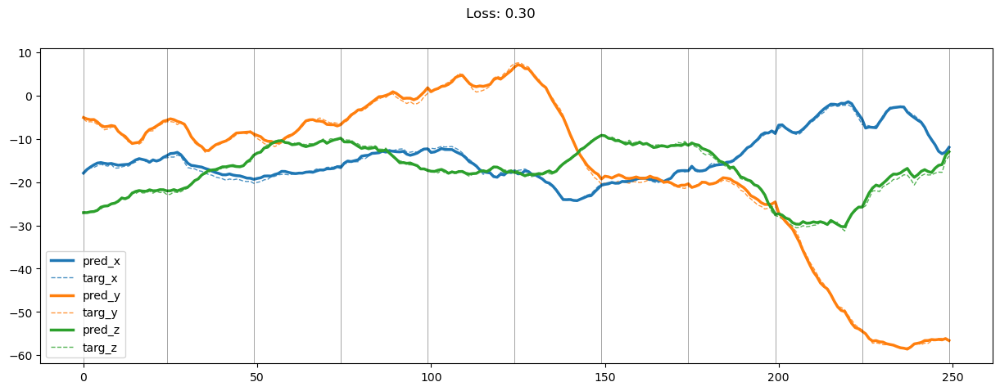

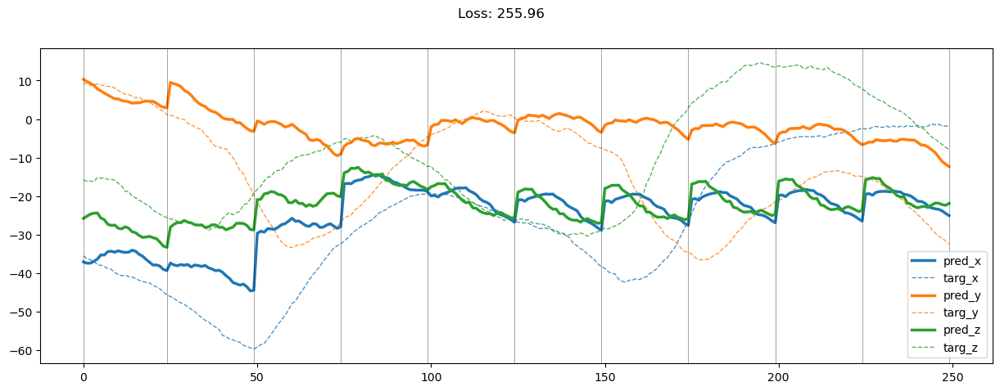

01449: train pred loss:  0.433, g loss:  1.661, diff loss:  0.843, d loss:  1.525
       valid pred loss:  176.864, g loss:  547.514, diff loss:  370.268, d loss:  1.535


100%|██████████| 17/17 [00:01<00:00, 14.00it/s]


01450: train pred loss:  0.420, g loss:  1.631, diff loss:  0.828, d loss:  1.528
       valid pred loss:  178.863, g loss:  555.627, diff loss:  376.386, d loss:  1.540


100%|██████████| 17/17 [00:01<00:00, 15.21it/s]


01451: train pred loss:  0.417, g loss:  1.612, diff loss:  0.816, d loss:  1.532
       valid pred loss:  176.706, g loss:  545.154, diff loss:  368.073, d loss:  1.543


100%|██████████| 17/17 [00:01<00:00, 14.90it/s]


01452: train pred loss:  0.437, g loss:  1.668, diff loss:  0.855, d loss:  1.535
       valid pred loss:  178.343, g loss:  555.448, diff loss:  376.733, d loss:  1.547


100%|██████████| 17/17 [00:01<00:00, 14.94it/s]


01453: train pred loss:  0.429, g loss:  1.642, diff loss:  0.840, d loss:  1.538
       valid pred loss:  176.216, g loss:  548.611, diff loss:  372.024, d loss:  1.548


100%|██████████| 17/17 [00:01<00:00, 14.88it/s]


01454: train pred loss:  0.416, g loss:  1.608, diff loss:  0.818, d loss:  1.539
       valid pred loss:  178.187, g loss:  555.827, diff loss:  377.270, d loss:  1.550


100%|██████████| 17/17 [00:01<00:00, 15.24it/s]


01455: train pred loss:  0.423, g loss:  1.636, diff loss:  0.840, d loss:  1.540
       valid pred loss:  176.499, g loss:  549.263, diff loss:  372.393, d loss:  1.549


100%|██████████| 17/17 [00:01<00:00, 15.22it/s]


01456: train pred loss:  0.413, g loss:  1.604, diff loss:  0.819, d loss:  1.540
       valid pred loss:  177.337, g loss:  551.676, diff loss:  373.970, d loss:  1.550


100%|██████████| 17/17 [00:01<00:00, 14.94it/s]


01457: train pred loss:  0.416, g loss:  1.611, diff loss:  0.823, d loss:  1.539
       valid pred loss:  174.013, g loss:  542.624, diff loss:  368.240, d loss:  1.547


100%|██████████| 17/17 [00:01<00:00, 14.57it/s]


01458: train pred loss:  0.418, g loss:  1.621, diff loss:  0.827, d loss:  1.537
       valid pred loss:  175.033, g loss:  540.553, diff loss:  365.147, d loss:  1.546


100%|██████████| 17/17 [00:01<00:00, 15.24it/s]


01459: train pred loss:  0.424, g loss:  1.631, diff loss:  0.830, d loss:  1.534
       valid pred loss:  177.056, g loss:  548.809, diff loss:  371.378, d loss:  1.543


100%|██████████| 17/17 [00:01<00:00, 15.20it/s]


01460: train pred loss:  0.429, g loss:  1.635, diff loss:  0.826, d loss:  1.532
       valid pred loss:  177.250, g loss:  548.925, diff loss:  371.297, d loss:  1.540


100%|██████████| 17/17 [00:01<00:00, 14.67it/s]


01461: train pred loss:  0.433, g loss:  1.662, diff loss:  0.845, d loss:  1.528
       valid pred loss:  176.839, g loss:  551.676, diff loss:  374.455, d loss:  1.535


100%|██████████| 17/17 [00:01<00:00, 14.90it/s]


01462: train pred loss:  0.428, g loss:  1.658, diff loss:  0.842, d loss:  1.523
       valid pred loss:  179.072, g loss:  554.280, diff loss:  374.821, d loss:  1.530


100%|██████████| 17/17 [00:01<00:00, 14.98it/s]


01463: train pred loss:  0.425, g loss:  1.653, diff loss:  0.836, d loss:  1.518
       valid pred loss:  180.882, g loss:  560.584, diff loss:  379.311, d loss:  1.527


100%|██████████| 17/17 [00:01<00:00, 15.22it/s]


01464: train pred loss:  0.438, g loss:  1.699, diff loss:  0.864, d loss:  1.513
       valid pred loss:  180.240, g loss:  557.257, diff loss:  376.621, d loss:  1.520


100%|██████████| 17/17 [00:01<00:00, 14.81it/s]


01465: train pred loss:  0.470, g loss:  1.796, diff loss:  0.924, d loss:  1.507
       valid pred loss:  183.455, g loss:  568.910, diff loss:  385.055, d loss:  1.515


100%|██████████| 17/17 [00:01<00:00, 15.19it/s]


01466: train pred loss:  0.435, g loss:  1.691, diff loss:  0.850, d loss:  1.503
       valid pred loss:  176.177, g loss:  544.270, diff loss:  367.685, d loss:  1.508


100%|██████████| 17/17 [00:01<00:00, 15.24it/s]


01467: train pred loss:  0.453, g loss:  1.757, diff loss:  0.892, d loss:  1.497
       valid pred loss:  177.876, g loss:  551.387, diff loss:  373.100, d loss:  1.504


100%|██████████| 17/17 [00:01<00:00, 15.27it/s]


01468: train pred loss:  0.429, g loss:  1.683, diff loss:  0.837, d loss:  1.493
       valid pred loss:  176.093, g loss:  544.871, diff loss:  368.361, d loss:  1.499


100%|██████████| 17/17 [00:01<00:00, 15.20it/s]


01469: train pred loss:  0.430, g loss:  1.686, diff loss:  0.834, d loss:  1.489
       valid pred loss:  177.458, g loss:  546.082, diff loss:  368.202, d loss:  1.493


100%|██████████| 17/17 [00:01<00:00, 15.22it/s]


01470: train pred loss:  0.432, g loss:  1.695, diff loss:  0.836, d loss:  1.484
       valid pred loss:  180.026, g loss:  560.594, diff loss:  380.142, d loss:  1.491


100%|██████████| 17/17 [00:01<00:00, 15.25it/s]


01471: train pred loss:  0.433, g loss:  1.720, diff loss:  0.856, d loss:  1.480
       valid pred loss:  180.334, g loss:  559.578, diff loss:  378.815, d loss:  1.488


100%|██████████| 17/17 [00:01<00:00, 15.20it/s]


01472: train pred loss:  0.437, g loss:  1.732, diff loss:  0.862, d loss:  1.478
       valid pred loss:  178.736, g loss:  555.195, diff loss:  376.025, d loss:  1.483


100%|██████████| 17/17 [00:01<00:00, 15.15it/s]


01473: train pred loss:  0.425, g loss:  1.687, diff loss:  0.825, d loss:  1.475
       valid pred loss:  179.807, g loss:  556.150, diff loss:  375.906, d loss:  1.481


100%|██████████| 17/17 [00:01<00:00, 15.18it/s]


01474: train pred loss:  0.426, g loss:  1.701, diff loss:  0.836, d loss:  1.473
       valid pred loss:  179.808, g loss:  559.047, diff loss:  378.800, d loss:  1.479


100%|██████████| 17/17 [00:01<00:00, 15.17it/s]


01475: train pred loss:  0.427, g loss:  1.714, diff loss:  0.846, d loss:  1.471
       valid pred loss:  179.581, g loss:  561.633, diff loss:  381.612, d loss:  1.479


100%|██████████| 17/17 [00:01<00:00, 15.14it/s]


01476: train pred loss:  0.421, g loss:  1.695, diff loss:  0.831, d loss:  1.469
       valid pred loss:  178.218, g loss:  555.198, diff loss:  376.539, d loss:  1.478


100%|██████████| 17/17 [00:01<00:00, 15.21it/s]


01477: train pred loss:  0.419, g loss:  1.674, diff loss:  0.813, d loss:  1.471
       valid pred loss:  177.427, g loss:  551.020, diff loss:  373.153, d loss:  1.479


100%|██████████| 17/17 [00:01<00:00, 15.08it/s]


01478: train pred loss:  0.410, g loss:  1.665, diff loss:  0.813, d loss:  1.472
       valid pred loss:  178.452, g loss:  554.408, diff loss:  375.517, d loss:  1.479


100%|██████████| 17/17 [00:01<00:00, 15.12it/s]


01479: train pred loss:  0.413, g loss:  1.669, diff loss:  0.817, d loss:  1.473
       valid pred loss:  178.402, g loss:  553.394, diff loss:  374.557, d loss:  1.483


100%|██████████| 17/17 [00:01<00:00, 15.10it/s]


01480: train pred loss:  0.441, g loss:  1.745, diff loss:  0.867, d loss:  1.474
       valid pred loss:  180.337, g loss:  551.854, diff loss:  371.084, d loss:  1.484


100%|██████████| 17/17 [00:01<00:00, 15.18it/s]


01481: train pred loss:  0.428, g loss:  1.715, diff loss:  0.853, d loss:  1.478
       valid pred loss:  176.094, g loss:  542.967, diff loss:  366.444, d loss:  1.487


100%|██████████| 17/17 [00:01<00:00, 14.63it/s]


01482: train pred loss:  0.449, g loss:  1.763, diff loss:  0.885, d loss:  1.482
       valid pred loss:  178.051, g loss:  547.304, diff loss:  368.828, d loss:  1.492


100%|██████████| 17/17 [00:01<00:00, 15.24it/s]


01483: train pred loss:  0.438, g loss:  1.739, diff loss:  0.876, d loss:  1.485
       valid pred loss:  177.188, g loss:  546.839, diff loss:  369.232, d loss:  1.496


100%|██████████| 17/17 [00:01<00:00, 14.89it/s]


01484: train pred loss:  0.435, g loss:  1.710, diff loss:  0.855, d loss:  1.490
       valid pred loss:  174.745, g loss:  533.727, diff loss:  358.570, d loss:  1.503


100%|██████████| 17/17 [00:01<00:00, 15.25it/s]


01485: train pred loss:  0.423, g loss:  1.667, diff loss:  0.830, d loss:  1.495
       valid pred loss:  177.620, g loss:  545.283, diff loss:  367.254, d loss:  1.506


100%|██████████| 17/17 [00:01<00:00, 15.24it/s]


01486: train pred loss:  0.415, g loss:  1.635, diff loss:  0.810, d loss:  1.499
       valid pred loss:  178.709, g loss:  546.875, diff loss:  367.764, d loss:  1.513


100%|██████████| 17/17 [00:01<00:00, 15.27it/s]


01487: train pred loss:  0.419, g loss:  1.649, diff loss:  0.825, d loss:  1.504
       valid pred loss:  173.753, g loss:  533.582, diff loss:  359.430, d loss:  1.516


100%|██████████| 17/17 [00:01<00:00, 15.27it/s]


01488: train pred loss:  0.418, g loss:  1.642, diff loss:  0.826, d loss:  1.510
       valid pred loss:  175.388, g loss:  537.843, diff loss:  362.063, d loss:  1.523


100%|██████████| 17/17 [00:01<00:00, 15.26it/s]


01489: train pred loss:  0.453, g loss:  1.732, diff loss:  0.885, d loss:  1.515
       valid pred loss:  172.734, g loss:  532.330, diff loss:  359.207, d loss:  1.528


100%|██████████| 17/17 [00:01<00:00, 15.25it/s]


01490: train pred loss:  0.463, g loss:  1.756, diff loss:  0.904, d loss:  1.521
       valid pred loss:  174.790, g loss:  537.619, diff loss:  362.445, d loss:  1.533


100%|██████████| 17/17 [00:01<00:00, 14.85it/s]


01491: train pred loss:  0.457, g loss:  1.737, diff loss:  0.895, d loss:  1.525
       valid pred loss:  176.886, g loss:  540.669, diff loss:  363.404, d loss:  1.539


100%|██████████| 17/17 [00:01<00:00, 14.83it/s]


01492: train pred loss:  0.477, g loss:  1.786, diff loss:  0.927, d loss:  1.529
       valid pred loss:  174.636, g loss:  533.443, diff loss:  358.431, d loss:  1.543


100%|██████████| 17/17 [00:01<00:00, 15.27it/s]


01493: train pred loss:  0.465, g loss:  1.747, diff loss:  0.905, d loss:  1.535
       valid pred loss:  172.686, g loss:  529.266, diff loss:  356.207, d loss:  1.545


100%|██████████| 17/17 [00:01<00:00, 15.25it/s]


01494: train pred loss:  0.483, g loss:  1.804, diff loss:  0.945, d loss:  1.536
       valid pred loss:  176.557, g loss:  538.748, diff loss:  361.819, d loss:  1.547


100%|██████████| 17/17 [00:01<00:00, 15.25it/s]


01495: train pred loss:  0.476, g loss:  1.778, diff loss:  0.928, d loss:  1.538
       valid pred loss:  179.217, g loss:  558.809, diff loss:  379.223, d loss:  1.550


100%|██████████| 17/17 [00:01<00:00, 15.23it/s]


01496: train pred loss:  0.464, g loss:  1.741, diff loss:  0.905, d loss:  1.540
       valid pred loss:  179.320, g loss:  555.773, diff loss:  376.084, d loss:  1.551


100%|██████████| 17/17 [00:01<00:00, 15.04it/s]


01497: train pred loss:  0.468, g loss:  1.757, diff loss:  0.918, d loss:  1.541
       valid pred loss:  178.552, g loss:  552.942, diff loss:  374.023, d loss:  1.554


100%|██████████| 17/17 [00:01<00:00, 14.48it/s]


01498: train pred loss:  0.457, g loss:  1.732, diff loss:  0.903, d loss:  1.542
       valid pred loss:  174.473, g loss:  538.045, diff loss:  363.203, d loss:  1.550


100%|██████████| 17/17 [00:01<00:00, 15.23it/s]


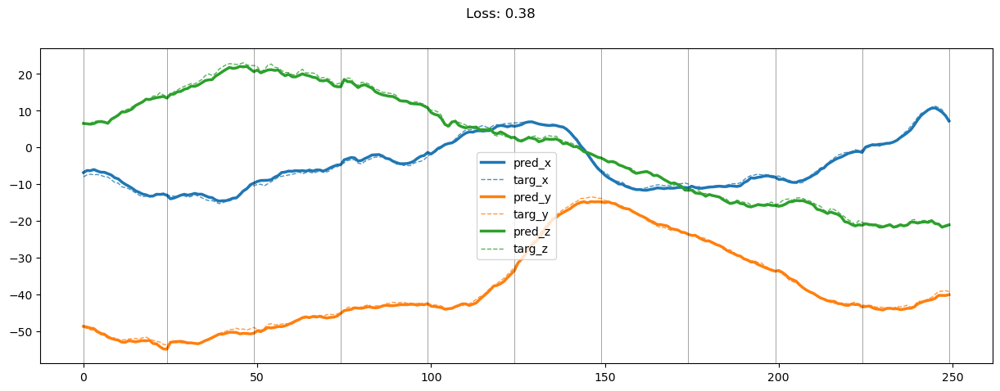

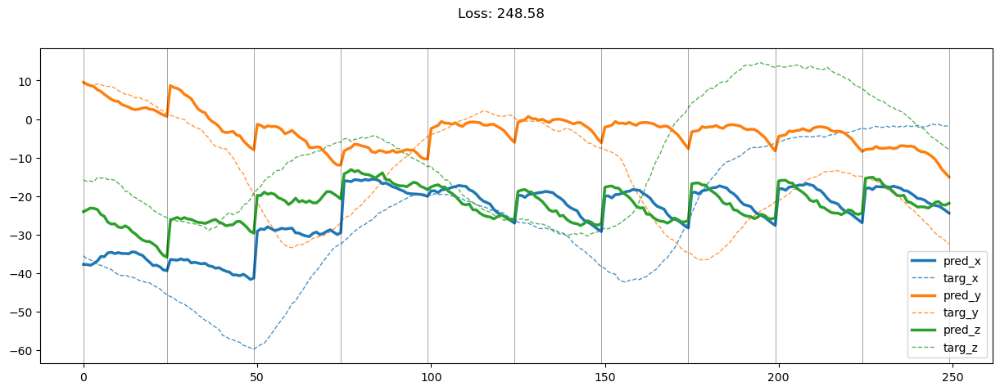

01499: train pred loss:  0.460, g loss:  1.729, diff loss:  0.895, d loss:  1.540
       valid pred loss:  177.424, g loss:  545.327, diff loss:  367.532, d loss:  1.548


100%|██████████| 17/17 [00:01<00:00, 14.53it/s]


01500: train pred loss:  0.439, g loss:  1.669, diff loss:  0.856, d loss:  1.538
       valid pred loss:  176.815, g loss:  546.549, diff loss:  369.360, d loss:  1.546


100%|██████████| 17/17 [00:01<00:00, 15.25it/s]


01501: train pred loss:  0.422, g loss:  1.639, diff loss:  0.841, d loss:  1.536
       valid pred loss:  177.218, g loss:  552.485, diff loss:  374.893, d loss:  1.544


100%|██████████| 17/17 [00:01<00:00, 15.21it/s]


01502: train pred loss:  0.421, g loss:  1.631, diff loss:  0.831, d loss:  1.532
       valid pred loss:  177.977, g loss:  551.435, diff loss:  373.079, d loss:  1.537


100%|██████████| 17/17 [00:01<00:00, 15.22it/s]


01503: train pred loss:  0.425, g loss:  1.641, diff loss:  0.832, d loss:  1.527
       valid pred loss:  176.885, g loss:  548.193, diff loss:  370.926, d loss:  1.534


100%|██████████| 17/17 [00:01<00:00, 14.96it/s]


01504: train pred loss:  0.445, g loss:  1.697, diff loss:  0.865, d loss:  1.523
       valid pred loss:  179.412, g loss:  555.105, diff loss:  375.306, d loss:  1.529


100%|██████████| 17/17 [00:01<00:00, 15.19it/s]


01505: train pred loss:  0.423, g loss:  1.643, diff loss:  0.828, d loss:  1.517
       valid pred loss:  180.252, g loss:  554.633, diff loss:  373.990, d loss:  1.524


100%|██████████| 17/17 [00:01<00:00, 15.20it/s]


01506: train pred loss:  0.424, g loss:  1.653, diff loss:  0.832, d loss:  1.512
       valid pred loss:  178.249, g loss:  549.436, diff loss:  370.789, d loss:  1.518


100%|██████████| 17/17 [00:01<00:00, 14.40it/s]


01507: train pred loss:  0.416, g loss:  1.629, diff loss:  0.810, d loss:  1.507
       valid pred loss:  178.991, g loss:  548.248, diff loss:  368.856, d loss:  1.513


100%|██████████| 17/17 [00:01<00:00, 14.27it/s]


01508: train pred loss:  0.402, g loss:  1.602, diff loss:  0.792, d loss:  1.502
       valid pred loss:  178.862, g loss:  553.048, diff loss:  373.780, d loss:  1.508


100%|██████████| 17/17 [00:01<00:00, 15.28it/s]


01509: train pred loss:  0.404, g loss:  1.623, diff loss:  0.807, d loss:  1.497
       valid pred loss:  179.142, g loss:  554.238, diff loss:  374.682, d loss:  1.502


100%|██████████| 17/17 [00:01<00:00, 15.29it/s]


01510: train pred loss:  0.413, g loss:  1.649, diff loss:  0.818, d loss:  1.491
       valid pred loss:  177.729, g loss:  549.186, diff loss:  371.038, d loss:  1.496


100%|██████████| 17/17 [00:01<00:00, 15.25it/s]


01511: train pred loss:  0.411, g loss:  1.645, diff loss:  0.810, d loss:  1.486
       valid pred loss:  178.931, g loss:  554.082, diff loss:  374.727, d loss:  1.492


100%|██████████| 17/17 [00:01<00:00, 15.21it/s]


01512: train pred loss:  0.426, g loss:  1.661, diff loss:  0.807, d loss:  1.483
       valid pred loss:  179.545, g loss:  552.861, diff loss:  372.889, d loss:  1.489


100%|██████████| 17/17 [00:01<00:00, 15.13it/s]


01513: train pred loss:  0.428, g loss:  1.678, diff loss:  0.817, d loss:  1.478
       valid pred loss:  178.199, g loss:  549.412, diff loss:  370.780, d loss:  1.484


100%|██████████| 17/17 [00:01<00:00, 15.21it/s]


01514: train pred loss:  0.430, g loss:  1.712, diff loss:  0.845, d loss:  1.475
       valid pred loss:  179.764, g loss:  553.870, diff loss:  373.670, d loss:  1.482


100%|██████████| 17/17 [00:01<00:00, 15.06it/s]


01515: train pred loss:  0.450, g loss:  1.769, diff loss:  0.879, d loss:  1.473
       valid pred loss:  179.859, g loss:  557.087, diff loss:  376.791, d loss:  1.480


100%|██████████| 17/17 [00:01<00:00, 15.03it/s]


01516: train pred loss:  0.457, g loss:  1.778, diff loss:  0.879, d loss:  1.470
       valid pred loss:  178.785, g loss:  550.977, diff loss:  371.751, d loss:  1.477


100%|██████████| 17/17 [00:01<00:00, 14.57it/s]


01517: train pred loss:  0.440, g loss:  1.744, diff loss:  0.861, d loss:  1.470
       valid pred loss:  179.533, g loss:  554.362, diff loss:  374.388, d loss:  1.477


100%|██████████| 17/17 [00:01<00:00, 15.16it/s]


01518: train pred loss:  0.432, g loss:  1.720, diff loss:  0.845, d loss:  1.470
       valid pred loss:  180.986, g loss:  561.023, diff loss:  379.595, d loss:  1.477


100%|██████████| 17/17 [00:01<00:00, 15.13it/s]


01519: train pred loss:  0.441, g loss:  1.740, diff loss:  0.855, d loss:  1.470
       valid pred loss:  178.973, g loss:  550.433, diff loss:  371.018, d loss:  1.477


100%|██████████| 17/17 [00:01<00:00, 14.88it/s]


01520: train pred loss:  0.420, g loss:  1.677, diff loss:  0.815, d loss:  1.470
       valid pred loss:  179.230, g loss:  552.225, diff loss:  372.557, d loss:  1.480


100%|██████████| 17/17 [00:01<00:00, 14.91it/s]


01521: train pred loss:  0.418, g loss:  1.681, diff loss:  0.823, d loss:  1.472
       valid pred loss:  180.780, g loss:  560.389, diff loss:  379.173, d loss:  1.481


100%|██████████| 17/17 [00:01<00:00, 13.62it/s]


01522: train pred loss:  0.404, g loss:  1.639, diff loss:  0.799, d loss:  1.476
       valid pred loss:  178.474, g loss:  548.935, diff loss:  370.028, d loss:  1.484


100%|██████████| 17/17 [00:01<00:00, 14.52it/s]


01523: train pred loss:  0.421, g loss:  1.677, diff loss:  0.822, d loss:  1.477
       valid pred loss:  182.342, g loss:  562.873, diff loss:  380.101, d loss:  1.486


100%|██████████| 17/17 [00:01<00:00, 14.55it/s]


01524: train pred loss:  0.394, g loss:  1.604, diff loss:  0.781, d loss:  1.482
       valid pred loss:  180.996, g loss:  557.265, diff loss:  375.845, d loss:  1.491


100%|██████████| 17/17 [00:01<00:00, 14.98it/s]


01525: train pred loss:  0.390, g loss:  1.584, diff loss:  0.770, d loss:  1.485
       valid pred loss:  178.809, g loss:  553.162, diff loss:  373.934, d loss:  1.496


100%|██████████| 17/17 [00:01<00:00, 15.28it/s]


01526: train pred loss:  0.390, g loss:  1.580, diff loss:  0.771, d loss:  1.491
       valid pred loss:  179.583, g loss:  551.714, diff loss:  371.717, d loss:  1.501


100%|██████████| 17/17 [00:01<00:00, 15.24it/s]


01527: train pred loss:  0.402, g loss:  1.613, diff loss:  0.798, d loss:  1.495
       valid pred loss:  178.904, g loss:  554.779, diff loss:  375.467, d loss:  1.506


100%|██████████| 17/17 [00:01<00:00, 15.23it/s]


01528: train pred loss:  0.405, g loss:  1.607, diff loss:  0.794, d loss:  1.502
       valid pred loss:  179.564, g loss:  553.272, diff loss:  373.305, d loss:  1.511


100%|██████████| 17/17 [00:01<00:00, 15.14it/s]


01529: train pred loss:  0.411, g loss:  1.609, diff loss:  0.797, d loss:  1.507
       valid pred loss:  179.018, g loss:  550.664, diff loss:  371.249, d loss:  1.518


100%|██████████| 17/17 [00:01<00:00, 14.78it/s]


01530: train pred loss:  0.411, g loss:  1.621, diff loss:  0.814, d loss:  1.513
       valid pred loss:  181.099, g loss:  558.707, diff loss:  377.217, d loss:  1.525


100%|██████████| 17/17 [00:01<00:00, 14.72it/s]


01531: train pred loss:  0.419, g loss:  1.642, diff loss:  0.832, d loss:  1.518
       valid pred loss:  178.873, g loss:  549.437, diff loss:  370.177, d loss:  1.528


100%|██████████| 17/17 [00:01<00:00, 14.41it/s]


01532: train pred loss:  0.418, g loss:  1.621, diff loss:  0.817, d loss:  1.524
       valid pred loss:  178.416, g loss:  550.689, diff loss:  371.892, d loss:  1.536


100%|██████████| 17/17 [00:01<00:00, 15.17it/s]


01533: train pred loss:  0.408, g loss:  1.593, diff loss:  0.803, d loss:  1.528
       valid pred loss:  177.154, g loss:  549.685, diff loss:  372.152, d loss:  1.539


100%|██████████| 17/17 [00:01<00:00, 15.16it/s]


01534: train pred loss:  0.404, g loss:  1.562, diff loss:  0.779, d loss:  1.532
       valid pred loss:  177.279, g loss:  543.729, diff loss:  366.075, d loss:  1.543


100%|██████████| 17/17 [00:01<00:00, 15.15it/s]


01535: train pred loss:  0.395, g loss:  1.541, diff loss:  0.771, d loss:  1.536
       valid pred loss:  176.563, g loss:  541.198, diff loss:  364.264, d loss:  1.547


100%|██████████| 17/17 [00:01<00:00, 14.85it/s]


01536: train pred loss:  0.395, g loss:  1.546, diff loss:  0.779, d loss:  1.541
       valid pred loss:  180.162, g loss:  551.591, diff loss:  371.059, d loss:  1.550


100%|██████████| 17/17 [00:01<00:00, 15.15it/s]


01537: train pred loss:  0.391, g loss:  1.531, diff loss:  0.769, d loss:  1.541
       valid pred loss:  177.540, g loss:  549.740, diff loss:  371.830, d loss:  1.550


100%|██████████| 17/17 [00:01<00:00, 15.02it/s]


01538: train pred loss:  0.396, g loss:  1.547, diff loss:  0.781, d loss:  1.543
       valid pred loss:  177.163, g loss:  551.971, diff loss:  374.441, d loss:  1.553


100%|██████████| 17/17 [00:01<00:00, 15.08it/s]


01539: train pred loss:  0.402, g loss:  1.554, diff loss:  0.782, d loss:  1.543
       valid pred loss:  179.122, g loss:  554.555, diff loss:  375.066, d loss:  1.552


100%|██████████| 17/17 [00:01<00:00, 15.20it/s]


01540: train pred loss:  0.394, g loss:  1.544, diff loss:  0.779, d loss:  1.542
       valid pred loss:  178.282, g loss:  552.841, diff loss:  374.191, d loss:  1.552


100%|██████████| 17/17 [00:01<00:00, 15.12it/s]


01541: train pred loss:  0.393, g loss:  1.534, diff loss:  0.769, d loss:  1.541
       valid pred loss:  178.367, g loss:  553.843, diff loss:  375.106, d loss:  1.549


100%|██████████| 17/17 [00:01<00:00, 15.14it/s]


01542: train pred loss:  0.388, g loss:  1.526, diff loss:  0.764, d loss:  1.538
       valid pred loss:  179.722, g loss:  559.187, diff loss:  379.092, d loss:  1.545


100%|██████████| 17/17 [00:01<00:00, 15.05it/s]


01543: train pred loss:  0.396, g loss:  1.561, diff loss:  0.789, d loss:  1.535
       valid pred loss:  173.847, g loss:  538.042, diff loss:  363.821, d loss:  1.544


100%|██████████| 17/17 [00:01<00:00, 15.21it/s]


01544: train pred loss:  0.416, g loss:  1.622, diff loss:  0.827, d loss:  1.531
       valid pred loss:  176.078, g loss:  542.260, diff loss:  365.804, d loss:  1.539


100%|██████████| 17/17 [00:01<00:00, 15.08it/s]


01545: train pred loss:  0.425, g loss:  1.644, diff loss:  0.835, d loss:  1.527
       valid pred loss:  177.216, g loss:  543.539, diff loss:  365.939, d loss:  1.533


100%|██████████| 17/17 [00:01<00:00, 15.10it/s]


01546: train pred loss:  0.410, g loss:  1.598, diff loss:  0.800, d loss:  1.522
       valid pred loss:  176.920, g loss:  544.741, diff loss:  367.432, d loss:  1.527


100%|██████████| 17/17 [00:01<00:00, 14.20it/s]


01547: train pred loss:  0.394, g loss:  1.572, diff loss:  0.785, d loss:  1.516
       valid pred loss:  175.301, g loss:  538.553, diff loss:  362.858, d loss:  1.521


100%|██████████| 17/17 [00:01<00:00, 14.89it/s]


01548: train pred loss:  0.392, g loss:  1.560, diff loss:  0.770, d loss:  1.511
       valid pred loss:  172.590, g loss:  536.208, diff loss:  363.218, d loss:  1.516


100%|██████████| 17/17 [00:01<00:00, 15.14it/s]


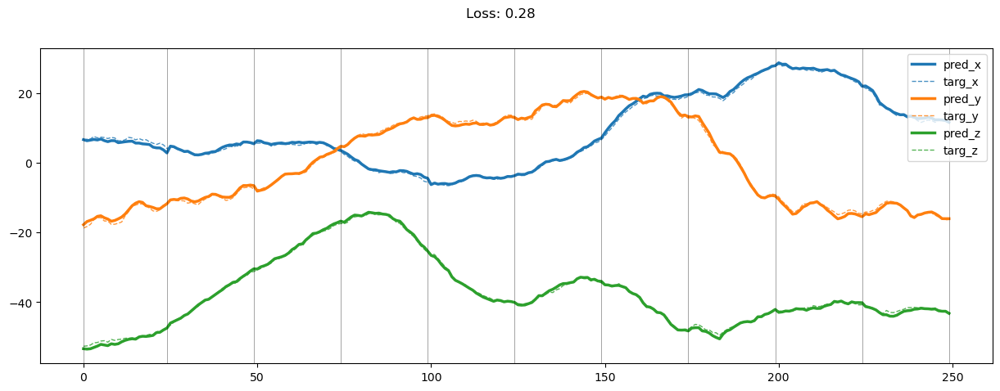

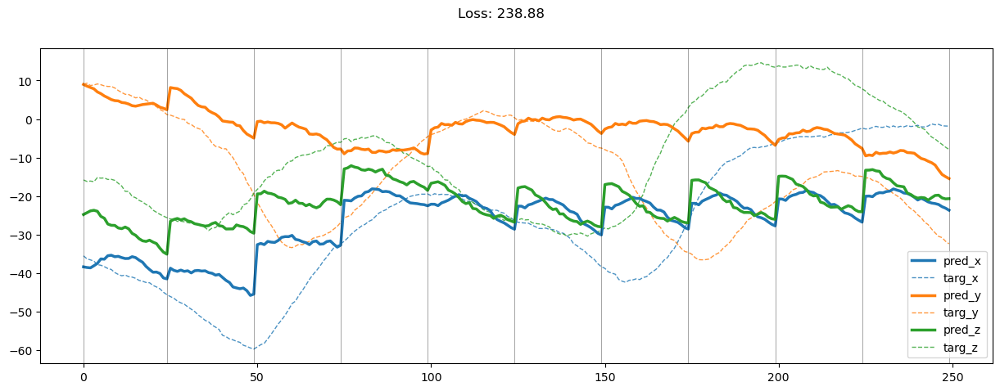

01549: train pred loss:  0.389, g loss:  1.563, diff loss:  0.770, d loss:  1.505
       valid pred loss:  180.627, g loss:  559.363, diff loss:  378.331, d loss:  1.510


100%|██████████| 17/17 [00:01<00:00, 15.19it/s]


01550: train pred loss:  0.396, g loss:  1.578, diff loss:  0.772, d loss:  1.499
       valid pred loss:  180.637, g loss:  558.065, diff loss:  377.018, d loss:  1.504


100%|██████████| 17/17 [00:01<00:00, 15.11it/s]


01551: train pred loss:  0.402, g loss:  1.598, diff loss:  0.780, d loss:  1.492
       valid pred loss:  178.760, g loss:  547.629, diff loss:  368.453, d loss:  1.498


100%|██████████| 17/17 [00:01<00:00, 15.15it/s]


01552: train pred loss:  0.387, g loss:  1.577, diff loss:  0.768, d loss:  1.488
       valid pred loss:  181.948, g loss:  562.372, diff loss:  380.002, d loss:  1.494


100%|██████████| 17/17 [00:01<00:00, 15.18it/s]


01553: train pred loss:  0.389, g loss:  1.581, diff loss:  0.766, d loss:  1.485
       valid pred loss:  179.891, g loss:  559.342, diff loss:  379.024, d loss:  1.489


100%|██████████| 17/17 [00:01<00:00, 14.91it/s]


01554: train pred loss:  0.418, g loss:  1.656, diff loss:  0.806, d loss:  1.479
       valid pred loss:  181.681, g loss:  562.657, diff loss:  380.544, d loss:  1.485


100%|██████████| 17/17 [00:01<00:00, 15.05it/s]


01555: train pred loss:  0.436, g loss:  1.717, diff loss:  0.844, d loss:  1.475
       valid pred loss:  179.147, g loss:  554.593, diff loss:  375.008, d loss:  1.479


100%|██████████| 17/17 [00:01<00:00, 15.18it/s]


01556: train pred loss:  0.435, g loss:  1.731, diff loss:  0.855, d loss:  1.472
       valid pred loss:  181.087, g loss:  563.311, diff loss:  381.786, d loss:  1.479


100%|██████████| 17/17 [00:01<00:00, 15.08it/s]


01557: train pred loss:  0.434, g loss:  1.741, diff loss:  0.865, d loss:  1.470
       valid pred loss:  180.416, g loss:  556.543, diff loss:  375.685, d loss:  1.474


100%|██████████| 17/17 [00:01<00:00, 14.58it/s]


01558: train pred loss:  0.422, g loss:  1.698, diff loss:  0.831, d loss:  1.469
       valid pred loss:  180.479, g loss:  555.343, diff loss:  374.420, d loss:  1.474


100%|██████████| 17/17 [00:01<00:00, 15.03it/s]


01559: train pred loss:  0.414, g loss:  1.677, diff loss:  0.816, d loss:  1.468
       valid pred loss:  177.958, g loss:  548.989, diff loss:  370.587, d loss:  1.475


100%|██████████| 17/17 [00:01<00:00, 15.17it/s]


01560: train pred loss:  0.410, g loss:  1.665, diff loss:  0.809, d loss:  1.468
       valid pred loss:  180.945, g loss:  562.848, diff loss:  381.458, d loss:  1.474


100%|██████████| 17/17 [00:01<00:00, 15.11it/s]


01561: train pred loss:  0.405, g loss:  1.641, diff loss:  0.790, d loss:  1.468
       valid pred loss:  182.402, g loss:  562.465, diff loss:  379.622, d loss:  1.477


100%|██████████| 17/17 [00:01<00:00, 15.07it/s]


01562: train pred loss:  0.407, g loss:  1.658, diff loss:  0.807, d loss:  1.469
       valid pred loss:  178.914, g loss:  555.532, diff loss:  376.179, d loss:  1.478


100%|██████████| 17/17 [00:01<00:00, 15.05it/s]


01563: train pred loss:  0.395, g loss:  1.613, diff loss:  0.777, d loss:  1.472
       valid pred loss:  179.199, g loss:  557.557, diff loss:  377.922, d loss:  1.481


100%|██████████| 17/17 [00:01<00:00, 15.06it/s]


01564: train pred loss:  0.403, g loss:  1.636, diff loss:  0.797, d loss:  1.476
       valid pred loss:  178.241, g loss:  551.948, diff loss:  373.274, d loss:  1.483


100%|██████████| 17/17 [00:01<00:00, 15.06it/s]


01565: train pred loss:  0.402, g loss:  1.629, diff loss:  0.795, d loss:  1.479
       valid pred loss:  178.053, g loss:  552.516, diff loss:  374.034, d loss:  1.486


100%|██████████| 17/17 [00:01<00:00, 15.04it/s]


01566: train pred loss:  0.412, g loss:  1.653, diff loss:  0.813, d loss:  1.482
       valid pred loss:  178.075, g loss:  552.662, diff loss:  374.163, d loss:  1.491


100%|██████████| 17/17 [00:01<00:00, 15.13it/s]


01567: train pred loss:  0.416, g loss:  1.643, diff loss:  0.805, d loss:  1.488
       valid pred loss:  179.563, g loss:  555.979, diff loss:  375.998, d loss:  1.497


100%|██████████| 17/17 [00:01<00:00, 15.05it/s]


01568: train pred loss:  0.412, g loss:  1.640, diff loss:  0.811, d loss:  1.492
       valid pred loss:  180.336, g loss:  556.151, diff loss:  375.403, d loss:  1.503


100%|██████████| 17/17 [00:01<00:00, 15.06it/s]


01569: train pred loss:  0.409, g loss:  1.624, diff loss:  0.804, d loss:  1.498
       valid pred loss:  179.917, g loss:  556.607, diff loss:  376.284, d loss:  1.508


100%|██████████| 17/17 [00:01<00:00, 14.77it/s]


01570: train pred loss:  0.405, g loss:  1.597, diff loss:  0.787, d loss:  1.504
       valid pred loss:  180.526, g loss:  557.092, diff loss:  376.167, d loss:  1.515


100%|██████████| 17/17 [00:01<00:00, 15.03it/s]


01571: train pred loss:  0.413, g loss:  1.628, diff loss:  0.816, d loss:  1.510
       valid pred loss:  178.923, g loss:  551.867, diff loss:  372.551, d loss:  1.521


100%|██████████| 17/17 [00:01<00:00, 14.98it/s]


01572: train pred loss:  0.407, g loss:  1.603, diff loss:  0.803, d loss:  1.516
       valid pred loss:  179.213, g loss:  553.692, diff loss:  374.090, d loss:  1.526


100%|██████████| 17/17 [00:01<00:00, 15.09it/s]


01573: train pred loss:  0.409, g loss:  1.601, diff loss:  0.803, d loss:  1.522
       valid pred loss:  177.447, g loss:  551.494, diff loss:  373.663, d loss:  1.532


100%|██████████| 17/17 [00:01<00:00, 15.19it/s]


01574: train pred loss:  0.408, g loss:  1.595, diff loss:  0.803, d loss:  1.527
       valid pred loss:  178.534, g loss:  551.199, diff loss:  372.286, d loss:  1.538


100%|██████████| 17/17 [00:01<00:00, 15.15it/s]


01575: train pred loss:  0.405, g loss:  1.576, diff loss:  0.792, d loss:  1.533
       valid pred loss:  179.934, g loss:  550.981, diff loss:  370.673, d loss:  1.544


100%|██████████| 17/17 [00:01<00:00, 15.14it/s]


01576: train pred loss:  0.419, g loss:  1.611, diff loss:  0.815, d loss:  1.536
       valid pred loss:  182.579, g loss:  561.067, diff loss:  378.115, d loss:  1.545


100%|██████████| 17/17 [00:01<00:00, 15.14it/s]


01577: train pred loss:  0.409, g loss:  1.593, diff loss:  0.812, d loss:  1.540
       valid pred loss:  177.661, g loss:  550.572, diff loss:  372.542, d loss:  1.549


100%|██████████| 17/17 [00:01<00:00, 15.18it/s]


01578: train pred loss:  0.407, g loss:  1.583, diff loss:  0.805, d loss:  1.543
       valid pred loss:  177.494, g loss:  547.245, diff loss:  369.384, d loss:  1.552


100%|██████████| 17/17 [00:01<00:00, 15.16it/s]


01579: train pred loss:  0.403, g loss:  1.566, diff loss:  0.794, d loss:  1.545
       valid pred loss:  172.655, g loss:  533.018, diff loss:  359.998, d loss:  1.554


100%|██████████| 17/17 [00:01<00:00, 15.13it/s]


01580: train pred loss:  0.418, g loss:  1.607, diff loss:  0.822, d loss:  1.546
       valid pred loss:  175.247, g loss:  540.826, diff loss:  365.213, d loss:  1.554


100%|██████████| 17/17 [00:01<00:00, 15.19it/s]


01581: train pred loss:  0.414, g loss:  1.583, diff loss:  0.802, d loss:  1.547
       valid pred loss:  177.524, g loss:  544.549, diff loss:  366.660, d loss:  1.555


100%|██████████| 17/17 [00:01<00:00, 15.15it/s]


01582: train pred loss:  0.410, g loss:  1.584, diff loss:  0.805, d loss:  1.545
       valid pred loss:  177.562, g loss:  550.730, diff loss:  372.802, d loss:  1.554


100%|██████████| 17/17 [00:01<00:00, 15.14it/s]


01583: train pred loss:  0.425, g loss:  1.629, diff loss:  0.833, d loss:  1.542
       valid pred loss:  177.510, g loss:  545.839, diff loss:  367.960, d loss:  1.549


100%|██████████| 17/17 [00:01<00:00, 15.15it/s]


01584: train pred loss:  0.438, g loss:  1.670, diff loss:  0.858, d loss:  1.539
       valid pred loss:  176.197, g loss:  542.102, diff loss:  365.533, d loss:  1.547


100%|██████████| 17/17 [00:01<00:00, 14.55it/s]


01585: train pred loss:  0.432, g loss:  1.667, diff loss:  0.859, d loss:  1.535
       valid pred loss:  177.282, g loss:  551.823, diff loss:  374.166, d loss:  1.542


100%|██████████| 17/17 [00:01<00:00, 13.88it/s]


01586: train pred loss:  0.423, g loss:  1.644, diff loss:  0.841, d loss:  1.531
       valid pred loss:  182.384, g loss:  561.673, diff loss:  378.909, d loss:  1.536


100%|██████████| 17/17 [00:01<00:00, 15.17it/s]


01587: train pred loss:  0.402, g loss:  1.578, diff loss:  0.793, d loss:  1.526
       valid pred loss:  180.044, g loss:  557.814, diff loss:  377.386, d loss:  1.531


100%|██████████| 17/17 [00:01<00:00, 15.17it/s]


01588: train pred loss:  0.397, g loss:  1.570, diff loss:  0.785, d loss:  1.522
       valid pred loss:  182.711, g loss:  560.905, diff loss:  377.805, d loss:  1.525


100%|██████████| 17/17 [00:01<00:00, 15.23it/s]


01589: train pred loss:  0.406, g loss:  1.589, diff loss:  0.789, d loss:  1.515
       valid pred loss:  178.222, g loss:  550.877, diff loss:  372.260, d loss:  1.519


100%|██████████| 17/17 [00:01<00:00, 15.22it/s]


01590: train pred loss:  0.405, g loss:  1.596, diff loss:  0.790, d loss:  1.509
       valid pred loss:  179.996, g loss:  558.061, diff loss:  377.664, d loss:  1.513


100%|██████████| 17/17 [00:01<00:00, 15.23it/s]


01591: train pred loss:  0.396, g loss:  1.574, diff loss:  0.772, d loss:  1.502
       valid pred loss:  178.974, g loss:  550.881, diff loss:  371.500, d loss:  1.507


100%|██████████| 17/17 [00:01<00:00, 14.41it/s]


01592: train pred loss:  0.389, g loss:  1.569, diff loss:  0.767, d loss:  1.496
       valid pred loss:  177.382, g loss:  547.690, diff loss:  369.893, d loss:  1.499


100%|██████████| 17/17 [00:01<00:00, 14.58it/s]


01593: train pred loss:  0.408, g loss:  1.614, diff loss:  0.788, d loss:  1.492
       valid pred loss:  179.782, g loss:  553.399, diff loss:  373.199, d loss:  1.496


100%|██████████| 17/17 [00:01<00:00, 15.14it/s]


01594: train pred loss:  0.399, g loss:  1.602, diff loss:  0.780, d loss:  1.486
       valid pred loss:  178.443, g loss:  549.559, diff loss:  370.691, d loss:  1.489


100%|██████████| 17/17 [00:01<00:00, 14.75it/s]


01595: train pred loss:  0.396, g loss:  1.598, diff loss:  0.773, d loss:  1.482
       valid pred loss:  184.743, g loss:  568.277, diff loss:  383.103, d loss:  1.485


100%|██████████| 17/17 [00:01<00:00, 15.25it/s]


01596: train pred loss:  0.396, g loss:  1.607, diff loss:  0.777, d loss:  1.477
       valid pred loss:  180.528, g loss:  556.173, diff loss:  375.210, d loss:  1.481


100%|██████████| 17/17 [00:01<00:00, 15.24it/s]


01597: train pred loss:  0.411, g loss:  1.664, diff loss:  0.813, d loss:  1.472
       valid pred loss:  179.169, g loss:  553.814, diff loss:  374.206, d loss:  1.477


100%|██████████| 17/17 [00:01<00:00, 15.24it/s]


01598: train pred loss:  0.415, g loss:  1.677, diff loss:  0.820, d loss:  1.470
       valid pred loss:  178.315, g loss:  554.412, diff loss:  375.654, d loss:  1.474


100%|██████████| 17/17 [00:01<00:00, 15.25it/s]


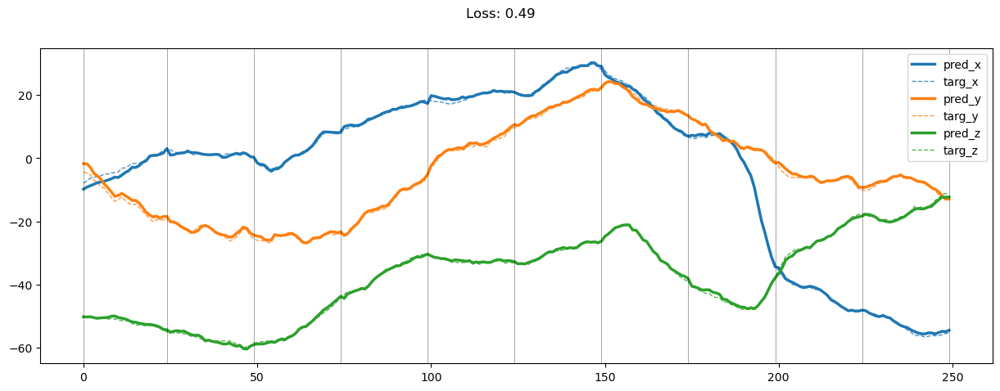

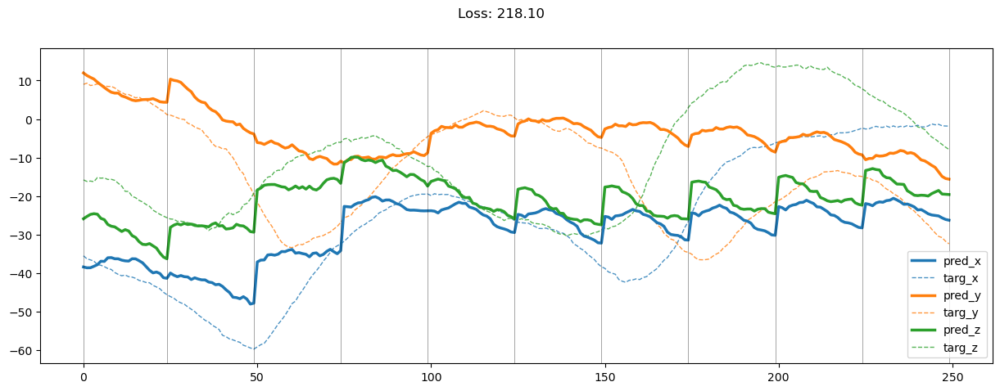

01599: train pred loss:  0.435, g loss:  1.714, diff loss:  0.832, d loss:  1.467
       valid pred loss:  184.239, g loss:  568.243, diff loss:  383.558, d loss:  1.472


100%|██████████| 17/17 [00:01<00:00, 15.20it/s]


01600: train pred loss:  0.433, g loss:  1.728, diff loss:  0.847, d loss:  1.466
       valid pred loss:  181.960, g loss:  559.048, diff loss:  376.642, d loss:  1.472


100%|██████████| 17/17 [00:01<00:00, 15.22it/s]


01601: train pred loss:  0.415, g loss:  1.681, diff loss:  0.818, d loss:  1.466
       valid pred loss:  179.728, g loss:  556.028, diff loss:  375.853, d loss:  1.471


100%|██████████| 17/17 [00:01<00:00, 15.25it/s]


01602: train pred loss:  0.404, g loss:  1.645, diff loss:  0.793, d loss:  1.466
       valid pred loss:  174.799, g loss:  540.940, diff loss:  365.694, d loss:  1.471


100%|██████████| 17/17 [00:01<00:00, 15.25it/s]


01603: train pred loss:  0.402, g loss:  1.642, diff loss:  0.793, d loss:  1.468
       valid pred loss:  178.417, g loss:  551.351, diff loss:  372.490, d loss:  1.473


100%|██████████| 17/17 [00:01<00:00, 15.21it/s]


01604: train pred loss:  0.412, g loss:  1.654, diff loss:  0.796, d loss:  1.469
       valid pred loss:  177.070, g loss:  546.912, diff loss:  369.400, d loss:  1.475


100%|██████████| 17/17 [00:01<00:00, 14.42it/s]


01605: train pred loss:  0.408, g loss:  1.644, diff loss:  0.795, d loss:  1.472
       valid pred loss:  177.479, g loss:  545.222, diff loss:  367.305, d loss:  1.478


100%|██████████| 17/17 [00:01<00:00, 15.24it/s]


01606: train pred loss:  0.405, g loss:  1.647, diff loss:  0.805, d loss:  1.474
       valid pred loss:  180.312, g loss:  559.819, diff loss:  379.075, d loss:  1.483


100%|██████████| 17/17 [00:01<00:00, 14.79it/s]


01607: train pred loss:  0.400, g loss:  1.612, diff loss:  0.780, d loss:  1.479
       valid pred loss:  178.504, g loss:  551.799, diff loss:  372.866, d loss:  1.486


100%|██████████| 17/17 [00:01<00:00, 15.25it/s]


01608: train pred loss:  0.405, g loss:  1.625, diff loss:  0.793, d loss:  1.483
       valid pred loss:  177.157, g loss:  553.021, diff loss:  375.443, d loss:  1.492


100%|██████████| 17/17 [00:01<00:00, 14.96it/s]


01609: train pred loss:  0.411, g loss:  1.631, diff loss:  0.798, d loss:  1.487
       valid pred loss:  178.859, g loss:  553.158, diff loss:  373.881, d loss:  1.496


100%|██████████| 17/17 [00:01<00:00, 14.51it/s]


01610: train pred loss:  0.422, g loss:  1.662, diff loss:  0.823, d loss:  1.493
       valid pred loss:  177.432, g loss:  547.914, diff loss:  370.071, d loss:  1.504


100%|██████████| 17/17 [00:01<00:00, 15.24it/s]


01611: train pred loss:  0.404, g loss:  1.601, diff loss:  0.787, d loss:  1.498
       valid pred loss:  176.523, g loss:  545.268, diff loss:  368.342, d loss:  1.510


100%|██████████| 17/17 [00:01<00:00, 15.26it/s]


01612: train pred loss:  0.403, g loss:  1.601, diff loss:  0.794, d loss:  1.504
       valid pred loss:  180.290, g loss:  557.417, diff loss:  376.729, d loss:  1.516


100%|██████████| 17/17 [00:01<00:00, 15.24it/s]


01613: train pred loss:  0.400, g loss:  1.595, diff loss:  0.797, d loss:  1.512
       valid pred loss:  177.332, g loss:  552.825, diff loss:  375.101, d loss:  1.522


100%|██████████| 17/17 [00:01<00:00, 14.60it/s]


01614: train pred loss:  0.406, g loss:  1.602, diff loss:  0.805, d loss:  1.517
       valid pred loss:  174.656, g loss:  539.038, diff loss:  363.996, d loss:  1.529


100%|██████████| 17/17 [00:01<00:00, 15.25it/s]


01615: train pred loss:  0.419, g loss:  1.624, diff loss:  0.818, d loss:  1.524
       valid pred loss:  177.716, g loss:  551.465, diff loss:  373.368, d loss:  1.534


100%|██████████| 17/17 [00:01<00:00, 15.26it/s]


01616: train pred loss:  0.395, g loss:  1.542, diff loss:  0.766, d loss:  1.530
       valid pred loss:  179.909, g loss:  556.170, diff loss:  375.885, d loss:  1.540


100%|██████████| 17/17 [00:01<00:00, 15.24it/s]


01617: train pred loss:  0.402, g loss:  1.553, diff loss:  0.774, d loss:  1.535
       valid pred loss:  177.463, g loss:  554.767, diff loss:  376.932, d loss:  1.545


100%|██████████| 17/17 [00:01<00:00, 15.23it/s]


01618: train pred loss:  0.404, g loss:  1.578, diff loss:  0.801, d loss:  1.539
       valid pred loss:  179.459, g loss:  560.882, diff loss:  381.055, d loss:  1.549


100%|██████████| 17/17 [00:01<00:00, 15.24it/s]


01619: train pred loss:  0.388, g loss:  1.524, diff loss:  0.767, d loss:  1.544
       valid pred loss:  180.118, g loss:  559.948, diff loss:  379.464, d loss:  1.553


100%|██████████| 17/17 [00:01<00:00, 15.26it/s]


01620: train pred loss:  0.396, g loss:  1.553, diff loss:  0.789, d loss:  1.545
       valid pred loss:  180.336, g loss:  560.650, diff loss:  379.950, d loss:  1.557


100%|██████████| 17/17 [00:01<00:00, 15.19it/s]


01621: train pred loss:  0.406, g loss:  1.554, diff loss:  0.781, d loss:  1.548
       valid pred loss:  181.017, g loss:  566.133, diff loss:  384.752, d loss:  1.556


100%|██████████| 17/17 [00:01<00:00, 15.20it/s]


01622: train pred loss:  0.405, g loss:  1.558, diff loss:  0.787, d loss:  1.548
       valid pred loss:  178.272, g loss:  557.863, diff loss:  379.228, d loss:  1.556


100%|██████████| 17/17 [00:01<00:00, 15.00it/s]


01623: train pred loss:  0.405, g loss:  1.568, diff loss:  0.797, d loss:  1.549
       valid pred loss:  176.699, g loss:  552.980, diff loss:  375.918, d loss:  1.556


100%|██████████| 17/17 [00:01<00:00, 14.36it/s]


01624: train pred loss:  0.400, g loss:  1.546, diff loss:  0.780, d loss:  1.548
       valid pred loss:  172.992, g loss:  541.954, diff loss:  368.596, d loss:  1.553


100%|██████████| 17/17 [00:01<00:00, 15.03it/s]


01625: train pred loss:  0.399, g loss:  1.547, diff loss:  0.779, d loss:  1.545
       valid pred loss:  180.209, g loss:  559.177, diff loss:  378.601, d loss:  1.552


100%|██████████| 17/17 [00:01<00:00, 14.56it/s]


01626: train pred loss:  0.411, g loss:  1.593, diff loss:  0.811, d loss:  1.541
       valid pred loss:  177.569, g loss:  548.803, diff loss:  370.864, d loss:  1.547


100%|██████████| 17/17 [00:01<00:00, 15.24it/s]


01627: train pred loss:  0.401, g loss:  1.565, diff loss:  0.789, d loss:  1.537
       valid pred loss:  179.970, g loss:  559.659, diff loss:  379.316, d loss:  1.543


100%|██████████| 17/17 [00:01<00:00, 15.22it/s]


01628: train pred loss:  0.399, g loss:  1.565, diff loss:  0.786, d loss:  1.532
       valid pred loss:  179.222, g loss:  555.648, diff loss:  376.046, d loss:  1.536


100%|██████████| 17/17 [00:01<00:00, 15.20it/s]


01629: train pred loss:  0.398, g loss:  1.573, diff loss:  0.791, d loss:  1.527
       valid pred loss:  176.509, g loss:  546.697, diff loss:  369.804, d loss:  1.531


100%|██████████| 17/17 [00:01<00:00, 15.22it/s]


01630: train pred loss:  0.405, g loss:  1.594, diff loss:  0.800, d loss:  1.521
       valid pred loss:  178.957, g loss:  552.165, diff loss:  372.820, d loss:  1.526


100%|██████████| 17/17 [00:01<00:00, 14.13it/s]


01631: train pred loss:  0.403, g loss:  1.591, diff loss:  0.793, d loss:  1.515
       valid pred loss:  177.699, g loss:  547.693, diff loss:  369.599, d loss:  1.518


100%|██████████| 17/17 [00:01<00:00, 14.31it/s]


01632: train pred loss:  0.419, g loss:  1.647, diff loss:  0.826, d loss:  1.506
       valid pred loss:  175.127, g loss:  538.525, diff loss:  362.995, d loss:  1.511


100%|██████████| 17/17 [00:01<00:00, 15.19it/s]


01633: train pred loss:  0.407, g loss:  1.622, diff loss:  0.807, d loss:  1.502
       valid pred loss:  174.961, g loss:  540.124, diff loss:  364.753, d loss:  1.503


100%|██████████| 17/17 [00:01<00:00, 15.23it/s]


01634: train pred loss:  0.409, g loss:  1.633, diff loss:  0.810, d loss:  1.496
       valid pred loss:  175.651, g loss:  541.435, diff loss:  365.370, d loss:  1.501


100%|██████████| 17/17 [00:01<00:00, 15.24it/s]


01635: train pred loss:  0.410, g loss:  1.656, diff loss:  0.825, d loss:  1.490
       valid pred loss:  178.090, g loss:  550.529, diff loss:  372.018, d loss:  1.493


100%|██████████| 17/17 [00:01<00:00, 15.25it/s]


01636: train pred loss:  0.390, g loss:  1.599, diff loss:  0.783, d loss:  1.484
       valid pred loss:  176.818, g loss:  549.126, diff loss:  371.881, d loss:  1.488


100%|██████████| 17/17 [00:01<00:00, 15.24it/s]


01637: train pred loss:  0.388, g loss:  1.589, diff loss:  0.770, d loss:  1.480
       valid pred loss:  175.268, g loss:  540.901, diff loss:  365.199, d loss:  1.482


100%|██████████| 17/17 [00:01<00:00, 15.25it/s]


01638: train pred loss:  0.390, g loss:  1.594, diff loss:  0.766, d loss:  1.474
       valid pred loss:  173.393, g loss:  534.038, diff loss:  360.207, d loss:  1.478


100%|██████████| 17/17 [00:01<00:00, 15.24it/s]


01639: train pred loss:  0.401, g loss:  1.628, diff loss:  0.786, d loss:  1.472
       valid pred loss:  176.318, g loss:  541.989, diff loss:  365.230, d loss:  1.476


100%|██████████| 17/17 [00:01<00:00, 15.25it/s]


01640: train pred loss:  0.390, g loss:  1.590, diff loss:  0.755, d loss:  1.469
       valid pred loss:  177.459, g loss:  547.000, diff loss:  369.096, d loss:  1.474


100%|██████████| 17/17 [00:01<00:00, 15.25it/s]


01641: train pred loss:  0.390, g loss:  1.597, diff loss:  0.759, d loss:  1.466
       valid pred loss:  175.299, g loss:  538.638, diff loss:  362.891, d loss:  1.470


100%|██████████| 17/17 [00:01<00:00, 15.24it/s]


01642: train pred loss:  0.389, g loss:  1.605, diff loss:  0.765, d loss:  1.465
       valid pred loss:  175.027, g loss:  537.962, diff loss:  362.486, d loss:  1.470


100%|██████████| 17/17 [00:01<00:00, 15.24it/s]


01643: train pred loss:  0.387, g loss:  1.592, diff loss:  0.755, d loss:  1.464
       valid pred loss:  174.152, g loss:  534.799, diff loss:  360.198, d loss:  1.469


100%|██████████| 17/17 [00:01<00:00, 14.57it/s]


01644: train pred loss:  0.386, g loss:  1.592, diff loss:  0.755, d loss:  1.465
       valid pred loss:  173.150, g loss:  530.326, diff loss:  356.728, d loss:  1.470


100%|██████████| 17/17 [00:01<00:00, 14.71it/s]


01645: train pred loss:  0.411, g loss:  1.666, diff loss:  0.806, d loss:  1.466
       valid pred loss:  175.125, g loss:  533.528, diff loss:  357.956, d loss:  1.471


100%|██████████| 17/17 [00:01<00:00, 14.50it/s]


01646: train pred loss:  0.407, g loss:  1.648, diff loss:  0.794, d loss:  1.467
       valid pred loss:  177.006, g loss:  544.575, diff loss:  367.127, d loss:  1.474


100%|██████████| 17/17 [00:01<00:00, 15.13it/s]


01647: train pred loss:  0.398, g loss:  1.625, diff loss:  0.784, d loss:  1.471
       valid pred loss:  178.952, g loss:  547.699, diff loss:  368.308, d loss:  1.476


100%|██████████| 17/17 [00:01<00:00, 15.19it/s]


01648: train pred loss:  0.400, g loss:  1.628, diff loss:  0.789, d loss:  1.474
       valid pred loss:  176.807, g loss:  545.188, diff loss:  367.947, d loss:  1.481


100%|██████████| 17/17 [00:01<00:00, 15.21it/s]


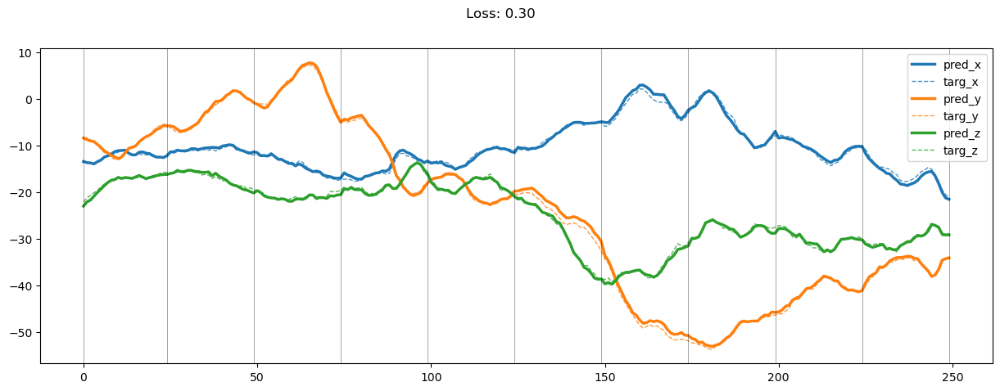

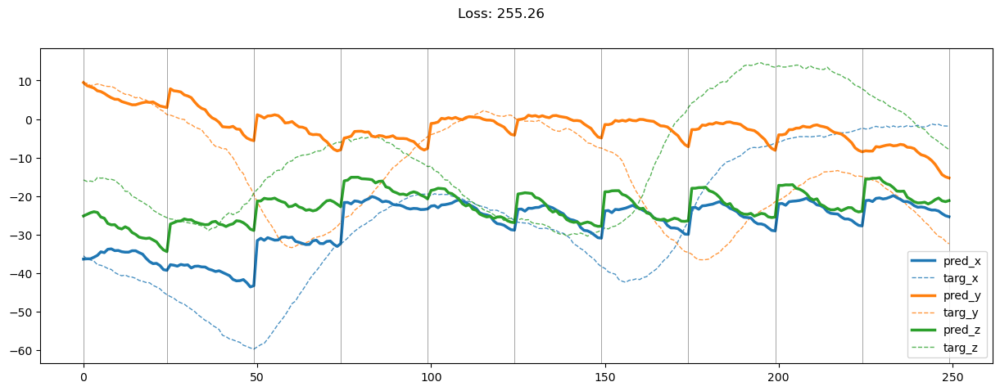

01649: train pred loss:  0.481, g loss:  1.843, diff loss:  0.928, d loss:  1.477
       valid pred loss:  175.764, g loss:  541.046, diff loss:  364.853, d loss:  1.485


100%|██████████| 17/17 [00:01<00:00, 15.12it/s]


01650: train pred loss:  0.456, g loss:  1.779, diff loss:  0.895, d loss:  1.483
       valid pred loss:  174.909, g loss:  531.791, diff loss:  356.459, d loss:  1.490


100%|██████████| 17/17 [00:01<00:00, 15.18it/s]


01651: train pred loss:  0.425, g loss:  1.697, diff loss:  0.850, d loss:  1.489
       valid pred loss:  177.134, g loss:  534.251, diff loss:  356.702, d loss:  1.499


100%|██████████| 17/17 [00:01<00:00, 15.15it/s]


01652: train pred loss:  0.412, g loss:  1.643, diff loss:  0.817, d loss:  1.495
       valid pred loss:  176.327, g loss:  531.139, diff loss:  354.403, d loss:  1.505


100%|██████████| 17/17 [00:01<00:00, 14.79it/s]


01653: train pred loss:  0.395, g loss:  1.580, diff loss:  0.777, d loss:  1.502
       valid pred loss:  177.217, g loss:  536.965, diff loss:  359.347, d loss:  1.512


100%|██████████| 17/17 [00:01<00:00, 15.15it/s]


01654: train pred loss:  0.408, g loss:  1.623, diff loss:  0.813, d loss:  1.507
       valid pred loss:  178.408, g loss:  542.044, diff loss:  363.240, d loss:  1.518


100%|██████████| 17/17 [00:01<00:00, 14.90it/s]


01655: train pred loss:  0.406, g loss:  1.601, diff loss:  0.799, d loss:  1.514
       valid pred loss:  173.670, g loss:  529.325, diff loss:  355.266, d loss:  1.524


100%|██████████| 17/17 [00:01<00:00, 14.66it/s]


01656: train pred loss:  0.416, g loss:  1.631, diff loss:  0.824, d loss:  1.519
       valid pred loss:  179.251, g loss:  544.246, diff loss:  364.612, d loss:  1.532


100%|██████████| 17/17 [00:01<00:00, 13.93it/s]


01657: train pred loss:  0.472, g loss:  1.769, diff loss:  0.912, d loss:  1.525
       valid pred loss:  178.705, g loss:  542.790, diff loss:  363.705, d loss:  1.535


100%|██████████| 17/17 [00:01<00:00, 14.68it/s]


01658: train pred loss:  0.448, g loss:  1.696, diff loss:  0.869, d loss:  1.534
       valid pred loss:  179.419, g loss:  545.180, diff loss:  365.387, d loss:  1.542


100%|██████████| 17/17 [00:01<00:00, 14.77it/s]


01659: train pred loss:  0.450, g loss:  1.706, diff loss:  0.881, d loss:  1.538
       valid pred loss:  180.085, g loss:  543.760, diff loss:  363.307, d loss:  1.549


100%|██████████| 17/17 [00:01<00:00, 15.06it/s]


01660: train pred loss:  0.423, g loss:  1.627, diff loss:  0.833, d loss:  1.544
       valid pred loss:  178.443, g loss:  543.830, diff loss:  365.022, d loss:  1.554


100%|██████████| 17/17 [00:01<00:00, 15.15it/s]


01661: train pred loss:  0.415, g loss:  1.611, diff loss:  0.829, d loss:  1.546
       valid pred loss:  180.182, g loss:  544.752, diff loss:  364.209, d loss:  1.558


100%|██████████| 17/17 [00:01<00:00, 15.21it/s]


01662: train pred loss:  0.416, g loss:  1.598, diff loss:  0.817, d loss:  1.550
       valid pred loss:  180.650, g loss:  548.512, diff loss:  367.501, d loss:  1.560


100%|██████████| 17/17 [00:01<00:00, 15.20it/s]


01663: train pred loss:  0.400, g loss:  1.542, diff loss:  0.777, d loss:  1.551
       valid pred loss:  176.523, g loss:  535.740, diff loss:  358.856, d loss:  1.559


100%|██████████| 17/17 [00:01<00:00, 15.20it/s]


01664: train pred loss:  0.404, g loss:  1.556, diff loss:  0.789, d loss:  1.551
       valid pred loss:  178.000, g loss:  544.682, diff loss:  366.322, d loss:  1.561


100%|██████████| 17/17 [00:01<00:00, 15.08it/s]


01665: train pred loss:  0.393, g loss:  1.537, diff loss:  0.781, d loss:  1.552
       valid pred loss:  177.058, g loss:  546.762, diff loss:  369.344, d loss:  1.560


100%|██████████| 17/17 [00:01<00:00, 15.13it/s]


01666: train pred loss:  0.399, g loss:  1.549, diff loss:  0.784, d loss:  1.550
       valid pred loss:  178.045, g loss:  540.493, diff loss:  362.086, d loss:  1.557


100%|██████████| 17/17 [00:01<00:00, 15.25it/s]


01667: train pred loss:  0.400, g loss:  1.556, diff loss:  0.790, d loss:  1.548
       valid pred loss:  178.173, g loss:  547.600, diff loss:  369.062, d loss:  1.554


100%|██████████| 17/17 [00:01<00:00, 15.09it/s]


01668: train pred loss:  0.396, g loss:  1.537, diff loss:  0.770, d loss:  1.543
       valid pred loss:  176.042, g loss:  541.675, diff loss:  365.264, d loss:  1.548


100%|██████████| 17/17 [00:01<00:00, 14.95it/s]


01669: train pred loss:  0.385, g loss:  1.522, diff loss:  0.763, d loss:  1.538
       valid pred loss:  175.546, g loss:  542.126, diff loss:  366.206, d loss:  1.543


100%|██████████| 17/17 [00:01<00:00, 15.23it/s]


01670: train pred loss:  0.385, g loss:  1.513, diff loss:  0.749, d loss:  1.534
       valid pred loss:  176.877, g loss:  542.341, diff loss:  365.087, d loss:  1.539


100%|██████████| 17/17 [00:01<00:00, 15.20it/s]


01671: train pred loss:  0.373, g loss:  1.498, diff loss:  0.741, d loss:  1.528
       valid pred loss:  177.252, g loss:  544.104, diff loss:  366.468, d loss:  1.532


100%|██████████| 17/17 [00:01<00:00, 15.19it/s]


01672: train pred loss:  0.380, g loss:  1.521, diff loss:  0.752, d loss:  1.521
       valid pred loss:  179.783, g loss:  552.078, diff loss:  371.906, d loss:  1.525


100%|██████████| 17/17 [00:01<00:00, 15.20it/s]


01673: train pred loss:  0.370, g loss:  1.497, diff loss:  0.732, d loss:  1.514
       valid pred loss:  180.242, g loss:  551.479, diff loss:  370.840, d loss:  1.517


100%|██████████| 17/17 [00:01<00:00, 15.16it/s]


01674: train pred loss:  0.375, g loss:  1.514, diff loss:  0.736, d loss:  1.508
       valid pred loss:  177.825, g loss:  546.274, diff loss:  368.047, d loss:  1.512


100%|██████████| 17/17 [00:01<00:00, 14.91it/s]


01675: train pred loss:  0.394, g loss:  1.572, diff loss:  0.768, d loss:  1.499
       valid pred loss:  174.821, g loss:  539.264, diff loss:  364.033, d loss:  1.503


100%|██████████| 17/17 [00:01<00:00, 15.07it/s]


01676: train pred loss:  0.390, g loss:  1.576, diff loss:  0.770, d loss:  1.494
       valid pred loss:  174.290, g loss:  537.610, diff loss:  362.904, d loss:  1.499


100%|██████████| 17/17 [00:01<00:00, 14.88it/s]


01677: train pred loss:  0.385, g loss:  1.568, diff loss:  0.762, d loss:  1.489
       valid pred loss:  173.762, g loss:  538.794, diff loss:  364.610, d loss:  1.492


100%|██████████| 17/17 [00:01<00:00, 15.12it/s]


01678: train pred loss:  0.399, g loss:  1.601, diff loss:  0.774, d loss:  1.483
       valid pred loss:  174.939, g loss:  546.267, diff loss:  370.899, d loss:  1.486


100%|██████████| 17/17 [00:01<00:00, 15.09it/s]


01679: train pred loss:  0.403, g loss:  1.618, diff loss:  0.780, d loss:  1.478
       valid pred loss:  173.486, g loss:  539.133, diff loss:  365.212, d loss:  1.481


100%|██████████| 17/17 [00:01<00:00, 15.06it/s]


01680: train pred loss:  0.398, g loss:  1.611, diff loss:  0.774, d loss:  1.474
       valid pred loss:  174.217, g loss:  539.441, diff loss:  364.784, d loss:  1.476


100%|██████████| 17/17 [00:01<00:00, 15.05it/s]


01681: train pred loss:  0.400, g loss:  1.641, diff loss:  0.796, d loss:  1.468
       valid pred loss:  178.183, g loss:  552.288, diff loss:  373.661, d loss:  1.474


100%|██████████| 17/17 [00:01<00:00, 14.55it/s]


01682: train pred loss:  0.432, g loss:  1.708, diff loss:  0.828, d loss:  1.467
       valid pred loss:  176.447, g loss:  548.770, diff loss:  371.875, d loss:  1.470


100%|██████████| 17/17 [00:01<00:00, 15.06it/s]


01683: train pred loss:  0.422, g loss:  1.697, diff loss:  0.824, d loss:  1.464
       valid pred loss:  175.951, g loss:  545.654, diff loss:  369.253, d loss:  1.469


100%|██████████| 17/17 [00:01<00:00, 15.03it/s]


01684: train pred loss:  0.405, g loss:  1.668, diff loss:  0.809, d loss:  1.463
       valid pred loss:  174.140, g loss:  537.764, diff loss:  363.174, d loss:  1.468


100%|██████████| 17/17 [00:01<00:00, 15.18it/s]


01685: train pred loss:  0.408, g loss:  1.662, diff loss:  0.801, d loss:  1.462
       valid pred loss:  174.275, g loss:  539.063, diff loss:  364.337, d loss:  1.468


100%|██████████| 17/17 [00:01<00:00, 15.08it/s]


01686: train pred loss:  0.414, g loss:  1.688, diff loss:  0.820, d loss:  1.462
       valid pred loss:  174.211, g loss:  537.441, diff loss:  362.779, d loss:  1.468


100%|██████████| 17/17 [00:01<00:00, 15.07it/s]


01687: train pred loss:  0.394, g loss:  1.628, diff loss:  0.784, d loss:  1.465
       valid pred loss:  175.418, g loss:  540.473, diff loss:  364.607, d loss:  1.470


100%|██████████| 17/17 [00:01<00:00, 15.11it/s]


01688: train pred loss:  0.406, g loss:  1.664, diff loss:  0.809, d loss:  1.466
       valid pred loss:  177.686, g loss:  550.133, diff loss:  372.001, d loss:  1.472


100%|██████████| 17/17 [00:01<00:00, 14.64it/s]


01689: train pred loss:  0.425, g loss:  1.709, diff loss:  0.839, d loss:  1.469
       valid pred loss:  170.783, g loss:  526.724, diff loss:  355.501, d loss:  1.477


100%|██████████| 17/17 [00:01<00:00, 15.10it/s]


01690: train pred loss:  0.415, g loss:  1.678, diff loss:  0.823, d loss:  1.472
       valid pred loss:  173.520, g loss:  532.783, diff loss:  358.830, d loss:  1.482


100%|██████████| 17/17 [00:01<00:00, 14.73it/s]


01691: train pred loss:  0.406, g loss:  1.640, diff loss:  0.800, d loss:  1.478
       valid pred loss:  172.230, g loss:  526.249, diff loss:  353.590, d loss:  1.485


100%|██████████| 17/17 [00:01<00:00, 15.02it/s]


01692: train pred loss:  0.392, g loss:  1.590, diff loss:  0.771, d loss:  1.484
       valid pred loss:  173.976, g loss:  533.102, diff loss:  358.704, d loss:  1.491


100%|██████████| 17/17 [00:01<00:00, 15.01it/s]


01693: train pred loss:  0.399, g loss:  1.617, diff loss:  0.795, d loss:  1.488
       valid pred loss:  174.677, g loss:  541.272, diff loss:  366.178, d loss:  1.497


100%|██████████| 17/17 [00:01<00:00, 14.84it/s]


01694: train pred loss:  0.400, g loss:  1.605, diff loss:  0.790, d loss:  1.495
       valid pred loss:  171.877, g loss:  529.475, diff loss:  357.189, d loss:  1.504


100%|██████████| 17/17 [00:01<00:00, 15.19it/s]


01695: train pred loss:  0.391, g loss:  1.576, diff loss:  0.777, d loss:  1.502
       valid pred loss:  173.583, g loss:  536.321, diff loss:  362.337, d loss:  1.512


100%|██████████| 17/17 [00:01<00:00, 15.04it/s]


01696: train pred loss:  0.378, g loss:  1.525, diff loss:  0.746, d loss:  1.508
       valid pred loss:  179.185, g loss:  555.877, diff loss:  376.298, d loss:  1.520


100%|██████████| 17/17 [00:01<00:00, 14.66it/s]


01697: train pred loss:  0.388, g loss:  1.553, diff loss:  0.771, d loss:  1.516
       valid pred loss:  176.720, g loss:  548.618, diff loss:  371.509, d loss:  1.526


100%|██████████| 17/17 [00:01<00:00, 14.99it/s]


01698: train pred loss:  0.392, g loss:  1.550, diff loss:  0.769, d loss:  1.521
       valid pred loss:  176.463, g loss:  549.746, diff loss:  372.901, d loss:  1.534


100%|██████████| 17/17 [00:01<00:00, 14.97it/s]


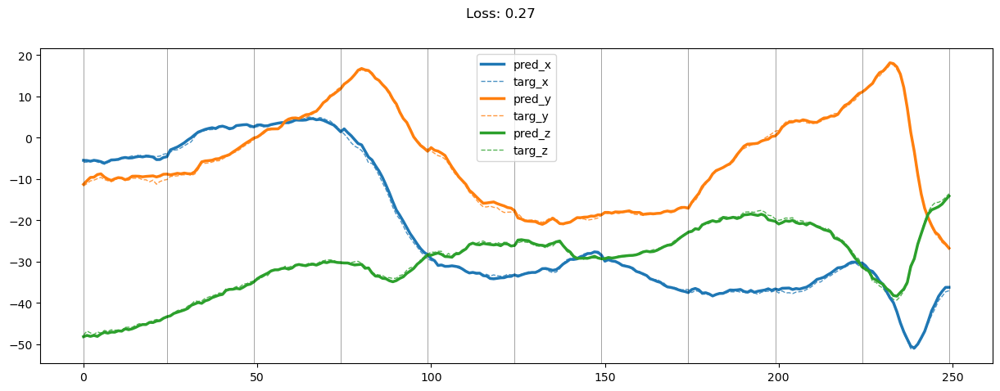

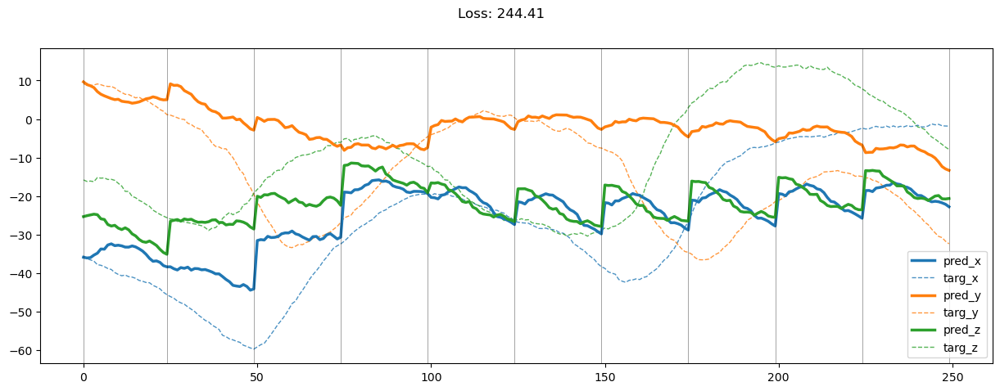

01699: train pred loss:  0.400, g loss:  1.581, diff loss:  0.797, d loss:  1.529
       valid pred loss:  177.366, g loss:  548.451, diff loss:  370.708, d loss:  1.538


100%|██████████| 17/17 [00:01<00:00, 14.97it/s]


01700: train pred loss:  0.406, g loss:  1.592, diff loss:  0.809, d loss:  1.535
       valid pred loss:  175.528, g loss:  541.124, diff loss:  365.224, d loss:  1.544


100%|██████████| 17/17 [00:01<00:00, 15.21it/s]


01701: train pred loss:  0.423, g loss:  1.639, diff loss:  0.842, d loss:  1.539
       valid pred loss:  175.443, g loss:  540.971, diff loss:  365.161, d loss:  1.551


100%|██████████| 17/17 [00:01<00:00, 15.16it/s]


01702: train pred loss:  0.408, g loss:  1.587, diff loss:  0.811, d loss:  1.546
       valid pred loss:  176.492, g loss:  535.510, diff loss:  358.654, d loss:  1.554


100%|██████████| 17/17 [00:01<00:00, 14.92it/s]


01703: train pred loss:  0.402, g loss:  1.548, diff loss:  0.780, d loss:  1.549
       valid pred loss:  174.463, g loss:  539.172, diff loss:  364.348, d loss:  1.559


100%|██████████| 17/17 [00:01<00:00, 15.16it/s]


01704: train pred loss:  0.410, g loss:  1.576, diff loss:  0.802, d loss:  1.552
       valid pred loss:  176.445, g loss:  545.830, diff loss:  369.026, d loss:  1.561


100%|██████████| 17/17 [00:01<00:00, 15.14it/s]


01705: train pred loss:  0.425, g loss:  1.616, diff loss:  0.829, d loss:  1.554
       valid pred loss:  176.450, g loss:  547.328, diff loss:  370.519, d loss:  1.562


100%|██████████| 17/17 [00:01<00:00, 15.02it/s]


01706: train pred loss:  0.398, g loss:  1.541, diff loss:  0.782, d loss:  1.555
       valid pred loss:  176.892, g loss:  544.109, diff loss:  366.859, d loss:  1.563


100%|██████████| 17/17 [00:01<00:00, 15.16it/s]


01707: train pred loss:  0.405, g loss:  1.561, diff loss:  0.795, d loss:  1.554
       valid pred loss:  178.224, g loss:  550.552, diff loss:  371.969, d loss:  1.561


100%|██████████| 17/17 [00:01<00:00, 15.05it/s]


01708: train pred loss:  0.392, g loss:  1.536, diff loss:  0.780, d loss:  1.552
       valid pred loss:  178.206, g loss:  551.225, diff loss:  372.658, d loss:  1.560


100%|██████████| 17/17 [00:01<00:00, 15.15it/s]


01709: train pred loss:  0.377, g loss:  1.485, diff loss:  0.744, d loss:  1.550
       valid pred loss:  174.811, g loss:  543.916, diff loss:  368.741, d loss:  1.556


100%|██████████| 17/17 [00:01<00:00, 15.19it/s]


01710: train pred loss:  0.385, g loss:  1.509, diff loss:  0.755, d loss:  1.545
       valid pred loss:  178.418, g loss:  555.231, diff loss:  376.446, d loss:  1.553


100%|██████████| 17/17 [00:01<00:00, 15.18it/s]


01711: train pred loss:  0.361, g loss:  1.451, diff loss:  0.718, d loss:  1.540
       valid pred loss:  179.860, g loss:  560.074, diff loss:  379.843, d loss:  1.547


100%|██████████| 17/17 [00:01<00:00, 15.20it/s]


01712: train pred loss:  0.365, g loss:  1.458, diff loss:  0.716, d loss:  1.535
       valid pred loss:  176.942, g loss:  551.126, diff loss:  373.808, d loss:  1.542


100%|██████████| 17/17 [00:01<00:00, 15.17it/s]


01713: train pred loss:  0.369, g loss:  1.470, diff loss:  0.719, d loss:  1.530
       valid pred loss:  177.246, g loss:  549.490, diff loss:  371.863, d loss:  1.535


100%|██████████| 17/17 [00:01<00:00, 15.13it/s]


01714: train pred loss:  0.374, g loss:  1.500, diff loss:  0.738, d loss:  1.522
       valid pred loss:  175.090, g loss:  541.161, diff loss:  365.683, d loss:  1.526


100%|██████████| 17/17 [00:01<00:00, 15.17it/s]


01715: train pred loss:  0.370, g loss:  1.495, diff loss:  0.731, d loss:  1.516
       valid pred loss:  178.390, g loss:  554.991, diff loss:  376.206, d loss:  1.519


100%|██████████| 17/17 [00:01<00:00, 15.16it/s]


01716: train pred loss:  0.375, g loss:  1.509, diff loss:  0.733, d loss:  1.509
       valid pred loss:  179.089, g loss:  560.324, diff loss:  380.832, d loss:  1.510


100%|██████████| 17/17 [00:01<00:00, 15.02it/s]


01717: train pred loss:  0.377, g loss:  1.534, diff loss:  0.748, d loss:  1.500
       valid pred loss:  178.741, g loss:  555.775, diff loss:  376.625, d loss:  1.505


100%|██████████| 17/17 [00:01<00:00, 14.27it/s]


01718: train pred loss:  0.396, g loss:  1.593, diff loss:  0.781, d loss:  1.494
       valid pred loss:  178.012, g loss:  546.209, diff loss:  367.780, d loss:  1.497


100%|██████████| 17/17 [00:01<00:00, 14.57it/s]


01719: train pred loss:  0.397, g loss:  1.601, diff loss:  0.781, d loss:  1.487
       valid pred loss:  176.536, g loss:  549.160, diff loss:  372.201, d loss:  1.492


100%|██████████| 17/17 [00:01<00:00, 14.17it/s]


01720: train pred loss:  0.397, g loss:  1.603, diff loss:  0.777, d loss:  1.482
       valid pred loss:  175.138, g loss:  541.285, diff loss:  365.717, d loss:  1.485


100%|██████████| 17/17 [00:01<00:00, 13.59it/s]


01721: train pred loss:  0.393, g loss:  1.601, diff loss:  0.772, d loss:  1.476
       valid pred loss:  175.469, g loss:  540.244, diff loss:  364.339, d loss:  1.480


100%|██████████| 17/17 [00:01<00:00, 15.18it/s]


01722: train pred loss:  0.379, g loss:  1.564, diff loss:  0.744, d loss:  1.472
       valid pred loss:  174.481, g loss:  539.010, diff loss:  364.087, d loss:  1.476


100%|██████████| 17/17 [00:01<00:00, 15.16it/s]


01723: train pred loss:  0.386, g loss:  1.584, diff loss:  0.752, d loss:  1.467
       valid pred loss:  175.879, g loss:  546.873, diff loss:  370.548, d loss:  1.472


100%|██████████| 17/17 [00:01<00:00, 15.15it/s]


01724: train pred loss:  0.402, g loss:  1.632, diff loss:  0.781, d loss:  1.465
       valid pred loss:  178.102, g loss:  548.943, diff loss:  370.391, d loss:  1.469


100%|██████████| 17/17 [00:01<00:00, 15.13it/s]


01725: train pred loss:  0.398, g loss:  1.628, diff loss:  0.778, d loss:  1.463
       valid pred loss:  178.272, g loss:  548.984, diff loss:  370.260, d loss:  1.468


100%|██████████| 17/17 [00:01<00:00, 15.17it/s]


01726: train pred loss:  0.385, g loss:  1.597, diff loss:  0.756, d loss:  1.460
       valid pred loss:  174.091, g loss:  539.536, diff loss:  364.991, d loss:  1.466


100%|██████████| 17/17 [00:01<00:00, 15.18it/s]


01727: train pred loss:  0.386, g loss:  1.610, diff loss:  0.767, d loss:  1.460
       valid pred loss:  176.112, g loss:  543.912, diff loss:  367.347, d loss:  1.467


100%|██████████| 17/17 [00:01<00:00, 15.20it/s]


01728: train pred loss:  0.393, g loss:  1.628, diff loss:  0.780, d loss:  1.460
       valid pred loss:  177.536, g loss:  545.509, diff loss:  367.519, d loss:  1.467


100%|██████████| 17/17 [00:01<00:00, 15.21it/s]


01729: train pred loss:  0.409, g loss:  1.665, diff loss:  0.802, d loss:  1.462
       valid pred loss:  174.496, g loss:  540.049, diff loss:  365.103, d loss:  1.469


100%|██████████| 17/17 [00:01<00:00, 15.21it/s]


01730: train pred loss:  0.397, g loss:  1.633, diff loss:  0.784, d loss:  1.463
       valid pred loss:  177.393, g loss:  544.256, diff loss:  366.414, d loss:  1.471


100%|██████████| 17/17 [00:01<00:00, 15.20it/s]


01731: train pred loss:  0.397, g loss:  1.619, diff loss:  0.775, d loss:  1.467
       valid pred loss:  175.330, g loss:  544.572, diff loss:  368.800, d loss:  1.475


100%|██████████| 17/17 [00:01<00:00, 15.19it/s]


01732: train pred loss:  0.383, g loss:  1.584, diff loss:  0.758, d loss:  1.470
       valid pred loss:  174.373, g loss:  537.179, diff loss:  362.366, d loss:  1.478


100%|██████████| 17/17 [00:01<00:00, 14.71it/s]


01733: train pred loss:  0.390, g loss:  1.576, diff loss:  0.749, d loss:  1.475
       valid pred loss:  171.816, g loss:  530.284, diff loss:  358.037, d loss:  1.484


100%|██████████| 17/17 [00:01<00:00, 15.22it/s]


01734: train pred loss:  0.371, g loss:  1.527, diff loss:  0.726, d loss:  1.481
       valid pred loss:  175.238, g loss:  542.295, diff loss:  366.634, d loss:  1.492


100%|██████████| 17/17 [00:01<00:00, 15.22it/s]


01735: train pred loss:  0.396, g loss:  1.581, diff loss:  0.761, d loss:  1.487
       valid pred loss:  173.286, g loss:  534.180, diff loss:  360.476, d loss:  1.496


100%|██████████| 17/17 [00:01<00:00, 15.08it/s]


01736: train pred loss:  0.387, g loss:  1.552, diff loss:  0.749, d loss:  1.493
       valid pred loss:  175.368, g loss:  541.198, diff loss:  365.420, d loss:  1.504


100%|██████████| 17/17 [00:01<00:00, 15.23it/s]


01737: train pred loss:  0.383, g loss:  1.532, diff loss:  0.739, d loss:  1.499
       valid pred loss:  175.427, g loss:  540.707, diff loss:  364.876, d loss:  1.511


100%|██████████| 17/17 [00:01<00:00, 15.25it/s]


01738: train pred loss:  0.378, g loss:  1.519, diff loss:  0.738, d loss:  1.507
       valid pred loss:  176.390, g loss:  544.945, diff loss:  368.158, d loss:  1.518


100%|██████████| 17/17 [00:01<00:00, 15.20it/s]


01739: train pred loss:  0.395, g loss:  1.565, diff loss:  0.775, d loss:  1.517
       valid pred loss:  176.406, g loss:  547.555, diff loss:  370.760, d loss:  1.527


100%|██████████| 17/17 [00:01<00:00, 15.20it/s]


01740: train pred loss:  0.382, g loss:  1.522, diff loss:  0.752, d loss:  1.521
       valid pred loss:  176.863, g loss:  547.400, diff loss:  370.154, d loss:  1.534


100%|██████████| 17/17 [00:01<00:00, 15.24it/s]


01741: train pred loss:  0.384, g loss:  1.514, diff loss:  0.747, d loss:  1.528
       valid pred loss:  175.450, g loss:  543.639, diff loss:  367.811, d loss:  1.539


100%|██████████| 17/17 [00:01<00:00, 14.94it/s]


01742: train pred loss:  0.385, g loss:  1.526, diff loss:  0.764, d loss:  1.540
       valid pred loss:  175.357, g loss:  544.395, diff loss:  368.668, d loss:  1.548


100%|██████████| 17/17 [00:01<00:00, 14.65it/s]


01743: train pred loss:  0.405, g loss:  1.573, diff loss:  0.795, d loss:  1.543
       valid pred loss:  176.728, g loss:  549.395, diff loss:  372.300, d loss:  1.553


100%|██████████| 17/17 [00:01<00:00, 15.16it/s]


01744: train pred loss:  0.407, g loss:  1.571, diff loss:  0.796, d loss:  1.548
       valid pred loss:  174.934, g loss:  537.509, diff loss:  362.213, d loss:  1.558


100%|██████████| 17/17 [00:01<00:00, 15.08it/s]


01745: train pred loss:  0.404, g loss:  1.568, diff loss:  0.799, d loss:  1.551
       valid pred loss:  174.323, g loss:  541.353, diff loss:  366.669, d loss:  1.561


100%|██████████| 17/17 [00:01<00:00, 15.23it/s]


01746: train pred loss:  0.402, g loss:  1.552, diff loss:  0.787, d loss:  1.553
       valid pred loss:  175.959, g loss:  544.584, diff loss:  368.267, d loss:  1.564


100%|██████████| 17/17 [00:01<00:00, 13.98it/s]


01747: train pred loss:  0.378, g loss:  1.484, diff loss:  0.746, d loss:  1.557
       valid pred loss:  174.200, g loss:  541.759, diff loss:  367.202, d loss:  1.566


100%|██████████| 17/17 [00:01<00:00, 15.17it/s]


01748: train pred loss:  0.390, g loss:  1.515, diff loss:  0.766, d loss:  1.558
       valid pred loss:  175.088, g loss:  543.382, diff loss:  367.938, d loss:  1.567


100%|██████████| 17/17 [00:01<00:00, 14.92it/s]


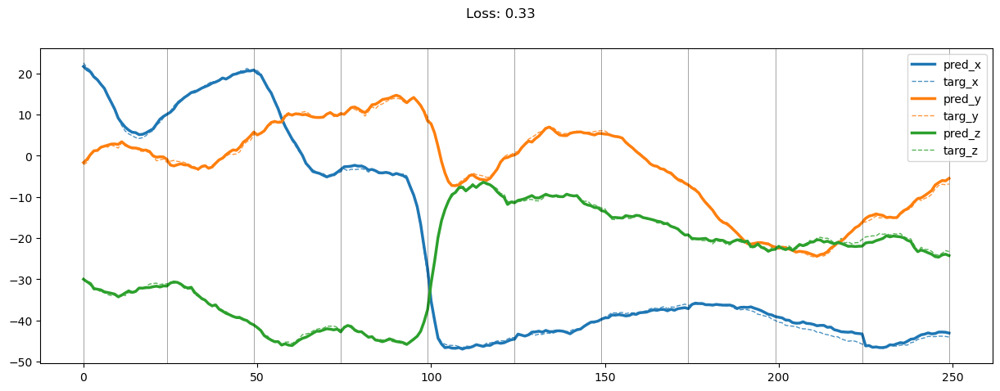

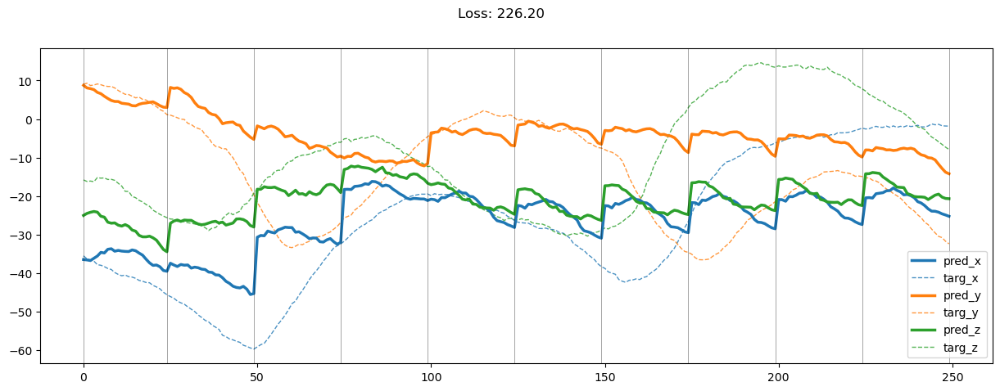

01749: train pred loss:  0.382, g loss:  1.484, diff loss:  0.742, d loss:  1.557
       valid pred loss:  175.747, g loss:  540.255, diff loss:  364.152, d loss:  1.567


100%|██████████| 17/17 [00:01<00:00, 14.93it/s]


01750: train pred loss:  0.383, g loss:  1.501, diff loss:  0.757, d loss:  1.556
       valid pred loss:  175.308, g loss:  541.749, diff loss:  366.082, d loss:  1.563


100%|██████████| 17/17 [00:01<00:00, 15.25it/s]


01751: train pred loss:  0.377, g loss:  1.489, diff loss:  0.750, d loss:  1.554
       valid pred loss:  173.946, g loss:  537.535, diff loss:  363.229, d loss:  1.561


100%|██████████| 17/17 [00:01<00:00, 15.27it/s]


01752: train pred loss:  0.396, g loss:  1.550, diff loss:  0.788, d loss:  1.550
       valid pred loss:  176.878, g loss:  546.304, diff loss:  369.061, d loss:  1.555


100%|██████████| 17/17 [00:01<00:00, 15.11it/s]


01753: train pred loss:  0.390, g loss:  1.527, diff loss:  0.767, d loss:  1.545
       valid pred loss:  175.154, g loss:  545.649, diff loss:  370.126, d loss:  1.550


100%|██████████| 17/17 [00:01<00:00, 14.89it/s]


01754: train pred loss:  0.389, g loss:  1.526, diff loss:  0.763, d loss:  1.539
       valid pred loss:  176.178, g loss:  544.800, diff loss:  368.248, d loss:  1.543


100%|██████████| 17/17 [00:01<00:00, 15.08it/s]


01755: train pred loss:  0.382, g loss:  1.507, diff loss:  0.746, d loss:  1.534
       valid pred loss:  177.418, g loss:  552.963, diff loss:  375.167, d loss:  1.539


100%|██████████| 17/17 [00:01<00:00, 15.22it/s]


01756: train pred loss:  0.393, g loss:  1.545, diff loss:  0.767, d loss:  1.527
       valid pred loss:  176.886, g loss:  548.418, diff loss:  371.146, d loss:  1.531


100%|██████████| 17/17 [00:01<00:00, 13.49it/s]


01757: train pred loss:  0.390, g loss:  1.535, diff loss:  0.754, d loss:  1.520
       valid pred loss:  176.787, g loss:  547.383, diff loss:  370.205, d loss:  1.525


100%|██████████| 17/17 [00:01<00:00, 14.92it/s]


01758: train pred loss:  0.383, g loss:  1.526, diff loss:  0.745, d loss:  1.513
       valid pred loss:  180.179, g loss:  556.885, diff loss:  376.308, d loss:  1.517


100%|██████████| 17/17 [00:01<00:00, 14.49it/s]


01759: train pred loss:  0.383, g loss:  1.538, diff loss:  0.749, d loss:  1.505
       valid pred loss:  178.840, g loss:  549.551, diff loss:  370.304, d loss:  1.508


100%|██████████| 17/17 [00:01<00:00, 15.23it/s]


01760: train pred loss:  0.404, g loss:  1.594, diff loss:  0.777, d loss:  1.498
       valid pred loss:  176.431, g loss:  548.398, diff loss:  371.554, d loss:  1.502


100%|██████████| 17/17 [00:01<00:00, 15.13it/s]


01761: train pred loss:  0.399, g loss:  1.581, diff loss:  0.762, d loss:  1.492
       valid pred loss:  176.709, g loss:  546.663, diff loss:  369.532, d loss:  1.494


100%|██████████| 17/17 [00:01<00:00, 15.23it/s]


01762: train pred loss:  0.388, g loss:  1.561, diff loss:  0.745, d loss:  1.484
       valid pred loss:  177.799, g loss:  550.194, diff loss:  371.969, d loss:  1.491


100%|██████████| 17/17 [00:01<00:00, 15.24it/s]


01763: train pred loss:  0.366, g loss:  1.517, diff loss:  0.719, d loss:  1.481
       valid pred loss:  177.133, g loss:  549.830, diff loss:  372.263, d loss:  1.484


100%|██████████| 17/17 [00:01<00:00, 15.21it/s]


01764: train pred loss:  0.372, g loss:  1.539, diff loss:  0.728, d loss:  1.475
       valid pred loss:  175.825, g loss:  547.296, diff loss:  371.032, d loss:  1.479


100%|██████████| 17/17 [00:01<00:00, 15.21it/s]


01765: train pred loss:  0.371, g loss:  1.550, diff loss:  0.735, d loss:  1.470
       valid pred loss:  178.930, g loss:  555.565, diff loss:  376.190, d loss:  1.474


100%|██████████| 17/17 [00:01<00:00, 14.01it/s]


01766: train pred loss:  0.374, g loss:  1.565, diff loss:  0.741, d loss:  1.466
       valid pred loss:  180.554, g loss:  560.963, diff loss:  379.960, d loss:  1.471


100%|██████████| 17/17 [00:01<00:00, 15.26it/s]


01767: train pred loss:  0.383, g loss:  1.588, diff loss:  0.752, d loss:  1.464
       valid pred loss:  177.850, g loss:  554.137, diff loss:  375.835, d loss:  1.468


100%|██████████| 17/17 [00:01<00:00, 15.23it/s]


01768: train pred loss:  0.378, g loss:  1.586, diff loss:  0.752, d loss:  1.462
       valid pred loss:  176.373, g loss:  549.568, diff loss:  372.740, d loss:  1.466


100%|██████████| 17/17 [00:01<00:00, 15.23it/s]


01769: train pred loss:  0.379, g loss:  1.585, diff loss:  0.749, d loss:  1.462
       valid pred loss:  177.228, g loss:  547.730, diff loss:  370.047, d loss:  1.467


100%|██████████| 17/17 [00:01<00:00, 15.25it/s]


01770: train pred loss:  0.366, g loss:  1.547, diff loss:  0.724, d loss:  1.461
       valid pred loss:  175.179, g loss:  540.417, diff loss:  364.783, d loss:  1.465


100%|██████████| 17/17 [00:01<00:00, 15.21it/s]


01771: train pred loss:  0.370, g loss:  1.552, diff loss:  0.725, d loss:  1.462
       valid pred loss:  174.421, g loss:  535.253, diff loss:  360.379, d loss:  1.467


100%|██████████| 17/17 [00:01<00:00, 15.26it/s]


01772: train pred loss:  0.373, g loss:  1.559, diff loss:  0.731, d loss:  1.463
       valid pred loss:  176.249, g loss:  540.154, diff loss:  363.455, d loss:  1.469


100%|██████████| 17/17 [00:01<00:00, 14.81it/s]


01773: train pred loss:  0.385, g loss:  1.594, diff loss:  0.757, d loss:  1.466
       valid pred loss:  174.551, g loss:  535.648, diff loss:  360.650, d loss:  1.471


100%|██████████| 17/17 [00:01<00:00, 15.25it/s]


01774: train pred loss:  0.381, g loss:  1.575, diff loss:  0.747, d loss:  1.469
       valid pred loss:  175.492, g loss:  543.601, diff loss:  367.668, d loss:  1.476


100%|██████████| 17/17 [00:01<00:00, 15.26it/s]


01775: train pred loss:  0.377, g loss:  1.561, diff loss:  0.742, d loss:  1.473
       valid pred loss:  174.448, g loss:  539.869, diff loss:  364.987, d loss:  1.481


100%|██████████| 17/17 [00:01<00:00, 15.26it/s]


01776: train pred loss:  0.396, g loss:  1.608, diff loss:  0.778, d loss:  1.479
       valid pred loss:  180.366, g loss:  557.801, diff loss:  377.006, d loss:  1.487


100%|██████████| 17/17 [00:01<00:00, 15.00it/s]


01777: train pred loss:  0.400, g loss:  1.618, diff loss:  0.790, d loss:  1.485
       valid pred loss:  174.350, g loss:  529.858, diff loss:  355.087, d loss:  1.494


100%|██████████| 17/17 [00:01<00:00, 15.24it/s]


01778: train pred loss:  0.388, g loss:  1.565, diff loss:  0.757, d loss:  1.492
       valid pred loss:  176.576, g loss:  543.530, diff loss:  366.541, d loss:  1.501


100%|██████████| 17/17 [00:01<00:00, 14.41it/s]


01779: train pred loss:  0.384, g loss:  1.543, diff loss:  0.747, d loss:  1.500
       valid pred loss:  174.528, g loss:  536.267, diff loss:  361.334, d loss:  1.507


100%|██████████| 17/17 [00:01<00:00, 14.10it/s]


01780: train pred loss:  0.372, g loss:  1.508, diff loss:  0.731, d loss:  1.506
       valid pred loss:  173.638, g loss:  534.583, diff loss:  360.547, d loss:  1.516


100%|██████████| 17/17 [00:01<00:00, 14.46it/s]


01781: train pred loss:  0.391, g loss:  1.554, diff loss:  0.765, d loss:  1.513
       valid pred loss:  177.099, g loss:  547.129, diff loss:  369.641, d loss:  1.525


100%|██████████| 17/17 [00:01<00:00, 15.21it/s]


01782: train pred loss:  0.402, g loss:  1.592, diff loss:  0.800, d loss:  1.521
       valid pred loss:  174.214, g loss:  537.706, diff loss:  363.109, d loss:  1.531


100%|██████████| 17/17 [00:01<00:00, 15.13it/s]


01783: train pred loss:  0.402, g loss:  1.565, diff loss:  0.779, d loss:  1.528
       valid pred loss:  178.887, g loss:  550.826, diff loss:  371.562, d loss:  1.540


100%|██████████| 17/17 [00:01<00:00, 15.09it/s]


01784: train pred loss:  0.414, g loss:  1.586, diff loss:  0.794, d loss:  1.536
       valid pred loss:  175.968, g loss:  543.663, diff loss:  367.325, d loss:  1.548


100%|██████████| 17/17 [00:01<00:00, 15.17it/s]


01785: train pred loss:  0.401, g loss:  1.557, diff loss:  0.783, d loss:  1.541
       valid pred loss:  174.532, g loss:  537.249, diff loss:  362.350, d loss:  1.551


100%|██████████| 17/17 [00:01<00:00, 14.90it/s]


01786: train pred loss:  0.414, g loss:  1.601, diff loss:  0.819, d loss:  1.547
       valid pred loss:  173.602, g loss:  533.914, diff loss:  359.951, d loss:  1.559


100%|██████████| 17/17 [00:01<00:00, 15.02it/s]


01787: train pred loss:  0.405, g loss:  1.561, diff loss:  0.794, d loss:  1.554
       valid pred loss:  177.133, g loss:  541.198, diff loss:  363.707, d loss:  1.564


100%|██████████| 17/17 [00:01<00:00, 15.21it/s]


01788: train pred loss:  0.408, g loss:  1.551, diff loss:  0.783, d loss:  1.557
       valid pred loss:  176.727, g loss:  538.225, diff loss:  361.143, d loss:  1.568


100%|██████████| 17/17 [00:01<00:00, 14.53it/s]


01789: train pred loss:  0.401, g loss:  1.542, diff loss:  0.783, d loss:  1.561
       valid pred loss:  177.790, g loss:  549.375, diff loss:  371.231, d loss:  1.569


100%|██████████| 17/17 [00:01<00:00, 15.24it/s]


01790: train pred loss:  0.373, g loss:  1.469, diff loss:  0.738, d loss:  1.561
       valid pred loss:  176.828, g loss:  544.636, diff loss:  367.456, d loss:  1.571


100%|██████████| 17/17 [00:01<00:00, 15.23it/s]


01791: train pred loss:  0.368, g loss:  1.444, diff loss:  0.720, d loss:  1.562
       valid pred loss:  177.932, g loss:  548.159, diff loss:  369.874, d loss:  1.569


100%|██████████| 17/17 [00:01<00:00, 15.24it/s]


01792: train pred loss:  0.371, g loss:  1.452, diff loss:  0.723, d loss:  1.561
       valid pred loss:  174.949, g loss:  542.398, diff loss:  367.095, d loss:  1.568


100%|██████████| 17/17 [00:01<00:00, 15.24it/s]


01793: train pred loss:  0.372, g loss:  1.462, diff loss:  0.731, d loss:  1.559
       valid pred loss:  177.335, g loss:  550.112, diff loss:  372.421, d loss:  1.566


100%|██████████| 17/17 [00:01<00:00, 15.24it/s]


01794: train pred loss:  0.367, g loss:  1.461, diff loss:  0.733, d loss:  1.558
       valid pred loss:  172.996, g loss:  537.926, diff loss:  364.572, d loss:  1.562


100%|██████████| 17/17 [00:01<00:00, 15.24it/s]


01795: train pred loss:  0.375, g loss:  1.480, diff loss:  0.740, d loss:  1.551
       valid pred loss:  175.447, g loss:  542.221, diff loss:  366.410, d loss:  1.555


100%|██████████| 17/17 [00:01<00:00, 15.22it/s]


01796: train pred loss:  0.371, g loss:  1.468, diff loss:  0.727, d loss:  1.546
       valid pred loss:  175.367, g loss:  543.475, diff loss:  367.739, d loss:  1.549


100%|██████████| 17/17 [00:01<00:00, 15.23it/s]


01797: train pred loss:  0.364, g loss:  1.461, diff loss:  0.723, d loss:  1.540
       valid pred loss:  173.114, g loss:  535.798, diff loss:  362.310, d loss:  1.542


100%|██████████| 17/17 [00:01<00:00, 15.10it/s]


01798: train pred loss:  0.364, g loss:  1.478, diff loss:  0.734, d loss:  1.533
       valid pred loss:  175.034, g loss:  540.555, diff loss:  365.141, d loss:  1.536


100%|██████████| 17/17 [00:01<00:00, 15.23it/s]


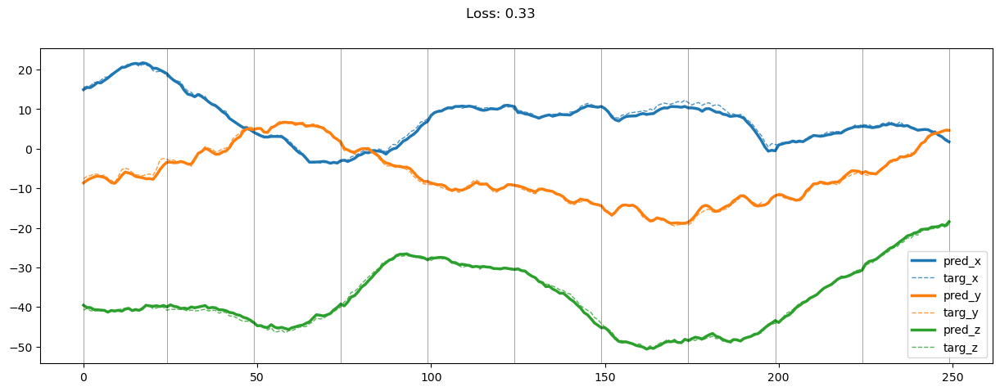

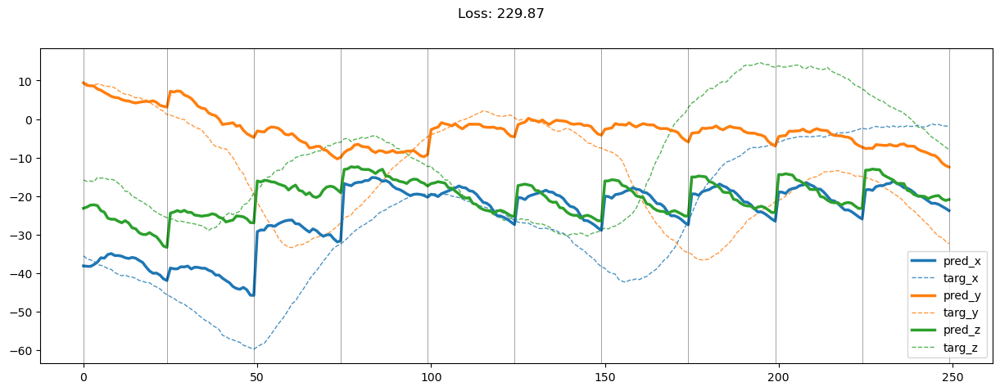

01799: train pred loss:  0.377, g loss:  1.508, diff loss:  0.744, d loss:  1.526
       valid pred loss:  176.095, g loss:  545.495, diff loss:  369.013, d loss:  1.527


100%|██████████| 17/17 [00:01<00:00, 15.21it/s]


01800: train pred loss:  0.365, g loss:  1.468, diff loss:  0.710, d loss:  1.519
       valid pred loss:  176.984, g loss:  548.783, diff loss:  371.404, d loss:  1.518


100%|██████████| 17/17 [00:01<00:00, 14.38it/s]


01801: train pred loss:  0.358, g loss:  1.464, diff loss:  0.705, d loss:  1.510
       valid pred loss:  175.087, g loss:  536.939, diff loss:  361.451, d loss:  1.511


100%|██████████| 17/17 [00:01<00:00, 14.53it/s]


01802: train pred loss:  0.365, g loss:  1.497, diff loss:  0.724, d loss:  1.502
       valid pred loss:  175.032, g loss:  535.444, diff loss:  360.002, d loss:  1.503


100%|██████████| 17/17 [00:01<00:00, 15.22it/s]


01803: train pred loss:  0.378, g loss:  1.531, diff loss:  0.737, d loss:  1.495
       valid pred loss:  174.058, g loss:  537.061, diff loss:  362.585, d loss:  1.495


100%|██████████| 17/17 [00:01<00:00, 15.23it/s]


01804: train pred loss:  0.385, g loss:  1.571, diff loss:  0.762, d loss:  1.488
       valid pred loss:  175.252, g loss:  540.029, diff loss:  364.351, d loss:  1.488


100%|██████████| 17/17 [00:01<00:00, 15.19it/s]


01805: train pred loss:  0.377, g loss:  1.533, diff loss:  0.726, d loss:  1.483
       valid pred loss:  173.558, g loss:  536.145, diff loss:  362.154, d loss:  1.482


100%|██████████| 17/17 [00:01<00:00, 15.21it/s]


01806: train pred loss:  0.367, g loss:  1.526, diff loss:  0.720, d loss:  1.475
       valid pred loss:  173.358, g loss:  531.451, diff loss:  357.653, d loss:  1.476


100%|██████████| 17/17 [00:01<00:00, 15.07it/s]


01807: train pred loss:  0.376, g loss:  1.559, diff loss:  0.739, d loss:  1.472
       valid pred loss:  173.355, g loss:  532.916, diff loss:  359.116, d loss:  1.473


100%|██████████| 17/17 [00:01<00:00, 15.06it/s]


01808: train pred loss:  0.384, g loss:  1.580, diff loss:  0.746, d loss:  1.467
       valid pred loss:  177.656, g loss:  545.834, diff loss:  367.729, d loss:  1.469


100%|██████████| 17/17 [00:01<00:00, 15.10it/s]


01809: train pred loss:  0.386, g loss:  1.605, diff loss:  0.765, d loss:  1.464
       valid pred loss:  173.424, g loss:  535.724, diff loss:  361.847, d loss:  1.466


100%|██████████| 17/17 [00:01<00:00, 15.09it/s]


01810: train pred loss:  0.393, g loss:  1.615, diff loss:  0.764, d loss:  1.461
       valid pred loss:  178.000, g loss:  550.722, diff loss:  372.264, d loss:  1.463


100%|██████████| 17/17 [00:01<00:00, 15.12it/s]


01811: train pred loss:  0.389, g loss:  1.610, diff loss:  0.762, d loss:  1.460
       valid pred loss:  176.400, g loss:  544.705, diff loss:  367.846, d loss:  1.463


100%|██████████| 17/17 [00:01<00:00, 15.17it/s]


01812: train pred loss:  0.373, g loss:  1.566, diff loss:  0.732, d loss:  1.459
       valid pred loss:  177.645, g loss:  548.304, diff loss:  370.200, d loss:  1.461


100%|██████████| 17/17 [00:01<00:00, 15.11it/s]


01813: train pred loss:  0.383, g loss:  1.591, diff loss:  0.748, d loss:  1.459
       valid pred loss:  175.301, g loss:  543.903, diff loss:  368.144, d loss:  1.463


100%|██████████| 17/17 [00:01<00:00, 14.86it/s]


01814: train pred loss:  0.379, g loss:  1.581, diff loss:  0.743, d loss:  1.460
       valid pred loss:  174.000, g loss:  539.525, diff loss:  365.069, d loss:  1.464


100%|██████████| 17/17 [00:01<00:00, 15.16it/s]


01815: train pred loss:  0.366, g loss:  1.540, diff loss:  0.718, d loss:  1.462
       valid pred loss:  176.262, g loss:  544.318, diff loss:  367.604, d loss:  1.467


100%|██████████| 17/17 [00:01<00:00, 15.14it/s]


01816: train pred loss:  0.363, g loss:  1.532, diff loss:  0.717, d loss:  1.465
       valid pred loss:  176.233, g loss:  547.367, diff loss:  370.686, d loss:  1.471


100%|██████████| 17/17 [00:01<00:00, 14.91it/s]


01817: train pred loss:  0.385, g loss:  1.596, diff loss:  0.764, d loss:  1.469
       valid pred loss:  176.940, g loss:  546.509, diff loss:  369.128, d loss:  1.476


100%|██████████| 17/17 [00:01<00:00, 15.10it/s]


01818: train pred loss:  0.408, g loss:  1.638, diff loss:  0.789, d loss:  1.474
       valid pred loss:  175.275, g loss:  543.138, diff loss:  367.427, d loss:  1.480


100%|██████████| 17/17 [00:01<00:00, 15.13it/s]


01819: train pred loss:  0.447, g loss:  1.729, diff loss:  0.848, d loss:  1.480
       valid pred loss:  179.976, g loss:  555.758, diff loss:  375.353, d loss:  1.487


100%|██████████| 17/17 [00:01<00:00, 15.14it/s]


01820: train pred loss:  0.447, g loss:  1.751, diff loss:  0.878, d loss:  1.485
       valid pred loss:  176.869, g loss:  550.456, diff loss:  373.167, d loss:  1.494


100%|██████████| 17/17 [00:01<00:00, 15.15it/s]


01821: train pred loss:  0.455, g loss:  1.761, diff loss:  0.887, d loss:  1.492
       valid pred loss:  181.210, g loss:  557.603, diff loss:  375.982, d loss:  1.502


100%|██████████| 17/17 [00:01<00:00, 14.88it/s]


01822: train pred loss:  0.434, g loss:  1.692, diff loss:  0.847, d loss:  1.500
       valid pred loss:  178.798, g loss:  549.314, diff loss:  370.109, d loss:  1.507


100%|██████████| 17/17 [00:01<00:00, 15.00it/s]


01823: train pred loss:  0.423, g loss:  1.652, diff loss:  0.825, d loss:  1.507
       valid pred loss:  182.254, g loss:  562.753, diff loss:  380.102, d loss:  1.516


100%|██████████| 17/17 [00:01<00:00, 13.97it/s]


01824: train pred loss:  0.401, g loss:  1.586, diff loss:  0.790, d loss:  1.515
       valid pred loss:  178.611, g loss:  549.654, diff loss:  370.654, d loss:  1.526


100%|██████████| 17/17 [00:01<00:00, 15.18it/s]


01825: train pred loss:  0.399, g loss:  1.564, diff loss:  0.777, d loss:  1.524
       valid pred loss:  179.940, g loss:  554.654, diff loss:  374.332, d loss:  1.533


100%|██████████| 17/17 [00:01<00:00, 15.18it/s]


01826: train pred loss:  0.386, g loss:  1.533, diff loss:  0.766, d loss:  1.530
       valid pred loss:  181.531, g loss:  565.008, diff loss:  383.102, d loss:  1.541


100%|██████████| 17/17 [00:01<00:00, 15.08it/s]


01827: train pred loss:  0.382, g loss:  1.506, diff loss:  0.748, d loss:  1.538
       valid pred loss:  179.827, g loss:  555.704, diff loss:  375.508, d loss:  1.549


100%|██████████| 17/17 [00:01<00:00, 15.18it/s]


01828: train pred loss:  0.390, g loss:  1.536, diff loss:  0.777, d loss:  1.546
       valid pred loss:  179.357, g loss:  556.003, diff loss:  376.281, d loss:  1.554


100%|██████████| 17/17 [00:01<00:00, 15.15it/s]


01829: train pred loss:  0.392, g loss:  1.523, diff loss:  0.766, d loss:  1.551
       valid pred loss:  179.911, g loss:  554.177, diff loss:  373.907, d loss:  1.562


100%|██████████| 17/17 [00:01<00:00, 14.49it/s]


01830: train pred loss:  0.380, g loss:  1.497, diff loss:  0.757, d loss:  1.557
       valid pred loss:  179.433, g loss:  555.297, diff loss:  375.508, d loss:  1.566


100%|██████████| 17/17 [00:01<00:00, 15.17it/s]


01831: train pred loss:  0.381, g loss:  1.486, diff loss:  0.748, d loss:  1.561
       valid pred loss:  176.883, g loss:  545.493, diff loss:  368.257, d loss:  1.570


100%|██████████| 17/17 [00:01<00:00, 15.19it/s]


01832: train pred loss:  0.398, g loss:  1.532, diff loss:  0.780, d loss:  1.565
       valid pred loss:  178.809, g loss:  553.647, diff loss:  374.487, d loss:  1.572


100%|██████████| 17/17 [00:01<00:00, 14.68it/s]


01833: train pred loss:  0.398, g loss:  1.529, diff loss:  0.777, d loss:  1.565
       valid pred loss:  178.649, g loss:  553.868, diff loss:  374.868, d loss:  1.573


100%|██████████| 17/17 [00:01<00:00, 13.99it/s]


01834: train pred loss:  0.399, g loss:  1.533, diff loss:  0.781, d loss:  1.566
       valid pred loss:  177.568, g loss:  541.893, diff loss:  363.975, d loss:  1.573


100%|██████████| 17/17 [00:01<00:00, 15.16it/s]


01835: train pred loss:  0.400, g loss:  1.548, diff loss:  0.793, d loss:  1.564
       valid pred loss:  174.166, g loss:  535.555, diff loss:  361.036, d loss:  1.570


100%|██████████| 17/17 [00:01<00:00, 14.86it/s]


01836: train pred loss:  0.401, g loss:  1.526, diff loss:  0.768, d loss:  1.561
       valid pred loss:  178.291, g loss:  545.604, diff loss:  366.956, d loss:  1.566


100%|██████████| 17/17 [00:01<00:00, 15.19it/s]


01837: train pred loss:  0.389, g loss:  1.500, diff loss:  0.753, d loss:  1.559
       valid pred loss:  176.689, g loss:  543.382, diff loss:  366.335, d loss:  1.564


100%|██████████| 17/17 [00:01<00:00, 15.20it/s]


01838: train pred loss:  0.391, g loss:  1.516, diff loss:  0.763, d loss:  1.554
       valid pred loss:  179.257, g loss:  554.838, diff loss:  375.217, d loss:  1.557


100%|██████████| 17/17 [00:01<00:00, 15.22it/s]


01839: train pred loss:  0.380, g loss:  1.493, diff loss:  0.746, d loss:  1.548
       valid pred loss:  180.756, g loss:  552.615, diff loss:  371.491, d loss:  1.551


100%|██████████| 17/17 [00:01<00:00, 15.20it/s]


01840: train pred loss:  0.365, g loss:  1.452, diff loss:  0.714, d loss:  1.541
       valid pred loss:  178.207, g loss:  543.836, diff loss:  365.254, d loss:  1.542


100%|██████████| 17/17 [00:01<00:00, 15.08it/s]


01841: train pred loss:  0.370, g loss:  1.466, diff loss:  0.716, d loss:  1.532
       valid pred loss:  177.914, g loss:  552.342, diff loss:  374.047, d loss:  1.536


100%|██████████| 17/17 [00:01<00:00, 14.89it/s]


01842: train pred loss:  0.359, g loss:  1.453, diff loss:  0.708, d loss:  1.525
       valid pred loss:  181.564, g loss:  557.543, diff loss:  375.591, d loss:  1.525


100%|██████████| 17/17 [00:01<00:00, 14.18it/s]


01843: train pred loss:  0.363, g loss:  1.476, diff loss:  0.720, d loss:  1.517
       valid pred loss:  178.421, g loss:  547.791, diff loss:  368.976, d loss:  1.519


100%|██████████| 17/17 [00:01<00:00, 15.15it/s]


01844: train pred loss:  0.370, g loss:  1.498, diff loss:  0.728, d loss:  1.509
       valid pred loss:  178.257, g loss:  551.910, diff loss:  373.251, d loss:  1.512


100%|██████████| 17/17 [00:01<00:00, 15.12it/s]


01845: train pred loss:  0.384, g loss:  1.546, diff loss:  0.753, d loss:  1.502
       valid pred loss:  178.809, g loss:  550.574, diff loss:  371.354, d loss:  1.502


100%|██████████| 17/17 [00:01<00:00, 15.13it/s]


01846: train pred loss:  0.380, g loss:  1.543, diff loss:  0.746, d loss:  1.494
       valid pred loss:  175.950, g loss:  545.148, diff loss:  368.778, d loss:  1.493


100%|██████████| 17/17 [00:01<00:00, 14.40it/s]


01847: train pred loss:  0.373, g loss:  1.540, diff loss:  0.743, d loss:  1.487
       valid pred loss:  179.533, g loss:  548.665, diff loss:  368.704, d loss:  1.487


100%|██████████| 17/17 [00:01<00:00, 15.18it/s]


01848: train pred loss:  0.375, g loss:  1.549, diff loss:  0.742, d loss:  1.480
       valid pred loss:  179.669, g loss:  549.882, diff loss:  369.778, d loss:  1.480


100%|██████████| 17/17 [00:01<00:00, 15.23it/s]


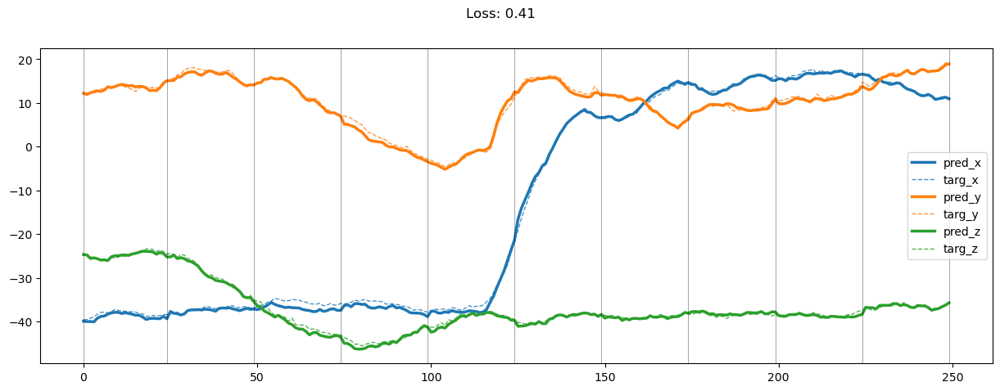

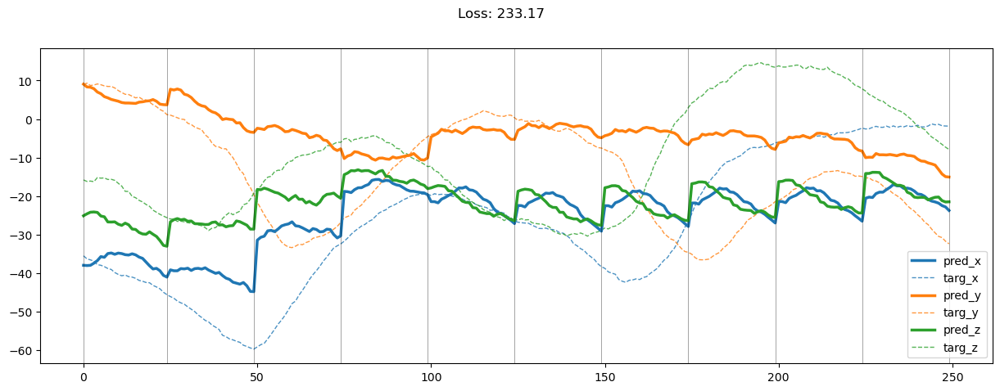

01849: train pred loss:  0.375, g loss:  1.560, diff loss:  0.746, d loss:  1.474
       valid pred loss:  178.010, g loss:  544.494, diff loss:  366.041, d loss:  1.474


100%|██████████| 17/17 [00:01<00:00, 15.22it/s]


01850: train pred loss:  0.385, g loss:  1.586, diff loss:  0.754, d loss:  1.469
       valid pred loss:  176.613, g loss:  543.413, diff loss:  366.351, d loss:  1.469


100%|██████████| 17/17 [00:01<00:00, 15.12it/s]


01851: train pred loss:  0.374, g loss:  1.564, diff loss:  0.737, d loss:  1.464
       valid pred loss:  178.089, g loss:  545.394, diff loss:  366.849, d loss:  1.463


100%|██████████| 17/17 [00:01<00:00, 15.03it/s]


01852: train pred loss:  0.379, g loss:  1.581, diff loss:  0.746, d loss:  1.462
       valid pred loss:  178.651, g loss:  544.515, diff loss:  365.407, d loss:  1.463


100%|██████████| 17/17 [00:01<00:00, 15.21it/s]


01853: train pred loss:  0.380, g loss:  1.590, diff loss:  0.751, d loss:  1.459
       valid pred loss:  177.823, g loss:  546.082, diff loss:  367.798, d loss:  1.460


100%|██████████| 17/17 [00:01<00:00, 15.20it/s]


01854: train pred loss:  0.378, g loss:  1.567, diff loss:  0.726, d loss:  1.456
       valid pred loss:  178.874, g loss:  552.507, diff loss:  373.169, d loss:  1.458


100%|██████████| 17/17 [00:01<00:00, 14.98it/s]


01855: train pred loss:  0.377, g loss:  1.565, diff loss:  0.724, d loss:  1.455
       valid pred loss:  175.695, g loss:  542.199, diff loss:  366.041, d loss:  1.459


100%|██████████| 17/17 [00:01<00:00, 15.26it/s]


01856: train pred loss:  0.365, g loss:  1.555, diff loss:  0.726, d loss:  1.456
       valid pred loss:  176.652, g loss:  544.816, diff loss:  367.700, d loss:  1.459


100%|██████████| 17/17 [00:01<00:00, 15.26it/s]


01857: train pred loss:  0.364, g loss:  1.536, diff loss:  0.709, d loss:  1.457
       valid pred loss:  177.709, g loss:  543.964, diff loss:  365.795, d loss:  1.461


100%|██████████| 17/17 [00:01<00:00, 15.24it/s]


01858: train pred loss:  0.367, g loss:  1.543, diff loss:  0.716, d loss:  1.458
       valid pred loss:  176.058, g loss:  542.393, diff loss:  365.878, d loss:  1.463


100%|██████████| 17/17 [00:01<00:00, 15.23it/s]


01859: train pred loss:  0.368, g loss:  1.547, diff loss:  0.724, d loss:  1.461
       valid pred loss:  177.789, g loss:  542.183, diff loss:  363.942, d loss:  1.467


100%|██████████| 17/17 [00:01<00:00, 14.96it/s]


01860: train pred loss:  0.373, g loss:  1.549, diff loss:  0.726, d loss:  1.466
       valid pred loss:  176.482, g loss:  541.648, diff loss:  364.718, d loss:  1.470


100%|██████████| 17/17 [00:01<00:00, 15.24it/s]


01861: train pred loss:  0.379, g loss:  1.559, diff loss:  0.736, d loss:  1.469
       valid pred loss:  177.582, g loss:  547.152, diff loss:  369.130, d loss:  1.477


100%|██████████| 17/17 [00:01<00:00, 15.24it/s]


01862: train pred loss:  0.368, g loss:  1.520, diff loss:  0.715, d loss:  1.476
       valid pred loss:  181.867, g loss:  554.598, diff loss:  372.299, d loss:  1.483


100%|██████████| 17/17 [00:01<00:00, 15.26it/s]


01863: train pred loss:  0.375, g loss:  1.536, diff loss:  0.733, d loss:  1.483
       valid pred loss:  180.474, g loss:  552.088, diff loss:  371.189, d loss:  1.489


100%|██████████| 17/17 [00:01<00:00, 14.71it/s]


01864: train pred loss:  0.366, g loss:  1.503, diff loss:  0.715, d loss:  1.490
       valid pred loss:  178.071, g loss:  547.520, diff loss:  369.033, d loss:  1.497


100%|██████████| 17/17 [00:01<00:00, 14.91it/s]


01865: train pred loss:  0.362, g loss:  1.482, diff loss:  0.707, d loss:  1.497
       valid pred loss:  180.092, g loss:  553.215, diff loss:  372.717, d loss:  1.507


100%|██████████| 17/17 [00:01<00:00, 15.24it/s]


01866: train pred loss:  0.362, g loss:  1.472, diff loss:  0.705, d loss:  1.505
       valid pred loss:  181.246, g loss:  554.002, diff loss:  372.357, d loss:  1.514


100%|██████████| 17/17 [00:01<00:00, 15.27it/s]


01867: train pred loss:  0.372, g loss:  1.506, diff loss:  0.738, d loss:  1.513
       valid pred loss:  179.878, g loss:  552.228, diff loss:  371.958, d loss:  1.523


100%|██████████| 17/17 [00:01<00:00, 15.26it/s]


01868: train pred loss:  0.381, g loss:  1.512, diff loss:  0.742, d loss:  1.522
       valid pred loss:  177.504, g loss:  544.403, diff loss:  366.515, d loss:  1.531


100%|██████████| 17/17 [00:01<00:00, 15.15it/s]


01869: train pred loss:  0.379, g loss:  1.507, diff loss:  0.745, d loss:  1.530
       valid pred loss:  179.268, g loss:  552.869, diff loss:  373.225, d loss:  1.540


100%|██████████| 17/17 [00:01<00:00, 15.25it/s]


01870: train pred loss:  0.368, g loss:  1.456, diff loss:  0.713, d loss:  1.538
       valid pred loss:  177.400, g loss:  545.711, diff loss:  367.940, d loss:  1.547


100%|██████████| 17/17 [00:01<00:00, 15.26it/s]


01871: train pred loss:  0.370, g loss:  1.459, diff loss:  0.720, d loss:  1.545
       valid pred loss:  180.179, g loss:  557.660, diff loss:  377.118, d loss:  1.556


100%|██████████| 17/17 [00:01<00:00, 15.26it/s]


01872: train pred loss:  0.361, g loss:  1.431, diff loss:  0.708, d loss:  1.554
       valid pred loss:  180.298, g loss:  555.925, diff loss:  375.268, d loss:  1.561


100%|██████████| 17/17 [00:01<00:00, 15.26it/s]


01873: train pred loss:  0.353, g loss:  1.392, diff loss:  0.681, d loss:  1.559
       valid pred loss:  177.841, g loss:  547.138, diff loss:  368.942, d loss:  1.568


100%|██████████| 17/17 [00:01<00:00, 15.26it/s]


01874: train pred loss:  0.351, g loss:  1.400, diff loss:  0.694, d loss:  1.563
       valid pred loss:  177.187, g loss:  542.123, diff loss:  364.584, d loss:  1.571


100%|██████████| 17/17 [00:01<00:00, 15.23it/s]


01875: train pred loss:  0.373, g loss:  1.451, diff loss:  0.726, d loss:  1.567
       valid pred loss:  179.246, g loss:  550.359, diff loss:  370.763, d loss:  1.574


100%|██████████| 17/17 [00:01<00:00, 15.26it/s]


01876: train pred loss:  0.381, g loss:  1.482, diff loss:  0.750, d loss:  1.570
       valid pred loss:  179.959, g loss:  553.559, diff loss:  373.252, d loss:  1.576


100%|██████████| 17/17 [00:01<00:00, 15.24it/s]


01877: train pred loss:  0.414, g loss:  1.587, diff loss:  0.823, d loss:  1.571
       valid pred loss:  177.238, g loss:  545.546, diff loss:  367.960, d loss:  1.578


100%|██████████| 17/17 [00:01<00:00, 14.34it/s]


01878: train pred loss:  0.420, g loss:  1.572, diff loss:  0.801, d loss:  1.569
       valid pred loss:  177.266, g loss:  547.271, diff loss:  369.655, d loss:  1.575


100%|██████████| 17/17 [00:01<00:00, 14.18it/s]


01879: train pred loss:  0.390, g loss:  1.508, diff loss:  0.766, d loss:  1.568
       valid pred loss:  176.558, g loss:  541.718, diff loss:  364.809, d loss:  1.572


100%|██████████| 17/17 [00:01<00:00, 15.23it/s]


01880: train pred loss:  0.377, g loss:  1.463, diff loss:  0.732, d loss:  1.564
       valid pred loss:  182.819, g loss:  557.701, diff loss:  374.525, d loss:  1.566


100%|██████████| 17/17 [00:01<00:00, 14.63it/s]


01881: train pred loss:  0.365, g loss:  1.437, diff loss:  0.714, d loss:  1.559
       valid pred loss:  179.544, g loss:  550.388, diff loss:  370.487, d loss:  1.563


100%|██████████| 17/17 [00:01<00:00, 15.03it/s]


01882: train pred loss:  0.358, g loss:  1.425, diff loss:  0.704, d loss:  1.553
       valid pred loss:  177.985, g loss:  542.079, diff loss:  363.730, d loss:  1.556


100%|██████████| 17/17 [00:01<00:00, 14.90it/s]


01883: train pred loss:  0.359, g loss:  1.436, diff loss:  0.709, d loss:  1.548
       valid pred loss:  179.794, g loss:  549.043, diff loss:  368.878, d loss:  1.547


100%|██████████| 17/17 [00:01<00:00, 15.23it/s]


01884: train pred loss:  0.359, g loss:  1.428, diff loss:  0.694, d loss:  1.538
       valid pred loss:  176.733, g loss:  541.789, diff loss:  364.680, d loss:  1.541


100%|██████████| 17/17 [00:01<00:00, 14.85it/s]


01885: train pred loss:  0.354, g loss:  1.435, diff loss:  0.699, d loss:  1.531
       valid pred loss:  177.356, g loss:  542.392, diff loss:  364.651, d loss:  1.531


100%|██████████| 17/17 [00:01<00:00, 15.20it/s]


01886: train pred loss:  0.354, g loss:  1.432, diff loss:  0.689, d loss:  1.522
       valid pred loss:  174.834, g loss:  533.058, diff loss:  357.832, d loss:  1.522


100%|██████████| 17/17 [00:01<00:00, 15.28it/s]


01887: train pred loss:  0.357, g loss:  1.454, diff loss:  0.700, d loss:  1.513
       valid pred loss:  175.663, g loss:  534.090, diff loss:  358.027, d loss:  1.513


100%|██████████| 17/17 [00:01<00:00, 15.11it/s]


01888: train pred loss:  0.392, g loss:  1.559, diff loss:  0.761, d loss:  1.504
       valid pred loss:  174.918, g loss:  527.311, diff loss:  351.985, d loss:  1.504


100%|██████████| 17/17 [00:01<00:00, 15.19it/s]


01889: train pred loss:  0.389, g loss:  1.559, diff loss:  0.756, d loss:  1.497
       valid pred loss:  176.843, g loss:  537.120, diff loss:  359.860, d loss:  1.496


100%|██████████| 17/17 [00:01<00:00, 14.79it/s]


01890: train pred loss:  0.387, g loss:  1.567, diff loss:  0.757, d loss:  1.488
       valid pred loss:  177.766, g loss:  536.403, diff loss:  358.211, d loss:  1.489


100%|██████████| 17/17 [00:01<00:00, 15.19it/s]


01891: train pred loss:  0.402, g loss:  1.628, diff loss:  0.795, d loss:  1.480
       valid pred loss:  179.753, g loss:  546.785, diff loss:  366.597, d loss:  1.481


100%|██████████| 17/17 [00:01<00:00, 15.16it/s]


01892: train pred loss:  0.408, g loss:  1.628, diff loss:  0.782, d loss:  1.474
       valid pred loss:  178.973, g loss:  542.539, diff loss:  363.125, d loss:  1.475


100%|██████████| 17/17 [00:01<00:00, 15.22it/s]


01893: train pred loss:  0.375, g loss:  1.561, diff loss:  0.741, d loss:  1.469
       valid pred loss:  176.749, g loss:  537.811, diff loss:  360.614, d loss:  1.470


100%|██████████| 17/17 [00:01<00:00, 15.23it/s]


01894: train pred loss:  0.371, g loss:  1.549, diff loss:  0.726, d loss:  1.464
       valid pred loss:  179.383, g loss:  545.410, diff loss:  365.573, d loss:  1.466


100%|██████████| 17/17 [00:01<00:00, 14.85it/s]


01895: train pred loss:  0.366, g loss:  1.549, diff loss:  0.725, d loss:  1.461
       valid pred loss:  179.487, g loss:  547.833, diff loss:  367.885, d loss:  1.461


100%|██████████| 17/17 [00:01<00:00, 14.34it/s]


01896: train pred loss:  0.384, g loss:  1.592, diff loss:  0.745, d loss:  1.457
       valid pred loss:  180.517, g loss:  549.400, diff loss:  368.420, d loss:  1.460


100%|██████████| 17/17 [00:01<00:00, 15.26it/s]


01897: train pred loss:  0.376, g loss:  1.573, diff loss:  0.732, d loss:  1.456
       valid pred loss:  180.931, g loss:  551.114, diff loss:  369.716, d loss:  1.457


100%|██████████| 17/17 [00:01<00:00, 14.95it/s]


01898: train pred loss:  0.371, g loss:  1.569, diff loss:  0.731, d loss:  1.454
       valid pred loss:  178.989, g loss:  541.373, diff loss:  361.916, d loss:  1.456


100%|██████████| 17/17 [00:01<00:00, 14.54it/s]


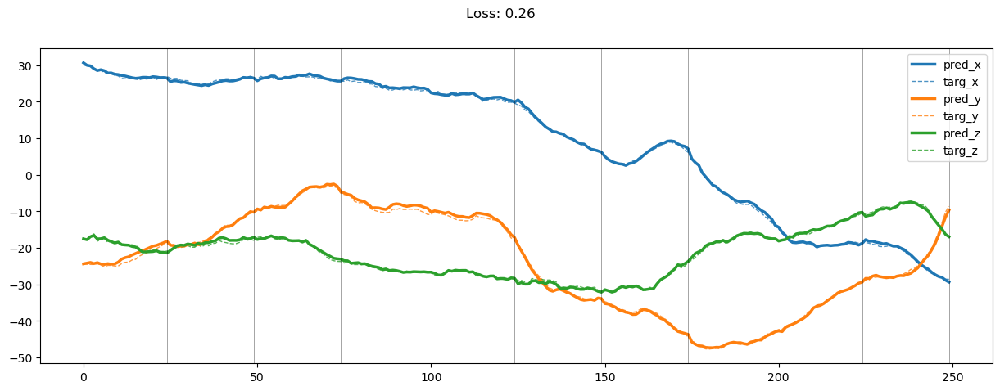

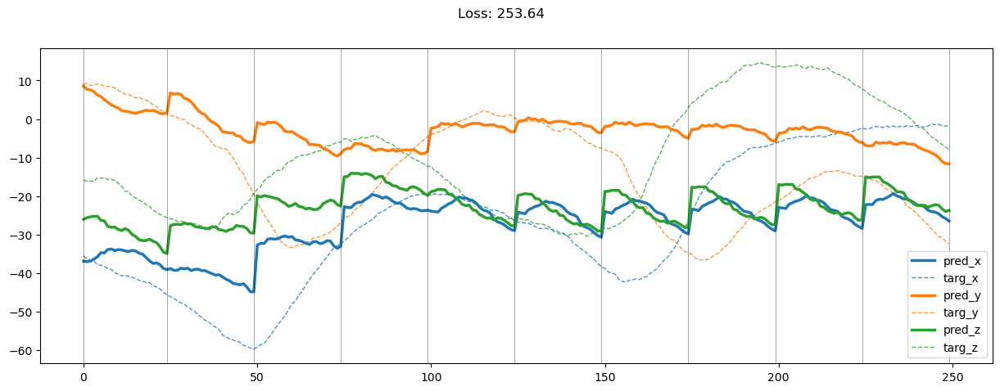

01899: train pred loss:  0.378, g loss:  1.571, diff loss:  0.725, d loss:  1.454
       valid pred loss:  177.574, g loss:  535.383, diff loss:  357.342, d loss:  1.456


100%|██████████| 17/17 [00:01<00:00, 15.03it/s]


01900: train pred loss:  0.373, g loss:  1.573, diff loss:  0.733, d loss:  1.454
       valid pred loss:  182.197, g loss:  553.053, diff loss:  370.391, d loss:  1.458


100%|██████████| 17/17 [00:01<00:00, 15.16it/s]


01901: train pred loss:  0.378, g loss:  1.574, diff loss:  0.731, d loss:  1.455
       valid pred loss:  177.328, g loss:  536.390, diff loss:  358.598, d loss:  1.459


100%|██████████| 17/17 [00:01<00:00, 15.22it/s]


01902: train pred loss:  0.373, g loss:  1.570, diff loss:  0.735, d loss:  1.457
       valid pred loss:  178.384, g loss:  543.274, diff loss:  364.432, d loss:  1.463


100%|██████████| 17/17 [00:01<00:00, 14.93it/s]


01903: train pred loss:  0.390, g loss:  1.597, diff loss:  0.751, d loss:  1.461
       valid pred loss:  179.439, g loss:  543.721, diff loss:  363.828, d loss:  1.466


100%|██████████| 17/17 [00:01<00:00, 14.75it/s]


01904: train pred loss:  0.373, g loss:  1.559, diff loss:  0.735, d loss:  1.466
       valid pred loss:  178.579, g loss:  537.726, diff loss:  358.700, d loss:  1.471


100%|██████████| 17/17 [00:01<00:00, 14.98it/s]


01905: train pred loss:  0.368, g loss:  1.535, diff loss:  0.722, d loss:  1.471
       valid pred loss:  178.560, g loss:  544.097, diff loss:  365.099, d loss:  1.478


100%|██████████| 17/17 [00:01<00:00, 14.95it/s]


01906: train pred loss:  0.384, g loss:  1.573, diff loss:  0.753, d loss:  1.477
       valid pred loss:  178.001, g loss:  541.896, diff loss:  363.464, d loss:  1.484


100%|██████████| 17/17 [00:01<00:00, 15.23it/s]


01907: train pred loss:  0.387, g loss:  1.576, diff loss:  0.761, d loss:  1.484
       valid pred loss:  180.136, g loss:  544.927, diff loss:  364.369, d loss:  1.493


100%|██████████| 17/17 [00:01<00:00, 15.26it/s]


01908: train pred loss:  0.372, g loss:  1.519, diff loss:  0.727, d loss:  1.491
       valid pred loss:  178.512, g loss:  534.810, diff loss:  355.885, d loss:  1.502


100%|██████████| 17/17 [00:01<00:00, 15.26it/s]


01909: train pred loss:  0.369, g loss:  1.508, diff loss:  0.729, d loss:  1.500
       valid pred loss:  178.859, g loss:  539.275, diff loss:  360.011, d loss:  1.509


100%|██████████| 17/17 [00:01<00:00, 15.27it/s]


01910: train pred loss:  0.375, g loss:  1.505, diff loss:  0.728, d loss:  1.508
       valid pred loss:  180.003, g loss:  542.420, diff loss:  362.021, d loss:  1.518


100%|██████████| 17/17 [00:01<00:00, 15.27it/s]


01911: train pred loss:  0.377, g loss:  1.502, diff loss:  0.732, d loss:  1.517
       valid pred loss:  179.986, g loss:  544.524, diff loss:  364.151, d loss:  1.528


100%|██████████| 17/17 [00:01<00:00, 15.19it/s]


01912: train pred loss:  0.382, g loss:  1.515, diff loss:  0.747, d loss:  1.526
       valid pred loss:  180.079, g loss:  540.203, diff loss:  359.746, d loss:  1.538


100%|██████████| 17/17 [00:01<00:00, 15.19it/s]


01913: train pred loss:  0.378, g loss:  1.502, diff loss:  0.746, d loss:  1.534
       valid pred loss:  179.135, g loss:  538.390, diff loss:  358.883, d loss:  1.545


100%|██████████| 17/17 [00:01<00:00, 14.75it/s]


01914: train pred loss:  0.400, g loss:  1.550, diff loss:  0.779, d loss:  1.543
       valid pred loss:  180.683, g loss:  535.671, diff loss:  354.623, d loss:  1.554


100%|██████████| 17/17 [00:01<00:00, 15.22it/s]


01915: train pred loss:  0.388, g loss:  1.516, diff loss:  0.762, d loss:  1.550
       valid pred loss:  179.966, g loss:  541.186, diff loss:  360.860, d loss:  1.560


100%|██████████| 17/17 [00:01<00:00, 15.08it/s]


01916: train pred loss:  0.375, g loss:  1.482, diff loss:  0.748, d loss:  1.558
       valid pred loss:  179.519, g loss:  537.509, diff loss:  357.636, d loss:  1.569


100%|██████████| 17/17 [00:01<00:00, 14.53it/s]


01917: train pred loss:  0.366, g loss:  1.438, diff loss:  0.716, d loss:  1.563
       valid pred loss:  179.423, g loss:  537.994, diff loss:  358.221, d loss:  1.574


100%|██████████| 17/17 [00:01<00:00, 15.19it/s]


01918: train pred loss:  0.366, g loss:  1.431, diff loss:  0.712, d loss:  1.568
       valid pred loss:  180.013, g loss:  538.959, diff loss:  358.598, d loss:  1.577


100%|██████████| 17/17 [00:01<00:00, 14.94it/s]


01919: train pred loss:  0.368, g loss:  1.444, diff loss:  0.726, d loss:  1.571
       valid pred loss:  177.859, g loss:  532.947, diff loss:  354.741, d loss:  1.579


100%|██████████| 17/17 [00:01<00:00, 15.11it/s]


01920: train pred loss:  0.383, g loss:  1.478, diff loss:  0.748, d loss:  1.574
       valid pred loss:  177.334, g loss:  533.308, diff loss:  355.631, d loss:  1.583


100%|██████████| 17/17 [00:01<00:00, 15.19it/s]


01921: train pred loss:  0.373, g loss:  1.448, diff loss:  0.728, d loss:  1.574
       valid pred loss:  176.112, g loss:  528.575, diff loss:  352.118, d loss:  1.580


100%|██████████| 17/17 [00:01<00:00, 14.84it/s]


01922: train pred loss:  0.376, g loss:  1.460, diff loss:  0.736, d loss:  1.572
       valid pred loss:  176.971, g loss:  532.772, diff loss:  355.456, d loss:  1.581


100%|██████████| 17/17 [00:01<00:00, 15.15it/s]


01923: train pred loss:  0.383, g loss:  1.480, diff loss:  0.748, d loss:  1.572
       valid pred loss:  180.746, g loss:  542.649, diff loss:  361.556, d loss:  1.578


100%|██████████| 17/17 [00:01<00:00, 15.13it/s]


01924: train pred loss:  0.390, g loss:  1.511, diff loss:  0.768, d loss:  1.567
       valid pred loss:  180.940, g loss:  549.121, diff loss:  367.830, d loss:  1.572


100%|██████████| 17/17 [00:01<00:00, 15.15it/s]


01925: train pred loss:  0.389, g loss:  1.510, diff loss:  0.765, d loss:  1.562
       valid pred loss:  181.250, g loss:  550.107, diff loss:  368.501, d loss:  1.566


100%|██████████| 17/17 [00:01<00:00, 15.19it/s]


01926: train pred loss:  0.404, g loss:  1.556, diff loss:  0.791, d loss:  1.556
       valid pred loss:  182.696, g loss:  557.474, diff loss:  374.417, d loss:  1.559


100%|██████████| 17/17 [00:01<00:00, 15.20it/s]


01927: train pred loss:  0.399, g loss:  1.541, diff loss:  0.775, d loss:  1.548
       valid pred loss:  179.798, g loss:  547.463, diff loss:  367.297, d loss:  1.551


100%|██████████| 17/17 [00:01<00:00, 15.14it/s]


01928: train pred loss:  0.379, g loss:  1.500, diff loss:  0.747, d loss:  1.540
       valid pred loss:  175.732, g loss:  534.891, diff loss:  358.786, d loss:  1.544


100%|██████████| 17/17 [00:01<00:00, 15.16it/s]


01929: train pred loss:  0.379, g loss:  1.489, diff loss:  0.731, d loss:  1.533
       valid pred loss:  174.090, g loss:  530.550, diff loss:  356.079, d loss:  1.535


100%|██████████| 17/17 [00:01<00:00, 15.10it/s]


01930: train pred loss:  0.368, g loss:  1.464, diff loss:  0.708, d loss:  1.523
       valid pred loss:  176.537, g loss:  536.353, diff loss:  359.426, d loss:  1.526


100%|██████████| 17/17 [00:01<00:00, 14.79it/s]


01931: train pred loss:  0.374, g loss:  1.503, diff loss:  0.733, d loss:  1.514
       valid pred loss:  177.325, g loss:  541.245, diff loss:  363.521, d loss:  1.516


100%|██████████| 17/17 [00:01<00:00, 14.56it/s]


01932: train pred loss:  0.367, g loss:  1.489, diff loss:  0.717, d loss:  1.505
       valid pred loss:  178.402, g loss:  537.983, diff loss:  359.174, d loss:  1.507


100%|██████████| 17/17 [00:01<00:00, 15.09it/s]


01933: train pred loss:  0.362, g loss:  1.493, diff loss:  0.716, d loss:  1.496
       valid pred loss:  178.851, g loss:  548.140, diff loss:  368.873, d loss:  1.499


100%|██████████| 17/17 [00:01<00:00, 14.92it/s]


01934: train pred loss:  0.367, g loss:  1.506, diff loss:  0.715, d loss:  1.488
       valid pred loss:  180.132, g loss:  549.439, diff loss:  368.881, d loss:  1.489


100%|██████████| 17/17 [00:01<00:00, 15.10it/s]


01935: train pred loss:  0.383, g loss:  1.548, diff loss:  0.733, d loss:  1.480
       valid pred loss:  180.458, g loss:  545.785, diff loss:  364.892, d loss:  1.482


100%|██████████| 17/17 [00:01<00:00, 14.46it/s]


01936: train pred loss:  0.369, g loss:  1.537, diff loss:  0.728, d loss:  1.473
       valid pred loss:  178.964, g loss:  539.649, diff loss:  360.243, d loss:  1.476


100%|██████████| 17/17 [00:01<00:00, 14.51it/s]


01937: train pred loss:  0.364, g loss:  1.528, diff loss:  0.716, d loss:  1.468
       valid pred loss:  180.170, g loss:  541.674, diff loss:  361.054, d loss:  1.469


100%|██████████| 17/17 [00:01<00:00, 15.07it/s]


01938: train pred loss:  0.379, g loss:  1.578, diff loss:  0.744, d loss:  1.461
       valid pred loss:  185.178, g loss:  562.087, diff loss:  376.454, d loss:  1.466


100%|██████████| 17/17 [00:01<00:00, 14.22it/s]


01939: train pred loss:  0.380, g loss:  1.588, diff loss:  0.746, d loss:  1.456
       valid pred loss:  181.994, g loss:  551.431, diff loss:  368.975, d loss:  1.460


100%|██████████| 17/17 [00:01<00:00, 14.61it/s]


01940: train pred loss:  0.378, g loss:  1.592, diff loss:  0.747, d loss:  1.454
       valid pred loss:  179.303, g loss:  542.627, diff loss:  362.857, d loss:  1.457


100%|██████████| 17/17 [00:01<00:00, 15.14it/s]


01941: train pred loss:  0.379, g loss:  1.593, diff loss:  0.743, d loss:  1.451
       valid pred loss:  179.506, g loss:  539.229, diff loss:  359.254, d loss:  1.457


100%|██████████| 17/17 [00:01<00:00, 15.03it/s]


01942: train pred loss:  0.386, g loss:  1.615, diff loss:  0.756, d loss:  1.449
       valid pred loss:  178.362, g loss:  536.485, diff loss:  357.652, d loss:  1.454


100%|██████████| 17/17 [00:01<00:00, 14.70it/s]


01943: train pred loss:  0.398, g loss:  1.633, diff loss:  0.762, d loss:  1.449
       valid pred loss:  176.522, g loss:  531.719, diff loss:  354.726, d loss:  1.455


100%|██████████| 17/17 [00:01<00:00, 14.98it/s]


01944: train pred loss:  0.382, g loss:  1.613, diff loss:  0.759, d loss:  1.450
       valid pred loss:  177.849, g loss:  534.215, diff loss:  355.897, d loss:  1.455


100%|██████████| 17/17 [00:01<00:00, 14.99it/s]


01945: train pred loss:  0.381, g loss:  1.594, diff loss:  0.743, d loss:  1.451
       valid pred loss:  175.572, g loss:  530.640, diff loss:  354.601, d loss:  1.458


100%|██████████| 17/17 [00:01<00:00, 15.15it/s]


01946: train pred loss:  0.377, g loss:  1.588, diff loss:  0.744, d loss:  1.453
       valid pred loss:  175.338, g loss:  530.513, diff loss:  354.713, d loss:  1.461


100%|██████████| 17/17 [00:01<00:00, 15.02it/s]


01947: train pred loss:  0.370, g loss:  1.554, diff loss:  0.722, d loss:  1.456
       valid pred loss:  175.112, g loss:  531.268, diff loss:  355.698, d loss:  1.463


100%|██████████| 17/17 [00:01<00:00, 15.01it/s]


01948: train pred loss:  0.367, g loss:  1.554, diff loss:  0.731, d loss:  1.461
       valid pred loss:  178.242, g loss:  540.652, diff loss:  361.961, d loss:  1.469


100%|██████████| 17/17 [00:01<00:00, 14.14it/s]


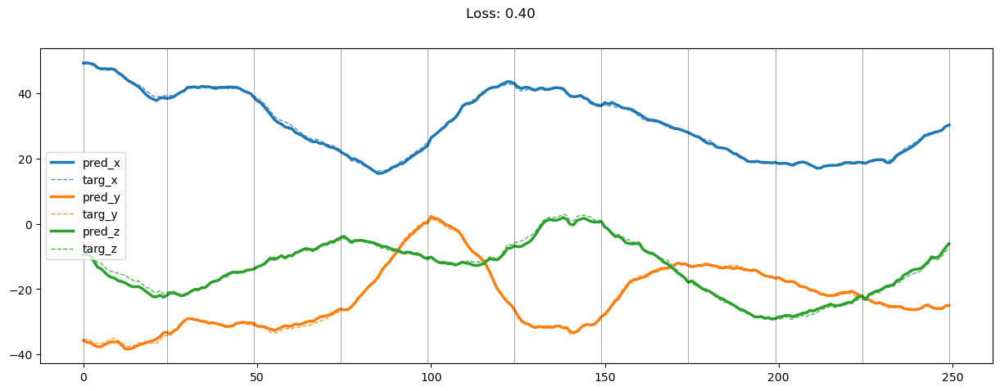

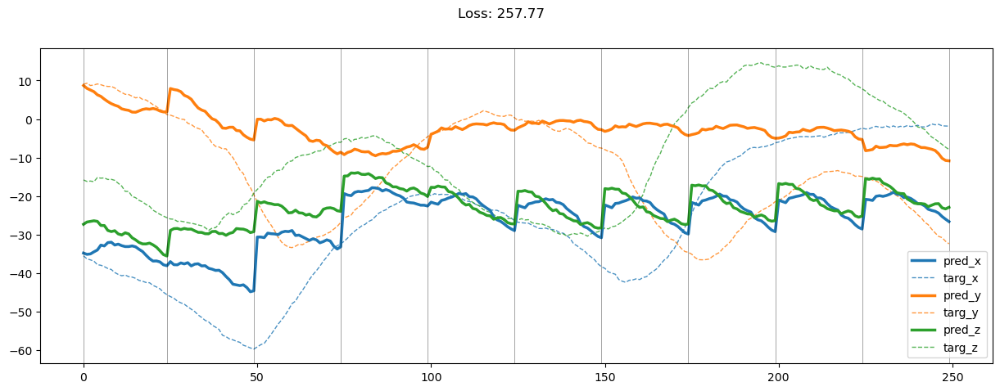

01949: train pred loss:  0.364, g loss:  1.536, diff loss:  0.722, d loss:  1.466
       valid pred loss:  175.407, g loss:  528.642, diff loss:  352.793, d loss:  1.475


100%|██████████| 17/17 [00:01<00:00, 13.65it/s]


01950: train pred loss:  0.375, g loss:  1.561, diff loss:  0.745, d loss:  1.472
       valid pred loss:  174.950, g loss:  529.200, diff loss:  353.816, d loss:  1.481


100%|██████████| 17/17 [00:01<00:00, 15.11it/s]


01951: train pred loss:  0.386, g loss:  1.568, diff loss:  0.749, d loss:  1.480
       valid pred loss:  177.417, g loss:  540.390, diff loss:  362.549, d loss:  1.491


100%|██████████| 17/17 [00:01<00:00, 15.13it/s]


01952: train pred loss:  0.390, g loss:  1.578, diff loss:  0.765, d loss:  1.488
       valid pred loss:  178.814, g loss:  541.622, diff loss:  362.392, d loss:  1.498


100%|██████████| 17/17 [00:01<00:00, 14.78it/s]


01953: train pred loss:  0.381, g loss:  1.539, diff loss:  0.745, d loss:  1.497
       valid pred loss:  178.672, g loss:  544.801, diff loss:  365.726, d loss:  1.511


100%|██████████| 17/17 [00:01<00:00, 15.13it/s]


01954: train pred loss:  0.369, g loss:  1.507, diff loss:  0.734, d loss:  1.506
       valid pred loss:  178.237, g loss:  545.496, diff loss:  366.860, d loss:  1.516


100%|██████████| 17/17 [00:01<00:00, 14.74it/s]


01955: train pred loss:  0.364, g loss:  1.481, diff loss:  0.721, d loss:  1.515
       valid pred loss:  179.178, g loss:  547.636, diff loss:  368.070, d loss:  1.529


100%|██████████| 17/17 [00:01<00:00, 15.07it/s]


01956: train pred loss:  0.362, g loss:  1.463, diff loss:  0.714, d loss:  1.525
       valid pred loss:  177.434, g loss:  540.241, diff loss:  362.428, d loss:  1.538


100%|██████████| 17/17 [00:01<00:00, 14.91it/s]


01957: train pred loss:  0.358, g loss:  1.440, diff loss:  0.704, d loss:  1.534
       valid pred loss:  178.737, g loss:  547.172, diff loss:  368.064, d loss:  1.547


100%|██████████| 17/17 [00:01<00:00, 14.60it/s]


01958: train pred loss:  0.364, g loss:  1.449, diff loss:  0.713, d loss:  1.542
       valid pred loss:  179.915, g loss:  545.466, diff loss:  365.187, d loss:  1.555


100%|██████████| 17/17 [00:01<00:00, 15.01it/s]


01959: train pred loss:  0.362, g loss:  1.430, diff loss:  0.704, d loss:  1.551
       valid pred loss:  173.902, g loss:  530.634, diff loss:  356.374, d loss:  1.564


100%|██████████| 17/17 [00:01<00:00, 15.07it/s]


01960: train pred loss:  0.361, g loss:  1.428, diff loss:  0.708, d loss:  1.559
       valid pred loss:  174.073, g loss:  529.921, diff loss:  355.496, d loss:  1.571


100%|██████████| 17/17 [00:01<00:00, 15.09it/s]


01961: train pred loss:  0.367, g loss:  1.449, diff loss:  0.728, d loss:  1.565
       valid pred loss:  176.718, g loss:  540.456, diff loss:  363.391, d loss:  1.579


100%|██████████| 17/17 [00:01<00:00, 15.07it/s]


01962: train pred loss:  0.379, g loss:  1.459, diff loss:  0.731, d loss:  1.571
       valid pred loss:  174.736, g loss:  531.647, diff loss:  356.566, d loss:  1.583


100%|██████████| 17/17 [00:01<00:00, 14.65it/s]


01963: train pred loss:  0.366, g loss:  1.437, diff loss:  0.723, d loss:  1.574
       valid pred loss:  177.802, g loss:  541.670, diff loss:  363.527, d loss:  1.587


100%|██████████| 17/17 [00:01<00:00, 15.05it/s]


01964: train pred loss:  0.366, g loss:  1.430, diff loss:  0.719, d loss:  1.578
       valid pred loss:  180.366, g loss:  550.034, diff loss:  369.328, d loss:  1.588


100%|██████████| 17/17 [00:01<00:00, 15.16it/s]


01965: train pred loss:  0.366, g loss:  1.436, diff loss:  0.727, d loss:  1.580
       valid pred loss:  178.027, g loss:  539.187, diff loss:  360.821, d loss:  1.592


100%|██████████| 17/17 [00:01<00:00, 15.12it/s]


01966: train pred loss:  0.360, g loss:  1.408, diff loss:  0.705, d loss:  1.581
       valid pred loss:  176.705, g loss:  539.408, diff loss:  362.363, d loss:  1.589


100%|██████████| 17/17 [00:01<00:00, 14.61it/s]


01967: train pred loss:  0.371, g loss:  1.454, diff loss:  0.738, d loss:  1.578
       valid pred loss:  175.771, g loss:  535.474, diff loss:  359.361, d loss:  1.586


100%|██████████| 17/17 [00:01<00:00, 15.10it/s]


01968: train pred loss:  0.379, g loss:  1.473, diff loss:  0.747, d loss:  1.575
       valid pred loss:  176.709, g loss:  537.679, diff loss:  360.625, d loss:  1.582


100%|██████████| 17/17 [00:01<00:00, 13.97it/s]


01969: train pred loss:  0.387, g loss:  1.501, diff loss:  0.764, d loss:  1.570
       valid pred loss:  177.093, g loss:  534.960, diff loss:  357.519, d loss:  1.577


100%|██████████| 17/17 [00:01<00:00, 14.42it/s]


01970: train pred loss:  0.381, g loss:  1.490, diff loss:  0.755, d loss:  1.565
       valid pred loss:  175.353, g loss:  532.571, diff loss:  356.865, d loss:  1.570


100%|██████████| 17/17 [00:01<00:00, 14.56it/s]


01971: train pred loss:  0.377, g loss:  1.480, diff loss:  0.744, d loss:  1.557
       valid pred loss:  180.678, g loss:  553.626, diff loss:  372.588, d loss:  1.561


100%|██████████| 17/17 [00:01<00:00, 14.58it/s]


01972: train pred loss:  0.379, g loss:  1.483, diff loss:  0.737, d loss:  1.548
       valid pred loss:  177.215, g loss:  540.958, diff loss:  363.377, d loss:  1.553


100%|██████████| 17/17 [00:01<00:00, 15.19it/s]


01973: train pred loss:  0.371, g loss:  1.474, diff loss:  0.730, d loss:  1.539
       valid pred loss:  177.278, g loss:  540.027, diff loss:  362.374, d loss:  1.542


100%|██████████| 17/17 [00:01<00:00, 15.08it/s]


01974: train pred loss:  0.383, g loss:  1.510, diff loss:  0.745, d loss:  1.529
       valid pred loss:  176.544, g loss:  539.167, diff loss:  362.240, d loss:  1.531


100%|██████████| 17/17 [00:01<00:00, 15.05it/s]


01975: train pred loss:  0.399, g loss:  1.557, diff loss:  0.768, d loss:  1.520
       valid pred loss:  176.122, g loss:  533.599, diff loss:  357.085, d loss:  1.522


100%|██████████| 17/17 [00:01<00:00, 15.15it/s]


01976: train pred loss:  0.369, g loss:  1.501, diff loss:  0.733, d loss:  1.511
       valid pred loss:  177.821, g loss:  544.212, diff loss:  365.989, d loss:  1.511


100%|██████████| 17/17 [00:01<00:00, 15.11it/s]


01977: train pred loss:  0.386, g loss:  1.555, diff loss:  0.760, d loss:  1.501
       valid pred loss:  179.338, g loss:  546.991, diff loss:  367.243, d loss:  1.504


100%|██████████| 17/17 [00:01<00:00, 15.12it/s]


01978: train pred loss:  0.382, g loss:  1.550, diff loss:  0.749, d loss:  1.492
       valid pred loss:  179.544, g loss:  546.767, diff loss:  366.802, d loss:  1.493


100%|██████████| 17/17 [00:01<00:00, 14.38it/s]


01979: train pred loss:  0.369, g loss:  1.526, diff loss:  0.730, d loss:  1.483
       valid pred loss:  180.487, g loss:  549.401, diff loss:  368.484, d loss:  1.486


100%|██████████| 17/17 [00:01<00:00, 15.21it/s]


01980: train pred loss:  0.381, g loss:  1.565, diff loss:  0.747, d loss:  1.476
       valid pred loss:  178.825, g loss:  541.301, diff loss:  362.037, d loss:  1.478


100%|██████████| 17/17 [00:01<00:00, 15.25it/s]


01981: train pred loss:  0.378, g loss:  1.548, diff loss:  0.725, d loss:  1.469
       valid pred loss:  178.902, g loss:  546.820, diff loss:  367.471, d loss:  1.472


100%|██████████| 17/17 [00:01<00:00, 14.18it/s]


01982: train pred loss:  0.353, g loss:  1.509, diff loss:  0.702, d loss:  1.462
       valid pred loss:  179.614, g loss:  543.046, diff loss:  362.976, d loss:  1.465


100%|██████████| 17/17 [00:01<00:00, 15.19it/s]


01983: train pred loss:  0.355, g loss:  1.517, diff loss:  0.700, d loss:  1.457
       valid pred loss:  178.935, g loss:  543.077, diff loss:  363.680, d loss:  1.460


100%|██████████| 17/17 [00:01<00:00, 15.25it/s]


01984: train pred loss:  0.347, g loss:  1.492, diff loss:  0.678, d loss:  1.453
       valid pred loss:  179.580, g loss:  544.879, diff loss:  364.832, d loss:  1.456


100%|██████████| 17/17 [00:01<00:00, 15.18it/s]


01985: train pred loss:  0.353, g loss:  1.500, diff loss:  0.675, d loss:  1.449
       valid pred loss:  181.430, g loss:  551.241, diff loss:  369.338, d loss:  1.453


100%|██████████| 17/17 [00:01<00:00, 15.26it/s]


01986: train pred loss:  0.350, g loss:  1.514, diff loss:  0.686, d loss:  1.447
       valid pred loss:  181.451, g loss:  550.672, diff loss:  368.744, d loss:  1.449


100%|██████████| 17/17 [00:01<00:00, 15.22it/s]


01987: train pred loss:  0.352, g loss:  1.523, diff loss:  0.692, d loss:  1.445
       valid pred loss:  180.027, g loss:  544.041, diff loss:  363.538, d loss:  1.451


100%|██████████| 17/17 [00:01<00:00, 15.26it/s]


01988: train pred loss:  0.358, g loss:  1.549, diff loss:  0.711, d loss:  1.445
       valid pred loss:  179.749, g loss:  542.267, diff loss:  362.041, d loss:  1.449


100%|██████████| 17/17 [00:01<00:00, 15.24it/s]


01989: train pred loss:  0.377, g loss:  1.586, diff loss:  0.730, d loss:  1.445
       valid pred loss:  177.213, g loss:  535.907, diff loss:  358.219, d loss:  1.452


100%|██████████| 17/17 [00:01<00:00, 15.20it/s]


01990: train pred loss:  0.369, g loss:  1.567, diff loss:  0.723, d loss:  1.448
       valid pred loss:  183.049, g loss:  548.657, diff loss:  365.136, d loss:  1.454


100%|██████████| 17/17 [00:01<00:00, 15.20it/s]


01991: train pred loss:  0.384, g loss:  1.597, diff loss:  0.741, d loss:  1.450
       valid pred loss:  180.334, g loss:  543.839, diff loss:  363.039, d loss:  1.457


100%|██████████| 17/17 [00:01<00:00, 15.22it/s]


01992: train pred loss:  0.372, g loss:  1.573, diff loss:  0.734, d loss:  1.453
       valid pred loss:  181.759, g loss:  555.317, diff loss:  373.097, d loss:  1.461


100%|██████████| 17/17 [00:01<00:00, 14.77it/s]


01993: train pred loss:  0.390, g loss:  1.615, diff loss:  0.765, d loss:  1.458
       valid pred loss:  179.919, g loss:  549.312, diff loss:  368.940, d loss:  1.467


100%|██████████| 17/17 [00:01<00:00, 15.17it/s]


01994: train pred loss:  0.370, g loss:  1.537, diff loss:  0.715, d loss:  1.463
       valid pred loss:  177.277, g loss:  540.967, diff loss:  363.246, d loss:  1.474


100%|██████████| 17/17 [00:01<00:00, 15.22it/s]


01995: train pred loss:  0.363, g loss:  1.516, diff loss:  0.709, d loss:  1.469
       valid pred loss:  179.696, g loss:  547.799, diff loss:  367.668, d loss:  1.480


100%|██████████| 17/17 [00:01<00:00, 14.88it/s]


01996: train pred loss:  0.347, g loss:  1.470, diff loss:  0.688, d loss:  1.477
       valid pred loss:  179.955, g loss:  549.023, diff loss:  368.642, d loss:  1.489


100%|██████████| 17/17 [00:01<00:00, 14.76it/s]


01997: train pred loss:  0.341, g loss:  1.439, diff loss:  0.674, d loss:  1.487
       valid pred loss:  176.739, g loss:  540.020, diff loss:  362.866, d loss:  1.499


100%|██████████| 17/17 [00:01<00:00, 15.12it/s]


01998: train pred loss:  0.350, g loss:  1.447, diff loss:  0.683, d loss:  1.495
       valid pred loss:  179.402, g loss:  545.664, diff loss:  365.857, d loss:  1.509


100%|██████████| 17/17 [00:01<00:00, 15.14it/s]


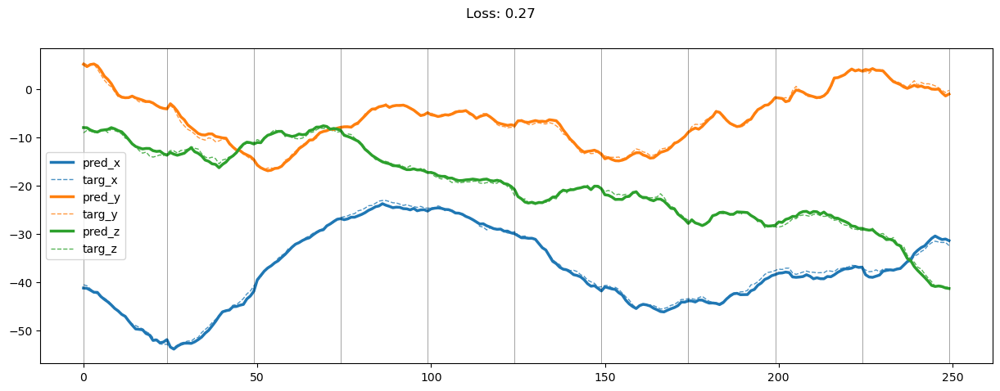

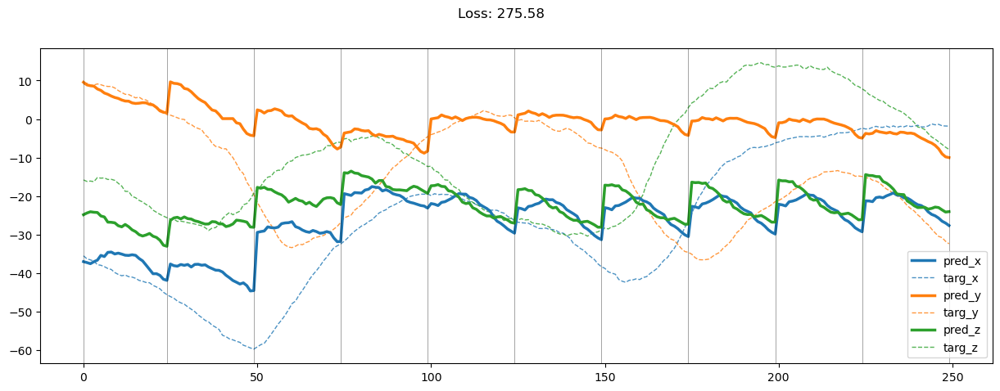

01999: train pred loss:  0.358, g loss:  1.455, diff loss:  0.692, d loss:  1.504
       valid pred loss:  179.818, g loss:  540.356, diff loss:  360.140, d loss:  1.518


In [35]:
draw = True

for epoch in range(EPOCH):
    #####
    # 1. 用上半部訓練50epoch
    # 2. 隨機用上或下半部訓練Model
    # 3. 印出trajectory結果
    #####
    
    if (epoch + 1) % 50 == 0:
        draw = True
    
    train_pred_loss, train_g_loss, train_diff_loss, train_d_loss = train(train_loader, draw)
    valid_pred_loss, valid_g_loss, valid_diff_loss, valid_d_loss = evalute(valid_loader, draw)
    
    draw = False
    
    ep = str(epoch).zfill(5)
    print(f'{ep:>5}: train pred loss: {train_pred_loss: 2.3f}, g loss: {train_g_loss: 2.3f}, diff loss: {train_diff_loss: 2.3f}, d loss: {train_d_loss: 2.3f}\n' +
          f'{"":>5}  valid pred loss: {valid_pred_loss: 2.3f}, g loss: {valid_g_loss: 2.3f}, diff loss: {valid_diff_loss: 2.3f}, d loss: {valid_d_loss: 2.3f}')

In [36]:
def plot_result(result):
    pred_mag = result[0].reshape(-1, 3)
    targ_mag = result[1].reshape(-1, 3)
    x = np.arange(len(pred_mag))
    
    loss = mse_loss(torch.tensor(pred_mag), torch.tensor(targ_mag)).item()
    
    fig = plt.figure(figsize=(15, 5))
    
    for pm, tm, caxis, color in zip(pred_mag.T, targ_mag.T, ['x', 'y', 'z'], ['tab:blue', 'tab:orange', 'tab:green']):
        plt.plot(x, pm, label=f'pred_{caxis}', color=color, linewidth=2.5, zorder=2)
        plt.plot(x, tm, '--', label=f'targ_{caxis}', color=color, linewidth=1, alpha=0.8, zorder=1)
    
    for i in range(0, chunk_size+1):
        plt.axvline(x=int(i * seq_len - 0.5), linewidth=0.5, linestyle='-', color='k', alpha=0.5)
    
    plt.suptitle(f'Loss: {loss:.2f}')
    plt.legend()
    plt.show()

(32, 2, 10, 25, 3)


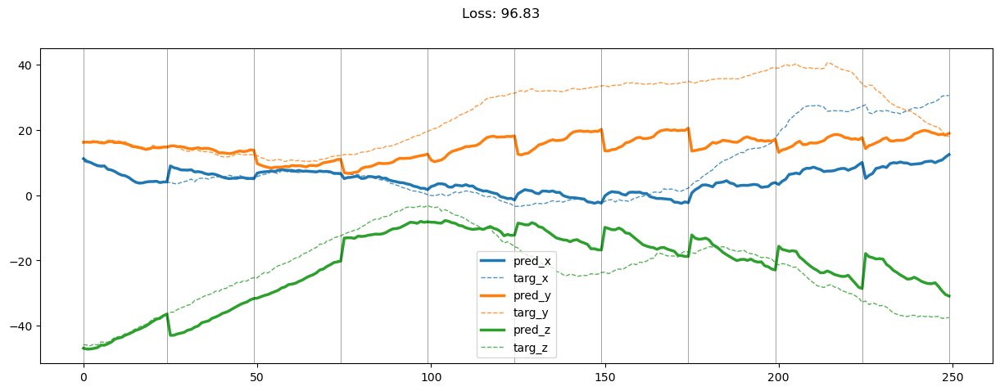

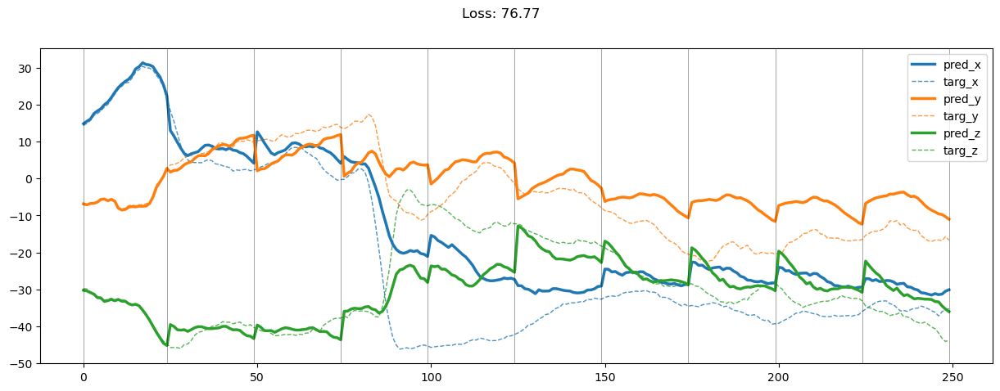

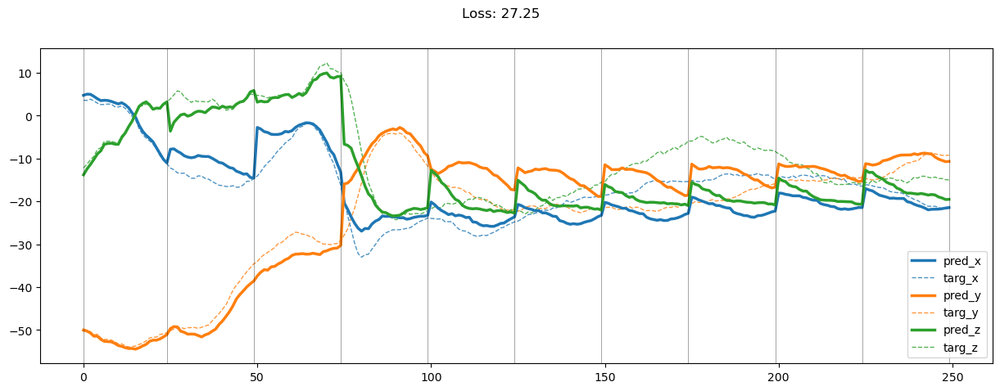

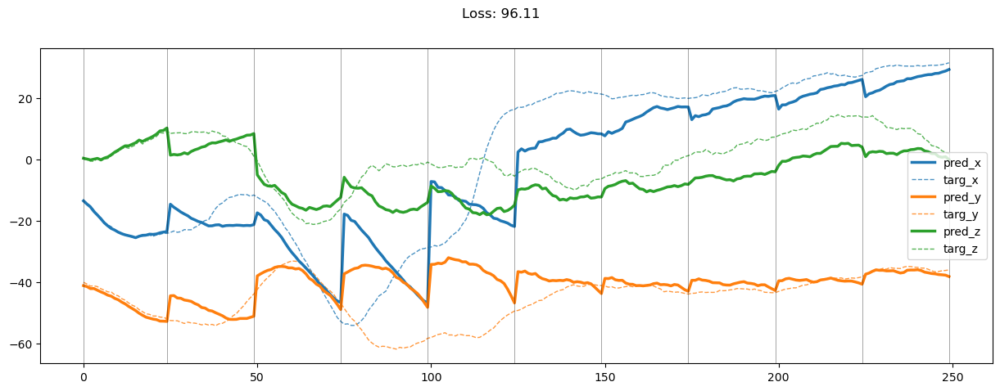

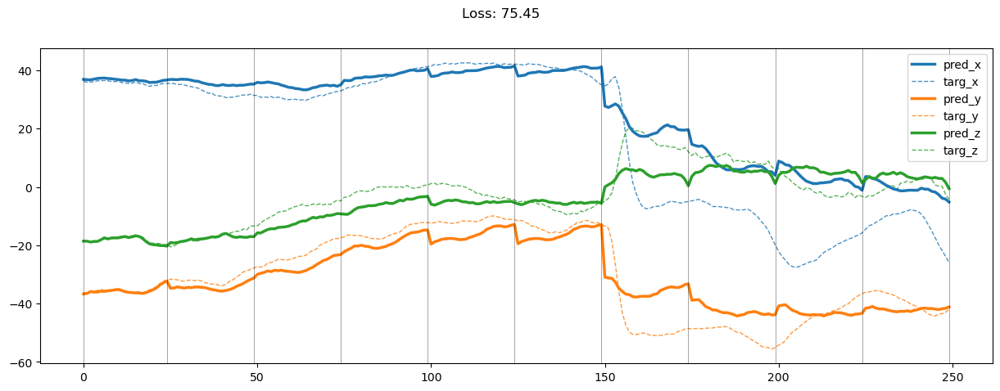

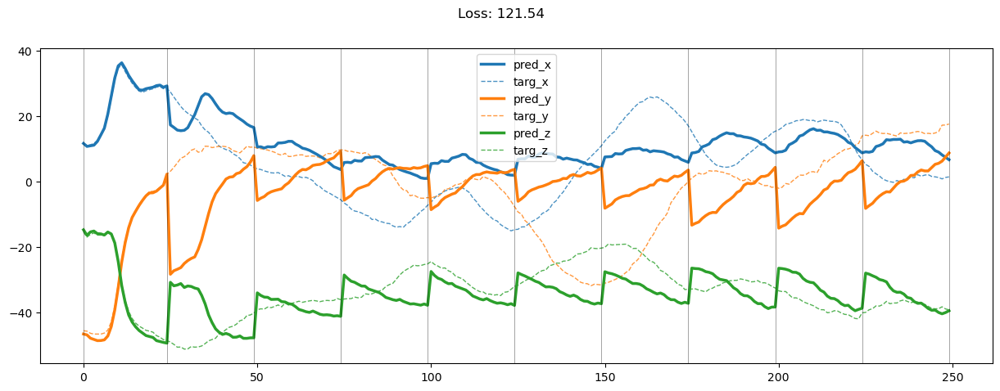

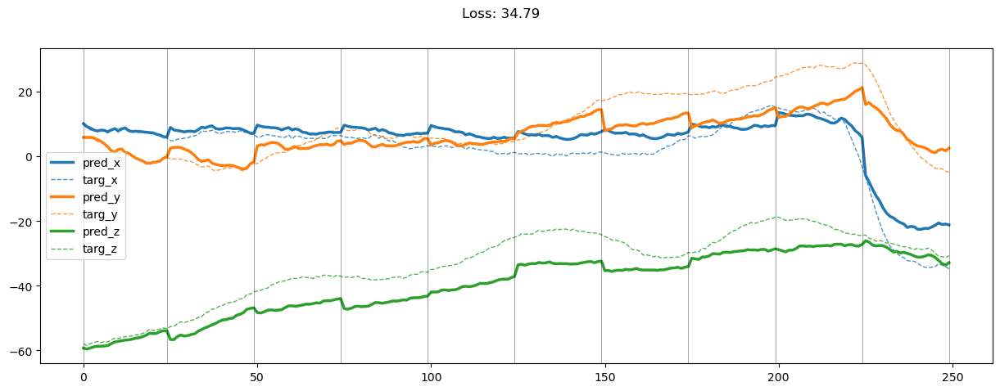

In [37]:
results = output_eval(model, train_loader)

print(results.shape)

for rs in results[::5]:
    plot_result(rs)

(32, 2, 10, 25, 3)


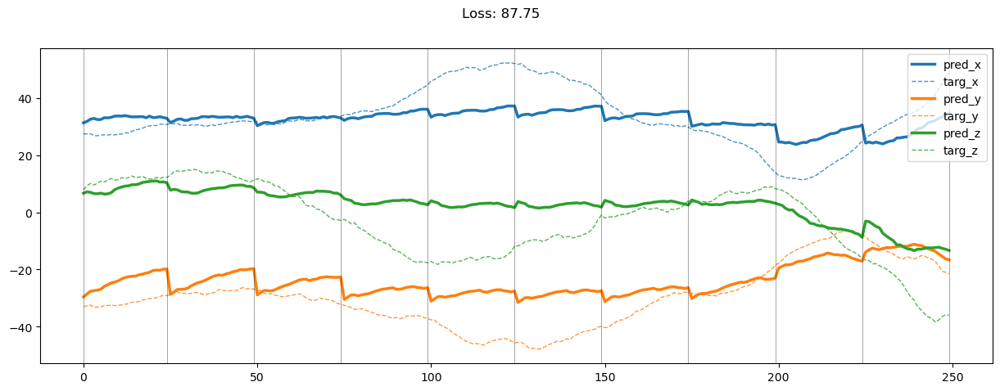

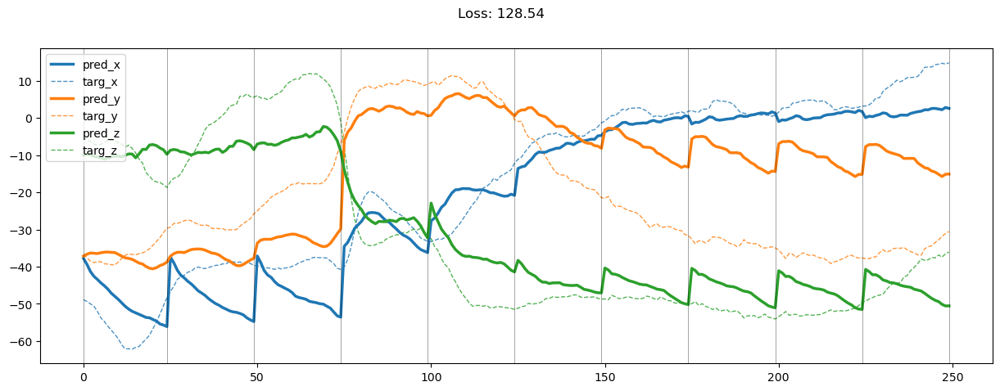

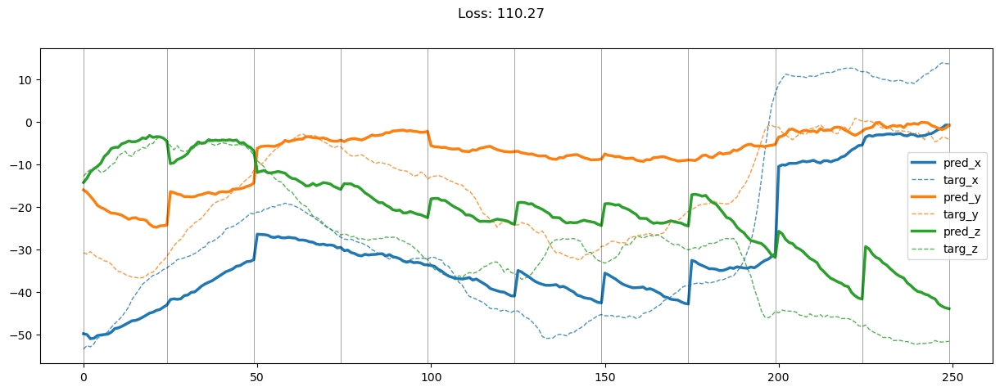

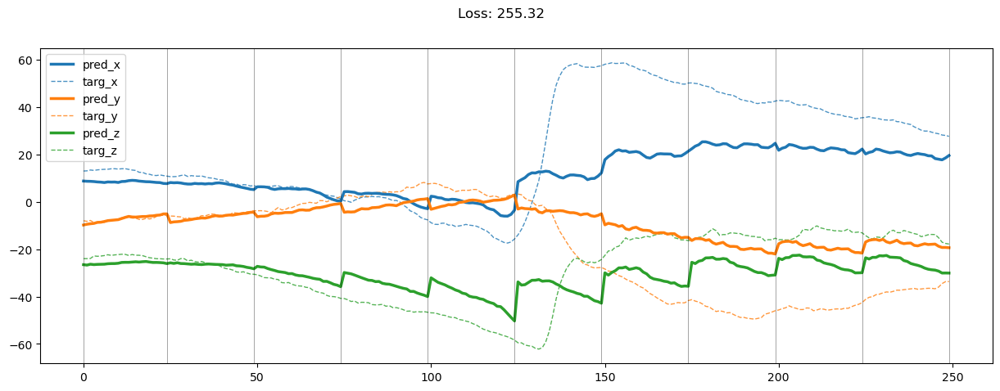

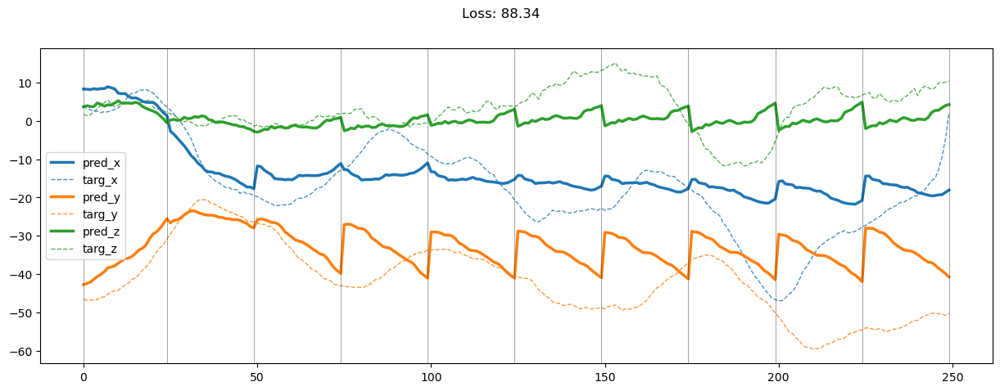

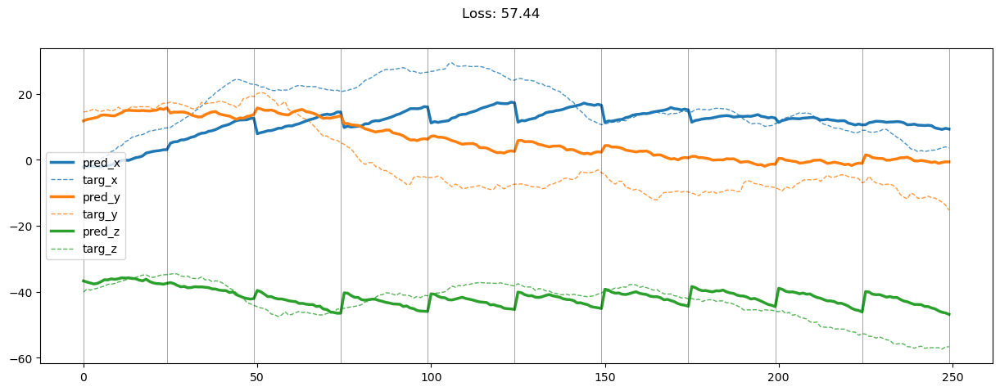

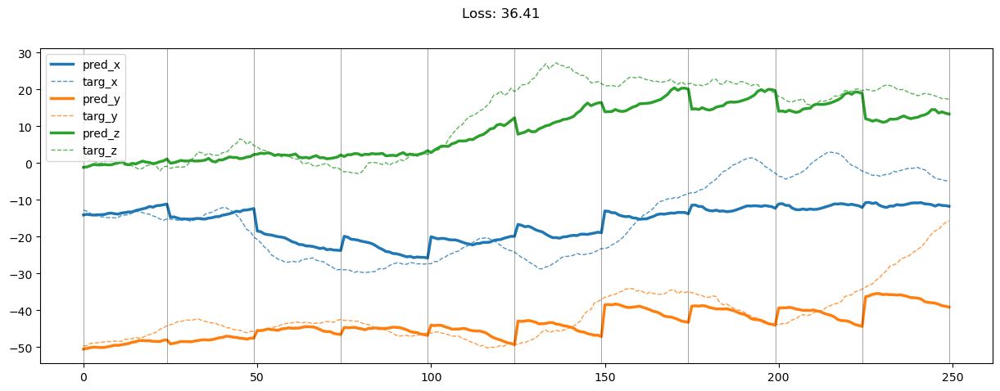

In [38]:
results = output_eval(model, valid_loader)

print(results.shape)

for rs in results[::5]:
    plot_result(rs)